##### libraries

In [1]:
# libraries
# base
from scipy.io import arff          # to read .arff format
import pandas as pd                # data manipulation
import numpy as np                 # linear algebra
import matplotlib.pyplot as plt    # plotting
import seaborn as sns              # plotting
from PIL import Image              # images handling

# support
import time                        # time measuring
import random                      # randomness
import pickle                      # object saving/loading

# math
from scipy.stats import spearmanr, wilcoxon  # spearman rho correlation coefficient and wilcoxon median equality test
from math import ceil              # ceil function

# warnings
from  warnings import simplefilter                             # warning handling
from sklearn.exceptions import ConvergenceWarning              # warning handling
from statsmodels.tools.sm_exceptions import ConvergenceWarning # warning handling

# Sklearn/xgboost - Machine Learning
from sklearn.ensemble import RandomForestClassifier                                           # Random Forest
from sklearn.preprocessing import StandardScaler, MinMaxScaler, PowerTransformer              # scalers and power transform
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold                  # splitting, validation
from sklearn.metrics import roc_auc_score, average_precision_score, confusion_matrix          # metrics
from sklearn.metrics import precision_recall_curve, roc_curve                                 # metrics (curves)
from sklearn.decomposition import PCA                                                         # PCA
from xgboost.sklearn import XGBClassifier                                                     # sklearn API for XGB
import statsmodels.formula.api as smf                                                         # formula API for statsmodels


# tensorflow/keras - Deep Learning
import tensorflow as tf             # tensorflow background
from tensorflow import keras        # keras API for tensorflow
from keras import layers            # keras layers
from keras import models            # keras models
from keras import optimizers        # keras optimizers
from keras import activations       # keras activation functions
from keras import losses            # keras loss functions 
from keras import regularizers      # keras regularizers
# import tensorflow as tf
# from tensorflow import keras
# from tensorflow.keras import layers, models, optimizers, activations, losses, regularizers

Using TensorFlow backend.


##### notebook settings

In [2]:
# notebook settings
pd.set_option("display.max_columns", 70)
pd.set_option("display.max_rows", 70)
# ignoring some warnings
simplefilter("ignore", category=ConvergenceWarning) 
np.warnings.filterwarnings('ignore', '(overflow|invalid)')

random_state = 2021

##### preprocessing

 - loading, missing detection

In [3]:
def get_missing_info(data, y):
    '''
    function creates DataFrame of missing value counts and percentage, for a given data and positive, negative
    and positive percentage for a given target, arguments:
    data - dataset to get informations about (DataFrame)
    y - target value (string)
    
    returns - DataFrame object with informations
    '''
    
    # counting missing and calculating the percentage 
    missing_info = pd.DataFrame((data.isna().sum(), data.isna().sum()/data.shape[0]*100)).T
    missing_info.columns = ["missing_count", "missing_percentage"]
    
    # removing rows without missings
    missing_info = missing_info.where(missing_info > 0).dropna().sort_values(by = "missing_percentage", ascending = False)
    
    # target info inicjalization
    missing_info["non_{}_count".format(y)] = np.nan
    missing_info["{}_count".format(y)] = np.nan
    missing_info["{}_percentage".format(y)] = np.nan
    
    # target info colnames
    neg_count, pos_count, pos_per=missing_info.columns.tolist()[2:]
    
    # target info (counting) columns filling
    cols = missing_info.index.tolist()
    for i in cols:
        missing_info.loc[i, pos_count] = data[y].where(data[i].isna()).dropna().sum()
        missing_info.loc[i, neg_count] = data[y].where(
            data[i].isna()).dropna().shape[0]-missing_info.loc[i, pos_count]
    
    # target info (percentage) column filling
    missing_info[pos_per] = np.round(
        missing_info[pos_count]/(missing_info[neg_count]+missing_info[pos_count])*100, 2)
    
    
    return missing_info

In [4]:
# data loading
data = arff.loadarff(r"data\5year.arff")
data = pd.DataFrame(data[0])

# decoding target variable
data.rename({'class':'bankrupt'}, axis = 1, inplace = True)
data['bankrupt'].replace(b'1', 1, True)
data['bankrupt'].replace(b'0', 0, inplace=True)

In [5]:
get_missing_info(data, "bankrupt")

,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr37,2548.0,43.113367,2338.0,210.0,8.24
Attr27,391.0,6.615905,268.0,123.0,31.46
Attr45,268.0,4.534687,230.0,38.0,14.18
Attr60,268.0,4.534687,230.0,38.0,14.18
Attr24,135.0,2.284264,134.0,1.0,0.74
Attr64,107.0,1.810491,88.0,19.0,17.76
Attr53,107.0,1.810491,88.0,19.0,17.76
Attr28,107.0,1.810491,88.0,19.0,17.76
Attr54,107.0,1.810491,88.0,19.0,17.76
Attr21,103.0,1.742809,4.0,99.0,96.12


Columns to drop because of:
1. Too many missings:
 - Attr37,
 - Attr27,
 - Attr45,
 - Attr60,
2. Potential data leakage:
 - Attr21 (96% of missing data is a bankrupt class - when we observe data missing the algorithm could made a rule of predicting positive class (vast miniority of target) - unreasonable)

In [6]:
# column dropping
data.drop(labels = ["Attr37", "Attr27", "Attr45", "Attr60", "Attr21"], axis = 1, inplace = True)

 - functions for data imputation

In [7]:
def ProximityMatrix(RF, X, normalize = True):    
    '''
    function computes the proximity matrix for given (trained) random forest and data, arguments:
    RF - trained Random Forst classifier,
    X - data to apply RF,
    normalize - boolean, if true then proximity_matrix = proximity_matrix/num_of_Trees
    
    returns proximity matrix (np.arraty)
    -----
    note: this function is based on stackoverflow topic:
        https://stackoverflow.com/questions/18703136/proximity-matrix-in-sklearn-ensemble-randomforestclassifier
        
    '''
    
    # leaves indices for each x in X
    leaves = RF.apply(X)
    # number of trees
    nTrees = leaves.shape[1]
    # inicjalization (first iteration) proximity matrix
    proximity_matrix = np.equal.outer(leaves[:,0], leaves[:,0]).astype('float')
        # outer applies a function, here equal for each pair in the arguments (leaves[:,0] with itself) ->
        # we get proximities for the first column (first Tree), proximity_matrix[i,j] = 1 <=> i == j,
        # where i, j are indices of leaves for each sample
        # note: proximity_matrix is not the product of the Attr's, its a product of the Trees and the indices of its nodes

    # iteration through the rest of the trees
    for i in range(1, nTrees):
        proximity_matrix += np.equal.outer(leaves[:,i], leaves[:,i]).astype('float')
            
    proximity_matrix = (proximity_matrix/nTrees) if normalize == True else proximity_matrix

    return proximity_matrix    

def RFimputation(dta, n_iter, target, *args, **kwargs):
    '''
    Random Forest proximity based data imputer for a continuous features. Missing are inicialized with median of the 
    feature, after that random forest classifier is trained then based on node ID for particular observation simillarity 
    is determined and proximity matrix is computed and rescaled. 1-proximity is distance. Proximity is a weight in weighted
    average formula for a missing item. The process is repeated normally 5-7 times. Arguments:
    dta - dataset with continuous features with missings,
    n_iter - number of algorithm iterations
    target - target variable
    
    return imputed dataset, missing indices, history of process, missings changes during training 
    '''
    import time
    pd.set_option('mode.chained_assignment', None)
    
    start = time.time()
    # data copy to operate
    df = dta.copy()
    
    # features list
    features = [i for i in df.columns.tolist() if i != target]
    
    # Attr's missings indices inicialization
    # key - attr, value - indices
    attrs_indices = {}

    # Attr's updated values 
    # key - attr, value - imputed values
    attrs_values = {}

    # getting missings indices for each attr and set it to the median 
    for attr in features:
        # indices of missing data for each attribute
        indices = df[attr][df[attr].isna()].index.tolist()
        # median
        median = df[attr].median(skipna=True, axis=0)
        # imputation
        df.loc[indices, attr] = median
        # updating Attr's missings indices dictionary
        attrs_indices[attr] = indices
        # updating Attr's missings updated values dictionary
        attrs_values[attr] = df[attr][attrs_indices[attr]].values.tolist()


    # ********* IMPUTATION LOOP *************** #
    # history inicialization
    history = {}
    # history is a dictionary keys = iteration, keys = dictionary of attrs:lists of missings
    history["iteration_0"] = attrs_values.copy()

    for i in range(n_iter):
        # build and train a classifier (RF)
        clf = RandomForestClassifier(*args, **kwargs) 
        clf.fit(df[features], df[target])

        # compute proximity matrix
        pm = ProximityMatrix(clf, df[features], True)

        # compute weight matrix (each row divided by its sum)
        pm_div = pm/pm.sum(axis = 1, keepdims = True)

        # reset missing values (= 0) (after that, weighted average excludes missing indices, is just a dot product)
        for attr in features:
            df[attr][attrs_indices[attr]] = 0

        # computing imputation matrix - weighted average formula (shape: (n_observations, n_features))
        imputation_matrix = np.dot(pm_div, df.values)

        # data imputation
        for attr in features:
            # attr index in df 
            attr_index = features.index(attr)
            # imputing data (weighted average based on proximity matrix)
            df[attr][attrs_indices[attr]] = imputation_matrix[attrs_indices[attr], attr_index]
            # updating Attr's missings updated values dictionary
            attrs_values[attr] = df[attr][attrs_indices[attr]].values.tolist()
        
        # history update
        history["iteration_{}".format(i+1)] = attrs_values.copy()
    
    # ********* historical changes *************** #
    iterations = list(history.keys())
    # history changes dictionary inicialization
    # key: iteration, value: dictionary
    #                        key: attr, value: percentage change
    history_changes = history.copy()
    # keys for history_changes (excluding "zero" iteration)
    changes_keys = iterations[1:]

    for i in range(len(iterations)-1):
        # values for calculations (concrete iterations)
        itr_prev = iterations[i]
        itr = iterations[i+1]
        # list of the attr's
        attrs = list(history[itr].keys())
        for attr in attrs:
            # transform to array
            itr_prev_array = np.array(history[itr_prev][attr])
            itr_array = np.array(history[itr][attr])
            # change computation
            change = np.abs((itr_array - itr_prev_array) / itr_prev_array)
            # saving historical changes
            history_changes[itr][attr] = change
    
    # final shape of history_changes (excluding "zero" iteration)
    history_changes = {key: history_changes[key] for key in changes_keys}

    stop = time.time()
    print("Imputation time: {} seconds".format(round(stop - start), 2))
    return df, attrs_indices, history, history_changes

 - class for data standarization:
     - for CNN:
         $$0<int(x_{norm}=\frac{x-\mu}{\sigma}*100+128)<255$$
     - for other algorithms:
         $$x_{norm}=\frac{x-\mu}{\sigma}$$
 - integrated with:
     - outliers reduction with quantiles clipping,
     - Yeo-Johnson power transform, defined:
     $$\begin{cases}
    \frac{((y_i+1)^\lambda)-1)}{\lambda}         & \quad \text{if } \lambda \neq0, y\geq0\\
    \ln{(y_i+1)}                                 & \quad \text{if } \lambda=0, y\geq0\\
    \frac{-[(-y_i+1)^{2-\lambda}-1]}{2-\lambda}  & \quad \text{if } \lambda \neq2, y<0\\
    -\ln{(-y_i+1)}                               & \quad \text{if } \lambda=2, y<0
        \end{cases}$$

In [8]:
class scaler:
    
    def __init__(self, images=True):
        '''
        Class for normalizer-object which transforms vector of features to [0,255] vector of colour-scale, formula:

                                            0<int((x-mu)/sigma*100+128)<255

        where:
        x - feature vector,
        mu - mean(x),
        sigma - standard_deviation(x),
        int(.) - operation of rounding to integer.

        or for standarizing to zero mean and unit variance.
        
        arguments:
        images - boolean, when True [0,255] int standarization applied, when False zero mean and unit variance standarization applied.
        -------------
        note: scaler is integrated with quantile clipping.
        '''
        self.option=images
        mean=None
        std=None
        left_tail=None
        right_tail=None
        transformer=None
        
    def fit(self, X, q=None, power_transform=False):
        '''
        Function fits scaler to the data, arguments:
        X - feature matrix (numpy.array or pandas.DataFrame),
        q - optional, quantile for clipping data before fit (float),
        power_transform - apply Yeo-Johnson power transformation (boolean).
        -------------
        note: quantile clipping is symmetric, when q=0.05 passed then function computes q_95 also for clipping left and
              right distribution tails. 
        '''
        # errors handling
        class error(Exception):
            pass
        if type(X)==pd.core.frame.DataFrame:
            X=X.values
        elif type(X)==np.ndarray:
            pass
        else:
            raise error("X type allowed are pd.core.frame.DataFrame and np.ndarray")
        
        # quantile computations
        if q is not None:
            # saving quantiles in __init__
            self.left_tail=np.quantile(a=X, q=q, axis=0)
            self.right_tail=np.quantile(a=X, q=1-q, axis=0)
            # computing new X
            for i in range(X.shape[1]):
                X[:,i]=X[:,i].clip(min=self.left_tail[i], max=self.right_tail[i])
                
        if power_transform==True:
            self.transformer=PowerTransformer(method='yeo-johnson', standardize=True)
            self.transformer.fit(X=X)
            X=self.transformer.transform(X=X)
            # mean and standard deviation computing for __init__     
            self.mean=X.mean(axis=0)
            self.std=X.std(axis=0)
        else:
            # mean and standard deviation computing for __init__     
            self.mean=X.mean(axis=0)
            self.std=X.std(axis=0)
    
    def transform(self, X):
        '''
        Function transforms data with fitted scaler, arguments:
        X - feature matrix (numpy.array or pandas.DataFrame)
        
        return normalized data (numpy.array)
        '''
        # errors handling
        class error(Exception):
            pass
        if type(X)==pd.core.frame.DataFrame:
            X=X.values
        elif type(X)==np.ndarray:
            pass
        else:
            raise error("X type allowed are pd.core.frame.DataFrame and np.ndarray")
        if X.shape[1]!=self.mean.shape[0]:
            raise error("X has {} columns while scaler was fitted on matrix with {} columns".format(X.shape[1], 
                                                                                              len(self.mean)))
        # quantile clipping if necessary
        try:
            for i in range(X.shape[1]):
                X[:,i]=X[:,i].clip(min=self.left_tail[i], max=self.right_tail[i])
        except:
            pass 
        
        # normalization for images
        if self.option==True:
            try:
                # with power transform
                X=np.round(self.transformer.transform(X=X)*100+128)
            except:
                # without power transform
                for i in range(X.shape[1]):
                    X[:,i]=np.round((X[:,i]-self.mean[i])/self.std[i]*100+128)

            # [0,255] clipping
            X=X.clip(min=0, max=255)
        # normalization for float output
        else:
            try:
                # with power transform
                X=self.transformer.transform(X=X)
            except:
                # without power transform
                for i in range(X.shape[1]):
                    X[:,i]=(X[:,i]-self.mean[i])/self.std[i]
        
        return X

 - data splitting

In [9]:
# variables for target and features
target = "bankrupt"
features = [i for i in data.columns.tolist() if i != target]

In [10]:
# data splitting - train and test sets

X_train, X_test, Y_train, Y_test = train_test_split(data[features], data[target], stratify = data[target],
                                                 test_size = 0.1, random_state = random_state)
train_set = pd.concat((X_train, Y_train), axis=1)
train_set.reset_index(inplace=True, drop=True)
test_set = pd.concat((X_test, Y_test), axis=1)
test_set.reset_index(inplace=True, drop=True)

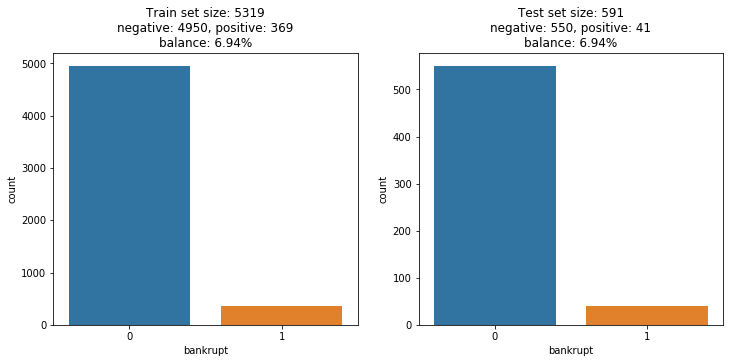

In [11]:
# sets balance vizualization

fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (12,5))
sns.countplot(train_set[target], ax = ax[0])
sns.countplot(test_set[target], ax = ax[1])

ax[0].set_title("Train set size: {}\nnegative: {}, positive: {}\nbalance: {}%".format(
    train_set[target].shape[0], sum(train_set[target]==0), sum(train_set[target]==1),
    round(sum(train_set[target]==1)/train_set.shape[0]*100, 2)))
ax[1].set_title("Test set size: {}\nnegative: {}, positive: {}\nbalance: {}%".format(
    test_set[target].shape[0], sum(test_set[target]==0), sum(test_set[target]==1),
    round(sum(test_set[target]==1)/test_set.shape[0]*100, 2)))

plt.show()

##### Data imputation for train and test set

In [12]:
print("\t\t\t\tTRAIN SET MISSINGS")
get_missing_info(train_set, target)

				TRAIN SET MISSINGS


,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr24,121.0,2.274864,120.0,1.0,0.83
Attr64,95.0,1.786050,80.0,15.0,15.79
Attr54,95.0,1.786050,80.0,15.0,15.79
Attr28,95.0,1.786050,80.0,15.0,15.79
Attr53,95.0,1.786050,80.0,15.0,15.79
Attr41,76.0,1.428840,76.0,0.0,0.00
Attr32,42.0,0.789622,41.0,1.0,2.38
Attr52,32.0,0.601617,32.0,0.0,0.00
Attr47,31.0,0.582816,31.0,0.0,0.00
Attr4,21.0,0.394811,18.0,3.0,14.29


In [13]:
print("\t\t\t\tTEST SET MISSINGS")
get_missing_info(test_set, target)

				TEST SET MISSINGS


,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr24,14.0,2.368866,14.0,0.0,0.00
Attr28,12.0,2.030457,8.0,4.0,33.33
Attr53,12.0,2.030457,8.0,4.0,33.33
Attr54,12.0,2.030457,8.0,4.0,33.33
Attr64,12.0,2.030457,8.0,4.0,33.33
Attr41,8.0,1.353638,8.0,0.0,0.00
Attr32,4.0,0.676819,4.0,0.0,0.00
Attr47,4.0,0.676819,4.0,0.0,0.00
Attr52,4.0,0.676819,4.0,0.0,0.00
Attr5,1.0,0.169205,1.0,0.0,0.00


In [16]:
# Train set imputation
train_set_imp, miss_indices_train, miss_hist_train, miss_hist_ch_train = RFimputation(train_set, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
test_set_imp, miss_indices_valid, miss_hist_valid, miss_hist_ch_valid = RFimputation(test_set, n_iter=10,
                                                                                     target=target, n_estimators=100,
                                                                                     n_jobs=-1, max_depth=8,
                                                                                     random_state=random_state)

train_test_imp_sets = dict(zip(["train_set_imp", "test_set_imp"], [train_set_imp, test_set_imp]))

# SAVING IMPUTED TRAIN AND TEST SET as dict
with open(r"data\5year_data\train_test_imp_sets_5year.p", "wb") as fp:
    pickle.dump(train_test_imp_sets, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 163 seconds
Imputation time: 6 seconds


In [14]:
# LOADING IMPUTED TRAIN AND TEST SET
with open(r"data\5year_data\train_test_imp_sets_5year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

##### training distribution analysis

							 RAW DATA


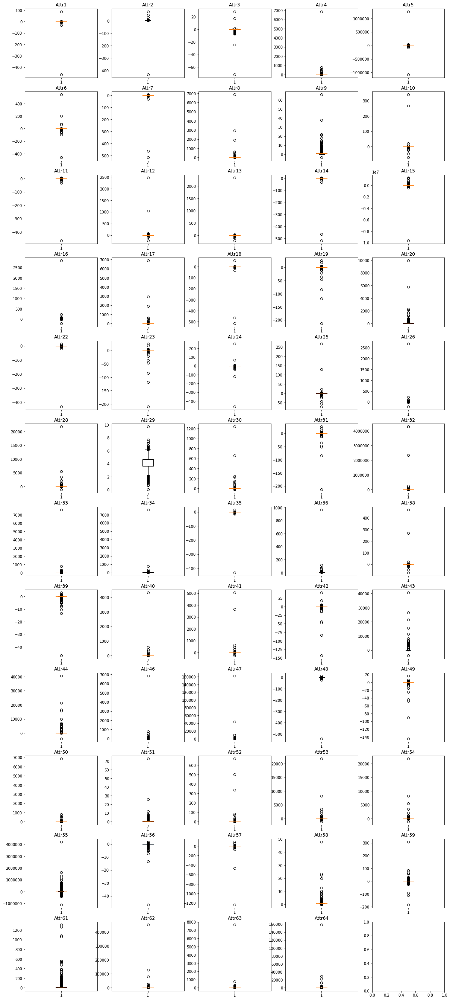

In [15]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t RAW DATA")
plt.show()

Lots of outliers, lets reduce them with quantiles

In [16]:
q=0.005
lb=np.quantile(a=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),:].values, q=q, axis=0)
ub=np.quantile(a=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),:].values, q=1-q, axis=0)

for i, feature in enumerate(features):
    train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature]=train_set_imp.loc[
        (train_set_imp[target]==0)|(train_set_imp[target]==1),feature].apply(
        lambda x: lb[i] if x<lb[i] else ub[i] if x>ub[i] else x)

							 Q_0.005 and Q_0.995 replaced


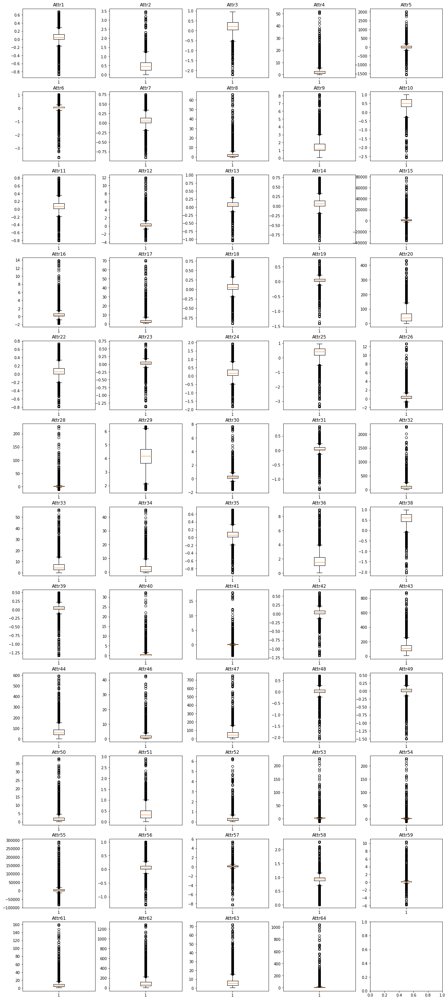

In [17]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t Q_{} and Q_{} replaced".format(q, 1-q))
plt.show()

							 Q_0.005 and Q_0.995 replaced


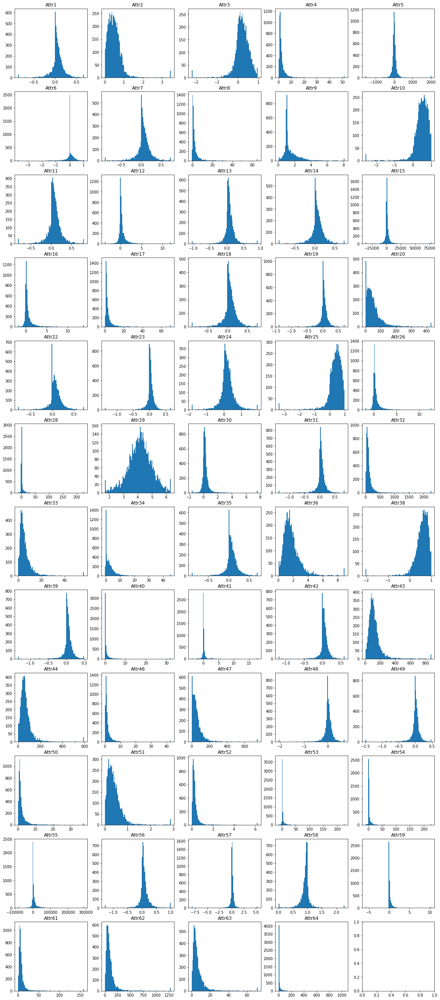

In [18]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t Q_{} and Q_{} replaced".format(q, 1-q))
plt.show()

skewness is very big in this data, lets apply some power transforms.

In [19]:
transformer = PowerTransformer(method="yeo-johnson", standardize=False)
transformer.fit(X=train_set_imp[features])
train_set_imp_pt = pd.DataFrame(transformer.transform(X=train_set_imp[features]), columns=features)

				 Q_0.005 and Q_0.995 replaced, power transform applied


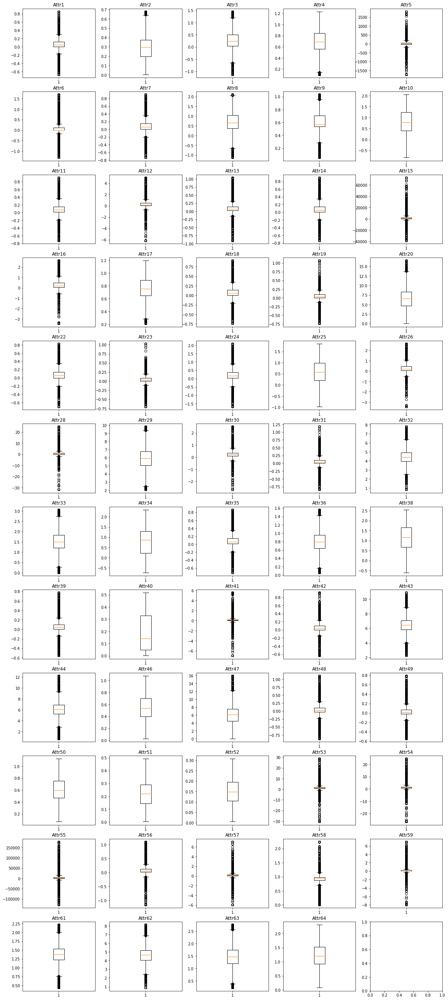

In [20]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp_pt.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t Q_{} and Q_{} replaced, power transform applied".format(q, 1-q))
plt.show()

				 Q_0.005 and Q_0.995 replaced, power transform applied


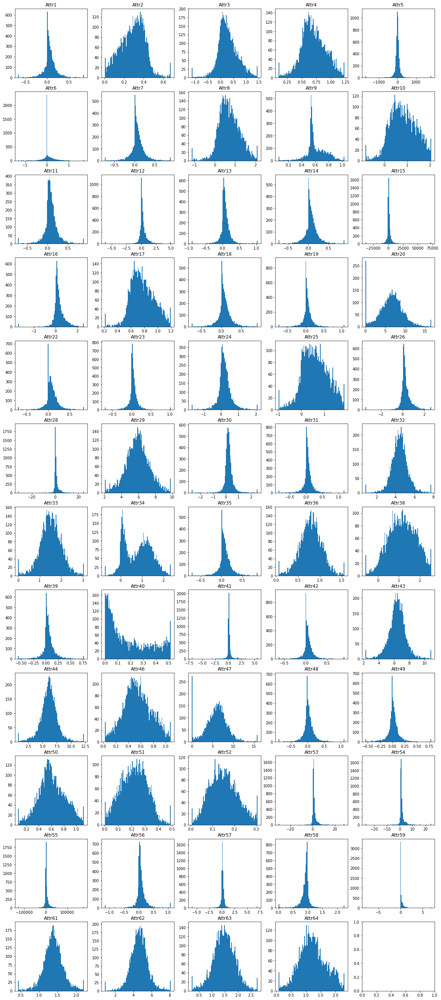

In [21]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp_pt.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t\t\t Q_{} and Q_{} replaced, power transform applied".format(q, 1-q))
plt.show()

In [22]:
# print fitted lambdas
pd.Series(transformer.lambdas_, index=features, name="lambdas")

Attr1     1.780787
Attr2    -1.251121
Attr3     2.056485
Attr4    -0.775082
Attr5     0.984158
Attr6     2.218890
Attr7     1.603980
Attr8    -0.378985
Attr9    -0.807038
Attr10    2.739453
Attr11    1.341861
Attr12    0.474946
Attr13    1.351351
Attr14    1.604331
Attr15    0.993216
Attr16   -0.019896
Attr17   -0.810869
Attr18    1.573126
Attr19    2.397315
Attr20    0.288950
Attr22    1.395906
Attr23    2.503872
Attr24    1.139070
Attr25    2.607039
Attr26    0.008329
Attr28    0.467516
Attr29    1.326170
Attr30    0.137059
Attr31    2.044360
Attr32    0.001660
Attr33   -0.146622
Attr34   -0.283564
Attr35    1.670606
Attr36   -0.360287
Attr38    3.206772
Attr39    3.074886
Attr40   -1.934319
Attr41    0.396032
Attr42    2.573368
Attr43    0.129995
Attr44    0.185685
Attr46   -0.895822
Attr47    0.234952
Attr48    2.473536
Attr49    3.243062
Attr50   -0.850965
Attr51   -1.874218
Attr52   -3.253603
Attr53    0.503700
Attr54    0.462801
Attr55    0.957857
Attr56    1.235569
Attr57    1.

After skewness and outliers reduction zero mean and unit variance standarization is necessary.

In [23]:
normalizer=StandardScaler()
normalizer.fit(X=train_set_imp_pt)
train_set_imp_pt_norm=pd.DataFrame(normalizer.transform(X=train_set_imp_pt), columns=features)

		 Q_0.005 and Q_0.995 replaced, power transform and normalization applied


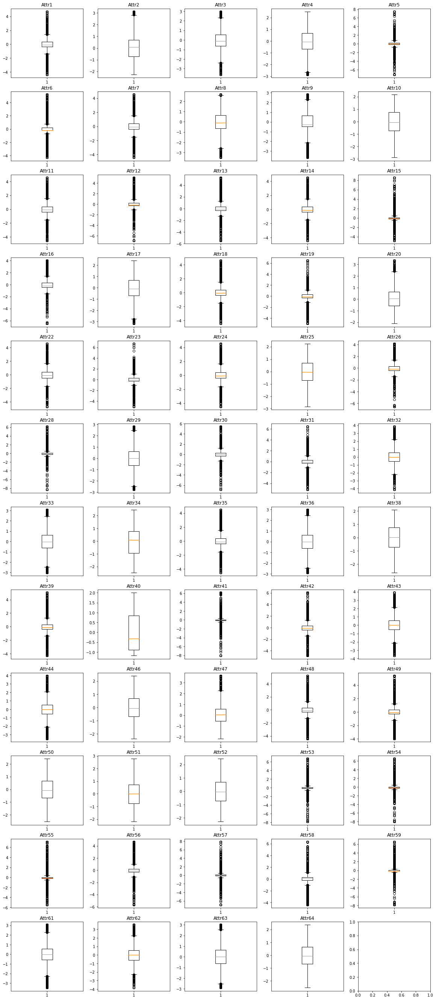

In [24]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp_pt_norm.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t Q_{} and Q_{} replaced, power transform and normalization applied".format(q, 1-q))
plt.show()

		 Q_0.005 and Q_0.995 replaced, power transform and normalization applied


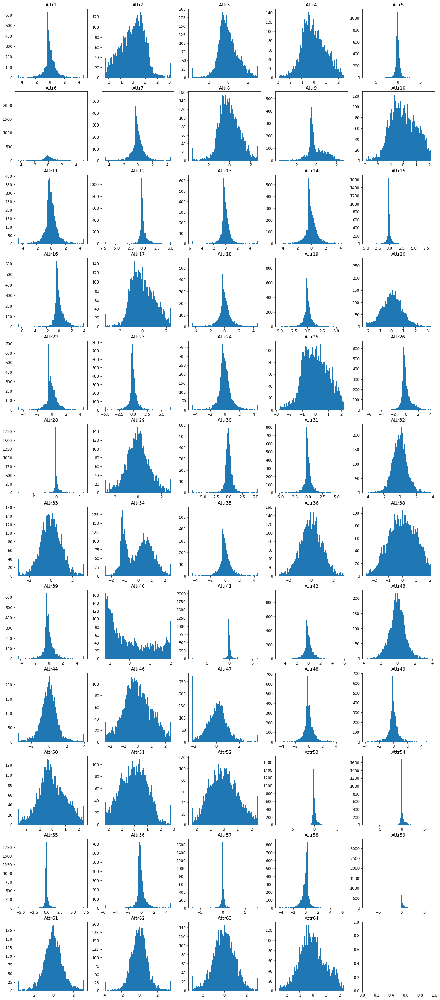

In [25]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp_pt_norm.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t Q_{} and Q_{} replaced, power transform and normalization applied".format(q, 1-q))
plt.show()

Distributions looks much better now, Gaussian-shape is not achived, however outliers and skewness are reduced. Attr40 distribution looks problematic (two modes). Attr40 also is not looking great.

##### Modelling 
 - preparing folds for n-fold Cross Validation (with imputation, just for time saving - one fold imputation takes 120 seconds on average, it does not make sense to perform it during hyperparameters optimization especially with fixed random seed)

In [12]:
# sets inicialization
trains=[]
valids=[]

# Stratification object
kf = StratifiedKFold(6, shuffle=True, random_state=random_state)
for train, valid in kf.split(train_set, train_set[target]):
    # extracting sets
    train_data = train_set.loc[train,:].copy()
    valid_data = train_set.loc[valid,:].copy()
    # reset index
    train_data.reset_index(drop=True, inplace=True)
    valid_data.reset_index(drop=True, inplace=True)
    # imputation
    train_data, miss_indices_train, miss_hist_train, miss_hist_ch_train = RFimputation(train_data, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
    valid_data, miss_indices_valid, miss_hist_valid, miss_hist_ch_valid = RFimputation(valid_data, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
    
    # saving
    trains.append(train_data)
    valids.append(valid_data)
    
sets = {"training_sets" : trains,
        "validation_sets" : valids}

#SAVING
with open(r"data\5year_data\sets.p", "wb") as fp:
    pickle.dump(sets, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 119 seconds
Imputation time: 9 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 112 seconds
Imputation time: 8 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 110 seconds
Imputation time: 8 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 113 seconds
Imputation time: 8 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 113 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 8 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 114 seconds
Imputation time: 8 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


In [26]:
#LOADING
with open(r"data\5year_data\sets.p", "rb") as fp:
    sets = pickle.load(fp)

##### Logistic regression

In [27]:
def Logit_6FoldCrossValidation(datasets, features, target, random_state, normalize=False, q=None, alpha="none", info=0):
    '''
    function performes 6 fold Cross Validation for Logistic Regression, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    random_state - random seed,
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    alpha - L1 norm regularization parameter, "none" for no regularization, (0,inf) for regularization
    info - folds' info
    
    returns Logit_history - dictionary with CV results 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    trainROCs = []
    trainPRs = []
    validROCs = []
    validPRs = []
    
    CVstart=time.time()
    for fold in range(len(training_sets)):
        if info==1:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for Logistc Regression
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # Logistic Regression training
        formula = "{}~{}".format(target, "+".join(features))
        LogitRegression = smf.logit(formula, pd.concat((X_train, Y_train), axis=1))
        if alpha == "none":
            LogitRegression=LogitRegression.fit(method="powell", maxiter=1000, disp=info)
        else:
            LogitRegression=LogitRegression.fit_regularized(method="l1", alpha=alpha, disp=info)
        
        # metrics
        predsTrain = LogitRegression.predict(exog=X_train)
        predsValid = LogitRegression.predict(exog=X_valid)
        
        trainROC = roc_auc_score(y_true=Y_train, y_score=predsTrain)
        trainPR = average_precision_score(y_true=Y_train, y_score=predsTrain)
        validROC = roc_auc_score(y_true=Y_valid, y_score=predsValid)
        validPR = average_precision_score(y_true=Y_valid, y_score=predsValid)
        
        # metrics saving
        trainROCs.append(trainROC)
        trainPRs.append(trainPR)
        validROCs.append(validROC)
        validPRs.append(validPR)
        
        if info==1:
            print("\ntrain roc: {}\ntrain pr: {}\nvalid roc: {}\nvalid pr: {}".format(trainROC, trainPR, validROC,
                                                                                       validPR))
        
    Logit_history={"train_roc" : trainROCs,
                   "train_pr" : trainPRs,
                   "valid_roc" : validROCs,
                   "valid_pr" : validPRs}       

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))

    return Logit_history

In [206]:
# without normalization
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=False, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\s


Cross validation time: 51s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 21s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-

0.03 fatal error


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))


0.05 fatal error


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))


0.08 fatal error


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))



Cross validation time: 24s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 19s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 16s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 15s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 15s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 12s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 11s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 10s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 10s


In [207]:
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))


alpha: none
train_roc 0.8619322528555574
train_pr 0.4961574380039313
valid_roc 0.829819666789524
valid_pr 0.4015954955787804

alpha: 0.01
train_roc 0.8687306723480842
train_pr 0.5175966821417052
valid_roc 0.834064334513832
valid_pr 0.41022388893203204

alpha: 0.03, - failure

alpha: 0.05, - failure

alpha: 0.08, - failure

alpha: 0.1
train_roc 0.8692546404012202
train_pr 0.5154078304514972
valid_roc 0.835424258449113
valid_pr 0.40900241444552443

alpha: 0.3
train_roc 0.8696638614240036
train_pr 0.5122454495023278
valid_roc 0.835258774952059
valid_pr 0.4050673355949393

alpha: 0.5
train_roc 0.8695700180449958
train_pr 0.5078382559507585
valid_roc 0.8337832582835226
valid_pr 0.40121009748315695

alpha: 0.8
train_roc 0.8687999086426684
train_pr 0.5013296736648104
valid_roc 0.834767399003253
valid_pr 0.3967812611320461

alpha: 1
train_roc 0.8681384533605442
train_pr 0.49674129287941055
valid_roc 0.8384151670058597
valid_pr 0.40129694825309165

alpha: 2
train_roc 0.8667343740719519
train_p

In [208]:
# with normalization
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=True, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)



Cross validation time: 39s

Cross validation time: 20s

Cross validation time: 21s

Cross validation time: 22s

Cross validation time: 23s

Cross validation time: 23s

Cross validation time: 25s

Cross validation time: 22s

Cross validation time: 19s

Cross validation time: 16s

Cross validation time: 12s

Cross validation time: 10s

Cross validation time: 9s

Cross validation time: 8s


In [209]:
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))


alpha: none
train_roc 0.8596433423451488
train_pr 0.4925286623082937
valid_roc 0.8265435956604651
valid_pr 0.39770376154343984

alpha: 0.01
train_roc 0.8670204122531633
train_pr 0.509773810297571
valid_roc 0.8334141520973883
valid_pr 0.40703873625828474

alpha: 0.03
train_roc 0.8654798533155063
train_pr 0.5009843671842099
valid_roc 0.8307040259816568
valid_pr 0.3996997524776534

alpha: 0.05
train_roc 0.8627190522766478
train_pr 0.4910193357082604
valid_roc 0.8262556821520333
valid_pr 0.39564521472343994

alpha: 0.08
train_roc 0.8575532335923214
train_pr 0.4759019712734847
valid_roc 0.8184612919250678
valid_pr 0.38347040991429293

alpha: 0.1
train_roc 0.855512892792727
train_pr 0.4706404383643692
valid_roc 0.8168986533767074
valid_pr 0.38191899617017994

alpha: 0.3
train_roc 0.8410903668436981
train_pr 0.43565224988843076
valid_roc 0.8059683829303079
valid_pr 0.3571770575784034

alpha: 0.5
train_roc 0.8309342603239553
train_pr 0.4158174459451649
valid_roc 0.7969646758435761
valid_pr 0.

In [210]:
# with normalization and outlier reduction (q=0.005)
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=True, q=0.005, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)



Cross validation time: 24s

Cross validation time: 22s

Cross validation time: 22s

Cross validation time: 23s

Cross validation time: 22s
0.1 fatal error

Cross validation time: 15s

Cross validation time: 12s

Cross validation time: 11s

Cross validation time: 11s

Cross validation time: 10s

Cross validation time: 9s

Cross validation time: 8s

Cross validation time: 7s


In [211]:
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))


alpha: none
train_roc 0.8614357556699872
train_pr 0.5045913639882703
valid_roc 0.824457798503277
valid_pr 0.4307664050509432

alpha: 0.01
train_roc 0.8624839003000092
train_pr 0.5133824162481829
valid_roc 0.8241393843244715
valid_pr 0.4297067262915784

alpha: 0.03
train_roc 0.861654938914933
train_pr 0.5095470430935319
valid_roc 0.8249414825141953
valid_pr 0.4263198110858319

alpha: 0.05
train_roc 0.8616444328218091
train_pr 0.5088370801295089
valid_roc 0.8250264677446063
valid_pr 0.42565914880961825

alpha: 0.08
train_roc 0.8615857530420752
train_pr 0.508498810672717
valid_roc 0.8251446778733929
valid_pr 0.42639379193613375

alpha: 0.1, - failure

alpha: 0.3
train_roc 0.7506887060887654
train_pr 0.37550710616989164
valid_roc 0.7249463968078458
valid_pr 0.3208854452657017

alpha: 0.5
train_roc 0.8038798642544571
train_pr 0.41677898102441363
valid_roc 0.7851018914688931
valid_pr 0.38338980155549446

alpha: 0.8
train_roc 0.8384524760272466
train_pr 0.45548615606833315
valid_roc 0.796433

There is an improvement!

In [212]:
# with normalization and outlier reduction (q=0.005) and power transform
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize="power", q=0.005, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)



Cross validation time: 30s

Cross validation time: 25s

Cross validation time: 25s

Cross validation time: 24s

Cross validation time: 23s

Cross validation time: 23s

Cross validation time: 18s
0.5 fatal error
0.8 fatal error

Cross validation time: 15s

Cross validation time: 13s

Cross validation time: 12s

Cross validation time: 11s

Cross validation time: 11s


In [213]:
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))


alpha: none
train_roc 0.8831408462560372
train_pr 0.5729717877370877
valid_roc 0.8513168170333693
valid_pr 0.48541749129364314

alpha: 0.01
train_roc 0.8893954187161176
train_pr 0.5781964976531823
valid_roc 0.8494408388485596
valid_pr 0.48441415612758426

alpha: 0.03
train_roc 0.8893064141136394
train_pr 0.57783436487557
valid_roc 0.8498228183474086
valid_pr 0.48551862238243454

alpha: 0.05
train_roc 0.8892257312325421
train_pr 0.5777116637354772
valid_roc 0.84986913022344
valid_pr 0.4861433763444682

alpha: 0.08
train_roc 0.8891137595336588
train_pr 0.57784179823102
valid_roc 0.8500920895897099
valid_pr 0.4872001144360803

alpha: 0.1
train_roc 0.8890288775482734
train_pr 0.5779474505008189
valid_roc 0.8502064003333173
valid_pr 0.48789977104185195

alpha: 0.3
train_roc 0.858688765056547
train_pr 0.5209346225944484
valid_roc 0.8201718400290585
valid_pr 0.43693096357807043

alpha: 0.5, - failure

alpha: 0.8, - failure

alpha: 1
train_roc 0.8739185184900317
train_pr 0.5420739379260365
va

Whats an improvement! Best model with power transform and outlier reduction noted 0.4964 PR (+0.06) with 0.05 overfitting (-0.02) and 0.8516 ROC (+0.025) with 0.02 overfitting (-0.02)! So the best set up for logistic regression is $\alpha=1$ trained on data with outliers reduction ($q=0.005$) and power transform.

##### Random Forest, hyperparameters optimization
 - 6 fold Cross validation for Random Forest

In [28]:
def RF_6FoldCrossValidation(datasets, features, target, random_state, normalize="power", q=None, saveModels=False, info=0,
                            *args, **kwargs):
    '''
    function performes 6 fold Cross Validation for Random Forest, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    info - fold's info,
    random_state - random seed
    *args and **kwargs - hyperparameters for Random Forest
    
    returns RFhistoriey - dictionary with CV results 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    trainROCs = []
    trainPRs = []
    validROCs = []
    validPRs = []
    
    if saveModels:
        models = []
    
    CVstart=time.time()
    for fold in range(len(training_sets)):
        if info==1:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for RF
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # RF training
        RF = RandomForestClassifier(*args, **kwargs)
        RF.fit(X_train, Y_train)
        
        # metrics
        predsTrain = RF.predict_proba(X_train)[:,1]
        predsValid = RF.predict_proba(X_valid)[:,1]
        
        trainROC = roc_auc_score(y_true=Y_train, y_score=predsTrain)
        trainPR = average_precision_score(y_true=Y_train, y_score=predsTrain)
        validROC = roc_auc_score(y_true=Y_valid, y_score=predsValid)
        validPR = average_precision_score(y_true=Y_valid, y_score=predsValid)
        
        # metrics saving
        trainROCs.append(trainROC)
        trainPRs.append(trainPR)
        validROCs.append(validROC)
        validPRs.append(validPR)
        
        # model saving
        if saveModels:
            models.append(RF)
        
        if info==1:
            print("\ntrain roc: {}\ntrain pr: {}\nvalid roc: {}\nvalid pr: {}".format(trainROC, trainPR, validROC,
                                                                                       validPR))
        
    RFhistory={"train_roc" : trainROCs,
               "train_pr" : trainPRs,
               "valid_roc" : validROCs,
               "valid_pr" : validPRs}       

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    if saveModels:
        RFhistory["models"]=models
        return RFhistory
    return RFhistory

In [216]:
# attempt without normalization
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=False, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 15s
valid ROC: 0.8696099546496163
valid PR: 0.44965477716734864
overfitting ROC: 0.13039004535038368
overfitting PR: 0.5503452228326513


In [217]:
# attempt with normalization
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=True, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 14s
valid ROC: 0.8689690132418848
valid PR: 0.4507745115957902
overfitting ROC: 0.1310309867581152
overfitting PR: 0.5492254884042098


There is an improvement

In [218]:
# attempt with normalization and outlier reduction (0.005)
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=True, q=0.005, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 14s
valid ROC: 0.8747677462087827
valid PR: 0.45520367533102285
overfitting ROC: 0.12523225379121727
overfitting PR: 0.5447963246689771


Model gets better!

In [219]:
# attempt with normalization, outlier reduction (0.005) and power transform
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize="power", q=0.005, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 17s
valid ROC: 0.8750901666052379
valid PR: 0.45440207208143585
overfitting ROC: 0.12490983339476214
overfitting PR: 0.5455979279185641


Power transform doesn't help in Random Forest, but lets continue testing with it.

In [220]:
depths = [i for i in range(2,22,2)]
RFhists = []
for depth in depths:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                     normalize="power", q=0.005, info=0, saveModels=False, max_depth=depth)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(depths, RFhists))

for key in RF_CV_history.keys():
    print("\ndepth:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 6s

Cross validation time: 8s

Cross validation time: 10s

Cross validation time: 13s

Cross validation time: 14s

Cross validation time: 15s

Cross validation time: 16s

Cross validation time: 16s

Cross validation time: 17s

Cross validation time: 17s

depth: 2
valid ROC: 0.8400206453749552
valid PR: 0.38499439314097944
overfitting ROC: 0.01849379168997034
overfitting PR: 0.043376518915176354

depth: 4
valid ROC: 0.851995870925009
valid PR: 0.42505810773985714
overfitting ROC: 0.04394781142495119
overfitting PR: 0.15880382271936339

depth: 6
valid ROC: 0.8646615280248279
valid PR: 0.44986500114463945
overfitting ROC: 0.07359291154409209
overfitting PR: 0.3024576152099171

depth: 8
valid ROC: 0.8691911713646245
valid PR: 0.45343763008596966
overfitting ROC: 0.10437799207483811
overfitting PR: 0.4107381533720897

depth: 10
valid ROC: 0.8701041349507769
valid PR: 0.4623872874500284
overfitting ROC: 0.12247454067557428
overfitting PR: 0.4771377357682693

depth: 12

6-12 should be ok, mean=9 and that value will be used for further sequentional checking.
 - number of trees (weak estimators in ensemble learning words)

In [221]:
nums_of_trees = [10, 25, 75, 100, 200, 400, 600, 800, 1000]
RFhists = []
for num_of_trees in nums_of_trees:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                    normalize="power", q=0.005, saveModels=False, max_depth=9, n_estimators=num_of_trees)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(nums_of_trees, RFhists))


Cross validation time: 4s

Cross validation time: 5s

Cross validation time: 10s

Cross validation time: 13s

Cross validation time: 23s

Cross validation time: 43s

Cross validation time: 63s

Cross validation time: 82s

Cross validation time: 102s


In [222]:
for key in RF_CV_history.keys():
    print("\ndepth:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


depth: 10
valid ROC: 0.8460032103157434
valid PR: 0.39633578523098195
overfitting ROC: 0.12677208120088646
overfitting PR: 0.47837611247211925

depth: 25
valid ROC: 0.8589904331522522
valid PR: 0.4451366063693694
overfitting ROC: 0.12097437269632616
overfitting PR: 0.44745958645459455

depth: 75
valid ROC: 0.8664887638948983
valid PR: 0.4638221506018487
overfitting ROC: 0.1189428460836468
overfitting PR: 0.4413055706921568

depth: 100
valid ROC: 0.8719512149522726
valid PR: 0.4638114962548254
overfitting ROC: 0.11314984557046415
overfitting PR: 0.43935427459302673

depth: 200
valid ROC: 0.8705868841775769
valid PR: 0.46647935784171085
overfitting ROC: 0.11573931960909478
overfitting PR: 0.4413359796765575

depth: 400
valid ROC: 0.8728399275675849
valid PR: 0.4638657648865719
overfitting ROC: 0.11440920062794546
overfitting PR: 0.4467296523922049

depth: 600
valid ROC: 0.8728298853153428
valid PR: 0.4695408943014636
overfitting ROC: 0.11419441539299702
overfitting PR: 0.439873952896246

100 trees is enough for experiments.

 - max number of features

In [223]:
print('Rule of thumb\nsquare root of number of features : {}'.format((len(features))**(1/2)))

Rule of thumb
square root of number of features : 7.681145747868608


In [225]:
max_features = [i for i in range(1,len(features), 4)]
RFhists = []
for n in max_features:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize="power", q=0.005, saveModels=False, max_depth=9, n_estimators=100,
                                     max_features=n)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(max_features, RFhists))

for key in RF_CV_history.keys():
    print("\nmax number of features:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 6s

Cross validation time: 10s

Cross validation time: 15s

Cross validation time: 20s

Cross validation time: 25s

Cross validation time: 30s

Cross validation time: 35s

Cross validation time: 40s

Cross validation time: 45s

Cross validation time: 50s

Cross validation time: 54s

Cross validation time: 59s

Cross validation time: 64s

Cross validation time: 69s

Cross validation time: 74s

max number of features: 1
valid ROC: 0.8586973382689934
valid PR: 0.4067165889179187
overfitting ROC: 0.11748962207431879
overfitting PR: 0.450756787596912

max number of features: 5
valid ROC: 0.8650333584389639
valid PR: 0.44045097040359327
overfitting ROC: 0.1190427830683295
overfitting PR: 0.45986745595684597

max number of features: 9
valid ROC: 0.8732830686558871
valid PR: 0.4666126970812154
overfitting ROC: 0.11312190882312056
overfitting PR: 0.44171292478306906

max number of features: 13
valid ROC: 0.8743362231516648
valid PR: 0.48716753922566297
overfitting ROC: 0

Best results for $>37$
 - min sample split

In [226]:
min_sample_spilt = [2, 4, 6, 8, 10, 15, 20, 30]
RFhists = []
for min_split in min_sample_spilt:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize="power", q=0.005, saveModels=False, max_depth=9, n_estimators=100,
                                     max_features=57, min_samples_split=min_split)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(min_sample_spilt, RFhists))

for key in RF_CV_history.keys():
    print("\nmin samples to split:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 74s

Cross validation time: 74s

Cross validation time: 74s

Cross validation time: 74s

Cross validation time: 74s

Cross validation time: 74s

Cross validation time: 74s

Cross validation time: 73s

min samples to split: 2
valid ROC: 0.8830977944436431
valid PR: 0.5259891955752477
overfitting ROC: 0.10548236328235416
overfitting PR: 0.40016601785461325

min samples to split: 4
valid ROC: 0.8838600975380456
valid PR: 0.5268561501479193
overfitting ROC: 0.10359889357448404
overfitting PR: 0.39359587420355724

min samples to split: 6
valid ROC: 0.8838221185947258
valid PR: 0.5239259649615013
overfitting ROC: 0.10260555058405374
overfitting PR: 0.3890747234189409

min samples to split: 8
valid ROC: 0.8825933315171813
valid PR: 0.522530639363025
overfitting ROC: 0.10247465491681029
overfitting PR: 0.3810651512306069

min samples to split: 10
valid ROC: 0.8838572130613379
valid PR: 0.5226489507411983
overfitting ROC: 0.1001963162244981
overfitting PR: 0.371639759575

2-10 is a resonable range to try in random search, best results with 2. Higher parameter, less overfitting, but when it is too big it hurts performance.
 
 - min samples leaf, this parameter has to be lower than min_sample_split, thus while testing range 2-10 for min samples leaf, min_sample_split has to be at least 11. 

In [227]:
min_sample_leaf = [i for i in range(0,12,2) if i > 0]
RFhists = []
for min_leaf in min_sample_leaf:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize="power", q=0.005, saveModels=False, max_depth=9, n_estimators=100,
                                     max_features=57, min_samples_split=11, min_samples_leaf=min_leaf)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(min_sample_leaf, RFhists))

for key in RF_CV_history.keys():
    print("\nmin samples in leaf:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 76s

Cross validation time: 73s

Cross validation time: 72s

Cross validation time: 72s

Cross validation time: 71s

min samples in leaf: 2
valid ROC: 0.8846146552783253
valid PR: 0.5230524839376555
overfitting ROC: 0.09800363644212817
overfitting PR: 0.36293436759906106

min samples in leaf: 4
valid ROC: 0.8846055211020838
valid PR: 0.5244893667238243
overfitting ROC: 0.09755939447784501
overfitting PR: 0.35534334349557195

min samples in leaf: 6
valid ROC: 0.8863144934271324
valid PR: 0.5226632831850505
overfitting ROC: 0.09454729762950609
overfitting PR: 0.3441824054943208

min samples in leaf: 8
valid ROC: 0.8825982191027141
valid PR: 0.5134998929955653
overfitting ROC: 0.0945365289018889
overfitting PR: 0.32508886339508014

min samples in leaf: 10
valid ROC: 0.8846892243428468
valid PR: 0.5070363020095797
overfitting ROC: 0.08938592069439488
overfitting PR: 0.3048997589721455


Same situation as for min samples split, higher parameter reduces overfitting and results it seems to be reasonable to try range 1-min_samples_split,<br>
To sum up:
 - max_depth $\in \{6,7,...,12\}$
 - n_estimators = 100 for random search, more can be tested after finding the best set of parameters,
 - max_features $>37$,
 - min_samples_split $\in \{2,3,...,10\}$,
 - min_samples_leaf $\in \{1,2,...,\text{min_samples_split}\}$
 
 
 - Random Search

In [126]:
start = time.time()
# results DataFrame inicialization 
rstls = pd.DataFrame(columns = ["max_depth", "max_features", "min_samples_split", "min_samples_leaf", 
                                "ROCvalid", "overfittingROC", "PRvalid", "OverfittingPR","norm_mode"])#

# normalization methods
norms={1:True, 2:False, 3:"power"}

# searching loop
for k in range(75):
    # its necessary to reset seeds in every iteration, because of RF_6FoldCrossValidation() definition
    np.random.seed(seed=None)
    random.seed(a=None)
    # parameters dictionary
    params = {
        "max_depth" : random.randint(6, 12),
        "max_features" : random.randint(37, len(features)),
        "min_samples_split" : random.randint(2, 10),
    }
    # min_samples_leaf has to be lower than min_sample_split
    params["min_samples_leaf"] = random.randint(1, params["min_samples_split"])
    
    norm_mode=random.choice(list(norms.keys()))
    
    # CV 
    RFhist = RF_6FoldCrossValidation(datasets=sets,
                                     features=features,
                                     target=target,
                                     random_state=random_state,
                                     normalize=norms[norm_mode],
                                     q=0.005,
                                     info=0,
                                     saveModels=False,
                                     max_depth=params["max_depth"],
                                     n_estimators=100,
                                     max_features=params["max_features"],
                                     min_samples_split=params["min_samples_split"],
                                     min_samples_leaf=params["min_samples_leaf"])
    
    
    # saving
    rstls = rstls.append(other = pd.DataFrame(data = np.array([params["max_depth"], params["max_features"], params["min_samples_split"],
                        params["min_samples_leaf"], np.mean(RFhist["valid_roc"]),
                           np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]), np.mean(RFhist["valid_pr"]),
                           np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]), norm_mode]).reshape(1, -1), columns = rstls.columns.tolist()), ignore_index=True)
    
    
    # current iteration result
    print((rstls.iloc[k, :].to_dict()))
    print('-'*30)
    
    # top 5 per 10 iterations
    if (k+1) % 10 == 0:    
        print("\n Top 5:")
        display(rstls.sort_values(by = "PRvalid", ascending = False).head(5))

stop = time.time()
print("Loop time: {} seconds".format(round(stop-start, 2)))

#SAVING
with open(r"results\5year\RF_RS.p", "wb") as fp:
    pickle.dump(rstls, fp)


Cross validation time: 47s
{'max_depth': 8.0, 'max_features': 40.0, 'min_samples_split': 2.0, 'min_samples_leaf': 2.0, 'ROCvalid': 0.8813206095860776, 'overfittingROC': 0.09812005322888173, 'PRvalid': 0.520096999632572, 'OverfittingPR': 0.36443718503807143, 'norm_mode': 3.0}
------------------------------

Cross validation time: 73s
{'max_depth': 12.0, 'max_features': 49.0, 'min_samples_split': 8.0, 'min_samples_leaf': 7.0, 'ROCvalid': 0.8849704341137445, 'overfittingROC': 0.10340827877340775, 'PRvalid': 0.5169398942812734, 'OverfittingPR': 0.3734676588459478, 'norm_mode': 3.0}
------------------------------

Cross validation time: 71s
{'max_depth': 10.0, 'max_features': 53.0, 'min_samples_split': 9.0, 'min_samples_leaf': 1.0, 'ROCvalid': 0.8853895646042659, 'overfittingROC': 0.10411018157789054, 'PRvalid': 0.5255189580284405, 'OverfittingPR': 0.3950341114936746, 'norm_mode': 1.0}
------------------------------

Cross validation time: 64s
{'max_depth': 8.0, 'max_features': 59.0, 'min_

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
4,12.0,52.0,4.0,4.0,0.889938,0.104628,0.528677,0.418500,1.0
6,12.0,42.0,3.0,3.0,0.886187,0.110103,0.525679,0.437427,3.0
2,10.0,53.0,9.0,1.0,0.885390,0.104110,0.525519,0.395034,1.0
5,9.0,52.0,4.0,1.0,0.882449,0.105094,0.523872,0.397768,3.0
0,8.0,40.0,2.0,2.0,0.881321,0.098120,0.520097,0.364437,3.0



Cross validation time: 72s
{'max_depth': 11.0, 'max_features': 49.0, 'min_samples_split': 3.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.8872040072859745, 'overfittingROC': 0.1068241993969552, 'PRvalid': 0.5215720308662398, 'OverfittingPR': 0.4257435472141904, 'norm_mode': 3.0}
------------------------------

Cross validation time: 66s
{'max_depth': 12.0, 'max_features': 46.0, 'min_samples_split': 10.0, 'min_samples_leaf': 8.0, 'ROCvalid': 0.8847390082741747, 'overfittingROC': 0.10143536757535654, 'PRvalid': 0.5116290827043786, 'OverfittingPR': 0.35943153493096947, 'norm_mode': 2.0}
------------------------------

Cross validation time: 45s
{'max_depth': 8.0, 'max_features': 41.0, 'min_samples_split': 10.0, 'min_samples_leaf': 8.0, 'ROCvalid': 0.8774881015335801, 'overfittingROC': 0.09226274527367773, 'PRvalid': 0.5063606007389816, 'OverfittingPR': 0.30700116892641416, 'norm_mode': 2.0}
------------------------------

Cross validation time: 54s
{'max_depth': 8.0, 'max_features': 47.0, 'm

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
4,12.0,52.0,4.0,4.0,0.889938,0.104628,0.528677,0.418500,1.0
6,12.0,42.0,3.0,3.0,0.886187,0.110103,0.525679,0.437427,3.0
2,10.0,53.0,9.0,1.0,0.885390,0.104110,0.525519,0.395034,1.0
5,9.0,52.0,4.0,1.0,0.882449,0.105094,0.523872,0.397768,3.0
14,12.0,55.0,3.0,3.0,0.890645,0.105096,0.523076,0.436311,2.0



Cross validation time: 42s
{'max_depth': 8.0, 'max_features': 38.0, 'min_samples_split': 4.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.8830973671137605, 'overfittingROC': 0.09391798224257208, 'PRvalid': 0.5176548684054936, 'OverfittingPR': 0.35518910527533665, 'norm_mode': 1.0}
------------------------------

Cross validation time: 41s
{'max_depth': 6.0, 'max_features': 45.0, 'min_samples_split': 6.0, 'min_samples_leaf': 6.0, 'ROCvalid': 0.8767145276135229, 'overfittingROC': 0.07144039143183145, 'PRvalid': 0.5062203144584675, 'OverfittingPR': 0.2631220045118081, 'norm_mode': 3.0}
------------------------------

Cross validation time: 46s
{'max_depth': 8.0, 'max_features': 42.0, 'min_samples_split': 4.0, 'min_samples_leaf': 4.0, 'ROCvalid': 0.8817416630610708, 'overfittingROC': 0.0930660483437683, 'PRvalid': 0.516446866928758, 'OverfittingPR': 0.3435893293006451, 'norm_mode': 2.0}
------------------------------

Cross validation time: 57s
{'max_depth': 12.0, 'max_features': 40.0, 'min_sa

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
4,12.0,52.0,4.0,4.0,0.889938,0.104628,0.528677,0.418500,1.0
27,12.0,58.0,4.0,3.0,0.892058,0.104350,0.527281,0.437093,3.0
6,12.0,42.0,3.0,3.0,0.886187,0.110103,0.525679,0.437427,3.0
2,10.0,53.0,9.0,1.0,0.885390,0.104110,0.525519,0.395034,1.0
5,9.0,52.0,4.0,1.0,0.882449,0.105094,0.523872,0.397768,3.0



Cross validation time: 70s
{'max_depth': 9.0, 'max_features': 58.0, 'min_samples_split': 5.0, 'min_samples_leaf': 5.0, 'ROCvalid': 0.8853929565352093, 'overfittingROC': 0.09625860113293117, 'PRvalid': 0.519682579060549, 'OverfittingPR': 0.3588914488148024, 'norm_mode': 2.0}
------------------------------

Cross validation time: 66s
{'max_depth': 12.0, 'max_features': 46.0, 'min_samples_split': 9.0, 'min_samples_leaf': 8.0, 'ROCvalid': 0.8850830088297036, 'overfittingROC': 0.10113583641875379, 'PRvalid': 0.5113554286682057, 'OverfittingPR': 0.35957744901203337, 'norm_mode': 1.0}
------------------------------

Cross validation time: 67s
{'max_depth': 9.0, 'max_features': 56.0, 'min_samples_split': 8.0, 'min_samples_leaf': 5.0, 'ROCvalid': 0.8877044372866689, 'overfittingROC': 0.09418345449121412, 'PRvalid': 0.5183277962368882, 'OverfittingPR': 0.36062591169353453, 'norm_mode': 2.0}
------------------------------

Cross validation time: 72s
{'max_depth': 9.0, 'max_features': 59.0, 'min_

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
4,12.0,52.0,4.0,4.0,0.889938,0.104628,0.528677,0.418500,1.0
27,12.0,58.0,4.0,3.0,0.892058,0.104350,0.527281,0.437093,3.0
6,12.0,42.0,3.0,3.0,0.886187,0.110103,0.525679,0.437427,3.0
2,10.0,53.0,9.0,1.0,0.885390,0.104110,0.525519,0.395034,1.0
37,11.0,43.0,7.0,1.0,0.881996,0.112449,0.524737,0.426460,1.0



Cross validation time: 48s
{'max_depth': 6.0, 'max_features': 57.0, 'min_samples_split': 9.0, 'min_samples_leaf': 7.0, 'ROCvalid': 0.8782777270323542, 'overfittingROC': 0.07092104844610725, 'PRvalid': 0.5076297554361503, 'OverfittingPR': 0.25807820307044904, 'norm_mode': 2.0}
------------------------------

Cross validation time: 79s
{'max_depth': 11.0, 'max_features': 53.0, 'min_samples_split': 4.0, 'min_samples_leaf': 1.0, 'ROCvalid': 0.8863903711894192, 'overfittingROC': 0.10993320767635684, 'PRvalid': 0.525013889566439, 'OverfittingPR': 0.44162327131528123, 'norm_mode': 3.0}
------------------------------

Cross validation time: 53s
{'max_depth': 9.0, 'max_features': 41.0, 'min_samples_split': 2.0, 'min_samples_leaf': 2.0, 'ROCvalid': 0.883650064900726, 'overfittingROC': 0.10313328276861522, 'PRvalid': 0.5208130505583695, 'OverfittingPR': 0.3955047079621453, 'norm_mode': 3.0}
------------------------------

Cross validation time: 59s
{'max_depth': 8.0, 'max_features': 50.0, 'min_s

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
4,12.0,52.0,4.0,4.0,0.889938,0.104628,0.528677,0.418500,1.0
27,12.0,58.0,4.0,3.0,0.892058,0.104350,0.527281,0.437093,3.0
6,12.0,42.0,3.0,3.0,0.886187,0.110103,0.525679,0.437427,3.0
2,10.0,53.0,9.0,1.0,0.885390,0.104110,0.525519,0.395034,1.0
41,11.0,53.0,4.0,1.0,0.886390,0.109933,0.525014,0.441623,3.0



Cross validation time: 66s
{'max_depth': 12.0, 'max_features': 42.0, 'min_samples_split': 6.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.886187095705869, 'overfittingROC': 0.11010285357756566, 'PRvalid': 0.5256791178333945, 'OverfittingPR': 0.43742713346129125, 'norm_mode': 3.0}
------------------------------

Cross validation time: 55s
{'max_depth': 8.0, 'max_features': 49.0, 'min_samples_split': 4.0, 'min_samples_leaf': 1.0, 'ROCvalid': 0.8790312164479271, 'overfittingROC': 0.09669771400042881, 'PRvalid': 0.5113293307022779, 'OverfittingPR': 0.36586293375233925, 'norm_mode': 2.0}
------------------------------

Cross validation time: 60s
{'max_depth': 11.0, 'max_features': 40.0, 'min_samples_split': 7.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.8836256002649444, 'overfittingROC': 0.10966362602220892, 'PRvalid': 0.5243387230833906, 'OverfittingPR': 0.4160037640137213, 'norm_mode': 3.0}
------------------------------

Cross validation time: 47s
{'max_depth': 6.0, 'max_features': 55.0, 'min

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
4,12.0,52.0,4.0,4.0,0.889938,0.104628,0.528677,0.418500,1.0
27,12.0,58.0,4.0,3.0,0.892058,0.104350,0.527281,0.437093,3.0
6,12.0,42.0,3.0,3.0,0.886187,0.110103,0.525679,0.437427,3.0
50,12.0,42.0,6.0,3.0,0.886187,0.110103,0.525679,0.437427,3.0
2,10.0,53.0,9.0,1.0,0.885390,0.104110,0.525519,0.395034,1.0



Cross validation time: 56s
{'max_depth': 7.0, 'max_features': 58.0, 'min_samples_split': 9.0, 'min_samples_leaf': 7.0, 'ROCvalid': 0.8788063340971854, 'overfittingROC': 0.08406200900642558, 'PRvalid': 0.5079461780191372, 'OverfittingPR': 0.2966985757008098, 'norm_mode': 1.0}
------------------------------

Cross validation time: 45s
{'max_depth': 6.0, 'max_features': 53.0, 'min_samples_split': 4.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.8771140009294425, 'overfittingROC': 0.07249798187931267, 'PRvalid': 0.5099652668772457, 'OverfittingPR': 0.27941593845038737, 'norm_mode': 2.0}
------------------------------

Cross validation time: 71s
{'max_depth': 10.0, 'max_features': 52.0, 'min_samples_split': 8.0, 'min_samples_leaf': 5.0, 'ROCvalid': 0.8875735140938737, 'overfittingROC': 0.0994125707915301, 'PRvalid': 0.5224189370013242, 'OverfittingPR': 0.37629593671243433, 'norm_mode': 3.0}
------------------------------

Cross validation time: 56s
{'max_depth': 7.0, 'max_features': 58.0, 'min_

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
4,12.0,52.0,4.0,4.0,0.889938,0.104628,0.528677,0.418500,1.0
27,12.0,58.0,4.0,3.0,0.892058,0.104350,0.527281,0.437093,3.0
64,11.0,48.0,10.0,3.0,0.888478,0.101995,0.526752,0.393952,2.0
65,10.0,48.0,6.0,4.0,0.886656,0.101907,0.526372,0.387182,1.0
6,12.0,42.0,3.0,3.0,0.886187,0.110103,0.525679,0.437427,3.0



Cross validation time: 49s
{'max_depth': 6.0, 'max_features': 58.0, 'min_samples_split': 10.0, 'min_samples_leaf': 7.0, 'ROCvalid': 0.8765340608624586, 'overfittingROC': 0.07234329085173064, 'PRvalid': 0.5029097299581803, 'OverfittingPR': 0.2629679627457451, 'norm_mode': 2.0}
------------------------------

Cross validation time: 44s
{'max_depth': 8.0, 'max_features': 39.0, 'min_samples_split': 3.0, 'min_samples_leaf': 2.0, 'ROCvalid': 0.8849070023342894, 'overfittingROC': 0.09203630078446534, 'PRvalid': 0.521765229987455, 'OverfittingPR': 0.3563504408132908, 'norm_mode': 2.0}
------------------------------

Cross validation time: 65s
{'max_depth': 8.0, 'max_features': 57.0, 'min_samples_split': 7.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.8844152791799539, 'overfittingROC': 0.09335909278112231, 'PRvalid': 0.5233197984266326, 'OverfittingPR': 0.3520846628573546, 'norm_mode': 3.0}
------------------------------

Cross validation time: 54s
{'max_depth': 8.0, 'max_features': 47.0, 'min_sa

In [137]:
rstls.sort_values(by="PRvalid", ascending=False).head(5)

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
4,12.0,52.0,4.0,4.0,0.889938,0.104628,0.528677,0.418500,1.0
27,12.0,58.0,4.0,3.0,0.892058,0.104350,0.527281,0.437093,3.0
64,11.0,48.0,10.0,3.0,0.888478,0.101995,0.526752,0.393952,2.0
65,10.0,48.0,6.0,4.0,0.886656,0.101907,0.526372,0.387182,1.0
6,12.0,42.0,3.0,3.0,0.886187,0.110103,0.525679,0.437427,3.0


Lets try the best model with more trees (4 index)

In [139]:
n_trees = [100, 200, 300, 400]
RFhists = []
for n in n_trees:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=True, q=0.005, saveModels=False, max_depth=12, n_estimators=n,
                                     max_features=52, min_samples_split=4, min_samples_leaf=4)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(n_trees, RFhists))

for key in RF_CV_history.keys():
    print("\nn trees:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 77s

Cross validation time: 155s

Cross validation time: 232s

Cross validation time: 309s

n trees: 100
valid ROC: 0.8899384644968992
valid PR: 0.5286765786384467
overfitting ROC: 0.10462841159085334
overfitting PR: 0.41849957128879867

n trees: 200
valid ROC: 0.8902460351799325
valid PR: 0.5346221787202724
overfitting ROC: 0.10470778150974436
overfitting PR: 0.4155974460262477

n trees: 300
valid ROC: 0.8900762249678166
valid PR: 0.5296568484622054
overfitting ROC: 0.10485529420889061
overfitting PR: 0.42000529930908015

n trees: 400
valid ROC: 0.8914096010341382
valid PR: 0.5328422368568413
overfitting ROC: 0.1036427358633274
overfitting PR: 0.4175841310945644


To sum up, best random forest:
 - max depth: 12,
 - max_features: 52,
 - min_samples_split: 4,
 - min_samples_leaf: 4,
 - n_estimators: 200,
 - normalization with outliers reduction (Q_0.005, Q_0.995), without power transform.
##### Extreme Gradient Boosting (XGB)
 - training functions

In [29]:
def XGB_training(X_train, Y_train, X_valid=None, Y_valid=None, early_stopping_rounds=1,
                 booster="gbtree", tree_method="auto", n_estimators=10, max_depth=7, learning_rate=0.03,
                 subsample=0.7, colsample_bytree=0.7, colsample_bylevel=1,
                 gamma=0, min_child_weight=0, reg_alpha=0, reg_lambda=1,
                 random_state=random_state, info=0):
    
    '''
    function runs Extreme Gradniet Boosting algorithm, arguments:
    X_train, Y_train, X_valid, Y_valid - (pandas.DataFrame()), training/validation sets,
    early_stopping_rounds - number of iterations over which the metric needs to be improved to continue training,
    booster - training algorithm to boost, gbtree are decision trees,
    tree_method - tree construction algorithm, dependend from dataset size,
    n_estimators - number of base learners (decision trees),
    max_depth - maximum depth of decision tree,
    learning_rate - learning rate (aka eta),
    subsample - (0,1] ratio of sample to perform training,
    colsample_bytree - (0,1] ratio of features to perform training by single tree,
    colsamlpe_bylevel - (0,1] ratio of features to perform trainin by tree level,
    gamma - minimal loss function reduction to perform split, regularization effect,
    min_child_weight - minimal sum by subtree,
    reg_alpha - [0,inf) L1 norm regularization parameter,
    reg_lambda - [0,inf) L2 norm regularization parameter,
    random_state - random seed,
    info - {0,1,2,3} additional info,
    
    returns XGBmodel, XGB_history  
    '''
    
    
    # library
    from xgboost.sklearn import XGBClassifier
    
    # model definition
    XGBmodel = XGBClassifier(booster=booster, tree_method=tree_method, n_estimators=n_estimators, max_depth=max_depth,
                             learning_rate=learning_rate, subsample=subsample, colsample_bytree=colsample_bytree,
                             colsample_bylevel=colsample_bylevel, gamma=gamma, min_child_weight=min_child_weight,
                             reg_alpha=reg_alpha, reg_lambda=reg_lambda, random_state=random_state,
                             use_label_encoder=False) 
    
    # model training
    if X_valid is not None and Y_valid is not None:
        # training with validation set
        XGBmodel.fit(X_train, Y_train, eval_set=((X_train, Y_train), (X_valid,Y_valid)), 
                     eval_metric=["logloss", "auc", "aucpr"], early_stopping_rounds = early_stopping_rounds,
                     verbose=info)
        
        # history with validation set
        XGB_results={}
        i=0
        for key in XGBmodel.evals_result().keys():
            i+=1
            for metric in XGBmodel.evals_result()[key].keys():
                if i==1:
                    XGB_results["train_{}".format(metric)]=XGBmodel.evals_result()[key][metric]
                else:
                    XGB_results["valid_{}".format(metric)]=XGBmodel.evals_result()[key][metric]
        XGB_results["early_stopping"]=XGBmodel.best_iteration
    
    else:
        # training without validation set
        XGBmodel.fit(X_train, Y_train, eval_set=((X_train, Y_train),(X_train, Y_train)), 
                     eval_metric=["logloss", "auc", "aucpr"], verbose=info)
        
        # history without validation set
        XGB_results={}
        for metric in XGBmodel.evals_result()[list(XGBmodel.evals_result().keys())[0]].keys():
            XGB_results["train_{}".format(metric)]=XGBmodel.evals_result()[list(XGBmodel.evals_result().keys())[0]][metric]
    
    return XGBmodel, XGB_results

def plot_XGB_training(history):
    '''
    function plots XGB training process, Loss, ROC-AUC score, PR-AUC score, arguments:
    history - dictionary from XGB_training() function.
    '''
    # variables
    bestEpoch = history["early_stopping"]
    trainLoss = history["train_logloss"]
    validLoss = history["valid_logloss"]
    trainROC = history["train_auc"]
    validROC = history["valid_auc"]
    trainPR = history["train_aucpr"]
    validPR = history["valid_aucpr"]

    # plot
    fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
    ax[0].plot(trainLoss, "-", label="train {}".format(round(trainLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, trainLoss[bestEpoch], "-o", color="red")
    ax[0].plot(validLoss, label = "valid {}".format(round(validLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, validLoss[bestEpoch], "-o", color="red")
    ax[0].legend()
    ax[0].set_title("Loss")
    ax[0].grid()

    ax[1].plot(trainROC, label="train {}".format(round(trainROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, trainROC[bestEpoch], "-o", color="red")
    ax[1].plot(validROC, label="valid {}".format(round(validROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, validROC[bestEpoch], "-o", color="red")
    ax[1].legend()
    ax[1].set_title("ROC score")
    ax[1].grid()

    ax[2].plot(trainPR, label="train {}".format(round(trainPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, trainPR[bestEpoch], "-o", color="red")
    ax[2].plot(validPR, label="valid {}".format(round(validPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, validPR[bestEpoch], "-o", color="red")
    ax[2].legend()
    ax[2].set_title("PR score")
    ax[2].grid()
    plt.show()

##### XGB, hyperparameters optimization
- XGB 6 fold Cross Validation function

In [30]:
def XGB_6FoldCrossValidation(datasets, features, target, random_state, normalize="power", q=None, early_stopping_rounds=1,
                             booster="gbtree", tree_method="auto", n_estimators=10, max_depth=7, learning_rate=0.03,
                             subsample=0.7, colsample_bytree=0.7, colsample_bylevel=1,
                             gamma=0, min_child_weight=0, reg_alpha=0, reg_lambda=1, info=0, saveModels=False):
    '''
    function performes 6 fold Cross Validation for Extreme Gradient Boosting, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    random_state - random seed,
    rest of the arguments the same as for XGB_train() function
    
    returns XGBhistories - list of every XGB model history 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    CVstart=time.time()
    
    # history of CV
    XGBhistories=[]
    if saveModels:
        models=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2 or info==3:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for RF
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # XGB training
        modelXGB, historyXGB = XGB_training(X_train=X_train,Y_train=Y_train, X_valid=X_valid, Y_valid=Y_valid,
                                            early_stopping_rounds=early_stopping_rounds, booster=booster, 
                                            tree_method=tree_method, n_estimators=n_estimators, max_depth=max_depth,
                                            learning_rate=learning_rate, subsample=subsample, 
                                            colsample_bytree=colsample_bytree, colsample_bylevel=colsample_bylevel,
                                            gamma=gamma, min_child_weight=min_child_weight, reg_alpha=reg_alpha,
                                            reg_lambda=reg_lambda, random_state=random_state, info=info)

        # XGB history saving
        XGBhistories.append(historyXGB.copy())
        if saveModels:
            models.append(modelXGB)

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    if saveModels:
        return XGBhistories, models
    else:
        return XGBhistories

In [31]:
def XGB_CV_results(XGB_history, mean=True):
    '''
    helper function for Random Search in XGB, calculates metrics mean by fold and median of early stopping, for 
    given XGB model CV history, arguments:
    XGB_history - XGB model CV history, output of the XGB_6FoldCrossValidation() function
    
    returns mean valid_auc, mean valid_pr, mean roc_overfitting, mean pr_overfitting, median of early stopping 
    '''
    early_stoppings=[]
    train_auc=[]
    train_aucpr=[]
    valid_auc=[]
    valid_aucpr=[]
    for fold in range(len(XGB_history)):
        es=XGB_history[fold]["early_stopping"]
        train_auc.append(XGB_history[fold]["train_auc"][es])
        train_aucpr.append(XGB_history[fold]["train_aucpr"][es])
        valid_auc.append(XGB_history[fold]["valid_auc"][es])
        valid_aucpr.append(XGB_history[fold]["valid_aucpr"][es])
        early_stoppings.append(es)
    
    if mean == True:
        return np.mean(valid_auc), np.mean(valid_aucpr), np.mean(train_auc)-np.mean(valid_auc), np.mean(train_aucpr)-np.mean(valid_aucpr), np.median(early_stoppings)
    else:
        return valid_auc, valid_aucpr, train_auc, train_aucpr, early_stoppings

In [153]:
# without normalization
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, early_stopping_rounds=50, normalize=False)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 20s
ROC: 0.9030094999999999
PR: 0.5673386666666667
overfitting ROC: 0.09650566666666682
overfitting PR: 0.427898
early stopping: 168.0


In [156]:
# with normalization
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, early_stopping_rounds=50, normalize=True)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 21s
ROC: 0.9034788333333333
PR: 0.5708775
overfitting ROC: 0.09606233333333325
overfitting PR: 0.4246553333333334
early stopping: 187.0


In [157]:
# with normalization and outliers reduction (Q_0.005 and Q_0.995)
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, q=0.005, early_stopping_rounds=50, normalize=True)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 24s
ROC: 0.9050495000000001
PR: 0.5721186666666667
overfitting ROC: 0.09474016666666663
overfitting PR: 0.42590916666666667
early stopping: 208.0


In [158]:
# with normalization, outliers reduction (Q_0.005 and Q_0.995) and power transform
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, q=0.005, early_stopping_rounds=50, normalize="power")

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 27s
ROC: 0.9042884999999999
PR: 0.5699201666666667
overfitting ROC: 0.09551633333333354
overfitting PR: 0.4279434999999999
early stopping: 211.0


raw data $<$ outliers reduction+power_transform+norm $<$ normalization $<$ outlier reduction+normalization, but it seems to be reasonable to treat it as hiperparameter in random search.

 - max depth

In [168]:
depths = [i for i in range(2,22,2)]
XGBhists = []
for depth in depths:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, max_depth=depth, n_estimators=1000,
                                       early_stopping_rounds=50)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(depths, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nmax depth:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 14s

Cross validation time: 22s

Cross validation time: 22s

Cross validation time: 25s

Cross validation time: 32s

Cross validation time: 31s

Cross validation time: 37s

Cross validation time: 30s

Cross validation time: 31s

Cross validation time: 29s

max depth: 2
ROC: 0.882054
PR: 0.5347298333333333
overfitting ROC: 0.04820499999999994
overfitting PR: 0.14707133333333333
early stopping: 315.5

max depth: 4
ROC: 0.9036498333333333
PR: 0.5788506666666666
overfitting ROC: 0.0902603333333335
overfitting PR: 0.37276300000000007
early stopping: 330.5

max depth: 6
ROC: 0.9028071666666667
PR: 0.5716888333333334
overfitting ROC: 0.0963436666666666
overfitting PR: 0.4193743333333332
early stopping: 183.0

max depth: 8
ROC: 0.9029756666666667
PR: 0.5719474999999999
overfitting ROC: 0.09696016666666663
overfitting PR: 0.4273294999999999
early stopping: 204.5

max depth: 10
ROC: 0.9060221666666667
PR: 0.5697483333333333
overfitting ROC: 0.09397766666666663
overfitting

4-10 makes sense in Random search, 7 will be used for further experiments.

 - learning rate $\eta$

In [171]:
etas = [0.001, 0.003, 0.01, 0.03, 0.1, 0.3]
XGBhists = []
for eta in etas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=7, learning_rate=eta)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(etas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\neta:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 11s

Cross validation time: 29s

Cross validation time: 20s

Cross validation time: 24s

Cross validation time: 14s

Cross validation time: 16s

eta: 0.001
ROC: 0.8640533333333335
PR: 0.5088848333333332
overfitting ROC: 0.060699333333333216
overfitting PR: 0.2711450000000001
early stopping: 37.5

eta: 0.003
ROC: 0.8740086666666667
PR: 0.5224863333333333
overfitting ROC: 0.07481049999999989
overfitting PR: 0.31368000000000007
early stopping: 46.0

eta: 0.01
ROC: 0.8817431666666665
PR: 0.5321078333333333
overfitting ROC: 0.0777190000000001
overfitting PR: 0.3315030000000001
early stopping: 87.5

eta: 0.03
ROC: 0.9050495000000001
PR: 0.5721186666666667
overfitting ROC: 0.09474016666666663
overfitting PR: 0.42590916666666667
early stopping: 208.0

eta: 0.1
ROC: 0.904881
PR: 0.5838148333333333
overfitting ROC: 0.09502183333333336
overfitting PR: 0.4153108333333333
early stopping: 108.0

eta: 0.3
ROC: 0.8997015
PR: 0.5524025
overfitting ROC: 0.10026499999999983
overfi

Best $\eta \in [0.03,0.1]$ and this range will be searched in random search.
 - subsample

In [172]:
subsamples = np.arange(1,11)/10
XGBhists = []
for sub in subsamples:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=7, learning_rate=0.03, subsample=sub)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(subsamples, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nsubsample:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 9s

Cross validation time: 12s

Cross validation time: 14s

Cross validation time: 16s

Cross validation time: 23s

Cross validation time: 23s

Cross validation time: 26s

Cross validation time: 30s

Cross validation time: 30s

Cross validation time: 31s

subsample: 0.1
ROC: 0.8749076666666668
PR: 0.49157516666666673
overfitting ROC: 0.07318716666666647
overfitting PR: 0.22037616666666665
early stopping: 174.5

subsample: 0.2
ROC: 0.8872918333333333
PR: 0.5310905
overfitting ROC: 0.10158033333333327
overfitting PR: 0.373834
early stopping: 219.0

subsample: 0.3
ROC: 0.8901223333333333
PR: 0.5370868333333334
overfitting ROC: 0.08610783333333338
overfitting PR: 0.3365271666666666
early stopping: 94.5

subsample: 0.4
ROC: 0.8985415
PR: 0.5646654999999999
overfitting ROC: 0.09595866666666675
overfitting PR: 0.39258816666666685
early stopping: 161.0

subsample: 0.5
ROC: 0.902663
PR: 0.5663098333333333
overfitting ROC: 0.09630366666666657
overfitting PR: 0.42462899999

0.5-1 is worth considering,
 - colsample_bytree:

In [174]:
cols_bytree = np.arange(1,11)/10
XGBhists = []
for col in cols_bytree:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=7, learning_rate=0.03, subsample=0.9, colsample_bytree=col)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(cols_bytree, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\ncolsample_bytree:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 7s

Cross validation time: 17s

Cross validation time: 21s

Cross validation time: 23s

Cross validation time: 16s

Cross validation time: 21s

Cross validation time: 29s

Cross validation time: 28s

Cross validation time: 33s

Cross validation time: 33s

colsample_bytree: 0.1
ROC: 0.8667998333333333
PR: 0.42629599999999995
overfitting ROC: 0.1023506666666667
overfitting PR: 0.4516131666666667
early stopping: 90.0

colsample_bytree: 0.2
ROC: 0.8958309999999999
PR: 0.5207803333333333
overfitting ROC: 0.1041563333333334
overfitting PR: 0.47905699999999996
early stopping: 286.0

colsample_bytree: 0.3
ROC: 0.9012156666666667
PR: 0.5513651666666667
overfitting ROC: 0.09871883333333331
overfitting PR: 0.4479683333333333
early stopping: 309.0

colsample_bytree: 0.4
ROC: 0.902571
PR: 0.557941
overfitting ROC: 0.09665449999999998
overfitting PR: 0.43788683333333334
early stopping: 233.0

colsample_bytree: 0.5
ROC: 0.892394
PR: 0.541354
overfitting ROC: 0.0877298333333334

0.7-1 to test in random search,
 - $\gamma$

In [175]:
gammas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3, 5, 8, 11]
XGBhists = []
for gamma in gammas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=7, learning_rate=0.03, subsample=0.9, colsample_bytree=0.9, gamma=gamma)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(gammas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\ngamma:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 36s

Cross validation time: 32s

Cross validation time: 38s

Cross validation time: 34s

Cross validation time: 31s

Cross validation time: 38s

Cross validation time: 52s

Cross validation time: 34s

Cross validation time: 42s

Cross validation time: 44s

Cross validation time: 48s

gamma: 0
ROC: 0.906912
PR: 0.5813303333333333
overfitting ROC: 0.0930089999999999
overfitting PR: 0.41784333333333346
early stopping: 225.0

gamma: 0.01
ROC: 0.9069535000000001
PR: 0.5810753333333333
overfitting ROC: 0.09299449999999987
overfitting PR: 0.41833233333333353
early stopping: 240.5

gamma: 0.03
ROC: 0.9063163333333334
PR: 0.5797213333333334
overfitting ROC: 0.09366883333333331
overfitting PR: 0.4200974999999999
early stopping: 263.0

gamma: 0.1
ROC: 0.9041096666666668
PR: 0.5790128333333333
overfitting ROC: 0.09582149999999989
overfitting PR: 0.4202558333333333
early stopping: 212.0

gamma: 0.3
ROC: 0.9064719999999999
PR: 0.5770093333333334
overfitting ROC: 0.09327633333

 $\gamma \in [1,5]>$ helps with overfitting without performance reduction - worth to consider in random search.
 - L1 norm regularization ($\alpha$)

In [177]:
alphas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3]
XGBhists = []
for alpha in alphas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=7, learning_rate=0.03, subsample=0.9, colsample_bytree=0.9, gamma=4, 
                                       reg_alpha=alpha, reg_lambda=0)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(alphas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nalpha:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 47s

Cross validation time: 41s

Cross validation time: 43s

Cross validation time: 34s

Cross validation time: 44s

Cross validation time: 39s

Cross validation time: 52s

Cross validation time: 37s

alpha: 0
ROC: 0.9056358333333333
PR: 0.5856555
overfitting ROC: 0.09323083333333337
overfitting PR: 0.4031246666666666
early stopping: 353.5

alpha: 0.01
ROC: 0.9062048333333333
PR: 0.5826758333333334
overfitting ROC: 0.09346299999999985
overfitting PR: 0.4127356666666666
early stopping: 282.0

alpha: 0.03
ROC: 0.9041781666666667
PR: 0.5778285
overfitting ROC: 0.09540366666666666
overfitting PR: 0.4166306666666667
early stopping: 250.0

alpha: 0.1
ROC: 0.9061188333333333
PR: 0.5848406666666667
overfitting ROC: 0.09322350000000001
overfitting PR: 0.40646366666666656
early stopping: 242.5

alpha: 0.3
ROC: 0.9090111666666666
PR: 0.5866409999999999
overfitting ROC: 0.09032666666666667
overfitting PR: 0.4047685000000002
early stopping: 304.0

alpha: 0.7
ROC: 0.908533666

 0-1, $\Delta=0.1$
 - L2 regularization ($\lambda$)

In [179]:
lambdas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3]
XGBhists = []
for lmbda in lambdas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=7, learning_rate=0.03, subsample=0.9, colsample_bytree=0.9, gamma=4, 
                                       reg_alpha=0.3, reg_lambda=lmbda)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(lambdas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nlambda:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 42s

Cross validation time: 39s

Cross validation time: 37s

Cross validation time: 44s

Cross validation time: 46s

Cross validation time: 39s

Cross validation time: 42s

Cross validation time: 44s

lambda: 0
ROC: 0.9090111666666666
PR: 0.5866409999999999
overfitting ROC: 0.09032666666666667
overfitting PR: 0.4047685000000002
early stopping: 304.0

lambda: 0.01
ROC: 0.9078161666666666
PR: 0.5849408333333334
overfitting ROC: 0.09133150000000001
overfitting PR: 0.4043468333333333
early stopping: 268.5

lambda: 0.03
ROC: 0.9078691666666668
PR: 0.5803316666666667
overfitting ROC: 0.0909076666666665
overfitting PR: 0.4053308333333333
early stopping: 234.5

lambda: 0.1
ROC: 0.9085216666666667
PR: 0.5836691666666667
overfitting ROC: 0.09033483333333336
overfitting PR: 0.4030463333333333
early stopping: 310.0

lambda: 0.3
ROC: 0.9083403333333333
PR: 0.5831026666666667
overfitting ROC: 0.08951233333333342
overfitting PR: 0.3954365000000001
early stopping: 289.0

lambda

 0-1, $\Delta=0.1$

Ranges to try in random search:
 - max depth $\in \{4,5,6,7,8,9,10\}$,
 - $\eta \in [0.03, 0.1]$,
 - subsample $\in [0.5, 1], \Delta=0.1$,
 - colsample by tree $\in [0.7,1], \Delta=0.1$,
 - $\gamma \in [1,5], \Delta=1$,
 - $\alpha \in [0,1], \Delta=0.1$,
 - $\lambda \in [0,1], \Delta=0.1$,
 - preprocessing method is also a hyperparameter, options: raw data, $\frac{x-\mu}{\sigma}$, $\frac{x-\mu}{\sigma}$ with outliers reduction, $\frac{x-\mu}{\sigma}$ with outliers reduction and power transform.

In [186]:
start = time.time()
# results DataFrame inicialization 
rstls = pd.DataFrame(columns = ["max_depth", "learning_rate", "subsample", "colsample_bytree",
                                "gamma", "reg_alpha", "reg_lambda", "early_stopping",
                               "ROCvalid", "overfittingROC", "PRvalid", "OverfittingPR","norm_mode"])

# normalization methods
norms={1:True, 2:False, 3:"power"}

# searching loop
for k in range(200):
    # its necessary to reset seeds in every iteration, because of XGB_6FoldCrossValidation() definition
    np.random.seed(seed=None)
    random.seed(a=None)
    # parameters dictionary
    params = {
        "max_depth" : random.randint(4, 10),
        "learning_rate" : random.randint(3,10)/100,
        "subsample" : random.randint(5, 10)/10,
        "colsample_bytree" : random.randint(7,10)/10,
        "gamma" : random.randint(1,5),
        "reg_alpha" : random.randint(0,10)/10,
        "reg_lambda" : random.randint(0,10)/10
    }
    
    norm_mode=random.choice(list(norms.keys()))
    
    # CV 
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=params["max_depth"],
                                       learning_rate=params["learning_rate"],
                                       subsample=params["subsample"],
                                       colsample_bytree=params["colsample_bytree"],
                                       gamma=params["gamma"],
                                       reg_alpha=params["reg_alpha"],
                                       reg_lambda=params["reg_lambda"],
                                       normalize=norms[norm_mode],
                                       q=0.005)
    
    ROC, PR, oROC, oPR, ERST = XGB_CV_results(XGB_history=XGBhist)
    
    
    # saving
    rstls = rstls.append(other = pd.DataFrame(data = np.array([params["max_depth"], params["learning_rate"],
                                                               params["subsample"], params["colsample_bytree"],
                                                               params["gamma"], params["reg_alpha"], params["reg_lambda"],
                                                               ERST, ROC, oROC, PR, oPR, norm_mode]
                                                             ).reshape(1, -1), columns = rstls.columns.tolist()
                                             ), ignore_index=True)
    
    # current iteration result
    print(np.round(rstls.iloc[k, :], 5).to_dict())
    print('-'*30)
    
    # top 5 per 10 iterations
    if (k+1) % 10 == 0:    
        print("\n Top 5:")
        display(rstls.sort_values(by = "PRvalid", ascending = False).head(5))

stop = time.time()
print("Loop time: {} seconds".format(round(stop-start, 2)))

#SAVING
with open(r"results\5year\XGB_RS.p", "wb") as fp:
    pickle.dump(rstls, fp)


Cross validation time: 25s
{'max_depth': 5.0, 'learning_rate': 0.04, 'subsample': 0.8, 'colsample_bytree': 1.0, 'gamma': 3.0, 'reg_alpha': 0.9, 'reg_lambda': 0.5, 'early_stopping': 220.0, 'ROCvalid': 0.90852, 'overfittingROC': 0.08516, 'PRvalid': 0.58166, 'OverfittingPR': 0.36659, 'norm_mode': 1.0}
------------------------------

Cross validation time: 18s
{'max_depth': 8.0, 'learning_rate': 0.08, 'subsample': 1.0, 'colsample_bytree': 0.8, 'gamma': 4.0, 'reg_alpha': 0.5, 'reg_lambda': 0.7, 'early_stopping': 99.5, 'ROCvalid': 0.90409, 'overfittingROC': 0.08631, 'PRvalid': 0.57422, 'OverfittingPR': 0.37372, 'norm_mode': 2.0}
------------------------------

Cross validation time: 15s
{'max_depth': 5.0, 'learning_rate': 0.05, 'subsample': 0.6, 'colsample_bytree': 0.7, 'gamma': 4.0, 'reg_alpha': 0.4, 'reg_lambda': 0.9, 'early_stopping': 184.5, 'ROCvalid': 0.90262, 'overfittingROC': 0.08602, 'PRvalid': 0.57905, 'OverfittingPR': 0.33681, 'norm_mode': 1.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
5,10.0,0.06,0.6,0.7,4.0,0.3,0.0,141.5,0.903352,0.094597,0.582496,0.395499,1.0
8,5.0,0.08,0.7,0.8,4.0,0.9,1.0,179.5,0.904303,0.086563,0.582199,0.345702,3.0
0,5.0,0.04,0.8,1.0,3.0,0.9,0.5,220.0,0.908517,0.085159,0.581662,0.366590,1.0
3,7.0,0.03,0.9,0.9,5.0,0.1,0.0,288.5,0.905029,0.093783,0.581120,0.403380,1.0
9,10.0,0.08,0.9,1.0,2.0,0.1,0.2,121.5,0.910219,0.089611,0.580358,0.419005,3.0



Cross validation time: 14s
{'max_depth': 5.0, 'learning_rate': 0.07, 'subsample': 0.5, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.6, 'reg_lambda': 0.4, 'early_stopping': 129.0, 'ROCvalid': 0.89883, 'overfittingROC': 0.0875, 'PRvalid': 0.57872, 'OverfittingPR': 0.34833, 'norm_mode': 3.0}
------------------------------

Cross validation time: 43s
{'max_depth': 9.0, 'learning_rate': 0.04, 'subsample': 1.0, 'colsample_bytree': 0.8, 'gamma': 2.0, 'reg_alpha': 0.8, 'reg_lambda': 0.6, 'early_stopping': 229.0, 'ROCvalid': 0.91068, 'overfittingROC': 0.08875, 'PRvalid': 0.58417, 'OverfittingPR': 0.41053, 'norm_mode': 1.0}
------------------------------

Cross validation time: 12s
{'max_depth': 4.0, 'learning_rate': 0.08, 'subsample': 0.5, 'colsample_bytree': 0.9, 'gamma': 4.0, 'reg_alpha': 0.7, 'reg_lambda': 1.0, 'early_stopping': 191.5, 'ROCvalid': 0.90119, 'overfittingROC': 0.08741, 'PRvalid': 0.58313, 'OverfittingPR': 0.32478, 'norm_mode': 2.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
13,4.0,0.08,0.6,1.0,5.0,0.5,0.0,170.5,0.900743,0.085489,0.588396,0.314105,1.0
11,9.0,0.04,1.0,0.8,2.0,0.8,0.6,229.0,0.910679,0.088747,0.584168,0.410532,1.0
12,4.0,0.08,0.5,0.9,4.0,0.7,1.0,191.5,0.901191,0.087414,0.583133,0.324776,2.0
19,5.0,0.04,0.8,1.0,3.0,0.4,0.9,222.5,0.907458,0.086173,0.582662,0.369260,2.0
5,10.0,0.06,0.6,0.7,4.0,0.3,0.0,141.5,0.903352,0.094597,0.582496,0.395499,1.0



Cross validation time: 15s
{'max_depth': 6.0, 'learning_rate': 0.05, 'subsample': 0.6, 'colsample_bytree': 0.8, 'gamma': 5.0, 'reg_alpha': 0.1, 'reg_lambda': 1.0, 'early_stopping': 151.5, 'ROCvalid': 0.90465, 'overfittingROC': 0.0827, 'PRvalid': 0.57704, 'OverfittingPR': 0.33134, 'norm_mode': 1.0}
------------------------------

Cross validation time: 19s
{'max_depth': 6.0, 'learning_rate': 0.09, 'subsample': 0.8, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.4, 'reg_lambda': 0.4, 'early_stopping': 100.0, 'ROCvalid': 0.90651, 'overfittingROC': 0.09207, 'PRvalid': 0.58656, 'OverfittingPR': 0.39882, 'norm_mode': 3.0}
------------------------------

Cross validation time: 18s
{'max_depth': 6.0, 'learning_rate': 0.06, 'subsample': 0.6, 'colsample_bytree': 0.8, 'gamma': 1.0, 'reg_alpha': 0.7, 'reg_lambda': 0.5, 'early_stopping': 154.5, 'ROCvalid': 0.90641, 'overfittingROC': 0.09326, 'PRvalid': 0.57765, 'OverfittingPR': 0.41878, 'norm_mode': 3.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
25,8.0,0.10,0.7,0.9,2.0,0.2,0.0,87.0,0.905472,0.094515,0.592144,0.407679,2.0
23,4.0,0.03,0.6,1.0,2.0,0.7,0.9,310.0,0.904437,0.083943,0.589006,0.330901,2.0
13,4.0,0.08,0.6,1.0,5.0,0.5,0.0,170.5,0.900743,0.085489,0.588396,0.314105,1.0
21,6.0,0.09,0.8,0.9,3.0,0.4,0.4,100.0,0.906506,0.092073,0.586558,0.398821,3.0
24,9.0,0.09,0.5,0.9,2.0,0.2,0.3,130.0,0.900443,0.099511,0.585115,0.414320,3.0



Cross validation time: 15s
{'max_depth': 6.0, 'learning_rate': 0.09, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 5.0, 'reg_alpha': 1.0, 'reg_lambda': 0.3, 'early_stopping': 100.5, 'ROCvalid': 0.90403, 'overfittingROC': 0.08419, 'PRvalid': 0.58214, 'OverfittingPR': 0.32751, 'norm_mode': 3.0}
------------------------------

Cross validation time: 16s
{'max_depth': 7.0, 'learning_rate': 0.07, 'subsample': 0.6, 'colsample_bytree': 0.9, 'gamma': 1.0, 'reg_alpha': 0.6, 'reg_lambda': 0.0, 'early_stopping': 138.5, 'ROCvalid': 0.90031, 'overfittingROC': 0.09706, 'PRvalid': 0.58072, 'OverfittingPR': 0.4044, 'norm_mode': 2.0}
------------------------------

Cross validation time: 22s
{'max_depth': 6.0, 'learning_rate': 0.03, 'subsample': 0.6, 'colsample_bytree': 0.7, 'gamma': 1.0, 'reg_alpha': 0.3, 'reg_lambda': 0.1, 'early_stopping': 294.0, 'ROCvalid': 0.89692, 'overfittingROC': 0.08577, 'PRvalid': 0.57311, 'OverfittingPR': 0.3807, 'norm_mode': 2.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
25,8.0,0.10,0.7,0.9,2.0,0.2,0.0,87.0,0.905472,0.094515,0.592144,0.407679,2.0
23,4.0,0.03,0.6,1.0,2.0,0.7,0.9,310.0,0.904437,0.083943,0.589006,0.330901,2.0
13,4.0,0.08,0.6,1.0,5.0,0.5,0.0,170.5,0.900743,0.085489,0.588396,0.314105,1.0
34,6.0,0.07,0.9,0.9,1.0,0.4,0.0,119.5,0.906716,0.089932,0.587685,0.398225,1.0
21,6.0,0.09,0.8,0.9,3.0,0.4,0.4,100.0,0.906506,0.092073,0.586558,0.398821,3.0



Cross validation time: 23s
{'max_depth': 9.0, 'learning_rate': 0.1, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 5.0, 'reg_alpha': 0.4, 'reg_lambda': 0.6, 'early_stopping': 107.0, 'ROCvalid': 0.90791, 'overfittingROC': 0.08724, 'PRvalid': 0.57701, 'OverfittingPR': 0.3807, 'norm_mode': 3.0}
------------------------------

Cross validation time: 16s
{'max_depth': 7.0, 'learning_rate': 0.07, 'subsample': 0.6, 'colsample_bytree': 0.7, 'gamma': 3.0, 'reg_alpha': 0.6, 'reg_lambda': 0.7, 'early_stopping': 119.5, 'ROCvalid': 0.89991, 'overfittingROC': 0.09448, 'PRvalid': 0.58373, 'OverfittingPR': 0.37035, 'norm_mode': 3.0}
------------------------------

Cross validation time: 16s
{'max_depth': 4.0, 'learning_rate': 0.05, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 5.0, 'reg_alpha': 0.5, 'reg_lambda': 0.2, 'early_stopping': 290.5, 'ROCvalid': 0.90245, 'overfittingROC': 0.08193, 'PRvalid': 0.57526, 'OverfittingPR': 0.31436, 'norm_mode': 2.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0
25,8.0,0.10,0.7,0.9,2.0,0.2,0.0,87.0,0.905472,0.094515,0.592144,0.407679,2.0
23,4.0,0.03,0.6,1.0,2.0,0.7,0.9,310.0,0.904437,0.083943,0.589006,0.330901,2.0
13,4.0,0.08,0.6,1.0,5.0,0.5,0.0,170.5,0.900743,0.085489,0.588396,0.314105,1.0
34,6.0,0.07,0.9,0.9,1.0,0.4,0.0,119.5,0.906716,0.089932,0.587685,0.398225,1.0



Cross validation time: 15s
{'max_depth': 10.0, 'learning_rate': 0.1, 'subsample': 0.5, 'colsample_bytree': 1.0, 'gamma': 2.0, 'reg_alpha': 1.0, 'reg_lambda': 0.5, 'early_stopping': 89.5, 'ROCvalid': 0.9024, 'overfittingROC': 0.09271, 'PRvalid': 0.56901, 'OverfittingPR': 0.3954, 'norm_mode': 2.0}
------------------------------

Cross validation time: 40s
{'max_depth': 10.0, 'learning_rate': 0.04, 'subsample': 0.8, 'colsample_bytree': 1.0, 'gamma': 1.0, 'reg_alpha': 0.1, 'reg_lambda': 0.7, 'early_stopping': 233.5, 'ROCvalid': 0.90979, 'overfittingROC': 0.09021, 'PRvalid': 0.59114, 'OverfittingPR': 0.40884, 'norm_mode': 1.0}
------------------------------

Cross validation time: 28s
{'max_depth': 10.0, 'learning_rate': 0.08, 'subsample': 1.0, 'colsample_bytree': 0.8, 'gamma': 3.0, 'reg_alpha': 0.2, 'reg_lambda': 0.1, 'early_stopping': 138.0, 'ROCvalid': 0.9045, 'overfittingROC': 0.09544, 'PRvalid': 0.57071, 'OverfittingPR': 0.42838, 'norm_mode': 1.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0
25,8.0,0.10,0.7,0.9,2.0,0.2,0.0,87.0,0.905472,0.094515,0.592144,0.407679,2.0
51,10.0,0.04,0.8,1.0,1.0,0.1,0.7,233.5,0.909792,0.090206,0.591141,0.408838,1.0
23,4.0,0.03,0.6,1.0,2.0,0.7,0.9,310.0,0.904437,0.083943,0.589006,0.330901,2.0
13,4.0,0.08,0.6,1.0,5.0,0.5,0.0,170.5,0.900743,0.085489,0.588396,0.314105,1.0



Cross validation time: 28s
{'max_depth': 5.0, 'learning_rate': 0.03, 'subsample': 0.6, 'colsample_bytree': 0.8, 'gamma': 4.0, 'reg_alpha': 0.4, 'reg_lambda': 0.3, 'early_stopping': 392.5, 'ROCvalid': 0.90671, 'overfittingROC': 0.08832, 'PRvalid': 0.58801, 'OverfittingPR': 0.36453, 'norm_mode': 2.0}
------------------------------

Cross validation time: 27s
{'max_depth': 6.0, 'learning_rate': 0.04, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 5.0, 'reg_alpha': 0.3, 'reg_lambda': 1.0, 'early_stopping': 200.0, 'ROCvalid': 0.90544, 'overfittingROC': 0.07794, 'PRvalid': 0.5735, 'OverfittingPR': 0.32485, 'norm_mode': 2.0}
------------------------------

Cross validation time: 28s
{'max_depth': 6.0, 'learning_rate': 0.06, 'subsample': 0.9, 'colsample_bytree': 1.0, 'gamma': 3.0, 'reg_alpha': 0.8, 'reg_lambda': 0.0, 'early_stopping': 173.5, 'ROCvalid': 0.90884, 'overfittingROC': 0.08952, 'PRvalid': 0.59096, 'OverfittingPR': 0.39267, 'norm_mode': 1.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
68,7.0,0.09,0.9,0.9,2.0,0.6,0.7,109.5,0.912366,0.087146,0.595527,0.399686,2.0
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0
25,8.0,0.10,0.7,0.9,2.0,0.2,0.0,87.0,0.905472,0.094515,0.592144,0.407679,2.0
51,10.0,0.04,0.8,1.0,1.0,0.1,0.7,233.5,0.909792,0.090206,0.591141,0.408838,1.0
62,6.0,0.06,0.9,1.0,3.0,0.8,0.0,173.5,0.908839,0.089522,0.590957,0.392667,1.0



Cross validation time: 22s
{'max_depth': 6.0, 'learning_rate': 0.05, 'subsample': 0.6, 'colsample_bytree': 0.9, 'gamma': 5.0, 'reg_alpha': 0.1, 'reg_lambda': 0.5, 'early_stopping': 153.0, 'ROCvalid': 0.90793, 'overfittingROC': 0.08473, 'PRvalid': 0.58789, 'OverfittingPR': 0.35046, 'norm_mode': 3.0}
------------------------------

Cross validation time: 19s
{'max_depth': 9.0, 'learning_rate': 0.1, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 4.0, 'reg_alpha': 0.6, 'reg_lambda': 0.6, 'early_stopping': 99.0, 'ROCvalid': 0.9041, 'overfittingROC': 0.09269, 'PRvalid': 0.58091, 'OverfittingPR': 0.3893, 'norm_mode': 2.0}
------------------------------

Cross validation time: 29s
{'max_depth': 6.0, 'learning_rate': 0.03, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 1.0, 'reg_alpha': 0.3, 'reg_lambda': 0.3, 'early_stopping': 287.5, 'ROCvalid': 0.9059, 'overfittingROC': 0.0936, 'PRvalid': 0.5839, 'OverfittingPR': 0.41183, 'norm_mode': 1.0}
------------------------------

Cross vali

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
68,7.0,0.09,0.9,0.9,2.0,0.6,0.7,109.5,0.912366,0.087146,0.595527,0.399686,2.0
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0
25,8.0,0.10,0.7,0.9,2.0,0.2,0.0,87.0,0.905472,0.094515,0.592144,0.407679,2.0
51,10.0,0.04,0.8,1.0,1.0,0.1,0.7,233.5,0.909792,0.090206,0.591141,0.408838,1.0
62,6.0,0.06,0.9,1.0,3.0,0.8,0.0,173.5,0.908839,0.089522,0.590957,0.392667,1.0



Cross validation time: 13s
{'max_depth': 4.0, 'learning_rate': 0.05, 'subsample': 0.5, 'colsample_bytree': 0.8, 'gamma': 3.0, 'reg_alpha': 0.2, 'reg_lambda': 0.1, 'early_stopping': 160.5, 'ROCvalid': 0.89533, 'overfittingROC': 0.08814, 'PRvalid': 0.56927, 'OverfittingPR': 0.3365, 'norm_mode': 3.0}
------------------------------

Cross validation time: 23s
{'max_depth': 7.0, 'learning_rate': 0.04, 'subsample': 0.5, 'colsample_bytree': 1.0, 'gamma': 2.0, 'reg_alpha': 0.7, 'reg_lambda': 0.8, 'early_stopping': 188.0, 'ROCvalid': 0.90576, 'overfittingROC': 0.09094, 'PRvalid': 0.58694, 'OverfittingPR': 0.38518, 'norm_mode': 1.0}
------------------------------

Cross validation time: 26s
{'max_depth': 6.0, 'learning_rate': 0.03, 'subsample': 0.8, 'colsample_bytree': 0.9, 'gamma': 5.0, 'reg_alpha': 0.1, 'reg_lambda': 0.2, 'early_stopping': 225.0, 'ROCvalid': 0.90835, 'overfittingROC': 0.08731, 'PRvalid': 0.58417, 'OverfittingPR': 0.37221, 'norm_mode': 1.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
68,7.0,0.09,0.9,0.9,2.0,0.6,0.7,109.5,0.912366,0.087146,0.595527,0.399686,2.0
88,6.0,0.08,0.9,0.9,3.0,0.9,1.0,155.5,0.909246,0.086189,0.593389,0.371043,3.0
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0
25,8.0,0.10,0.7,0.9,2.0,0.2,0.0,87.0,0.905472,0.094515,0.592144,0.407679,2.0
51,10.0,0.04,0.8,1.0,1.0,0.1,0.7,233.5,0.909792,0.090206,0.591141,0.408838,1.0



Cross validation time: 27s
{'max_depth': 5.0, 'learning_rate': 0.03, 'subsample': 0.6, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.7, 'reg_lambda': 0.6, 'early_stopping': 272.0, 'ROCvalid': 0.90575, 'overfittingROC': 0.08763, 'PRvalid': 0.581, 'OverfittingPR': 0.36369, 'norm_mode': 3.0}
------------------------------

Cross validation time: 16s
{'max_depth': 5.0, 'learning_rate': 0.03, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 1.0, 'reg_alpha': 0.2, 'reg_lambda': 0.2, 'early_stopping': 214.0, 'ROCvalid': 0.90387, 'overfittingROC': 0.09187, 'PRvalid': 0.57642, 'OverfittingPR': 0.38922, 'norm_mode': 1.0}
------------------------------

Cross validation time: 20s
{'max_depth': 7.0, 'learning_rate': 0.07, 'subsample': 0.7, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.8, 'reg_lambda': 0.5, 'early_stopping': 134.0, 'ROCvalid': 0.90784, 'overfittingROC': 0.09012, 'PRvalid': 0.58771, 'OverfittingPR': 0.39183, 'norm_mode': 2.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
68,7.0,0.09,0.9,0.9,2.0,0.6,0.7,109.5,0.912366,0.087146,0.595527,0.399686,2.0
98,8.0,0.05,0.8,0.9,3.0,0.8,1.0,216.0,0.910447,0.086463,0.593860,0.381136,1.0
88,6.0,0.08,0.9,0.9,3.0,0.9,1.0,155.5,0.909246,0.086189,0.593389,0.371043,3.0
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0
25,8.0,0.10,0.7,0.9,2.0,0.2,0.0,87.0,0.905472,0.094515,0.592144,0.407679,2.0



Cross validation time: 17s
{'max_depth': 6.0, 'learning_rate': 0.07, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 4.0, 'reg_alpha': 1.0, 'reg_lambda': 0.3, 'early_stopping': 205.5, 'ROCvalid': 0.90531, 'overfittingROC': 0.0886, 'PRvalid': 0.58807, 'OverfittingPR': 0.35631, 'norm_mode': 1.0}
------------------------------

Cross validation time: 14s
{'max_depth': 7.0, 'learning_rate': 0.09, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 5.0, 'reg_alpha': 0.3, 'reg_lambda': 0.2, 'early_stopping': 106.5, 'ROCvalid': 0.9063, 'overfittingROC': 0.0886, 'PRvalid': 0.57552, 'OverfittingPR': 0.38234, 'norm_mode': 1.0}
------------------------------

Cross validation time: 26s
{'max_depth': 10.0, 'learning_rate': 0.04, 'subsample': 0.6, 'colsample_bytree': 0.7, 'gamma': 4.0, 'reg_alpha': 0.2, 'reg_lambda': 0.7, 'early_stopping': 180.5, 'ROCvalid': 0.90366, 'overfittingROC': 0.09274, 'PRvalid': 0.57916, 'OverfittingPR': 0.38836, 'norm_mode': 3.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
68,7.0,0.09,0.9,0.9,2.0,0.6,0.7,109.5,0.912366,0.087146,0.595527,0.399686,2.0
98,8.0,0.05,0.8,0.9,3.0,0.8,1.0,216.0,0.910447,0.086463,0.593860,0.381136,1.0
88,6.0,0.08,0.9,0.9,3.0,0.9,1.0,155.5,0.909246,0.086189,0.593389,0.371043,3.0
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0
25,8.0,0.10,0.7,0.9,2.0,0.2,0.0,87.0,0.905472,0.094515,0.592144,0.407679,2.0



Cross validation time: 28s
{'max_depth': 7.0, 'learning_rate': 0.04, 'subsample': 0.7, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.8, 'reg_lambda': 0.1, 'early_stopping': 223.5, 'ROCvalid': 0.90725, 'overfittingROC': 0.09123, 'PRvalid': 0.58748, 'OverfittingPR': 0.39535, 'norm_mode': 1.0}
------------------------------

Cross validation time: 13s
{'max_depth': 5.0, 'learning_rate': 0.09, 'subsample': 0.6, 'colsample_bytree': 0.7, 'gamma': 3.0, 'reg_alpha': 1.0, 'reg_lambda': 0.1, 'early_stopping': 123.5, 'ROCvalid': 0.90337, 'overfittingROC': 0.09228, 'PRvalid': 0.58073, 'OverfittingPR': 0.37787, 'norm_mode': 3.0}
------------------------------

Cross validation time: 22s
{'max_depth': 5.0, 'learning_rate': 0.08, 'subsample': 0.7, 'colsample_bytree': 1.0, 'gamma': 3.0, 'reg_alpha': 0.8, 'reg_lambda': 0.1, 'early_stopping': 175.0, 'ROCvalid': 0.90238, 'overfittingROC': 0.09619, 'PRvalid': 0.58811, 'OverfittingPR': 0.39647, 'norm_mode': 3.0}
------------------------------

Cro

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
119,6.0,0.08,0.8,0.9,3.0,0.4,0.4,122.0,0.908916,0.089948,0.596397,0.391790,1.0
68,7.0,0.09,0.9,0.9,2.0,0.6,0.7,109.5,0.912366,0.087146,0.595527,0.399686,2.0
98,8.0,0.05,0.8,0.9,3.0,0.8,1.0,216.0,0.910447,0.086463,0.593860,0.381136,1.0
88,6.0,0.08,0.9,0.9,3.0,0.9,1.0,155.5,0.909246,0.086189,0.593389,0.371043,3.0
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0



Cross validation time: 27s
{'max_depth': 8.0, 'learning_rate': 0.05, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 2.0, 'reg_alpha': 0.3, 'reg_lambda': 0.5, 'early_stopping': 199.0, 'ROCvalid': 0.90684, 'overfittingROC': 0.09271, 'PRvalid': 0.5751, 'OverfittingPR': 0.42202, 'norm_mode': 2.0}
------------------------------

Cross validation time: 30s
{'max_depth': 4.0, 'learning_rate': 0.03, 'subsample': 0.9, 'colsample_bytree': 1.0, 'gamma': 2.0, 'reg_alpha': 1.0, 'reg_lambda': 0.0, 'early_stopping': 330.5, 'ROCvalid': 0.9062, 'overfittingROC': 0.08817, 'PRvalid': 0.58241, 'OverfittingPR': 0.36765, 'norm_mode': 3.0}
------------------------------

Cross validation time: 22s
{'max_depth': 9.0, 'learning_rate': 0.06, 'subsample': 0.6, 'colsample_bytree': 0.9, 'gamma': 4.0, 'reg_alpha': 0.6, 'reg_lambda': 0.3, 'early_stopping': 140.0, 'ROCvalid': 0.90393, 'overfittingROC': 0.09198, 'PRvalid': 0.57796, 'OverfittingPR': 0.38383, 'norm_mode': 2.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
119,6.0,0.08,0.8,0.9,3.0,0.4,0.4,122.0,0.908916,0.089948,0.596397,0.391790,1.0
68,7.0,0.09,0.9,0.9,2.0,0.6,0.7,109.5,0.912366,0.087146,0.595527,0.399686,2.0
98,8.0,0.05,0.8,0.9,3.0,0.8,1.0,216.0,0.910447,0.086463,0.593860,0.381136,1.0
88,6.0,0.08,0.9,0.9,3.0,0.9,1.0,155.5,0.909246,0.086189,0.593389,0.371043,3.0
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0



Cross validation time: 12s
{'max_depth': 6.0, 'learning_rate': 0.09, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 4.0, 'reg_alpha': 0.6, 'reg_lambda': 0.8, 'early_stopping': 69.0, 'ROCvalid': 0.90443, 'overfittingROC': 0.08164, 'PRvalid': 0.58071, 'OverfittingPR': 0.33312, 'norm_mode': 1.0}
------------------------------

Cross validation time: 15s
{'max_depth': 8.0, 'learning_rate': 0.06, 'subsample': 0.5, 'colsample_bytree': 0.8, 'gamma': 2.0, 'reg_alpha': 0.8, 'reg_lambda': 0.6, 'early_stopping': 123.5, 'ROCvalid': 0.9023, 'overfittingROC': 0.09438, 'PRvalid': 0.56448, 'OverfittingPR': 0.40822, 'norm_mode': 2.0}
------------------------------

Cross validation time: 38s
{'max_depth': 10.0, 'learning_rate': 0.05, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 4.0, 'reg_alpha': 0.9, 'reg_lambda': 0.5, 'early_stopping': 242.0, 'ROCvalid': 0.90793, 'overfittingROC': 0.0877, 'PRvalid': 0.58436, 'OverfittingPR': 0.38041, 'norm_mode': 3.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
119,6.0,0.08,0.8,0.9,3.0,0.4,0.4,122.0,0.908916,0.089948,0.596397,0.391790,1.0
68,7.0,0.09,0.9,0.9,2.0,0.6,0.7,109.5,0.912366,0.087146,0.595527,0.399686,2.0
98,8.0,0.05,0.8,0.9,3.0,0.8,1.0,216.0,0.910447,0.086463,0.593860,0.381136,1.0
88,6.0,0.08,0.9,0.9,3.0,0.9,1.0,155.5,0.909246,0.086189,0.593389,0.371043,3.0
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0



Cross validation time: 40s
{'max_depth': 10.0, 'learning_rate': 0.03, 'subsample': 1.0, 'colsample_bytree': 1.0, 'gamma': 4.0, 'reg_alpha': 0.3, 'reg_lambda': 0.4, 'early_stopping': 182.0, 'ROCvalid': 0.90744, 'overfittingROC': 0.08917, 'PRvalid': 0.57193, 'OverfittingPR': 0.40168, 'norm_mode': 2.0}
------------------------------

Cross validation time: 10s
{'max_depth': 4.0, 'learning_rate': 0.08, 'subsample': 0.5, 'colsample_bytree': 0.9, 'gamma': 2.0, 'reg_alpha': 0.6, 'reg_lambda': 0.7, 'early_stopping': 149.5, 'ROCvalid': 0.90127, 'overfittingROC': 0.09119, 'PRvalid': 0.58218, 'OverfittingPR': 0.3584, 'norm_mode': 2.0}
------------------------------

Cross validation time: 34s
{'max_depth': 9.0, 'learning_rate': 0.03, 'subsample': 0.6, 'colsample_bytree': 0.9, 'gamma': 4.0, 'reg_alpha': 0.6, 'reg_lambda': 0.9, 'early_stopping': 201.0, 'ROCvalid': 0.90327, 'overfittingROC': 0.08583, 'PRvalid': 0.57526, 'OverfittingPR': 0.34616, 'norm_mode': 3.0}
------------------------------

Cro

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
119,6.0,0.08,0.8,0.9,3.0,0.4,0.4,122.0,0.908916,0.089948,0.596397,0.391790,1.0
68,7.0,0.09,0.9,0.9,2.0,0.6,0.7,109.5,0.912366,0.087146,0.595527,0.399686,2.0
98,8.0,0.05,0.8,0.9,3.0,0.8,1.0,216.0,0.910447,0.086463,0.593860,0.381136,1.0
88,6.0,0.08,0.9,0.9,3.0,0.9,1.0,155.5,0.909246,0.086189,0.593389,0.371043,3.0
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0



Cross validation time: 20s
{'max_depth': 8.0, 'learning_rate': 0.08, 'subsample': 0.8, 'colsample_bytree': 0.7, 'gamma': 1.0, 'reg_alpha': 0.1, 'reg_lambda': 0.5, 'early_stopping': 123.5, 'ROCvalid': 0.90375, 'overfittingROC': 0.09425, 'PRvalid': 0.57305, 'OverfittingPR': 0.41865, 'norm_mode': 2.0}
------------------------------

Cross validation time: 13s
{'max_depth': 4.0, 'learning_rate': 0.1, 'subsample': 0.7, 'colsample_bytree': 0.8, 'gamma': 2.0, 'reg_alpha': 0.3, 'reg_lambda': 0.0, 'early_stopping': 134.0, 'ROCvalid': 0.90407, 'overfittingROC': 0.0945, 'PRvalid': 0.5797, 'OverfittingPR': 0.40447, 'norm_mode': 3.0}
------------------------------

Cross validation time: 22s
{'max_depth': 10.0, 'learning_rate': 0.07, 'subsample': 0.6, 'colsample_bytree': 1.0, 'gamma': 3.0, 'reg_alpha': 0.4, 'reg_lambda': 0.0, 'early_stopping': 127.0, 'ROCvalid': 0.90165, 'overfittingROC': 0.09757, 'PRvalid': 0.5868, 'OverfittingPR': 0.40461, 'norm_mode': 2.0}
------------------------------

Cross 

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
119,6.0,0.08,0.8,0.9,3.0,0.4,0.4,122.0,0.908916,0.089948,0.596397,0.391790,1.0
68,7.0,0.09,0.9,0.9,2.0,0.6,0.7,109.5,0.912366,0.087146,0.595527,0.399686,2.0
98,8.0,0.05,0.8,0.9,3.0,0.8,1.0,216.0,0.910447,0.086463,0.593860,0.381136,1.0
88,6.0,0.08,0.9,0.9,3.0,0.9,1.0,155.5,0.909246,0.086189,0.593389,0.371043,3.0
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0



Cross validation time: 15s
{'max_depth': 5.0, 'learning_rate': 0.09, 'subsample': 0.8, 'colsample_bytree': 0.9, 'gamma': 1.0, 'reg_alpha': 0.9, 'reg_lambda': 0.3, 'early_stopping': 98.5, 'ROCvalid': 0.90658, 'overfittingROC': 0.09234, 'PRvalid': 0.58606, 'OverfittingPR': 0.40303, 'norm_mode': 1.0}
------------------------------

Cross validation time: 30s
{'max_depth': 10.0, 'learning_rate': 0.05, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 1.0, 'reg_alpha': 0.7, 'reg_lambda': 1.0, 'early_stopping': 153.5, 'ROCvalid': 0.90673, 'overfittingROC': 0.09294, 'PRvalid': 0.57448, 'OverfittingPR': 0.42307, 'norm_mode': 2.0}
------------------------------

Cross validation time: 21s
{'max_depth': 5.0, 'learning_rate': 0.04, 'subsample': 1.0, 'colsample_bytree': 1.0, 'gamma': 5.0, 'reg_alpha': 0.0, 'reg_lambda': 0.5, 'early_stopping': 126.5, 'ROCvalid': 0.89701, 'overfittingROC': 0.0737, 'PRvalid': 0.56676, 'OverfittingPR': 0.29771, 'norm_mode': 3.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
119,6.0,0.08,0.8,0.9,3.0,0.4,0.4,122.0,0.908916,0.089948,0.596397,0.391790,1.0
68,7.0,0.09,0.9,0.9,2.0,0.6,0.7,109.5,0.912366,0.087146,0.595527,0.399686,2.0
98,8.0,0.05,0.8,0.9,3.0,0.8,1.0,216.0,0.910447,0.086463,0.593860,0.381136,1.0
88,6.0,0.08,0.9,0.9,3.0,0.9,1.0,155.5,0.909246,0.086189,0.593389,0.371043,3.0
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0



Cross validation time: 29s
{'max_depth': 5.0, 'learning_rate': 0.03, 'subsample': 0.9, 'colsample_bytree': 0.8, 'gamma': 2.0, 'reg_alpha': 0.1, 'reg_lambda': 0.8, 'early_stopping': 254.0, 'ROCvalid': 0.90235, 'overfittingROC': 0.09135, 'PRvalid': 0.57669, 'OverfittingPR': 0.37924, 'norm_mode': 2.0}
------------------------------

Cross validation time: 34s
{'max_depth': 7.0, 'learning_rate': 0.04, 'subsample': 1.0, 'colsample_bytree': 0.7, 'gamma': 4.0, 'reg_alpha': 0.3, 'reg_lambda': 0.5, 'early_stopping': 252.0, 'ROCvalid': 0.90729, 'overfittingROC': 0.08997, 'PRvalid': 0.57899, 'OverfittingPR': 0.39468, 'norm_mode': 1.0}
------------------------------

Cross validation time: 19s
{'max_depth': 6.0, 'learning_rate': 0.09, 'subsample': 0.6, 'colsample_bytree': 0.9, 'gamma': 5.0, 'reg_alpha': 0.9, 'reg_lambda': 0.6, 'early_stopping': 139.5, 'ROCvalid': 0.90356, 'overfittingROC': 0.08601, 'PRvalid': 0.58065, 'OverfittingPR': 0.33342, 'norm_mode': 3.0}
------------------------------

Cro

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
119,6.0,0.08,0.8,0.9,3.0,0.4,0.4,122.0,0.908916,0.089948,0.596397,0.391790,1.0
68,7.0,0.09,0.9,0.9,2.0,0.6,0.7,109.5,0.912366,0.087146,0.595527,0.399686,2.0
98,8.0,0.05,0.8,0.9,3.0,0.8,1.0,216.0,0.910447,0.086463,0.593860,0.381136,1.0
88,6.0,0.08,0.9,0.9,3.0,0.9,1.0,155.5,0.909246,0.086189,0.593389,0.371043,3.0
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0



Cross validation time: 19s
{'max_depth': 9.0, 'learning_rate': 0.09, 'subsample': 0.8, 'colsample_bytree': 0.9, 'gamma': 4.0, 'reg_alpha': 0.4, 'reg_lambda': 0.4, 'early_stopping': 89.5, 'ROCvalid': 0.90573, 'overfittingROC': 0.09113, 'PRvalid': 0.57982, 'OverfittingPR': 0.39409, 'norm_mode': 2.0}
------------------------------

Cross validation time: 20s
{'max_depth': 8.0, 'learning_rate': 0.08, 'subsample': 0.6, 'colsample_bytree': 0.8, 'gamma': 5.0, 'reg_alpha': 0.4, 'reg_lambda': 0.7, 'early_stopping': 115.0, 'ROCvalid': 0.90489, 'overfittingROC': 0.08722, 'PRvalid': 0.58212, 'OverfittingPR': 0.35417, 'norm_mode': 3.0}
------------------------------

Cross validation time: 28s
{'max_depth': 10.0, 'learning_rate': 0.06, 'subsample': 0.7, 'colsample_bytree': 0.8, 'gamma': 3.0, 'reg_alpha': 0.1, 'reg_lambda': 0.0, 'early_stopping': 137.0, 'ROCvalid': 0.90588, 'overfittingROC': 0.09409, 'PRvalid': 0.58909, 'OverfittingPR': 0.41052, 'norm_mode': 3.0}
------------------------------

Cro

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
119,6.0,0.08,0.8,0.9,3.0,0.4,0.4,122.0,0.908916,0.089948,0.596397,0.391790,1.0
68,7.0,0.09,0.9,0.9,2.0,0.6,0.7,109.5,0.912366,0.087146,0.595527,0.399686,2.0
98,8.0,0.05,0.8,0.9,3.0,0.8,1.0,216.0,0.910447,0.086463,0.593860,0.381136,1.0
88,6.0,0.08,0.9,0.9,3.0,0.9,1.0,155.5,0.909246,0.086189,0.593389,0.371043,3.0
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0



Cross validation time: 30s
{'max_depth': 8.0, 'learning_rate': 0.03, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 4.0, 'reg_alpha': 0.1, 'reg_lambda': 1.0, 'early_stopping': 236.0, 'ROCvalid': 0.90551, 'overfittingROC': 0.08989, 'PRvalid': 0.57895, 'OverfittingPR': 0.38188, 'norm_mode': 3.0}
------------------------------

Cross validation time: 23s
{'max_depth': 10.0, 'learning_rate': 0.06, 'subsample': 0.6, 'colsample_bytree': 0.7, 'gamma': 5.0, 'reg_alpha': 0.9, 'reg_lambda': 0.6, 'early_stopping': 190.0, 'ROCvalid': 0.90199, 'overfittingROC': 0.08161, 'PRvalid': 0.57462, 'OverfittingPR': 0.31494, 'norm_mode': 2.0}
------------------------------

Cross validation time: 32s
{'max_depth': 10.0, 'learning_rate': 0.06, 'subsample': 0.7, 'colsample_bytree': 1.0, 'gamma': 2.0, 'reg_alpha': 0.0, 'reg_lambda': 0.0, 'early_stopping': 125.5, 'ROCvalid': 0.90631, 'overfittingROC': 0.09369, 'PRvalid': 0.57661, 'OverfittingPR': 0.42339, 'norm_mode': 2.0}
------------------------------

C

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
119,6.0,0.08,0.8,0.9,3.0,0.4,0.4,122.0,0.908916,0.089948,0.596397,0.391790,1.0
68,7.0,0.09,0.9,0.9,2.0,0.6,0.7,109.5,0.912366,0.087146,0.595527,0.399686,2.0
98,8.0,0.05,0.8,0.9,3.0,0.8,1.0,216.0,0.910447,0.086463,0.593860,0.381136,1.0
88,6.0,0.08,0.9,0.9,3.0,0.9,1.0,155.5,0.909246,0.086189,0.593389,0.371043,3.0
46,5.0,0.04,0.9,0.9,2.0,0.9,0.5,309.0,0.906979,0.090789,0.592267,0.387655,1.0


Loop time: 4515.64 seconds


The main metric of this study is AUC-PR, thus 119 index model is considered as the best one. The best model hyperparameters are:

- max\_depth = 6,
- $\eta$ = 0.08,
- subsample = 0.8,
- colsample\_bytree = 0.9,
- $\gamma$ = 3,
- $\alpha$ = 0.4,
- $\lambda$ = 0.4,
- median of boosting rounds = 122,
- normalization with quantile outliers reduction (0.005) without power transformation.

##### Multilayer Percepton
- functions for neural network training

In [32]:
def network_training(network, X_train, Y_train, n_epochs, batch_size, random_state, X_val=None, Y_val=None, info=None):
    '''
    function trains given neural network, save training history (loss, ROC-AUC score, PR-AUC score) 
    and performs early stopping (PR-AUC, best weights, number of epoch), arguments: 
    network - keras model to train,
    X_train, Y_train - numpy.arrays with training data,
    X_valid, Y_valid - numpy.arrays with validation data,
    n_epochs - number of epochs (loops through entire data)
    batch_size - number of observations per one weights update,
    random_state - random seed,
    info - additional informations during training, 1 - info about samples structure and early stopping, 2 contains 1 and detailed info during training 
    
    returns trained keras model, history - dictionary (train_loss, valid_loss, train_roc, valid_roc, train_pr, valid_pr, best_weights, early_stopping)
    '''
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    # metrics history inicialization
    trainLoss = []
    trainROC = []
    trainPR = []
    if X_val is not None and Y_val is not None:
        validLoss = []
        validROC = []
        validPR = []
        # early stopping inicialization
        best_weights = None
        bestPR = 0
        bestEpoch = 0
        if info==1 or info==2:
            print("Train on {} samples, validate on {} samples".format(X_train.shape[0], X_val.shape[0]))
    elif info==1 or info==2:
        print("Train on {} samples".format(X_train.shape[0]))
    else:
        pass
        
    # training loop
    start=time.time()
    for epoch in range(n_epochs):
        if X_val is not None and Y_val is not None:
            # backprop
            history=network.fit(x=X_train, y=Y_train, batch_size=batch_size, validation_data=(X_val, Y_val), verbose=0)
            
            # predictions
            predsValid = network.predict(X_val)
            
            # metrics computation
            rocValid = roc_auc_score(Y_val, predsValid)
            prValid = average_precision_score(Y_val, predsValid)
            
            # metrics saving
            validLoss.append(history.history["val_loss"][0])
            validROC.append(rocValid)
            validPR.append(prValid)
            
            # early stopping
            if prValid > bestPR:
                bestPR = prValid
                best_weights = network.get_weights()
                bestEpoch = epoch

        else:
            history=network.fit(x=X_train, y=Y_train, batch_size=batch_size, verbose=0)
        
        # predictions
        predsTrain = network.predict(X_train)

        # metrics computation
        rocTrain = roc_auc_score(Y_train, predsTrain) 
        prTrain = average_precision_score(Y_train, predsTrain)

        # metrics saving
        trainLoss.append(history.history["loss"][0])
        trainROC.append(rocTrain)
        trainPR.append(prTrain)

        stop=time.time()
        if info==2 and X_val is not None and Y_val is not None:
            print("Epoch: {}/{},\ncumulative time: {}s train loss: {}, validation loss: {}".format(
                epoch+1, n_epochs, round(stop-start, 2), trainLoss[epoch], validLoss[epoch]))
        elif info==2:
            print("Epoch: {}/{},\ncumulative time: {}s train loss: {}".format(
                epoch+1, n_epochs, round(stop-start, 2), trainLoss[epoch]))
        else:
            pass
            
    if (info==1 or info==2) and X_val is not None and Y_val is not None:
        print("\nEarly stopping results:\nbest results in epoch: {}, \nbest valid PR: {}, \nvalid ROC: {}\
        \noverfitting PR: {}, \noverfitting ROC: {}".format(bestEpoch, bestPR, validROC[bestEpoch],
                                                           trainPR[bestEpoch]-bestPR,
                                                            trainROC[bestEpoch]-validROC[bestEpoch]))
    if X_val is not None and Y_val is not None:
        history = {"train_loss" : trainLoss
                  ,"valid_loss" : validLoss
                  ,"train_roc" : trainROC
                  ,"valid_roc" : validROC
                  ,"train_pr" : trainPR
                  ,"valid_pr" : validPR
                  ,"best_weights" : best_weights
                  ,"early_stopping" : bestEpoch
                  }
    else:
        history = {"train_loss" : trainLoss
                  ,"train_roc" : trainROC
                  ,"train_pr" : trainPR
                  }
    return network, history

def plot_network_training(history):
    '''
    function plots neural network training process, Loss, ROC-AUC score, PR-AUC score, arguments:
    history - dictionary from network_training() function
    '''
    # variables
    bestEpoch = history["early_stopping"]
    trainLoss = history["train_loss"]
    validLoss = history["valid_loss"]
    trainROC = history["train_roc"]
    validROC = history["valid_roc"]
    trainPR = history["train_pr"]
    validPR = history["valid_pr"]

    # plot
    fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
    ax[0].plot(trainLoss, "-", label="train {}".format(round(trainLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, trainLoss[bestEpoch], "-o", color="red")
    ax[0].plot(validLoss, label = "valid {}".format(round(validLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, validLoss[bestEpoch], "-o", color="red")
    ax[0].legend()
    ax[0].set_title("Loss")
    ax[0].grid()

    ax[1].plot(trainROC, label="train {}".format(round(trainROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, trainROC[bestEpoch], "-o", color="red")
    ax[1].plot(validROC, label="valid {}".format(round(validROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, validROC[bestEpoch], "-o", color="red")
    ax[1].legend()
    ax[1].set_title("ROC score")
    ax[1].grid()

    ax[2].plot(trainPR, label="train {}".format(round(trainPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, trainPR[bestEpoch], "-o", color="red")
    ax[2].plot(validPR, label="valid {}".format(round(validPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, validPR[bestEpoch], "-o", color="red")
    ax[2].legend()
    ax[2].set_title("PR score")
    ax[2].grid()
    plt.show()

 - function for creating Multilayer Percepton 

In [33]:
def define_MLP(input_shape, n_layers, n_units, acti, drop, regu, opti, random_state=random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)
    dense = layers.Dense(units=n_units[0], use_bias=True, activation=acti[0], kernel_regularizer=regu[0])(inputs)
    if drop[0] > 0:
        dense = layers.Dropout(drop[0])(dense)
        
    for layer in range(1, n_layers):
        dense = layers.Dense(units=n_units[layer], use_bias=True, activation=acti[layer],
                             kernel_regularizer=regu[layer])(dense)
        if drop[layer] > 0:
            dense = layers.Dropout(drop[layer])(dense)

    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    MLP = models.Model(inputs = inputs, outputs = outputs)
    MLP.compile(loss = losses.BinaryCrossentropy(), optimizer = opti)

    return MLP

 - 6-fold Cross Validation Multilayer Percepton

In [34]:
def MLP_6FoldCrossValidation(datasets, features, target, n_epochs, batch_size, random_state, normalize="power", q=None, 
                             info=None, *args, **kwargs):
    '''
    function performes 6 fold Cross Validation for Multilayer Percepton keras model, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    n_epochs - number of epochs for training MLP model,
    batch_size - number of weight matrices updates per loop through entire, current trainin dataset,
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    info - same arguent as for network_training(),
    random_state - random seed
    *args and **kwargs - arguments for create_MLP() function
    
    returns MLPhistories - list of every MLP model history 
    '''
    # seeds
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    CVstart=time.time()
    
    # history of CV
    MLPhistories=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for MLP NOTE: X ARE NUMPY.ARRAYS()
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = normalizer.transform(X=X_train)
            X_valid = normalizer.transform(X=X_valid)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = normalizer.transform(X=X_train)
            X_valid = normalizer.transform(X=X_valid)
        else:
            X_train=X_train.values
            X_valid=X_valid.values
        
        # MLP training, NOTE: PASSED Y ARE NUMPY.ARRAYS(), .values attribute
        modelMLP = define_MLP(input_shape=X_train[0].shape, random_state=random_state, *args, **kwargs)
        modelMLP, historyMLP = network_training(network=modelMLP, X_train=X_train, Y_train=Y_train.values,
                                                X_val=X_valid, Y_val=Y_valid.values, n_epochs=n_epochs, batch_size=batch_size,
                                                random_state=random_state, info=info)
        # MLP history saving
        MLPhistories.append(historyMLP.copy())

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    return MLPhistories

In [35]:
def network_CV_results(network_history, mean=True):
    '''
    helper function for CV in neural networks, calculates metrics mean by fold and list of early stopping, for 
    given neural network model CV history, arguments:
    network_history - model CV history, output of the MLP_6FoldCrossValidation() or CNN_6FoldCrossValidation() function
    
    returns mean valid_auc, mean valid_pr, mean roc_overfitting, mean pr_overfitting, list of early stopping 
    '''
    early_stoppings=[]
    train_auc=[]
    train_aucpr=[]
    valid_auc=[]
    valid_aucpr=[]
    for fold in range(len(network_history)):
        es=network_history[fold]["early_stopping"]
        train_auc.append(network_history[fold]["train_roc"][es])
        train_aucpr.append(network_history[fold]["train_pr"][es])
        valid_auc.append(network_history[fold]["valid_roc"][es])
        valid_aucpr.append(network_history[fold]["valid_pr"][es])
        early_stoppings.append(es)
    if mean==True:
        return np.mean(valid_auc), np.mean(valid_aucpr), np.mean(train_auc)-np.mean(valid_auc), np.mean(train_aucpr)-np.mean(valid_aucpr), early_stoppings
    else:
        return valid_auc, valid_aucpr, train_auc, valid_aucpr, early_stoppings


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/400,
cumulative time: 2.25s train loss: 0.41157048712030647, validation loss: 0.2890430703977587
Epoch: 2/400,
cumulative time: 2.33s train loss: 0.30781387498716584, validation loss: 0.25371345867567696
Epoch: 3/400,
cumulative time: 2.41s train loss: 0.26564951280017624, validation loss: 0.2402583071720506
Epoch: 4/400,
cumulative time: 2.52s train loss: 0.25402570532681923, validation loss: 0.23109316236204064
Epoch: 5/400,
cumulative time: 2.61s train loss: 0.23956717289177304, validation loss: 0.22468727806912736
Epoch: 6/400,
cumulative time: 2.7s train loss: 0.2366516460405683, validation loss: 0.22076040479483708
Epoch: 7/400,
cumulative time: 2.8s train loss: 0.23495988416677133, validation loss: 0.21927450793840436
Epoch: 8/400,
cumulative time: 2.88s train loss: 0.2253255616631426, validation loss: 0.2183850655729096
Epoch: 9/400,
cumulative time: 2.97s train loss: 0.22784576821225, valida

Epoch: 77/400,
cumulative time: 8.82s train loss: 0.213831124793644, validation loss: 0.2117307383352901
Epoch: 78/400,
cumulative time: 8.95s train loss: 0.21151567305629865, validation loss: 0.211246669393247
Epoch: 79/400,
cumulative time: 9.04s train loss: 0.21270762394024362, validation loss: 0.2103621082416113
Epoch: 80/400,
cumulative time: 9.13s train loss: 0.2120364502354757, validation loss: 0.20985741468131744
Epoch: 81/400,
cumulative time: 9.21s train loss: 0.21249817993612927, validation loss: 0.20997914762615216
Epoch: 82/400,
cumulative time: 9.3s train loss: 0.21096752061498508, validation loss: 0.20985894459546486
Epoch: 83/400,
cumulative time: 9.38s train loss: 0.21126455174160563, validation loss: 0.2096852345524404
Epoch: 84/400,
cumulative time: 9.46s train loss: 0.21210339929679886, validation loss: 0.20947326041060882
Epoch: 85/400,
cumulative time: 9.55s train loss: 0.21239980995412983, validation loss: 0.2103865588463952
Epoch: 86/400,
cumulative time: 9.63s 

Epoch: 153/400,
cumulative time: 15.5s train loss: 0.21085165991088115, validation loss: 0.20950266917098603
Epoch: 154/400,
cumulative time: 15.59s train loss: 0.2076163746228287, validation loss: 0.21001745100220268
Epoch: 155/400,
cumulative time: 15.68s train loss: 0.20684602262875879, validation loss: 0.21035117268763912
Epoch: 156/400,
cumulative time: 15.77s train loss: 0.20634210075416504, validation loss: 0.2102245280378432
Epoch: 157/400,
cumulative time: 15.85s train loss: 0.2078802233918264, validation loss: 0.2100262583948445
Epoch: 158/400,
cumulative time: 15.93s train loss: 0.20532233578015105, validation loss: 0.2098216997898418
Epoch: 159/400,
cumulative time: 16.02s train loss: 0.20657317300700323, validation loss: 0.20985674962250195
Epoch: 160/400,
cumulative time: 16.1s train loss: 0.20895560171172722, validation loss: 0.20985247537476906
Epoch: 161/400,
cumulative time: 16.18s train loss: 0.20942270196301843, validation loss: 0.20992222567757732
Epoch: 162/400,
c

Epoch: 231/400,
cumulative time: 22.33s train loss: 0.20689937581277926, validation loss: 0.21061782302017815
Epoch: 232/400,
cumulative time: 22.41s train loss: 0.20624694702239027, validation loss: 0.2105050154677104
Epoch: 233/400,
cumulative time: 22.49s train loss: 0.20520969542140136, validation loss: 0.2105342831458422
Epoch: 234/400,
cumulative time: 22.59s train loss: 0.2059133827000426, validation loss: 0.210063433129731
Epoch: 235/400,
cumulative time: 22.67s train loss: 0.2055369198645065, validation loss: 0.21046841421753604
Epoch: 236/400,
cumulative time: 22.76s train loss: 0.20720466432776907, validation loss: 0.21021029356501686
Epoch: 237/400,
cumulative time: 22.85s train loss: 0.2027264477664921, validation loss: 0.20987102789163858
Epoch: 238/400,
cumulative time: 22.94s train loss: 0.2035054772863642, validation loss: 0.2095908627098819
Epoch: 239/400,
cumulative time: 23.02s train loss: 0.20536051552056836, validation loss: 0.20950774574629216
Epoch: 240/400,
cum

Epoch: 306/400,
cumulative time: 28.85s train loss: 0.20486705825539703, validation loss: 0.2089587545952641
Epoch: 307/400,
cumulative time: 28.94s train loss: 0.2039363855691055, validation loss: 0.2089114236690549
Epoch: 308/400,
cumulative time: 29.02s train loss: 0.20295769829531654, validation loss: 0.20870444289457973
Epoch: 309/400,
cumulative time: 29.11s train loss: 0.204179960541723, validation loss: 0.20844290804500107
Epoch: 310/400,
cumulative time: 29.21s train loss: 0.20619934608332732, validation loss: 0.2083037720222484
Epoch: 311/400,
cumulative time: 29.3s train loss: 0.20232182679301133, validation loss: 0.20856280821420697
Epoch: 312/400,
cumulative time: 29.39s train loss: 0.20321593044278638, validation loss: 0.20842298559567302
Epoch: 313/400,
cumulative time: 29.48s train loss: 0.20314446098376268, validation loss: 0.20870426372785578
Epoch: 314/400,
cumulative time: 29.56s train loss: 0.20337245427744483, validation loss: 0.20902458273437138
Epoch: 315/400,
c

Epoch: 383/400,
cumulative time: 35.63s train loss: 0.2035945376401451, validation loss: 0.21067491887723178
Epoch: 384/400,
cumulative time: 35.71s train loss: 0.20421481207147618, validation loss: 0.21067925353598568
Epoch: 385/400,
cumulative time: 35.8s train loss: 0.20161813379867197, validation loss: 0.21080077452146215
Epoch: 386/400,
cumulative time: 35.88s train loss: 0.20182256108748353, validation loss: 0.21092791260632748
Epoch: 387/400,
cumulative time: 35.97s train loss: 0.20231689381604806, validation loss: 0.2109810836789573
Epoch: 388/400,
cumulative time: 36.05s train loss: 0.20619532558730794, validation loss: 0.21096087355490065
Epoch: 389/400,
cumulative time: 36.15s train loss: 0.20220893922023178, validation loss: 0.21080975017794895
Epoch: 390/400,
cumulative time: 36.24s train loss: 0.2036037795676006, validation loss: 0.21115944261548214
Epoch: 391/400,
cumulative time: 36.33s train loss: 0.20560758862146833, validation loss: 0.21110371659009003
Epoch: 392/400

Epoch: 58/400,
cumulative time: 6.83s train loss: 0.20809764706862532, validation loss: 0.2048802861467155
Epoch: 59/400,
cumulative time: 6.91s train loss: 0.21074516292567289, validation loss: 0.2050195492241267
Epoch: 60/400,
cumulative time: 6.99s train loss: 0.2085167246631982, validation loss: 0.20479936380329905
Epoch: 61/400,
cumulative time: 7.07s train loss: 0.2089229993764244, validation loss: 0.20559631723158792
Epoch: 62/400,
cumulative time: 7.16s train loss: 0.20819969122240906, validation loss: 0.20532891119010285
Epoch: 63/400,
cumulative time: 7.24s train loss: 0.20425072021863092, validation loss: 0.20554439590775578
Epoch: 64/400,
cumulative time: 7.33s train loss: 0.20832570101595096, validation loss: 0.2048583064131699
Epoch: 65/400,
cumulative time: 7.42s train loss: 0.21067703779558197, validation loss: 0.20496318863102117
Epoch: 66/400,
cumulative time: 7.5s train loss: 0.2080591889871587, validation loss: 0.20498211219856408
Epoch: 67/400,
cumulative time: 7.5

Epoch: 136/400,
cumulative time: 13.6s train loss: 0.20577235091544877, validation loss: 0.2033315976113585
Epoch: 137/400,
cumulative time: 13.68s train loss: 0.20354383488585803, validation loss: 0.2034883259080577
Epoch: 138/400,
cumulative time: 13.77s train loss: 0.20592222483458825, validation loss: 0.20323132222104637
Epoch: 139/400,
cumulative time: 13.86s train loss: 0.2056441432611499, validation loss: 0.20351814355159423
Epoch: 140/400,
cumulative time: 13.93s train loss: 0.20635009331742996, validation loss: 0.20320377790336544
Epoch: 141/400,
cumulative time: 14.02s train loss: 0.20535444631661534, validation loss: 0.20280590661819248
Epoch: 142/400,
cumulative time: 14.1s train loss: 0.20683155469058437, validation loss: 0.2031467591224421
Epoch: 143/400,
cumulative time: 14.18s train loss: 0.20617704537263415, validation loss: 0.20400608103331747
Epoch: 144/400,
cumulative time: 14.27s train loss: 0.20653618138539018, validation loss: 0.2041078993405941
Epoch: 145/400,
c

Epoch: 212/400,
cumulative time: 20.07s train loss: 0.20452826368598948, validation loss: 0.2040749256243969
Epoch: 213/400,
cumulative time: 20.18s train loss: 0.20705974280215558, validation loss: 0.20413142147031954
Epoch: 214/400,
cumulative time: 20.25s train loss: 0.2047556069366876, validation loss: 0.20351797097027638
Epoch: 215/400,
cumulative time: 20.33s train loss: 0.20221824715391393, validation loss: 0.20327370873365758
Epoch: 216/400,
cumulative time: 20.42s train loss: 0.20323116472159053, validation loss: 0.2033380832955695
Epoch: 217/400,
cumulative time: 20.5s train loss: 0.20453911909450262, validation loss: 0.20280214391539572
Epoch: 218/400,
cumulative time: 20.58s train loss: 0.204927651070408, validation loss: 0.20201886867791446
Epoch: 219/400,
cumulative time: 20.67s train loss: 0.20391522529484563, validation loss: 0.20197423020841843
Epoch: 220/400,
cumulative time: 20.75s train loss: 0.20462325722355704, validation loss: 0.2023894518042632
Epoch: 221/400,
c

cumulative time: 26.6s train loss: 0.2020035547268197, validation loss: 0.2019504617811459
Epoch: 289/400,
cumulative time: 26.69s train loss: 0.20071579516606425, validation loss: 0.20197511572714186
Epoch: 290/400,
cumulative time: 26.77s train loss: 0.20094654635132866, validation loss: 0.2017771315581366
Epoch: 291/400,
cumulative time: 26.86s train loss: 0.2045172667500667, validation loss: 0.2013876923478577
Epoch: 292/400,
cumulative time: 26.94s train loss: 0.2026132817316249, validation loss: 0.20161950440390672
Epoch: 293/400,
cumulative time: 27.04s train loss: 0.20157118894778434, validation loss: 0.20174196194500368
Epoch: 294/400,
cumulative time: 27.12s train loss: 0.20292271008641066, validation loss: 0.20182851637296773
Epoch: 295/400,
cumulative time: 27.2s train loss: 0.2023433986849518, validation loss: 0.20228921243209044
Epoch: 296/400,
cumulative time: 27.28s train loss: 0.20364339419032046, validation loss: 0.20215622978253456
Epoch: 297/400,
cumulative time: 27

Epoch: 365/400,
cumulative time: 33.19s train loss: 0.20089290615184643, validation loss: 0.20445246357794142
Epoch: 366/400,
cumulative time: 33.27s train loss: 0.20014753328495077, validation loss: 0.20428180247713237
Epoch: 367/400,
cumulative time: 33.35s train loss: 0.20072023257182825, validation loss: 0.2040700300301613
Epoch: 368/400,
cumulative time: 33.44s train loss: 0.20048436373875675, validation loss: 0.20411769229301335
Epoch: 369/400,
cumulative time: 33.52s train loss: 0.20198344682017172, validation loss: 0.20360118348945222
Epoch: 370/400,
cumulative time: 33.6s train loss: 0.2026784792878675, validation loss: 0.20353231405190444
Epoch: 371/400,
cumulative time: 33.69s train loss: 0.20492514283379493, validation loss: 0.2038061652067952
Epoch: 372/400,
cumulative time: 33.78s train loss: 0.2039384852476176, validation loss: 0.20375365534589418
Epoch: 373/400,
cumulative time: 33.87s train loss: 0.20336891592409637, validation loss: 0.2041689297425841
Epoch: 374/400,


Epoch: 41/400,
cumulative time: 6.2s train loss: 0.20603584441682493, validation loss: 0.2208460928555137
Epoch: 42/400,
cumulative time: 6.29s train loss: 0.20480924798343803, validation loss: 0.2225638245817236
Epoch: 43/400,
cumulative time: 6.38s train loss: 0.2055793394290906, validation loss: 0.22263829201762275
Epoch: 44/400,
cumulative time: 6.47s train loss: 0.2071649012582827, validation loss: 0.22116223624419198
Epoch: 45/400,
cumulative time: 6.57s train loss: 0.20975167586027715, validation loss: 0.22010592980207425
Epoch: 46/400,
cumulative time: 6.66s train loss: 0.2063275086643033, validation loss: 0.2190705364761116
Epoch: 47/400,
cumulative time: 6.75s train loss: 0.21076078801701645, validation loss: 0.21917447919842892
Epoch: 48/400,
cumulative time: 6.84s train loss: 0.20851878656430795, validation loss: 0.21886786610190467
Epoch: 49/400,
cumulative time: 6.94s train loss: 0.20823021848359907, validation loss: 0.22038545824898137
Epoch: 50/400,
cumulative time: 7.0

Epoch: 117/400,
cumulative time: 12.96s train loss: 0.20185798184024945, validation loss: 0.21839793199482202
Epoch: 118/400,
cumulative time: 13.05s train loss: 0.20439281894922903, validation loss: 0.21802107967948697
Epoch: 119/400,
cumulative time: 13.14s train loss: 0.20391421424164455, validation loss: 0.21636735700835236
Epoch: 120/400,
cumulative time: 13.24s train loss: 0.20319048596700715, validation loss: 0.21584119438587476
Epoch: 121/400,
cumulative time: 13.32s train loss: 0.20427729972782763, validation loss: 0.2167367747698185
Epoch: 122/400,
cumulative time: 13.41s train loss: 0.2016227367512263, validation loss: 0.21701734046858084
Epoch: 123/400,
cumulative time: 13.51s train loss: 0.2058925633100181, validation loss: 0.21703584184775626
Epoch: 124/400,
cumulative time: 13.59s train loss: 0.2054844483269197, validation loss: 0.21676750271134876
Epoch: 125/400,
cumulative time: 13.68s train loss: 0.20251907241137343, validation loss: 0.217107344389365
Epoch: 126/400,


Epoch: 195/400,
cumulative time: 19.82s train loss: 0.20152484640371499, validation loss: 0.22048863792096884
Epoch: 196/400,
cumulative time: 19.9s train loss: 0.20266320546988115, validation loss: 0.22024699776793547
Epoch: 197/400,
cumulative time: 20.0s train loss: 0.20155916892879708, validation loss: 0.2193042418196075
Epoch: 198/400,
cumulative time: 20.09s train loss: 0.19870446226307417, validation loss: 0.21937841329862193
Epoch: 199/400,
cumulative time: 20.18s train loss: 0.20244713457778687, validation loss: 0.2187962332129344
Epoch: 200/400,
cumulative time: 20.27s train loss: 0.1983301550862699, validation loss: 0.21883611075302928
Epoch: 201/400,
cumulative time: 20.36s train loss: 0.2064595292540879, validation loss: 0.21911097459889856
Epoch: 202/400,
cumulative time: 20.44s train loss: 0.2015052480683645, validation loss: 0.2180826482032305
Epoch: 203/400,
cumulative time: 20.52s train loss: 0.20113956353993623, validation loss: 0.2180849917342187
Epoch: 204/400,
cum

Epoch: 271/400,
cumulative time: 26.58s train loss: 0.20136626423857704, validation loss: 0.2168640130469334
Epoch: 272/400,
cumulative time: 26.66s train loss: 0.19986631000743985, validation loss: 0.21646434528986255
Epoch: 273/400,
cumulative time: 26.75s train loss: 0.20179241441781987, validation loss: 0.217268580026933
Epoch: 274/400,
cumulative time: 26.84s train loss: 0.1990916773118751, validation loss: 0.21750193531913714
Epoch: 275/400,
cumulative time: 26.93s train loss: 0.1992532549970632, validation loss: 0.21811494414338667
Epoch: 276/400,
cumulative time: 27.02s train loss: 0.19911167192329998, validation loss: 0.21651259983607316
Epoch: 277/400,
cumulative time: 27.11s train loss: 0.20190526215554574, validation loss: 0.21693876202574175
Epoch: 278/400,
cumulative time: 27.18s train loss: 0.20050785527144313, validation loss: 0.2166544100040782
Epoch: 279/400,
cumulative time: 27.27s train loss: 0.19968593306167032, validation loss: 0.2167297785486417
Epoch: 280/400,
c

Epoch: 347/400,
cumulative time: 33.37s train loss: 0.19970076694573521, validation loss: 0.22211498996450774
Epoch: 348/400,
cumulative time: 33.46s train loss: 0.19707589679219448, validation loss: 0.22199456281162033
Epoch: 349/400,
cumulative time: 33.54s train loss: 0.2027032368813073, validation loss: 0.22171806744819564
Epoch: 350/400,
cumulative time: 33.62s train loss: 0.20157124497507453, validation loss: 0.22200742862875056
Epoch: 351/400,
cumulative time: 33.7s train loss: 0.2008296960581511, validation loss: 0.22259831882114475
Epoch: 352/400,
cumulative time: 33.79s train loss: 0.19920723644566019, validation loss: 0.22241265488853584
Epoch: 353/400,
cumulative time: 33.88s train loss: 0.1995002845107218, validation loss: 0.22119827306458753
Epoch: 354/400,
cumulative time: 33.96s train loss: 0.20077043172604125, validation loss: 0.22080911470843814
Epoch: 355/400,
cumulative time: 34.05s train loss: 0.19847557191410864, validation loss: 0.22080624962000864
Epoch: 356/400

Epoch: 21/400,
cumulative time: 4.16s train loss: 0.2101341030202653, validation loss: 0.21894643517972115
Epoch: 22/400,
cumulative time: 4.25s train loss: 0.2113180055427761, validation loss: 0.21956022746406884
Epoch: 23/400,
cumulative time: 4.34s train loss: 0.21240088270341412, validation loss: 0.21917017423137855
Epoch: 24/400,
cumulative time: 4.42s train loss: 0.2077250718438488, validation loss: 0.2202861433844534
Epoch: 25/400,
cumulative time: 4.5s train loss: 0.2120975032700875, validation loss: 0.21876878942243133
Epoch: 26/400,
cumulative time: 4.58s train loss: 0.20895826705632078, validation loss: 0.21719605827170085
Epoch: 27/400,
cumulative time: 4.66s train loss: 0.2098013356163301, validation loss: 0.21658842215150528
Epoch: 28/400,
cumulative time: 4.73s train loss: 0.20839950162980403, validation loss: 0.2175992623341541
Epoch: 29/400,
cumulative time: 4.81s train loss: 0.2076016479694303, validation loss: 0.21866152753410167
Epoch: 30/400,
cumulative time: 4.89s

Epoch: 100/400,
cumulative time: 10.97s train loss: 0.20307330256414122, validation loss: 0.21851423517306826
Epoch: 101/400,
cumulative time: 11.05s train loss: 0.2059460578869945, validation loss: 0.21782734754661406
Epoch: 102/400,
cumulative time: 11.14s train loss: 0.2032492498989275, validation loss: 0.21836143274608638
Epoch: 103/400,
cumulative time: 11.23s train loss: 0.20444261226042543, validation loss: 0.21839082577427676
Epoch: 104/400,
cumulative time: 11.32s train loss: 0.19893194988164895, validation loss: 0.21890523222445366
Epoch: 105/400,
cumulative time: 11.4s train loss: 0.20340583141840207, validation loss: 0.2188839116901092
Epoch: 106/400,
cumulative time: 11.49s train loss: 0.20621095538919193, validation loss: 0.21840639469585893
Epoch: 107/400,
cumulative time: 11.58s train loss: 0.20141796786871716, validation loss: 0.21803616202577242
Epoch: 108/400,
cumulative time: 11.66s train loss: 0.20213962640943578, validation loss: 0.2171206534514309
Epoch: 109/400,

Epoch: 178/400,
cumulative time: 17.78s train loss: 0.19972977914149728, validation loss: 0.2166741091766422
Epoch: 179/400,
cumulative time: 17.87s train loss: 0.19778161449368373, validation loss: 0.21744617113410486
Epoch: 180/400,
cumulative time: 17.96s train loss: 0.20188896741550824, validation loss: 0.2178931601564179
Epoch: 181/400,
cumulative time: 18.05s train loss: 0.20250021094007145, validation loss: 0.2179853519588776
Epoch: 182/400,
cumulative time: 18.14s train loss: 0.2016138320289991, validation loss: 0.21786538220555196
Epoch: 183/400,
cumulative time: 18.22s train loss: 0.19948591738972898, validation loss: 0.21769820910544213
Epoch: 184/400,
cumulative time: 18.31s train loss: 0.20371574166126022, validation loss: 0.21716633334789534
Epoch: 185/400,
cumulative time: 18.4s train loss: 0.20340748419012464, validation loss: 0.2180851331951925
Epoch: 186/400,
cumulative time: 18.49s train loss: 0.20228259377358004, validation loss: 0.21757031812355695
Epoch: 187/400,


cumulative time: 24.44s train loss: 0.2001119710214246, validation loss: 0.2197977379468978
Epoch: 255/400,
cumulative time: 24.52s train loss: 0.20028905793873203, validation loss: 0.21975419692207404
Epoch: 256/400,
cumulative time: 24.6s train loss: 0.1994213863733308, validation loss: 0.2202154091195651
Epoch: 257/400,
cumulative time: 24.69s train loss: 0.20154142379760742, validation loss: 0.2198762205128745
Epoch: 258/400,
cumulative time: 24.77s train loss: 0.19960154292480203, validation loss: 0.21944367273397425
Epoch: 259/400,
cumulative time: 24.86s train loss: 0.1977096589846453, validation loss: 0.21925948503055098
Epoch: 260/400,
cumulative time: 24.95s train loss: 0.1998326225794924, validation loss: 0.21993684674493347
Epoch: 261/400,
cumulative time: 25.03s train loss: 0.2042730320240826, validation loss: 0.21955268552556265
Epoch: 262/400,
cumulative time: 25.12s train loss: 0.2002018883491568, validation loss: 0.21928966671026587
Epoch: 263/400,
cumulative time: 25.

Epoch: 330/400,
cumulative time: 31.06s train loss: 0.19991884618399242, validation loss: 0.2193773051820544
Epoch: 331/400,
cumulative time: 31.15s train loss: 0.19930692437927797, validation loss: 0.21926614413412107
Epoch: 332/400,
cumulative time: 31.24s train loss: 0.20129340611769656, validation loss: 0.21870488628038703
Epoch: 333/400,
cumulative time: 31.33s train loss: 0.20050663063199692, validation loss: 0.21844158101297126
Epoch: 334/400,
cumulative time: 31.42s train loss: 0.19908038145756846, validation loss: 0.2182346539357446
Epoch: 335/400,
cumulative time: 31.51s train loss: 0.19747669204561968, validation loss: 0.21880460495200707
Epoch: 336/400,
cumulative time: 31.6s train loss: 0.19838386598261007, validation loss: 0.2191465256849207
Epoch: 337/400,
cumulative time: 31.69s train loss: 0.20159951699807308, validation loss: 0.21972225767898776
Epoch: 338/400,
cumulative time: 31.78s train loss: 0.20103978063300262, validation loss: 0.21931854199878786
Epoch: 339/400

Epoch: 4/400,
cumulative time: 3.53s train loss: 0.2217200040118086, validation loss: 0.2076298126248689
Epoch: 5/400,
cumulative time: 3.62s train loss: 0.2198391916747559, validation loss: 0.2048937008625767
Epoch: 6/400,
cumulative time: 3.71s train loss: 0.21824674191658852, validation loss: 0.20503689143512374
Epoch: 7/400,
cumulative time: 3.8s train loss: 0.2167345790266856, validation loss: 0.20386706195082138
Epoch: 8/400,
cumulative time: 3.88s train loss: 0.22275848096094147, validation loss: 0.20436194613071382
Epoch: 9/400,
cumulative time: 3.97s train loss: 0.22122266100702345, validation loss: 0.20411193983011267
Epoch: 10/400,
cumulative time: 4.06s train loss: 0.2196447205158972, validation loss: 0.20242952170275136
Epoch: 11/400,
cumulative time: 4.16s train loss: 0.21633991252857004, validation loss: 0.2030042491298228
Epoch: 12/400,
cumulative time: 4.25s train loss: 0.21659504389779013, validation loss: 0.20186113500568184
Epoch: 13/400,
cumulative time: 4.33s trai

Epoch: 81/400,
cumulative time: 10.14s train loss: 0.2076426213458029, validation loss: 0.20083250963122795
Epoch: 82/400,
cumulative time: 10.23s train loss: 0.20621182767015908, validation loss: 0.2012163806311433
Epoch: 83/400,
cumulative time: 10.32s train loss: 0.2091859251280926, validation loss: 0.20125615310857312
Epoch: 84/400,
cumulative time: 10.41s train loss: 0.20629568645735236, validation loss: 0.20048960629623577
Epoch: 85/400,
cumulative time: 10.5s train loss: 0.2082941352971488, validation loss: 0.20045683766729944
Epoch: 86/400,
cumulative time: 10.59s train loss: 0.20739379196101915, validation loss: 0.20127338874017142
Epoch: 87/400,
cumulative time: 10.68s train loss: 0.2093869849935278, validation loss: 0.20126823085290854
Epoch: 88/400,
cumulative time: 10.77s train loss: 0.20656013453810795, validation loss: 0.20119830199073724
Epoch: 89/400,
cumulative time: 10.86s train loss: 0.20637864782354134, validation loss: 0.2010671481591046
Epoch: 90/400,
cumulative 

cumulative time: 16.86s train loss: 0.20641103265531816, validation loss: 0.2025514162622779
Epoch: 159/400,
cumulative time: 16.95s train loss: 0.203443840156149, validation loss: 0.202281332917461
Epoch: 160/400,
cumulative time: 17.04s train loss: 0.20398914005910734, validation loss: 0.20163872908657884
Epoch: 161/400,
cumulative time: 17.13s train loss: 0.2056690365237413, validation loss: 0.2017905797901864
Epoch: 162/400,
cumulative time: 17.21s train loss: 0.21011332098286226, validation loss: 0.20208772798289565
Epoch: 163/400,
cumulative time: 17.29s train loss: 0.20538307829578709, validation loss: 0.20200827502504698
Epoch: 164/400,
cumulative time: 17.39s train loss: 0.20799992859578686, validation loss: 0.201625435703495
Epoch: 165/400,
cumulative time: 17.5s train loss: 0.20700853302681552, validation loss: 0.20143352455667662
Epoch: 166/400,
cumulative time: 17.59s train loss: 0.2052740401630608, validation loss: 0.2019850649023702
Epoch: 167/400,
cumulative time: 17.68

Epoch: 235/400,
cumulative time: 23.6s train loss: 0.2052914439966306, validation loss: 0.20022554594695433
Epoch: 236/400,
cumulative time: 23.69s train loss: 0.20246107554613213, validation loss: 0.2003636274730648
Epoch: 237/400,
cumulative time: 23.78s train loss: 0.20300748329815518, validation loss: 0.2003544591552248
Epoch: 238/400,
cumulative time: 23.86s train loss: 0.20348654682026365, validation loss: 0.20046263892817442
Epoch: 239/400,
cumulative time: 23.95s train loss: 0.2051801344805422, validation loss: 0.20052426360530723
Epoch: 240/400,
cumulative time: 24.04s train loss: 0.20377410798021184, validation loss: 0.200672950620845
Epoch: 241/400,
cumulative time: 24.14s train loss: 0.20598478167879375, validation loss: 0.20101333475139824
Epoch: 242/400,
cumulative time: 24.22s train loss: 0.2061000015950488, validation loss: 0.20055685244483817
Epoch: 243/400,
cumulative time: 24.31s train loss: 0.20501438534854094, validation loss: 0.2009220340585601
Epoch: 244/400,
cum

Epoch: 311/400,
cumulative time: 30.21s train loss: 0.20262234040006352, validation loss: 0.20015676514693362
Epoch: 312/400,
cumulative time: 30.29s train loss: 0.19886545616584628, validation loss: 0.2002764100347631
Epoch: 313/400,
cumulative time: 30.38s train loss: 0.2006271247021533, validation loss: 0.19985115430559586
Epoch: 314/400,
cumulative time: 30.46s train loss: 0.2011464523450263, validation loss: 0.19959466085342467
Epoch: 315/400,
cumulative time: 30.54s train loss: 0.20371080206582326, validation loss: 0.199522032021938
Epoch: 316/400,
cumulative time: 30.63s train loss: 0.2010953835916121, validation loss: 0.19948616704607117
Epoch: 317/400,
cumulative time: 30.72s train loss: 0.19824884954597083, validation loss: 0.19966758965907733
Epoch: 318/400,
cumulative time: 30.81s train loss: 0.20184303249364616, validation loss: 0.1991509785097824
Epoch: 319/400,
cumulative time: 30.89s train loss: 0.2007467859174015, validation loss: 0.19995060149353192
Epoch: 320/400,
cu

cumulative time: 36.72s train loss: 0.201997928393632, validation loss: 0.20002148140633885
Epoch: 388/400,
cumulative time: 36.81s train loss: 0.20105265668168337, validation loss: 0.20031900051350518
Epoch: 389/400,
cumulative time: 36.88s train loss: 0.2032604798919967, validation loss: 0.2006854777546015
Epoch: 390/400,
cumulative time: 36.97s train loss: 0.2025344096529223, validation loss: 0.20044587471818817
Epoch: 391/400,
cumulative time: 37.06s train loss: 0.2012247151730697, validation loss: 0.20011002787348917
Epoch: 392/400,
cumulative time: 37.15s train loss: 0.20179592611798847, validation loss: 0.19982511693145028
Epoch: 393/400,
cumulative time: 37.23s train loss: 0.1990699618180826, validation loss: 0.20009499687373503
Epoch: 394/400,
cumulative time: 37.31s train loss: 0.20311636051985363, validation loss: 0.19984271675011914
Epoch: 395/400,
cumulative time: 37.4s train loss: 0.2021782410324978, validation loss: 0.19950034333136496
Epoch: 396/400,
cumulative time: 37

Epoch: 61/400,
cumulative time: 8.53s train loss: 0.21207877383150367, validation loss: 0.18651777186323773
Epoch: 62/400,
cumulative time: 8.61s train loss: 0.21275379940507752, validation loss: 0.18630055548375132
Epoch: 63/400,
cumulative time: 8.7s train loss: 0.2125112646533113, validation loss: 0.18572233536577118
Epoch: 64/400,
cumulative time: 8.78s train loss: 0.213488866728637, validation loss: 0.18569549319437342
Epoch: 65/400,
cumulative time: 8.87s train loss: 0.21027159563459233, validation loss: 0.1855183766133091
Epoch: 66/400,
cumulative time: 8.95s train loss: 0.2091784821879963, validation loss: 0.18522815914240162
Epoch: 67/400,
cumulative time: 9.03s train loss: 0.21204098025133075, validation loss: 0.18509945821681356
Epoch: 68/400,
cumulative time: 9.11s train loss: 0.2110617477442593, validation loss: 0.18588653391828386
Epoch: 69/400,
cumulative time: 9.2s train loss: 0.2110108326613809, validation loss: 0.18614845852415934
Epoch: 70/400,
cumulative time: 9.29s

Epoch: 137/400,
cumulative time: 15.1s train loss: 0.21242622051622484, validation loss: 0.18447371153476275
Epoch: 138/400,
cumulative time: 15.19s train loss: 0.20933322908813518, validation loss: 0.18457511074117827
Epoch: 139/400,
cumulative time: 15.28s train loss: 0.2086362092779475, validation loss: 0.18509450131022365
Epoch: 140/400,
cumulative time: 15.36s train loss: 0.20725537844955208, validation loss: 0.18478369130910655
Epoch: 141/400,
cumulative time: 15.44s train loss: 0.20937560823763463, validation loss: 0.18523195113473767
Epoch: 142/400,
cumulative time: 15.52s train loss: 0.2052898024117035, validation loss: 0.1857038499203008
Epoch: 143/400,
cumulative time: 15.61s train loss: 0.20910052935318243, validation loss: 0.18591126654944623
Epoch: 144/400,
cumulative time: 15.69s train loss: 0.2104776501722807, validation loss: 0.18574782654340327
Epoch: 145/400,
cumulative time: 15.78s train loss: 0.20719870032829596, validation loss: 0.18637604321906046
Epoch: 146/400,

Epoch: 212/400,
cumulative time: 21.56s train loss: 0.20330225777981004, validation loss: 0.18654537385930864
Epoch: 213/400,
cumulative time: 21.64s train loss: 0.20815492494499443, validation loss: 0.18622340198026016
Epoch: 214/400,
cumulative time: 21.72s train loss: 0.20596394769741508, validation loss: 0.18701175591881064
Epoch: 215/400,
cumulative time: 21.81s train loss: 0.20760270208960702, validation loss: 0.18753582356880266
Epoch: 216/400,
cumulative time: 21.9s train loss: 0.20794242762319934, validation loss: 0.18814404746076055
Epoch: 217/400,
cumulative time: 21.99s train loss: 0.21061552022330626, validation loss: 0.18728739325941013
Epoch: 218/400,
cumulative time: 22.07s train loss: 0.20358253106518576, validation loss: 0.18598796154790753
Epoch: 219/400,
cumulative time: 22.15s train loss: 0.2065882036030064, validation loss: 0.18587381121940053
Epoch: 220/400,
cumulative time: 22.23s train loss: 0.20671812996365754, validation loss: 0.18596467099932462
Epoch: 221/4

Epoch: 289/400,
cumulative time: 28.19s train loss: 0.2076270959795718, validation loss: 0.1872617171795589
Epoch: 290/400,
cumulative time: 28.28s train loss: 0.20827900072252564, validation loss: 0.18685265911352014
Epoch: 291/400,
cumulative time: 28.36s train loss: 0.20767079031873498, validation loss: 0.18744285912599842
Epoch: 292/400,
cumulative time: 28.44s train loss: 0.2071470845580612, validation loss: 0.18680435482992813
Epoch: 293/400,
cumulative time: 28.52s train loss: 0.20821167671153382, validation loss: 0.1871218747936576
Epoch: 294/400,
cumulative time: 28.6s train loss: 0.20682301635656672, validation loss: 0.1878110377231516
Epoch: 295/400,
cumulative time: 28.68s train loss: 0.20898120837383174, validation loss: 0.1875618416017119
Epoch: 296/400,
cumulative time: 28.77s train loss: 0.20826747187596262, validation loss: 0.18726377787896795
Epoch: 297/400,
cumulative time: 28.85s train loss: 0.20657358657902314, validation loss: 0.18692815525806247
Epoch: 298/400,
c

cumulative time: 34.71s train loss: 0.20803839317864337, validation loss: 0.18677165882312954
Epoch: 366/400,
cumulative time: 34.8s train loss: 0.20604985691195224, validation loss: 0.18626433553733351
Epoch: 367/400,
cumulative time: 34.89s train loss: 0.20755609757685645, validation loss: 0.1864953801944078
Epoch: 368/400,
cumulative time: 34.97s train loss: 0.2076586206987107, validation loss: 0.18642581218925072
Epoch: 369/400,
cumulative time: 35.05s train loss: 0.2058799464231201, validation loss: 0.1859229773148457
Epoch: 370/400,
cumulative time: 35.14s train loss: 0.20611300000266675, validation loss: 0.1866886458668698
Epoch: 371/400,
cumulative time: 35.24s train loss: 0.2033936316397452, validation loss: 0.18654149431003675
Epoch: 372/400,
cumulative time: 35.32s train loss: 0.2045937178939238, validation loss: 0.1870890759587557
Epoch: 373/400,
cumulative time: 35.4s train loss: 0.20626529936270926, validation loss: 0.18767248144537277
Epoch: 374/400,
cumulative time: 35.

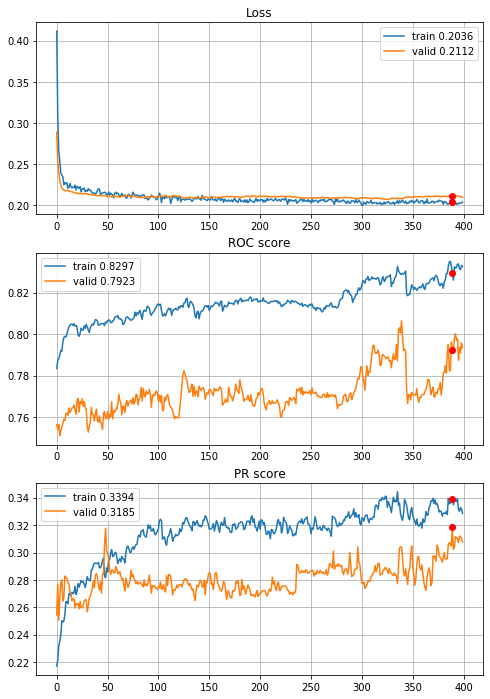


Fold 2------------------------------------------------------------


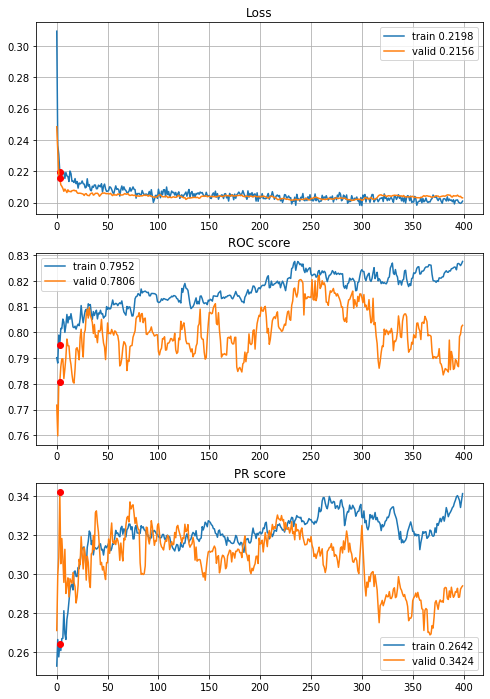


Fold 3------------------------------------------------------------


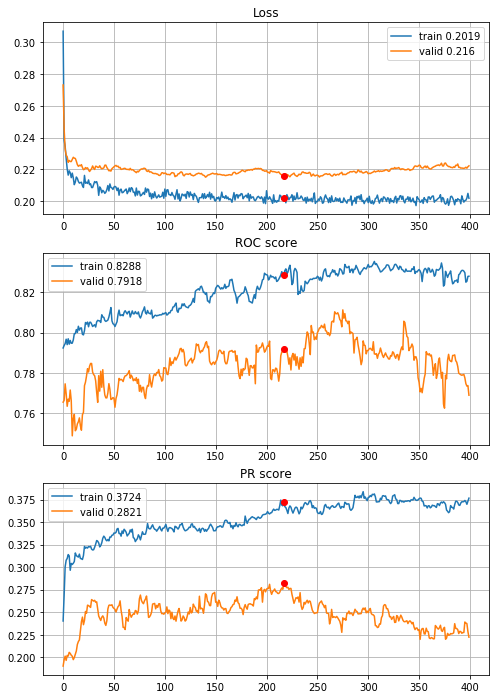


Fold 4------------------------------------------------------------


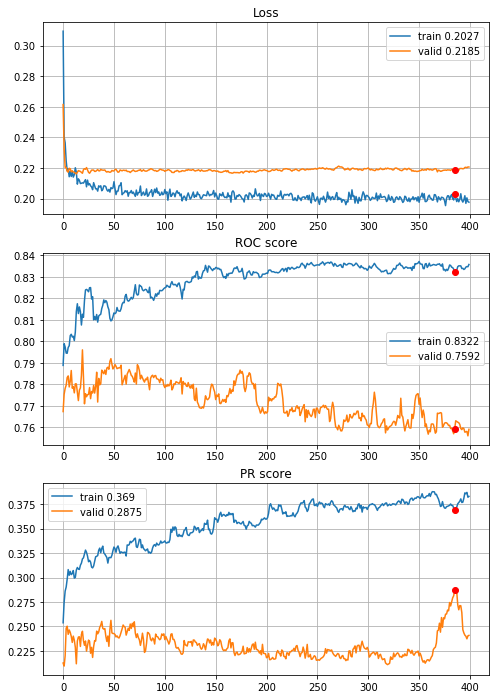


Fold 5------------------------------------------------------------


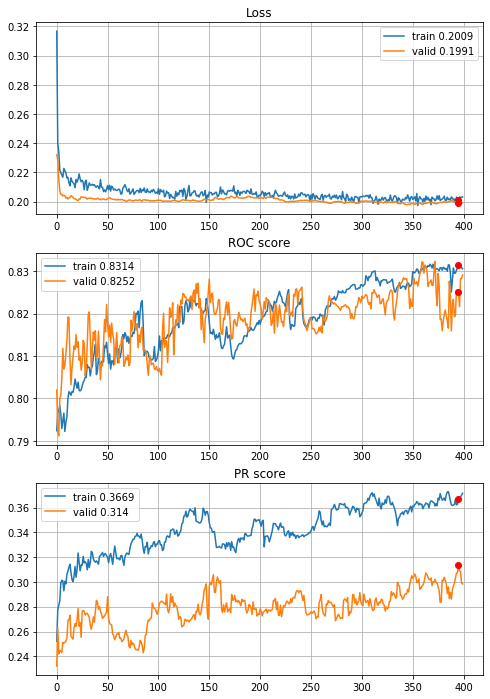


Fold 6------------------------------------------------------------


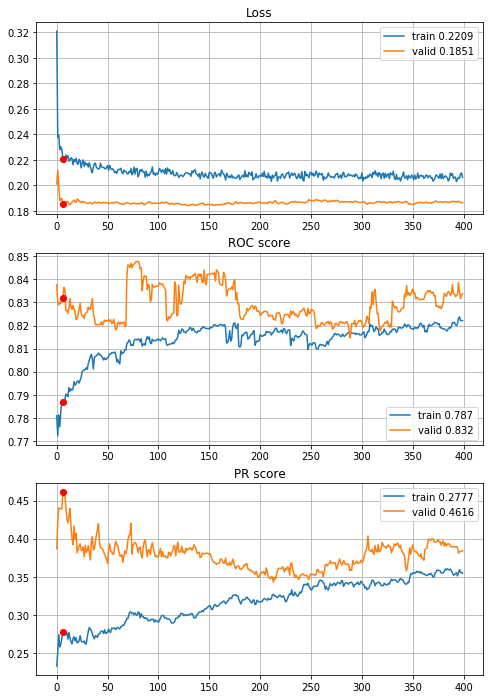

In [220]:
# raw data
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=False, q=None, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Learning curves looks awful on raw data, lets check normalization option for the same architecture


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/400,
cumulative time: 3.01s train loss: 0.511060035387424, validation loss: 0.39304284924450156
Epoch: 2/400,
cumulative time: 3.1s train loss: 0.38198136165738106, validation loss: 0.3015983541828938
Epoch: 3/400,
cumulative time: 3.19s train loss: 0.30802321678787364, validation loss: 0.25092593781238476
Epoch: 4/400,
cumulative time: 3.29s train loss: 0.2660635236570013, validation loss: 0.2240242743203175
Epoch: 5/400,
cumulative time: 3.37s train loss: 0.2377526112815318, validation loss: 0.2099706092607881
Epoch: 6/400,
cumulative time: 3.45s train loss: 0.22652474465352965, validation loss: 0.20288536392715092
Epoch: 7/400,
cumulative time: 3.53s train loss: 0.22221666498492987, validation loss: 0.19923568648845796
Epoch: 8/400,
cumulative time: 3.61s train loss: 0.21458738460625768, validation loss: 0.19757516663668523
Epoch: 9/400,
cumulative time: 3.69s train loss: 0.21453886513433518, vali

Epoch: 77/400,
cumulative time: 9.5s train loss: 0.19162285490640665, validation loss: 0.18994462327126585
Epoch: 78/400,
cumulative time: 9.58s train loss: 0.18921788603686038, validation loss: 0.18956085056772093
Epoch: 79/400,
cumulative time: 9.67s train loss: 0.18741186242214394, validation loss: 0.19000893145833236
Epoch: 80/400,
cumulative time: 9.76s train loss: 0.187203721213911, validation loss: 0.18977081592550676
Epoch: 81/400,
cumulative time: 9.83s train loss: 0.18569183723483276, validation loss: 0.1895385748100926
Epoch: 82/400,
cumulative time: 9.92s train loss: 0.18521301828271, validation loss: 0.19015508238331172
Epoch: 83/400,
cumulative time: 10.01s train loss: 0.1868549852837079, validation loss: 0.18990242585388623
Epoch: 84/400,
cumulative time: 10.1s train loss: 0.18721728626678996, validation loss: 0.19029308417066512
Epoch: 85/400,
cumulative time: 10.19s train loss: 0.18707742741741643, validation loss: 0.1904927363289518
Epoch: 86/400,
cumulative time: 10.

Epoch: 154/400,
cumulative time: 16.16s train loss: 0.18223265563860697, validation loss: 0.18690942921659992
Epoch: 155/400,
cumulative time: 16.24s train loss: 0.180885399163899, validation loss: 0.1870595655554177
Epoch: 156/400,
cumulative time: 16.32s train loss: 0.17923197156282322, validation loss: 0.18704951911526307
Epoch: 157/400,
cumulative time: 16.39s train loss: 0.1759660766201114, validation loss: 0.18655481993345693
Epoch: 158/400,
cumulative time: 16.47s train loss: 0.17834346015208033, validation loss: 0.1864545568907812
Epoch: 159/400,
cumulative time: 16.55s train loss: 0.1821043421430278, validation loss: 0.18718730057710456
Epoch: 160/400,
cumulative time: 16.64s train loss: 0.18010671071654408, validation loss: 0.18626569720508013
Epoch: 161/400,
cumulative time: 16.73s train loss: 0.18309447840394097, validation loss: 0.18740665366644252
Epoch: 162/400,
cumulative time: 16.81s train loss: 0.18057027423505534, validation loss: 0.18791977007870206
Epoch: 163/400,


Epoch: 231/400,
cumulative time: 22.82s train loss: 0.17750612784190514, validation loss: 0.18422085787626372
Epoch: 232/400,
cumulative time: 22.9s train loss: 0.17248435825486044, validation loss: 0.1833707796243831
Epoch: 233/400,
cumulative time: 22.99s train loss: 0.17222804771164693, validation loss: 0.18373413059730273
Epoch: 234/400,
cumulative time: 23.08s train loss: 0.175028303012736, validation loss: 0.18434722157113312
Epoch: 235/400,
cumulative time: 23.16s train loss: 0.17429458656573554, validation loss: 0.18400294351335847
Epoch: 236/400,
cumulative time: 23.25s train loss: 0.17131004994230795, validation loss: 0.1843313468282091
Epoch: 237/400,
cumulative time: 23.34s train loss: 0.1701137092475534, validation loss: 0.1828946644753184
Epoch: 238/400,
cumulative time: 23.42s train loss: 0.1717182262783823, validation loss: 0.18211109324735342
Epoch: 239/400,
cumulative time: 23.51s train loss: 0.1752848843690882, validation loss: 0.18256851088301843
Epoch: 240/400,
cum

Epoch: 309/400,
cumulative time: 29.6s train loss: 0.1701050889594245, validation loss: 0.18177048756143555
Epoch: 310/400,
cumulative time: 29.69s train loss: 0.1695069259953843, validation loss: 0.18134866636393437
Epoch: 311/400,
cumulative time: 29.77s train loss: 0.16703454406078003, validation loss: 0.18173501925309857
Epoch: 312/400,
cumulative time: 29.86s train loss: 0.16821710224723987, validation loss: 0.1808705528297177
Epoch: 313/400,
cumulative time: 29.94s train loss: 0.1676860328911659, validation loss: 0.18178038824908224
Epoch: 314/400,
cumulative time: 30.03s train loss: 0.16958005460725578, validation loss: 0.18206914200992433
Epoch: 315/400,
cumulative time: 30.12s train loss: 0.1658426020832376, validation loss: 0.18220014698811823
Epoch: 316/400,
cumulative time: 30.21s train loss: 0.1687356455029671, validation loss: 0.18185930469796785
Epoch: 317/400,
cumulative time: 30.29s train loss: 0.166892449549712, validation loss: 0.1824510608544613
Epoch: 318/400,
cumu

Epoch: 386/400,
cumulative time: 36.39s train loss: 0.16613285298650876, validation loss: 0.1818614331280903
Epoch: 387/400,
cumulative time: 36.48s train loss: 0.16402041311930557, validation loss: 0.1815963438895805
Epoch: 388/400,
cumulative time: 36.56s train loss: 0.1632033720114924, validation loss: 0.1813310370806777
Epoch: 389/400,
cumulative time: 36.65s train loss: 0.1621044812394501, validation loss: 0.18228131389873273
Epoch: 390/400,
cumulative time: 36.73s train loss: 0.16129950569465165, validation loss: 0.18166581167510829
Epoch: 391/400,
cumulative time: 36.81s train loss: 0.16536843428045295, validation loss: 0.18125695539501904
Epoch: 392/400,
cumulative time: 36.9s train loss: 0.16199629237061697, validation loss: 0.18084395791927885
Epoch: 393/400,
cumulative time: 36.99s train loss: 0.16566730557271828, validation loss: 0.18088622999366
Epoch: 394/400,
cumulative time: 37.08s train loss: 0.16256019818707493, validation loss: 0.1801759942677271
Epoch: 395/400,
cumu

Epoch: 60/400,
cumulative time: 8.96s train loss: 0.1871900357850676, validation loss: 0.18874606380938408
Epoch: 61/400,
cumulative time: 9.05s train loss: 0.1901257710551527, validation loss: 0.18871343150953296
Epoch: 62/400,
cumulative time: 9.13s train loss: 0.1868769611679152, validation loss: 0.1886065541488342
Epoch: 63/400,
cumulative time: 9.22s train loss: 0.18733536429192185, validation loss: 0.1885441830287254
Epoch: 64/400,
cumulative time: 9.3s train loss: 0.18740126762256726, validation loss: 0.18816685377543513
Epoch: 65/400,
cumulative time: 9.39s train loss: 0.18848485451877547, validation loss: 0.18792386504211447
Epoch: 66/400,
cumulative time: 9.48s train loss: 0.1891232155841718, validation loss: 0.18802578760712096
Epoch: 67/400,
cumulative time: 9.56s train loss: 0.18861730384643757, validation loss: 0.1880100222793749
Epoch: 68/400,
cumulative time: 9.65s train loss: 0.18936600396913958, validation loss: 0.18797637533980266
Epoch: 69/400,
cumulative time: 9.74

Epoch: 138/400,
cumulative time: 15.91s train loss: 0.18287381847869832, validation loss: 0.18133478965337274
Epoch: 139/400,
cumulative time: 15.99s train loss: 0.17796726021175996, validation loss: 0.1814638049149594
Epoch: 140/400,
cumulative time: 16.08s train loss: 0.18103604048611563, validation loss: 0.18133165441209864
Epoch: 141/400,
cumulative time: 16.17s train loss: 0.1818370428272533, validation loss: 0.18124788645087933
Epoch: 142/400,
cumulative time: 16.25s train loss: 0.17778224328916103, validation loss: 0.18062185014786017
Epoch: 143/400,
cumulative time: 16.34s train loss: 0.1818388040960911, validation loss: 0.1807676273678443
Epoch: 144/400,
cumulative time: 16.44s train loss: 0.18212008582838282, validation loss: 0.18098448127877753
Epoch: 145/400,
cumulative time: 16.53s train loss: 0.18043764310784718, validation loss: 0.18101032866162942
Epoch: 146/400,
cumulative time: 16.62s train loss: 0.18064742074734683, validation loss: 0.18092956960940443
Epoch: 147/400

Epoch: 214/400,
cumulative time: 22.82s train loss: 0.17818873488623313, validation loss: 0.17697490487991083
Epoch: 215/400,
cumulative time: 22.9s train loss: 0.1762602162960957, validation loss: 0.17648038661197718
Epoch: 216/400,
cumulative time: 23.0s train loss: 0.17777620418003964, validation loss: 0.1762726973183663
Epoch: 217/400,
cumulative time: 23.1s train loss: 0.17746549021345076, validation loss: 0.17624281607190276
Epoch: 218/400,
cumulative time: 23.18s train loss: 0.1770904712305011, validation loss: 0.17602607680079366
Epoch: 219/400,
cumulative time: 23.27s train loss: 0.17726521811949003, validation loss: 0.17624677573209954
Epoch: 220/400,
cumulative time: 23.36s train loss: 0.17838080580403443, validation loss: 0.1767809516514033
Epoch: 221/400,
cumulative time: 23.44s train loss: 0.17278567493123267, validation loss: 0.17663142155633302
Epoch: 222/400,
cumulative time: 23.53s train loss: 0.17327093050583176, validation loss: 0.17645005424839802
Epoch: 223/400,
c

Epoch: 290/400,
cumulative time: 29.57s train loss: 0.16910047226313113, validation loss: 0.17450921655776402
Epoch: 291/400,
cumulative time: 29.65s train loss: 0.17338268434635568, validation loss: 0.17473517118070145
Epoch: 292/400,
cumulative time: 29.73s train loss: 0.17326140436696877, validation loss: 0.17451756725585446
Epoch: 293/400,
cumulative time: 29.82s train loss: 0.17579594640471444, validation loss: 0.17491389797599366
Epoch: 294/400,
cumulative time: 29.91s train loss: 0.17163730851821735, validation loss: 0.1752488143750484
Epoch: 295/400,
cumulative time: 29.99s train loss: 0.17063460695399274, validation loss: 0.17478008984914628
Epoch: 296/400,
cumulative time: 30.09s train loss: 0.17414012079258256, validation loss: 0.17431051565466496
Epoch: 297/400,
cumulative time: 30.18s train loss: 0.17012770710990424, validation loss: 0.17498010094566302
Epoch: 298/400,
cumulative time: 30.27s train loss: 0.17258428184429878, validation loss: 0.17481968040329224
Epoch: 299/

Epoch: 366/400,
cumulative time: 36.24s train loss: 0.16815749120760695, validation loss: 0.1735663718744491
Epoch: 367/400,
cumulative time: 36.33s train loss: 0.16995630229719064, validation loss: 0.17330542443637245
Epoch: 368/400,
cumulative time: 36.42s train loss: 0.1710212603883838, validation loss: 0.1737769882970625
Epoch: 369/400,
cumulative time: 36.52s train loss: 0.16789305450845282, validation loss: 0.17375908677782254
Epoch: 370/400,
cumulative time: 36.6s train loss: 0.16925218658326766, validation loss: 0.17438540117985232
Epoch: 371/400,
cumulative time: 36.69s train loss: 0.16766196253645613, validation loss: 0.17397084859070674
Epoch: 372/400,
cumulative time: 36.78s train loss: 0.1712775394145655, validation loss: 0.1739162436970998
Epoch: 373/400,
cumulative time: 36.87s train loss: 0.1678598381861345, validation loss: 0.17359479321030377
Epoch: 374/400,
cumulative time: 36.96s train loss: 0.1696191078979885, validation loss: 0.17357998310242861
Epoch: 375/400,
cu

Epoch: 41/400,
cumulative time: 7.45s train loss: 0.18237020411538735, validation loss: 0.1954498484377931
Epoch: 42/400,
cumulative time: 7.54s train loss: 0.1849860867236603, validation loss: 0.1954522947817537
Epoch: 43/400,
cumulative time: 7.63s train loss: 0.18452309879612191, validation loss: 0.19606456975321357
Epoch: 44/400,
cumulative time: 7.72s train loss: 0.1846451050322839, validation loss: 0.1960556990432363
Epoch: 45/400,
cumulative time: 7.8s train loss: 0.18517708897402355, validation loss: 0.19601443018491266
Epoch: 46/400,
cumulative time: 7.89s train loss: 0.18559535539672048, validation loss: 0.19595348796352594
Epoch: 47/400,
cumulative time: 7.98s train loss: 0.18732290605372254, validation loss: 0.19554648582803624
Epoch: 48/400,
cumulative time: 8.06s train loss: 0.18583700162382116, validation loss: 0.19605491193601485
Epoch: 49/400,
cumulative time: 8.15s train loss: 0.18633375201871893, validation loss: 0.19630230875872706
Epoch: 50/400,
cumulative time: 8.

Epoch: 119/400,
cumulative time: 14.15s train loss: 0.17361939995001585, validation loss: 0.19511123708834643
Epoch: 120/400,
cumulative time: 14.23s train loss: 0.17648704589045328, validation loss: 0.1947782493564967
Epoch: 121/400,
cumulative time: 14.32s train loss: 0.1749700950559511, validation loss: 0.1955654539142682
Epoch: 122/400,
cumulative time: 14.41s train loss: 0.17474737243612534, validation loss: 0.19588098165147602
Epoch: 123/400,
cumulative time: 14.49s train loss: 0.17710368556141962, validation loss: 0.19617656849349902
Epoch: 124/400,
cumulative time: 14.58s train loss: 0.17497788221719893, validation loss: 0.19703804309298248
Epoch: 125/400,
cumulative time: 14.67s train loss: 0.17319767060437466, validation loss: 0.19671906122629107
Epoch: 126/400,
cumulative time: 14.76s train loss: 0.17391062663054424, validation loss: 0.19675063845001187
Epoch: 127/400,
cumulative time: 14.85s train loss: 0.17415376708906696, validation loss: 0.1965279221669125
Epoch: 128/400

Epoch: 194/400,
cumulative time: 20.66s train loss: 0.17060204266506626, validation loss: 0.19467876275335655
Epoch: 195/400,
cumulative time: 20.75s train loss: 0.16858992182283195, validation loss: 0.19414680905581327
Epoch: 196/400,
cumulative time: 20.83s train loss: 0.1688625119317202, validation loss: 0.1942639600699757
Epoch: 197/400,
cumulative time: 20.92s train loss: 0.17088297187663373, validation loss: 0.19446771312190017
Epoch: 198/400,
cumulative time: 21.01s train loss: 0.1693517034100066, validation loss: 0.1939592100889868
Epoch: 199/400,
cumulative time: 21.1s train loss: 0.16789801317243586, validation loss: 0.19428294280537622
Epoch: 200/400,
cumulative time: 21.19s train loss: 0.1698444053624834, validation loss: 0.19554497021026784
Epoch: 201/400,
cumulative time: 21.28s train loss: 0.16793466130076548, validation loss: 0.19575482348175435
Epoch: 202/400,
cumulative time: 21.36s train loss: 0.1712374404772094, validation loss: 0.19519565912150477
Epoch: 203/400,
c

Epoch: 271/400,
cumulative time: 27.48s train loss: 0.16626411639086713, validation loss: 0.19194567121204154
Epoch: 272/400,
cumulative time: 27.56s train loss: 0.16265916071549757, validation loss: 0.19125339792035478
Epoch: 273/400,
cumulative time: 27.65s train loss: 0.16632229549682528, validation loss: 0.19197158890082305
Epoch: 274/400,
cumulative time: 27.74s train loss: 0.16470793253382407, validation loss: 0.19199602038776994
Epoch: 275/400,
cumulative time: 27.82s train loss: 0.16156126522805395, validation loss: 0.19253983863512855
Epoch: 276/400,
cumulative time: 27.91s train loss: 0.15960333555506456, validation loss: 0.19237520744795192
Epoch: 277/400,
cumulative time: 28.0s train loss: 0.16396394425781194, validation loss: 0.19279699390407615
Epoch: 278/400,
cumulative time: 28.09s train loss: 0.16375487504883363, validation loss: 0.19228078372852106
Epoch: 279/400,
cumulative time: 28.17s train loss: 0.16323084702937182, validation loss: 0.19209754613166194
Epoch: 280/

Epoch: 347/400,
cumulative time: 34.22s train loss: 0.16145017713523513, validation loss: 0.18938409205286721
Epoch: 348/400,
cumulative time: 34.31s train loss: 0.16208903416856746, validation loss: 0.18953543762007588
Epoch: 349/400,
cumulative time: 34.39s train loss: 0.1660083580748699, validation loss: 0.18931165886906384
Epoch: 350/400,
cumulative time: 34.48s train loss: 0.15994968902763476, validation loss: 0.18999088196904979
Epoch: 351/400,
cumulative time: 34.57s train loss: 0.1636055284062071, validation loss: 0.190036859006328
Epoch: 352/400,
cumulative time: 34.65s train loss: 0.16344544732613683, validation loss: 0.18934931170107144
Epoch: 353/400,
cumulative time: 34.74s train loss: 0.16103138532556782, validation loss: 0.18905007928240258
Epoch: 354/400,
cumulative time: 34.82s train loss: 0.1645397692313586, validation loss: 0.18979219756306495
Epoch: 355/400,
cumulative time: 34.91s train loss: 0.16023813019294816, validation loss: 0.18932758085219675
Epoch: 356/400,

Epoch: 20/400,
cumulative time: 5.36s train loss: 0.18989729336064798, validation loss: 0.2107605983925727
Epoch: 21/400,
cumulative time: 5.45s train loss: 0.19405418063982222, validation loss: 0.2103474691812933
Epoch: 22/400,
cumulative time: 5.54s train loss: 0.1917166438028502, validation loss: 0.21037750010027573
Epoch: 23/400,
cumulative time: 5.63s train loss: 0.19646822695784016, validation loss: 0.2107439414171279
Epoch: 24/400,
cumulative time: 5.7s train loss: 0.1901893806651137, validation loss: 0.21078929126800855
Epoch: 25/400,
cumulative time: 5.78s train loss: 0.19112442215005834, validation loss: 0.21011335720596142
Epoch: 26/400,
cumulative time: 5.86s train loss: 0.19188227968703483, validation loss: 0.20995882018963316
Epoch: 27/400,
cumulative time: 5.94s train loss: 0.19185916438426495, validation loss: 0.2102430461491742
Epoch: 28/400,
cumulative time: 6.03s train loss: 0.1901753559093456, validation loss: 0.2097393033803182
Epoch: 29/400,
cumulative time: 6.12s

Epoch: 98/400,
cumulative time: 11.91s train loss: 0.17746797072250095, validation loss: 0.21326673706955618
Epoch: 99/400,
cumulative time: 12.0s train loss: 0.17647743613005168, validation loss: 0.21281204572784174
Epoch: 100/400,
cumulative time: 12.09s train loss: 0.17687518783073353, validation loss: 0.21332283583774522
Epoch: 101/400,
cumulative time: 12.17s train loss: 0.1727340358248312, validation loss: 0.2132158015032654
Epoch: 102/400,
cumulative time: 12.25s train loss: 0.17726903490280152, validation loss: 0.21387959128712425
Epoch: 103/400,
cumulative time: 12.32s train loss: 0.1738051021882973, validation loss: 0.21327477636374953
Epoch: 104/400,
cumulative time: 12.4s train loss: 0.17451786939134561, validation loss: 0.21346858379264985
Epoch: 105/400,
cumulative time: 12.48s train loss: 0.17777633307656718, validation loss: 0.21361703938609053
Epoch: 106/400,
cumulative time: 12.56s train loss: 0.17762001339802483, validation loss: 0.21337186886548457
Epoch: 107/400,
c

cumulative time: 19.06s train loss: 0.17147935622874055, validation loss: 0.21411577163108583
Epoch: 174/400,
cumulative time: 19.16s train loss: 0.16964086845513798, validation loss: 0.21430079800415255
Epoch: 175/400,
cumulative time: 19.25s train loss: 0.1671246969145898, validation loss: 0.21471052658880807
Epoch: 176/400,
cumulative time: 19.34s train loss: 0.17104296086907736, validation loss: 0.21434230116904454
Epoch: 177/400,
cumulative time: 19.42s train loss: 0.1694760133054115, validation loss: 0.21491817299184088
Epoch: 178/400,
cumulative time: 19.51s train loss: 0.166857423616698, validation loss: 0.21490649061601264
Epoch: 179/400,
cumulative time: 19.6s train loss: 0.1704239099545536, validation loss: 0.21550187673714036
Epoch: 180/400,
cumulative time: 19.69s train loss: 0.17176457146086435, validation loss: 0.2152867499175513
Epoch: 181/400,
cumulative time: 19.78s train loss: 0.17016723432687184, validation loss: 0.21478765732009578
Epoch: 182/400,
cumulative time: 

Epoch: 249/400,
cumulative time: 25.68s train loss: 0.16335698525563552, validation loss: 0.21484994303023036
Epoch: 250/400,
cumulative time: 25.77s train loss: 0.1679488586338761, validation loss: 0.21443437379585162
Epoch: 251/400,
cumulative time: 25.86s train loss: 0.16943702162549104, validation loss: 0.2138689353759348
Epoch: 252/400,
cumulative time: 25.95s train loss: 0.16441632315143354, validation loss: 0.21368588318808623
Epoch: 253/400,
cumulative time: 26.03s train loss: 0.1656882320916225, validation loss: 0.2132627009739994
Epoch: 254/400,
cumulative time: 26.12s train loss: 0.1631722455096788, validation loss: 0.21306237726394534
Epoch: 255/400,
cumulative time: 26.21s train loss: 0.16645865737316223, validation loss: 0.21341803575746093
Epoch: 256/400,
cumulative time: 26.3s train loss: 0.165651874979355, validation loss: 0.2137849211154619
Epoch: 257/400,
cumulative time: 26.39s train loss: 0.1630862035998474, validation loss: 0.21353592913656685
Epoch: 258/400,
cumu

Epoch: 324/400,
cumulative time: 32.28s train loss: 0.16373607836295648, validation loss: 0.21365052892176883
Epoch: 325/400,
cumulative time: 32.37s train loss: 0.162823272691256, validation loss: 0.21354412729799344
Epoch: 326/400,
cumulative time: 32.46s train loss: 0.161737545309582, validation loss: 0.21392373306756632
Epoch: 327/400,
cumulative time: 32.55s train loss: 0.1589284881112432, validation loss: 0.21465056340796684
Epoch: 328/400,
cumulative time: 32.64s train loss: 0.16181026613593988, validation loss: 0.2152420661115754
Epoch: 329/400,
cumulative time: 32.73s train loss: 0.16053810289783832, validation loss: 0.21500168969480501
Epoch: 330/400,
cumulative time: 32.82s train loss: 0.16097036289786906, validation loss: 0.21488879193839855
Epoch: 331/400,
cumulative time: 32.91s train loss: 0.16199140160932998, validation loss: 0.21481449088043875
Epoch: 332/400,
cumulative time: 33.0s train loss: 0.1612264008630809, validation loss: 0.21423030094691378
Epoch: 333/400,
cu

Train on 4433 samples, validate on 886 samples
Epoch: 1/400,
cumulative time: 3.81s train loss: 0.3667496934200339, validation loss: 0.21142957889334074
Epoch: 2/400,
cumulative time: 3.9s train loss: 0.22726085765244003, validation loss: 0.2106400621260262
Epoch: 3/400,
cumulative time: 4.0s train loss: 0.2155638875634305, validation loss: 0.20532157788427366
Epoch: 4/400,
cumulative time: 4.09s train loss: 0.21212418858418206, validation loss: 0.20138302983602605
Epoch: 5/400,
cumulative time: 4.19s train loss: 0.21003562281907828, validation loss: 0.20147465199703019
Epoch: 6/400,
cumulative time: 4.28s train loss: 0.20566283968778756, validation loss: 0.20083656651440915
Epoch: 7/400,
cumulative time: 4.36s train loss: 0.20582038756084314, validation loss: 0.1999414916703179
Epoch: 8/400,
cumulative time: 4.44s train loss: 0.20720864669708697, validation loss: 0.19828658545932168
Epoch: 9/400,
cumulative time: 4.53s train loss: 0.20502581655266536, validation loss: 0.19943231865595

Epoch: 78/400,
cumulative time: 10.66s train loss: 0.18242306842939487, validation loss: 0.1978864508678897
Epoch: 79/400,
cumulative time: 10.74s train loss: 0.1849694097220911, validation loss: 0.19765186518363437
Epoch: 80/400,
cumulative time: 10.82s train loss: 0.18360965152895264, validation loss: 0.19738194043695523
Epoch: 81/400,
cumulative time: 10.91s train loss: 0.18501091584270812, validation loss: 0.19726582325608144
Epoch: 82/400,
cumulative time: 11.0s train loss: 0.18195792401708225, validation loss: 0.1966867897970682
Epoch: 83/400,
cumulative time: 11.09s train loss: 0.1838964550490576, validation loss: 0.19644484341010013
Epoch: 84/400,
cumulative time: 11.18s train loss: 0.18343509809981073, validation loss: 0.19639236024217196
Epoch: 85/400,
cumulative time: 11.27s train loss: 0.18553705394147024, validation loss: 0.1961504979138988
Epoch: 86/400,
cumulative time: 11.36s train loss: 0.18420186679505238, validation loss: 0.19632526562795144
Epoch: 87/400,
cumulative

Epoch: 154/400,
cumulative time: 17.54s train loss: 0.175781695044877, validation loss: 0.19482638194114307
Epoch: 155/400,
cumulative time: 17.62s train loss: 0.1768212162013681, validation loss: 0.19422006697875382
Epoch: 156/400,
cumulative time: 17.71s train loss: 0.17458681471792054, validation loss: 0.19447023016200915
Epoch: 157/400,
cumulative time: 17.8s train loss: 0.17357736725772768, validation loss: 0.19460806916583473
Epoch: 158/400,
cumulative time: 17.89s train loss: 0.174977372788076, validation loss: 0.1947486381094827
Epoch: 159/400,
cumulative time: 17.98s train loss: 0.17559135852966895, validation loss: 0.19468685648242184
Epoch: 160/400,
cumulative time: 18.08s train loss: 0.17272105687309436, validation loss: 0.19467029261400684
Epoch: 161/400,
cumulative time: 18.17s train loss: 0.17517172221658248, validation loss: 0.19447155633171848
Epoch: 162/400,
cumulative time: 18.26s train loss: 0.17799153221116065, validation loss: 0.19441732078050653
Epoch: 163/400,
c

Epoch: 231/400,
cumulative time: 24.49s train loss: 0.17323556590800948, validation loss: 0.19503671717966653
Epoch: 232/400,
cumulative time: 24.59s train loss: 0.1706457977440942, validation loss: 0.1947484222949224
Epoch: 233/400,
cumulative time: 24.68s train loss: 0.1717765222862615, validation loss: 0.19445598371007372
Epoch: 234/400,
cumulative time: 24.78s train loss: 0.17157778485738853, validation loss: 0.1945070311528027
Epoch: 235/400,
cumulative time: 24.87s train loss: 0.1695438913955609, validation loss: 0.1946557901513765
Epoch: 236/400,
cumulative time: 24.96s train loss: 0.1711484333905737, validation loss: 0.1947370115036889
Epoch: 237/400,
cumulative time: 25.06s train loss: 0.17157975147788584, validation loss: 0.1942009165983975
Epoch: 238/400,
cumulative time: 25.15s train loss: 0.16822407632131703, validation loss: 0.19434087728539115
Epoch: 239/400,
cumulative time: 25.25s train loss: 0.1718166346356908, validation loss: 0.19410258339839917
Epoch: 240/400,
cumu

Epoch: 307/400,
cumulative time: 31.4s train loss: 0.1670869423571059, validation loss: 0.19604777519509162
Epoch: 308/400,
cumulative time: 31.48s train loss: 0.16853402873315043, validation loss: 0.1964768799648328
Epoch: 309/400,
cumulative time: 31.57s train loss: 0.16494471605168812, validation loss: 0.19635643418163531
Epoch: 310/400,
cumulative time: 31.66s train loss: 0.1686131282951771, validation loss: 0.196495304493818
Epoch: 311/400,
cumulative time: 31.74s train loss: 0.16810342467801984, validation loss: 0.19699830042185687
Epoch: 312/400,
cumulative time: 31.83s train loss: 0.16722969727129747, validation loss: 0.19663199489730207
Epoch: 313/400,
cumulative time: 31.92s train loss: 0.16633636406762536, validation loss: 0.1969801454928874
Epoch: 314/400,
cumulative time: 32.02s train loss: 0.16503627465509707, validation loss: 0.19691902701795505
Epoch: 315/400,
cumulative time: 32.1s train loss: 0.1681187008422464, validation loss: 0.1975269520121288
Epoch: 316/400,
cumu

Epoch: 385/400,
cumulative time: 38.34s train loss: 0.16577389393948874, validation loss: 0.1980928440933572
Epoch: 386/400,
cumulative time: 38.43s train loss: 0.16302009725541097, validation loss: 0.19836490148884448
Epoch: 387/400,
cumulative time: 38.52s train loss: 0.1654181905055514, validation loss: 0.1984906375206351
Epoch: 388/400,
cumulative time: 38.61s train loss: 0.16523895852524892, validation loss: 0.19869726724737655
Epoch: 389/400,
cumulative time: 38.7s train loss: 0.1630448250029847, validation loss: 0.19880131768319192
Epoch: 390/400,
cumulative time: 38.79s train loss: 0.16435789263446096, validation loss: 0.1987123733247645
Epoch: 391/400,
cumulative time: 38.88s train loss: 0.16298237697933748, validation loss: 0.19872744014785199
Epoch: 392/400,
cumulative time: 38.97s train loss: 0.15864777478950168, validation loss: 0.19861201205318185
Epoch: 393/400,
cumulative time: 39.05s train loss: 0.1653976695460389, validation loss: 0.1984476348885564
Epoch: 394/400,
cu

cumulative time: 9.69s train loss: 0.1879341941223493, validation loss: 0.1969350383324763
Epoch: 61/400,
cumulative time: 9.79s train loss: 0.18947147110932142, validation loss: 0.1965987363464407
Epoch: 62/400,
cumulative time: 9.87s train loss: 0.1890147799882721, validation loss: 0.19658692675573294
Epoch: 63/400,
cumulative time: 9.96s train loss: 0.1865003642569593, validation loss: 0.1961048833739946
Epoch: 64/400,
cumulative time: 10.05s train loss: 0.18776049366955722, validation loss: 0.19580473658328132
Epoch: 65/400,
cumulative time: 10.14s train loss: 0.18526783181506087, validation loss: 0.19628112159383485
Epoch: 66/400,
cumulative time: 10.23s train loss: 0.18720455640141645, validation loss: 0.19576490843672784
Epoch: 67/400,
cumulative time: 10.31s train loss: 0.19032460617516236, validation loss: 0.19591898980716552
Epoch: 68/400,
cumulative time: 10.4s train loss: 0.18867664787722527, validation loss: 0.19636124345572753
Epoch: 69/400,
cumulative time: 10.49s train 

Epoch: 138/400,
cumulative time: 16.69s train loss: 0.17915773253233255, validation loss: 0.19105361788859485
Epoch: 139/400,
cumulative time: 16.78s train loss: 0.17880362539159075, validation loss: 0.19100587322265247
Epoch: 140/400,
cumulative time: 16.86s train loss: 0.17809473898134892, validation loss: 0.19116036570368178
Epoch: 141/400,
cumulative time: 16.96s train loss: 0.18017149501316923, validation loss: 0.19162040393858407
Epoch: 142/400,
cumulative time: 17.05s train loss: 0.17948236738132242, validation loss: 0.19209876834808032
Epoch: 143/400,
cumulative time: 17.13s train loss: 0.1788038671178041, validation loss: 0.1920662703282677
Epoch: 144/400,
cumulative time: 17.23s train loss: 0.18062323167459599, validation loss: 0.1919692095461602
Epoch: 145/400,
cumulative time: 17.32s train loss: 0.17821455503354458, validation loss: 0.19140475608290722
Epoch: 146/400,
cumulative time: 17.41s train loss: 0.1767511434891733, validation loss: 0.19132613304909948
Epoch: 147/400

Epoch: 214/400,
cumulative time: 23.57s train loss: 0.17490844272905673, validation loss: 0.19126136200691723
Epoch: 215/400,
cumulative time: 23.66s train loss: 0.174757352363114, validation loss: 0.19226243594161005
Epoch: 216/400,
cumulative time: 23.74s train loss: 0.17947460558730163, validation loss: 0.19272525100621898
Epoch: 217/400,
cumulative time: 23.83s train loss: 0.17751688900944237, validation loss: 0.19252065897122464
Epoch: 218/400,
cumulative time: 23.91s train loss: 0.17367034694047537, validation loss: 0.19166444067088528
Epoch: 219/400,
cumulative time: 24.0s train loss: 0.175345159124204, validation loss: 0.19088559054494172
Epoch: 220/400,
cumulative time: 24.09s train loss: 0.17825293991048316, validation loss: 0.19083725840996943
Epoch: 221/400,
cumulative time: 24.18s train loss: 0.17366311321496802, validation loss: 0.19075028295576169
Epoch: 222/400,
cumulative time: 24.26s train loss: 0.17350462264766442, validation loss: 0.18974277511676332
Epoch: 223/400,

Epoch: 290/400,
cumulative time: 30.4s train loss: 0.17331007869228024, validation loss: 0.18627024312455281
Epoch: 291/400,
cumulative time: 30.48s train loss: 0.1721570280424876, validation loss: 0.18637769839160867
Epoch: 292/400,
cumulative time: 30.57s train loss: 0.17023537614034687, validation loss: 0.18696116028736193
Epoch: 293/400,
cumulative time: 30.66s train loss: 0.1691925238297751, validation loss: 0.18732970233157312
Epoch: 294/400,
cumulative time: 30.75s train loss: 0.17292445664101413, validation loss: 0.18769954060862348
Epoch: 295/400,
cumulative time: 30.84s train loss: 0.17431301269625638, validation loss: 0.1875174746556422
Epoch: 296/400,
cumulative time: 30.93s train loss: 0.171376672994195, validation loss: 0.18738156735358874
Epoch: 297/400,
cumulative time: 31.02s train loss: 0.1727977372771484, validation loss: 0.18727986595296967
Epoch: 298/400,
cumulative time: 31.11s train loss: 0.16751075004404564, validation loss: 0.18726444859940633
Epoch: 299/400,
c

Epoch: 367/400,
cumulative time: 37.23s train loss: 0.16918866184913842, validation loss: 0.1876394564357353
Epoch: 368/400,
cumulative time: 37.32s train loss: 0.1673121553442964, validation loss: 0.18734501628520525
Epoch: 369/400,
cumulative time: 37.41s train loss: 0.1655378022205741, validation loss: 0.18692338826559468
Epoch: 370/400,
cumulative time: 37.49s train loss: 0.17032227845189804, validation loss: 0.18678216192173366
Epoch: 371/400,
cumulative time: 37.58s train loss: 0.16715450560686257, validation loss: 0.1863780485857152
Epoch: 372/400,
cumulative time: 37.66s train loss: 0.16996999011838676, validation loss: 0.18646634095947576
Epoch: 373/400,
cumulative time: 37.75s train loss: 0.169752729052, validation loss: 0.18742353094081576
Epoch: 374/400,
cumulative time: 37.84s train loss: 0.1705122510668335, validation loss: 0.18784069049573646
Epoch: 375/400,
cumulative time: 37.93s train loss: 0.17178137459242396, validation loss: 0.18806358610130594
Epoch: 376/400,
cumu

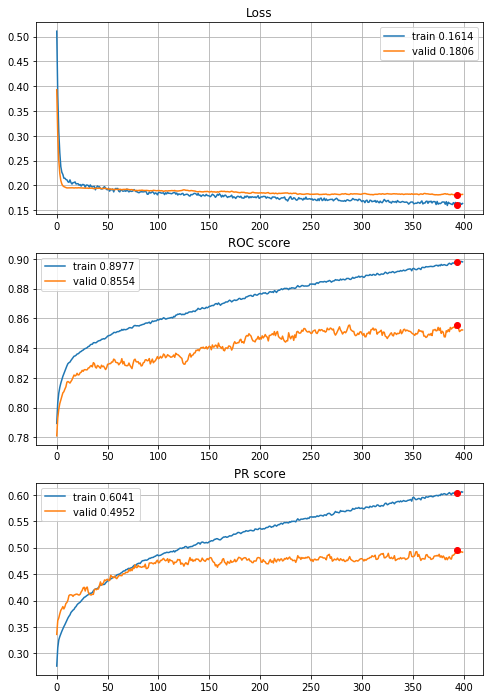


Fold 2------------------------------------------------------------


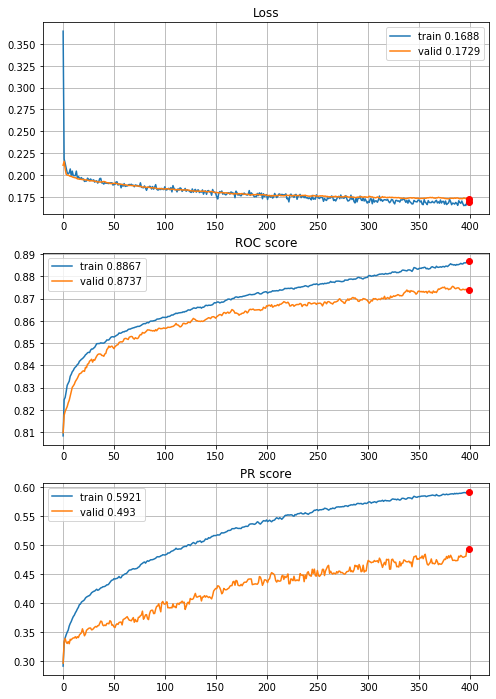


Fold 3------------------------------------------------------------


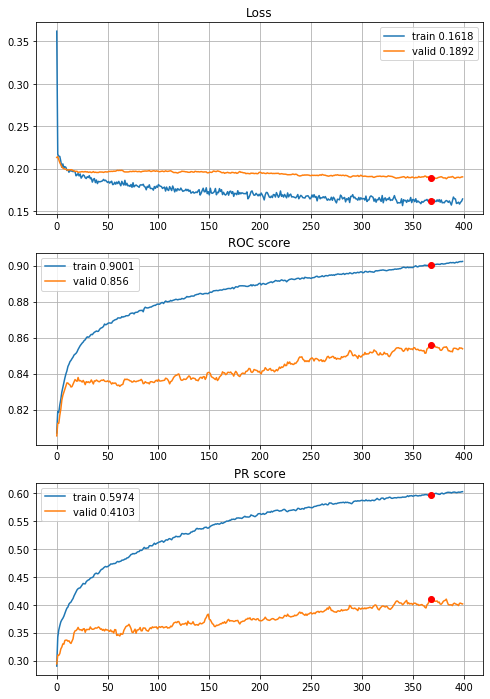


Fold 4------------------------------------------------------------


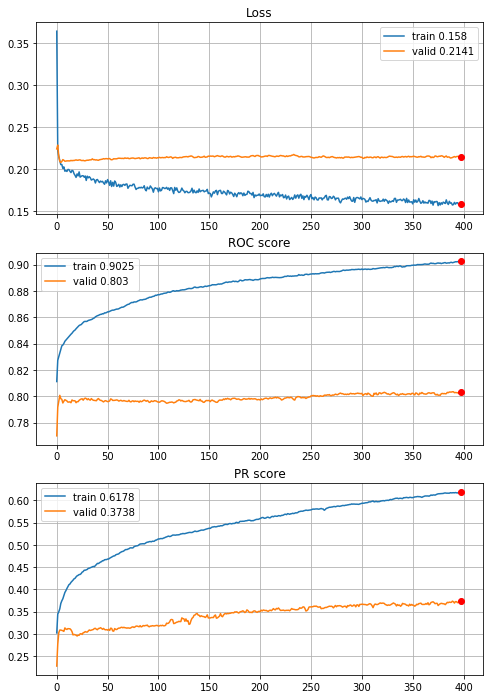


Fold 5------------------------------------------------------------


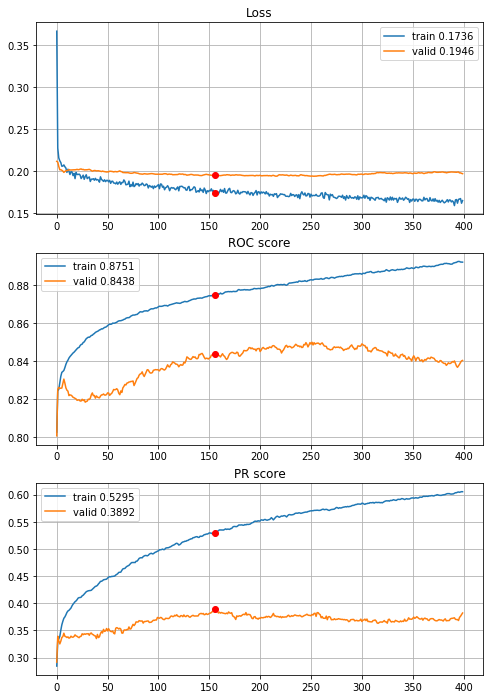


Fold 6------------------------------------------------------------


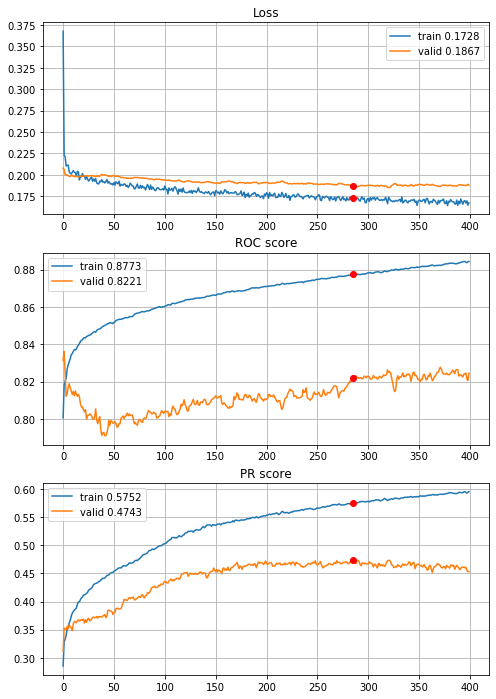

In [221]:
# normalization
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=True, q=None, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

\+ 0.1 on PR


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/400,
cumulative time: 4.78s train loss: 0.5102644791887125, validation loss: 0.38408107556646276
Epoch: 2/400,
cumulative time: 4.87s train loss: 0.37628466068407257, validation loss: 0.2984250405259439
Epoch: 3/400,
cumulative time: 4.96s train loss: 0.3057918716961726, validation loss: 0.2512870519647738
Epoch: 4/400,
cumulative time: 5.06s train loss: 0.2675465917423206, validation loss: 0.224326289778632
Epoch: 5/400,
cumulative time: 5.14s train loss: 0.24019936961037802, validation loss: 0.20915008306906485
Epoch: 6/400,
cumulative time: 5.22s train loss: 0.22942025521736498, validation loss: 0.20074978116332745
Epoch: 7/400,
cumulative time: 5.3s train loss: 0.22052189095167693, validation loss: 0.1959148428855378
Epoch: 8/400,
cumulative time: 5.38s train loss: 0.21291133742577764, validation loss: 0.19305259545397732
Epoch: 9/400,
cumulative time: 5.46s train loss: 0.2106241811914134, valida

Epoch: 79/400,
cumulative time: 11.47s train loss: 0.1672736104335703, validation loss: 0.17690478754151095
Epoch: 80/400,
cumulative time: 11.55s train loss: 0.16806012492236894, validation loss: 0.17597856171840745
Epoch: 81/400,
cumulative time: 11.62s train loss: 0.16569579181190755, validation loss: 0.17683027649409608
Epoch: 82/400,
cumulative time: 11.71s train loss: 0.1643641108801649, validation loss: 0.1783003458142146
Epoch: 83/400,
cumulative time: 11.79s train loss: 0.1663018977034178, validation loss: 0.1781033872550074
Epoch: 84/400,
cumulative time: 11.87s train loss: 0.16730831082009237, validation loss: 0.17771964579854233
Epoch: 85/400,
cumulative time: 11.96s train loss: 0.16557524327040796, validation loss: 0.17758956848903062
Epoch: 86/400,
cumulative time: 12.05s train loss: 0.16872068895329637, validation loss: 0.1782477788853941
Epoch: 87/400,
cumulative time: 12.13s train loss: 0.1687675116698019, validation loss: 0.1776478362627739
Epoch: 88/400,
cumulative t

Epoch: 155/400,
cumulative time: 18.35s train loss: 0.15651311990317454, validation loss: 0.1781272625103341
Epoch: 156/400,
cumulative time: 18.44s train loss: 0.15243573762167123, validation loss: 0.17748369174046608
Epoch: 157/400,
cumulative time: 18.53s train loss: 0.15203376204138522, validation loss: 0.1773500043348637
Epoch: 158/400,
cumulative time: 18.63s train loss: 0.1552704280033869, validation loss: 0.17778392304092008
Epoch: 159/400,
cumulative time: 18.72s train loss: 0.15670566210382036, validation loss: 0.17861722826352922
Epoch: 160/400,
cumulative time: 18.81s train loss: 0.1544881978606812, validation loss: 0.17637965573667808
Epoch: 161/400,
cumulative time: 18.9s train loss: 0.15591797755782355, validation loss: 0.1788742219044364
Epoch: 162/400,
cumulative time: 18.99s train loss: 0.1560096019603285, validation loss: 0.17897273583301965
Epoch: 163/400,
cumulative time: 19.08s train loss: 0.15223555730164912, validation loss: 0.1786740688185009
Epoch: 164/400,
cu

Epoch: 230/400,
cumulative time: 25.19s train loss: 0.14233799203759603, validation loss: 0.18089970334809957
Epoch: 231/400,
cumulative time: 25.28s train loss: 0.14605181790646232, validation loss: 0.18272962364900475
Epoch: 232/400,
cumulative time: 25.37s train loss: 0.1443434630315549, validation loss: 0.18125265693919904
Epoch: 233/400,
cumulative time: 25.47s train loss: 0.13807977001697147, validation loss: 0.18220855779483863
Epoch: 234/400,
cumulative time: 25.56s train loss: 0.14556774517541435, validation loss: 0.18140250299936486
Epoch: 235/400,
cumulative time: 25.65s train loss: 0.14264825403703787, validation loss: 0.181873127431719
Epoch: 236/400,
cumulative time: 25.74s train loss: 0.1404714385948618, validation loss: 0.18103739301744415
Epoch: 237/400,
cumulative time: 25.83s train loss: 0.1407190341307422, validation loss: 0.18067787481805786
Epoch: 238/400,
cumulative time: 25.92s train loss: 0.1401044327685011, validation loss: 0.17939137276829029
Epoch: 239/400,


Epoch: 308/400,
cumulative time: 32.31s train loss: 0.13617421506772942, validation loss: 0.1806033583780018
Epoch: 309/400,
cumulative time: 32.4s train loss: 0.14440709038466107, validation loss: 0.17890120024678402
Epoch: 310/400,
cumulative time: 32.49s train loss: 0.13779983557558986, validation loss: 0.1826829630230567
Epoch: 311/400,
cumulative time: 32.58s train loss: 0.13254864937844366, validation loss: 0.18244524777204368
Epoch: 312/400,
cumulative time: 32.67s train loss: 0.13631269300443924, validation loss: 0.18222187377151267
Epoch: 313/400,
cumulative time: 32.76s train loss: 0.13503909089505026, validation loss: 0.18178354220500526
Epoch: 314/400,
cumulative time: 32.85s train loss: 0.13392506180405078, validation loss: 0.1838366392130513
Epoch: 315/400,
cumulative time: 32.94s train loss: 0.12743638656589637, validation loss: 0.18372369119991983
Epoch: 316/400,
cumulative time: 33.03s train loss: 0.134380424939876, validation loss: 0.1820234369230378
Epoch: 317/400,
c

Epoch: 385/400,
cumulative time: 39.35s train loss: 0.126914274209727, validation loss: 0.18516121421685483
Epoch: 386/400,
cumulative time: 39.44s train loss: 0.13014713673438835, validation loss: 0.18455788997141592
Epoch: 387/400,
cumulative time: 39.53s train loss: 0.13127488208537927, validation loss: 0.18224461450584847
Epoch: 388/400,
cumulative time: 39.63s train loss: 0.12822913202299108, validation loss: 0.18417814988831926
Epoch: 389/400,
cumulative time: 39.72s train loss: 0.12436235531330754, validation loss: 0.1851246747216619
Epoch: 390/400,
cumulative time: 39.81s train loss: 0.12613945570017887, validation loss: 0.18420562038897392
Epoch: 391/400,
cumulative time: 39.91s train loss: 0.1323503172361302, validation loss: 0.18501589370822155
Epoch: 392/400,
cumulative time: 40.0s train loss: 0.12882011254664363, validation loss: 0.18489930070642688
Epoch: 393/400,
cumulative time: 40.09s train loss: 0.13066699653393202, validation loss: 0.18537410534288326
Epoch: 394/400,

Epoch: 60/400,
cumulative time: 10.36s train loss: 0.16106596474102042, validation loss: 0.1655533803624795
Epoch: 61/400,
cumulative time: 10.45s train loss: 0.1634938211822445, validation loss: 0.16492110566396723
Epoch: 62/400,
cumulative time: 10.54s train loss: 0.15755693974908078, validation loss: 0.1639478830736143
Epoch: 63/400,
cumulative time: 10.63s train loss: 0.16205024729997242, validation loss: 0.16486669047037403
Epoch: 64/400,
cumulative time: 10.72s train loss: 0.15774065574853, validation loss: 0.16471486705803684
Epoch: 65/400,
cumulative time: 10.81s train loss: 0.16030137981237702, validation loss: 0.16469239432620894
Epoch: 66/400,
cumulative time: 10.9s train loss: 0.1595326926061608, validation loss: 0.16535993451263079
Epoch: 67/400,
cumulative time: 11.0s train loss: 0.15980461099948262, validation loss: 0.1650678359534856
Epoch: 68/400,
cumulative time: 11.08s train loss: 0.16216910826815595, validation loss: 0.16491085001957323
Epoch: 69/400,
cumulative tim

Epoch: 138/400,
cumulative time: 17.46s train loss: 0.14655374754758196, validation loss: 0.16392500597769405
Epoch: 139/400,
cumulative time: 17.56s train loss: 0.1425223067732333, validation loss: 0.16345311807134644
Epoch: 140/400,
cumulative time: 17.65s train loss: 0.14760020752151629, validation loss: 0.1649001181428032
Epoch: 141/400,
cumulative time: 17.74s train loss: 0.1482913142695539, validation loss: 0.16421949781116263
Epoch: 142/400,
cumulative time: 17.84s train loss: 0.14466462970882762, validation loss: 0.16439181097532204
Epoch: 143/400,
cumulative time: 17.93s train loss: 0.14568312670228606, validation loss: 0.164862314249644
Epoch: 144/400,
cumulative time: 18.02s train loss: 0.14641127072691595, validation loss: 0.16483747550908984
Epoch: 145/400,
cumulative time: 18.12s train loss: 0.14417003354373714, validation loss: 0.16394548257550365
Epoch: 146/400,
cumulative time: 18.21s train loss: 0.14311138982632424, validation loss: 0.16364657282493295
Epoch: 147/400,

Epoch: 215/400,
cumulative time: 24.3s train loss: 0.13494830871074853, validation loss: 0.1661041571161255
Epoch: 216/400,
cumulative time: 24.39s train loss: 0.14151318827543125, validation loss: 0.1678990404863906
Epoch: 217/400,
cumulative time: 24.47s train loss: 0.138244449446778, validation loss: 0.16746662429448853
Epoch: 218/400,
cumulative time: 24.56s train loss: 0.13589529284286156, validation loss: 0.16664165392803634
Epoch: 219/400,
cumulative time: 24.65s train loss: 0.13738960109395562, validation loss: 0.1674763347445373
Epoch: 220/400,
cumulative time: 24.74s train loss: 0.13967921531386002, validation loss: 0.1679506220570277
Epoch: 221/400,
cumulative time: 24.83s train loss: 0.1376591913792093, validation loss: 0.1682125680744984
Epoch: 222/400,
cumulative time: 24.92s train loss: 0.13226320392146224, validation loss: 0.16975973774978245
Epoch: 223/400,
cumulative time: 25.01s train loss: 0.13262902547198513, validation loss: 0.16935205446155122
Epoch: 224/400,
cum

Epoch: 290/400,
cumulative time: 31.03s train loss: 0.12293408570024403, validation loss: 0.17113869577612656
Epoch: 291/400,
cumulative time: 31.12s train loss: 0.13302408700089377, validation loss: 0.17024416297573383
Epoch: 292/400,
cumulative time: 31.21s train loss: 0.1281480611695333, validation loss: 0.17088120609622662
Epoch: 293/400,
cumulative time: 31.29s train loss: 0.13042134525328336, validation loss: 0.1713906991239868
Epoch: 294/400,
cumulative time: 31.38s train loss: 0.12650960414176168, validation loss: 0.17014048482882532
Epoch: 295/400,
cumulative time: 31.46s train loss: 0.1286029869031551, validation loss: 0.17166212473270456
Epoch: 296/400,
cumulative time: 31.55s train loss: 0.13128198209195147, validation loss: 0.17071884052393266
Epoch: 297/400,
cumulative time: 31.64s train loss: 0.12923399572485944, validation loss: 0.17135192127950835
Epoch: 298/400,
cumulative time: 31.73s train loss: 0.13268874129381314, validation loss: 0.17198085292686605
Epoch: 299/40

Epoch: 365/400,
cumulative time: 37.81s train loss: 0.12359801095839765, validation loss: 0.17298053809795466
Epoch: 366/400,
cumulative time: 37.9s train loss: 0.12215770890310891, validation loss: 0.17645496927966126
Epoch: 367/400,
cumulative time: 37.99s train loss: 0.12900859878704435, validation loss: 0.1739399346618534
Epoch: 368/400,
cumulative time: 38.08s train loss: 0.12321412334359833, validation loss: 0.17606539478296626
Epoch: 369/400,
cumulative time: 38.17s train loss: 0.1253526536781435, validation loss: 0.17430146085570872
Epoch: 370/400,
cumulative time: 38.26s train loss: 0.1281356219377113, validation loss: 0.17511689293344232
Epoch: 371/400,
cumulative time: 38.36s train loss: 0.1279281448633393, validation loss: 0.17413303716341297
Epoch: 372/400,
cumulative time: 38.45s train loss: 0.1253185019751049, validation loss: 0.17364362058604582
Epoch: 373/400,
cumulative time: 38.54s train loss: 0.12167135499996076, validation loss: 0.1741779828790613
Epoch: 374/400,
c

Epoch: 40/400,
cumulative time: 9.15s train loss: 0.16316763278002774, validation loss: 0.1890656628731004
Epoch: 41/400,
cumulative time: 9.24s train loss: 0.15928563715668145, validation loss: 0.1890316125606066
Epoch: 42/400,
cumulative time: 9.34s train loss: 0.16098191474130652, validation loss: 0.1891202519583729
Epoch: 43/400,
cumulative time: 9.42s train loss: 0.15702495555517798, validation loss: 0.1910141529231894
Epoch: 44/400,
cumulative time: 9.52s train loss: 0.15982352898520039, validation loss: 0.18846329982815627
Epoch: 45/400,
cumulative time: 9.6s train loss: 0.15936328835839184, validation loss: 0.18845091044499612
Epoch: 46/400,
cumulative time: 9.69s train loss: 0.1641400846911574, validation loss: 0.1889163375136011
Epoch: 47/400,
cumulative time: 9.77s train loss: 0.1648689394426744, validation loss: 0.1864276637555244
Epoch: 48/400,
cumulative time: 9.86s train loss: 0.1612265192994357, validation loss: 0.18624991148273465
Epoch: 49/400,
cumulative time: 9.94s 

cumulative time: 16.31s train loss: 0.14312138054049187, validation loss: 0.18732132481278804
Epoch: 118/400,
cumulative time: 16.4s train loss: 0.1501970029190613, validation loss: 0.18690665259436529
Epoch: 119/400,
cumulative time: 16.5s train loss: 0.14543688232381743, validation loss: 0.18603282536903928
Epoch: 120/400,
cumulative time: 16.6s train loss: 0.14620999484709615, validation loss: 0.18699453438484145
Epoch: 121/400,
cumulative time: 16.69s train loss: 0.14217731505565157, validation loss: 0.18810032474416757
Epoch: 122/400,
cumulative time: 16.77s train loss: 0.1410416597298713, validation loss: 0.1870607637465336
Epoch: 123/400,
cumulative time: 16.86s train loss: 0.1461671281720273, validation loss: 0.18806970522664446
Epoch: 124/400,
cumulative time: 16.95s train loss: 0.14640626799490047, validation loss: 0.1873648833092869
Epoch: 125/400,
cumulative time: 17.04s train loss: 0.1432892269310323, validation loss: 0.18702037918056952
Epoch: 126/400,
cumulative time: 17

Epoch: 193/400,
cumulative time: 23.43s train loss: 0.13558691302953213, validation loss: 0.18932952788126106
Epoch: 194/400,
cumulative time: 23.52s train loss: 0.13669252680742353, validation loss: 0.18943991408743208
Epoch: 195/400,
cumulative time: 23.61s train loss: 0.1362596702583753, validation loss: 0.18802788277422294
Epoch: 196/400,
cumulative time: 23.7s train loss: 0.13170777032629247, validation loss: 0.18896825883743326
Epoch: 197/400,
cumulative time: 23.79s train loss: 0.1345773135725449, validation loss: 0.18919260428615728
Epoch: 198/400,
cumulative time: 23.87s train loss: 0.13365723224296253, validation loss: 0.18772438113087328
Epoch: 199/400,
cumulative time: 23.96s train loss: 0.13041732293160277, validation loss: 0.18934968008062347
Epoch: 200/400,
cumulative time: 24.06s train loss: 0.13354780775451167, validation loss: 0.18946135462405583
Epoch: 201/400,
cumulative time: 24.16s train loss: 0.133155766706443, validation loss: 0.18856157664852186
Epoch: 202/400,

Epoch: 269/400,
cumulative time: 30.45s train loss: 0.12211272947570907, validation loss: 0.18860082437516335
Epoch: 270/400,
cumulative time: 30.54s train loss: 0.12547910744357949, validation loss: 0.1893725414858058
Epoch: 271/400,
cumulative time: 30.64s train loss: 0.12781649691452834, validation loss: 0.18958714128951748
Epoch: 272/400,
cumulative time: 30.73s train loss: 0.1273683411563454, validation loss: 0.1880955498543775
Epoch: 273/400,
cumulative time: 30.82s train loss: 0.1302373747405216, validation loss: 0.1899466504339704
Epoch: 274/400,
cumulative time: 30.9s train loss: 0.12842418250395826, validation loss: 0.18962084181951158
Epoch: 275/400,
cumulative time: 30.99s train loss: 0.13253569201186352, validation loss: 0.19083167305121695
Epoch: 276/400,
cumulative time: 31.09s train loss: 0.12541557808779852, validation loss: 0.18728428612029538
Epoch: 277/400,
cumulative time: 31.18s train loss: 0.12818151885233417, validation loss: 0.18894743408667597
Epoch: 278/400,


Epoch: 345/400,
cumulative time: 37.37s train loss: 0.1255223902029789, validation loss: 0.19306730891429855
Epoch: 346/400,
cumulative time: 37.46s train loss: 0.11782134662883269, validation loss: 0.19617047781605598
Epoch: 347/400,
cumulative time: 37.55s train loss: 0.12206446537109165, validation loss: 0.1955303741784886
Epoch: 348/400,
cumulative time: 37.64s train loss: 0.12342633632774926, validation loss: 0.19510384194611696
Epoch: 349/400,
cumulative time: 37.73s train loss: 0.12143999935608586, validation loss: 0.19278360876383885
Epoch: 350/400,
cumulative time: 37.82s train loss: 0.11692763738240038, validation loss: 0.19392575414299024
Epoch: 351/400,
cumulative time: 37.91s train loss: 0.11781844515555172, validation loss: 0.1953552151277342
Epoch: 352/400,
cumulative time: 38.01s train loss: 0.1273011522374321, validation loss: 0.1923356878213173
Epoch: 353/400,
cumulative time: 38.1s train loss: 0.12181884977993444, validation loss: 0.19391159765346747
Epoch: 354/400,


Epoch: 20/400,
cumulative time: 6.69s train loss: 0.16441480701794722, validation loss: 0.20735198851363654
Epoch: 21/400,
cumulative time: 6.77s train loss: 0.17125489322912765, validation loss: 0.20642092036878013
Epoch: 22/400,
cumulative time: 6.86s train loss: 0.16810053354013646, validation loss: 0.207657146063669
Epoch: 23/400,
cumulative time: 6.95s train loss: 0.17241430291248422, validation loss: 0.2077641105678765
Epoch: 24/400,
cumulative time: 7.05s train loss: 0.1667764393350972, validation loss: 0.20731062743114834
Epoch: 25/400,
cumulative time: 7.14s train loss: 0.1657106667326773, validation loss: 0.20676669538962922
Epoch: 26/400,
cumulative time: 7.24s train loss: 0.16395313558629854, validation loss: 0.20708845041137247
Epoch: 27/400,
cumulative time: 7.33s train loss: 0.16610013867860557, validation loss: 0.20804240848894312
Epoch: 28/400,
cumulative time: 7.42s train loss: 0.16333414693866172, validation loss: 0.2063954408631637
Epoch: 29/400,
cumulative time: 7.

Epoch: 173/400,
cumulative time: 20.55s train loss: 0.13372261384147002, validation loss: 0.2103835573382087
Epoch: 174/400,
cumulative time: 20.64s train loss: 0.13348799686607485, validation loss: 0.21100788669446252
Epoch: 175/400,
cumulative time: 20.74s train loss: 0.12702218547023073, validation loss: 0.21140359691922336
Epoch: 176/400,
cumulative time: 20.83s train loss: 0.13273287443168916, validation loss: 0.21184651829453677
Epoch: 177/400,
cumulative time: 20.92s train loss: 0.13198193012256265, validation loss: 0.21345956455369566
Epoch: 178/400,
cumulative time: 21.01s train loss: 0.13046891088480878, validation loss: 0.2118697321509131
Epoch: 179/400,
cumulative time: 21.1s train loss: 0.12808914098719723, validation loss: 0.2110883996529719
Epoch: 180/400,
cumulative time: 21.19s train loss: 0.13465897538593116, validation loss: 0.211753598117936
Epoch: 181/400,
cumulative time: 21.28s train loss: 0.13017747830032309, validation loss: 0.21216566403213527
Epoch: 182/400,


Epoch: 249/400,
cumulative time: 27.35s train loss: 0.1254651686884656, validation loss: 0.2158436998893122
Epoch: 250/400,
cumulative time: 27.44s train loss: 0.12620175930196803, validation loss: 0.21510954850414268
Epoch: 251/400,
cumulative time: 27.53s train loss: 0.13047303888125744, validation loss: 0.21541411912333616
Epoch: 252/400,
cumulative time: 27.61s train loss: 0.12505830795803108, validation loss: 0.2151848639510824
Epoch: 253/400,
cumulative time: 27.69s train loss: 0.12902374833506278, validation loss: 0.21526090888218202
Epoch: 254/400,
cumulative time: 27.78s train loss: 0.12580686445943987, validation loss: 0.21566858854035492
Epoch: 255/400,
cumulative time: 27.87s train loss: 0.12635462475403178, validation loss: 0.21560195838490134
Epoch: 256/400,
cumulative time: 27.97s train loss: 0.12203873528729382, validation loss: 0.2164695966593568
Epoch: 257/400,
cumulative time: 28.05s train loss: 0.12777624030683854, validation loss: 0.21671037110195204
Epoch: 258/400

Epoch: 399/400,
cumulative time: 40.63s train loss: 0.11391787322567086, validation loss: 0.22610509610875734
Epoch: 400/400,
cumulative time: 40.71s train loss: 0.11452091715518976, validation loss: 0.22647308670909355

Early stopping results:
best results in epoch: 82, 
best valid PR: 0.4249080624501698, 
valid ROC: 0.8223348236462991        
overfitting PR: 0.2742863879795651, 
overfitting ROC: 0.11372814368939566

----------
Fold: 5
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/400,
cumulative time: 6.01s train loss: 0.35916779013323297, validation loss: 0.2087101720391224
Epoch: 2/400,
cumulative time: 6.09s train loss: 0.21152984365878028, validation loss: 0.20400543231727308
Epoch: 3/400,
cumulative time: 6.18s train loss: 0.2040422964339436, validation loss: 0.20348828284250695
Epoch: 4/400,
cumulative time: 6.27s train loss: 0.1979544223356591, validation loss: 0.19739220905250135
Epoch: 5/400,
cumulative time: 6.36s train loss: 0.19433222749742568, valida

cumulative time: 12.16s train loss: 0.14713194563618476, validation loss: 0.18039029214371408
Epoch: 74/400,
cumulative time: 12.24s train loss: 0.15280267397585073, validation loss: 0.1799611895267366
Epoch: 75/400,
cumulative time: 12.33s train loss: 0.15175017483234943, validation loss: 0.17996092268494934
Epoch: 76/400,
cumulative time: 12.42s train loss: 0.15247275544670402, validation loss: 0.18004508565430177
Epoch: 77/400,
cumulative time: 12.5s train loss: 0.1498357873588982, validation loss: 0.18232344373488804
Epoch: 78/400,
cumulative time: 12.59s train loss: 0.1490217147879479, validation loss: 0.1810865663580647
Epoch: 79/400,
cumulative time: 12.67s train loss: 0.15418902583741292, validation loss: 0.17941379089656856
Epoch: 80/400,
cumulative time: 12.76s train loss: 0.1479024669903814, validation loss: 0.17973522381104412
Epoch: 81/400,
cumulative time: 12.85s train loss: 0.14681922548912515, validation loss: 0.1805772729571194
Epoch: 82/400,
cumulative time: 12.95s tr

Epoch: 150/400,
cumulative time: 19.1s train loss: 0.13628866125344424, validation loss: 0.18753456315929679
Epoch: 151/400,
cumulative time: 19.2s train loss: 0.1367860819472972, validation loss: 0.18671909169741732
Epoch: 152/400,
cumulative time: 19.28s train loss: 0.1335353830813716, validation loss: 0.18788679078658602
Epoch: 153/400,
cumulative time: 19.38s train loss: 0.14234246143988447, validation loss: 0.18746262475949108
Epoch: 154/400,
cumulative time: 19.47s train loss: 0.13629534459399123, validation loss: 0.1870878136655816
Epoch: 155/400,
cumulative time: 19.56s train loss: 0.13513247074780765, validation loss: 0.18639081383531841
Epoch: 156/400,
cumulative time: 19.65s train loss: 0.13716449167519748, validation loss: 0.1877179128994522
Epoch: 157/400,
cumulative time: 19.73s train loss: 0.13866575122108155, validation loss: 0.18778592839197972
Epoch: 158/400,
cumulative time: 19.81s train loss: 0.1427478960152407, validation loss: 0.18663284041273406
Epoch: 159/400,
c

Epoch: 227/400,
cumulative time: 25.94s train loss: 0.12870923966377765, validation loss: 0.19401728376981636
Epoch: 228/400,
cumulative time: 26.02s train loss: 0.1311122515408363, validation loss: 0.19363878633717652
Epoch: 229/400,
cumulative time: 26.1s train loss: 0.12539543334319903, validation loss: 0.19435070307071806
Epoch: 230/400,
cumulative time: 26.18s train loss: 0.1301571474978463, validation loss: 0.19574209237071785
Epoch: 231/400,
cumulative time: 26.27s train loss: 0.135498434974113, validation loss: 0.19677206779710327
Epoch: 232/400,
cumulative time: 26.36s train loss: 0.13131569459540243, validation loss: 0.19627579723739194
Epoch: 233/400,
cumulative time: 26.45s train loss: 0.13104732815800632, validation loss: 0.19531399576712408
Epoch: 234/400,
cumulative time: 26.53s train loss: 0.13188041561402292, validation loss: 0.19472574858041164
Epoch: 235/400,
cumulative time: 26.62s train loss: 0.13120070082687402, validation loss: 0.19498780141027464
Epoch: 236/400,

Epoch: 302/400,
cumulative time: 32.56s train loss: 0.12914772781808356, validation loss: 0.19945501857363612
Epoch: 303/400,
cumulative time: 32.65s train loss: 0.122750810137619, validation loss: 0.20141922344472554
Epoch: 304/400,
cumulative time: 32.73s train loss: 0.12220030569570371, validation loss: 0.20179308934082565
Epoch: 305/400,
cumulative time: 32.83s train loss: 0.1236721239185699, validation loss: 0.20242500914004263
Epoch: 306/400,
cumulative time: 32.92s train loss: 0.12352651616143717, validation loss: 0.20316544831068198
Epoch: 307/400,
cumulative time: 33.0s train loss: 0.12188485652349508, validation loss: 0.20292629368821868
Epoch: 308/400,
cumulative time: 33.09s train loss: 0.12744518258005294, validation loss: 0.20269145051324342
Epoch: 309/400,
cumulative time: 33.18s train loss: 0.12208704975787227, validation loss: 0.20083449458026456
Epoch: 310/400,
cumulative time: 33.27s train loss: 0.12053320355698241, validation loss: 0.20268191118003553
Epoch: 311/400

Epoch: 379/400,
cumulative time: 39.44s train loss: 0.11829151350482979, validation loss: 0.20797734877460428
Epoch: 380/400,
cumulative time: 39.52s train loss: 0.12112129740324565, validation loss: 0.20896249760623442
Epoch: 381/400,
cumulative time: 39.61s train loss: 0.12256186886253782, validation loss: 0.20718452452133257
Epoch: 382/400,
cumulative time: 39.7s train loss: 0.11636041201770427, validation loss: 0.20649180539440087
Epoch: 383/400,
cumulative time: 39.79s train loss: 0.11885770678708442, validation loss: 0.2075078625980403
Epoch: 384/400,
cumulative time: 39.88s train loss: 0.12268444995074193, validation loss: 0.20518126246218757
Epoch: 385/400,
cumulative time: 39.97s train loss: 0.12004749765655351, validation loss: 0.20602339294236616
Epoch: 386/400,
cumulative time: 40.05s train loss: 0.11699948851468733, validation loss: 0.20580668649877976
Epoch: 387/400,
cumulative time: 40.14s train loss: 0.1185491815034595, validation loss: 0.20692528377268168
Epoch: 388/40

Epoch: 54/400,
cumulative time: 10.65s train loss: 0.16340347143642633, validation loss: 0.16146124166102227
Epoch: 55/400,
cumulative time: 10.72s train loss: 0.16358368002599286, validation loss: 0.16314840599322697
Epoch: 56/400,
cumulative time: 10.82s train loss: 0.16791673736407692, validation loss: 0.16241147310281714
Epoch: 57/400,
cumulative time: 10.91s train loss: 0.15974020481465928, validation loss: 0.16231895502211008
Epoch: 58/400,
cumulative time: 11.0s train loss: 0.16118059227167014, validation loss: 0.1612867352722999
Epoch: 59/400,
cumulative time: 11.09s train loss: 0.16048027655521957, validation loss: 0.16223750857144392
Epoch: 60/400,
cumulative time: 11.18s train loss: 0.1607183076486667, validation loss: 0.16260331815306273
Epoch: 61/400,
cumulative time: 11.27s train loss: 0.1619217611215681, validation loss: 0.16246973206846224
Epoch: 62/400,
cumulative time: 11.36s train loss: 0.16425273583404856, validation loss: 0.16293818232840931
Epoch: 63/400,
cumulati

cumulative time: 17.38s train loss: 0.14632539590621085, validation loss: 0.16509567675418294
Epoch: 131/400,
cumulative time: 17.46s train loss: 0.14976035483717623, validation loss: 0.16418385613314454
Epoch: 132/400,
cumulative time: 17.54s train loss: 0.1469655077733871, validation loss: 0.16462097994764557
Epoch: 133/400,
cumulative time: 17.63s train loss: 0.14821530306766836, validation loss: 0.16435484349323987
Epoch: 134/400,
cumulative time: 17.72s train loss: 0.15607359868400983, validation loss: 0.16463728780536566
Epoch: 135/400,
cumulative time: 17.82s train loss: 0.14905976306604204, validation loss: 0.16516945095686558
Epoch: 136/400,
cumulative time: 17.91s train loss: 0.14603102571897572, validation loss: 0.1657429851810227
Epoch: 137/400,
cumulative time: 18.0s train loss: 0.14748162047308508, validation loss: 0.16537339221812264
Epoch: 138/400,
cumulative time: 18.09s train loss: 0.14825240336400564, validation loss: 0.1653450945766462
Epoch: 139/400,
cumulative tim

cumulative time: 24.11s train loss: 0.14426142016302618, validation loss: 0.16890178815909487
Epoch: 206/400,
cumulative time: 24.2s train loss: 0.1366707798612056, validation loss: 0.1691311329737743
Epoch: 207/400,
cumulative time: 24.28s train loss: 0.13575795842109833, validation loss: 0.16937207782107067
Epoch: 208/400,
cumulative time: 24.38s train loss: 0.1422330731601229, validation loss: 0.16957938449108304
Epoch: 209/400,
cumulative time: 24.47s train loss: 0.14416972927441588, validation loss: 0.16898089455562573
Epoch: 210/400,
cumulative time: 24.56s train loss: 0.14006576996515976, validation loss: 0.16940878849669988
Epoch: 211/400,
cumulative time: 24.65s train loss: 0.141753659284252, validation loss: 0.168353884504019
Epoch: 212/400,
cumulative time: 24.74s train loss: 0.14238812434244394, validation loss: 0.16780992303018377
Epoch: 213/400,
cumulative time: 24.82s train loss: 0.1398017463473254, validation loss: 0.16777201572067313
Epoch: 214/400,
cumulative time: 24

Epoch: 282/400,
cumulative time: 30.86s train loss: 0.12648182524506404, validation loss: 0.1728438041078318
Epoch: 283/400,
cumulative time: 30.94s train loss: 0.13081248830974493, validation loss: 0.17274842402870444
Epoch: 284/400,
cumulative time: 31.04s train loss: 0.13155426417439403, validation loss: 0.1721267148549616
Epoch: 285/400,
cumulative time: 31.13s train loss: 0.12940641441511672, validation loss: 0.17075832262130677
Epoch: 286/400,
cumulative time: 31.23s train loss: 0.1304333626807153, validation loss: 0.17272054123151923
Epoch: 287/400,
cumulative time: 31.32s train loss: 0.1288524991686662, validation loss: 0.17422527525548742
Epoch: 288/400,
cumulative time: 31.41s train loss: 0.13114197630357075, validation loss: 0.1741904433370982
Epoch: 289/400,
cumulative time: 31.5s train loss: 0.1357753361263744, validation loss: 0.17279605120084088
Epoch: 290/400,
cumulative time: 31.58s train loss: 0.13021147208775297, validation loss: 0.17371345366904214
Epoch: 291/400,
c

cumulative time: 37.52s train loss: 0.12185240313562022, validation loss: 0.17601313376399788
Epoch: 358/400,
cumulative time: 37.61s train loss: 0.13441435989692468, validation loss: 0.1760004445338626
Epoch: 359/400,
cumulative time: 37.7s train loss: 0.13183238775970005, validation loss: 0.1753690217876004
Epoch: 360/400,
cumulative time: 37.78s train loss: 0.12314141422725278, validation loss: 0.1740774551646166
Epoch: 361/400,
cumulative time: 37.87s train loss: 0.1265564383138471, validation loss: 0.1749710667684977
Epoch: 362/400,
cumulative time: 37.96s train loss: 0.125240991891654, validation loss: 0.17608552801151578
Epoch: 363/400,
cumulative time: 38.05s train loss: 0.12497316268599386, validation loss: 0.1740979251218434
Epoch: 364/400,
cumulative time: 38.14s train loss: 0.12658607610159955, validation loss: 0.1747411724608854
Epoch: 365/400,
cumulative time: 38.23s train loss: 0.12632662264435657, validation loss: 0.17585926888085918
Epoch: 366/400,
cumulative time: 38.

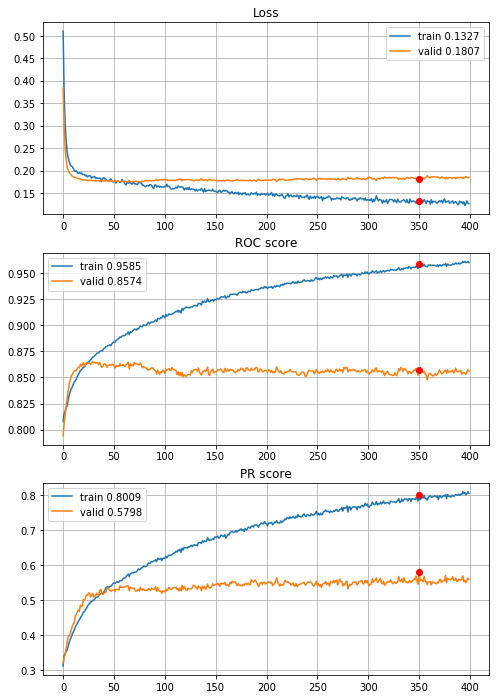


Fold 2------------------------------------------------------------


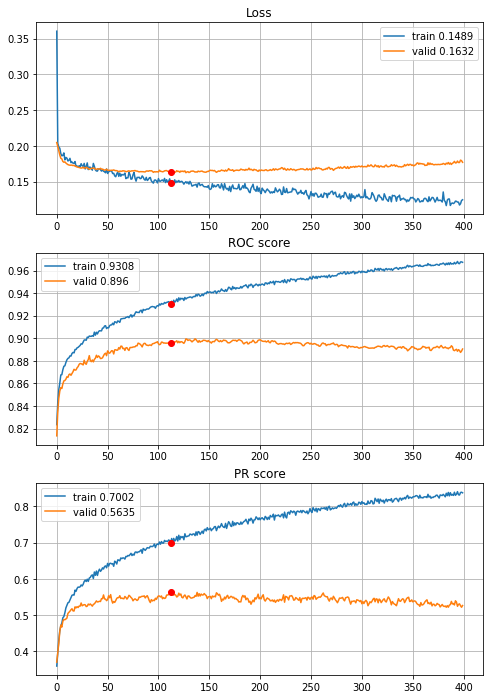


Fold 3------------------------------------------------------------


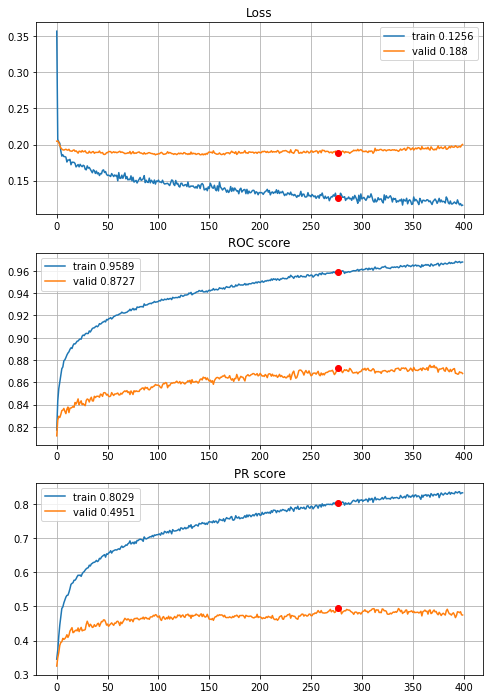


Fold 4------------------------------------------------------------


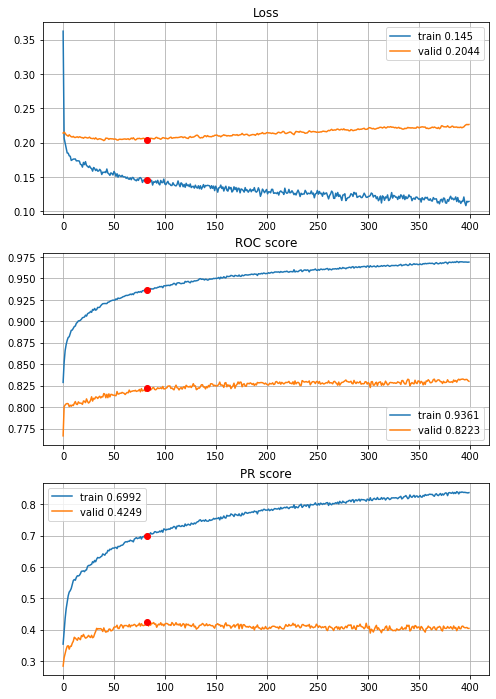


Fold 5------------------------------------------------------------


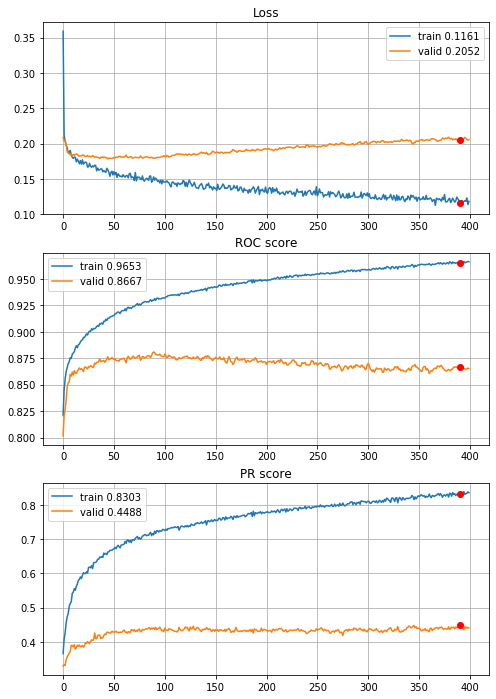


Fold 6------------------------------------------------------------


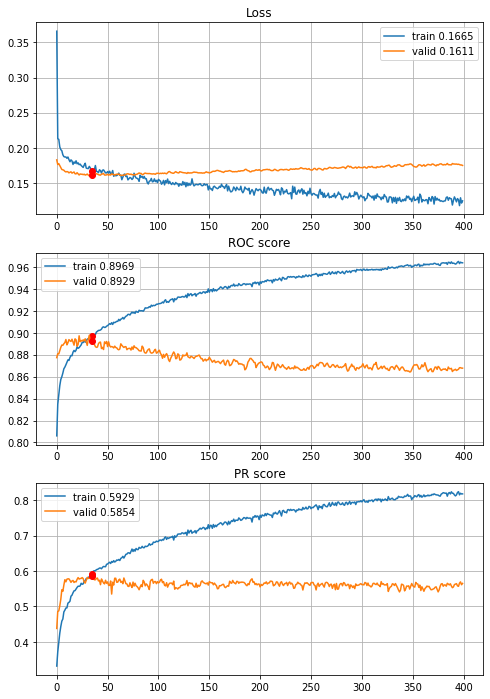

In [222]:
# normalization and quantile outliers reduction (Q_0.005 and Q_0.995)
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=True, q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

What an improvement! +0.07 on PR compared to normalization only and +0.17 compared to raw data! Lets try power transform


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/400,
cumulative time: 6.24s train loss: 0.514640832824182, validation loss: 0.40253199850289906
Epoch: 2/400,
cumulative time: 6.35s train loss: 0.3983867920612385, validation loss: 0.32156291298291056
Epoch: 3/400,
cumulative time: 6.44s train loss: 0.3270771079948878, validation loss: 0.2719552457131017
Epoch: 4/400,
cumulative time: 6.54s train loss: 0.2864243178645196, validation loss: 0.24237682429281943
Epoch: 5/400,
cumulative time: 6.63s train loss: 0.2530360777899354, validation loss: 0.22440331776152872
Epoch: 6/400,
cumulative time: 6.72s train loss: 0.24099557103071403, validation loss: 0.21306836074207655
Epoch: 7/400,
cumulative time: 6.8s train loss: 0.22795451314117934, validation loss: 0.20581137561139556
Epoch: 8/400,
cumulative time: 6.89s train loss: 0.21440554303302017, validation loss: 0.20063075335883235
Epoch: 9/400,
cumulative time: 6.98s train loss: 0.21336290108490508, vali

Epoch: 78/400,
cumulative time: 13.05s train loss: 0.1607872611180701, validation loss: 0.1671208041093261
Epoch: 79/400,
cumulative time: 13.16s train loss: 0.15899312453149458, validation loss: 0.16683930672679975
Epoch: 80/400,
cumulative time: 13.25s train loss: 0.1575556495445461, validation loss: 0.16668639067463836
Epoch: 81/400,
cumulative time: 13.34s train loss: 0.1563708095976054, validation loss: 0.16823853879931813
Epoch: 82/400,
cumulative time: 13.43s train loss: 0.15239101055579174, validation loss: 0.1696258602241787
Epoch: 83/400,
cumulative time: 13.52s train loss: 0.1582397502924346, validation loss: 0.16797792641057505
Epoch: 84/400,
cumulative time: 13.61s train loss: 0.15901062574022407, validation loss: 0.16822603244120266
Epoch: 85/400,
cumulative time: 13.7s train loss: 0.15615163884707306, validation loss: 0.16858972850955997
Epoch: 86/400,
cumulative time: 13.79s train loss: 0.15974435616042532, validation loss: 0.16848729639875848
Epoch: 87/400,
cumulative 

Epoch: 154/400,
cumulative time: 19.76s train loss: 0.14654497546059775, validation loss: 0.1654873433551229
Epoch: 155/400,
cumulative time: 19.85s train loss: 0.14353661475508114, validation loss: 0.1667956997301291
Epoch: 156/400,
cumulative time: 19.93s train loss: 0.1430369047985987, validation loss: 0.16532459329255136
Epoch: 157/400,
cumulative time: 20.03s train loss: 0.14328524433681572, validation loss: 0.16483179539475662
Epoch: 158/400,
cumulative time: 20.12s train loss: 0.14300356725977215, validation loss: 0.16415761888295982
Epoch: 159/400,
cumulative time: 20.21s train loss: 0.14601054780911452, validation loss: 0.16520082137495984
Epoch: 160/400,
cumulative time: 20.3s train loss: 0.14087854523467244, validation loss: 0.16273725981978446
Epoch: 161/400,
cumulative time: 20.39s train loss: 0.1427420279522181, validation loss: 0.16544236239411247
Epoch: 162/400,
cumulative time: 20.48s train loss: 0.14274928753099503, validation loss: 0.16670031850609462
Epoch: 163/400,

Epoch: 231/400,
cumulative time: 26.64s train loss: 0.1363934563835982, validation loss: 0.16481574282906908
Epoch: 232/400,
cumulative time: 26.72s train loss: 0.12988145693813852, validation loss: 0.16465994596414124
Epoch: 233/400,
cumulative time: 26.8s train loss: 0.12717517939419737, validation loss: 0.16443811073109693
Epoch: 234/400,
cumulative time: 26.89s train loss: 0.1328993969452349, validation loss: 0.16310523104304794
Epoch: 235/400,
cumulative time: 26.98s train loss: 0.1314472449667725, validation loss: 0.16317223378676574
Epoch: 236/400,
cumulative time: 27.08s train loss: 0.1313776210427876, validation loss: 0.16410824132341947
Epoch: 237/400,
cumulative time: 27.17s train loss: 0.12725266804481564, validation loss: 0.16550991187772998
Epoch: 238/400,
cumulative time: 27.26s train loss: 0.130004614524355, validation loss: 0.16701974527408467
Epoch: 239/400,
cumulative time: 27.34s train loss: 0.13251470953279884, validation loss: 0.16577534548929876
Epoch: 240/400,
c

Epoch: 308/400,
cumulative time: 33.52s train loss: 0.12094313242482795, validation loss: 0.1645758080274169
Epoch: 309/400,
cumulative time: 33.61s train loss: 0.12314366415102666, validation loss: 0.16429079153492054
Epoch: 310/400,
cumulative time: 33.7s train loss: 0.12655168073083733, validation loss: 0.16533839242299755
Epoch: 311/400,
cumulative time: 33.8s train loss: 0.12083455773292358, validation loss: 0.16467248566927475
Epoch: 312/400,
cumulative time: 33.89s train loss: 0.12246924300849546, validation loss: 0.16479816942096698
Epoch: 313/400,
cumulative time: 33.98s train loss: 0.1210474462537532, validation loss: 0.16441319642636795
Epoch: 314/400,
cumulative time: 34.07s train loss: 0.11829541782623271, validation loss: 0.16452860801975247
Epoch: 315/400,
cumulative time: 34.16s train loss: 0.12379782650256631, validation loss: 0.1654601479631669
Epoch: 316/400,
cumulative time: 34.26s train loss: 0.12524977026487086, validation loss: 0.16591369121292399
Epoch: 317/400,

Epoch: 385/400,
cumulative time: 40.34s train loss: 0.10922590621313356, validation loss: 0.16810707005398115
Epoch: 386/400,
cumulative time: 40.42s train loss: 0.11888671133142731, validation loss: 0.16747701480531102
Epoch: 387/400,
cumulative time: 40.51s train loss: 0.11183771206274468, validation loss: 0.1668443396233921
Epoch: 388/400,
cumulative time: 40.6s train loss: 0.11350004270081056, validation loss: 0.16891498747780465
Epoch: 389/400,
cumulative time: 40.69s train loss: 0.10853435503594604, validation loss: 0.1685577449730042
Epoch: 390/400,
cumulative time: 40.79s train loss: 0.1092416339886748, validation loss: 0.16740689916366117
Epoch: 391/400,
cumulative time: 40.89s train loss: 0.11213270118897142, validation loss: 0.16580623258934216
Epoch: 392/400,
cumulative time: 40.98s train loss: 0.11695308171696826, validation loss: 0.16594596079465637
Epoch: 393/400,
cumulative time: 41.07s train loss: 0.12202617151844265, validation loss: 0.16963276885273493
Epoch: 394/400

Epoch: 61/400,
cumulative time: 12.15s train loss: 0.15099197276447654, validation loss: 0.1520130125114856
Epoch: 62/400,
cumulative time: 12.23s train loss: 0.1481658135665184, validation loss: 0.15042842488647717
Epoch: 63/400,
cumulative time: 12.31s train loss: 0.1539754239196758, validation loss: 0.15073806486746638
Epoch: 64/400,
cumulative time: 12.4s train loss: 0.1484286486631804, validation loss: 0.15181440718077216
Epoch: 65/400,
cumulative time: 12.49s train loss: 0.15269052231220348, validation loss: 0.1505974530837716
Epoch: 66/400,
cumulative time: 12.58s train loss: 0.1532106389550472, validation loss: 0.15050773204985707
Epoch: 67/400,
cumulative time: 12.67s train loss: 0.15453948717671934, validation loss: 0.15060228189997366
Epoch: 68/400,
cumulative time: 12.75s train loss: 0.1538573060964742, validation loss: 0.15106460906506392
Epoch: 69/400,
cumulative time: 12.84s train loss: 0.14871757216953305, validation loss: 0.15123602810075346
Epoch: 70/400,
cumulative t

Epoch: 139/400,
cumulative time: 19.01s train loss: 0.13205286637889996, validation loss: 0.14427491515169283
Epoch: 140/400,
cumulative time: 19.1s train loss: 0.1342768286243888, validation loss: 0.14467716379156242
Epoch: 141/400,
cumulative time: 19.19s train loss: 0.13632044578071967, validation loss: 0.1438602459319818
Epoch: 142/400,
cumulative time: 19.28s train loss: 0.13301837291998875, validation loss: 0.14411936613826634
Epoch: 143/400,
cumulative time: 19.36s train loss: 0.1339273697962238, validation loss: 0.14570261327194925
Epoch: 144/400,
cumulative time: 19.44s train loss: 0.13649591553068655, validation loss: 0.14386940620663202
Epoch: 145/400,
cumulative time: 19.52s train loss: 0.13331281814710758, validation loss: 0.14492105780822448
Epoch: 146/400,
cumulative time: 19.61s train loss: 0.13190243538764948, validation loss: 0.14356199063133898
Epoch: 147/400,
cumulative time: 19.7s train loss: 0.13422811679232743, validation loss: 0.14458371036955844
Epoch: 148/400,

Epoch: 214/400,
cumulative time: 25.67s train loss: 0.1260776358021134, validation loss: 0.14560802327941477
Epoch: 215/400,
cumulative time: 25.76s train loss: 0.12064754429007696, validation loss: 0.14331520629339045
Epoch: 216/400,
cumulative time: 25.85s train loss: 0.1282416288724122, validation loss: 0.1438850471844399
Epoch: 217/400,
cumulative time: 25.95s train loss: 0.12364299512982692, validation loss: 0.1429678835436752
Epoch: 218/400,
cumulative time: 26.04s train loss: 0.12588598525037295, validation loss: 0.1422032253163643
Epoch: 219/400,
cumulative time: 26.13s train loss: 0.12648795419692024, validation loss: 0.14334591547827308
Epoch: 220/400,
cumulative time: 26.23s train loss: 0.12502017702961118, validation loss: 0.14212341562098285
Epoch: 221/400,
cumulative time: 26.32s train loss: 0.12535752503988115, validation loss: 0.14195133801108686
Epoch: 222/400,
cumulative time: 26.41s train loss: 0.12309461215423548, validation loss: 0.14474370759799488
Epoch: 223/400,

Epoch: 289/400,
cumulative time: 32.41s train loss: 0.11798958525411274, validation loss: 0.14246859317466937
Epoch: 290/400,
cumulative time: 32.49s train loss: 0.11333125668312238, validation loss: 0.14270945242789848
Epoch: 291/400,
cumulative time: 32.59s train loss: 0.11931424081285184, validation loss: 0.14076102518276
Epoch: 292/400,
cumulative time: 32.68s train loss: 0.11385742348319572, validation loss: 0.14262288738264708
Epoch: 293/400,
cumulative time: 32.77s train loss: 0.11450765986963837, validation loss: 0.14350266932701983
Epoch: 294/400,
cumulative time: 32.87s train loss: 0.11362807769899926, validation loss: 0.14177120419002842
Epoch: 295/400,
cumulative time: 32.96s train loss: 0.11899702341736224, validation loss: 0.14125283804156197
Epoch: 296/400,
cumulative time: 33.06s train loss: 0.11939031606883026, validation loss: 0.14180515050518472
Epoch: 297/400,
cumulative time: 33.14s train loss: 0.11414616357615816, validation loss: 0.14219039468579792
Epoch: 298/40

Epoch: 365/400,
cumulative time: 39.16s train loss: 0.11088440693000379, validation loss: 0.14082787453859474
Epoch: 366/400,
cumulative time: 39.25s train loss: 0.10748910929146979, validation loss: 0.14226124168551088
Epoch: 367/400,
cumulative time: 39.34s train loss: 0.1095852650574237, validation loss: 0.14161838249228853
Epoch: 368/400,
cumulative time: 39.44s train loss: 0.1079301051190291, validation loss: 0.14024006131839054
Epoch: 369/400,
cumulative time: 39.54s train loss: 0.10826222917623146, validation loss: 0.14219162563594917
Epoch: 370/400,
cumulative time: 39.62s train loss: 0.11189922925743816, validation loss: 0.14319180753481026
Epoch: 371/400,
cumulative time: 39.7s train loss: 0.11368907116931806, validation loss: 0.14209440856197642
Epoch: 372/400,
cumulative time: 39.78s train loss: 0.11351956097940352, validation loss: 0.1422195901344567
Epoch: 373/400,
cumulative time: 39.87s train loss: 0.11083551758853215, validation loss: 0.14168055001079297
Epoch: 374/400

Epoch: 39/400,
cumulative time: 9.9s train loss: 0.15478201174859751, validation loss: 0.18146993543242923
Epoch: 40/400,
cumulative time: 9.98s train loss: 0.15453295353867302, validation loss: 0.17999606825654912
Epoch: 41/400,
cumulative time: 10.06s train loss: 0.151951100680614, validation loss: 0.17913131793832832
Epoch: 42/400,
cumulative time: 10.16s train loss: 0.15461655454676504, validation loss: 0.17973461454018128
Epoch: 43/400,
cumulative time: 10.25s train loss: 0.15053672147477684, validation loss: 0.1791858644368549
Epoch: 44/400,
cumulative time: 10.34s train loss: 0.15097590908744382, validation loss: 0.17966870057240145
Epoch: 45/400,
cumulative time: 10.44s train loss: 0.15136740862354905, validation loss: 0.18084576527725615
Epoch: 46/400,
cumulative time: 10.53s train loss: 0.15438039504018503, validation loss: 0.17981240796733736
Epoch: 47/400,
cumulative time: 10.62s train loss: 0.15877542407369571, validation loss: 0.17858211590311035
Epoch: 48/400,
cumulative

Epoch: 116/400,
cumulative time: 16.77s train loss: 0.13717383987166068, validation loss: 0.173927669813426
Epoch: 117/400,
cumulative time: 16.86s train loss: 0.13327529555899412, validation loss: 0.1750612428082151
Epoch: 118/400,
cumulative time: 16.95s train loss: 0.1402386422184992, validation loss: 0.17466140466216182
Epoch: 119/400,
cumulative time: 17.04s train loss: 0.13714708027762734, validation loss: 0.17330588538119865
Epoch: 120/400,
cumulative time: 17.13s train loss: 0.13301942932389219, validation loss: 0.1741022728257545
Epoch: 121/400,
cumulative time: 17.22s train loss: 0.13125872469779493, validation loss: 0.17653417368886704
Epoch: 122/400,
cumulative time: 17.32s train loss: 0.13176999125118613, validation loss: 0.1771408279658439
Epoch: 123/400,
cumulative time: 17.4s train loss: 0.13811970817846403, validation loss: 0.1787363064329412
Epoch: 124/400,
cumulative time: 17.5s train loss: 0.13789819703783693, validation loss: 0.17875433731677165
Epoch: 125/400,
cum

cumulative time: 23.57s train loss: 0.12067614074137452, validation loss: 0.1752898300144288
Epoch: 192/400,
cumulative time: 23.66s train loss: 0.1227862114752458, validation loss: 0.17641435456047466
Epoch: 193/400,
cumulative time: 23.74s train loss: 0.12627078808292694, validation loss: 0.17549343437393192
Epoch: 194/400,
cumulative time: 23.83s train loss: 0.12435251338212391, validation loss: 0.17652458318728606
Epoch: 195/400,
cumulative time: 23.92s train loss: 0.12049643160096145, validation loss: 0.1735853901072043
Epoch: 196/400,
cumulative time: 24.01s train loss: 0.12367864842408939, validation loss: 0.17686745941034165
Epoch: 197/400,
cumulative time: 24.1s train loss: 0.12448440219144528, validation loss: 0.17285852450058453
Epoch: 198/400,
cumulative time: 24.19s train loss: 0.12180749680308982, validation loss: 0.17214530041985204
Epoch: 199/400,
cumulative time: 24.28s train loss: 0.12257429160554272, validation loss: 0.1749676287913403
Epoch: 200/400,
cumulative time

cumulative time: 30.22s train loss: 0.11458889116610431, validation loss: 0.17818824445415107
Epoch: 267/400,
cumulative time: 30.31s train loss: 0.11481421568602432, validation loss: 0.1773384490639408
Epoch: 268/400,
cumulative time: 30.39s train loss: 0.1166495552542031, validation loss: 0.17879333202606393
Epoch: 269/400,
cumulative time: 30.48s train loss: 0.11421493205177978, validation loss: 0.17888207312803525
Epoch: 270/400,
cumulative time: 30.57s train loss: 0.11838732417403898, validation loss: 0.179736812915044
Epoch: 271/400,
cumulative time: 30.66s train loss: 0.11695806574520222, validation loss: 0.18096203009231518
Epoch: 272/400,
cumulative time: 30.74s train loss: 0.11653567863702236, validation loss: 0.1776034037048142
Epoch: 273/400,
cumulative time: 30.82s train loss: 0.11941828499699435, validation loss: 0.1797807222860104
Epoch: 274/400,
cumulative time: 30.91s train loss: 0.11191863179314437, validation loss: 0.1798492860061609
Epoch: 275/400,
cumulative time: 

cumulative time: 36.93s train loss: 0.10380629467229874, validation loss: 0.18083594857873617
Epoch: 343/400,
cumulative time: 37.02s train loss: 0.1097123115995919, validation loss: 0.18559537114829597
Epoch: 344/400,
cumulative time: 37.1s train loss: 0.10551671257464464, validation loss: 0.183008746933843
Epoch: 345/400,
cumulative time: 37.18s train loss: 0.10747228735647692, validation loss: 0.1794359096931766
Epoch: 346/400,
cumulative time: 37.27s train loss: 0.10838360745553936, validation loss: 0.1784221372717263
Epoch: 347/400,
cumulative time: 37.36s train loss: 0.11336754202600635, validation loss: 0.18154205770778817
Epoch: 348/400,
cumulative time: 37.45s train loss: 0.10856379435434668, validation loss: 0.18283252089610902
Epoch: 349/400,
cumulative time: 37.54s train loss: 0.10933248715186054, validation loss: 0.17886085851115868
Epoch: 350/400,
cumulative time: 37.63s train loss: 0.10920615318745698, validation loss: 0.180497947546917
Epoch: 351/400,
cumulative time: 3

Epoch: 92/400,
cumulative time: 14.9s train loss: 0.1373610236817925, validation loss: 0.1982413087014958
Epoch: 93/400,
cumulative time: 14.98s train loss: 0.13820220196244412, validation loss: 0.19735599586710703
Epoch: 94/400,
cumulative time: 15.07s train loss: 0.13139152438114063, validation loss: 0.19572090039673024
Epoch: 95/400,
cumulative time: 15.16s train loss: 0.13314565253155564, validation loss: 0.19726960519097458
Epoch: 96/400,
cumulative time: 15.25s train loss: 0.1306763637332784, validation loss: 0.19587436362125535
Epoch: 97/400,
cumulative time: 15.34s train loss: 0.13592296667664255, validation loss: 0.19511500875513926
Epoch: 98/400,
cumulative time: 15.44s train loss: 0.1346216081645186, validation loss: 0.19581234098557157
Epoch: 99/400,
cumulative time: 15.53s train loss: 0.13614940113887383, validation loss: 0.19656288983724995
Epoch: 100/400,
cumulative time: 15.62s train loss: 0.13511414826924714, validation loss: 0.19604688896282532
Epoch: 101/400,
cumulat

Epoch: 170/400,
cumulative time: 21.94s train loss: 0.12117279313392089, validation loss: 0.19322238694329832
Epoch: 171/400,
cumulative time: 22.03s train loss: 0.12504563533894075, validation loss: 0.19290734655970107
Epoch: 172/400,
cumulative time: 22.12s train loss: 0.11826219968875913, validation loss: 0.19656804806088218
Epoch: 173/400,
cumulative time: 22.22s train loss: 0.12727800888208324, validation loss: 0.19365908255964584
Epoch: 174/400,
cumulative time: 22.31s train loss: 0.12027479635588127, validation loss: 0.19308096880164696
Epoch: 175/400,
cumulative time: 22.39s train loss: 0.11844428568009514, validation loss: 0.19488408394645623
Epoch: 176/400,
cumulative time: 22.48s train loss: 0.12392754449905942, validation loss: 0.1949898781545006
Epoch: 177/400,
cumulative time: 22.57s train loss: 0.12288948469336243, validation loss: 0.19502236154224747
Epoch: 178/400,
cumulative time: 22.66s train loss: 0.11529103263678143, validation loss: 0.19586525574898342
Epoch: 179/

Epoch: 245/400,
cumulative time: 28.65s train loss: 0.11410396699910236, validation loss: 0.19310948945598733
Epoch: 246/400,
cumulative time: 28.73s train loss: 0.11550509700240277, validation loss: 0.1940504453454007
Epoch: 247/400,
cumulative time: 28.82s train loss: 0.11312615612096129, validation loss: 0.19423810078112858
Epoch: 248/400,
cumulative time: 28.92s train loss: 0.10959270539528194, validation loss: 0.19723043548737906
Epoch: 249/400,
cumulative time: 29.01s train loss: 0.10687493161627544, validation loss: 0.19678054800421066
Epoch: 250/400,
cumulative time: 29.1s train loss: 0.11436462255113689, validation loss: 0.19498055668770595
Epoch: 251/400,
cumulative time: 29.18s train loss: 0.11534203073657341, validation loss: 0.19594614285109543
Epoch: 252/400,
cumulative time: 29.27s train loss: 0.10775696408754006, validation loss: 0.19699598976640076
Epoch: 253/400,
cumulative time: 29.36s train loss: 0.11431026038899261, validation loss: 0.19645619224210356
Epoch: 254/4

cumulative time: 35.47s train loss: 0.10123727866443209, validation loss: 0.19843729768730448
Epoch: 322/400,
cumulative time: 35.55s train loss: 0.10745011520471795, validation loss: 0.19876031480040024
Epoch: 323/400,
cumulative time: 35.63s train loss: 0.10413945499558011, validation loss: 0.19906210310706704
Epoch: 324/400,
cumulative time: 35.72s train loss: 0.1026996701986048, validation loss: 0.19893134030477727
Epoch: 325/400,
cumulative time: 35.81s train loss: 0.10592290065458228, validation loss: 0.19925250540199452
Epoch: 326/400,
cumulative time: 35.9s train loss: 0.11023163271090153, validation loss: 0.19713048522547727
Epoch: 327/400,
cumulative time: 35.98s train loss: 0.10756315258826356, validation loss: 0.19671976848864933
Epoch: 328/400,
cumulative time: 36.06s train loss: 0.10763925785220237, validation loss: 0.196771151056139
Epoch: 329/400,
cumulative time: 36.16s train loss: 0.10262508882630256, validation loss: 0.19811827509451665
Epoch: 330/400,
cumulative tim

cumulative time: 42.23s train loss: 0.10462189348111593, validation loss: 0.19644496309030676
Epoch: 398/400,
cumulative time: 42.32s train loss: 0.0961319808494203, validation loss: 0.19568938504627004
Epoch: 399/400,
cumulative time: 42.4s train loss: 0.10198819015100313, validation loss: 0.19742271717864826
Epoch: 400/400,
cumulative time: 42.49s train loss: 0.1046814832491004, validation loss: 0.1957077630553773

Early stopping results:
best results in epoch: 356, 
best valid PR: 0.5346906202802812, 
valid ROC: 0.8628514654744164        
overfitting PR: 0.34885519824276456, 
overfitting ROC: 0.11460268643428106

----------
Fold: 5
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/400,
cumulative time: 6.24s train loss: 0.3767793659879638, validation loss: 0.21148792753504847
Epoch: 2/400,
cumulative time: 6.33s train loss: 0.21466879978584377, validation loss: 0.20373430047562643
Epoch: 3/400,
cumulative time: 6.43s train loss: 0.20406807083094494, validation loss:

Epoch: 72/400,
cumulative time: 12.74s train loss: 0.14943767645048175, validation loss: 0.16899287236463403
Epoch: 73/400,
cumulative time: 12.82s train loss: 0.14636353769892363, validation loss: 0.16850082939553745
Epoch: 74/400,
cumulative time: 12.91s train loss: 0.14711164003593133, validation loss: 0.16827004118643818
Epoch: 75/400,
cumulative time: 13.0s train loss: 0.14683091404164803, validation loss: 0.1678476692187867
Epoch: 76/400,
cumulative time: 13.08s train loss: 0.1477380701160689, validation loss: 0.16875608813681936
Epoch: 77/400,
cumulative time: 13.18s train loss: 0.14254144813967107, validation loss: 0.16964383685696474
Epoch: 78/400,
cumulative time: 13.28s train loss: 0.14615430115994604, validation loss: 0.1680496601434109
Epoch: 79/400,
cumulative time: 13.37s train loss: 0.14667950444194067, validation loss: 0.16755959637143542
Epoch: 80/400,
cumulative time: 13.46s train loss: 0.14650535713246787, validation loss: 0.16779197863477616
Epoch: 81/400,
cumulati

Epoch: 148/400,
cumulative time: 19.7s train loss: 0.12759081977647502, validation loss: 0.1698718199813339
Epoch: 149/400,
cumulative time: 19.79s train loss: 0.1339571499041986, validation loss: 0.16812307984645963
Epoch: 150/400,
cumulative time: 19.88s train loss: 0.1303310294688326, validation loss: 0.16603227299438372
Epoch: 151/400,
cumulative time: 19.98s train loss: 0.12843442445222986, validation loss: 0.16642459362543463
Epoch: 152/400,
cumulative time: 20.08s train loss: 0.1333462701219214, validation loss: 0.16880311199693054
Epoch: 153/400,
cumulative time: 20.17s train loss: 0.13397622155351238, validation loss: 0.16767938976632285
Epoch: 154/400,
cumulative time: 20.27s train loss: 0.1307761610434982, validation loss: 0.16762772629680806
Epoch: 155/400,
cumulative time: 20.36s train loss: 0.1267775439235203, validation loss: 0.1672273484767156
Epoch: 156/400,
cumulative time: 20.46s train loss: 0.13060515842358683, validation loss: 0.16900101408328752
Epoch: 157/400,
cu

Epoch: 223/400,
cumulative time: 26.67s train loss: 0.12251842361109105, validation loss: 0.16793966242879563
Epoch: 224/400,
cumulative time: 26.75s train loss: 0.12116028986637624, validation loss: 0.16890710222263638
Epoch: 225/400,
cumulative time: 26.84s train loss: 0.12291882113681107, validation loss: 0.1685130105566225
Epoch: 226/400,
cumulative time: 26.92s train loss: 0.12334523934718854, validation loss: 0.16665363432860536
Epoch: 227/400,
cumulative time: 27.0s train loss: 0.11687742900746202, validation loss: 0.16717490209077335
Epoch: 228/400,
cumulative time: 27.08s train loss: 0.12543639453611605, validation loss: 0.16687069399362223
Epoch: 229/400,
cumulative time: 27.18s train loss: 0.11844694855928206, validation loss: 0.16698754893334133
Epoch: 230/400,
cumulative time: 27.26s train loss: 0.11537949038098447, validation loss: 0.16827452731051779
Epoch: 231/400,
cumulative time: 27.34s train loss: 0.12206686601906631, validation loss: 0.16908897382142044
Epoch: 232/4

cumulative time: 33.47s train loss: 0.11167309853735073, validation loss: 0.16942419629737432
Epoch: 299/400,
cumulative time: 33.56s train loss: 0.11922075922632228, validation loss: 0.1692617665261501
Epoch: 300/400,
cumulative time: 33.64s train loss: 0.1205182771296983, validation loss: 0.16933048407191886
Epoch: 301/400,
cumulative time: 33.73s train loss: 0.11421434493546773, validation loss: 0.17018303201107085
Epoch: 302/400,
cumulative time: 33.83s train loss: 0.11686508044576957, validation loss: 0.16858512428893999
Epoch: 303/400,
cumulative time: 33.91s train loss: 0.11532466027851221, validation loss: 0.171664378578453
Epoch: 304/400,
cumulative time: 34.0s train loss: 0.11608947370308074, validation loss: 0.17063756978336897
Epoch: 305/400,
cumulative time: 34.08s train loss: 0.11576369877071863, validation loss: 0.16991910728590215
Epoch: 306/400,
cumulative time: 34.18s train loss: 0.11020279836565922, validation loss: 0.17194174559740666
Epoch: 307/400,
cumulative time

Epoch: 375/400,
cumulative time: 40.39s train loss: 0.111239697754773, validation loss: 0.17448355173418806
Epoch: 376/400,
cumulative time: 40.47s train loss: 0.11446592602992257, validation loss: 0.17371960768043054
Epoch: 377/400,
cumulative time: 40.55s train loss: 0.1078402411613673, validation loss: 0.17378028231603568
Epoch: 378/400,
cumulative time: 40.65s train loss: 0.11338021971760984, validation loss: 0.17382391301692204
Epoch: 379/400,
cumulative time: 40.74s train loss: 0.10684551026931795, validation loss: 0.17395131855059423
Epoch: 380/400,
cumulative time: 40.84s train loss: 0.11279586906875333, validation loss: 0.17423912860940866
Epoch: 381/400,
cumulative time: 40.93s train loss: 0.10373107980564489, validation loss: 0.17507759902130132
Epoch: 382/400,
cumulative time: 41.01s train loss: 0.10850876085535818, validation loss: 0.17295835224352357
Epoch: 383/400,
cumulative time: 41.11s train loss: 0.108942672828775, validation loss: 0.1716568091922097
Epoch: 384/400,


Epoch: 49/400,
cumulative time: 11.53s train loss: 0.156241949016559, validation loss: 0.1600788177136105
Epoch: 50/400,
cumulative time: 11.62s train loss: 0.1546981930329357, validation loss: 0.16078367085946602
Epoch: 51/400,
cumulative time: 11.72s train loss: 0.15444751896305328, validation loss: 0.16057049148373356
Epoch: 52/400,
cumulative time: 11.81s train loss: 0.15304657917729408, validation loss: 0.15897899004998647
Epoch: 53/400,
cumulative time: 11.9s train loss: 0.1560014328897712, validation loss: 0.16092560569804087
Epoch: 54/400,
cumulative time: 11.99s train loss: 0.1550429176724901, validation loss: 0.1588191654760197
Epoch: 55/400,
cumulative time: 12.07s train loss: 0.15334763701693377, validation loss: 0.15988930784014493
Epoch: 56/400,
cumulative time: 12.15s train loss: 0.15968714739489495, validation loss: 0.16029674157870274
Epoch: 57/400,
cumulative time: 12.23s train loss: 0.15131769576877818, validation loss: 0.15877544627636334
Epoch: 58/400,
cumulative t

cumulative time: 18.21s train loss: 0.13866075300925637, validation loss: 0.15431210550040209
Epoch: 126/400,
cumulative time: 18.31s train loss: 0.1351395888372116, validation loss: 0.15386836304756105
Epoch: 127/400,
cumulative time: 18.4s train loss: 0.13851610671148165, validation loss: 0.15343028885516302
Epoch: 128/400,
cumulative time: 18.49s train loss: 0.13315272190394425, validation loss: 0.1542584498499102
Epoch: 129/400,
cumulative time: 18.57s train loss: 0.13676018541321217, validation loss: 0.15410377313940035
Epoch: 130/400,
cumulative time: 18.65s train loss: 0.13725338821792452, validation loss: 0.1538498233457182
Epoch: 131/400,
cumulative time: 18.73s train loss: 0.1359183771290791, validation loss: 0.1531135229305543
Epoch: 132/400,
cumulative time: 18.81s train loss: 0.1348772740797025, validation loss: 0.15450633628373758
Epoch: 133/400,
cumulative time: 18.89s train loss: 0.13318392849186325, validation loss: 0.1558128011415021
Epoch: 134/400,
cumulative time: 1

Epoch: 202/400,
cumulative time: 24.81s train loss: 0.12530256586959015, validation loss: 0.15202807532476248
Epoch: 203/400,
cumulative time: 24.9s train loss: 0.12068564115529563, validation loss: 0.15236865737502786
Epoch: 204/400,
cumulative time: 24.99s train loss: 0.1263412945728834, validation loss: 0.15070227276256337
Epoch: 205/400,
cumulative time: 25.09s train loss: 0.13003295816660948, validation loss: 0.15087282808989488
Epoch: 206/400,
cumulative time: 25.18s train loss: 0.12456765218967512, validation loss: 0.1502067470254532
Epoch: 207/400,
cumulative time: 25.27s train loss: 0.12354571225208594, validation loss: 0.1510070417387491
Epoch: 208/400,
cumulative time: 25.37s train loss: 0.1223412026455191, validation loss: 0.15191568229053146
Epoch: 209/400,
cumulative time: 25.46s train loss: 0.12446761419696192, validation loss: 0.15222426525760718
Epoch: 210/400,
cumulative time: 25.55s train loss: 0.13108183873303447, validation loss: 0.15312441154204426
Epoch: 211/400,

Epoch: 279/400,
cumulative time: 31.63s train loss: 0.11748940127628828, validation loss: 0.147860731618399
Epoch: 280/400,
cumulative time: 31.71s train loss: 0.11525642591514519, validation loss: 0.1466003988383855
Epoch: 281/400,
cumulative time: 31.79s train loss: 0.11514187824445762, validation loss: 0.1493726636768733
Epoch: 282/400,
cumulative time: 31.87s train loss: 0.11952676816836938, validation loss: 0.1493080851724939
Epoch: 283/400,
cumulative time: 31.95s train loss: 0.11365873320710973, validation loss: 0.14711773133170256
Epoch: 284/400,
cumulative time: 32.04s train loss: 0.11827560193028268, validation loss: 0.1467912456117419
Epoch: 285/400,
cumulative time: 32.13s train loss: 0.11679177196137985, validation loss: 0.14650924924264913
Epoch: 286/400,
cumulative time: 32.23s train loss: 0.11397792561117963, validation loss: 0.14618173066703244
Epoch: 287/400,
cumulative time: 32.32s train loss: 0.11502021593990268, validation loss: 0.14577075876043288
Epoch: 288/400,


cumulative time: 38.38s train loss: 0.11183341094724432, validation loss: 0.14286760333294793
Epoch: 355/400,
cumulative time: 38.47s train loss: 0.11402239129804419, validation loss: 0.14518471361552082
Epoch: 356/400,
cumulative time: 38.56s train loss: 0.11381954085119632, validation loss: 0.1475531012492578
Epoch: 357/400,
cumulative time: 38.66s train loss: 0.1006446404144346, validation loss: 0.1467176219343332
Epoch: 358/400,
cumulative time: 38.75s train loss: 0.11411392680515749, validation loss: 0.14430036209103217
Epoch: 359/400,
cumulative time: 38.85s train loss: 0.11120049263160116, validation loss: 0.14509439865299595
Epoch: 360/400,
cumulative time: 38.94s train loss: 0.10913348174911305, validation loss: 0.14352284580401858
Epoch: 361/400,
cumulative time: 39.04s train loss: 0.11506282999193913, validation loss: 0.14447179261771603
Epoch: 362/400,
cumulative time: 39.13s train loss: 0.10746383726153125, validation loss: 0.14720536048606073
Epoch: 363/400,
cumulative ti

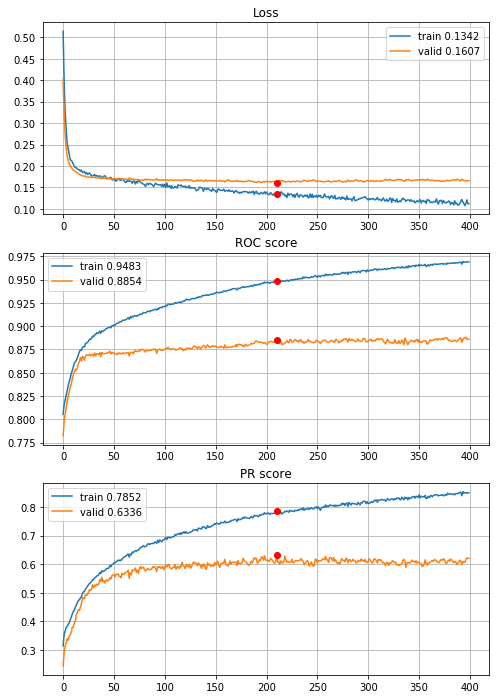


Fold 2------------------------------------------------------------


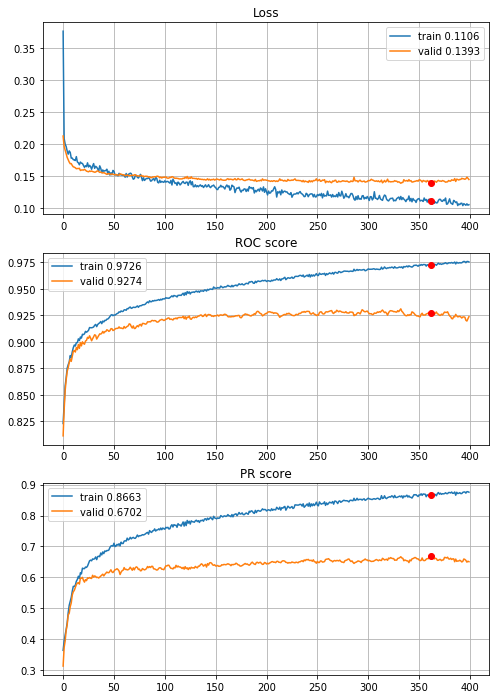


Fold 3------------------------------------------------------------


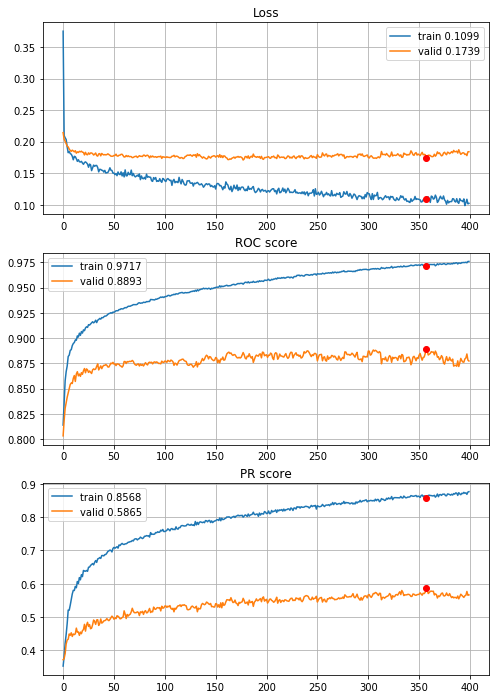


Fold 4------------------------------------------------------------


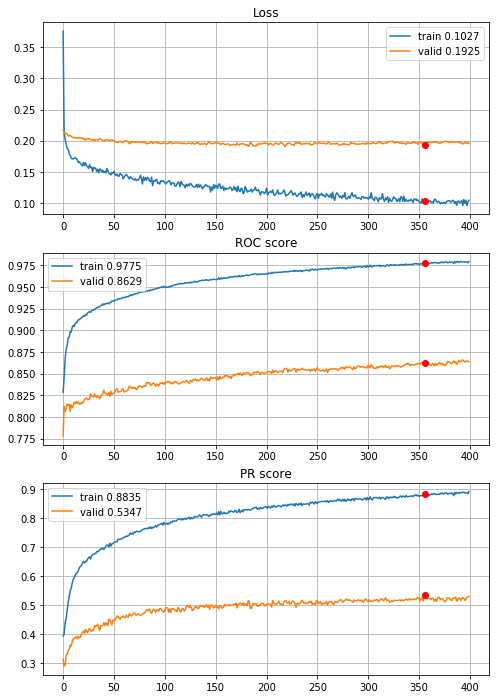


Fold 5------------------------------------------------------------


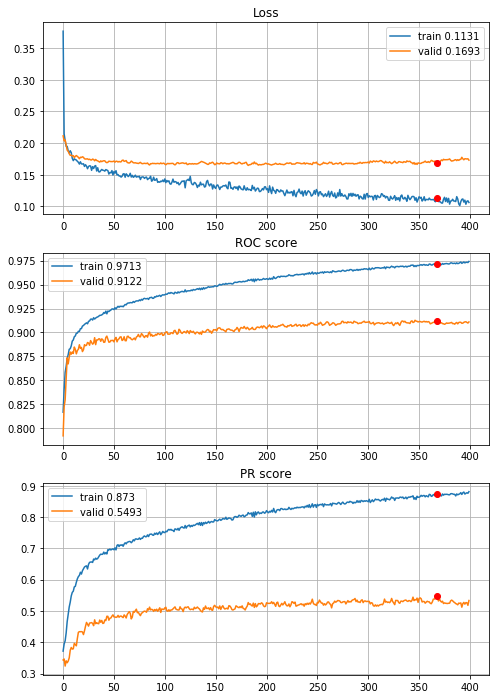


Fold 6------------------------------------------------------------


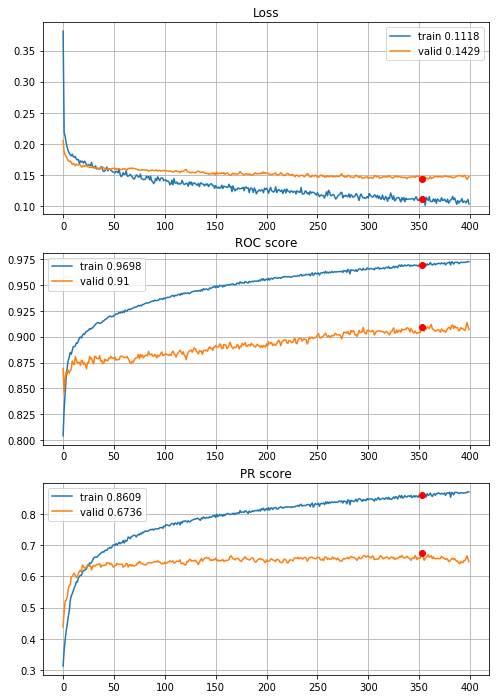

In [223]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

This improvement is more than awesome this model gets better results than XGBoost, further experiments will be performed on full preprocessing pipeline (outliers reduction, power transfrom, normalization)


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/400,
cumulative time: 7.66s train loss: 0.5801573431368123, validation loss: 0.4531163729500475
Epoch: 2/400,
cumulative time: 7.76s train loss: 0.400598604043791, validation loss: 0.33127569050235167
Epoch: 3/400,
cumulative time: 7.86s train loss: 0.3088802907629349, validation loss: 0.27578713851555625
Epoch: 4/400,
cumulative time: 7.97s train loss: 0.26788744201298653, validation loss: 0.24977918904959281
Epoch: 5/400,
cumulative time: 8.05s train loss: 0.24659044048765721, validation loss: 0.23616018953492704
Epoch: 6/400,
cumulative time: 8.15s train loss: 0.23281474115616146, validation loss: 0.22785432201630637
Epoch: 7/400,
cumulative time: 8.24s train loss: 0.2246926222937955, validation loss: 0.2223457649870951
Epoch: 8/400,
cumulative time: 8.37s train loss: 0.2186301503236328, validation loss: 0.21816740862882392
Epoch: 9/400,
cumulative time: 8.46s train loss: 0.21539701955117257, vali

Epoch: 78/400,
cumulative time: 15.12s train loss: 0.15873435558583116, validation loss: 0.1717347657935864
Epoch: 79/400,
cumulative time: 15.21s train loss: 0.15624784363521135, validation loss: 0.17099008333723334
Epoch: 80/400,
cumulative time: 15.3s train loss: 0.15789154063681618, validation loss: 0.1712047142704283
Epoch: 81/400,
cumulative time: 15.39s train loss: 0.15427319268739717, validation loss: 0.1709418849517689
Epoch: 82/400,
cumulative time: 15.47s train loss: 0.15410401733316453, validation loss: 0.17525282236742193
Epoch: 83/400,
cumulative time: 15.57s train loss: 0.1549375122581148, validation loss: 0.1697657734760437
Epoch: 84/400,
cumulative time: 15.68s train loss: 0.15686305596859662, validation loss: 0.17303098210689047
Epoch: 85/400,
cumulative time: 15.78s train loss: 0.15375117727619217, validation loss: 0.17059462787131985
Epoch: 86/400,
cumulative time: 15.87s train loss: 0.158027998982031, validation loss: 0.17217503118474695
Epoch: 87/400,
cumulative t

Epoch: 155/400,
cumulative time: 22.51s train loss: 0.1408945374722031, validation loss: 0.16782312550431847
Epoch: 156/400,
cumulative time: 22.61s train loss: 0.13629132753997933, validation loss: 0.1662980489256417
Epoch: 157/400,
cumulative time: 22.71s train loss: 0.13306541846466624, validation loss: 0.16683856042557665
Epoch: 158/400,
cumulative time: 22.81s train loss: 0.1367171328777064, validation loss: 0.16718710189540328
Epoch: 159/400,
cumulative time: 22.91s train loss: 0.1355803947162811, validation loss: 0.16899893986399306
Epoch: 160/400,
cumulative time: 23.0s train loss: 0.13674102817066955, validation loss: 0.16710674366257505
Epoch: 161/400,
cumulative time: 23.09s train loss: 0.13928883119624122, validation loss: 0.16933792041616752
Epoch: 162/400,
cumulative time: 23.19s train loss: 0.13959709609209792, validation loss: 0.16719982930140942
Epoch: 163/400,
cumulative time: 23.29s train loss: 0.1362336622887301, validation loss: 0.1703050050888685
Epoch: 164/400,
c

cumulative time: 29.87s train loss: 0.13019196487398355, validation loss: 0.17622468500422248
Epoch: 232/400,
cumulative time: 29.96s train loss: 0.12199602442850706, validation loss: 0.1760805777894604
Epoch: 233/400,
cumulative time: 30.06s train loss: 0.1276734076030149, validation loss: 0.17451985387011876
Epoch: 234/400,
cumulative time: 30.15s train loss: 0.12599949020932727, validation loss: 0.1735780094461484
Epoch: 235/400,
cumulative time: 30.24s train loss: 0.1255248640344515, validation loss: 0.17289030946698775
Epoch: 236/400,
cumulative time: 30.32s train loss: 0.12482723398033248, validation loss: 0.17368928068385722
Epoch: 237/400,
cumulative time: 30.41s train loss: 0.12395470135169447, validation loss: 0.17463407347140478
Epoch: 238/400,
cumulative time: 30.51s train loss: 0.12197053854417607, validation loss: 0.17630233023454264
Epoch: 239/400,
cumulative time: 30.61s train loss: 0.12261484568057723, validation loss: 0.17616027156825534
Epoch: 240/400,
cumulative tim

Epoch: 308/400,
cumulative time: 37.18s train loss: 0.1190828737005968, validation loss: 0.17407965315705357
Epoch: 309/400,
cumulative time: 37.28s train loss: 0.12017364482923212, validation loss: 0.17405720486850587
Epoch: 310/400,
cumulative time: 37.38s train loss: 0.11587283138306778, validation loss: 0.1746846117927633
Epoch: 311/400,
cumulative time: 37.48s train loss: 0.11398750590832925, validation loss: 0.1765648847468945
Epoch: 312/400,
cumulative time: 37.57s train loss: 0.11602430534128785, validation loss: 0.17582195441174533
Epoch: 313/400,
cumulative time: 37.67s train loss: 0.11816413075552197, validation loss: 0.1740497213944776
Epoch: 314/400,
cumulative time: 37.76s train loss: 0.11817946070838814, validation loss: 0.17736608987798014
Epoch: 315/400,
cumulative time: 37.86s train loss: 0.11869421280543942, validation loss: 0.18015693685852555
Epoch: 316/400,
cumulative time: 37.95s train loss: 0.11286406513195929, validation loss: 0.17786125365010513
Epoch: 317/400

Epoch: 383/400,
cumulative time: 44.41s train loss: 0.1097440668465805, validation loss: 0.18067113536051993
Epoch: 384/400,
cumulative time: 44.51s train loss: 0.10905147463903637, validation loss: 0.18185601081896527
Epoch: 385/400,
cumulative time: 44.6s train loss: 0.11205761767385884, validation loss: 0.18243156576774838
Epoch: 386/400,
cumulative time: 44.7s train loss: 0.11237391472091421, validation loss: 0.18142072518756183
Epoch: 387/400,
cumulative time: 44.79s train loss: 0.11195337313432448, validation loss: 0.17963163532829068
Epoch: 388/400,
cumulative time: 44.88s train loss: 0.10867156679086414, validation loss: 0.17907340575971356
Epoch: 389/400,
cumulative time: 44.99s train loss: 0.10827009708684489, validation loss: 0.1788341601745655
Epoch: 390/400,
cumulative time: 45.08s train loss: 0.10915838724291389, validation loss: 0.17821453321880526
Epoch: 391/400,
cumulative time: 45.18s train loss: 0.11080774040186664, validation loss: 0.17735911443779137
Epoch: 392/400

Epoch: 58/400,
cumulative time: 12.97s train loss: 0.14285090638640663, validation loss: 0.15887964235486415
Epoch: 59/400,
cumulative time: 13.06s train loss: 0.14578514851105234, validation loss: 0.1577483476585842
Epoch: 60/400,
cumulative time: 13.15s train loss: 0.14618405270716345, validation loss: 0.15765237487356987
Epoch: 61/400,
cumulative time: 13.25s train loss: 0.14528894679627585, validation loss: 0.15849154450948505
Epoch: 62/400,
cumulative time: 13.34s train loss: 0.14067582748763074, validation loss: 0.15715386408560708
Epoch: 63/400,
cumulative time: 13.43s train loss: 0.14665490641369608, validation loss: 0.15772391053540327
Epoch: 64/400,
cumulative time: 13.53s train loss: 0.14412343744793737, validation loss: 0.15871228745549482
Epoch: 65/400,
cumulative time: 13.62s train loss: 0.14057302449086836, validation loss: 0.15866923845439243
Epoch: 66/400,
cumulative time: 13.72s train loss: 0.14309788303658205, validation loss: 0.1578389731946631
Epoch: 67/400,
cumula

Epoch: 134/400,
cumulative time: 19.96s train loss: 0.12548391337402245, validation loss: 0.15180240525300231
Epoch: 135/400,
cumulative time: 20.05s train loss: 0.12707089981070924, validation loss: 0.15126871058072688
Epoch: 136/400,
cumulative time: 20.15s train loss: 0.12957071795024058, validation loss: 0.15154734162326058
Epoch: 137/400,
cumulative time: 20.25s train loss: 0.13277722402922942, validation loss: 0.15222313164354312
Epoch: 138/400,
cumulative time: 20.34s train loss: 0.12684502894401767, validation loss: 0.14962086704766467
Epoch: 139/400,
cumulative time: 20.43s train loss: 0.1255546639730569, validation loss: 0.14943381564391373
Epoch: 140/400,
cumulative time: 20.53s train loss: 0.12755102353062925, validation loss: 0.15038392518089483
Epoch: 141/400,
cumulative time: 20.63s train loss: 0.12364182610145437, validation loss: 0.1487871291285975
Epoch: 142/400,
cumulative time: 20.73s train loss: 0.13054054710906443, validation loss: 0.14900817822039195
Epoch: 143/4

Epoch: 285/400,
cumulative time: 34.03s train loss: 0.10981264049422655, validation loss: 0.15123613602917518
Epoch: 286/400,
cumulative time: 34.13s train loss: 0.11546412090323731, validation loss: 0.15125361919873462
Epoch: 287/400,
cumulative time: 34.22s train loss: 0.10695951105186224, validation loss: 0.15507724078995802
Epoch: 288/400,
cumulative time: 34.31s train loss: 0.10726540715564782, validation loss: 0.1516077811614502
Epoch: 289/400,
cumulative time: 34.4s train loss: 0.11586910717875196, validation loss: 0.1512442671913305
Epoch: 290/400,
cumulative time: 34.49s train loss: 0.11221703188998174, validation loss: 0.15142423897276064
Epoch: 291/400,
cumulative time: 34.59s train loss: 0.11469937849198115, validation loss: 0.15060863944595804
Epoch: 292/400,
cumulative time: 34.68s train loss: 0.11213547014211059, validation loss: 0.14976018301831828
Epoch: 293/400,
cumulative time: 34.78s train loss: 0.11712408977281638, validation loss: 0.1521656150344797
Epoch: 294/400

Epoch: 361/400,
cumulative time: 41.01s train loss: 0.10692444523050036, validation loss: 0.15371264580305427
Epoch: 362/400,
cumulative time: 41.11s train loss: 0.10333695348069771, validation loss: 0.15420283345251504
Epoch: 363/400,
cumulative time: 41.2s train loss: 0.11008390397277228, validation loss: 0.15315245973889158
Epoch: 364/400,
cumulative time: 41.29s train loss: 0.1054858369584656, validation loss: 0.1525267375782216
Epoch: 365/400,
cumulative time: 41.38s train loss: 0.10315035770576622, validation loss: 0.1517133402145702
Epoch: 366/400,
cumulative time: 41.48s train loss: 0.10454575585315697, validation loss: 0.15445289629791878
Epoch: 367/400,
cumulative time: 41.58s train loss: 0.10245818528262662, validation loss: 0.15488060809915472
Epoch: 368/400,
cumulative time: 41.67s train loss: 0.11068263869154324, validation loss: 0.1538153099234236
Epoch: 369/400,
cumulative time: 41.76s train loss: 0.1015107672701889, validation loss: 0.15296371630576713
Epoch: 370/400,


Epoch: 34/400,
cumulative time: 11.33s train loss: 0.15863865607213026, validation loss: 0.18100498164788711
Epoch: 35/400,
cumulative time: 11.43s train loss: 0.15336617828760338, validation loss: 0.18273943797039474
Epoch: 36/400,
cumulative time: 11.53s train loss: 0.15171906504013477, validation loss: 0.18409980988085875
Epoch: 37/400,
cumulative time: 11.63s train loss: 0.15272436786227817, validation loss: 0.18857442895884982
Epoch: 38/400,
cumulative time: 11.73s train loss: 0.15745529433920818, validation loss: 0.1823066580860026
Epoch: 39/400,
cumulative time: 11.83s train loss: 0.1478556600779241, validation loss: 0.18953954876141188
Epoch: 40/400,
cumulative time: 11.92s train loss: 0.1510899979352198, validation loss: 0.18500658474954973
Epoch: 41/400,
cumulative time: 12.01s train loss: 0.1525014038786077, validation loss: 0.18364572583822683
Epoch: 42/400,
cumulative time: 12.1s train loss: 0.15852757826420588, validation loss: 0.18679898695047975
Epoch: 43/400,
cumulativ

cumulative time: 18.52s train loss: 0.1287305951017604, validation loss: 0.18869916426087177
Epoch: 111/400,
cumulative time: 18.62s train loss: 0.13170943674480118, validation loss: 0.18418090139529347
Epoch: 112/400,
cumulative time: 18.7s train loss: 0.1303096202366888, validation loss: 0.18241870585564426
Epoch: 113/400,
cumulative time: 18.79s train loss: 0.13162048823714578, validation loss: 0.18312919825281876
Epoch: 114/400,
cumulative time: 18.87s train loss: 0.13302469225297767, validation loss: 0.1811714362197691
Epoch: 115/400,
cumulative time: 18.97s train loss: 0.12805089792606525, validation loss: 0.18047241978305303
Epoch: 116/400,
cumulative time: 19.07s train loss: 0.1303774994135656, validation loss: 0.1810810274393072
Epoch: 117/400,
cumulative time: 19.16s train loss: 0.13028012689821664, validation loss: 0.18208327519853326
Epoch: 118/400,
cumulative time: 19.26s train loss: 0.1283237208454241, validation loss: 0.18403443939387462
Epoch: 119/400,
cumulative time: 

cumulative time: 25.73s train loss: 0.12127569385061195, validation loss: 0.18704759056565456
Epoch: 187/400,
cumulative time: 25.82s train loss: 0.12044139120001547, validation loss: 0.1847688605947989
Epoch: 188/400,
cumulative time: 25.91s train loss: 0.1172832125454926, validation loss: 0.18560588379152196
Epoch: 189/400,
cumulative time: 26.02s train loss: 0.12197049206378281, validation loss: 0.1883204697033867
Epoch: 190/400,
cumulative time: 26.12s train loss: 0.1187788373841114, validation loss: 0.18599983446694818
Epoch: 191/400,
cumulative time: 26.21s train loss: 0.11793048947457803, validation loss: 0.1870673212318302
Epoch: 192/400,
cumulative time: 26.3s train loss: 0.11983667890833764, validation loss: 0.1879713012508233
Epoch: 193/400,
cumulative time: 26.4s train loss: 0.12099127868183683, validation loss: 0.1863958414438209
Epoch: 194/400,
cumulative time: 26.5s train loss: 0.11827608061759373, validation loss: 0.1856822190384182
Epoch: 195/400,
cumulative time: 26.6

Epoch: 263/400,
cumulative time: 33.08s train loss: 0.1124991685864835, validation loss: 0.19042907851793317
Epoch: 264/400,
cumulative time: 33.17s train loss: 0.11213797898391524, validation loss: 0.19065691046878747
Epoch: 265/400,
cumulative time: 33.26s train loss: 0.11269936830289527, validation loss: 0.18767396075884143
Epoch: 266/400,
cumulative time: 33.35s train loss: 0.11054993033516708, validation loss: 0.18840233407066265
Epoch: 267/400,
cumulative time: 33.45s train loss: 0.11141215364317601, validation loss: 0.19077713206292812
Epoch: 268/400,
cumulative time: 33.54s train loss: 0.11191389440400829, validation loss: 0.19254729430597556
Epoch: 269/400,
cumulative time: 33.64s train loss: 0.11216059211466717, validation loss: 0.1877530298480321
Epoch: 270/400,
cumulative time: 33.73s train loss: 0.1164070809821494, validation loss: 0.1892888431417364
Epoch: 271/400,
cumulative time: 33.83s train loss: 0.11156651234785464, validation loss: 0.19230227931712365
Epoch: 272/400

Epoch: 339/400,
cumulative time: 40.26s train loss: 0.107284634142092, validation loss: 0.19604405365976701
Epoch: 340/400,
cumulative time: 40.36s train loss: 0.10348897207097994, validation loss: 0.19587093254020008
Epoch: 341/400,
cumulative time: 40.46s train loss: 0.10827369550209398, validation loss: 0.1908262916152883
Epoch: 342/400,
cumulative time: 40.55s train loss: 0.10580697392419465, validation loss: 0.19260695978175962
Epoch: 343/400,
cumulative time: 40.63s train loss: 0.10849312226378799, validation loss: 0.1957923783894456
Epoch: 344/400,
cumulative time: 40.73s train loss: 0.1037975005529794, validation loss: 0.19369733745175527
Epoch: 345/400,
cumulative time: 40.82s train loss: 0.10694540090966526, validation loss: 0.1934491385366629
Epoch: 346/400,
cumulative time: 40.92s train loss: 0.10758191643329841, validation loss: 0.1909535631890227
Epoch: 347/400,
cumulative time: 41.01s train loss: 0.10580025767127475, validation loss: 0.19399207978264724
Epoch: 348/400,
c

Epoch: 13/400,
cumulative time: 9.41s train loss: 0.16889289482342265, validation loss: 0.20180354645774273
Epoch: 14/400,
cumulative time: 9.49s train loss: 0.17008467246340275, validation loss: 0.20173590053419496
Epoch: 15/400,
cumulative time: 9.58s train loss: 0.16477205842471193, validation loss: 0.20093971985322898
Epoch: 16/400,
cumulative time: 9.67s train loss: 0.1651098177260506, validation loss: 0.19990384669524552
Epoch: 17/400,
cumulative time: 9.76s train loss: 0.16255500928801123, validation loss: 0.20152606705779685
Epoch: 18/400,
cumulative time: 9.84s train loss: 0.1627665675173165, validation loss: 0.20105983441354996
Epoch: 19/400,
cumulative time: 9.94s train loss: 0.1616016118817692, validation loss: 0.19953961330665693
Epoch: 20/400,
cumulative time: 10.03s train loss: 0.16185161852887703, validation loss: 0.20011516473766913
Epoch: 21/400,
cumulative time: 10.11s train loss: 0.1608934917838262, validation loss: 0.19886084018657763
Epoch: 22/400,
cumulative time

Epoch: 91/400,
cumulative time: 16.91s train loss: 0.1291772126731312, validation loss: 0.1852142164992425
Epoch: 92/400,
cumulative time: 17.01s train loss: 0.13020546760215948, validation loss: 0.18629219919510404
Epoch: 93/400,
cumulative time: 17.11s train loss: 0.13154067499775288, validation loss: 0.1881925731426437
Epoch: 94/400,
cumulative time: 17.21s train loss: 0.12883259787627813, validation loss: 0.18752390741629202
Epoch: 95/400,
cumulative time: 17.31s train loss: 0.13018623698135545, validation loss: 0.1871981455967604
Epoch: 96/400,
cumulative time: 17.42s train loss: 0.12981606521403147, validation loss: 0.18609903476980955
Epoch: 97/400,
cumulative time: 17.51s train loss: 0.1289526345836452, validation loss: 0.18455917601795283
Epoch: 98/400,
cumulative time: 17.62s train loss: 0.131251973174588, validation loss: 0.18551832234011817
Epoch: 99/400,
cumulative time: 17.71s train loss: 0.12781043022286132, validation loss: 0.18562699861101317
Epoch: 100/400,
cumulative

cumulative time: 24.39s train loss: 0.11487301428458396, validation loss: 0.18404779786719155
Epoch: 167/400,
cumulative time: 24.5s train loss: 0.11496183571224823, validation loss: 0.18431213706664523
Epoch: 168/400,
cumulative time: 24.59s train loss: 0.11028873957752401, validation loss: 0.18483311449162848
Epoch: 169/400,
cumulative time: 24.69s train loss: 0.11418996006754593, validation loss: 0.18459627372012988
Epoch: 170/400,
cumulative time: 24.77s train loss: 0.11830995491368222, validation loss: 0.18349411404159752
Epoch: 171/400,
cumulative time: 24.85s train loss: 0.1186051099884061, validation loss: 0.1832262028353478
Epoch: 172/400,
cumulative time: 24.94s train loss: 0.1150393098720492, validation loss: 0.1858237087726593
Epoch: 173/400,
cumulative time: 25.02s train loss: 0.11996050084969032, validation loss: 0.18306902622799842
Epoch: 174/400,
cumulative time: 25.11s train loss: 0.11772518106663762, validation loss: 0.18295675916408038
Epoch: 175/400,
cumulative time

Epoch: 244/400,
cumulative time: 31.71s train loss: 0.10629392464529869, validation loss: 0.18909213098257982
Epoch: 245/400,
cumulative time: 31.8s train loss: 0.10675080645280688, validation loss: 0.18696044691529284
Epoch: 246/400,
cumulative time: 31.89s train loss: 0.10641585789182212, validation loss: 0.18753761244815845
Epoch: 247/400,
cumulative time: 31.99s train loss: 0.10716146323976951, validation loss: 0.18746493507857787
Epoch: 248/400,
cumulative time: 32.08s train loss: 0.10448944195516756, validation loss: 0.18730947926943242
Epoch: 249/400,
cumulative time: 32.17s train loss: 0.10389269323514919, validation loss: 0.18531616297855333
Epoch: 250/400,
cumulative time: 32.27s train loss: 0.10704186664608083, validation loss: 0.1854172948049907
Epoch: 251/400,
cumulative time: 32.37s train loss: 0.10608583843697282, validation loss: 0.18810604162867398
Epoch: 252/400,
cumulative time: 32.47s train loss: 0.10614287860299942, validation loss: 0.18910961926117978
Epoch: 253/4

Epoch: 320/400,
cumulative time: 38.92s train loss: 0.09718377023142023, validation loss: 0.18672985699591196
Epoch: 321/400,
cumulative time: 39.0s train loss: 0.10145943136723994, validation loss: 0.19091824083914874
Epoch: 322/400,
cumulative time: 39.1s train loss: 0.101196755783474, validation loss: 0.18894435276969024
Epoch: 323/400,
cumulative time: 39.19s train loss: 0.09761006021550728, validation loss: 0.19170767818966514
Epoch: 324/400,
cumulative time: 39.28s train loss: 0.10545131823809777, validation loss: 0.1896628414535092
Epoch: 325/400,
cumulative time: 39.37s train loss: 0.09961774376675422, validation loss: 0.18761489891844463
Epoch: 326/400,
cumulative time: 39.47s train loss: 0.10017093397910563, validation loss: 0.18970506824973474
Epoch: 327/400,
cumulative time: 39.56s train loss: 0.1042565622163389, validation loss: 0.18863156700241915
Epoch: 328/400,
cumulative time: 39.66s train loss: 0.10553125809889036, validation loss: 0.18848937938229493
Epoch: 329/400,


cumulative time: 46.1s train loss: 0.09648268096049806, validation loss: 0.19095842274532362
Epoch: 397/400,
cumulative time: 46.2s train loss: 0.09451185095237605, validation loss: 0.18979373981263783
Epoch: 398/400,
cumulative time: 46.3s train loss: 0.10124089545155389, validation loss: 0.18600402271236308
Epoch: 399/400,
cumulative time: 46.4s train loss: 0.09755392294455241, validation loss: 0.18739825601502413
Epoch: 400/400,
cumulative time: 46.49s train loss: 0.10374756748083212, validation loss: 0.18775997470652278

Early stopping results:
best results in epoch: 384, 
best valid PR: 0.5449608334857282, 
valid ROC: 0.865096870342772        
overfitting PR: 0.33767956006700584, 
overfitting ROC: 0.10580631737859747

----------
Fold: 5
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/400,
cumulative time: 8.53s train loss: 0.3845852031318915, validation loss: 0.22637367305717943
Epoch: 2/400,
cumulative time: 8.63s train loss: 0.2213575113560528, validation loss

Epoch: 146/400,
cumulative time: 22.14s train loss: 0.128865861994215, validation loss: 0.1811604441625001
Epoch: 147/400,
cumulative time: 22.22s train loss: 0.12545101519042956, validation loss: 0.1798992166400763
Epoch: 148/400,
cumulative time: 22.32s train loss: 0.1252752466258792, validation loss: 0.18020882809000682
Epoch: 149/400,
cumulative time: 22.42s train loss: 0.12964392046196424, validation loss: 0.17921502524923794
Epoch: 150/400,
cumulative time: 22.52s train loss: 0.12917521253426512, validation loss: 0.17781782039266678
Epoch: 151/400,
cumulative time: 22.61s train loss: 0.1230491093052528, validation loss: 0.178646825237145
Epoch: 152/400,
cumulative time: 22.7s train loss: 0.12456036561933242, validation loss: 0.17997481234993945
Epoch: 153/400,
cumulative time: 22.8s train loss: 0.12443930468654998, validation loss: 0.17967555454972098
Epoch: 154/400,
cumulative time: 22.9s train loss: 0.11861208472514352, validation loss: 0.17985715775941888
Epoch: 155/400,
cumul

cumulative time: 29.32s train loss: 0.11029304449206788, validation loss: 0.181008954685913
Epoch: 223/400,
cumulative time: 29.41s train loss: 0.1148967025055725, validation loss: 0.18025805089732055
Epoch: 224/400,
cumulative time: 29.51s train loss: 0.11013421433762022, validation loss: 0.1818733224414003
Epoch: 225/400,
cumulative time: 29.61s train loss: 0.1152558608206244, validation loss: 0.18335822843536567
Epoch: 226/400,
cumulative time: 29.71s train loss: 0.11707497211818149, validation loss: 0.18071606139700785
Epoch: 227/400,
cumulative time: 29.8s train loss: 0.11936298623839055, validation loss: 0.18245537696788866
Epoch: 228/400,
cumulative time: 29.89s train loss: 0.11829940085953738, validation loss: 0.18168033797369584
Epoch: 229/400,
cumulative time: 29.97s train loss: 0.11541585128408992, validation loss: 0.18141716271302502
Epoch: 230/400,
cumulative time: 30.07s train loss: 0.11031114615410896, validation loss: 0.18335775136274893
Epoch: 231/400,
cumulative time:

cumulative time: 43.59s train loss: 0.10278475750636872, validation loss: 0.18820738600688916
Epoch: 373/400,
cumulative time: 43.69s train loss: 0.10715937830243884, validation loss: 0.19277642754749574
Epoch: 374/400,
cumulative time: 43.78s train loss: 0.10417124333888285, validation loss: 0.190872700569592
Epoch: 375/400,
cumulative time: 43.87s train loss: 0.099259878694675, validation loss: 0.1916146388710487
Epoch: 376/400,
cumulative time: 43.97s train loss: 0.10006931688180229, validation loss: 0.19127640921967293
Epoch: 377/400,
cumulative time: 44.06s train loss: 0.10242886330529849, validation loss: 0.18976934213805144
Epoch: 378/400,
cumulative time: 44.15s train loss: 0.09993930296800542, validation loss: 0.1923437419244452
Epoch: 379/400,
cumulative time: 44.24s train loss: 0.10361480480868822, validation loss: 0.1899687319859425
Epoch: 380/400,
cumulative time: 44.34s train loss: 0.10628782602910691, validation loss: 0.1906365254729919
Epoch: 381/400,
cumulative time: 4

cumulative time: 12.09s train loss: 0.15667405070729862, validation loss: 0.16314069173271445
Epoch: 47/400,
cumulative time: 12.19s train loss: 0.15278715556102979, validation loss: 0.1647590602291895
Epoch: 48/400,
cumulative time: 12.28s train loss: 0.15270734863587274, validation loss: 0.1629634410411994
Epoch: 49/400,
cumulative time: 12.38s train loss: 0.1481689455753628, validation loss: 0.16353947620494103
Epoch: 50/400,
cumulative time: 12.47s train loss: 0.14980779786546103, validation loss: 0.16380594068671456
Epoch: 51/400,
cumulative time: 12.58s train loss: 0.1476313104525716, validation loss: 0.16505904663900758
Epoch: 52/400,
cumulative time: 12.68s train loss: 0.14587577989885023, validation loss: 0.16211175192021354
Epoch: 53/400,
cumulative time: 12.78s train loss: 0.15233683563599112, validation loss: 0.16495561828462588
Epoch: 54/400,
cumulative time: 12.87s train loss: 0.1501350824454555, validation loss: 0.16147481002603103
Epoch: 55/400,
cumulative time: 12.97s 

Epoch: 123/400,
cumulative time: 19.17s train loss: 0.12986641301914878, validation loss: 0.15974074107664163
Epoch: 124/400,
cumulative time: 19.26s train loss: 0.12712771031890419, validation loss: 0.1594486063342062
Epoch: 125/400,
cumulative time: 19.35s train loss: 0.13031001045825974, validation loss: 0.15851617730632592
Epoch: 126/400,
cumulative time: 19.44s train loss: 0.13340918475729657, validation loss: 0.157734298746419
Epoch: 127/400,
cumulative time: 19.52s train loss: 0.12976971058901454, validation loss: 0.15723689129201876
Epoch: 128/400,
cumulative time: 19.61s train loss: 0.1306769471122265, validation loss: 0.15814171284100811
Epoch: 129/400,
cumulative time: 19.7s train loss: 0.13083713856825516, validation loss: 0.1584784802612817
Epoch: 130/400,
cumulative time: 19.78s train loss: 0.12915922842202163, validation loss: 0.15931493013626297
Epoch: 131/400,
cumulative time: 19.87s train loss: 0.12592408159853183, validation loss: 0.15870137623685746
Epoch: 132/400,


cumulative time: 26.19s train loss: 0.12073470610421855, validation loss: 0.15465954218572742
Epoch: 200/400,
cumulative time: 26.29s train loss: 0.12340061374289334, validation loss: 0.1560996470817325
Epoch: 201/400,
cumulative time: 26.38s train loss: 0.12142526851317803, validation loss: 0.15649011455324918
Epoch: 202/400,
cumulative time: 26.48s train loss: 0.12171053476656853, validation loss: 0.15531224738932625
Epoch: 203/400,
cumulative time: 26.57s train loss: 0.11939456706630062, validation loss: 0.15531887369688693
Epoch: 204/400,
cumulative time: 26.67s train loss: 0.11920249395319524, validation loss: 0.15613867779752202
Epoch: 205/400,
cumulative time: 26.76s train loss: 0.12267426027923305, validation loss: 0.15639918675944714
Epoch: 206/400,
cumulative time: 26.86s train loss: 0.1211397612478753, validation loss: 0.15612789204777228
Epoch: 207/400,
cumulative time: 26.95s train loss: 0.12352635382853, validation loss: 0.1573231078970244
Epoch: 208/400,
cumulative time:

cumulative time: 33.4s train loss: 0.11005505839874936, validation loss: 0.15405757543599363
Epoch: 276/400,
cumulative time: 33.5s train loss: 0.11023917531364798, validation loss: 0.15301821570902321
Epoch: 277/400,
cumulative time: 33.58s train loss: 0.11584313354500524, validation loss: 0.15270379740685966
Epoch: 278/400,
cumulative time: 33.68s train loss: 0.11357652870259596, validation loss: 0.15245219900295912
Epoch: 279/400,
cumulative time: 33.78s train loss: 0.11362952303192617, validation loss: 0.1541828076201691
Epoch: 280/400,
cumulative time: 33.88s train loss: 0.11808761276898012, validation loss: 0.1533981708317793
Epoch: 281/400,
cumulative time: 33.97s train loss: 0.11699937631563277, validation loss: 0.15304039566699862
Epoch: 282/400,
cumulative time: 34.05s train loss: 0.11036937828865864, validation loss: 0.15331651122387052
Epoch: 283/400,
cumulative time: 34.15s train loss: 0.11129289911209045, validation loss: 0.1527557773999113
Epoch: 284/400,
cumulative time

Epoch: 351/400,
cumulative time: 40.61s train loss: 0.10841462565697318, validation loss: 0.1526809000740202
Epoch: 352/400,
cumulative time: 40.71s train loss: 0.11007694370780764, validation loss: 0.15331114576309582
Epoch: 353/400,
cumulative time: 40.81s train loss: 0.1050753489879569, validation loss: 0.15405711652732057
Epoch: 354/400,
cumulative time: 40.9s train loss: 0.10975929896563406, validation loss: 0.15340722249673666
Epoch: 355/400,
cumulative time: 41.0s train loss: 0.10600090672247517, validation loss: 0.1542906975436695
Epoch: 356/400,
cumulative time: 41.09s train loss: 0.11478047566175353, validation loss: 0.1543691175785883
Epoch: 357/400,
cumulative time: 41.19s train loss: 0.10481444162881969, validation loss: 0.15383474902159475
Epoch: 358/400,
cumulative time: 41.29s train loss: 0.10833899173889786, validation loss: 0.15268641269637553
Epoch: 359/400,
cumulative time: 41.39s train loss: 0.11025994066833886, validation loss: 0.1537270955657313
Epoch: 360/400,
c

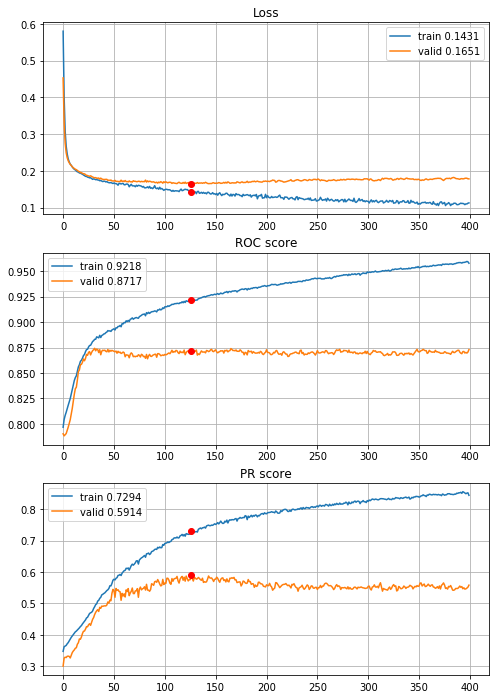


Fold 2------------------------------------------------------------


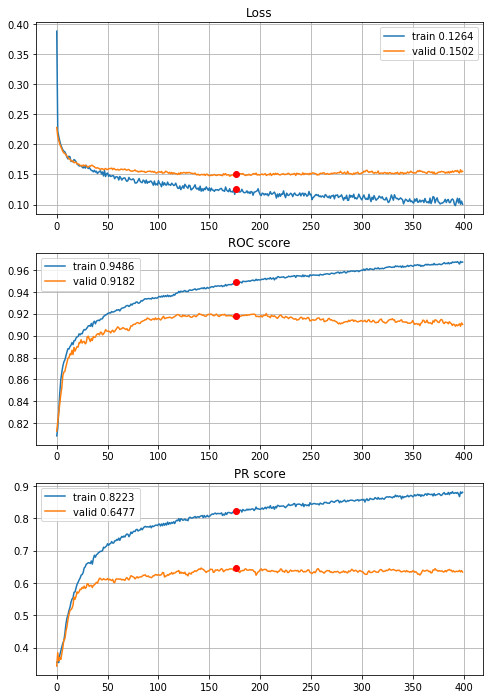


Fold 3------------------------------------------------------------


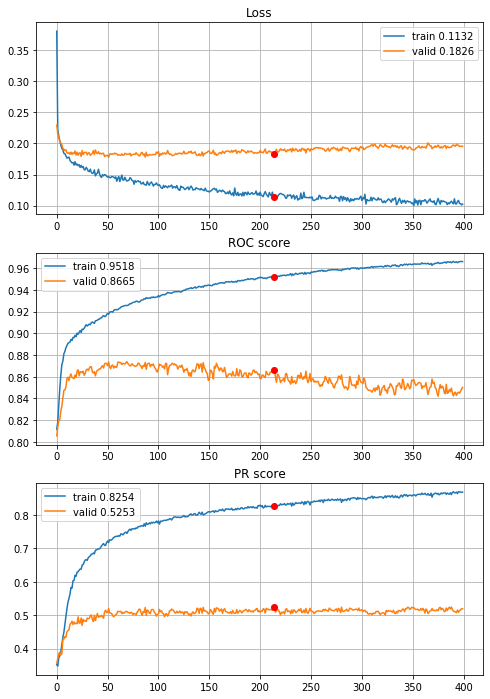


Fold 4------------------------------------------------------------


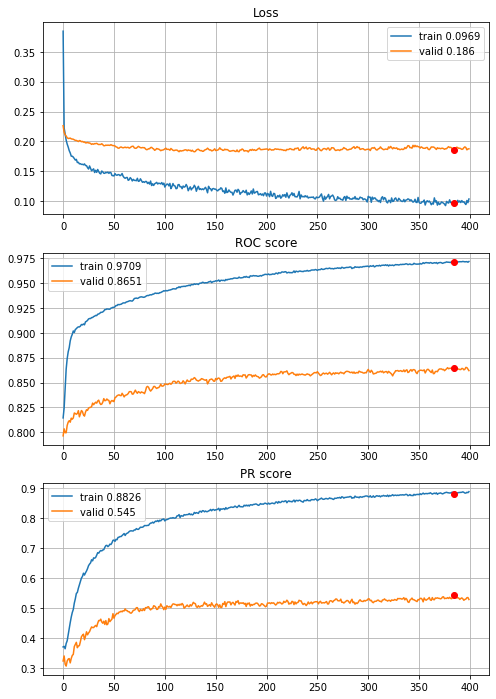


Fold 5------------------------------------------------------------


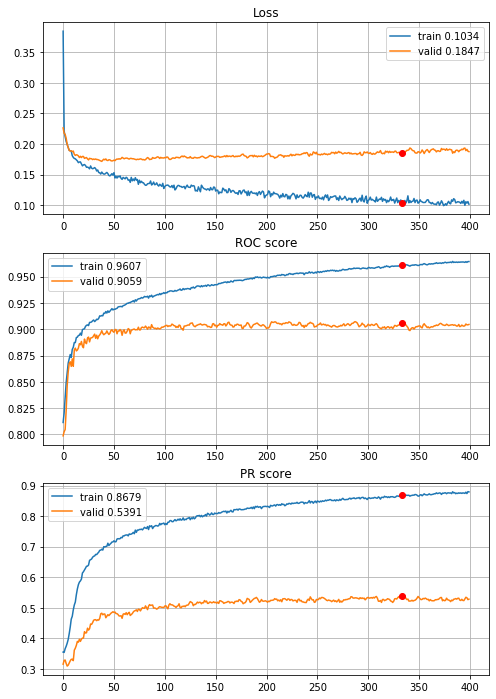


Fold 6------------------------------------------------------------


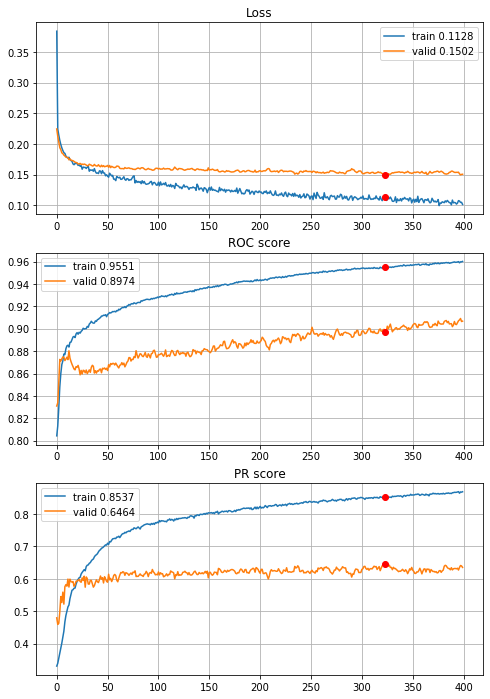

In [224]:
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=3, n_units=[60,60,30],
                                        acti=[activations.tanh, activations.sigmoid, activations.sigmoid],
                                        drop=[0.4,0.4,0], regu=[None,None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Results gets worse, lets apply some dropout on the last layer


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/400,
cumulative time: 12.91s train loss: 0.3269782474916765, validation loss: 0.25347972144672004
Epoch: 2/400,
cumulative time: 13.01s train loss: 0.26476591995611304, validation loss: 0.23660678660923357
Epoch: 3/400,
cumulative time: 13.12s train loss: 0.2527822207538445, validation loss: 0.2311053845733236
Epoch: 4/400,
cumulative time: 13.22s train loss: 0.24057233886329277, validation loss: 0.22540871572198837
Epoch: 5/400,
cumulative time: 13.3s train loss: 0.2363789547033043, validation loss: 0.2210038677613926
Epoch: 6/400,
cumulative time: 13.4s train loss: 0.23514243209943014, validation loss: 0.21757541575050138
Epoch: 7/400,
cumulative time: 13.49s train loss: 0.22240461582580198, validation loss: 0.21503068933425115
Epoch: 8/400,
cumulative time: 13.6s train loss: 0.22065194346521735, validation loss: 0.21250202613457483
Epoch: 9/400,
cumulative time: 13.69s train loss: 0.22160215323474

cumulative time: 20.25s train loss: 0.16279666710792895, validation loss: 0.17015072251454819
Epoch: 78/400,
cumulative time: 20.34s train loss: 0.15848366549702542, validation loss: 0.17025384676496771
Epoch: 79/400,
cumulative time: 20.44s train loss: 0.16060878965828823, validation loss: 0.16907965347355625
Epoch: 80/400,
cumulative time: 20.55s train loss: 0.16372564409452656, validation loss: 0.16998624971310747
Epoch: 81/400,
cumulative time: 20.65s train loss: 0.1599264848298168, validation loss: 0.1700064991144075
Epoch: 82/400,
cumulative time: 20.75s train loss: 0.16086168495084188, validation loss: 0.17429655617294074
Epoch: 83/400,
cumulative time: 20.85s train loss: 0.15808131127527475, validation loss: 0.1688269146433543
Epoch: 84/400,
cumulative time: 20.95s train loss: 0.16106595561943868, validation loss: 0.17047692566538877
Epoch: 85/400,
cumulative time: 21.05s train loss: 0.15605424013365368, validation loss: 0.17058949516886654
Epoch: 86/400,
cumulative time: 21.15

Epoch: 154/400,
cumulative time: 27.85s train loss: 0.14277377789537507, validation loss: 0.16587445124765393
Epoch: 155/400,
cumulative time: 27.95s train loss: 0.14189973939546394, validation loss: 0.16456564315074998
Epoch: 156/400,
cumulative time: 28.05s train loss: 0.1437660502437973, validation loss: 0.16399490525851523
Epoch: 157/400,
cumulative time: 28.16s train loss: 0.1415927182741813, validation loss: 0.16515321387849505
Epoch: 158/400,
cumulative time: 28.26s train loss: 0.14161717193369294, validation loss: 0.1637970636837109
Epoch: 159/400,
cumulative time: 28.36s train loss: 0.14198056485382873, validation loss: 0.1667798580822305
Epoch: 160/400,
cumulative time: 28.46s train loss: 0.14859475546082757, validation loss: 0.16566902378903703
Epoch: 161/400,
cumulative time: 28.57s train loss: 0.1436574389579763, validation loss: 0.16609941157507116
Epoch: 162/400,
cumulative time: 28.67s train loss: 0.14201798205623664, validation loss: 0.16642558363002746
Epoch: 163/400,

cumulative time: 42.52s train loss: 0.12692726922258465, validation loss: 0.17185326671519705
Epoch: 304/400,
cumulative time: 42.61s train loss: 0.12618954457840226, validation loss: 0.17326463952139776
Epoch: 305/400,
cumulative time: 42.7s train loss: 0.12578078177471777, validation loss: 0.172613440936152
Epoch: 306/400,
cumulative time: 42.8s train loss: 0.12767378841308266, validation loss: 0.17475265288030417
Epoch: 307/400,
cumulative time: 42.89s train loss: 0.12050913666317824, validation loss: 0.1728394634122913
Epoch: 308/400,
cumulative time: 43.0s train loss: 0.12641024390161576, validation loss: 0.17231064250329436
Epoch: 309/400,
cumulative time: 43.1s train loss: 0.1271178884875527, validation loss: 0.17116134340760403
Epoch: 310/400,
cumulative time: 43.19s train loss: 0.12311567510024304, validation loss: 0.1746199759313461
Epoch: 311/400,
cumulative time: 43.3s train loss: 0.11960298789913903, validation loss: 0.1744721195205895
Epoch: 312/400,
cumulative time: 43.4

cumulative time: 50.34s train loss: 0.1196053273108408, validation loss: 0.17536723017356576
Epoch: 381/400,
cumulative time: 50.44s train loss: 0.11671455802281626, validation loss: 0.17787848239955664
Epoch: 382/400,
cumulative time: 50.54s train loss: 0.11594887978871377, validation loss: 0.18262855685079782
Epoch: 383/400,
cumulative time: 50.64s train loss: 0.12117552205866425, validation loss: 0.17659279991365473
Epoch: 384/400,
cumulative time: 50.74s train loss: 0.11547211806427701, validation loss: 0.17942710335050388
Epoch: 385/400,
cumulative time: 50.85s train loss: 0.11750744574699915, validation loss: 0.18019728619592704
Epoch: 386/400,
cumulative time: 50.96s train loss: 0.11937421039150295, validation loss: 0.17968221643798918
Epoch: 387/400,
cumulative time: 51.06s train loss: 0.12012336231324323, validation loss: 0.17820214845550908
Epoch: 388/400,
cumulative time: 51.17s train loss: 0.11829527904572039, validation loss: 0.17802425488208032
Epoch: 389/400,
cumulative 

Epoch: 55/400,
cumulative time: 18.82s train loss: 0.15157159073244686, validation loss: 0.151907579261461
Epoch: 56/400,
cumulative time: 18.91s train loss: 0.1506865367911998, validation loss: 0.1505301296878963
Epoch: 57/400,
cumulative time: 19.01s train loss: 0.15251110231214698, validation loss: 0.15207014408428746
Epoch: 58/400,
cumulative time: 19.12s train loss: 0.14754365835110203, validation loss: 0.15278723774626934
Epoch: 59/400,
cumulative time: 19.22s train loss: 0.15457123820585894, validation loss: 0.15062818480519055
Epoch: 60/400,
cumulative time: 19.32s train loss: 0.15206972254769682, validation loss: 0.15010433513860155
Epoch: 61/400,
cumulative time: 19.42s train loss: 0.14880100396606358, validation loss: 0.1511990208737342
Epoch: 62/400,
cumulative time: 19.52s train loss: 0.1515406931511762, validation loss: 0.14986623790883696
Epoch: 63/400,
cumulative time: 19.63s train loss: 0.15059033474995878, validation loss: 0.15094954072757127
Epoch: 64/400,
cumulative

cumulative time: 26.26s train loss: 0.12956040266175026, validation loss: 0.14892024924850517
Epoch: 132/400,
cumulative time: 26.37s train loss: 0.13129937877401118, validation loss: 0.14968089395640533
Epoch: 133/400,
cumulative time: 26.47s train loss: 0.13374371513630187, validation loss: 0.14903860547597675
Epoch: 134/400,
cumulative time: 26.56s train loss: 0.13586165763047736, validation loss: 0.15028495769086792
Epoch: 135/400,
cumulative time: 26.65s train loss: 0.13285729737569063, validation loss: 0.14993178741134947
Epoch: 136/400,
cumulative time: 26.75s train loss: 0.13889872478758278, validation loss: 0.14910672332045727
Epoch: 137/400,
cumulative time: 26.84s train loss: 0.13346462532716538, validation loss: 0.14774293252587184
Epoch: 138/400,
cumulative time: 26.94s train loss: 0.13896931017940656, validation loss: 0.14733096138230842
Epoch: 139/400,
cumulative time: 27.03s train loss: 0.1341949004498361, validation loss: 0.1474278824405982
Epoch: 140/400,
cumulative t

Epoch: 208/400,
cumulative time: 33.84s train loss: 0.12574987461124731, validation loss: 0.14872407263067153
Epoch: 209/400,
cumulative time: 33.94s train loss: 0.12940774672405814, validation loss: 0.1486582759654374
Epoch: 210/400,
cumulative time: 34.05s train loss: 0.12179261889470075, validation loss: 0.1497493715286927
Epoch: 211/400,
cumulative time: 34.15s train loss: 0.12612759073127047, validation loss: 0.1501525901551983
Epoch: 212/400,
cumulative time: 34.24s train loss: 0.12815804597635885, validation loss: 0.14980259427660078
Epoch: 213/400,
cumulative time: 34.34s train loss: 0.13029903588002878, validation loss: 0.15103933859402324
Epoch: 214/400,
cumulative time: 34.45s train loss: 0.1248619142307863, validation loss: 0.1522506646719565
Epoch: 215/400,
cumulative time: 34.56s train loss: 0.12301563595956198, validation loss: 0.14952283778480907
Epoch: 216/400,
cumulative time: 34.67s train loss: 0.12451387504418296, validation loss: 0.1491511040771424
Epoch: 217/400,


cumulative time: 41.35s train loss: 0.1174100607983257, validation loss: 0.153709636247279
Epoch: 284/400,
cumulative time: 41.44s train loss: 0.11436614655428953, validation loss: 0.1546645361547943
Epoch: 285/400,
cumulative time: 41.55s train loss: 0.12159875553397173, validation loss: 0.1540552249940568
Epoch: 286/400,
cumulative time: 41.66s train loss: 0.12005992902489883, validation loss: 0.15558671763139487
Epoch: 287/400,
cumulative time: 41.76s train loss: 0.11837548168799722, validation loss: 0.15684285899361736
Epoch: 288/400,
cumulative time: 41.86s train loss: 0.11589582677634722, validation loss: 0.15440248272968657
Epoch: 289/400,
cumulative time: 41.96s train loss: 0.12221258613096032, validation loss: 0.15387987852802137
Epoch: 290/400,
cumulative time: 42.07s train loss: 0.11469943102933332, validation loss: 0.15366607953992745
Epoch: 291/400,
cumulative time: 42.17s train loss: 0.12161126347857154, validation loss: 0.15463401512437097
Epoch: 292/400,
cumulative time

Epoch: 359/400,
cumulative time: 49.1s train loss: 0.11308509776778923, validation loss: 0.15126008711746877
Epoch: 360/400,
cumulative time: 49.2s train loss: 0.11553670630524682, validation loss: 0.1506078664755203
Epoch: 361/400,
cumulative time: 49.3s train loss: 0.11591703945683443, validation loss: 0.15104913730867284
Epoch: 362/400,
cumulative time: 49.41s train loss: 0.11019658406907255, validation loss: 0.15353888718426026
Epoch: 363/400,
cumulative time: 49.51s train loss: 0.11490294077040271, validation loss: 0.15263717224256565
Epoch: 364/400,
cumulative time: 49.62s train loss: 0.1117010418735848, validation loss: 0.1523254734822029
Epoch: 365/400,
cumulative time: 49.72s train loss: 0.11809014869578156, validation loss: 0.15116543500876345
Epoch: 366/400,
cumulative time: 49.82s train loss: 0.10800941347981725, validation loss: 0.1506730108411632
Epoch: 367/400,
cumulative time: 49.92s train loss: 0.11425668190465399, validation loss: 0.1509600070965599
Epoch: 368/400,
cu

Epoch: 33/400,
cumulative time: 17.24s train loss: 0.16299266279389282, validation loss: 0.18092080487910628
Epoch: 34/400,
cumulative time: 17.35s train loss: 0.1597387729219366, validation loss: 0.1788813370409114
Epoch: 35/400,
cumulative time: 17.46s train loss: 0.15623695581532773, validation loss: 0.1773995046399895
Epoch: 36/400,
cumulative time: 17.56s train loss: 0.15983135641858465, validation loss: 0.1796978557442463
Epoch: 37/400,
cumulative time: 17.65s train loss: 0.15374884858982982, validation loss: 0.17910808955635266
Epoch: 38/400,
cumulative time: 17.75s train loss: 0.15849282304396592, validation loss: 0.1802691817535623
Epoch: 39/400,
cumulative time: 17.86s train loss: 0.1579640392577175, validation loss: 0.1815753845075878
Epoch: 40/400,
cumulative time: 17.96s train loss: 0.15718776158087414, validation loss: 0.17938441004532704
Epoch: 41/400,
cumulative time: 18.06s train loss: 0.1505681893078859, validation loss: 0.18109165307600575
Epoch: 42/400,
cumulative t

cumulative time: 25.03s train loss: 0.13489226783736732, validation loss: 0.18483213724184197
Epoch: 110/400,
cumulative time: 25.12s train loss: 0.13162059469706638, validation loss: 0.18346202839690912
Epoch: 111/400,
cumulative time: 25.22s train loss: 0.13594715450201117, validation loss: 0.18337818323356322
Epoch: 112/400,
cumulative time: 25.32s train loss: 0.1358849961404766, validation loss: 0.18069880318816378
Epoch: 113/400,
cumulative time: 25.41s train loss: 0.13113053924730217, validation loss: 0.18262652619379618
Epoch: 114/400,
cumulative time: 25.51s train loss: 0.1293025296215062, validation loss: 0.18246473906206842
Epoch: 115/400,
cumulative time: 25.62s train loss: 0.13381427184876982, validation loss: 0.18032961896502045
Epoch: 116/400,
cumulative time: 25.72s train loss: 0.13810773990335554, validation loss: 0.18243372147186768
Epoch: 117/400,
cumulative time: 25.82s train loss: 0.12935698935963777, validation loss: 0.18379577606278047
Epoch: 118/400,
cumulative t

Epoch: 186/400,
cumulative time: 32.99s train loss: 0.12752994849592017, validation loss: 0.18477223447304567
Epoch: 187/400,
cumulative time: 33.09s train loss: 0.12147416373788772, validation loss: 0.18361100677942613
Epoch: 188/400,
cumulative time: 33.19s train loss: 0.12941032282618087, validation loss: 0.18400518601212185
Epoch: 189/400,
cumulative time: 33.29s train loss: 0.12204904142861332, validation loss: 0.1847972321537194
Epoch: 190/400,
cumulative time: 33.4s train loss: 0.1274300909564168, validation loss: 0.18417523130186517
Epoch: 191/400,
cumulative time: 33.5s train loss: 0.12679251503965916, validation loss: 0.18328106140438571
Epoch: 192/400,
cumulative time: 33.6s train loss: 0.12982658663636834, validation loss: 0.18639325194287595
Epoch: 193/400,
cumulative time: 33.71s train loss: 0.12090615890516701, validation loss: 0.18528724845662595
Epoch: 194/400,
cumulative time: 33.81s train loss: 0.12521192159113687, validation loss: 0.18473647914516078
Epoch: 195/400,

Epoch: 261/400,
cumulative time: 40.66s train loss: 0.11113454453943009, validation loss: 0.19136508704575772
Epoch: 262/400,
cumulative time: 40.76s train loss: 0.12032132077666288, validation loss: 0.19221486853437736
Epoch: 263/400,
cumulative time: 40.86s train loss: 0.1181971465072692, validation loss: 0.1914144770201325
Epoch: 264/400,
cumulative time: 40.96s train loss: 0.11570857517717117, validation loss: 0.19186782127134963
Epoch: 265/400,
cumulative time: 41.06s train loss: 0.11839664075859832, validation loss: 0.18983014245447205
Epoch: 266/400,
cumulative time: 41.15s train loss: 0.12025092487704238, validation loss: 0.19202991842114805
Epoch: 267/400,
cumulative time: 41.24s train loss: 0.1196709543446395, validation loss: 0.19064417931649166
Epoch: 268/400,
cumulative time: 41.35s train loss: 0.11903930996756476, validation loss: 0.19007876125639966
Epoch: 269/400,
cumulative time: 41.45s train loss: 0.11504782933493007, validation loss: 0.18941316974539366
Epoch: 270/40

Epoch: 336/400,
cumulative time: 48.26s train loss: 0.11783190181525928, validation loss: 0.19185079755146045
Epoch: 337/400,
cumulative time: 48.36s train loss: 0.11308416542647548, validation loss: 0.19219902663448618
Epoch: 338/400,
cumulative time: 48.46s train loss: 0.11513382612159374, validation loss: 0.19569892163273983
Epoch: 339/400,
cumulative time: 48.56s train loss: 0.11883740736312814, validation loss: 0.1941192395052754
Epoch: 340/400,
cumulative time: 48.67s train loss: 0.11729045792244079, validation loss: 0.19358233758064644
Epoch: 341/400,
cumulative time: 48.77s train loss: 0.11457752212142364, validation loss: 0.19256904931253888
Epoch: 342/400,
cumulative time: 48.87s train loss: 0.11107684588160648, validation loss: 0.1932061084261607
Epoch: 343/400,
cumulative time: 48.97s train loss: 0.11106307950502914, validation loss: 0.19140791108468475
Epoch: 344/400,
cumulative time: 49.08s train loss: 0.10888371777650144, validation loss: 0.19170791516342992
Epoch: 345/4

cumulative time: 15.26s train loss: 0.18280689672102865, validation loss: 0.2044420750899993
Epoch: 10/400,
cumulative time: 15.36s train loss: 0.17798047368060702, validation loss: 0.2033475282566273
Epoch: 11/400,
cumulative time: 15.45s train loss: 0.17431991056075033, validation loss: 0.20638249195590783
Epoch: 12/400,
cumulative time: 15.55s train loss: 0.1750016823871502, validation loss: 0.20443606494377214
Epoch: 13/400,
cumulative time: 15.65s train loss: 0.17505960788484515, validation loss: 0.2020553456068577
Epoch: 14/400,
cumulative time: 15.74s train loss: 0.17303109325144164, validation loss: 0.20271198401063614
Epoch: 15/400,
cumulative time: 15.85s train loss: 0.17080571214205628, validation loss: 0.2022471634111878
Epoch: 16/400,
cumulative time: 15.96s train loss: 0.16787048941530655, validation loss: 0.20058200661404138
Epoch: 17/400,
cumulative time: 16.05s train loss: 0.16813027818060985, validation loss: 0.20267714317845975
Epoch: 18/400,
cumulative time: 16.15s 

Epoch: 85/400,
cumulative time: 22.9s train loss: 0.14037315169474945, validation loss: 0.18927690908144612
Epoch: 86/400,
cumulative time: 23.0s train loss: 0.1354104996235113, validation loss: 0.1878964027082947
Epoch: 87/400,
cumulative time: 23.09s train loss: 0.13966641040296607, validation loss: 0.1882785045064599
Epoch: 88/400,
cumulative time: 23.19s train loss: 0.13507943554868984, validation loss: 0.19065693387463184
Epoch: 89/400,
cumulative time: 23.28s train loss: 0.131458438665663, validation loss: 0.1871205591186713
Epoch: 90/400,
cumulative time: 23.38s train loss: 0.13550603181668283, validation loss: 0.18699072617574955
Epoch: 91/400,
cumulative time: 23.48s train loss: 0.13540066036458964, validation loss: 0.18805453672366002
Epoch: 92/400,
cumulative time: 23.58s train loss: 0.1346887754931451, validation loss: 0.18960747502861927
Epoch: 93/400,
cumulative time: 23.67s train loss: 0.13585756114729636, validation loss: 0.1899779010101581
Epoch: 94/400,
cumulative tim

cumulative time: 30.37s train loss: 0.12823125659854745, validation loss: 0.1879115832578517
Epoch: 162/400,
cumulative time: 30.46s train loss: 0.12005240710680355, validation loss: 0.1897773589291368
Epoch: 163/400,
cumulative time: 30.55s train loss: 0.11983785766603149, validation loss: 0.19148644767953904
Epoch: 164/400,
cumulative time: 30.65s train loss: 0.12315771912119336, validation loss: 0.1889862727970894
Epoch: 165/400,
cumulative time: 30.73s train loss: 0.1276559276321847, validation loss: 0.1895832917222051
Epoch: 166/400,
cumulative time: 30.83s train loss: 0.12418886661166507, validation loss: 0.190542571498901
Epoch: 167/400,
cumulative time: 30.93s train loss: 0.12945035726887472, validation loss: 0.19277238802097182
Epoch: 168/400,
cumulative time: 31.03s train loss: 0.11950068970431653, validation loss: 0.19048149678561813
Epoch: 169/400,
cumulative time: 31.14s train loss: 0.1288685054057558, validation loss: 0.1886310472445348
Epoch: 170/400,
cumulative time: 31

cumulative time: 37.67s train loss: 0.11570709733514734, validation loss: 0.19416402761338797
Epoch: 237/400,
cumulative time: 37.77s train loss: 0.11209832719438317, validation loss: 0.19592774869626048
Epoch: 238/400,
cumulative time: 37.88s train loss: 0.11064505950876964, validation loss: 0.19430220066559234
Epoch: 239/400,
cumulative time: 37.98s train loss: 0.11114771157072867, validation loss: 0.19584238448476685
Epoch: 240/400,
cumulative time: 38.08s train loss: 0.11832990838030297, validation loss: 0.1993052985678946
Epoch: 241/400,
cumulative time: 38.18s train loss: 0.11747053442214053, validation loss: 0.19760656020442197
Epoch: 242/400,
cumulative time: 38.28s train loss: 0.11371972775744338, validation loss: 0.1964462440519785
Epoch: 243/400,
cumulative time: 38.38s train loss: 0.11806841959015876, validation loss: 0.19717038155409336
Epoch: 244/400,
cumulative time: 38.47s train loss: 0.11139236031927482, validation loss: 0.1941139480733979
Epoch: 245/400,
cumulative ti

cumulative time: 45.08s train loss: 0.10840893550924058, validation loss: 0.19613521285439184
Epoch: 312/400,
cumulative time: 45.19s train loss: 0.11094590096475845, validation loss: 0.19779463290630023
Epoch: 313/400,
cumulative time: 45.29s train loss: 0.10589896484338858, validation loss: 0.20241478539616475
Epoch: 314/400,
cumulative time: 45.39s train loss: 0.10896824543655739, validation loss: 0.1995680688062586
Epoch: 315/400,
cumulative time: 45.47s train loss: 0.10833224032503634, validation loss: 0.2004100990483777
Epoch: 316/400,
cumulative time: 45.58s train loss: 0.1062234767888917, validation loss: 0.19992930611961313
Epoch: 317/400,
cumulative time: 45.68s train loss: 0.10810344842212775, validation loss: 0.20441869940633967
Epoch: 318/400,
cumulative time: 45.78s train loss: 0.1118491571199106, validation loss: 0.1996117925469009
Epoch: 319/400,
cumulative time: 45.87s train loss: 0.10959499651016136, validation loss: 0.19814857268710168
Epoch: 320/400,
cumulative time

Epoch: 388/400,
cumulative time: 52.8s train loss: 0.10770545602886827, validation loss: 0.19710074607324923
Epoch: 389/400,
cumulative time: 52.9s train loss: 0.10900906433229277, validation loss: 0.19846963959811234
Epoch: 390/400,
cumulative time: 53.0s train loss: 0.10906004534264115, validation loss: 0.19848450083226707
Epoch: 391/400,
cumulative time: 53.11s train loss: 0.1039983286475479, validation loss: 0.19719552802043896
Epoch: 392/400,
cumulative time: 53.21s train loss: 0.1078260919037587, validation loss: 0.2032928914840819
Epoch: 393/400,
cumulative time: 53.31s train loss: 0.10633810724371474, validation loss: 0.19848467211152845
Epoch: 394/400,
cumulative time: 53.41s train loss: 0.10579898202329195, validation loss: 0.1995593734236926
Epoch: 395/400,
cumulative time: 53.51s train loss: 0.10369898694149936, validation loss: 0.2021165754873112
Epoch: 396/400,
cumulative time: 53.62s train loss: 0.10459099810157864, validation loss: 0.2026378255059972
Epoch: 397/400,
cum

cumulative time: 30.41s train loss: 0.13515657611055135, validation loss: 0.165438063728621
Epoch: 138/400,
cumulative time: 30.52s train loss: 0.13418262919124083, validation loss: 0.16725356486661708
Epoch: 139/400,
cumulative time: 30.61s train loss: 0.13144446021845504, validation loss: 0.16605432795751715
Epoch: 140/400,
cumulative time: 30.71s train loss: 0.13143037446473485, validation loss: 0.16544214435947668
Epoch: 141/400,
cumulative time: 30.81s train loss: 0.1379257983671148, validation loss: 0.16315244965709358
Epoch: 142/400,
cumulative time: 30.91s train loss: 0.1348501406870522, validation loss: 0.16659303598156364
Epoch: 143/400,
cumulative time: 31.0s train loss: 0.13442750598335276, validation loss: 0.1613572172601928
Epoch: 144/400,
cumulative time: 31.1s train loss: 0.1335402424313832, validation loss: 0.16394384531619585
Epoch: 145/400,
cumulative time: 31.21s train loss: 0.130666613067861, validation loss: 0.16361134595176705
Epoch: 146/400,
cumulative time: 31.

cumulative time: 37.92s train loss: 0.1224274444285618, validation loss: 0.1659348899704608
Epoch: 213/400,
cumulative time: 38.02s train loss: 0.12268863137103003, validation loss: 0.16668637527434604
Epoch: 214/400,
cumulative time: 38.11s train loss: 0.12531610218458888, validation loss: 0.16876617370017763
Epoch: 215/400,
cumulative time: 38.21s train loss: 0.12416214481779342, validation loss: 0.16461749664144107
Epoch: 216/400,
cumulative time: 38.31s train loss: 0.12468075942514498, validation loss: 0.1657666735872458
Epoch: 217/400,
cumulative time: 38.41s train loss: 0.1289311023435339, validation loss: 0.1641752842653955
Epoch: 218/400,
cumulative time: 38.5s train loss: 0.12423184694217662, validation loss: 0.16213678048910998
Epoch: 219/400,
cumulative time: 38.61s train loss: 0.13221786874910524, validation loss: 0.1653538410873499
Epoch: 220/400,
cumulative time: 38.71s train loss: 0.12296043215716582, validation loss: 0.16414569725301412
Epoch: 221/400,
cumulative time: 

cumulative time: 45.35s train loss: 0.12061308958972519, validation loss: 0.1646555353368109
Epoch: 288/400,
cumulative time: 45.44s train loss: 0.11853668520917425, validation loss: 0.1654302434781335
Epoch: 289/400,
cumulative time: 45.53s train loss: 0.12286616119703402, validation loss: 0.17042272479082068
Epoch: 290/400,
cumulative time: 45.62s train loss: 0.12544632010277845, validation loss: 0.16217398027937785
Epoch: 291/400,
cumulative time: 45.72s train loss: 0.11847000958021085, validation loss: 0.16190711602265895
Epoch: 292/400,
cumulative time: 45.8s train loss: 0.11827084275889875, validation loss: 0.1721213635889725
Epoch: 293/400,
cumulative time: 45.9s train loss: 0.12676441091972684, validation loss: 0.16374506981324397
Epoch: 294/400,
cumulative time: 46.0s train loss: 0.11518155057180715, validation loss: 0.16506738822831526
Epoch: 295/400,
cumulative time: 46.1s train loss: 0.1181588921096775, validation loss: 0.1671443794839269
Epoch: 296/400,
cumulative time: 46

cumulative time: 52.86s train loss: 0.11283731202540523, validation loss: 0.16858941017235912
Epoch: 363/400,
cumulative time: 52.96s train loss: 0.11147754318539886, validation loss: 0.17310734200827424
Epoch: 364/400,
cumulative time: 53.04s train loss: 0.1103459241626267, validation loss: 0.17092854746577432
Epoch: 365/400,
cumulative time: 53.15s train loss: 0.12026473221312574, validation loss: 0.1766273332234161
Epoch: 366/400,
cumulative time: 53.25s train loss: 0.11344442503960009, validation loss: 0.17324120825488734
Epoch: 367/400,
cumulative time: 53.35s train loss: 0.11114547607553428, validation loss: 0.174386259765442
Epoch: 368/400,
cumulative time: 53.45s train loss: 0.11301359251400377, validation loss: 0.1715225406478813
Epoch: 369/400,
cumulative time: 53.54s train loss: 0.11625773046050576, validation loss: 0.17060703886820017
Epoch: 370/400,
cumulative time: 53.64s train loss: 0.11603847730500608, validation loss: 0.173820146521381
Epoch: 371/400,
cumulative time: 

cumulative time: 19.12s train loss: 0.16248420554999168, validation loss: 0.1607983308774892
Epoch: 36/400,
cumulative time: 19.21s train loss: 0.16016476900696405, validation loss: 0.1599841342217228
Epoch: 37/400,
cumulative time: 19.31s train loss: 0.15807529438195422, validation loss: 0.15992348844660592
Epoch: 38/400,
cumulative time: 19.41s train loss: 0.16225878797520263, validation loss: 0.1608982037071719
Epoch: 39/400,
cumulative time: 19.51s train loss: 0.16083831415370278, validation loss: 0.16147249358502253
Epoch: 40/400,
cumulative time: 19.61s train loss: 0.15591107098439894, validation loss: 0.16010067186425556
Epoch: 41/400,
cumulative time: 19.71s train loss: 0.1613080011293739, validation loss: 0.160149524362577
Epoch: 42/400,
cumulative time: 19.81s train loss: 0.157341921293195, validation loss: 0.15969709843464414
Epoch: 43/400,
cumulative time: 19.91s train loss: 0.15838883568114898, validation loss: 0.16130986971187808
Epoch: 44/400,
cumulative time: 20.0s trai

cumulative time: 26.63s train loss: 0.13535566005108723, validation loss: 0.15666194953041207
Epoch: 112/400,
cumulative time: 26.74s train loss: 0.13855691018839764, validation loss: 0.15663623655084563
Epoch: 113/400,
cumulative time: 26.84s train loss: 0.1344818641807058, validation loss: 0.15443815227017715
Epoch: 114/400,
cumulative time: 26.94s train loss: 0.13600348628605297, validation loss: 0.15499473869396924
Epoch: 115/400,
cumulative time: 27.03s train loss: 0.13608841223235918, validation loss: 0.15521044857615005
Epoch: 116/400,
cumulative time: 27.13s train loss: 0.13610094078448187, validation loss: 0.15358748382827767
Epoch: 117/400,
cumulative time: 27.23s train loss: 0.1369489944703203, validation loss: 0.1551832377439697
Epoch: 118/400,
cumulative time: 27.33s train loss: 0.13961507401521767, validation loss: 0.15443250483099547
Epoch: 119/400,
cumulative time: 27.44s train loss: 0.13143856533017945, validation loss: 0.15464911843664758
Epoch: 120/400,
cumulative ti

Epoch: 187/400,
cumulative time: 34.22s train loss: 0.1259101348309976, validation loss: 0.1535731211607397
Epoch: 188/400,
cumulative time: 34.32s train loss: 0.12731985268139984, validation loss: 0.15586481641969616
Epoch: 189/400,
cumulative time: 34.41s train loss: 0.12761071577967356, validation loss: 0.15530018447887817
Epoch: 190/400,
cumulative time: 34.51s train loss: 0.1243065507389637, validation loss: 0.15781893559287957
Epoch: 191/400,
cumulative time: 34.6s train loss: 0.12429746205082548, validation loss: 0.15698726303690444
Epoch: 192/400,
cumulative time: 34.71s train loss: 0.13001143386448422, validation loss: 0.1570491723497619
Epoch: 193/400,
cumulative time: 34.81s train loss: 0.12518977399553263, validation loss: 0.15719779367237005
Epoch: 194/400,
cumulative time: 34.9s train loss: 0.12378833347630237, validation loss: 0.15742449408594694
Epoch: 195/400,
cumulative time: 34.99s train loss: 0.12430556468747954, validation loss: 0.15700391328496266
Epoch: 196/400,


Epoch: 338/400,
cumulative time: 48.95s train loss: 0.11688455492728671, validation loss: 0.15577647591148489
Epoch: 339/400,
cumulative time: 49.07s train loss: 0.11718345327925096, validation loss: 0.15240654224870437
Epoch: 340/400,
cumulative time: 49.16s train loss: 0.11258866326762004, validation loss: 0.1540715609998789
Epoch: 341/400,
cumulative time: 49.26s train loss: 0.11043112562494947, validation loss: 0.1558351155126606
Epoch: 342/400,
cumulative time: 49.35s train loss: 0.12108936531230985, validation loss: 0.15565930727373128
Epoch: 343/400,
cumulative time: 49.45s train loss: 0.11826528519469326, validation loss: 0.156543767748245
Epoch: 344/400,
cumulative time: 49.55s train loss: 0.11716167776835522, validation loss: 0.15480041937822683
Epoch: 345/400,
cumulative time: 49.65s train loss: 0.11718704590282725, validation loss: 0.1545745840729225
Epoch: 346/400,
cumulative time: 49.74s train loss: 0.11684178768203567, validation loss: 0.1549260168594916
Epoch: 347/400,


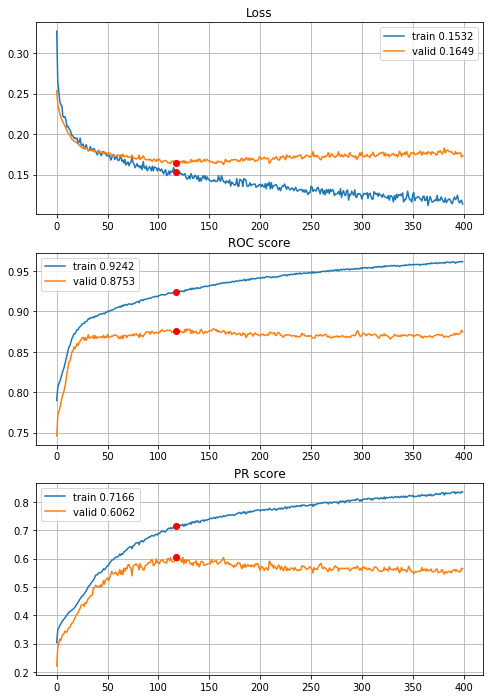


Fold 2------------------------------------------------------------


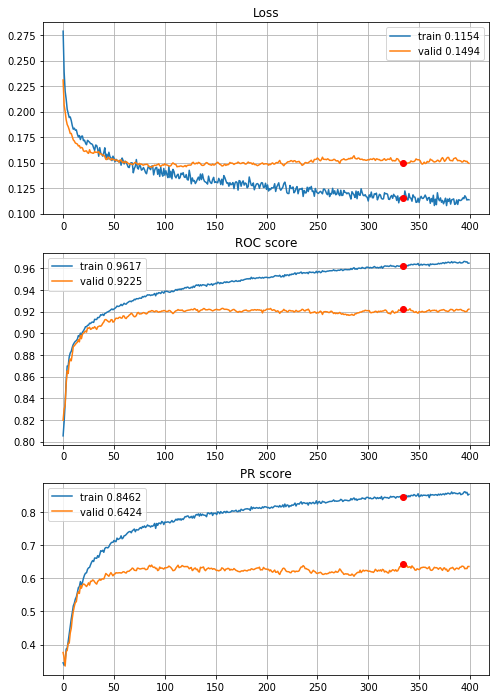


Fold 3------------------------------------------------------------


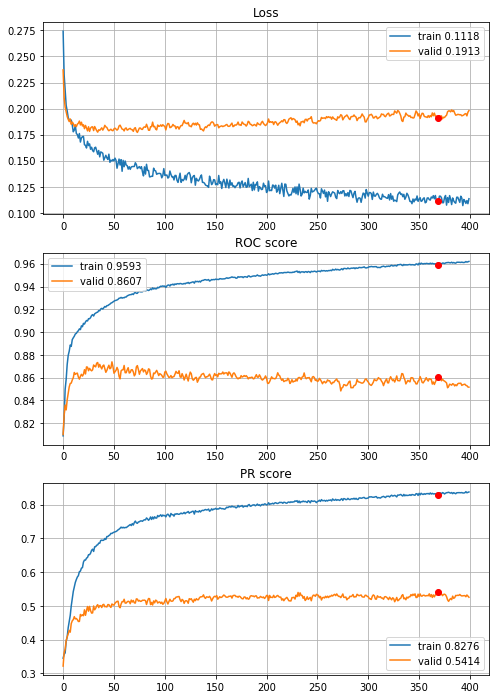


Fold 4------------------------------------------------------------


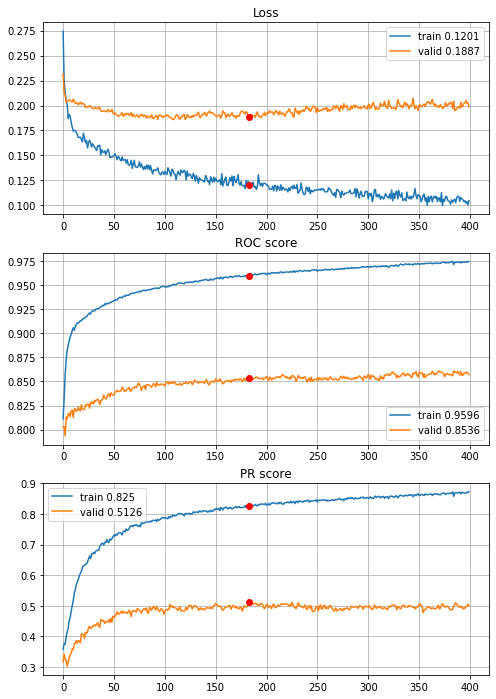


Fold 5------------------------------------------------------------


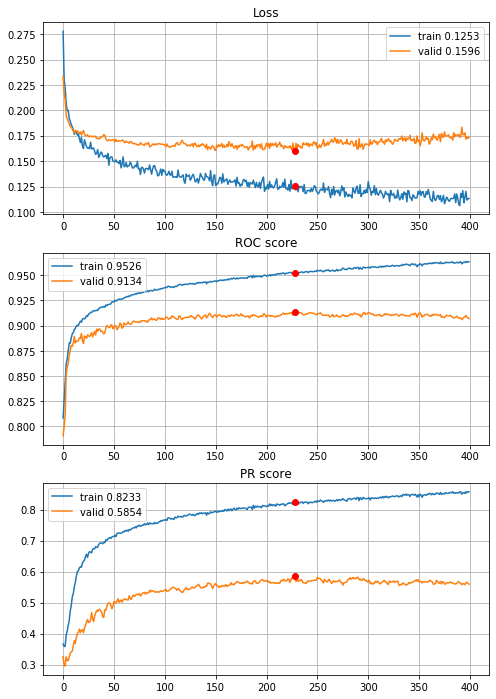


Fold 6------------------------------------------------------------


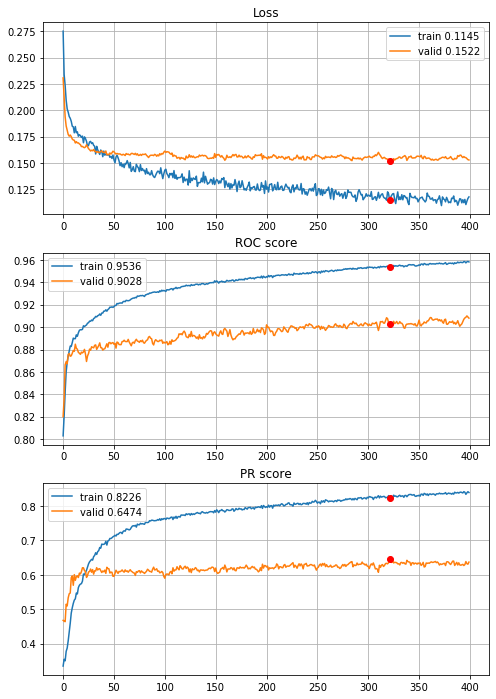

In [225]:
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=3, n_units=[60,60,30],
                                        acti=[activations.tanh, activations.sigmoid, activations.sigmoid],
                                        drop=[0.4,0.4,0.4], regu=[None,None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

2 layers is enough, lets try some regularization, L1 = 0.001 on second layer first.


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/400,
cumulative time: 11.7s train loss: 0.9149744422158179, validation loss: 0.7869748390513853
Epoch: 2/400,
cumulative time: 11.8s train loss: 0.7696508044908194, validation loss: 0.6770844466925474
Epoch: 3/400,
cumulative time: 11.9s train loss: 0.6691606686272346, validation loss: 0.5993563119561455
Epoch: 4/400,
cumulative time: 12.01s train loss: 0.6005299238736879, validation loss: 0.5423551459860775
Epoch: 5/400,
cumulative time: 12.09s train loss: 0.5399293982918082, validation loss: 0.49800679762978967
Epoch: 6/400,
cumulative time: 12.17s train loss: 0.5007361516168186, validation loss: 0.4614251752918441
Epoch: 7/400,
cumulative time: 12.27s train loss: 0.46397092092499836, validation loss: 0.4301079605383696
Epoch: 8/400,
cumulative time: 12.35s train loss: 0.426982045940221, validation loss: 0.4025479600152679
Epoch: 9/400,
cumulative time: 12.44s train loss: 0.40289939372440536, valid

Epoch: 77/400,
cumulative time: 18.29s train loss: 0.22174715190883793, validation loss: 0.21760954182876407
Epoch: 78/400,
cumulative time: 18.35s train loss: 0.2214625065789864, validation loss: 0.21745762217206105
Epoch: 79/400,
cumulative time: 18.45s train loss: 0.2199264559222365, validation loss: 0.21738317676031335
Epoch: 80/400,
cumulative time: 18.55s train loss: 0.2199585802368954, validation loss: 0.2168721804120226
Epoch: 81/400,
cumulative time: 18.61s train loss: 0.21914219541562593, validation loss: 0.21708513749290884
Epoch: 82/400,
cumulative time: 18.7s train loss: 0.21604097015241208, validation loss: 0.21766545906612542
Epoch: 83/400,
cumulative time: 18.79s train loss: 0.21812610117052866, validation loss: 0.21729794403342814
Epoch: 84/400,
cumulative time: 18.87s train loss: 0.22044058719696982, validation loss: 0.21751696790286087
Epoch: 85/400,
cumulative time: 18.96s train loss: 0.21897934579596406, validation loss: 0.21720731255032433
Epoch: 86/400,
cumulativ

Epoch: 153/400,
cumulative time: 24.73s train loss: 0.21215938312751292, validation loss: 0.20979524846477465
Epoch: 154/400,
cumulative time: 24.81s train loss: 0.21130589658683602, validation loss: 0.20965863214942218
Epoch: 155/400,
cumulative time: 24.89s train loss: 0.20670507678136713, validation loss: 0.21003669444912584
Epoch: 156/400,
cumulative time: 24.98s train loss: 0.2083201255608982, validation loss: 0.20993872260697932
Epoch: 157/400,
cumulative time: 25.06s train loss: 0.20756037122425405, validation loss: 0.20927476353750155
Epoch: 158/400,
cumulative time: 25.14s train loss: 0.21061039087278532, validation loss: 0.20935683399270863
Epoch: 159/400,
cumulative time: 25.23s train loss: 0.21348429949355685, validation loss: 0.2096272485735989
Epoch: 160/400,
cumulative time: 25.29s train loss: 0.20912328808961791, validation loss: 0.2089105251979129
Epoch: 161/400,
cumulative time: 25.37s train loss: 0.20749390203277127, validation loss: 0.20955251511753345
Epoch: 162/40

cumulative time: 31.35s train loss: 0.20071720439496885, validation loss: 0.20860122404614592
Epoch: 229/400,
cumulative time: 31.44s train loss: 0.20014789180379589, validation loss: 0.20832980443485158
Epoch: 230/400,
cumulative time: 31.5s train loss: 0.20167834935071022, validation loss: 0.20798989502123003
Epoch: 231/400,
cumulative time: 31.6s train loss: 0.2037386401263923, validation loss: 0.20906202263264942
Epoch: 232/400,
cumulative time: 31.69s train loss: 0.20033879680996122, validation loss: 0.20863391736180026
Epoch: 233/400,
cumulative time: 31.78s train loss: 0.2025888531875632, validation loss: 0.2084529790124334
Epoch: 234/400,
cumulative time: 31.88s train loss: 0.20135754288345684, validation loss: 0.207361359136618
Epoch: 235/400,
cumulative time: 31.96s train loss: 0.20172066677913122, validation loss: 0.20769622762348364
Epoch: 236/400,
cumulative time: 32.04s train loss: 0.20059749689827328, validation loss: 0.20812087473296798
Epoch: 237/400,
cumulative time: 

Epoch: 305/400,
cumulative time: 38.19s train loss: 0.19865384963525978, validation loss: 0.2071129030210996
Epoch: 306/400,
cumulative time: 38.28s train loss: 0.1965470684604847, validation loss: 0.20617142087846088
Epoch: 307/400,
cumulative time: 38.38s train loss: 0.19597446620598813, validation loss: 0.2051823067288791
Epoch: 308/400,
cumulative time: 38.47s train loss: 0.19534497061872094, validation loss: 0.2052266106530268
Epoch: 309/400,
cumulative time: 38.54s train loss: 0.19537891154362408, validation loss: 0.20509148384901152
Epoch: 310/400,
cumulative time: 38.64s train loss: 0.1987718621853887, validation loss: 0.2058184856492207
Epoch: 311/400,
cumulative time: 38.73s train loss: 0.1970290001549015, validation loss: 0.20676853908425388
Epoch: 312/400,
cumulative time: 38.83s train loss: 0.2005420964049841, validation loss: 0.20644738253840195
Epoch: 313/400,
cumulative time: 38.91s train loss: 0.19375514164432506, validation loss: 0.20668433070720385
Epoch: 314/400,
cu

Epoch: 380/400,
cumulative time: 44.83s train loss: 0.19571166149330482, validation loss: 0.20535605697311973
Epoch: 381/400,
cumulative time: 44.93s train loss: 0.19304322116480407, validation loss: 0.20506791326951282
Epoch: 382/400,
cumulative time: 45.02s train loss: 0.1953437331633555, validation loss: 0.20555227055826478
Epoch: 383/400,
cumulative time: 45.12s train loss: 0.19297201634932726, validation loss: 0.2058039554379032
Epoch: 384/400,
cumulative time: 45.19s train loss: 0.1945035524182156, validation loss: 0.20537677728135262
Epoch: 385/400,
cumulative time: 45.28s train loss: 0.18795107407260028, validation loss: 0.20525247765770088
Epoch: 386/400,
cumulative time: 45.38s train loss: 0.19673178727580537, validation loss: 0.20570077702587863
Epoch: 387/400,
cumulative time: 45.48s train loss: 0.18948755976121995, validation loss: 0.20492432863696183
Epoch: 388/400,
cumulative time: 45.57s train loss: 0.1891683478258039, validation loss: 0.20521190219895816
Epoch: 389/400

cumulative time: 14.95s train loss: 0.21333218688676503, validation loss: 0.2017000444241817
Epoch: 55/400,
cumulative time: 15.04s train loss: 0.21423584482353517, validation loss: 0.20198510971924094
Epoch: 56/400,
cumulative time: 15.13s train loss: 0.21575533699526683, validation loss: 0.20117496557138953
Epoch: 57/400,
cumulative time: 15.23s train loss: 0.21592351540734836, validation loss: 0.20163164145849738
Epoch: 58/400,
cumulative time: 15.31s train loss: 0.21532893100827394, validation loss: 0.2013710014849666
Epoch: 59/400,
cumulative time: 15.41s train loss: 0.21715650669154493, validation loss: 0.2010416447141931
Epoch: 60/400,
cumulative time: 15.51s train loss: 0.2127858227529035, validation loss: 0.20010506446560447
Epoch: 61/400,
cumulative time: 15.6s train loss: 0.21402631620019136, validation loss: 0.19994154940396044
Epoch: 62/400,
cumulative time: 15.69s train loss: 0.21167393747569208, validation loss: 0.19972933148450756
Epoch: 63/400,
cumulative time: 15.78s 

Epoch: 130/400,
cumulative time: 23.66s train loss: 0.20140339507442304, validation loss: 0.19113411839207237
Epoch: 131/400,
cumulative time: 23.77s train loss: 0.20351571819008688, validation loss: 0.1905257224767829
Epoch: 132/400,
cumulative time: 23.86s train loss: 0.20072255317215884, validation loss: 0.19066625544559862
Epoch: 133/400,
cumulative time: 23.96s train loss: 0.20303567111599746, validation loss: 0.19044733497712094
Epoch: 134/400,
cumulative time: 24.05s train loss: 0.2042622493869131, validation loss: 0.19067350698565685
Epoch: 135/400,
cumulative time: 24.13s train loss: 0.2035119790946964, validation loss: 0.19081201863799585
Epoch: 136/400,
cumulative time: 24.21s train loss: 0.20386224063886632, validation loss: 0.19080531133471104
Epoch: 137/400,
cumulative time: 24.32s train loss: 0.19923416693234272, validation loss: 0.19061536510740623
Epoch: 138/400,
cumulative time: 24.42s train loss: 0.20176915492230374, validation loss: 0.19015805797888702
Epoch: 139/40

Epoch: 207/400,
cumulative time: 30.66s train loss: 0.196601278138505, validation loss: 0.18622241312850019
Epoch: 208/400,
cumulative time: 30.73s train loss: 0.19805353417965693, validation loss: 0.18602703256362454
Epoch: 209/400,
cumulative time: 30.82s train loss: 0.19848220636698313, validation loss: 0.18653677679438735
Epoch: 210/400,
cumulative time: 30.91s train loss: 0.19469362565245654, validation loss: 0.18582654657869221
Epoch: 211/400,
cumulative time: 31.0s train loss: 0.19573257663135923, validation loss: 0.18527826480357462
Epoch: 212/400,
cumulative time: 31.09s train loss: 0.19570176620776042, validation loss: 0.18559717901865821
Epoch: 213/400,
cumulative time: 31.18s train loss: 0.1990483671709196, validation loss: 0.18639287853187209
Epoch: 214/400,
cumulative time: 31.27s train loss: 0.19698210684616213, validation loss: 0.1865862545125783
Epoch: 215/400,
cumulative time: 31.37s train loss: 0.1935434849320874, validation loss: 0.18620659809101797
Epoch: 216/400,


Epoch: 283/400,
cumulative time: 37.49s train loss: 0.19211799790578413, validation loss: 0.1834135670907871
Epoch: 284/400,
cumulative time: 37.57s train loss: 0.1911959959268032, validation loss: 0.18344152111480308
Epoch: 285/400,
cumulative time: 37.65s train loss: 0.19795314739676803, validation loss: 0.18354754692537809
Epoch: 286/400,
cumulative time: 37.75s train loss: 0.19173796961776615, validation loss: 0.18306023324288537
Epoch: 287/400,
cumulative time: 37.85s train loss: 0.1883260880929791, validation loss: 0.18428867645435698
Epoch: 288/400,
cumulative time: 37.94s train loss: 0.1937726720737206, validation loss: 0.18344134193127964
Epoch: 289/400,
cumulative time: 38.04s train loss: 0.1938906976018464, validation loss: 0.18333798052224393
Epoch: 290/400,
cumulative time: 38.13s train loss: 0.18910351671305375, validation loss: 0.1835872334382983
Epoch: 291/400,
cumulative time: 38.23s train loss: 0.1963090309099923, validation loss: 0.18355707323604936
Epoch: 292/400,
c

cumulative time: 44.29s train loss: 0.18288329692174166, validation loss: 0.18181639472957126
Epoch: 359/400,
cumulative time: 44.38s train loss: 0.18691311420247442, validation loss: 0.18234949581652646
Epoch: 360/400,
cumulative time: 44.46s train loss: 0.18580064722857967, validation loss: 0.18178250922022435
Epoch: 361/400,
cumulative time: 44.55s train loss: 0.18770603663439356, validation loss: 0.18246763749751593
Epoch: 362/400,
cumulative time: 44.62s train loss: 0.1865223234028485, validation loss: 0.18220262457915867
Epoch: 363/400,
cumulative time: 44.69s train loss: 0.18629026538036791, validation loss: 0.18136181657988967
Epoch: 364/400,
cumulative time: 44.8s train loss: 0.19232115726447277, validation loss: 0.1809927167658607
Epoch: 365/400,
cumulative time: 44.89s train loss: 0.18733092085441527, validation loss: 0.18066305195935817
Epoch: 366/400,
cumulative time: 44.99s train loss: 0.18451417070083884, validation loss: 0.18089850394741927
Epoch: 367/400,
cumulative ti

Epoch: 31/400,
cumulative time: 13.05s train loss: 0.21986677411553662, validation loss: 0.22014058180564958
Epoch: 32/400,
cumulative time: 13.13s train loss: 0.21952349730911883, validation loss: 0.2197430764976994
Epoch: 33/400,
cumulative time: 13.23s train loss: 0.22071907919451647, validation loss: 0.2194301736831934
Epoch: 34/400,
cumulative time: 13.32s train loss: 0.2191902834397576, validation loss: 0.21886739395180846
Epoch: 35/400,
cumulative time: 13.4s train loss: 0.2198389781578461, validation loss: 0.21766432919859752
Epoch: 36/400,
cumulative time: 13.5s train loss: 0.21540737822517375, validation loss: 0.21756997518031412
Epoch: 37/400,
cumulative time: 13.59s train loss: 0.215832650345424, validation loss: 0.2172644622665919
Epoch: 38/400,
cumulative time: 13.67s train loss: 0.21634703731359342, validation loss: 0.2161821190272001
Epoch: 39/400,
cumulative time: 13.77s train loss: 0.21481949246962578, validation loss: 0.21644403920703165
Epoch: 40/400,
cumulative tim

Epoch: 184/400,
cumulative time: 26.99s train loss: 0.19514775233148238, validation loss: 0.20550099873690622
Epoch: 185/400,
cumulative time: 27.07s train loss: 0.19860799398125295, validation loss: 0.20525967984081256
Epoch: 186/400,
cumulative time: 27.14s train loss: 0.19739949644714702, validation loss: 0.20630717363204332
Epoch: 187/400,
cumulative time: 27.23s train loss: 0.1965948530819119, validation loss: 0.20569222186100927
Epoch: 188/400,
cumulative time: 27.31s train loss: 0.2006169392757575, validation loss: 0.20595678868530298
Epoch: 189/400,
cumulative time: 27.39s train loss: 0.19607989915683596, validation loss: 0.2053640854063002
Epoch: 190/400,
cumulative time: 27.49s train loss: 0.19332037888305928, validation loss: 0.2057755184617091
Epoch: 191/400,
cumulative time: 27.58s train loss: 0.19260372618206573, validation loss: 0.20538913583742052
Epoch: 192/400,
cumulative time: 27.65s train loss: 0.19758172276755964, validation loss: 0.20561904274557194
Epoch: 193/400

cumulative time: 33.86s train loss: 0.19207897900001883, validation loss: 0.20358501761110148
Epoch: 260/400,
cumulative time: 33.97s train loss: 0.190182442396933, validation loss: 0.20382430669016877
Epoch: 261/400,
cumulative time: 34.05s train loss: 0.18999378191515642, validation loss: 0.20334372954210003
Epoch: 262/400,
cumulative time: 34.15s train loss: 0.19134702374788828, validation loss: 0.2040110332250864
Epoch: 263/400,
cumulative time: 34.23s train loss: 0.19600318253228596, validation loss: 0.2040289326779872
Epoch: 264/400,
cumulative time: 34.33s train loss: 0.1902821701800027, validation loss: 0.20324668614141297
Epoch: 265/400,
cumulative time: 34.42s train loss: 0.19082971210406574, validation loss: 0.20329301758105484
Epoch: 266/400,
cumulative time: 34.5s train loss: 0.1860915208134518, validation loss: 0.20321402756713558
Epoch: 267/400,
cumulative time: 34.6s train loss: 0.18320481931044308, validation loss: 0.20349277708818034
Epoch: 268/400,
cumulative time: 3

Epoch: 335/400,
cumulative time: 40.85s train loss: 0.1859033286558054, validation loss: 0.20162049549072142
Epoch: 336/400,
cumulative time: 40.94s train loss: 0.1839180802691069, validation loss: 0.20223535249574612
Epoch: 337/400,
cumulative time: 41.03s train loss: 0.18514389749818114, validation loss: 0.20265260468139454
Epoch: 338/400,
cumulative time: 41.14s train loss: 0.1883030567681316, validation loss: 0.2033097794050563
Epoch: 339/400,
cumulative time: 41.21s train loss: 0.18508256273848486, validation loss: 0.2028239260867591
Epoch: 340/400,
cumulative time: 41.31s train loss: 0.18727960130905846, validation loss: 0.20278470673448204
Epoch: 341/400,
cumulative time: 41.42s train loss: 0.18503420854774086, validation loss: 0.20317173565253868
Epoch: 342/400,
cumulative time: 41.51s train loss: 0.19045443610970725, validation loss: 0.20305086660546406
Epoch: 343/400,
cumulative time: 41.6s train loss: 0.18871813876023147, validation loss: 0.20380524141879872
Epoch: 344/400,


Epoch: 10/400,
cumulative time: 13.08s train loss: 0.2297622059527999, validation loss: 0.23552932662565607
Epoch: 11/400,
cumulative time: 13.17s train loss: 0.22832477292074943, validation loss: 0.23599902935679287
Epoch: 12/400,
cumulative time: 13.24s train loss: 0.23015885346836143, validation loss: 0.23574418202883504
Epoch: 13/400,
cumulative time: 13.34s train loss: 0.2304840191018896, validation loss: 0.23583305965158793
Epoch: 14/400,
cumulative time: 13.44s train loss: 0.22902011669652875, validation loss: 0.235501193771513
Epoch: 15/400,
cumulative time: 13.54s train loss: 0.2254724216103527, validation loss: 0.23450805341013398
Epoch: 16/400,
cumulative time: 13.63s train loss: 0.22661823311939536, validation loss: 0.23371754690971117
Epoch: 17/400,
cumulative time: 13.73s train loss: 0.22639549263586398, validation loss: 0.23416533918197752
Epoch: 18/400,
cumulative time: 13.84s train loss: 0.2206794199349513, validation loss: 0.23364177406776032
Epoch: 19/400,
cumulative

cumulative time: 20.1s train loss: 0.20423413632606077, validation loss: 0.22541770103553618
Epoch: 87/400,
cumulative time: 20.19s train loss: 0.20083424030470573, validation loss: 0.22678185767298628
Epoch: 88/400,
cumulative time: 20.29s train loss: 0.2029757669715292, validation loss: 0.2281319652063852
Epoch: 89/400,
cumulative time: 20.39s train loss: 0.19745920827083277, validation loss: 0.22695369661930723
Epoch: 90/400,
cumulative time: 20.46s train loss: 0.20404974463801875, validation loss: 0.22620764489098544
Epoch: 91/400,
cumulative time: 20.56s train loss: 0.2027246621091775, validation loss: 0.22672388408307836
Epoch: 92/400,
cumulative time: 20.65s train loss: 0.2020442129902503, validation loss: 0.2267338551799546
Epoch: 93/400,
cumulative time: 20.76s train loss: 0.19907546358696904, validation loss: 0.22598154388754954
Epoch: 94/400,
cumulative time: 20.86s train loss: 0.20052144000970185, validation loss: 0.22574478078372862
Epoch: 95/400,
cumulative time: 20.93s t

Epoch: 162/400,
cumulative time: 26.99s train loss: 0.19685885676231338, validation loss: 0.22504487075332055
Epoch: 163/400,
cumulative time: 27.07s train loss: 0.19484720218942636, validation loss: 0.22559904648541865
Epoch: 164/400,
cumulative time: 27.16s train loss: 0.19313924490208823, validation loss: 0.22506188101746966
Epoch: 165/400,
cumulative time: 27.25s train loss: 0.19892944139066035, validation loss: 0.22334583406389164
Epoch: 166/400,
cumulative time: 27.33s train loss: 0.19097758958335925, validation loss: 0.2239447173160032
Epoch: 167/400,
cumulative time: 27.43s train loss: 0.1910915827337033, validation loss: 0.22469586335778505
Epoch: 168/400,
cumulative time: 27.53s train loss: 0.19177738864696675, validation loss: 0.2255648839083536
Epoch: 169/400,
cumulative time: 27.62s train loss: 0.19208726801857195, validation loss: 0.22486137253974414
Epoch: 170/400,
cumulative time: 27.71s train loss: 0.19723756158900482, validation loss: 0.22441826044302224
Epoch: 171/40

cumulative time: 33.96s train loss: 0.18587727684375532, validation loss: 0.22247498655695946
Epoch: 239/400,
cumulative time: 34.04s train loss: 0.19003817629671624, validation loss: 0.2222103005607295
Epoch: 240/400,
cumulative time: 34.14s train loss: 0.18752265818536404, validation loss: 0.22314494178876382
Epoch: 241/400,
cumulative time: 34.24s train loss: 0.19473500015159884, validation loss: 0.22309010887926373
Epoch: 242/400,
cumulative time: 34.34s train loss: 0.19149380588192663, validation loss: 0.2229630558606464
Epoch: 243/400,
cumulative time: 34.42s train loss: 0.18975001727515517, validation loss: 0.2223490172866774
Epoch: 244/400,
cumulative time: 34.52s train loss: 0.18594402944748542, validation loss: 0.2228742000346259
Epoch: 245/400,
cumulative time: 34.6s train loss: 0.18765401475160084, validation loss: 0.22250128444914893
Epoch: 246/400,
cumulative time: 34.69s train loss: 0.18929247123149565, validation loss: 0.22298433192696582
Epoch: 247/400,
cumulative time

Epoch: 314/400,
cumulative time: 40.88s train loss: 0.17886146005539708, validation loss: 0.22248209666452343
Epoch: 315/400,
cumulative time: 40.97s train loss: 0.18199582789542845, validation loss: 0.22223523548440524
Epoch: 316/400,
cumulative time: 41.05s train loss: 0.18046300632540055, validation loss: 0.22285351826563377
Epoch: 317/400,
cumulative time: 41.16s train loss: 0.18748068916738478, validation loss: 0.22220225820557526
Epoch: 318/400,
cumulative time: 41.24s train loss: 0.1847154198295506, validation loss: 0.22187649874062892
Epoch: 319/400,
cumulative time: 41.33s train loss: 0.1783758861712562, validation loss: 0.22213146497514394
Epoch: 320/400,
cumulative time: 41.43s train loss: 0.18168930420280174, validation loss: 0.22220945613917056
Epoch: 321/400,
cumulative time: 41.52s train loss: 0.18079704248606687, validation loss: 0.2231515706527314
Epoch: 322/400,
cumulative time: 41.62s train loss: 0.18675624326916868, validation loss: 0.22227841797316317
Epoch: 323/40

Epoch: 389/400,
cumulative time: 47.85s train loss: 0.17731852687268393, validation loss: 0.22297773841541454
Epoch: 390/400,
cumulative time: 47.94s train loss: 0.18030608834153827, validation loss: 0.22384663316385472
Epoch: 391/400,
cumulative time: 48.02s train loss: 0.17281194233595853, validation loss: 0.2222453535074036
Epoch: 392/400,
cumulative time: 48.12s train loss: 0.180314266678982, validation loss: 0.22222235344737162
Epoch: 393/400,
cumulative time: 48.22s train loss: 0.17894416570851693, validation loss: 0.2217338493863293
Epoch: 394/400,
cumulative time: 48.3s train loss: 0.17958684168804748, validation loss: 0.22161239173692182
Epoch: 395/400,
cumulative time: 48.41s train loss: 0.17555481490246092, validation loss: 0.22122908072466238
Epoch: 396/400,
cumulative time: 48.5s train loss: 0.17606723054440113, validation loss: 0.22225906328207753
Epoch: 397/400,
cumulative time: 48.59s train loss: 0.18012663325391073, validation loss: 0.22299713992911052
Epoch: 398/400,


Epoch: 65/400,
cumulative time: 19.15s train loss: 0.20758113583027576, validation loss: 0.2050688800908642
Epoch: 66/400,
cumulative time: 19.23s train loss: 0.20993512785854226, validation loss: 0.2046104059060594
Epoch: 67/400,
cumulative time: 19.32s train loss: 0.21609031924162334, validation loss: 0.2049410583674235
Epoch: 68/400,
cumulative time: 19.41s train loss: 0.2157434635511403, validation loss: 0.2053047129316739
Epoch: 69/400,
cumulative time: 19.49s train loss: 0.20945880180041998, validation loss: 0.20524671687229493
Epoch: 70/400,
cumulative time: 19.58s train loss: 0.2086324675503203, validation loss: 0.2047675511637875
Epoch: 71/400,
cumulative time: 19.68s train loss: 0.20810652536165894, validation loss: 0.2047372351045264
Epoch: 72/400,
cumulative time: 19.77s train loss: 0.21210219254752946, validation loss: 0.20438318859373744
Epoch: 73/400,
cumulative time: 19.85s train loss: 0.20657140734554438, validation loss: 0.20420481496686052
Epoch: 74/400,
cumulative t

Epoch: 141/400,
cumulative time: 25.84s train loss: 0.19886435613039516, validation loss: 0.1998466223680139
Epoch: 142/400,
cumulative time: 25.92s train loss: 0.2001857949639722, validation loss: 0.19879517510836064
Epoch: 143/400,
cumulative time: 25.99s train loss: 0.20234317842265057, validation loss: 0.1975113880688127
Epoch: 144/400,
cumulative time: 26.1s train loss: 0.19956729559577832, validation loss: 0.1978646247704465
Epoch: 145/400,
cumulative time: 26.19s train loss: 0.19804511995582313, validation loss: 0.19861494031635957
Epoch: 146/400,
cumulative time: 26.28s train loss: 0.20028814745021947, validation loss: 0.19751935521178537
Epoch: 147/400,
cumulative time: 26.37s train loss: 0.20193091242960928, validation loss: 0.19895220344411063
Epoch: 148/400,
cumulative time: 26.46s train loss: 0.19561194669990595, validation loss: 0.2003647207742889
Epoch: 149/400,
cumulative time: 26.54s train loss: 0.1991745119180363, validation loss: 0.19973671291671002
Epoch: 150/400,
c

Epoch: 219/400,
cumulative time: 32.87s train loss: 0.1978004405763653, validation loss: 0.19613455686693
Epoch: 220/400,
cumulative time: 32.95s train loss: 0.19339597206365275, validation loss: 0.19612728462935033
Epoch: 221/400,
cumulative time: 33.04s train loss: 0.19422303517986683, validation loss: 0.19627131410699936
Epoch: 222/400,
cumulative time: 33.14s train loss: 0.1945505405646158, validation loss: 0.19578160332099578
Epoch: 223/400,
cumulative time: 33.22s train loss: 0.20137725137518675, validation loss: 0.1958150565624237
Epoch: 224/400,
cumulative time: 33.31s train loss: 0.19932266088955133, validation loss: 0.19552073572209402
Epoch: 225/400,
cumulative time: 33.4s train loss: 0.1960608189231839, validation loss: 0.19529593330608264
Epoch: 226/400,
cumulative time: 33.48s train loss: 0.19287404805226868, validation loss: 0.19515813957756853
Epoch: 227/400,
cumulative time: 33.57s train loss: 0.18879781690309153, validation loss: 0.1958814990237927
Epoch: 228/400,
cum

Epoch: 296/400,
cumulative time: 39.76s train loss: 0.19077795965123495, validation loss: 0.19586322232912678
Epoch: 297/400,
cumulative time: 39.85s train loss: 0.1937944759990194, validation loss: 0.19520554767236215
Epoch: 298/400,
cumulative time: 39.94s train loss: 0.18399219856610718, validation loss: 0.19574779833816244
Epoch: 299/400,
cumulative time: 40.03s train loss: 0.19034603350040957, validation loss: 0.19546958138119286
Epoch: 300/400,
cumulative time: 40.12s train loss: 0.19100790735213988, validation loss: 0.19550145873232297
Epoch: 301/400,
cumulative time: 40.2s train loss: 0.19404684269694478, validation loss: 0.194589938354546
Epoch: 302/400,
cumulative time: 40.3s train loss: 0.185199527856918, validation loss: 0.19512577142995313
Epoch: 303/400,
cumulative time: 40.38s train loss: 0.19229965037318564, validation loss: 0.19551860031505738
Epoch: 304/400,
cumulative time: 40.47s train loss: 0.1863154234881867, validation loss: 0.19559398158947447
Epoch: 305/400,
cu

Epoch: 373/400,
cumulative time: 46.61s train loss: 0.1847018757295103, validation loss: 0.19633316314247337
Epoch: 374/400,
cumulative time: 46.68s train loss: 0.1863890286697213, validation loss: 0.19614470028581255
Epoch: 375/400,
cumulative time: 46.78s train loss: 0.191032034180892, validation loss: 0.1962694490736279
Epoch: 376/400,
cumulative time: 46.88s train loss: 0.18853645585015158, validation loss: 0.19693469291481422
Epoch: 377/400,
cumulative time: 46.95s train loss: 0.18596113458218652, validation loss: 0.19709200369988822
Epoch: 378/400,
cumulative time: 47.04s train loss: 0.18833855674521208, validation loss: 0.1956115373773984
Epoch: 379/400,
cumulative time: 47.14s train loss: 0.18681477782703698, validation loss: 0.19538424808204038
Epoch: 380/400,
cumulative time: 47.22s train loss: 0.1852360850709732, validation loss: 0.1960991141691165
Epoch: 381/400,
cumulative time: 47.3s train loss: 0.18611414200789553, validation loss: 0.19637560534961607
Epoch: 382/400,
cum

cumulative time: 17.65s train loss: 0.2155313310237547, validation loss: 0.20442577685244195
Epoch: 47/400,
cumulative time: 17.74s train loss: 0.2156650182721095, validation loss: 0.20381213028328682
Epoch: 48/400,
cumulative time: 17.82s train loss: 0.21454958382724182, validation loss: 0.20355985073149876
Epoch: 49/400,
cumulative time: 17.92s train loss: 0.21539916274256074, validation loss: 0.2039156060993806
Epoch: 50/400,
cumulative time: 18.02s train loss: 0.21477316868189575, validation loss: 0.20287660669123347
Epoch: 51/400,
cumulative time: 18.11s train loss: 0.21581090868406794, validation loss: 0.20311412763514852
Epoch: 52/400,
cumulative time: 18.21s train loss: 0.2119681031930374, validation loss: 0.20298676428218995
Epoch: 53/400,
cumulative time: 18.31s train loss: 0.2168874926755855, validation loss: 0.2031317752182618
Epoch: 54/400,
cumulative time: 18.4s train loss: 0.21271443684322153, validation loss: 0.20253392852186888
Epoch: 55/400,
cumulative time: 18.47s tr

cumulative time: 24.62s train loss: 0.19899989938846216, validation loss: 0.1959936040249689
Epoch: 123/400,
cumulative time: 24.7s train loss: 0.20291902149420088, validation loss: 0.19521620230534814
Epoch: 124/400,
cumulative time: 24.8s train loss: 0.20261903492048527, validation loss: 0.19559595029187257
Epoch: 125/400,
cumulative time: 24.89s train loss: 0.20628045270412307, validation loss: 0.19528993937285705
Epoch: 126/400,
cumulative time: 24.98s train loss: 0.20606431025510014, validation loss: 0.19491135461873987
Epoch: 127/400,
cumulative time: 25.05s train loss: 0.2063950167743234, validation loss: 0.19469487179348216
Epoch: 128/400,
cumulative time: 25.15s train loss: 0.19954652878559392, validation loss: 0.19435785175984385
Epoch: 129/400,
cumulative time: 25.25s train loss: 0.20380069569892764, validation loss: 0.19471277198996018
Epoch: 130/400,
cumulative time: 25.34s train loss: 0.20328791141039412, validation loss: 0.19445825585124185
Epoch: 131/400,
cumulative tim

cumulative time: 31.64s train loss: 0.19653594304954336, validation loss: 0.1939394843026693
Epoch: 199/400,
cumulative time: 31.73s train loss: 0.19952360548863904, validation loss: 0.19360566983508204
Epoch: 200/400,
cumulative time: 31.8s train loss: 0.20082133786554077, validation loss: 0.1936787286138427
Epoch: 201/400,
cumulative time: 31.9s train loss: 0.20147388550973278, validation loss: 0.19296799553032654
Epoch: 202/400,
cumulative time: 31.99s train loss: 0.20182732808490436, validation loss: 0.1925383520987448
Epoch: 203/400,
cumulative time: 32.08s train loss: 0.19558624283215437, validation loss: 0.19265243774343022
Epoch: 204/400,
cumulative time: 32.18s train loss: 0.19832553804431682, validation loss: 0.1926341774972244
Epoch: 205/400,
cumulative time: 32.27s train loss: 0.19859276146214297, validation loss: 0.19251211307118762
Epoch: 206/400,
cumulative time: 32.36s train loss: 0.19917983949493667, validation loss: 0.19199300811333797
Epoch: 207/400,
cumulative time:

Epoch: 275/400,
cumulative time: 38.72s train loss: 0.19242586077483168, validation loss: 0.19119323746345382
Epoch: 276/400,
cumulative time: 38.81s train loss: 0.1987733924473593, validation loss: 0.191091799910935
Epoch: 277/400,
cumulative time: 38.91s train loss: 0.19525488159631246, validation loss: 0.19108773330668025
Epoch: 278/400,
cumulative time: 39.0s train loss: 0.1928150161593218, validation loss: 0.19095622295719775
Epoch: 279/400,
cumulative time: 39.07s train loss: 0.1970513326143428, validation loss: 0.19087590727929876
Epoch: 280/400,
cumulative time: 39.17s train loss: 0.1941447771754567, validation loss: 0.19113938803059252
Epoch: 281/400,
cumulative time: 39.26s train loss: 0.1915602192413772, validation loss: 0.19136522915508622
Epoch: 282/400,
cumulative time: 39.36s train loss: 0.19657961722692785, validation loss: 0.191574837835863
Epoch: 283/400,
cumulative time: 39.45s train loss: 0.19388819432288187, validation loss: 0.19090535210836554
Epoch: 284/400,
cumu

Epoch: 352/400,
cumulative time: 45.84s train loss: 0.18948094136365887, validation loss: 0.18868226129099155
Epoch: 353/400,
cumulative time: 45.94s train loss: 0.19301212105556345, validation loss: 0.18821795086290175
Epoch: 354/400,
cumulative time: 46.04s train loss: 0.18890603855101, validation loss: 0.18756887599254032
Epoch: 355/400,
cumulative time: 46.14s train loss: 0.19311400468465628, validation loss: 0.18810834754132255
Epoch: 356/400,
cumulative time: 46.23s train loss: 0.19418189165529268, validation loss: 0.18910163980708972
Epoch: 357/400,
cumulative time: 46.33s train loss: 0.18433088644374285, validation loss: 0.18874504630775538
Epoch: 358/400,
cumulative time: 46.4s train loss: 0.18644014445440027, validation loss: 0.18802059840402538
Epoch: 359/400,
cumulative time: 46.51s train loss: 0.19291925646436958, validation loss: 0.1887466310445665
Epoch: 360/400,
cumulative time: 46.62s train loss: 0.18986295068839482, validation loss: 0.18897464494672908
Epoch: 361/400,

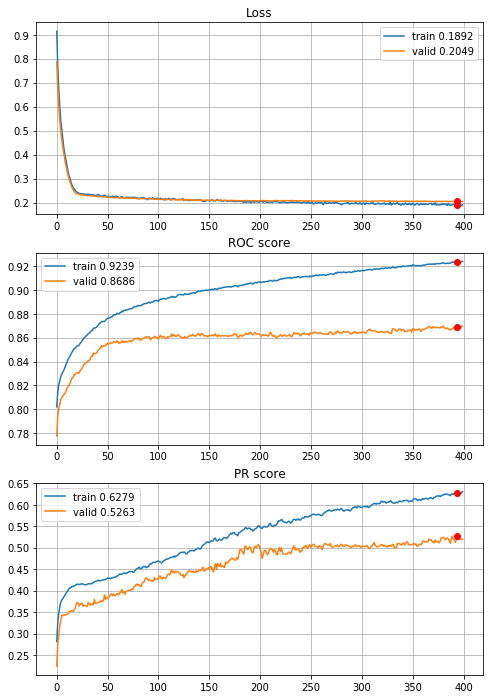


Fold 2------------------------------------------------------------


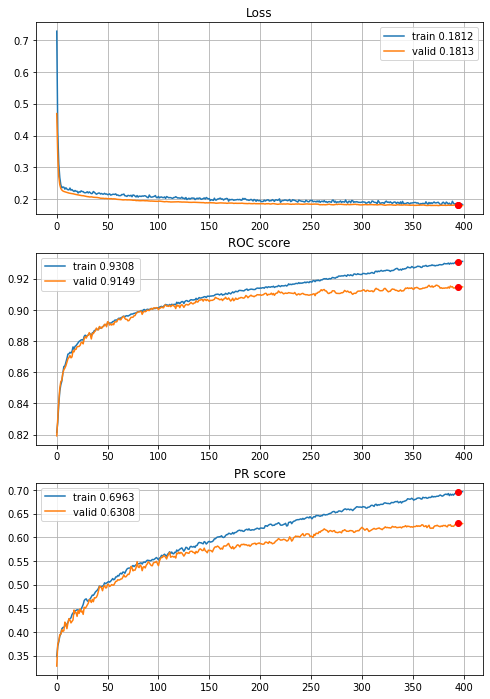


Fold 3------------------------------------------------------------


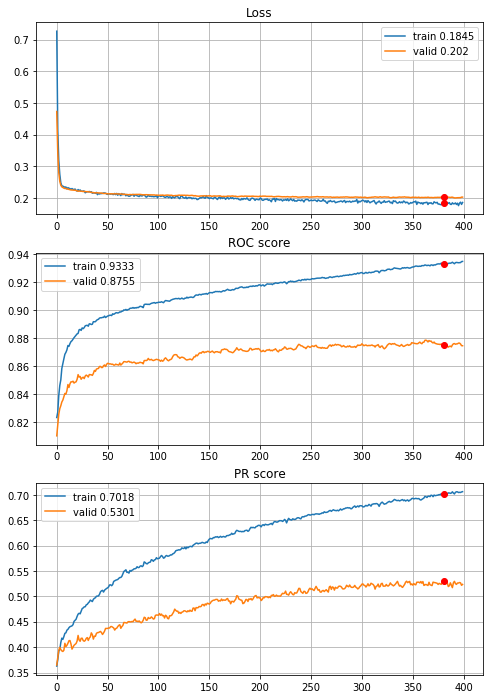


Fold 4------------------------------------------------------------


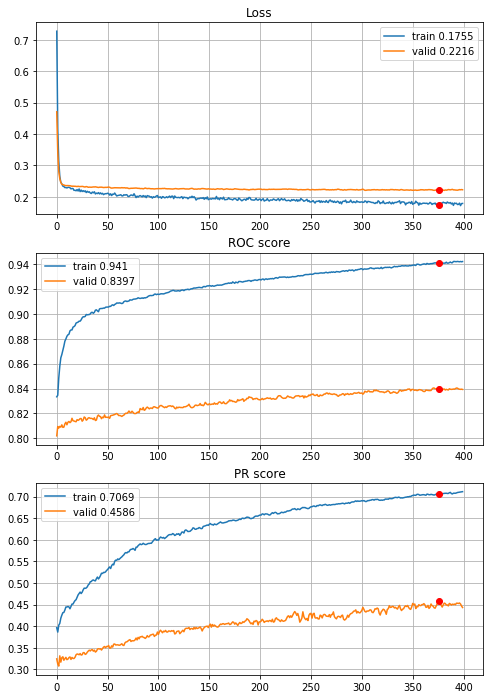


Fold 5------------------------------------------------------------


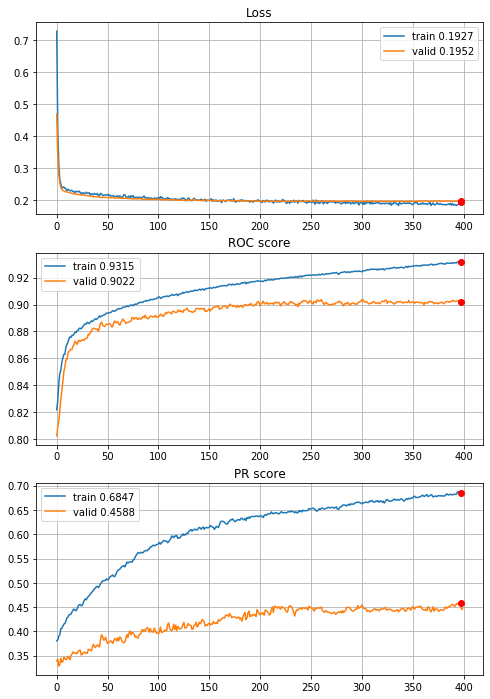


Fold 6------------------------------------------------------------


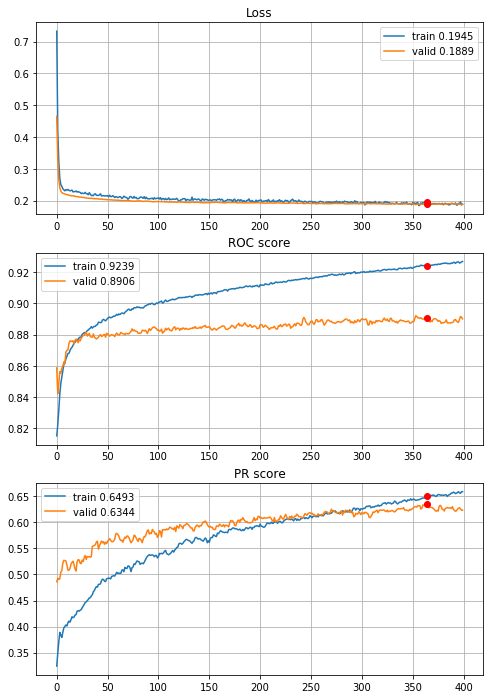

In [227]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,regularizers.l1(l=0.001)], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Lets try L1=0.0005


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/400,
cumulative time: 11.17s train loss: 0.7163268223620064, validation loss: 0.5985754178637448
Epoch: 2/400,
cumulative time: 11.27s train loss: 0.5895488651650908, validation loss: 0.5070104317775305
Epoch: 3/400,
cumulative time: 11.35s train loss: 0.5072601208133818, validation loss: 0.44692431247489695
Epoch: 4/400,
cumulative time: 11.45s train loss: 0.45606342880626877, validation loss: 0.40689147815629084
Epoch: 5/400,
cumulative time: 11.52s train loss: 0.41218209241110065, validation loss: 0.3787653079296314
Epoch: 6/400,
cumulative time: 11.62s train loss: 0.38943990929193445, validation loss: 0.35742522109186503
Epoch: 7/400,
cumulative time: 11.72s train loss: 0.36689976169744554, validation loss: 0.3402995404691814
Epoch: 8/400,
cumulative time: 11.79s train loss: 0.3437112728234663, validation loss: 0.3257379787548822
Epoch: 9/400,
cumulative time: 11.89s train loss: 0.332811349740635

Epoch: 76/400,
cumulative time: 17.71s train loss: 0.20702567618568882, validation loss: 0.20583114960349533
Epoch: 77/400,
cumulative time: 17.79s train loss: 0.20701648814045565, validation loss: 0.20529011874685427
Epoch: 78/400,
cumulative time: 17.86s train loss: 0.20649912039537507, validation loss: 0.2052616768484051
Epoch: 79/400,
cumulative time: 17.97s train loss: 0.20422478704057662, validation loss: 0.20544239944172552
Epoch: 80/400,
cumulative time: 18.05s train loss: 0.20402104357788708, validation loss: 0.2050602627580034
Epoch: 81/400,
cumulative time: 18.12s train loss: 0.20339016426045325, validation loss: 0.20537414416049218
Epoch: 82/400,
cumulative time: 18.23s train loss: 0.20074123736565078, validation loss: 0.20624695696449064
Epoch: 83/400,
cumulative time: 18.31s train loss: 0.20340941355493095, validation loss: 0.2059321070537223
Epoch: 84/400,
cumulative time: 18.39s train loss: 0.20549326077345692, validation loss: 0.20612906358018937
Epoch: 85/400,
cumulat

Epoch: 153/400,
cumulative time: 24.5s train loss: 0.1987174555309628, validation loss: 0.20051950303650762
Epoch: 154/400,
cumulative time: 24.59s train loss: 0.19851401393782575, validation loss: 0.20049722653970106
Epoch: 155/400,
cumulative time: 24.67s train loss: 0.1938738919633175, validation loss: 0.20120174436921331
Epoch: 156/400,
cumulative time: 24.77s train loss: 0.19275291702484826, validation loss: 0.2008942685172953
Epoch: 157/400,
cumulative time: 24.84s train loss: 0.1946236164265376, validation loss: 0.20030326166913637
Epoch: 158/400,
cumulative time: 24.94s train loss: 0.19788848592593783, validation loss: 0.20056460073728036
Epoch: 159/400,
cumulative time: 25.03s train loss: 0.1992089796461676, validation loss: 0.20090525561214972
Epoch: 160/400,
cumulative time: 25.11s train loss: 0.19455257774959403, validation loss: 0.19981575311238226
Epoch: 161/400,
cumulative time: 25.19s train loss: 0.194396579954168, validation loss: 0.2005905819617909
Epoch: 162/400,
cum

Epoch: 228/400,
cumulative time: 31.11s train loss: 0.18628848306431237, validation loss: 0.19876915438199394
Epoch: 229/400,
cumulative time: 31.19s train loss: 0.18486269525780144, validation loss: 0.19852579983944554
Epoch: 230/400,
cumulative time: 31.29s train loss: 0.1871008566489934, validation loss: 0.19821859926422122
Epoch: 231/400,
cumulative time: 31.37s train loss: 0.19019148976202477, validation loss: 0.19900283941488792
Epoch: 232/400,
cumulative time: 31.47s train loss: 0.18684046827122192, validation loss: 0.1986738536107903
Epoch: 233/400,
cumulative time: 31.55s train loss: 0.18600481290652648, validation loss: 0.1987918536887497
Epoch: 234/400,
cumulative time: 31.64s train loss: 0.18786559191394583, validation loss: 0.19778028207809034
Epoch: 235/400,
cumulative time: 31.73s train loss: 0.1854098777720429, validation loss: 0.1979358491929838
Epoch: 236/400,
cumulative time: 31.84s train loss: 0.18867420369510401, validation loss: 0.1983338277933966
Epoch: 237/400,


Epoch: 303/400,
cumulative time: 37.88s train loss: 0.18167786024483962, validation loss: 0.19527817852669127
Epoch: 304/400,
cumulative time: 37.96s train loss: 0.17703644903746538, validation loss: 0.19496124388131375
Epoch: 305/400,
cumulative time: 38.06s train loss: 0.1830302200680229, validation loss: 0.1950401144339509
Epoch: 306/400,
cumulative time: 38.16s train loss: 0.18110170791645128, validation loss: 0.19432374966050484
Epoch: 307/400,
cumulative time: 38.25s train loss: 0.17918910641586308, validation loss: 0.19386808708595718
Epoch: 308/400,
cumulative time: 38.33s train loss: 0.17914716676818981, validation loss: 0.19406783671497357
Epoch: 309/400,
cumulative time: 38.43s train loss: 0.18288417234478874, validation loss: 0.19353500317693967
Epoch: 310/400,
cumulative time: 38.52s train loss: 0.18397479758527305, validation loss: 0.19401871811980728
Epoch: 311/400,
cumulative time: 38.6s train loss: 0.18178856862702203, validation loss: 0.19484501606716512
Epoch: 312/40

Epoch: 378/400,
cumulative time: 44.48s train loss: 0.17410430599958887, validation loss: 0.19086565624968713
Epoch: 379/400,
cumulative time: 44.56s train loss: 0.17186042543043406, validation loss: 0.1904468047511349
Epoch: 380/400,
cumulative time: 44.65s train loss: 0.17831246454658706, validation loss: 0.19137641629613641
Epoch: 381/400,
cumulative time: 44.75s train loss: 0.17423362720636684, validation loss: 0.19149592224815115
Epoch: 382/400,
cumulative time: 44.83s train loss: 0.1744209661447722, validation loss: 0.19156770297276798
Epoch: 383/400,
cumulative time: 44.92s train loss: 0.17405918614421081, validation loss: 0.1919289771068459
Epoch: 384/400,
cumulative time: 45.01s train loss: 0.17637076068817492, validation loss: 0.19111474483298072
Epoch: 385/400,
cumulative time: 45.1s train loss: 0.16780773603394358, validation loss: 0.19061149369501074
Epoch: 386/400,
cumulative time: 45.2s train loss: 0.17812995710124394, validation loss: 0.19091616409674303
Epoch: 387/400,

Epoch: 52/400,
cumulative time: 18.07s train loss: 0.199880019321177, validation loss: 0.19070012012355894
Epoch: 53/400,
cumulative time: 18.16s train loss: 0.2029966852133455, validation loss: 0.19058074947475984
Epoch: 54/400,
cumulative time: 18.25s train loss: 0.19933322782792984, validation loss: 0.19060617456844722
Epoch: 55/400,
cumulative time: 18.34s train loss: 0.2004636438086037, validation loss: 0.19073204439146005
Epoch: 56/400,
cumulative time: 18.42s train loss: 0.20085152929198224, validation loss: 0.18990197413198842
Epoch: 57/400,
cumulative time: 18.5s train loss: 0.2010542213217446, validation loss: 0.19043920443654733
Epoch: 58/400,
cumulative time: 18.57s train loss: 0.20150346740649927, validation loss: 0.1904664426168433
Epoch: 59/400,
cumulative time: 18.66s train loss: 0.20280140501847121, validation loss: 0.19009274677735707
Epoch: 60/400,
cumulative time: 18.75s train loss: 0.1989735698441736, validation loss: 0.18926588532419322
Epoch: 61/400,
cumulative t

Epoch: 129/400,
cumulative time: 24.46s train loss: 0.18640476038901385, validation loss: 0.182443804224153
Epoch: 130/400,
cumulative time: 24.53s train loss: 0.18906653935378853, validation loss: 0.18222641750010993
Epoch: 131/400,
cumulative time: 24.61s train loss: 0.1892715845700851, validation loss: 0.18155926714620838
Epoch: 132/400,
cumulative time: 24.7s train loss: 0.1863838201893043, validation loss: 0.18173308274052458
Epoch: 133/400,
cumulative time: 24.79s train loss: 0.18911814898091103, validation loss: 0.181472976688871
Epoch: 134/400,
cumulative time: 24.87s train loss: 0.19084884068299932, validation loss: 0.18177511259963844
Epoch: 135/400,
cumulative time: 24.95s train loss: 0.18923952146719078, validation loss: 0.1817555505836964
Epoch: 136/400,
cumulative time: 25.02s train loss: 0.19048964456799658, validation loss: 0.181681034630826
Epoch: 137/400,
cumulative time: 25.1s train loss: 0.1875391449738926, validation loss: 0.18133525454608268
Epoch: 138/400,
cumula

Epoch: 206/400,
cumulative time: 31.13s train loss: 0.17836878362653058, validation loss: 0.17666608029650996
Epoch: 207/400,
cumulative time: 31.2s train loss: 0.184572195674592, validation loss: 0.17736879024726024
Epoch: 208/400,
cumulative time: 31.29s train loss: 0.18201915344848746, validation loss: 0.17694044607064635
Epoch: 209/400,
cumulative time: 31.38s train loss: 0.18349655291287478, validation loss: 0.17796662748867925
Epoch: 210/400,
cumulative time: 31.45s train loss: 0.1823720249619725, validation loss: 0.1772152812229606
Epoch: 211/400,
cumulative time: 31.52s train loss: 0.17896069958133604, validation loss: 0.17653502266866647
Epoch: 212/400,
cumulative time: 31.62s train loss: 0.18127830453647387, validation loss: 0.17719190966720108
Epoch: 213/400,
cumulative time: 31.7s train loss: 0.18278992371062078, validation loss: 0.17770893865064408
Epoch: 214/400,
cumulative time: 31.78s train loss: 0.1817944574738022, validation loss: 0.17874811142851024
Epoch: 215/400,
c

Epoch: 282/400,
cumulative time: 37.74s train loss: 0.17634476479210148, validation loss: 0.17464682579107726
Epoch: 283/400,
cumulative time: 37.81s train loss: 0.17460023926483595, validation loss: 0.17424480186979022
Epoch: 284/400,
cumulative time: 37.89s train loss: 0.17254789075427537, validation loss: 0.17462749915300388
Epoch: 285/400,
cumulative time: 37.98s train loss: 0.17901667595474513, validation loss: 0.17500926777636455
Epoch: 286/400,
cumulative time: 38.05s train loss: 0.17194142116280778, validation loss: 0.17386876968950402
Epoch: 287/400,
cumulative time: 38.14s train loss: 0.17028522280310465, validation loss: 0.17604478662823073
Epoch: 288/400,
cumulative time: 38.23s train loss: 0.17311794699475652, validation loss: 0.17480784663017063
Epoch: 289/400,
cumulative time: 38.29s train loss: 0.17506708087742545, validation loss: 0.17422266756399643
Epoch: 290/400,
cumulative time: 38.39s train loss: 0.17125363614988456, validation loss: 0.1744074604926545
Epoch: 291/

Epoch: 357/400,
cumulative time: 43.99s train loss: 0.1659200072476795, validation loss: 0.17363477319378193
Epoch: 358/400,
cumulative time: 44.07s train loss: 0.16149268171578537, validation loss: 0.17388749372932258
Epoch: 359/400,
cumulative time: 44.15s train loss: 0.1680694823539967, validation loss: 0.1742457897478994
Epoch: 360/400,
cumulative time: 44.25s train loss: 0.16794688438842012, validation loss: 0.1736772879538165
Epoch: 361/400,
cumulative time: 44.33s train loss: 0.169034481183071, validation loss: 0.17398791120985047
Epoch: 362/400,
cumulative time: 44.4s train loss: 0.16688831794724568, validation loss: 0.17354106943394984
Epoch: 363/400,
cumulative time: 44.5s train loss: 0.16529373328339322, validation loss: 0.1731785628545647
Epoch: 364/400,
cumulative time: 44.58s train loss: 0.16954120814074033, validation loss: 0.1735942028084898
Epoch: 365/400,
cumulative time: 44.67s train loss: 0.1708683087776284, validation loss: 0.1723372150871907
Epoch: 366/400,
cumula

Epoch: 106/400,
cumulative time: 23.57s train loss: 0.1921836375275674, validation loss: 0.20339132506051757
Epoch: 107/400,
cumulative time: 23.67s train loss: 0.1903861038830629, validation loss: 0.20310768097000703
Epoch: 108/400,
cumulative time: 23.76s train loss: 0.18832789480834122, validation loss: 0.20353971720749792
Epoch: 109/400,
cumulative time: 23.85s train loss: 0.19019491932210295, validation loss: 0.20327637321919437
Epoch: 110/400,
cumulative time: 23.95s train loss: 0.19243871477778854, validation loss: 0.20363392646444423
Epoch: 111/400,
cumulative time: 24.06s train loss: 0.18605353802926705, validation loss: 0.20306968826720787
Epoch: 112/400,
cumulative time: 24.15s train loss: 0.1897912836677331, validation loss: 0.2027619474870914
Epoch: 113/400,
cumulative time: 24.23s train loss: 0.18895961882862589, validation loss: 0.20297354614318022
Epoch: 114/400,
cumulative time: 24.35s train loss: 0.18553806817838217, validation loss: 0.20290295381556772
Epoch: 115/400

cumulative time: 30.94s train loss: 0.1779351417708214, validation loss: 0.19962346872993092
Epoch: 183/400,
cumulative time: 31.04s train loss: 0.18263584438590366, validation loss: 0.20084795192841612
Epoch: 184/400,
cumulative time: 31.12s train loss: 0.17871036912425545, validation loss: 0.2004883381398447
Epoch: 185/400,
cumulative time: 31.2s train loss: 0.1834751405225334, validation loss: 0.19994597330168645
Epoch: 186/400,
cumulative time: 31.28s train loss: 0.1837661721161987, validation loss: 0.2013840126682161
Epoch: 187/400,
cumulative time: 31.37s train loss: 0.18093579536176116, validation loss: 0.20041597605154776
Epoch: 188/400,
cumulative time: 31.47s train loss: 0.1831065084960056, validation loss: 0.2007908061936313
Epoch: 189/400,
cumulative time: 31.55s train loss: 0.18009925789001402, validation loss: 0.1996457703755969
Epoch: 190/400,
cumulative time: 31.64s train loss: 0.17770342074926365, validation loss: 0.19979476051776762
Epoch: 191/400,
cumulative time: 31

Epoch: 260/400,
cumulative time: 38.07s train loss: 0.17477113826180193, validation loss: 0.1996338046087622
Epoch: 261/400,
cumulative time: 38.17s train loss: 0.1739224802084025, validation loss: 0.1986459275075521
Epoch: 262/400,
cumulative time: 38.27s train loss: 0.1726189058758184, validation loss: 0.19993434817842057
Epoch: 263/400,
cumulative time: 38.37s train loss: 0.1767483166946831, validation loss: 0.1992318046939682
Epoch: 264/400,
cumulative time: 38.45s train loss: 0.1726585949169277, validation loss: 0.19864413977139697
Epoch: 265/400,
cumulative time: 38.55s train loss: 0.17479542252147026, validation loss: 0.19880648355473257
Epoch: 266/400,
cumulative time: 38.65s train loss: 0.17167085388991377, validation loss: 0.19865887875016675
Epoch: 267/400,
cumulative time: 38.75s train loss: 0.16626249775559462, validation loss: 0.19821021888140491
Epoch: 268/400,
cumulative time: 38.85s train loss: 0.1707288681828696, validation loss: 0.19786504433482985
Epoch: 269/400,
cu

Epoch: 335/400,
cumulative time: 45.15s train loss: 0.1661067696671516, validation loss: 0.19625750945076734
Epoch: 336/400,
cumulative time: 45.24s train loss: 0.1657051289998775, validation loss: 0.196867782206788
Epoch: 337/400,
cumulative time: 45.33s train loss: 0.16678679843066724, validation loss: 0.1967271676763741
Epoch: 338/400,
cumulative time: 45.42s train loss: 0.16769617880671034, validation loss: 0.19694456053223658
Epoch: 339/400,
cumulative time: 45.49s train loss: 0.16356463397143658, validation loss: 0.19651303017824856
Epoch: 340/400,
cumulative time: 45.59s train loss: 0.16693484113427276, validation loss: 0.19619196567688613
Epoch: 341/400,
cumulative time: 45.67s train loss: 0.16514047030157777, validation loss: 0.19722882351652207
Epoch: 342/400,
cumulative time: 45.77s train loss: 0.1686879123093742, validation loss: 0.1962383663976878
Epoch: 343/400,
cumulative time: 45.86s train loss: 0.16657554275534428, validation loss: 0.19826343795022136
Epoch: 344/400,
c

Epoch: 83/400,
cumulative time: 21.28s train loss: 0.18959109619269918, validation loss: 0.22035700661334173
Epoch: 84/400,
cumulative time: 21.37s train loss: 0.18976874648516265, validation loss: 0.22070689798746906
Epoch: 85/400,
cumulative time: 21.47s train loss: 0.1870907182090309, validation loss: 0.22042457530649198
Epoch: 86/400,
cumulative time: 21.56s train loss: 0.18851269194349973, validation loss: 0.21904119290831933
Epoch: 87/400,
cumulative time: 21.65s train loss: 0.18783736905259954, validation loss: 0.2206843632607643
Epoch: 88/400,
cumulative time: 21.75s train loss: 0.18855104802990238, validation loss: 0.22207419560805938
Epoch: 89/400,
cumulative time: 21.84s train loss: 0.18256662223978018, validation loss: 0.22084723396172104
Epoch: 90/400,
cumulative time: 21.91s train loss: 0.18922336278544197, validation loss: 0.220353584929998
Epoch: 91/400,
cumulative time: 22.0s train loss: 0.18861272354615938, validation loss: 0.22082344434196738
Epoch: 92/400,
cumulativ

Epoch: 161/400,
cumulative time: 28.3s train loss: 0.17886115766569263, validation loss: 0.21852765506465602
Epoch: 162/400,
cumulative time: 28.39s train loss: 0.18122627973865768, validation loss: 0.21869683131138304
Epoch: 163/400,
cumulative time: 28.47s train loss: 0.17825150662583958, validation loss: 0.2193624037517651
Epoch: 164/400,
cumulative time: 28.58s train loss: 0.17920528636972602, validation loss: 0.21815936176556228
Epoch: 165/400,
cumulative time: 28.65s train loss: 0.18381122947277023, validation loss: 0.21673988374307515
Epoch: 166/400,
cumulative time: 28.73s train loss: 0.17636229618190508, validation loss: 0.21753847958944722
Epoch: 167/400,
cumulative time: 28.82s train loss: 0.1786415426024002, validation loss: 0.21798837255543566
Epoch: 168/400,
cumulative time: 28.9s train loss: 0.17742696993041193, validation loss: 0.21877198499831335
Epoch: 169/400,
cumulative time: 28.97s train loss: 0.17850639980505692, validation loss: 0.2182104772894431
Epoch: 170/400,

Epoch: 238/400,
cumulative time: 35.09s train loss: 0.16889787624160887, validation loss: 0.2163385502977242
Epoch: 239/400,
cumulative time: 35.17s train loss: 0.17381027396352355, validation loss: 0.2157923645480761
Epoch: 240/400,
cumulative time: 35.25s train loss: 0.17401332567689007, validation loss: 0.21639200348751808
Epoch: 241/400,
cumulative time: 35.34s train loss: 0.17484743084557675, validation loss: 0.2161910411466594
Epoch: 242/400,
cumulative time: 35.42s train loss: 0.17274030997337403, validation loss: 0.2163426040190337
Epoch: 243/400,
cumulative time: 35.5s train loss: 0.17318437131995304, validation loss: 0.21514329203229995
Epoch: 244/400,
cumulative time: 35.58s train loss: 0.1704892117808265, validation loss: 0.21567717453561572
Epoch: 245/400,
cumulative time: 35.65s train loss: 0.1688320108132843, validation loss: 0.21516415776167713
Epoch: 246/400,
cumulative time: 35.74s train loss: 0.17358227953829078, validation loss: 0.21569263006709768
Epoch: 247/400,
c

Epoch: 314/400,
cumulative time: 41.82s train loss: 0.16324766809169095, validation loss: 0.2153791489571535
Epoch: 315/400,
cumulative time: 41.9s train loss: 0.16473429345019697, validation loss: 0.2154300982473128
Epoch: 316/400,
cumulative time: 41.99s train loss: 0.1599213840822697, validation loss: 0.21624292342442153
Epoch: 317/400,
cumulative time: 42.09s train loss: 0.1626675076162522, validation loss: 0.21546332935043705
Epoch: 318/400,
cumulative time: 42.18s train loss: 0.16452950993483476, validation loss: 0.21462889688413245
Epoch: 319/400,
cumulative time: 42.28s train loss: 0.16357357813620604, validation loss: 0.21509270178276044
Epoch: 320/400,
cumulative time: 42.37s train loss: 0.16289155401025593, validation loss: 0.21538822124155058
Epoch: 321/400,
cumulative time: 42.46s train loss: 0.16200168773669732, validation loss: 0.2164214564567226
Epoch: 322/400,
cumulative time: 42.55s train loss: 0.1663276210491151, validation loss: 0.2156848339679279
Epoch: 323/400,
cu

Epoch: 391/400,
cumulative time: 48.92s train loss: 0.15270093961719894, validation loss: 0.21577268583241757
Epoch: 392/400,
cumulative time: 49.0s train loss: 0.15844191382909073, validation loss: 0.21572510686200574
Epoch: 393/400,
cumulative time: 49.1s train loss: 0.16246419136945855, validation loss: 0.2146525981733008
Epoch: 394/400,
cumulative time: 49.2s train loss: 0.1584001340924981, validation loss: 0.2152022663209562
Epoch: 395/400,
cumulative time: 49.27s train loss: 0.1549838536679274, validation loss: 0.21552871662122672
Epoch: 396/400,
cumulative time: 49.36s train loss: 0.15425900135423753, validation loss: 0.21666131473018138
Epoch: 397/400,
cumulative time: 49.43s train loss: 0.15823330180440076, validation loss: 0.21626312028339162
Epoch: 398/400,
cumulative time: 49.52s train loss: 0.15332765666822157, validation loss: 0.21504081943772446
Epoch: 399/400,
cumulative time: 49.63s train loss: 0.157325413626821, validation loss: 0.21598977768797906
Epoch: 400/400,
cum

Epoch: 67/400,
cumulative time: 17.98s train loss: 0.2017564250119728, validation loss: 0.1989152177529195
Epoch: 68/400,
cumulative time: 18.05s train loss: 0.20054936507486099, validation loss: 0.19936676609327778
Epoch: 69/400,
cumulative time: 18.13s train loss: 0.1955553485904567, validation loss: 0.1992316924826017
Epoch: 70/400,
cumulative time: 18.23s train loss: 0.1948400829302493, validation loss: 0.19864893080687684
Epoch: 71/400,
cumulative time: 18.31s train loss: 0.19235037070565209, validation loss: 0.1984305640442915
Epoch: 72/400,
cumulative time: 18.4s train loss: 0.198472961322895, validation loss: 0.19821139174444144
Epoch: 73/400,
cumulative time: 18.5s train loss: 0.1918024780140917, validation loss: 0.19861789609454825
Epoch: 74/400,
cumulative time: 18.58s train loss: 0.19835278792182828, validation loss: 0.19831026024258702
Epoch: 75/400,
cumulative time: 18.67s train loss: 0.19384903266283074, validation loss: 0.19710624254987685
Epoch: 76/400,
cumulative time

Epoch: 145/400,
cumulative time: 24.94s train loss: 0.18337901824353753, validation loss: 0.19389705161477858
Epoch: 146/400,
cumulative time: 25.03s train loss: 0.18461380675082117, validation loss: 0.19319323801832866
Epoch: 147/400,
cumulative time: 25.12s train loss: 0.18935592071872356, validation loss: 0.19491819260351814
Epoch: 148/400,
cumulative time: 25.22s train loss: 0.18009170053533902, validation loss: 0.19616037856106294
Epoch: 149/400,
cumulative time: 25.31s train loss: 0.18491190409057973, validation loss: 0.19534955767422713
Epoch: 150/400,
cumulative time: 25.4s train loss: 0.1858293570959619, validation loss: 0.19438980381860152
Epoch: 151/400,
cumulative time: 25.49s train loss: 0.18383984364856587, validation loss: 0.19382681460466664
Epoch: 152/400,
cumulative time: 25.57s train loss: 0.1844352411075556, validation loss: 0.19498098902320216
Epoch: 153/400,
cumulative time: 25.67s train loss: 0.18989182901105467, validation loss: 0.19337613002710363
Epoch: 154/40

Epoch: 220/400,
cumulative time: 31.66s train loss: 0.17392342210071446, validation loss: 0.19279069868893978
Epoch: 221/400,
cumulative time: 31.75s train loss: 0.17872150264513995, validation loss: 0.19324912362927507
Epoch: 222/400,
cumulative time: 31.82s train loss: 0.17928960424579618, validation loss: 0.192921106823411
Epoch: 223/400,
cumulative time: 31.92s train loss: 0.1814696804519273, validation loss: 0.1927741743102838
Epoch: 224/400,
cumulative time: 32.01s train loss: 0.1801444851509099, validation loss: 0.1926927218722436
Epoch: 225/400,
cumulative time: 32.1s train loss: 0.17839945823512174, validation loss: 0.19202679954048743
Epoch: 226/400,
cumulative time: 32.2s train loss: 0.1762158843973757, validation loss: 0.19161082424105694
Epoch: 227/400,
cumulative time: 32.29s train loss: 0.1727256731405609, validation loss: 0.19250285689367935
Epoch: 228/400,
cumulative time: 32.36s train loss: 0.17720479235648035, validation loss: 0.19173216648214828
Epoch: 229/400,
cumu

Epoch: 297/400,
cumulative time: 38.59s train loss: 0.17698434979133618, validation loss: 0.19145756936369307
Epoch: 298/400,
cumulative time: 38.68s train loss: 0.1635072049120735, validation loss: 0.19211836357687181
Epoch: 299/400,
cumulative time: 38.76s train loss: 0.1721822058417688, validation loss: 0.19202424626183565
Epoch: 300/400,
cumulative time: 38.86s train loss: 0.17066684919570171, validation loss: 0.19244898637046126
Epoch: 301/400,
cumulative time: 38.93s train loss: 0.17306738490515683, validation loss: 0.19198059292329353
Epoch: 302/400,
cumulative time: 39.04s train loss: 0.17057552719906816, validation loss: 0.1925141208260646
Epoch: 303/400,
cumulative time: 39.13s train loss: 0.17438457359343654, validation loss: 0.19286828822798976
Epoch: 304/400,
cumulative time: 39.22s train loss: 0.16888855276017972, validation loss: 0.19313699440950735
Epoch: 305/400,
cumulative time: 39.31s train loss: 0.1702132358316802, validation loss: 0.19361004004629148
Epoch: 306/400

Epoch: 374/400,
cumulative time: 45.43s train loss: 0.16607289938955738, validation loss: 0.19217949160469305
Epoch: 375/400,
cumulative time: 45.52s train loss: 0.1697954214569841, validation loss: 0.19201387939280903
Epoch: 376/400,
cumulative time: 45.6s train loss: 0.16579546507287451, validation loss: 0.19230302559468332
Epoch: 377/400,
cumulative time: 45.7s train loss: 0.16269487896864823, validation loss: 0.1926251845623516
Epoch: 378/400,
cumulative time: 45.78s train loss: 0.16878874123284707, validation loss: 0.19218713283942462
Epoch: 379/400,
cumulative time: 45.88s train loss: 0.16671552278980456, validation loss: 0.19173315742618613
Epoch: 380/400,
cumulative time: 45.98s train loss: 0.16642823958878267, validation loss: 0.19179608166621448
Epoch: 381/400,
cumulative time: 46.06s train loss: 0.16400537474978838, validation loss: 0.19192362403492896
Epoch: 382/400,
cumulative time: 46.15s train loss: 0.16551900865623975, validation loss: 0.1919908747581542
Epoch: 383/400,

Epoch: 47/400,
cumulative time: 18.57s train loss: 0.20269583540947797, validation loss: 0.19428339503015946
Epoch: 48/400,
cumulative time: 18.65s train loss: 0.20128130189739982, validation loss: 0.19369330369861076
Epoch: 49/400,
cumulative time: 18.74s train loss: 0.20247915775733422, validation loss: 0.1942910011142963
Epoch: 50/400,
cumulative time: 18.83s train loss: 0.20215523593210083, validation loss: 0.19390381082186042
Epoch: 51/400,
cumulative time: 18.92s train loss: 0.20164889246124515, validation loss: 0.19428785848294639
Epoch: 52/400,
cumulative time: 19.01s train loss: 0.1989541797956064, validation loss: 0.19416636652386754
Epoch: 53/400,
cumulative time: 19.1s train loss: 0.20400974707761577, validation loss: 0.1944652322856352
Epoch: 54/400,
cumulative time: 19.18s train loss: 0.2011091093358998, validation loss: 0.1939694452904686
Epoch: 55/400,
cumulative time: 19.27s train loss: 0.1997780576802096, validation loss: 0.19401107112925425
Epoch: 56/400,
cumulative 

cumulative time: 25.3s train loss: 0.18837523679552567, validation loss: 0.18844596574053538
Epoch: 125/400,
cumulative time: 25.39s train loss: 0.19173145304273703, validation loss: 0.188741640938324
Epoch: 126/400,
cumulative time: 25.48s train loss: 0.19212417945538043, validation loss: 0.18832720412492213
Epoch: 127/400,
cumulative time: 25.58s train loss: 0.19195869942833332, validation loss: 0.18782660815839575
Epoch: 128/400,
cumulative time: 25.65s train loss: 0.18578276879196373, validation loss: 0.1876136459427009
Epoch: 129/400,
cumulative time: 25.75s train loss: 0.18871388164030195, validation loss: 0.1874867003604467
Epoch: 130/400,
cumulative time: 25.83s train loss: 0.18912124014952209, validation loss: 0.18761601620280177
Epoch: 131/400,
cumulative time: 25.9s train loss: 0.18796444520061828, validation loss: 0.18704643425096507
Epoch: 132/400,
cumulative time: 25.99s train loss: 0.18693146940523256, validation loss: 0.18672492363517496
Epoch: 133/400,
cumulative time:

Epoch: 202/400,
cumulative time: 32.3s train loss: 0.18665253488817954, validation loss: 0.1834471681855333
Epoch: 203/400,
cumulative time: 32.37s train loss: 0.1835206021459598, validation loss: 0.1838778130558759
Epoch: 204/400,
cumulative time: 32.47s train loss: 0.182925556761778, validation loss: 0.18398247881210147
Epoch: 205/400,
cumulative time: 32.57s train loss: 0.18646506290860138, validation loss: 0.18400627482287232
Epoch: 206/400,
cumulative time: 32.66s train loss: 0.18345393654914519, validation loss: 0.1839688558879878
Epoch: 207/400,
cumulative time: 32.75s train loss: 0.18676780462735612, validation loss: 0.18366309250316018
Epoch: 208/400,
cumulative time: 32.83s train loss: 0.18279680693066203, validation loss: 0.18390539497069797
Epoch: 209/400,
cumulative time: 32.92s train loss: 0.18758934677763175, validation loss: 0.18448900261528067
Epoch: 210/400,
cumulative time: 33.02s train loss: 0.18448933568074477, validation loss: 0.1843493217539303
Epoch: 211/400,
cu

Epoch: 277/400,
cumulative time: 39.02s train loss: 0.17543004124435646, validation loss: 0.18088144447410617
Epoch: 278/400,
cumulative time: 39.1s train loss: 0.1740650431972149, validation loss: 0.1809479613740073
Epoch: 279/400,
cumulative time: 39.19s train loss: 0.17924775645227592, validation loss: 0.1817188344004461
Epoch: 280/400,
cumulative time: 39.28s train loss: 0.1730725633006937, validation loss: 0.18128405326376112
Epoch: 281/400,
cumulative time: 39.37s train loss: 0.17330610806560667, validation loss: 0.18182705568137073
Epoch: 282/400,
cumulative time: 39.46s train loss: 0.17739810191049496, validation loss: 0.18277281226745848
Epoch: 283/400,
cumulative time: 39.55s train loss: 0.17534002064717372, validation loss: 0.18133601142644343
Epoch: 284/400,
cumulative time: 39.64s train loss: 0.1768837248649765, validation loss: 0.1808632474653339
Epoch: 285/400,
cumulative time: 39.73s train loss: 0.17540739998372662, validation loss: 0.18051615498674103
Epoch: 286/400,
c

Epoch: 353/400,
cumulative time: 45.89s train loss: 0.17220523981337565, validation loss: 0.17697530197774314
Epoch: 354/400,
cumulative time: 45.97s train loss: 0.1654512520376135, validation loss: 0.17648176266969462
Epoch: 355/400,
cumulative time: 46.05s train loss: 0.169639835211041, validation loss: 0.17584099548261267
Epoch: 356/400,
cumulative time: 46.15s train loss: 0.17422342285960946, validation loss: 0.17614582978172172
Epoch: 357/400,
cumulative time: 46.22s train loss: 0.16407257381691343, validation loss: 0.17597878820201882
Epoch: 358/400,
cumulative time: 46.32s train loss: 0.1678805058511525, validation loss: 0.1760112673851491
Epoch: 359/400,
cumulative time: 46.41s train loss: 0.1678664441601353, validation loss: 0.1772061605889426
Epoch: 360/400,
cumulative time: 46.49s train loss: 0.16983619222731347, validation loss: 0.17706852569402476
Epoch: 361/400,
cumulative time: 46.59s train loss: 0.17038325794644532, validation loss: 0.17705101635870493
Epoch: 362/400,
c

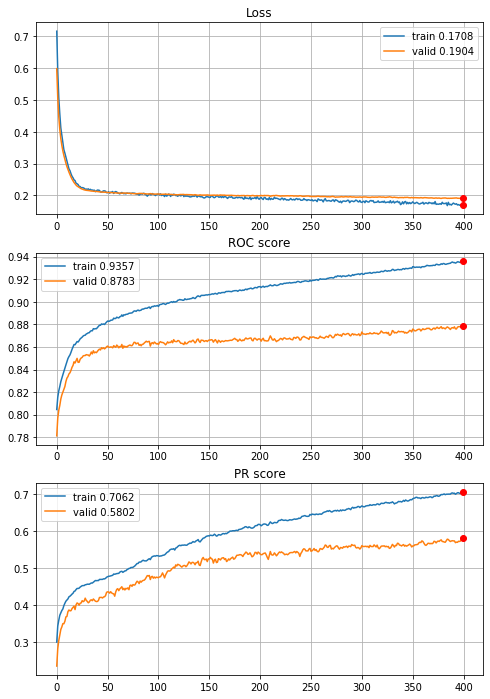


Fold 2------------------------------------------------------------


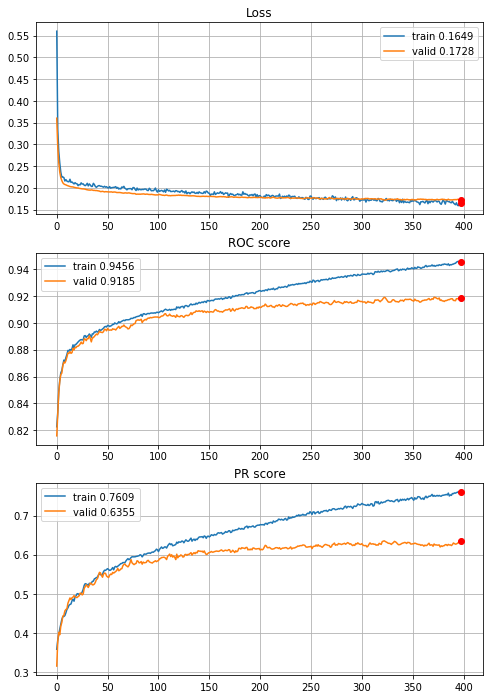


Fold 3------------------------------------------------------------


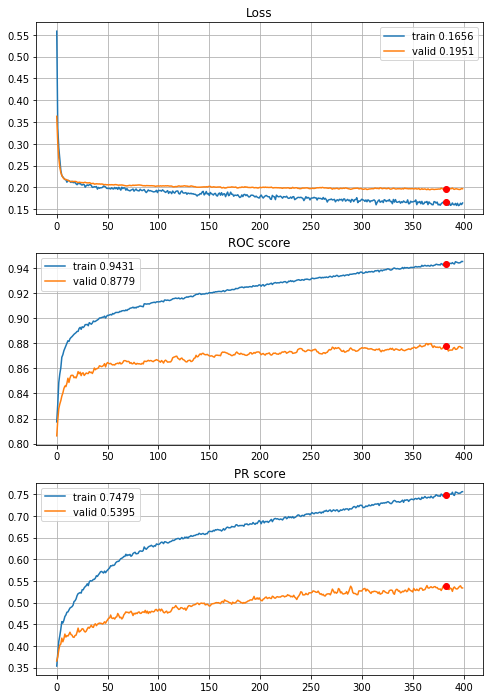


Fold 4------------------------------------------------------------


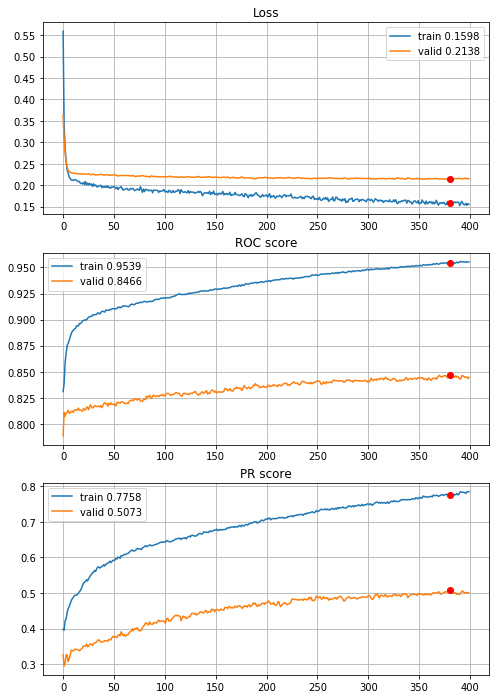


Fold 5------------------------------------------------------------


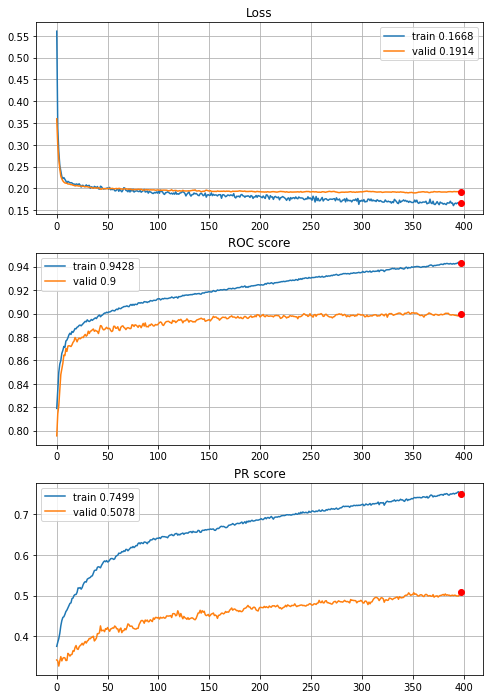


Fold 6------------------------------------------------------------


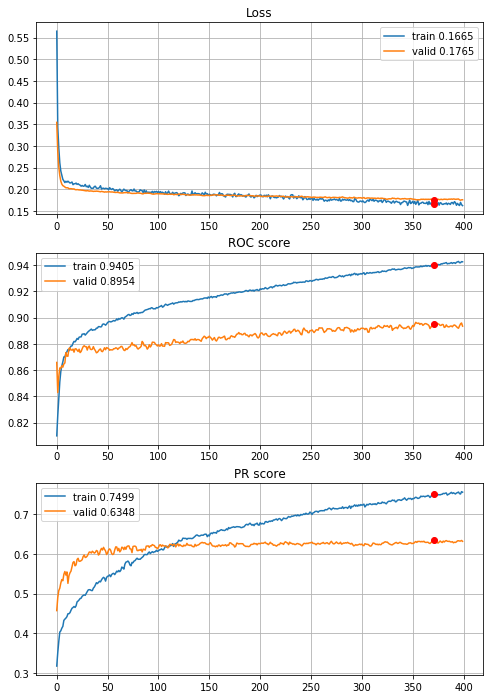

In [228]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,regularizers.l1(l=0.0005)], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Lets try L2 norm as regularization (0.01)


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/400,
cumulative time: 14.85s train loss: 1.1056075767489546, validation loss: 0.946113309502736
Epoch: 2/400,
cumulative time: 14.95s train loss: 0.9061064007910581, validation loss: 0.7870353065187525
Epoch: 3/400,
cumulative time: 15.05s train loss: 0.7612586777509335, validation loss: 0.6700547912075124
Epoch: 4/400,
cumulative time: 15.14s train loss: 0.6568479797792779, validation loss: 0.5820595505138126
Epoch: 5/400,
cumulative time: 15.23s train loss: 0.5682324685882575, validation loss: 0.5141699179049409
Epoch: 6/400,
cumulative time: 15.32s train loss: 0.5075640110736074, validation loss: 0.4602685775334832
Epoch: 7/400,
cumulative time: 15.42s train loss: 0.4564487356490822, validation loss: 0.4168535428291781
Epoch: 8/400,
cumulative time: 15.5s train loss: 0.40882247550554224, validation loss: 0.3811171266513855
Epoch: 9/400,
cumulative time: 15.59s train loss: 0.3780612594411046, valid

Epoch: 79/400,
cumulative time: 21.93s train loss: 0.19338076009620184, validation loss: 0.19464702042409773
Epoch: 80/400,
cumulative time: 22.02s train loss: 0.19252681607777247, validation loss: 0.19431297864088748
Epoch: 81/400,
cumulative time: 22.12s train loss: 0.19286995032123064, validation loss: 0.1945030206589715
Epoch: 82/400,
cumulative time: 22.21s train loss: 0.19023539844079998, validation loss: 0.19512033151733565
Epoch: 83/400,
cumulative time: 22.29s train loss: 0.1934939377978175, validation loss: 0.19490478909338205
Epoch: 84/400,
cumulative time: 22.39s train loss: 0.1948149201833384, validation loss: 0.19513831958762687
Epoch: 85/400,
cumulative time: 22.49s train loss: 0.19287167601825314, validation loss: 0.1949206003677751
Epoch: 86/400,
cumulative time: 22.58s train loss: 0.19438432530241107, validation loss: 0.19459636287665016
Epoch: 87/400,
cumulative time: 22.67s train loss: 0.1962370441937382, validation loss: 0.1944956101787937
Epoch: 88/400,
cumulative

Epoch: 155/400,
cumulative time: 28.91s train loss: 0.18469788092407077, validation loss: 0.18895621073622312
Epoch: 156/400,
cumulative time: 29.01s train loss: 0.1848841616177817, validation loss: 0.1886810461288106
Epoch: 157/400,
cumulative time: 29.1s train loss: 0.1851640772612409, validation loss: 0.18794974378964274
Epoch: 158/400,
cumulative time: 29.19s train loss: 0.18483495616794493, validation loss: 0.18778609218161968
Epoch: 159/400,
cumulative time: 29.26s train loss: 0.18661351525476907, validation loss: 0.18798119451308867
Epoch: 160/400,
cumulative time: 29.36s train loss: 0.18456529165594587, validation loss: 0.1870268654695627
Epoch: 161/400,
cumulative time: 29.45s train loss: 0.18531478286488823, validation loss: 0.18762819882242898
Epoch: 162/400,
cumulative time: 29.54s train loss: 0.186268077833773, validation loss: 0.18834783103245625
Epoch: 163/400,
cumulative time: 29.64s train loss: 0.1812200489847346, validation loss: 0.18817755665625902
Epoch: 164/400,
cu

Epoch: 306/400,
cumulative time: 42.69s train loss: 0.1712298401251489, validation loss: 0.1829612633757285
Epoch: 307/400,
cumulative time: 42.79s train loss: 0.16969648504542315, validation loss: 0.1825898648517914
Epoch: 308/400,
cumulative time: 42.87s train loss: 0.1698585812688304, validation loss: 0.18240348547865062
Epoch: 309/400,
cumulative time: 42.96s train loss: 0.17113244587333623, validation loss: 0.1816844295924519
Epoch: 310/400,
cumulative time: 43.05s train loss: 0.1729346304822592, validation loss: 0.18224014402309427
Epoch: 311/400,
cumulative time: 43.15s train loss: 0.1709835752239619, validation loss: 0.18287171759425316
Epoch: 312/400,
cumulative time: 43.24s train loss: 0.17461710955799703, validation loss: 0.1826478609943336
Epoch: 313/400,
cumulative time: 43.34s train loss: 0.16908877036981418, validation loss: 0.18297526710734965
Epoch: 314/400,
cumulative time: 43.43s train loss: 0.17109707546914635, validation loss: 0.1833560370841182
Epoch: 315/400,
cum

Epoch: 383/400,
cumulative time: 49.69s train loss: 0.16645080977479257, validation loss: 0.18228067496314795
Epoch: 384/400,
cumulative time: 49.78s train loss: 0.1658153590016632, validation loss: 0.18150876438940255
Epoch: 385/400,
cumulative time: 49.87s train loss: 0.16013532734412148, validation loss: 0.18173255778958322
Epoch: 386/400,
cumulative time: 49.96s train loss: 0.17114060504583892, validation loss: 0.18238416824830023
Epoch: 387/400,
cumulative time: 50.04s train loss: 0.1634034329003214, validation loss: 0.18167095791796284
Epoch: 388/400,
cumulative time: 50.14s train loss: 0.1643730365546817, validation loss: 0.18260726292345678
Epoch: 389/400,
cumulative time: 50.24s train loss: 0.1622919166588396, validation loss: 0.18198203002317917
Epoch: 390/400,
cumulative time: 50.32s train loss: 0.16743297443224203, validation loss: 0.18195603428389603
Epoch: 391/400,
cumulative time: 50.41s train loss: 0.1688824720438637, validation loss: 0.18262293538353758
Epoch: 392/400,

Epoch: 58/400,
cumulative time: 20.72s train loss: 0.18970423393516334, validation loss: 0.18114783378840837
Epoch: 59/400,
cumulative time: 20.81s train loss: 0.18990107545030677, validation loss: 0.18024264895929426
Epoch: 60/400,
cumulative time: 20.9s train loss: 0.18765151022600568, validation loss: 0.17958194141726616
Epoch: 61/400,
cumulative time: 20.99s train loss: 0.1902776223066051, validation loss: 0.17990853619817412
Epoch: 62/400,
cumulative time: 21.07s train loss: 0.1872874029343847, validation loss: 0.17961694503448727
Epoch: 63/400,
cumulative time: 21.18s train loss: 0.18883595839210043, validation loss: 0.17979423317054483
Epoch: 64/400,
cumulative time: 21.27s train loss: 0.18830023543230032, validation loss: 0.17891575429659953
Epoch: 65/400,
cumulative time: 21.37s train loss: 0.19057954165291055, validation loss: 0.17830160058606437
Epoch: 66/400,
cumulative time: 21.47s train loss: 0.1901748139505352, validation loss: 0.17846229383480455
Epoch: 67/400,
cumulati

Epoch: 136/400,
cumulative time: 28.08s train loss: 0.1791000475010932, validation loss: 0.17181403424250635
Epoch: 137/400,
cumulative time: 28.17s train loss: 0.17990629147025436, validation loss: 0.1712524731640348
Epoch: 138/400,
cumulative time: 28.26s train loss: 0.17738658008888525, validation loss: 0.17156821522933116
Epoch: 139/400,
cumulative time: 28.35s train loss: 0.1769481939919266, validation loss: 0.17086638355671754
Epoch: 140/400,
cumulative time: 28.44s train loss: 0.17637176518849626, validation loss: 0.1711811138886072
Epoch: 141/400,
cumulative time: 28.53s train loss: 0.18154527760692452, validation loss: 0.17051574878453402
Epoch: 142/400,
cumulative time: 28.63s train loss: 0.1769741766612022, validation loss: 0.17062377146830554
Epoch: 143/400,
cumulative time: 28.73s train loss: 0.1799830713238742, validation loss: 0.17128810395718697
Epoch: 144/400,
cumulative time: 28.81s train loss: 0.17920421055830774, validation loss: 0.17130484565538107
Epoch: 145/400,


cumulative time: 34.96s train loss: 0.16952900319538391, validation loss: 0.16767271094889355
Epoch: 212/400,
cumulative time: 35.04s train loss: 0.17349958695498185, validation loss: 0.1678854478050649
Epoch: 213/400,
cumulative time: 35.14s train loss: 0.17339497898782633, validation loss: 0.16900497765659345
Epoch: 214/400,
cumulative time: 35.24s train loss: 0.17512463838104092, validation loss: 0.169444398570222
Epoch: 215/400,
cumulative time: 35.34s train loss: 0.16771734058722476, validation loss: 0.1682028876955641
Epoch: 216/400,
cumulative time: 35.43s train loss: 0.17229741519915498, validation loss: 0.1673839664613784
Epoch: 217/400,
cumulative time: 35.51s train loss: 0.17065608222709988, validation loss: 0.16707294787938592
Epoch: 218/400,
cumulative time: 35.6s train loss: 0.17285332060839295, validation loss: 0.16672377525214546
Epoch: 219/400,
cumulative time: 35.69s train loss: 0.1730127268090898, validation loss: 0.16676813735298
Epoch: 220/400,
cumulative time: 35.

cumulative time: 42.16s train loss: 0.16379066590313876, validation loss: 0.16565671774822266
Epoch: 289/400,
cumulative time: 42.24s train loss: 0.16847306700416637, validation loss: 0.16489254464022604
Epoch: 290/400,
cumulative time: 42.33s train loss: 0.16580398313849087, validation loss: 0.16502561054813014
Epoch: 291/400,
cumulative time: 42.43s train loss: 0.17127887261123648, validation loss: 0.16497717135855686
Epoch: 292/400,
cumulative time: 42.52s train loss: 0.17211134811789336, validation loss: 0.16555525542246313
Epoch: 293/400,
cumulative time: 42.62s train loss: 0.1670710195212319, validation loss: 0.1659493037954124
Epoch: 294/400,
cumulative time: 42.71s train loss: 0.16620970076951955, validation loss: 0.16546865860934726
Epoch: 295/400,
cumulative time: 42.8s train loss: 0.16662210078123244, validation loss: 0.1656463667498366
Epoch: 296/400,
cumulative time: 42.89s train loss: 0.1670557740228486, validation loss: 0.16533618826070526
Epoch: 297/400,
cumulative time

Epoch: 365/400,
cumulative time: 49.17s train loss: 0.16400914467091166, validation loss: 0.16252352379623636
Epoch: 366/400,
cumulative time: 49.26s train loss: 0.15925927624604008, validation loss: 0.16255539423852253
Epoch: 367/400,
cumulative time: 49.36s train loss: 0.16321932360704733, validation loss: 0.1626453526326473
Epoch: 368/400,
cumulative time: 49.45s train loss: 0.15734003676229327, validation loss: 0.16295019902599706
Epoch: 369/400,
cumulative time: 49.54s train loss: 0.1644206865142614, validation loss: 0.16261549551027335
Epoch: 370/400,
cumulative time: 49.63s train loss: 0.16097661745919434, validation loss: 0.1638212171724442
Epoch: 371/400,
cumulative time: 49.73s train loss: 0.16347982918016532, validation loss: 0.16380596826149083
Epoch: 372/400,
cumulative time: 49.82s train loss: 0.16388670683229872, validation loss: 0.1633141675823302
Epoch: 373/400,
cumulative time: 49.91s train loss: 0.1623701395648481, validation loss: 0.16348034009051834
Epoch: 374/400,

Epoch: 39/400,
cumulative time: 16.42s train loss: 0.1884931700526054, validation loss: 0.19749444247703274
Epoch: 40/400,
cumulative time: 16.5s train loss: 0.19152938317009904, validation loss: 0.1975570366273738
Epoch: 41/400,
cumulative time: 16.6s train loss: 0.18419803444982005, validation loss: 0.19744267668302057
Epoch: 42/400,
cumulative time: 16.7s train loss: 0.18961780344132698, validation loss: 0.19721962687934264
Epoch: 43/400,
cumulative time: 16.8s train loss: 0.18683096845819203, validation loss: 0.197331828456855
Epoch: 44/400,
cumulative time: 16.88s train loss: 0.1867200489078618, validation loss: 0.1965992379820199
Epoch: 45/400,
cumulative time: 16.99s train loss: 0.18849110275184205, validation loss: 0.19668125108371592
Epoch: 46/400,
cumulative time: 17.07s train loss: 0.18914684829460154, validation loss: 0.1967931682288042
Epoch: 47/400,
cumulative time: 17.17s train loss: 0.191939083812254, validation loss: 0.19599075825399853
Epoch: 48/400,
cumulative time: 

Epoch: 116/400,
cumulative time: 23.34s train loss: 0.1800516149708295, validation loss: 0.19087852178122575
Epoch: 117/400,
cumulative time: 23.43s train loss: 0.17602173249415434, validation loss: 0.19170611791035502
Epoch: 118/400,
cumulative time: 23.53s train loss: 0.17986269726246487, validation loss: 0.19187289439435742
Epoch: 119/400,
cumulative time: 23.63s train loss: 0.1775185645520956, validation loss: 0.191023034216855
Epoch: 120/400,
cumulative time: 23.73s train loss: 0.1821904005583658, validation loss: 0.19212913472864782
Epoch: 121/400,
cumulative time: 23.83s train loss: 0.17689378804355751, validation loss: 0.19241682521520095
Epoch: 122/400,
cumulative time: 23.93s train loss: 0.17489676694604248, validation loss: 0.19165383519556503
Epoch: 123/400,
cumulative time: 24.01s train loss: 0.18113886525968784, validation loss: 0.19083941745516145
Epoch: 124/400,
cumulative time: 24.11s train loss: 0.18044153193099297, validation loss: 0.19155800371118972
Epoch: 125/400,

cumulative time: 30.35s train loss: 0.17068917214507337, validation loss: 0.1902245530415549
Epoch: 192/400,
cumulative time: 30.43s train loss: 0.1749244909868021, validation loss: 0.19011189127519407
Epoch: 193/400,
cumulative time: 30.52s train loss: 0.1749578838636729, validation loss: 0.19034540670028266
Epoch: 194/400,
cumulative time: 30.61s train loss: 0.17309672396213138, validation loss: 0.1902728808840071
Epoch: 195/400,
cumulative time: 30.7s train loss: 0.17056370858062692, validation loss: 0.18971601518326708
Epoch: 196/400,
cumulative time: 30.8s train loss: 0.1692416257282134, validation loss: 0.19019286290835904
Epoch: 197/400,
cumulative time: 30.89s train loss: 0.17025235561243787, validation loss: 0.19043491525405423
Epoch: 198/400,
cumulative time: 30.97s train loss: 0.16986016567379558, validation loss: 0.1896302212521081
Epoch: 199/400,
cumulative time: 31.07s train loss: 0.1677308994637876, validation loss: 0.1884713097818809
Epoch: 200/400,
cumulative time: 31.

cumulative time: 37.42s train loss: 0.16439744368168635, validation loss: 0.1881272132427609
Epoch: 269/400,
cumulative time: 37.5s train loss: 0.16285983886273867, validation loss: 0.1875294385794991
Epoch: 270/400,
cumulative time: 37.59s train loss: 0.16197133595829943, validation loss: 0.18788703534386741
Epoch: 271/400,
cumulative time: 37.69s train loss: 0.16923944137667707, validation loss: 0.18850399110268848
Epoch: 272/400,
cumulative time: 37.79s train loss: 0.16108121328889677, validation loss: 0.1873805315444811
Epoch: 273/400,
cumulative time: 37.88s train loss: 0.16714244394391667, validation loss: 0.18734876371357326
Epoch: 274/400,
cumulative time: 37.97s train loss: 0.16270104030127022, validation loss: 0.18722503019125109
Epoch: 275/400,
cumulative time: 38.06s train loss: 0.15782267590883836, validation loss: 0.18798725750494702
Epoch: 276/400,
cumulative time: 38.15s train loss: 0.16215579055034512, validation loss: 0.18798292746605708
Epoch: 277/400,
cumulative tim

Epoch: 346/400,
cumulative time: 44.63s train loss: 0.16365653161457083, validation loss: 0.1869698687631893
Epoch: 347/400,
cumulative time: 44.73s train loss: 0.15889746853442938, validation loss: 0.18653795128140133
Epoch: 348/400,
cumulative time: 44.82s train loss: 0.15991050442714339, validation loss: 0.18593847023358878
Epoch: 349/400,
cumulative time: 44.91s train loss: 0.16132600767880895, validation loss: 0.1861520431339405
Epoch: 350/400,
cumulative time: 45.0s train loss: 0.15936559712050302, validation loss: 0.18722437704328485
Epoch: 351/400,
cumulative time: 45.08s train loss: 0.1589469807424216, validation loss: 0.18717385005319268
Epoch: 352/400,
cumulative time: 45.17s train loss: 0.15739550949192005, validation loss: 0.18684066428877455
Epoch: 353/400,
cumulative time: 45.26s train loss: 0.15975901413883759, validation loss: 0.18721519684442134
Epoch: 354/400,
cumulative time: 45.35s train loss: 0.16686288085144135, validation loss: 0.1880224398017064
Epoch: 355/400,

cumulative time: 17.36s train loss: 0.19335249652920097, validation loss: 0.21473040080231953
Epoch: 20/400,
cumulative time: 17.46s train loss: 0.19361392501216426, validation loss: 0.21429641662548143
Epoch: 21/400,
cumulative time: 17.54s train loss: 0.19572551708484434, validation loss: 0.2138068360480444
Epoch: 22/400,
cumulative time: 17.65s train loss: 0.19137610051719595, validation loss: 0.21473701123324795
Epoch: 23/400,
cumulative time: 17.72s train loss: 0.1973681380191157, validation loss: 0.21315497899970406
Epoch: 24/400,
cumulative time: 17.82s train loss: 0.18945748166523801, validation loss: 0.21424142938973403
Epoch: 25/400,
cumulative time: 17.91s train loss: 0.19429007837808943, validation loss: 0.21471818272470083
Epoch: 26/400,
cumulative time: 17.99s train loss: 0.19038034804096454, validation loss: 0.2145690990960894
Epoch: 27/400,
cumulative time: 18.09s train loss: 0.1922177253419165, validation loss: 0.21435962957130328
Epoch: 28/400,
cumulative time: 18.2s 

Epoch: 96/400,
cumulative time: 24.51s train loss: 0.1755785309492587, validation loss: 0.20983639218199066
Epoch: 97/400,
cumulative time: 24.61s train loss: 0.17591263818876646, validation loss: 0.209493248107471
Epoch: 98/400,
cumulative time: 24.7s train loss: 0.1770015926264813, validation loss: 0.2098213473910941
Epoch: 99/400,
cumulative time: 24.79s train loss: 0.17844517598928245, validation loss: 0.21071611593727602
Epoch: 100/400,
cumulative time: 24.88s train loss: 0.17788339644072154, validation loss: 0.2083400998508419
Epoch: 101/400,
cumulative time: 24.96s train loss: 0.17347444943661833, validation loss: 0.21128722103670003
Epoch: 102/400,
cumulative time: 25.05s train loss: 0.17303851394063863, validation loss: 0.21015652223715126
Epoch: 103/400,
cumulative time: 25.15s train loss: 0.17436366414320595, validation loss: 0.20938933447306096
Epoch: 104/400,
cumulative time: 25.25s train loss: 0.17221209766860474, validation loss: 0.21008151258356683
Epoch: 105/400,
cumul

Epoch: 171/400,
cumulative time: 31.47s train loss: 0.16950936167054054, validation loss: 0.20725089607604738
Epoch: 172/400,
cumulative time: 31.54s train loss: 0.16737410194874347, validation loss: 0.2092925494465279
Epoch: 173/400,
cumulative time: 31.64s train loss: 0.1681403342727719, validation loss: 0.20723054310807257
Epoch: 174/400,
cumulative time: 31.74s train loss: 0.16597664480940258, validation loss: 0.2071228894167506
Epoch: 175/400,
cumulative time: 31.82s train loss: 0.16819223402727276, validation loss: 0.20926862763362866
Epoch: 176/400,
cumulative time: 31.91s train loss: 0.16833830245819045, validation loss: 0.2114956389700586
Epoch: 177/400,
cumulative time: 32.01s train loss: 0.16942427496110884, validation loss: 0.20857991173897047
Epoch: 178/400,
cumulative time: 32.11s train loss: 0.16478208157162674, validation loss: 0.20900427871310145
Epoch: 179/400,
cumulative time: 32.19s train loss: 0.1653068398726113, validation loss: 0.20806199140661727
Epoch: 180/400,

Epoch: 248/400,
cumulative time: 38.55s train loss: 0.15816805520620783, validation loss: 0.21085879684301853
Epoch: 249/400,
cumulative time: 38.64s train loss: 0.15963982781464645, validation loss: 0.20723201818848302
Epoch: 250/400,
cumulative time: 38.73s train loss: 0.16226073514318026, validation loss: 0.2066326056255982
Epoch: 251/400,
cumulative time: 38.82s train loss: 0.16419280255362542, validation loss: 0.20750484977161374
Epoch: 252/400,
cumulative time: 38.9s train loss: 0.15719820011786137, validation loss: 0.20839472535501485
Epoch: 253/400,
cumulative time: 39.0s train loss: 0.16415051380775325, validation loss: 0.20745994224639833
Epoch: 254/400,
cumulative time: 39.1s train loss: 0.15932720645122647, validation loss: 0.20547771447130037
Epoch: 255/400,
cumulative time: 39.18s train loss: 0.1597845723296621, validation loss: 0.2062572038671502
Epoch: 256/400,
cumulative time: 39.27s train loss: 0.15955847755205596, validation loss: 0.20841052566505716
Epoch: 257/400,


Epoch: 325/400,
cumulative time: 45.72s train loss: 0.15485968763635197, validation loss: 0.20813459908047324
Epoch: 326/400,
cumulative time: 45.82s train loss: 0.15710914602888482, validation loss: 0.20695858625337718
Epoch: 327/400,
cumulative time: 45.91s train loss: 0.1545522875500645, validation loss: 0.20812115880490425
Epoch: 328/400,
cumulative time: 46.0s train loss: 0.15802663692079708, validation loss: 0.20709636212068003
Epoch: 329/400,
cumulative time: 46.1s train loss: 0.15298316719675611, validation loss: 0.2094779779154883
Epoch: 330/400,
cumulative time: 46.18s train loss: 0.15305535805876141, validation loss: 0.20839336332833525
Epoch: 331/400,
cumulative time: 46.27s train loss: 0.16260193961954214, validation loss: 0.20888570314336308
Epoch: 332/400,
cumulative time: 46.37s train loss: 0.1553905298599346, validation loss: 0.20869197365123585
Epoch: 333/400,
cumulative time: 46.44s train loss: 0.160318300070839, validation loss: 0.20752557553771386
Epoch: 334/400,
c

cumulative time: 52.72s train loss: 0.1518171152418041, validation loss: 0.2066583400318908

Early stopping results:
best results in epoch: 386, 
best valid PR: 0.4949471243880807, 
valid ROC: 0.8397615499254844        
overfitting PR: 0.25427564319593926, 
overfitting ROC: 0.10581499474196943

----------
Fold: 5
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/400,
cumulative time: 16.58s train loss: 0.8328430798974501, validation loss: 0.4495145321968716
Epoch: 2/400,
cumulative time: 16.68s train loss: 0.36254720369338345, validation loss: 0.2714663947139852
Epoch: 3/400,
cumulative time: 16.79s train loss: 0.25273155400345887, validation loss: 0.23156139220933075
Epoch: 4/400,
cumulative time: 16.89s train loss: 0.22365913398105028, validation loss: 0.21998255516551687
Epoch: 5/400,
cumulative time: 16.99s train loss: 0.21713875385726947, validation loss: 0.21080312045379362
Epoch: 6/400,
cumulative time: 17.07s train loss: 0.21117925918884803, validation loss: 0.

Epoch: 75/400,
cumulative time: 23.33s train loss: 0.18399027704574064, validation loss: 0.18698019559577142
Epoch: 76/400,
cumulative time: 23.41s train loss: 0.18481355992257392, validation loss: 0.18750719097075022
Epoch: 77/400,
cumulative time: 23.49s train loss: 0.18079052379444333, validation loss: 0.18796889050012247
Epoch: 78/400,
cumulative time: 23.59s train loss: 0.18187741132546784, validation loss: 0.18761758015198848
Epoch: 79/400,
cumulative time: 23.68s train loss: 0.18423602505661202, validation loss: 0.1882283694991678
Epoch: 80/400,
cumulative time: 23.76s train loss: 0.1835489378384481, validation loss: 0.1886509619905502
Epoch: 81/400,
cumulative time: 23.86s train loss: 0.18212828721146054, validation loss: 0.18881613450044973
Epoch: 82/400,
cumulative time: 23.95s train loss: 0.18181964450513916, validation loss: 0.1878806291396139
Epoch: 83/400,
cumulative time: 24.05s train loss: 0.18657523779857785, validation loss: 0.18791041272623007
Epoch: 84/400,
cumulati

Epoch: 152/400,
cumulative time: 30.5s train loss: 0.17199189056063138, validation loss: 0.18595615073063035
Epoch: 153/400,
cumulative time: 30.58s train loss: 0.17749497050723237, validation loss: 0.1838704476439926
Epoch: 154/400,
cumulative time: 30.68s train loss: 0.17232992803098493, validation loss: 0.18340539528607783
Epoch: 155/400,
cumulative time: 30.77s train loss: 0.1738989490594655, validation loss: 0.18353134030413143
Epoch: 156/400,
cumulative time: 30.85s train loss: 0.17299121300616976, validation loss: 0.18493657295106497
Epoch: 157/400,
cumulative time: 30.93s train loss: 0.17213792610848808, validation loss: 0.18465473460828208
Epoch: 158/400,
cumulative time: 31.03s train loss: 0.17443421526402134, validation loss: 0.1832609095234365
Epoch: 159/400,
cumulative time: 31.1s train loss: 0.16868374636701394, validation loss: 0.18448807554777805
Epoch: 160/400,
cumulative time: 31.2s train loss: 0.17138909868696003, validation loss: 0.1849373244337788
Epoch: 161/400,
c

cumulative time: 37.59s train loss: 0.16304448567635046, validation loss: 0.1826610084177409
Epoch: 228/400,
cumulative time: 37.69s train loss: 0.1678487844420641, validation loss: 0.18128623902528604
Epoch: 229/400,
cumulative time: 37.78s train loss: 0.16572190541837062, validation loss: 0.1813637995356631
Epoch: 230/400,
cumulative time: 37.87s train loss: 0.16509427758135, validation loss: 0.18187853145680094
Epoch: 231/400,
cumulative time: 37.98s train loss: 0.1682076810674476, validation loss: 0.18272105871823788
Epoch: 232/400,
cumulative time: 38.08s train loss: 0.16757814845832025, validation loss: 0.18273441305144378
Epoch: 233/400,
cumulative time: 38.18s train loss: 0.1660325375961015, validation loss: 0.18262588412713252
Epoch: 234/400,
cumulative time: 38.28s train loss: 0.1718531320669461, validation loss: 0.18382499624321208
Epoch: 235/400,
cumulative time: 38.36s train loss: 0.16566054594253218, validation loss: 0.18265122060851102
Epoch: 236/400,
cumulative time: 38

Epoch: 303/400,
cumulative time: 44.69s train loss: 0.16516044790363463, validation loss: 0.18318464575045265
Epoch: 304/400,
cumulative time: 44.79s train loss: 0.16152623396458432, validation loss: 0.1829050866462307
Epoch: 305/400,
cumulative time: 44.87s train loss: 0.16510616442553755, validation loss: 0.18280534708607546
Epoch: 306/400,
cumulative time: 44.96s train loss: 0.16086396279505513, validation loss: 0.18289969050857338
Epoch: 307/400,
cumulative time: 45.05s train loss: 0.16564461852394644, validation loss: 0.1824656626709966
Epoch: 308/400,
cumulative time: 45.14s train loss: 0.16139882432871255, validation loss: 0.18189835245668484
Epoch: 309/400,
cumulative time: 45.23s train loss: 0.16285859172738973, validation loss: 0.1817720232712227
Epoch: 310/400,
cumulative time: 45.32s train loss: 0.16373430583067197, validation loss: 0.18138966068591814
Epoch: 311/400,
cumulative time: 45.4s train loss: 0.16047145938889426, validation loss: 0.1819629459294993
Epoch: 312/400,

cumulative time: 51.77s train loss: 0.15299393222687235, validation loss: 0.1809168632224236
Epoch: 380/400,
cumulative time: 51.86s train loss: 0.1599062008965158, validation loss: 0.18122384604697303
Epoch: 381/400,
cumulative time: 51.96s train loss: 0.15709725468880217, validation loss: 0.18124018125151942
Epoch: 382/400,
cumulative time: 52.05s train loss: 0.15551420070941901, validation loss: 0.18049896624502695
Epoch: 383/400,
cumulative time: 52.15s train loss: 0.15583730183966993, validation loss: 0.18056608612058395
Epoch: 384/400,
cumulative time: 52.24s train loss: 0.15747797370508243, validation loss: 0.1802309509661074
Epoch: 385/400,
cumulative time: 52.31s train loss: 0.15966993821761744, validation loss: 0.181037620988172
Epoch: 386/400,
cumulative time: 52.41s train loss: 0.15564894558895045, validation loss: 0.18122256000612444
Epoch: 387/400,
cumulative time: 52.5s train loss: 0.15799584127954186, validation loss: 0.17971919850355886
Epoch: 388/400,
cumulative time:

Epoch: 55/400,
cumulative time: 19.56s train loss: 0.19064101772271508, validation loss: 0.18102633862274764
Epoch: 56/400,
cumulative time: 19.64s train loss: 0.1889533387089916, validation loss: 0.18053174133225436
Epoch: 57/400,
cumulative time: 19.73s train loss: 0.18974885946198938, validation loss: 0.1800866323117478
Epoch: 58/400,
cumulative time: 19.83s train loss: 0.1866895543105065, validation loss: 0.17964614823494215
Epoch: 59/400,
cumulative time: 19.91s train loss: 0.18741395148834578, validation loss: 0.17970665552680704
Epoch: 60/400,
cumulative time: 19.99s train loss: 0.18902322006580552, validation loss: 0.18088374756125242
Epoch: 61/400,
cumulative time: 20.08s train loss: 0.18540135291866167, validation loss: 0.17997568765020264
Epoch: 62/400,
cumulative time: 20.15s train loss: 0.1877822399798242, validation loss: 0.17974600636528523
Epoch: 63/400,
cumulative time: 20.25s train loss: 0.18806620006391325, validation loss: 0.17914608686018743
Epoch: 64/400,
cumulati

cumulative time: 26.5s train loss: 0.17860754822840305, validation loss: 0.17399360434599978
Epoch: 132/400,
cumulative time: 26.59s train loss: 0.17562745706830152, validation loss: 0.1742791451396038
Epoch: 133/400,
cumulative time: 26.67s train loss: 0.17623519654766637, validation loss: 0.17385629478749517
Epoch: 134/400,
cumulative time: 26.76s train loss: 0.18715775246924587, validation loss: 0.1743917285252371
Epoch: 135/400,
cumulative time: 26.84s train loss: 0.17780206770128357, validation loss: 0.1749636100323421
Epoch: 136/400,
cumulative time: 26.92s train loss: 0.17974202375553974, validation loss: 0.17409801765704533
Epoch: 137/400,
cumulative time: 27.01s train loss: 0.18068757074736538, validation loss: 0.1745205591212008
Epoch: 138/400,
cumulative time: 27.09s train loss: 0.17938020094109797, validation loss: 0.17491259451106225
Epoch: 139/400,
cumulative time: 27.18s train loss: 0.1793768351963565, validation loss: 0.17478807361346604
Epoch: 140/400,
cumulative time:

Epoch: 207/400,
cumulative time: 33.44s train loss: 0.17615734244439019, validation loss: 0.17110098020486852
Epoch: 208/400,
cumulative time: 33.52s train loss: 0.1743008476057414, validation loss: 0.17150748179674688
Epoch: 209/400,
cumulative time: 33.62s train loss: 0.17512810624549333, validation loss: 0.17286082133482594
Epoch: 210/400,
cumulative time: 33.72s train loss: 0.1729141145998378, validation loss: 0.17253740141946092
Epoch: 211/400,
cumulative time: 33.81s train loss: 0.17074118999307591, validation loss: 0.17148893765482892
Epoch: 212/400,
cumulative time: 33.89s train loss: 0.17152300733504003, validation loss: 0.17186745375596643
Epoch: 213/400,
cumulative time: 33.99s train loss: 0.17671002028772584, validation loss: 0.17186890814966327
Epoch: 214/400,
cumulative time: 34.08s train loss: 0.170462037763772, validation loss: 0.17231298784639174
Epoch: 215/400,
cumulative time: 34.16s train loss: 0.16975892949811552, validation loss: 0.1720686195666311
Epoch: 216/400,

Epoch: 358/400,
cumulative time: 47.39s train loss: 0.16571831619486754, validation loss: 0.16808003402455934
Epoch: 359/400,
cumulative time: 47.48s train loss: 0.16307167503491174, validation loss: 0.1697478893109961
Epoch: 360/400,
cumulative time: 47.59s train loss: 0.16107666552967662, validation loss: 0.169283332559648
Epoch: 361/400,
cumulative time: 47.68s train loss: 0.1640018213287369, validation loss: 0.16907776848457198
Epoch: 362/400,
cumulative time: 47.77s train loss: 0.1649219380855937, validation loss: 0.16934993183639732
Epoch: 363/400,
cumulative time: 47.87s train loss: 0.162868211432004, validation loss: 0.16763509234779306
Epoch: 364/400,
cumulative time: 47.94s train loss: 0.1604394412238362, validation loss: 0.16811891892424555
Epoch: 365/400,
cumulative time: 48.04s train loss: 0.16490455665586765, validation loss: 0.1682523592936535
Epoch: 366/400,
cumulative time: 48.12s train loss: 0.15914564273668255, validation loss: 0.16895418232369908
Epoch: 367/400,
cum

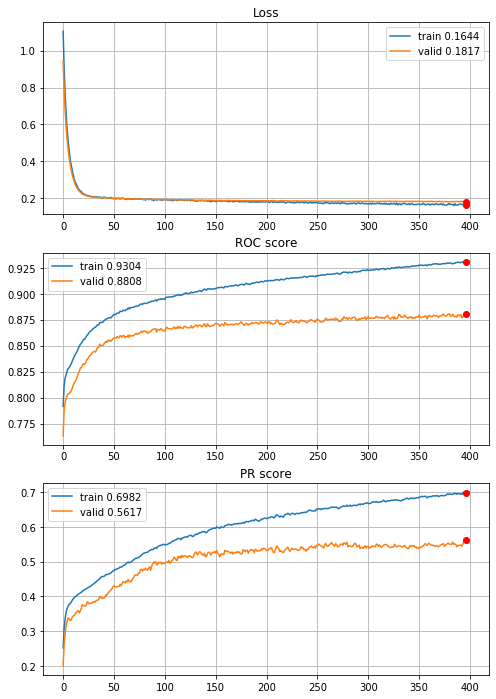


Fold 2------------------------------------------------------------


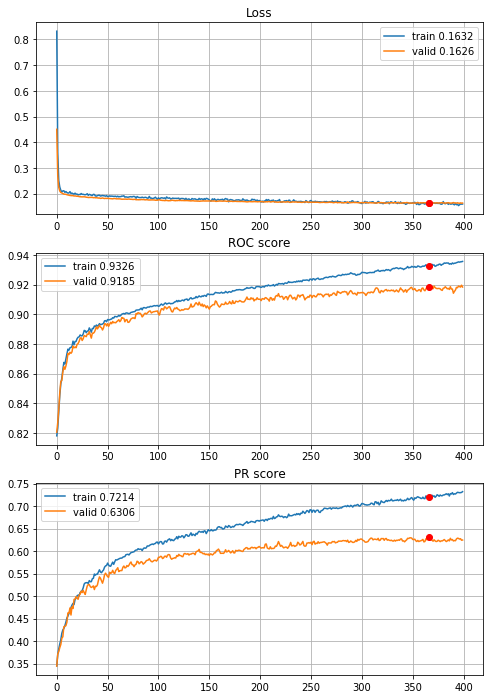


Fold 3------------------------------------------------------------


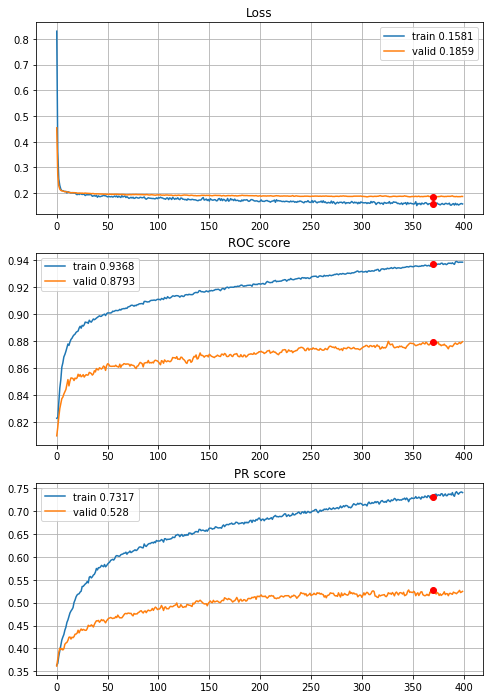


Fold 4------------------------------------------------------------


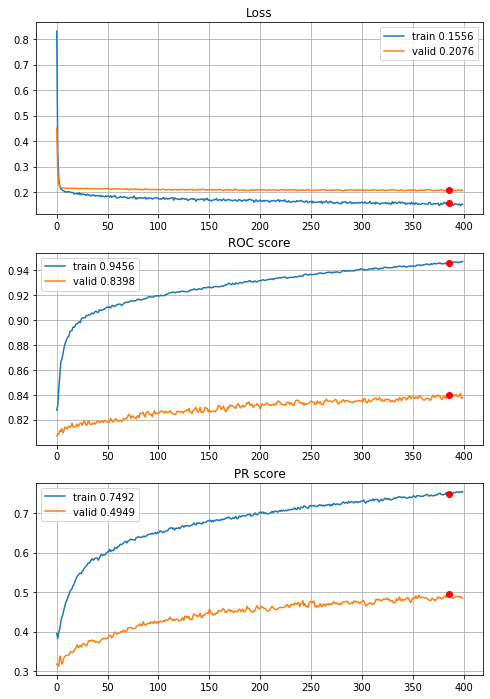


Fold 5------------------------------------------------------------


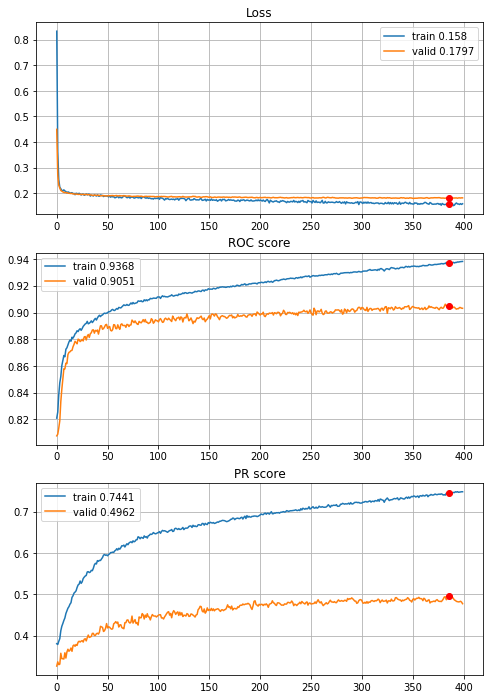


Fold 6------------------------------------------------------------


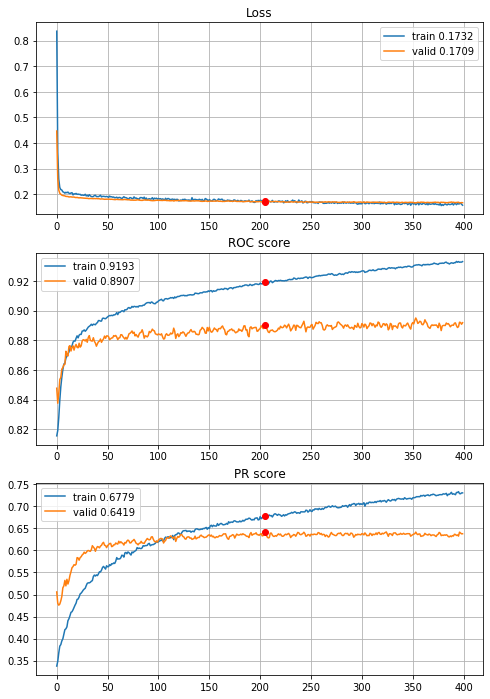

In [229]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,regularizers.l2(l=0.01)], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

0.005 L2


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/400,
cumulative time: 16.66s train loss: 0.8108787322517766, validation loss: 0.6785891065468515
Epoch: 2/400,
cumulative time: 16.76s train loss: 0.6586479003194867, validation loss: 0.5635739957332073
Epoch: 3/400,
cumulative time: 16.87s train loss: 0.5546116624229221, validation loss: 0.4837315648693377
Epoch: 4/400,
cumulative time: 16.95s train loss: 0.48486846456781624, validation loss: 0.42730892107747454
Epoch: 5/400,
cumulative time: 17.06s train loss: 0.4256906173047391, validation loss: 0.3859007548049445
Epoch: 6/400,
cumulative time: 17.16s train loss: 0.3902392876250434, validation loss: 0.354051938152367
Epoch: 7/400,
cumulative time: 17.25s train loss: 0.35891336353246917, validation loss: 0.3288952233154314
Epoch: 8/400,
cumulative time: 17.34s train loss: 0.3284583854142724, validation loss: 0.30831771484222326
Epoch: 9/400,
cumulative time: 17.43s train loss: 0.3118963939968214, v

Epoch: 77/400,
cumulative time: 23.58s train loss: 0.18945908518877916, validation loss: 0.18762357370022856
Epoch: 78/400,
cumulative time: 23.66s train loss: 0.18783894413241625, validation loss: 0.18724238840609017
Epoch: 79/400,
cumulative time: 23.74s train loss: 0.185407775336547, validation loss: 0.1875067381135775
Epoch: 80/400,
cumulative time: 23.84s train loss: 0.184111908333719, validation loss: 0.18717729759727014
Epoch: 81/400,
cumulative time: 23.92s train loss: 0.18505804764530503, validation loss: 0.18737042324854797
Epoch: 82/400,
cumulative time: 23.99s train loss: 0.18201118354628448, validation loss: 0.1881627336295643
Epoch: 83/400,
cumulative time: 24.09s train loss: 0.18573316362172043, validation loss: 0.1878923234165454
Epoch: 84/400,
cumulative time: 24.16s train loss: 0.18728713410156728, validation loss: 0.18809026116851754
Epoch: 85/400,
cumulative time: 24.24s train loss: 0.18431110394990832, validation loss: 0.18780782205612306
Epoch: 86/400,
cumulative 

Epoch: 155/400,
cumulative time: 30.52s train loss: 0.1770819168611823, validation loss: 0.18267398429226042
Epoch: 156/400,
cumulative time: 30.62s train loss: 0.17697915761640787, validation loss: 0.18243322320694047
Epoch: 157/400,
cumulative time: 30.7s train loss: 0.17746190821570396, validation loss: 0.18165508399821456
Epoch: 158/400,
cumulative time: 30.81s train loss: 0.17691234449455884, validation loss: 0.18141100779931735
Epoch: 159/400,
cumulative time: 30.89s train loss: 0.1785147751173818, validation loss: 0.18170900794067404
Epoch: 160/400,
cumulative time: 30.99s train loss: 0.17569051120793347, validation loss: 0.18052221611226155
Epoch: 161/400,
cumulative time: 31.09s train loss: 0.17721781337008363, validation loss: 0.18136603465007686
Epoch: 162/400,
cumulative time: 31.17s train loss: 0.17762476690315274, validation loss: 0.18229519700990587
Epoch: 163/400,
cumulative time: 31.27s train loss: 0.17392007428614778, validation loss: 0.18195462764451845
Epoch: 164/40

Epoch: 231/400,
cumulative time: 37.43s train loss: 0.1739518611359037, validation loss: 0.18024312925715055
Epoch: 232/400,
cumulative time: 37.51s train loss: 0.1706326665484518, validation loss: 0.179936981910111
Epoch: 233/400,
cumulative time: 37.61s train loss: 0.16571698997115938, validation loss: 0.1801281506206164
Epoch: 234/400,
cumulative time: 37.71s train loss: 0.1692629730604616, validation loss: 0.17926225000666926
Epoch: 235/400,
cumulative time: 37.8s train loss: 0.1687230035487818, validation loss: 0.1792775228905167
Epoch: 236/400,
cumulative time: 37.88s train loss: 0.1705736809205062, validation loss: 0.17945374182205995
Epoch: 237/400,
cumulative time: 37.99s train loss: 0.16852619393732035, validation loss: 0.17906676983752676
Epoch: 238/400,
cumulative time: 38.08s train loss: 0.16659301328758577, validation loss: 0.17965386634883643
Epoch: 239/400,
cumulative time: 38.19s train loss: 0.169341738426567, validation loss: 0.18008967580561439
Epoch: 240/400,
cumula

Epoch: 306/400,
cumulative time: 44.54s train loss: 0.16217067810817745, validation loss: 0.17784595232469522
Epoch: 307/400,
cumulative time: 44.63s train loss: 0.16095184381472935, validation loss: 0.17721002763126723
Epoch: 308/400,
cumulative time: 44.73s train loss: 0.1611804591579235, validation loss: 0.17681796978130146
Epoch: 309/400,
cumulative time: 44.84s train loss: 0.1623629627729151, validation loss: 0.17628196012879707
Epoch: 310/400,
cumulative time: 44.93s train loss: 0.16416003115959332, validation loss: 0.17684669515460294
Epoch: 311/400,
cumulative time: 45.03s train loss: 0.16210965273249558, validation loss: 0.17731496488429782
Epoch: 312/400,
cumulative time: 45.12s train loss: 0.1653857515748281, validation loss: 0.17743307809012585
Epoch: 313/400,
cumulative time: 45.23s train loss: 0.1606073271254555, validation loss: 0.17795198233514656
Epoch: 314/400,
cumulative time: 45.31s train loss: 0.16399222524291987, validation loss: 0.17848014592989994
Epoch: 315/400

Epoch: 383/400,
cumulative time: 51.79s train loss: 0.15637011244382024, validation loss: 0.1781470943935291
Epoch: 384/400,
cumulative time: 51.88s train loss: 0.15612906495626974, validation loss: 0.1774531079386912
Epoch: 385/400,
cumulative time: 51.97s train loss: 0.149592014698695, validation loss: 0.1777633310137096
Epoch: 386/400,
cumulative time: 52.07s train loss: 0.16214129577864916, validation loss: 0.1786580341106875
Epoch: 387/400,
cumulative time: 52.15s train loss: 0.152421160227878, validation loss: 0.17833603401127635
Epoch: 388/400,
cumulative time: 52.24s train loss: 0.15330839637223134, validation loss: 0.17930381828257572
Epoch: 389/400,
cumulative time: 52.34s train loss: 0.15230921536199882, validation loss: 0.1789195039965792
Epoch: 390/400,
cumulative time: 52.42s train loss: 0.15768957676009582, validation loss: 0.17863524334742492
Epoch: 391/400,
cumulative time: 52.52s train loss: 0.15875307777190467, validation loss: 0.1787975317595911
Epoch: 392/400,
cumu

Epoch: 58/400,
cumulative time: 21.74s train loss: 0.1810454612443163, validation loss: 0.17524348076731133
Epoch: 59/400,
cumulative time: 21.83s train loss: 0.182333491762784, validation loss: 0.17442206082510706
Epoch: 60/400,
cumulative time: 21.93s train loss: 0.18014011958392087, validation loss: 0.1735794585882744
Epoch: 61/400,
cumulative time: 22.04s train loss: 0.18208862427581735, validation loss: 0.17389402032032894
Epoch: 62/400,
cumulative time: 22.14s train loss: 0.1794622261951331, validation loss: 0.1736413550383612
Epoch: 63/400,
cumulative time: 22.24s train loss: 0.18216954102732968, validation loss: 0.17408509713754042
Epoch: 64/400,
cumulative time: 22.34s train loss: 0.1799617320137764, validation loss: 0.17356004976702114
Epoch: 65/400,
cumulative time: 22.44s train loss: 0.18231658913222032, validation loss: 0.17284516933066466
Epoch: 66/400,
cumulative time: 22.55s train loss: 0.18297837268466985, validation loss: 0.172733566756313
Epoch: 67/400,
cumulative ti

Epoch: 134/400,
cumulative time: 28.95s train loss: 0.1719997439109838, validation loss: 0.1673059029905745
Epoch: 135/400,
cumulative time: 29.03s train loss: 0.17107441752395905, validation loss: 0.16740583778771634
Epoch: 136/400,
cumulative time: 29.13s train loss: 0.17072614126364677, validation loss: 0.16691062025717443
Epoch: 137/400,
cumulative time: 29.23s train loss: 0.171788397282093, validation loss: 0.16614146176158642
Epoch: 138/400,
cumulative time: 29.32s train loss: 0.1693671118864783, validation loss: 0.16638991409721612
Epoch: 139/400,
cumulative time: 29.42s train loss: 0.16752907006399512, validation loss: 0.16591922636432604
Epoch: 140/400,
cumulative time: 29.52s train loss: 0.16782683821307623, validation loss: 0.16632068293272037
Epoch: 141/400,
cumulative time: 29.62s train loss: 0.17468804148587294, validation loss: 0.16558704929260418
Epoch: 142/400,
cumulative time: 29.7s train loss: 0.16955832734919196, validation loss: 0.16556103924014254
Epoch: 143/400,


Epoch: 209/400,
cumulative time: 35.99s train loss: 0.1680615016222269, validation loss: 0.16384635113070486
Epoch: 210/400,
cumulative time: 36.07s train loss: 0.16506887092809816, validation loss: 0.16380192519175024
Epoch: 211/400,
cumulative time: 36.17s train loss: 0.15992170038367437, validation loss: 0.1626228878133864
Epoch: 212/400,
cumulative time: 36.27s train loss: 0.1631721655101875, validation loss: 0.16267498941270986
Epoch: 213/400,
cumulative time: 36.35s train loss: 0.16434145477408751, validation loss: 0.16382679549857487
Epoch: 214/400,
cumulative time: 36.44s train loss: 0.16598622544268515, validation loss: 0.16475027199863984
Epoch: 215/400,
cumulative time: 36.54s train loss: 0.15890987226840392, validation loss: 0.16354721117651314
Epoch: 216/400,
cumulative time: 36.66s train loss: 0.16421549363122304, validation loss: 0.1626165338372969
Epoch: 217/400,
cumulative time: 36.74s train loss: 0.16156966506506884, validation loss: 0.16204622285409065
Epoch: 218/400

Epoch: 284/400,
cumulative time: 43.0s train loss: 0.15817252925802225, validation loss: 0.15945568915956318
Epoch: 285/400,
cumulative time: 43.09s train loss: 0.15966553874784536, validation loss: 0.15922541300668522
Epoch: 286/400,
cumulative time: 43.19s train loss: 0.156974025104289, validation loss: 0.15869650585742787
Epoch: 287/400,
cumulative time: 43.29s train loss: 0.15428856583749237, validation loss: 0.1625158222310304
Epoch: 288/400,
cumulative time: 43.38s train loss: 0.15513714461752115, validation loss: 0.1602108076869971
Epoch: 289/400,
cumulative time: 43.46s train loss: 0.15945007012558543, validation loss: 0.15961506650305385
Epoch: 290/400,
cumulative time: 43.57s train loss: 0.15699229294951964, validation loss: 0.15995350087811203
Epoch: 291/400,
cumulative time: 43.67s train loss: 0.1618921385022277, validation loss: 0.15961860399168265
Epoch: 292/400,
cumulative time: 43.75s train loss: 0.16508080758194738, validation loss: 0.15984827379161637
Epoch: 293/400,


Epoch: 361/400,
cumulative time: 50.2s train loss: 0.15336321487296575, validation loss: 0.15857790724669396
Epoch: 362/400,
cumulative time: 50.3s train loss: 0.15178300238244694, validation loss: 0.15845722078504262
Epoch: 363/400,
cumulative time: 50.4s train loss: 0.14988815242135461, validation loss: 0.15802877049435354
Epoch: 364/400,
cumulative time: 50.5s train loss: 0.1522821400899588, validation loss: 0.1587395480379311
Epoch: 365/400,
cumulative time: 50.6s train loss: 0.15553014582890465, validation loss: 0.15660908537693197
Epoch: 366/400,
cumulative time: 50.7s train loss: 0.14990609786759, validation loss: 0.15713318139146656
Epoch: 367/400,
cumulative time: 50.8s train loss: 0.15403479137979045, validation loss: 0.15693696927627823
Epoch: 368/400,
cumulative time: 50.89s train loss: 0.14693626474642904, validation loss: 0.15729065496461905
Epoch: 369/400,
cumulative time: 50.99s train loss: 0.15488784915233025, validation loss: 0.15740374180886227
Epoch: 370/400,
cumula

cumulative time: 20.5s train loss: 0.18741802558544957, validation loss: 0.19509105110517888
Epoch: 35/400,
cumulative time: 20.59s train loss: 0.1853778086912008, validation loss: 0.19373846534543
Epoch: 36/400,
cumulative time: 20.68s train loss: 0.17965074449723809, validation loss: 0.19491294946987706
Epoch: 37/400,
cumulative time: 20.78s train loss: 0.1816374041570438, validation loss: 0.19514366046954976
Epoch: 38/400,
cumulative time: 20.88s train loss: 0.18285283685698836, validation loss: 0.1929604305792285
Epoch: 39/400,
cumulative time: 20.97s train loss: 0.18120172826929642, validation loss: 0.19372287191022208
Epoch: 40/400,
cumulative time: 21.05s train loss: 0.1832447155556954, validation loss: 0.19389136345571972
Epoch: 41/400,
cumulative time: 21.15s train loss: 0.1767885999464924, validation loss: 0.19352124819559335
Epoch: 42/400,
cumulative time: 21.25s train loss: 0.18143817143252502, validation loss: 0.19360085861524304
Epoch: 43/400,
cumulative time: 21.34s trai

Epoch: 111/400,
cumulative time: 27.68s train loss: 0.1672857143959898, validation loss: 0.1895910287118415
Epoch: 112/400,
cumulative time: 27.77s train loss: 0.173264238969944, validation loss: 0.18944960456286908
Epoch: 113/400,
cumulative time: 27.85s train loss: 0.17143078241833495, validation loss: 0.18988685380444856
Epoch: 114/400,
cumulative time: 27.96s train loss: 0.16710033698767315, validation loss: 0.1897750624708554
Epoch: 115/400,
cumulative time: 28.06s train loss: 0.17589195718861014, validation loss: 0.18857712240673374
Epoch: 116/400,
cumulative time: 28.16s train loss: 0.17228614322383912, validation loss: 0.188106661097576
Epoch: 117/400,
cumulative time: 28.25s train loss: 0.16857762040994012, validation loss: 0.18822296607185243
Epoch: 118/400,
cumulative time: 28.33s train loss: 0.1719978281132043, validation loss: 0.18883487345333702
Epoch: 119/400,
cumulative time: 28.45s train loss: 0.17053540567077347, validation loss: 0.18793739113860092
Epoch: 120/400,
cu

cumulative time: 34.82s train loss: 0.16558291906632133, validation loss: 0.18828634562426516
Epoch: 188/400,
cumulative time: 34.92s train loss: 0.1665199596286896, validation loss: 0.18848874385488612
Epoch: 189/400,
cumulative time: 35.02s train loss: 0.1606241801235865, validation loss: 0.18745937782183306
Epoch: 190/400,
cumulative time: 35.12s train loss: 0.1599771702218303, validation loss: 0.18758319334254056
Epoch: 191/400,
cumulative time: 35.21s train loss: 0.16114694512842578, validation loss: 0.18762957795261664
Epoch: 192/400,
cumulative time: 35.31s train loss: 0.16659439216949556, validation loss: 0.18778095568247818
Epoch: 193/400,
cumulative time: 35.41s train loss: 0.16565843308109132, validation loss: 0.18793431161288612
Epoch: 194/400,
cumulative time: 35.51s train loss: 0.16496325231792694, validation loss: 0.18811104783479632
Epoch: 195/400,
cumulative time: 35.59s train loss: 0.16345483610668768, validation loss: 0.18705079394572213
Epoch: 196/400,
cumulative ti

Epoch: 263/400,
cumulative time: 42.08s train loss: 0.16023035395877025, validation loss: 0.18619357092303918
Epoch: 264/400,
cumulative time: 42.17s train loss: 0.155383851069836, validation loss: 0.1860186217821034
Epoch: 265/400,
cumulative time: 42.25s train loss: 0.1592847706568478, validation loss: 0.18665365712652077
Epoch: 266/400,
cumulative time: 42.35s train loss: 0.15487373950101085, validation loss: 0.1871035600326779
Epoch: 267/400,
cumulative time: 42.45s train loss: 0.15249807005983504, validation loss: 0.18626133962340125
Epoch: 268/400,
cumulative time: 42.55s train loss: 0.1560644712231865, validation loss: 0.1864168335680494
Epoch: 269/400,
cumulative time: 42.64s train loss: 0.15525595559351926, validation loss: 0.18614054028587385
Epoch: 270/400,
cumulative time: 42.73s train loss: 0.1530834597431204, validation loss: 0.1856763604209415
Epoch: 271/400,
cumulative time: 42.83s train loss: 0.16177993063018103, validation loss: 0.1856674014883622
Epoch: 272/400,
cumu

cumulative time: 49.34s train loss: 0.15319466861200245, validation loss: 0.1860417335503131
Epoch: 341/400,
cumulative time: 49.42s train loss: 0.14553741286996255, validation loss: 0.18642907320041935
Epoch: 342/400,
cumulative time: 49.51s train loss: 0.15335717572349827, validation loss: 0.18656895265167972
Epoch: 343/400,
cumulative time: 49.61s train loss: 0.15236827073491008, validation loss: 0.1879798366510747
Epoch: 344/400,
cumulative time: 49.7s train loss: 0.15294740732342327, validation loss: 0.18672137922505516
Epoch: 345/400,
cumulative time: 49.79s train loss: 0.14729793996479537, validation loss: 0.1875897592275898
Epoch: 346/400,
cumulative time: 49.9s train loss: 0.1532661653584414, validation loss: 0.18568576575837517
Epoch: 347/400,
cumulative time: 49.97s train loss: 0.14911446853167637, validation loss: 0.18426133749382875
Epoch: 348/400,
cumulative time: 50.06s train loss: 0.15130834274720198, validation loss: 0.1843206565638137
Epoch: 349/400,
cumulative time: 

Epoch: 14/400,
cumulative time: 16.23s train loss: 0.193070939723751, validation loss: 0.21327473085297957
Epoch: 15/400,
cumulative time: 16.31s train loss: 0.19114682895521964, validation loss: 0.2122025906232356
Epoch: 16/400,
cumulative time: 16.41s train loss: 0.19037484328713988, validation loss: 0.21152516224045248
Epoch: 17/400,
cumulative time: 16.51s train loss: 0.1903180870868916, validation loss: 0.21268807600502504
Epoch: 18/400,
cumulative time: 16.59s train loss: 0.18572050600255716, validation loss: 0.21277752283195342
Epoch: 19/400,
cumulative time: 16.69s train loss: 0.18578438456793173, validation loss: 0.21204689134997115
Epoch: 20/400,
cumulative time: 16.79s train loss: 0.18536628321226634, validation loss: 0.2119312895878174
Epoch: 21/400,
cumulative time: 16.89s train loss: 0.18846922286296844, validation loss: 0.2110586835756797
Epoch: 22/400,
cumulative time: 16.99s train loss: 0.1836063164873933, validation loss: 0.21209264228763752
Epoch: 23/400,
cumulative 

Epoch: 90/400,
cumulative time: 23.25s train loss: 0.16910762763873144, validation loss: 0.20796800544380334
Epoch: 91/400,
cumulative time: 23.34s train loss: 0.16690301540344046, validation loss: 0.20877648324917994
Epoch: 92/400,
cumulative time: 23.44s train loss: 0.17004753852264354, validation loss: 0.20852072372124372
Epoch: 93/400,
cumulative time: 23.54s train loss: 0.17010296127905353, validation loss: 0.20758393628871738
Epoch: 94/400,
cumulative time: 23.62s train loss: 0.16860633583295273, validation loss: 0.20722041354760629
Epoch: 95/400,
cumulative time: 23.72s train loss: 0.16476588153540617, validation loss: 0.20829960586120527
Epoch: 96/400,
cumulative time: 23.82s train loss: 0.16657087047509353, validation loss: 0.20761795281422057
Epoch: 97/400,
cumulative time: 23.92s train loss: 0.16768238349266631, validation loss: 0.20737465169978733
Epoch: 98/400,
cumulative time: 24.02s train loss: 0.16852264166443015, validation loss: 0.20782988839709193
Epoch: 99/400,
cumu

cumulative time: 30.32s train loss: 0.1656461136418542, validation loss: 0.20461997386429703
Epoch: 166/400,
cumulative time: 30.42s train loss: 0.1605600379953636, validation loss: 0.20582395603640624
Epoch: 167/400,
cumulative time: 30.51s train loss: 0.15793151163890834, validation loss: 0.20661398906336412
Epoch: 168/400,
cumulative time: 30.6s train loss: 0.16076806286791498, validation loss: 0.20766016171559792
Epoch: 169/400,
cumulative time: 30.69s train loss: 0.160948660124674, validation loss: 0.2068098287011915
Epoch: 170/400,
cumulative time: 30.78s train loss: 0.1625623135343648, validation loss: 0.2071707816142799
Epoch: 171/400,
cumulative time: 30.87s train loss: 0.16192199308958813, validation loss: 0.20600318303226617
Epoch: 172/400,
cumulative time: 30.94s train loss: 0.15749296857921852, validation loss: 0.20743462066618099
Epoch: 173/400,
cumulative time: 31.04s train loss: 0.1613000123960128, validation loss: 0.20599889119510995
Epoch: 174/400,
cumulative time: 31

Epoch: 241/400,
cumulative time: 37.56s train loss: 0.15830779522186797, validation loss: 0.2057193814362683
Epoch: 242/400,
cumulative time: 37.65s train loss: 0.15577542076940706, validation loss: 0.20587664859424057
Epoch: 243/400,
cumulative time: 37.75s train loss: 0.156553114960405, validation loss: 0.20587517613751086
Epoch: 244/400,
cumulative time: 37.85s train loss: 0.15219283863623095, validation loss: 0.2055851900887005
Epoch: 245/400,
cumulative time: 37.95s train loss: 0.1534571321788287, validation loss: 0.2052005501148663
Epoch: 246/400,
cumulative time: 38.05s train loss: 0.15660375152300046, validation loss: 0.2060409785662494
Epoch: 247/400,
cumulative time: 38.14s train loss: 0.1561148850738451, validation loss: 0.20682991768651837
Epoch: 248/400,
cumulative time: 38.24s train loss: 0.1487296938344907, validation loss: 0.20857802894529856
Epoch: 249/400,
cumulative time: 38.34s train loss: 0.1501107232217834, validation loss: 0.20683107190422764
Epoch: 250/400,
cumu

Epoch: 319/400,
cumulative time: 44.99s train loss: 0.14449217075516885, validation loss: 0.20689256950102863
Epoch: 320/400,
cumulative time: 45.06s train loss: 0.14759040430957943, validation loss: 0.207408956964721
Epoch: 321/400,
cumulative time: 45.16s train loss: 0.14783062730904709, validation loss: 0.20819149060389258
Epoch: 322/400,
cumulative time: 45.27s train loss: 0.14664802193211401, validation loss: 0.20759551365004167
Epoch: 323/400,
cumulative time: 45.35s train loss: 0.14670549914284536, validation loss: 0.20788215437134555
Epoch: 324/400,
cumulative time: 45.46s train loss: 0.15045817828651692, validation loss: 0.2062796533915044
Epoch: 325/400,
cumulative time: 45.55s train loss: 0.14603768114967808, validation loss: 0.20725691833157034
Epoch: 326/400,
cumulative time: 45.64s train loss: 0.14912643005112183, validation loss: 0.2068137778452772
Epoch: 327/400,
cumulative time: 45.72s train loss: 0.1468898992798088, validation loss: 0.20775850907674492
Epoch: 328/400,

cumulative time: 52.32s train loss: 0.14131780325721033, validation loss: 0.2076883691091839
Epoch: 396/400,
cumulative time: 52.42s train loss: 0.1389922068218816, validation loss: 0.20931031879533762
Epoch: 397/400,
cumulative time: 52.52s train loss: 0.14269268919457276, validation loss: 0.20762448167558717
Epoch: 398/400,
cumulative time: 52.62s train loss: 0.13947098416303796, validation loss: 0.20603600914672052
Epoch: 399/400,
cumulative time: 52.72s train loss: 0.14348212522495526, validation loss: 0.20770271933105675
Epoch: 400/400,
cumulative time: 52.82s train loss: 0.14062821856678245, validation loss: 0.20672233981284277

Early stopping results:
best results in epoch: 342, 
best valid PR: 0.4898911433154917, 
valid ROC: 0.8444709388971684        
overfitting PR: 0.2900325778615091, 
overfitting ROC: 0.10710167031180451

----------
Fold: 5
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/400,
cumulative time: 17.53s train loss: 0.6157686643667154, validati

Epoch: 144/400,
cumulative time: 31.36s train loss: 0.16417279761866954, validation loss: 0.18193578925278062
Epoch: 145/400,
cumulative time: 31.46s train loss: 0.16485073337423434, validation loss: 0.1832747307036316
Epoch: 146/400,
cumulative time: 31.53s train loss: 0.16595169155613285, validation loss: 0.18311362691711358
Epoch: 147/400,
cumulative time: 31.63s train loss: 0.16866848913428747, validation loss: 0.1843950607841225
Epoch: 148/400,
cumulative time: 31.73s train loss: 0.16091482816930014, validation loss: 0.18461560392352852
Epoch: 149/400,
cumulative time: 31.84s train loss: 0.16734120963377042, validation loss: 0.18331631954179123
Epoch: 150/400,
cumulative time: 31.94s train loss: 0.16331406233140208, validation loss: 0.1824231098319822
Epoch: 151/400,
cumulative time: 32.04s train loss: 0.16499866304186755, validation loss: 0.181397001811936
Epoch: 152/400,
cumulative time: 32.14s train loss: 0.16431315323582035, validation loss: 0.1832990955149347
Epoch: 153/400,


Epoch: 220/400,
cumulative time: 38.66s train loss: 0.15501314254732668, validation loss: 0.18151361594485377
Epoch: 221/400,
cumulative time: 38.76s train loss: 0.16121739647591757, validation loss: 0.18257832241246716
Epoch: 222/400,
cumulative time: 38.85s train loss: 0.1591930469893425, validation loss: 0.1815368934759437
Epoch: 223/400,
cumulative time: 38.95s train loss: 0.1615815828219241, validation loss: 0.18082124748294565
Epoch: 224/400,
cumulative time: 39.05s train loss: 0.1607804615920321, validation loss: 0.17993893832573774
Epoch: 225/400,
cumulative time: 39.15s train loss: 0.15872689280570723, validation loss: 0.17906736146919344
Epoch: 226/400,
cumulative time: 39.23s train loss: 0.15779924694891576, validation loss: 0.1791947632355292
Epoch: 227/400,
cumulative time: 39.32s train loss: 0.15359345758482965, validation loss: 0.1799303240418165
Epoch: 228/400,
cumulative time: 39.43s train loss: 0.15851458075512834, validation loss: 0.17919405951725978
Epoch: 229/400,


Epoch: 295/400,
cumulative time: 45.9s train loss: 0.15464561598149804, validation loss: 0.18096979322336598
Epoch: 296/400,
cumulative time: 46.0s train loss: 0.15327451749039428, validation loss: 0.18132493791273432
Epoch: 297/400,
cumulative time: 46.1s train loss: 0.1593355656026476, validation loss: 0.1800324845192933
Epoch: 298/400,
cumulative time: 46.18s train loss: 0.14616766108291132, validation loss: 0.18002914464096992
Epoch: 299/400,
cumulative time: 46.29s train loss: 0.15765387422877672, validation loss: 0.17923859976080686
Epoch: 300/400,
cumulative time: 46.38s train loss: 0.15721792653589572, validation loss: 0.17973542452262165
Epoch: 301/400,
cumulative time: 46.49s train loss: 0.1535841330579998, validation loss: 0.17937593441246324
Epoch: 302/400,
cumulative time: 46.59s train loss: 0.1519072567020935, validation loss: 0.18049850551995952
Epoch: 303/400,
cumulative time: 46.68s train loss: 0.1559255771959121, validation loss: 0.18129696298399037
Epoch: 304/400,
cu

cumulative time: 53.03s train loss: 0.14764326749995146, validation loss: 0.18058272513390664
Epoch: 371/400,
cumulative time: 53.13s train loss: 0.14780425484706713, validation loss: 0.18046638766476047
Epoch: 372/400,
cumulative time: 53.22s train loss: 0.14731674691287813, validation loss: 0.18134157510966264
Epoch: 373/400,
cumulative time: 53.32s train loss: 0.14771030831492946, validation loss: 0.1816901420968381
Epoch: 374/400,
cumulative time: 53.4s train loss: 0.14630236407246516, validation loss: 0.18182336147159808
Epoch: 375/400,
cumulative time: 53.5s train loss: 0.15172617095078245, validation loss: 0.18152927612343436
Epoch: 376/400,
cumulative time: 53.6s train loss: 0.15055151165755262, validation loss: 0.18182974619870798
Epoch: 377/400,
cumulative time: 53.7s train loss: 0.14663121579208627, validation loss: 0.18227819270931572
Epoch: 378/400,
cumulative time: 53.8s train loss: 0.15255912343414488, validation loss: 0.1812784231475998
Epoch: 379/400,
cumulative time: 

cumulative time: 21.49s train loss: 0.18553326321783006, validation loss: 0.17806474272472864
Epoch: 44/400,
cumulative time: 21.58s train loss: 0.18819374829604668, validation loss: 0.1768523437511302
Epoch: 45/400,
cumulative time: 21.67s train loss: 0.1825550303901799, validation loss: 0.17776587131195629
Epoch: 46/400,
cumulative time: 21.77s train loss: 0.18438402501987652, validation loss: 0.17809639369930155
Epoch: 47/400,
cumulative time: 21.87s train loss: 0.18481878406363364, validation loss: 0.17709219253897399
Epoch: 48/400,
cumulative time: 21.97s train loss: 0.1845554256382737, validation loss: 0.17638964577668406
Epoch: 49/400,
cumulative time: 22.05s train loss: 0.18369985522251486, validation loss: 0.17660925512120093
Epoch: 50/400,
cumulative time: 22.16s train loss: 0.18452192458750405, validation loss: 0.17746078722498487
Epoch: 51/400,
cumulative time: 22.25s train loss: 0.18284633086425792, validation loss: 0.17736572064207046
Epoch: 52/400,
cumulative time: 22.35

cumulative time: 28.76s train loss: 0.17314585385528558, validation loss: 0.17349739978195045
Epoch: 121/400,
cumulative time: 28.85s train loss: 0.1670703017198015, validation loss: 0.17443791149566729
Epoch: 122/400,
cumulative time: 28.95s train loss: 0.16831652524809845, validation loss: 0.1731571331788401
Epoch: 123/400,
cumulative time: 29.04s train loss: 0.1713896906660933, validation loss: 0.1719277719073586
Epoch: 124/400,
cumulative time: 29.14s train loss: 0.16978975328115317, validation loss: 0.17269661127848226
Epoch: 125/400,
cumulative time: 29.23s train loss: 0.1723130172366029, validation loss: 0.17317632462989127
Epoch: 126/400,
cumulative time: 29.31s train loss: 0.1707114738607794, validation loss: 0.17264752227888688
Epoch: 127/400,
cumulative time: 29.41s train loss: 0.1728858199199973, validation loss: 0.17295531225527383
Epoch: 128/400,
cumulative time: 29.51s train loss: 0.16980872854351756, validation loss: 0.17331462657882182
Epoch: 129/400,
cumulative time: 

Epoch: 197/400,
cumulative time: 36.08s train loss: 0.16769068617060254, validation loss: 0.16984794011368978
Epoch: 198/400,
cumulative time: 36.17s train loss: 0.16223204221274765, validation loss: 0.17173292593816064
Epoch: 199/400,
cumulative time: 36.27s train loss: 0.1671581692386905, validation loss: 0.17027698073780026
Epoch: 200/400,
cumulative time: 36.37s train loss: 0.16795191355175662, validation loss: 0.1703085268996908
Epoch: 201/400,
cumulative time: 36.47s train loss: 0.16967250903559516, validation loss: 0.1714785377543344
Epoch: 202/400,
cumulative time: 36.57s train loss: 0.16839219413289308, validation loss: 0.16876788652642855
Epoch: 203/400,
cumulative time: 36.65s train loss: 0.1618734907342918, validation loss: 0.17038106030319938
Epoch: 204/400,
cumulative time: 36.76s train loss: 0.16498826897940302, validation loss: 0.1702807846712474
Epoch: 205/400,
cumulative time: 36.86s train loss: 0.16571234409316463, validation loss: 0.16958924583064783
Epoch: 206/400,

Epoch: 273/400,
cumulative time: 43.39s train loss: 0.15925167998966663, validation loss: 0.16987058025854165
Epoch: 274/400,
cumulative time: 43.49s train loss: 0.15726932722586906, validation loss: 0.1700197872674223
Epoch: 275/400,
cumulative time: 43.59s train loss: 0.15922715806501217, validation loss: 0.1694953584576837
Epoch: 276/400,
cumulative time: 43.68s train loss: 0.15901849824097364, validation loss: 0.16849637273741092
Epoch: 277/400,
cumulative time: 43.77s train loss: 0.1562870195466994, validation loss: 0.16840177091599587
Epoch: 278/400,
cumulative time: 43.87s train loss: 0.1567828605981355, validation loss: 0.16768743128055374
Epoch: 279/400,
cumulative time: 43.97s train loss: 0.15650286038418587, validation loss: 0.16807470630442317
Epoch: 280/400,
cumulative time: 44.07s train loss: 0.15821854615054173, validation loss: 0.1673029439174833
Epoch: 281/400,
cumulative time: 44.17s train loss: 0.1560924268255593, validation loss: 0.16772747147433106
Epoch: 282/400,


cumulative time: 50.8s train loss: 0.1546631130977487, validation loss: 0.16732564507973113
Epoch: 351/400,
cumulative time: 50.88s train loss: 0.15675049525753468, validation loss: 0.16748667156857777
Epoch: 352/400,
cumulative time: 50.99s train loss: 0.15322788876535767, validation loss: 0.16662253103057095
Epoch: 353/400,
cumulative time: 51.09s train loss: 0.15588866188675132, validation loss: 0.1658283379223223
Epoch: 354/400,
cumulative time: 51.19s train loss: 0.14867886635686, validation loss: 0.165370888856679
Epoch: 355/400,
cumulative time: 51.28s train loss: 0.15324352285157686, validation loss: 0.1664236328537254
Epoch: 356/400,
cumulative time: 51.38s train loss: 0.1587304016779003, validation loss: 0.16776577082229252
Epoch: 357/400,
cumulative time: 51.47s train loss: 0.14890688370359473, validation loss: 0.16710221488238997
Epoch: 358/400,
cumulative time: 51.57s train loss: 0.1567122341277985, validation loss: 0.16674559706355324
Epoch: 359/400,
cumulative time: 51.6

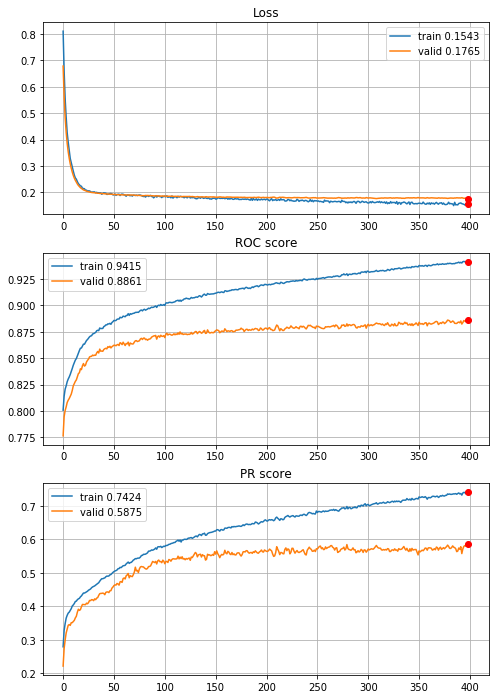


Fold 2------------------------------------------------------------


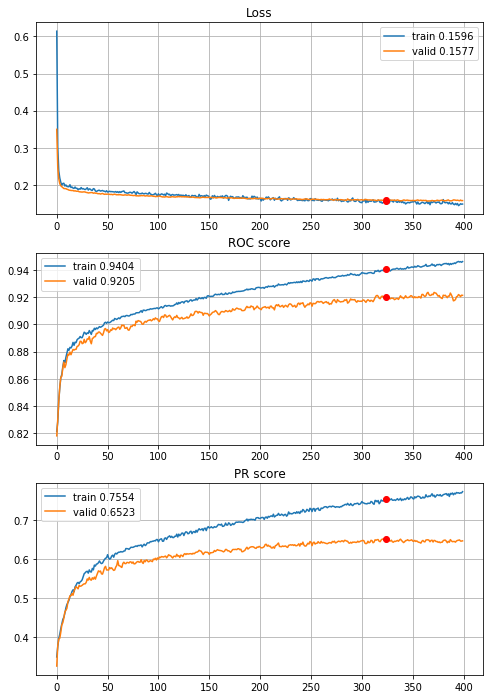


Fold 3------------------------------------------------------------


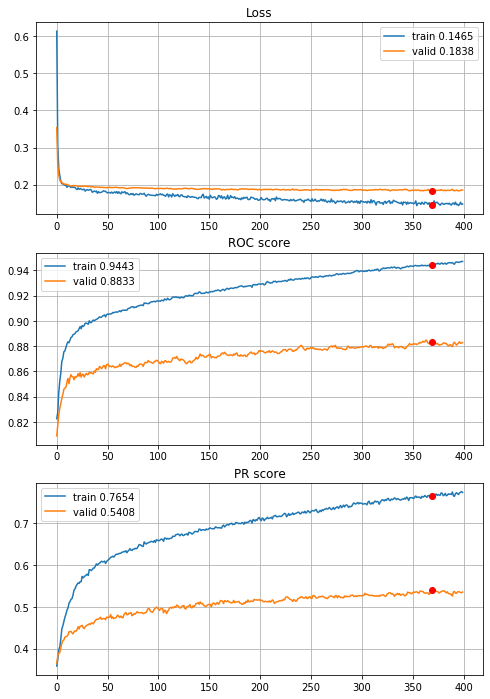


Fold 4------------------------------------------------------------


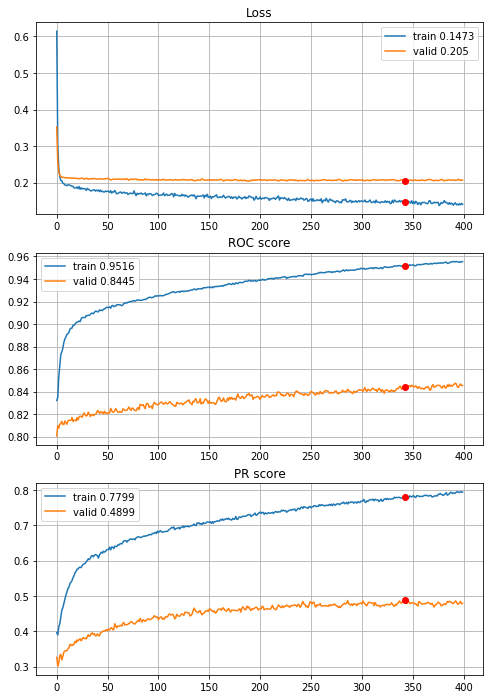


Fold 5------------------------------------------------------------


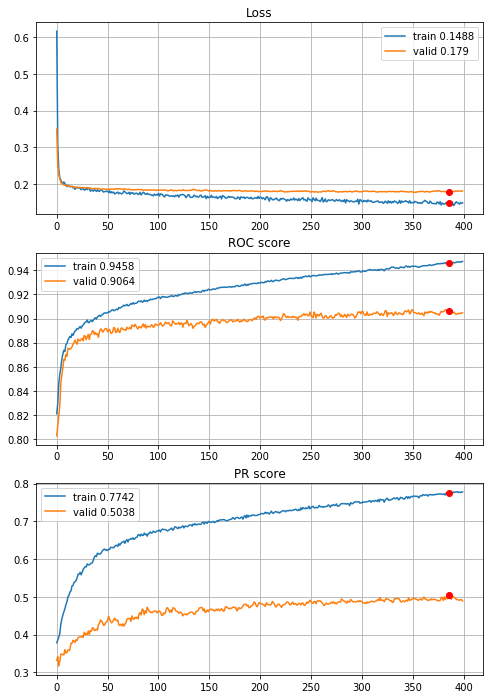


Fold 6------------------------------------------------------------


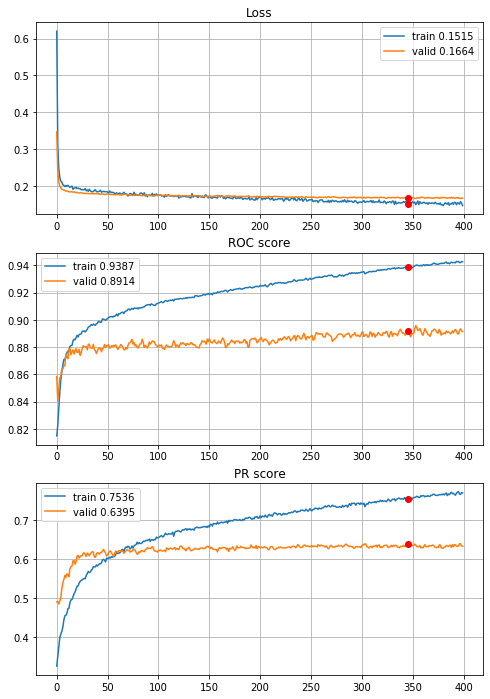

In [230]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,regularizers.l2(l=0.005)], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

L1 0.0005 on two layers


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/400,
cumulative time: 15.55s train loss: 0.9129186893951161, validation loss: 0.7896367927683515
Epoch: 2/400,
cumulative time: 15.65s train loss: 0.7763648533433783, validation loss: 0.6881928887415631
Epoch: 3/400,
cumulative time: 15.77s train loss: 0.6843023911548866, validation loss: 0.6180304885582564
Epoch: 4/400,
cumulative time: 15.87s train loss: 0.6227589189091745, validation loss: 0.5680078391695507
Epoch: 5/400,
cumulative time: 15.95s train loss: 0.5689772947385423, validation loss: 0.5300996934547768
Epoch: 6/400,
cumulative time: 16.04s train loss: 0.5368918523542072, validation loss: 0.4993825105964936
Epoch: 7/400,
cumulative time: 16.12s train loss: 0.5049698182418674, validation loss: 0.4732738226282556
Epoch: 8/400,
cumulative time: 16.21s train loss: 0.47357026396137714, validation loss: 0.45012652188573105
Epoch: 9/400,
cumulative time: 16.3s train loss: 0.4539918031018994, val

Epoch: 78/400,
cumulative time: 22.83s train loss: 0.23141181926219473, validation loss: 0.2203224667063426
Epoch: 79/400,
cumulative time: 22.91s train loss: 0.22849324570854432, validation loss: 0.22001515861428442
Epoch: 80/400,
cumulative time: 22.99s train loss: 0.2291995508710615, validation loss: 0.2197721916363231
Epoch: 81/400,
cumulative time: 23.1s train loss: 0.22687180773338256, validation loss: 0.219572138137855
Epoch: 82/400,
cumulative time: 23.18s train loss: 0.2248215517197275, validation loss: 0.21997916170951345
Epoch: 83/400,
cumulative time: 23.26s train loss: 0.22637833769194485, validation loss: 0.21963742734883254
Epoch: 84/400,
cumulative time: 23.36s train loss: 0.22692295711904442, validation loss: 0.21974654623392334
Epoch: 85/400,
cumulative time: 23.45s train loss: 0.22452758034751732, validation loss: 0.21925958668500217
Epoch: 86/400,
cumulative time: 23.55s train loss: 0.22739104989795048, validation loss: 0.2186368760288501
Epoch: 87/400,
cumulative t

cumulative time: 30.05s train loss: 0.2225271084611489, validation loss: 0.212643951043201
Epoch: 155/400,
cumulative time: 30.15s train loss: 0.2199987308643355, validation loss: 0.21263545141749612
Epoch: 156/400,
cumulative time: 30.22s train loss: 0.21890241159159785, validation loss: 0.21231249871893693
Epoch: 157/400,
cumulative time: 30.33s train loss: 0.2172688779350545, validation loss: 0.21174249212596705
Epoch: 158/400,
cumulative time: 30.42s train loss: 0.22201577204175374, validation loss: 0.2120360460934537
Epoch: 159/400,
cumulative time: 30.51s train loss: 0.2232787321298131, validation loss: 0.21259905987554634
Epoch: 160/400,
cumulative time: 30.61s train loss: 0.2214544270026232, validation loss: 0.21166729916983285
Epoch: 161/400,
cumulative time: 30.71s train loss: 0.22305569173062106, validation loss: 0.21213146726671173
Epoch: 162/400,
cumulative time: 30.8s train loss: 0.22237396303443271, validation loss: 0.2129906082301156
Epoch: 163/400,
cumulative time: 30.

cumulative time: 37.39s train loss: 0.21770427786889704, validation loss: 0.20916031877244606
Epoch: 231/400,
cumulative time: 37.48s train loss: 0.21814087426646306, validation loss: 0.20957767829013382
Epoch: 232/400,
cumulative time: 37.57s train loss: 0.21638977709175877, validation loss: 0.20981781779375797
Epoch: 233/400,
cumulative time: 37.66s train loss: 0.21798526708857033, validation loss: 0.2102759130038699
Epoch: 234/400,
cumulative time: 37.76s train loss: 0.2171298681963437, validation loss: 0.20926215177928983
Epoch: 235/400,
cumulative time: 37.86s train loss: 0.21610163663940954, validation loss: 0.20948402343366165
Epoch: 236/400,
cumulative time: 37.95s train loss: 0.21731749170254713, validation loss: 0.20962343700104125
Epoch: 237/400,
cumulative time: 38.06s train loss: 0.217144786679465, validation loss: 0.20941450484642987
Epoch: 238/400,
cumulative time: 38.15s train loss: 0.21710505542960623, validation loss: 0.2086467168040851
Epoch: 239/400,
cumulative time

cumulative time: 44.83s train loss: 0.21560290048994957, validation loss: 0.20618853476969473
Epoch: 308/400,
cumulative time: 44.93s train loss: 0.21340345978629288, validation loss: 0.20627446620480452
Epoch: 309/400,
cumulative time: 45.03s train loss: 0.2141058443430206, validation loss: 0.2055952940409186
Epoch: 310/400,
cumulative time: 45.13s train loss: 0.21615739252135857, validation loss: 0.20585290985150428
Epoch: 311/400,
cumulative time: 45.23s train loss: 0.21500413379352876, validation loss: 0.2066187186097346
Epoch: 312/400,
cumulative time: 45.33s train loss: 0.21811313333413446, validation loss: 0.20666866295098452
Epoch: 313/400,
cumulative time: 45.41s train loss: 0.2152403185836675, validation loss: 0.20711814169483228
Epoch: 314/400,
cumulative time: 45.52s train loss: 0.21231967025177573, validation loss: 0.20709399447231444
Epoch: 315/400,
cumulative time: 45.62s train loss: 0.2148046288908281, validation loss: 0.2066884858632437
Epoch: 316/400,
cumulative time:

Epoch: 384/400,
cumulative time: 52.37s train loss: 0.21210177815670572, validation loss: 0.20453606789517967
Epoch: 385/400,
cumulative time: 52.46s train loss: 0.20893995461830808, validation loss: 0.20461004750704415
Epoch: 386/400,
cumulative time: 52.56s train loss: 0.21664408912431676, validation loss: 0.2045195520663342
Epoch: 387/400,
cumulative time: 52.65s train loss: 0.21097647994487725, validation loss: 0.20453372165947112
Epoch: 388/400,
cumulative time: 52.75s train loss: 0.21217119337365514, validation loss: 0.20465506127748845
Epoch: 389/400,
cumulative time: 52.86s train loss: 0.21192907209807355, validation loss: 0.20491513220137647
Epoch: 390/400,
cumulative time: 52.95s train loss: 0.21185477084012883, validation loss: 0.20550363130338298
Epoch: 391/400,
cumulative time: 53.05s train loss: 0.21703834114226409, validation loss: 0.20520827684891668
Epoch: 392/400,
cumulative time: 53.14s train loss: 0.2131879880607451, validation loss: 0.20513927812237617
Epoch: 393/4

Epoch: 58/400,
cumulative time: 24.6s train loss: 0.22668265543931873, validation loss: 0.20760401613010762
Epoch: 59/400,
cumulative time: 24.69s train loss: 0.2269193555433505, validation loss: 0.20704541213415656
Epoch: 60/400,
cumulative time: 24.79s train loss: 0.2231886422443153, validation loss: 0.20606173047420004
Epoch: 61/400,
cumulative time: 24.89s train loss: 0.22504450562359624, validation loss: 0.20650022371914636
Epoch: 62/400,
cumulative time: 24.99s train loss: 0.22381112053452415, validation loss: 0.20677597800599412
Epoch: 63/400,
cumulative time: 25.07s train loss: 0.21999153498869511, validation loss: 0.20629771930725221
Epoch: 64/400,
cumulative time: 25.17s train loss: 0.2233739905664529, validation loss: 0.20552031445530114
Epoch: 65/400,
cumulative time: 25.27s train loss: 0.22517624108073728, validation loss: 0.20541150335394678
Epoch: 66/400,
cumulative time: 25.37s train loss: 0.22484623276988305, validation loss: 0.20510221538979145
Epoch: 67/400,
cumulati

Epoch: 134/400,
cumulative time: 32.05s train loss: 0.22256554683354357, validation loss: 0.19914691494578304
Epoch: 135/400,
cumulative time: 32.14s train loss: 0.21785857837768238, validation loss: 0.19926621416308565
Epoch: 136/400,
cumulative time: 32.25s train loss: 0.22018731658478075, validation loss: 0.19935321740663306
Epoch: 137/400,
cumulative time: 32.34s train loss: 0.21558560457900974, validation loss: 0.19941755168333128
Epoch: 138/400,
cumulative time: 32.42s train loss: 0.21554052207067556, validation loss: 0.1993142126344371
Epoch: 139/400,
cumulative time: 32.52s train loss: 0.2176688478970463, validation loss: 0.19928545077261017
Epoch: 140/400,
cumulative time: 32.63s train loss: 0.21770912073283635, validation loss: 0.1992974750857208
Epoch: 141/400,
cumulative time: 32.73s train loss: 0.2189452112568307, validation loss: 0.19903035102393205
Epoch: 142/400,
cumulative time: 32.82s train loss: 0.21805896471499966, validation loss: 0.1990729716376495
Epoch: 143/400,

cumulative time: 39.37s train loss: 0.2191576296833448, validation loss: 0.19714139238957487
Epoch: 210/400,
cumulative time: 39.46s train loss: 0.21586202926906867, validation loss: 0.19673315103857736
Epoch: 211/400,
cumulative time: 39.55s train loss: 0.21228902772176567, validation loss: 0.1964328738082759
Epoch: 212/400,
cumulative time: 39.65s train loss: 0.21124094375661348, validation loss: 0.19681673773313454
Epoch: 213/400,
cumulative time: 39.75s train loss: 0.21644931182345975, validation loss: 0.1972428477435397
Epoch: 214/400,
cumulative time: 39.85s train loss: 0.21422586216850187, validation loss: 0.19740787378628868
Epoch: 215/400,
cumulative time: 39.94s train loss: 0.2127528709934399, validation loss: 0.19702882616200065
Epoch: 216/400,
cumulative time: 40.02s train loss: 0.2165309271644061, validation loss: 0.1965138259372152
Epoch: 217/400,
cumulative time: 40.14s train loss: 0.21740712361941483, validation loss: 0.1963176016843843
Epoch: 218/400,
cumulative time: 

Epoch: 285/400,
cumulative time: 46.77s train loss: 0.21581158526779728, validation loss: 0.19518851083120606
Epoch: 286/400,
cumulative time: 46.87s train loss: 0.21474278428413593, validation loss: 0.19460500284542226
Epoch: 287/400,
cumulative time: 46.98s train loss: 0.20961012632757534, validation loss: 0.19546598140591295
Epoch: 288/400,
cumulative time: 47.07s train loss: 0.2134406290047328, validation loss: 0.19441073607094797
Epoch: 289/400,
cumulative time: 47.16s train loss: 0.2117611748983391, validation loss: 0.19439765186024896
Epoch: 290/400,
cumulative time: 47.25s train loss: 0.21286964546283876, validation loss: 0.19490807153192152
Epoch: 291/400,
cumulative time: 47.36s train loss: 0.2129739068838556, validation loss: 0.19508211801863845
Epoch: 292/400,
cumulative time: 47.46s train loss: 0.2162697584929772, validation loss: 0.19528099108306773
Epoch: 293/400,
cumulative time: 47.56s train loss: 0.2131751647373722, validation loss: 0.1955601127131547
Epoch: 294/400,


cumulative time: 54.17s train loss: 0.211874357454936, validation loss: 0.19267405450276887
Epoch: 362/400,
cumulative time: 54.27s train loss: 0.20707357023247527, validation loss: 0.1922547301317417
Epoch: 363/400,
cumulative time: 54.35s train loss: 0.20806175994179094, validation loss: 0.19189268023010844
Epoch: 364/400,
cumulative time: 54.45s train loss: 0.21525269716520817, validation loss: 0.19199553204295064
Epoch: 365/400,
cumulative time: 54.54s train loss: 0.2108734043698341, validation loss: 0.19140431523457455
Epoch: 366/400,
cumulative time: 54.65s train loss: 0.2097318684850359, validation loss: 0.19191394700944894
Epoch: 367/400,
cumulative time: 54.74s train loss: 0.2130602089022471, validation loss: 0.1922403884612721
Epoch: 368/400,
cumulative time: 54.82s train loss: 0.2104378739028954, validation loss: 0.19213995480282062
Epoch: 369/400,
cumulative time: 54.92s train loss: 0.21554725490080107, validation loss: 0.1918676216344285
Epoch: 370/400,
cumulative time: 55

cumulative time: 29.11s train loss: 0.2179960344282621, validation loss: 0.21116095042148061
Epoch: 109/400,
cumulative time: 29.21s train loss: 0.2190118031139193, validation loss: 0.2107339502892876
Epoch: 110/400,
cumulative time: 29.31s train loss: 0.21533488583774557, validation loss: 0.2108835391826264
Epoch: 111/400,
cumulative time: 29.42s train loss: 0.21362599236924296, validation loss: 0.21092985696427044
Epoch: 112/400,
cumulative time: 29.51s train loss: 0.21607951390210686, validation loss: 0.21054679316624983
Epoch: 113/400,
cumulative time: 29.61s train loss: 0.21868087019811683, validation loss: 0.2111904714865507
Epoch: 114/400,
cumulative time: 29.72s train loss: 0.21353771121305035, validation loss: 0.21049646670345254
Epoch: 115/400,
cumulative time: 29.82s train loss: 0.21781380368995107, validation loss: 0.2094730730289268
Epoch: 116/400,
cumulative time: 29.91s train loss: 0.21631611269707068, validation loss: 0.20906248033517108
Epoch: 117/400,
cumulative time:

cumulative time: 37.06s train loss: 0.2128708047476271, validation loss: 0.20782132744117143
Epoch: 185/400,
cumulative time: 37.16s train loss: 0.21924602734563797, validation loss: 0.20731917195013708
Epoch: 186/400,
cumulative time: 37.23s train loss: 0.21338174954756073, validation loss: 0.2089852978304247
Epoch: 187/400,
cumulative time: 37.34s train loss: 0.21435854762846382, validation loss: 0.20831435518979757
Epoch: 188/400,
cumulative time: 37.44s train loss: 0.21336242366272834, validation loss: 0.20890211158567512
Epoch: 189/400,
cumulative time: 37.54s train loss: 0.2104397822332834, validation loss: 0.20797594017616924
Epoch: 190/400,
cumulative time: 37.64s train loss: 0.21021186250399812, validation loss: 0.20839164848728137
Epoch: 191/400,
cumulative time: 37.74s train loss: 0.21134717077258908, validation loss: 0.207815303844153
Epoch: 192/400,
cumulative time: 37.84s train loss: 0.21905836963938677, validation loss: 0.20740001295034888
Epoch: 193/400,
cumulative time

Epoch: 260/400,
cumulative time: 44.42s train loss: 0.21256372042753421, validation loss: 0.20580328273531281
Epoch: 261/400,
cumulative time: 44.52s train loss: 0.2143661743467035, validation loss: 0.20505743459488654
Epoch: 262/400,
cumulative time: 44.62s train loss: 0.20823785582967505, validation loss: 0.2052520825333364
Epoch: 263/400,
cumulative time: 44.71s train loss: 0.21820670552551746, validation loss: 0.20575136003392122
Epoch: 264/400,
cumulative time: 44.8s train loss: 0.21050418577146873, validation loss: 0.20566082926385162
Epoch: 265/400,
cumulative time: 44.89s train loss: 0.20904225009469996, validation loss: 0.20477382013870335
Epoch: 266/400,
cumulative time: 44.99s train loss: 0.2033229601781291, validation loss: 0.2049128199006686
Epoch: 267/400,
cumulative time: 45.1s train loss: 0.20803215448821924, validation loss: 0.20473253522005264
Epoch: 268/400,
cumulative time: 45.21s train loss: 0.20892135419005306, validation loss: 0.20403156472367928
Epoch: 269/400,


Epoch: 9/400,
cumulative time: 16.56s train loss: 0.24290040173703759, validation loss: 0.2491447631580835
Epoch: 10/400,
cumulative time: 16.66s train loss: 0.24200703730412162, validation loss: 0.24691730508955015
Epoch: 11/400,
cumulative time: 16.76s train loss: 0.23880953151970502, validation loss: 0.24541002612888949
Epoch: 12/400,
cumulative time: 16.86s train loss: 0.2396827749546618, validation loss: 0.24372531039720194
Epoch: 13/400,
cumulative time: 16.96s train loss: 0.24026022969452868, validation loss: 0.24340358706144932
Epoch: 14/400,
cumulative time: 17.07s train loss: 0.23698981824616075, validation loss: 0.24290744623938748
Epoch: 15/400,
cumulative time: 17.16s train loss: 0.23384942607473042, validation loss: 0.24181004733049036
Epoch: 16/400,
cumulative time: 17.26s train loss: 0.2353582768361724, validation loss: 0.241367606862404
Epoch: 17/400,
cumulative time: 17.36s train loss: 0.23367762562587518, validation loss: 0.24157093751242145
Epoch: 18/400,
cumulative

Epoch: 85/400,
cumulative time: 24.09s train loss: 0.212590948597669, validation loss: 0.23122071244377584
Epoch: 86/400,
cumulative time: 24.19s train loss: 0.21526329256653007, validation loss: 0.23052630484373252
Epoch: 87/400,
cumulative time: 24.27s train loss: 0.21263508336984516, validation loss: 0.23154745329987114
Epoch: 88/400,
cumulative time: 24.38s train loss: 0.21336310014158938, validation loss: 0.23145000152205775
Epoch: 89/400,
cumulative time: 24.48s train loss: 0.21055792972274057, validation loss: 0.23067721539507063
Epoch: 90/400,
cumulative time: 24.59s train loss: 0.21799774700891292, validation loss: 0.23067421487976142
Epoch: 91/400,
cumulative time: 24.69s train loss: 0.21684150857619391, validation loss: 0.23103882449744248
Epoch: 92/400,
cumulative time: 24.79s train loss: 0.21447075287940243, validation loss: 0.23087303555711397
Epoch: 93/400,
cumulative time: 24.89s train loss: 0.2115928541180675, validation loss: 0.23037606854471074
Epoch: 94/400,
cumulat

Epoch: 163/400,
cumulative time: 31.75s train loss: 0.20821835102667638, validation loss: 0.22989995458056103
Epoch: 164/400,
cumulative time: 31.85s train loss: 0.21001979046472438, validation loss: 0.22976218587792485
Epoch: 165/400,
cumulative time: 31.95s train loss: 0.21359248175971696, validation loss: 0.22904861437547827
Epoch: 166/400,
cumulative time: 32.04s train loss: 0.2072878117798522, validation loss: 0.22959867567160328
Epoch: 167/400,
cumulative time: 32.14s train loss: 0.20902629011429757, validation loss: 0.22968038862768736
Epoch: 168/400,
cumulative time: 32.25s train loss: 0.21040335031696455, validation loss: 0.22998680086894713
Epoch: 169/400,
cumulative time: 32.36s train loss: 0.2104716153465381, validation loss: 0.22964507681117907
Epoch: 170/400,
cumulative time: 32.46s train loss: 0.215980364057218, validation loss: 0.22928954462434584
Epoch: 171/400,
cumulative time: 32.54s train loss: 0.20736128225260386, validation loss: 0.22862417168461174
Epoch: 172/400

Epoch: 313/400,
cumulative time: 46.71s train loss: 0.20601530261833567, validation loss: 0.22843957694066566
Epoch: 314/400,
cumulative time: 46.79s train loss: 0.20621899878927635, validation loss: 0.228348082028178
Epoch: 315/400,
cumulative time: 46.89s train loss: 0.21189292394063447, validation loss: 0.22781617646830885
Epoch: 316/400,
cumulative time: 46.99s train loss: 0.20337759019181337, validation loss: 0.22816524572216362
Epoch: 317/400,
cumulative time: 47.09s train loss: 0.20933882702884032, validation loss: 0.22778809847600304
Epoch: 318/400,
cumulative time: 47.19s train loss: 0.2114698459702476, validation loss: 0.22705280430968136
Epoch: 319/400,
cumulative time: 47.29s train loss: 0.2025943170369895, validation loss: 0.22681211382487018
Epoch: 320/400,
cumulative time: 47.39s train loss: 0.20781672407952598, validation loss: 0.22760046419790583
Epoch: 321/400,
cumulative time: 47.5s train loss: 0.20418354006349274, validation loss: 0.2274296659110093
Epoch: 322/400,


Epoch: 390/400,
cumulative time: 54.37s train loss: 0.20839004452869098, validation loss: 0.22570214328055457
Epoch: 391/400,
cumulative time: 54.47s train loss: 0.20482779097777576, validation loss: 0.22632754175307787
Epoch: 392/400,
cumulative time: 54.57s train loss: 0.20577863921988448, validation loss: 0.22651423964624212
Epoch: 393/400,
cumulative time: 54.67s train loss: 0.20759957813662652, validation loss: 0.22599256671040108
Epoch: 394/400,
cumulative time: 54.75s train loss: 0.20654773150129294, validation loss: 0.22578370752775911
Epoch: 395/400,
cumulative time: 54.84s train loss: 0.2049179102493521, validation loss: 0.22634309627805282
Epoch: 396/400,
cumulative time: 54.94s train loss: 0.20742463504531275, validation loss: 0.2262748961187647
Epoch: 397/400,
cumulative time: 55.04s train loss: 0.20468588270870525, validation loss: 0.2262518695191928
Epoch: 398/400,
cumulative time: 55.14s train loss: 0.19992838644319857, validation loss: 0.22653068840907337
Epoch: 399/40

Epoch: 65/400,
cumulative time: 25.01s train loss: 0.22039695285443875, validation loss: 0.21173806771064183
Epoch: 66/400,
cumulative time: 25.09s train loss: 0.22134204869705426, validation loss: 0.21135517033174397
Epoch: 67/400,
cumulative time: 25.18s train loss: 0.2263362596797642, validation loss: 0.21259920756515477
Epoch: 68/400,
cumulative time: 25.27s train loss: 0.22970012471688242, validation loss: 0.21258201182695866
Epoch: 69/400,
cumulative time: 25.36s train loss: 0.22161928483467996, validation loss: 0.21304562714783387
Epoch: 70/400,
cumulative time: 25.44s train loss: 0.22110703740140372, validation loss: 0.21255703764898246
Epoch: 71/400,
cumulative time: 25.54s train loss: 0.219415880785068, validation loss: 0.2118757058347052
Epoch: 72/400,
cumulative time: 25.63s train loss: 0.22351636846663048, validation loss: 0.21115772661586915
Epoch: 73/400,
cumulative time: 25.71s train loss: 0.2204175136803559, validation loss: 0.2116578018826771
Epoch: 74/400,
cumulative

cumulative time: 32.22s train loss: 0.21822169573022526, validation loss: 0.20548968138194246
Epoch: 143/400,
cumulative time: 32.32s train loss: 0.21712465397383326, validation loss: 0.20511839755770853
Epoch: 144/400,
cumulative time: 32.41s train loss: 0.2175726221003329, validation loss: 0.20602733017897767
Epoch: 145/400,
cumulative time: 32.51s train loss: 0.2162997282246502, validation loss: 0.2067600010681906
Epoch: 146/400,
cumulative time: 32.59s train loss: 0.21815246079741443, validation loss: 0.2052233639272018
Epoch: 147/400,
cumulative time: 32.69s train loss: 0.21899109152069002, validation loss: 0.20622957095873815
Epoch: 148/400,
cumulative time: 32.79s train loss: 0.21156796878222658, validation loss: 0.20700875446032185
Epoch: 149/400,
cumulative time: 32.89s train loss: 0.21506097279497444, validation loss: 0.20575359356053527
Epoch: 150/400,
cumulative time: 32.99s train loss: 0.21830980659216917, validation loss: 0.20558812033645724
Epoch: 151/400,
cumulative tim

Epoch: 218/400,
cumulative time: 39.29s train loss: 0.21510845468796164, validation loss: 0.20182166825433348
Epoch: 219/400,
cumulative time: 39.37s train loss: 0.21644022762304824, validation loss: 0.2019424786282447
Epoch: 220/400,
cumulative time: 39.47s train loss: 0.21102149780867413, validation loss: 0.20195716861677493
Epoch: 221/400,
cumulative time: 39.56s train loss: 0.21397610425532282, validation loss: 0.20270026110230396
Epoch: 222/400,
cumulative time: 39.64s train loss: 0.21268119915274447, validation loss: 0.2021114255047275
Epoch: 223/400,
cumulative time: 39.74s train loss: 0.21800072554699756, validation loss: 0.20153571608104232
Epoch: 224/400,
cumulative time: 39.84s train loss: 0.21803573563194104, validation loss: 0.20132761056751483
Epoch: 225/400,
cumulative time: 39.94s train loss: 0.21278928492882976, validation loss: 0.2011323292354967
Epoch: 226/400,
cumulative time: 40.02s train loss: 0.2120973296865179, validation loss: 0.20119688022486512
Epoch: 227/400

Epoch: 293/400,
cumulative time: 46.51s train loss: 0.21042927893241264, validation loss: 0.20022732725800024
Epoch: 294/400,
cumulative time: 46.6s train loss: 0.21037022272297579, validation loss: 0.20034001622996533
Epoch: 295/400,
cumulative time: 46.68s train loss: 0.21384024765941648, validation loss: 0.19995228246560753
Epoch: 296/400,
cumulative time: 46.78s train loss: 0.21048656693570855, validation loss: 0.2001781825556443
Epoch: 297/400,
cumulative time: 46.87s train loss: 0.2141688820836024, validation loss: 0.19935844761254287
Epoch: 298/400,
cumulative time: 46.95s train loss: 0.20737465702798977, validation loss: 0.19963891501485898
Epoch: 299/400,
cumulative time: 47.04s train loss: 0.21015418708633682, validation loss: 0.200256558627092
Epoch: 300/400,
cumulative time: 47.13s train loss: 0.2137481751323365, validation loss: 0.20033937033358332
Epoch: 301/400,
cumulative time: 47.22s train loss: 0.2135165643603275, validation loss: 0.1990543516777439
Epoch: 302/400,
cu

cumulative time: 53.64s train loss: 0.20749516846994878, validation loss: 0.19903333707130252
Epoch: 370/400,
cumulative time: 53.74s train loss: 0.21027250214486798, validation loss: 0.19897109784740896
Epoch: 371/400,
cumulative time: 53.83s train loss: 0.2140420683076197, validation loss: 0.19858536870969337
Epoch: 372/400,
cumulative time: 53.93s train loss: 0.20478914486832148, validation loss: 0.19907322357793425
Epoch: 373/400,
cumulative time: 54.03s train loss: 0.20901043544013534, validation loss: 0.19878092990099172
Epoch: 374/400,
cumulative time: 54.12s train loss: 0.2102577153323548, validation loss: 0.19946798026292642
Epoch: 375/400,
cumulative time: 54.21s train loss: 0.2130806612297506, validation loss: 0.19938852952511532
Epoch: 376/400,
cumulative time: 54.32s train loss: 0.20706964862513375, validation loss: 0.19960044596857196
Epoch: 377/400,
cumulative time: 54.42s train loss: 0.20676207376365438, validation loss: 0.19991549163316766
Epoch: 378/400,
cumulative ti

Epoch: 44/400,
cumulative time: 23.21s train loss: 0.23177932813585464, validation loss: 0.21184106080311416
Epoch: 45/400,
cumulative time: 23.29s train loss: 0.22427665245753498, validation loss: 0.21240795264125678
Epoch: 46/400,
cumulative time: 23.39s train loss: 0.2247660610629021, validation loss: 0.21186157677566494
Epoch: 47/400,
cumulative time: 23.49s train loss: 0.22397287771485608, validation loss: 0.21133125736535807
Epoch: 48/400,
cumulative time: 23.59s train loss: 0.22317627027291304, validation loss: 0.21128036569526448
Epoch: 49/400,
cumulative time: 23.69s train loss: 0.22489257832829848, validation loss: 0.21170940961579438
Epoch: 50/400,
cumulative time: 23.79s train loss: 0.22533473012115518, validation loss: 0.2114047446450046
Epoch: 51/400,
cumulative time: 23.89s train loss: 0.22637975404151212, validation loss: 0.2117190905941259
Epoch: 52/400,
cumulative time: 23.99s train loss: 0.22231069125509037, validation loss: 0.21130467830204802
Epoch: 53/400,
cumulat

Epoch: 120/400,
cumulative time: 30.71s train loss: 0.2152049233365914, validation loss: 0.20612204680324409
Epoch: 121/400,
cumulative time: 30.79s train loss: 0.21413838096297463, validation loss: 0.20624787062742908
Epoch: 122/400,
cumulative time: 30.89s train loss: 0.2129582340793149, validation loss: 0.20683666686979427
Epoch: 123/400,
cumulative time: 31.0s train loss: 0.21786983837910331, validation loss: 0.20621139702490168
Epoch: 124/400,
cumulative time: 31.09s train loss: 0.21808709511094296, validation loss: 0.20632753270608847
Epoch: 125/400,
cumulative time: 31.19s train loss: 0.21892961083215756, validation loss: 0.20581799200641382
Epoch: 126/400,
cumulative time: 31.28s train loss: 0.22357127645229233, validation loss: 0.20570186180804706
Epoch: 127/400,
cumulative time: 31.39s train loss: 0.2180456894899689, validation loss: 0.20562847106639742
Epoch: 128/400,
cumulative time: 31.49s train loss: 0.21443099324008882, validation loss: 0.2057331265297216
Epoch: 129/400,

cumulative time: 38.06s train loss: 0.2086527973628598, validation loss: 0.20366953801086202
Epoch: 196/400,
cumulative time: 38.16s train loss: 0.21251380446934415, validation loss: 0.20403644815928243
Epoch: 197/400,
cumulative time: 38.25s train loss: 0.21562339090182284, validation loss: 0.20390506670652608
Epoch: 198/400,
cumulative time: 38.35s train loss: 0.21470759009336096, validation loss: 0.20427707237933612
Epoch: 199/400,
cumulative time: 38.44s train loss: 0.21390719061346375, validation loss: 0.2046120222952242
Epoch: 200/400,
cumulative time: 38.54s train loss: 0.21777421605121786, validation loss: 0.2048615260936875
Epoch: 201/400,
cumulative time: 38.64s train loss: 0.22070358829737086, validation loss: 0.2045758243473604
Epoch: 202/400,
cumulative time: 38.74s train loss: 0.217343487838792, validation loss: 0.20411612083357558
Epoch: 203/400,
cumulative time: 38.83s train loss: 0.21457811173899513, validation loss: 0.20419173077186129
Epoch: 204/400,
cumulative time:

cumulative time: 52.83s train loss: 0.20979113517148001, validation loss: 0.20071758286140304
Epoch: 347/400,
cumulative time: 52.94s train loss: 0.2098108743360073, validation loss: 0.20088509707364757
Epoch: 348/400,
cumulative time: 53.04s train loss: 0.2126720068522912, validation loss: 0.201300263001203
Epoch: 349/400,
cumulative time: 53.14s train loss: 0.2096081951617549, validation loss: 0.2015193547405992
Epoch: 350/400,
cumulative time: 53.23s train loss: 0.21004785222526384, validation loss: 0.20120315939928016
Epoch: 351/400,
cumulative time: 53.31s train loss: 0.21384280885742235, validation loss: 0.20069523169144013
Epoch: 352/400,
cumulative time: 53.43s train loss: 0.21000040321365696, validation loss: 0.2001629964559934
Epoch: 353/400,
cumulative time: 53.54s train loss: 0.21519805742740739, validation loss: 0.1995841333007705
Epoch: 354/400,
cumulative time: 53.64s train loss: 0.2094710227257507, validation loss: 0.1989542502851034
Epoch: 355/400,
cumulative time: 53.

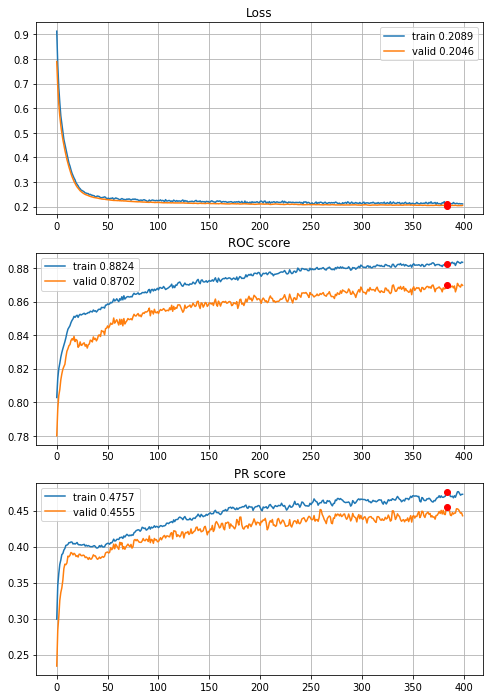


Fold 2------------------------------------------------------------


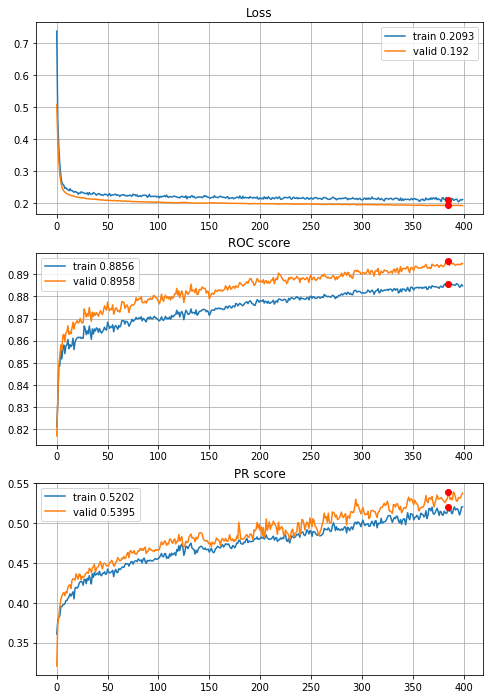


Fold 3------------------------------------------------------------


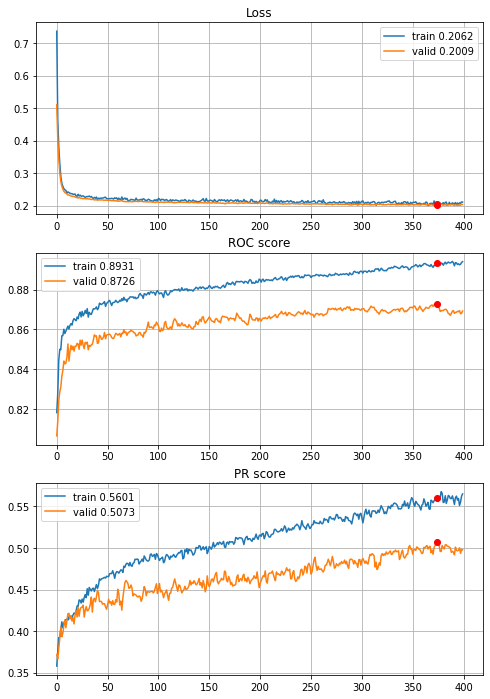


Fold 4------------------------------------------------------------


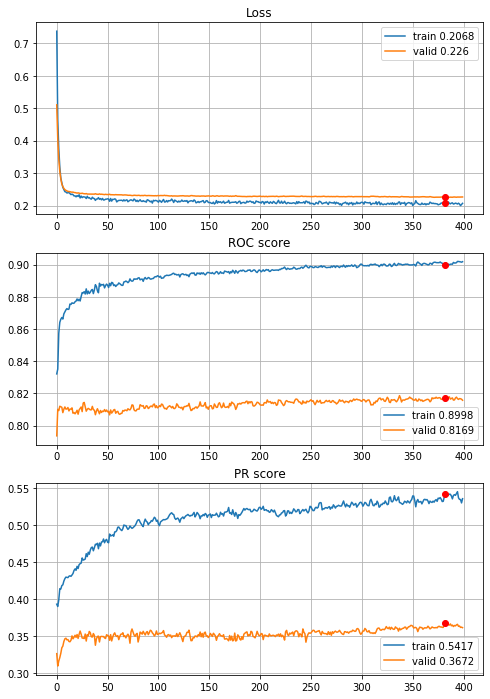


Fold 5------------------------------------------------------------


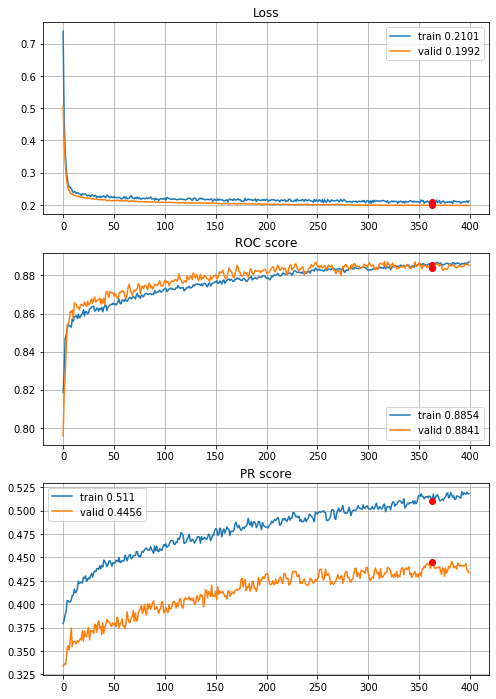


Fold 6------------------------------------------------------------


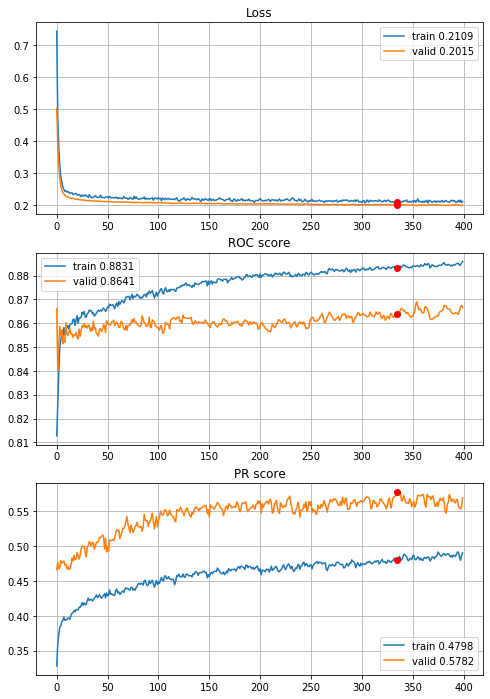

In [231]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l1(l=0.0005),regularizers.l1(l=0.0005)],
                                        opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

0.0005 on two layers is too much, lets add one zero before


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/400,
cumulative time: 16.39s train loss: 0.5546576747072303, validation loss: 0.4423624064769121
Epoch: 2/400,
cumulative time: 16.51s train loss: 0.43803847402280416, validation loss: 0.36102656406910066
Epoch: 3/400,
cumulative time: 16.62s train loss: 0.36629588283356346, validation loss: 0.3110728503751916
Epoch: 4/400,
cumulative time: 16.71s train loss: 0.3252513968799304, validation loss: 0.2811613991738979
Epoch: 5/400,
cumulative time: 16.79s train loss: 0.29155925580633246, validation loss: 0.262857414790447
Epoch: 6/400,
cumulative time: 16.9s train loss: 0.2791116396873006, validation loss: 0.25118945984184543
Epoch: 7/400,
cumulative time: 16.98s train loss: 0.26578627076228606, validation loss: 0.24355929562446096
Epoch: 8/400,
cumulative time: 17.08s train loss: 0.25190982625345676, validation loss: 0.23802427389777633
Epoch: 9/400,
cumulative time: 17.19s train loss: 0.250414914219549

cumulative time: 23.56s train loss: 0.19236412283961093, validation loss: 0.1940550615143749
Epoch: 78/400,
cumulative time: 23.66s train loss: 0.19161015597007336, validation loss: 0.19413118738063695
Epoch: 79/400,
cumulative time: 23.75s train loss: 0.1896976559802836, validation loss: 0.19404621220696738
Epoch: 80/400,
cumulative time: 23.85s train loss: 0.18787412567312967, validation loss: 0.19380788552115977
Epoch: 81/400,
cumulative time: 23.94s train loss: 0.1879151640090056, validation loss: 0.19512512920405442
Epoch: 82/400,
cumulative time: 24.02s train loss: 0.18424338857485284, validation loss: 0.1959549081937033
Epoch: 83/400,
cumulative time: 24.12s train loss: 0.189175089908636, validation loss: 0.1948939749158356
Epoch: 84/400,
cumulative time: 24.22s train loss: 0.1901116588015096, validation loss: 0.1950547260724705
Epoch: 85/400,
cumulative time: 24.32s train loss: 0.18689361809742794, validation loss: 0.1949935552434158
Epoch: 86/400,
cumulative time: 24.42s train

cumulative time: 37.98s train loss: 0.1673574003757445, validation loss: 0.18905737944022913
Epoch: 228/400,
cumulative time: 38.09s train loss: 0.17257523823475687, validation loss: 0.18853280158228375
Epoch: 229/400,
cumulative time: 38.2s train loss: 0.16605411302836257, validation loss: 0.18787783718633275
Epoch: 230/400,
cumulative time: 38.29s train loss: 0.17200870643158037, validation loss: 0.18780849128121588
Epoch: 231/400,
cumulative time: 38.38s train loss: 0.17423156903727174, validation loss: 0.1889885495655163
Epoch: 232/400,
cumulative time: 38.48s train loss: 0.17186219991934537, validation loss: 0.18861360540519034
Epoch: 233/400,
cumulative time: 38.58s train loss: 0.1661880692359504, validation loss: 0.18824584590609206
Epoch: 234/400,
cumulative time: 38.68s train loss: 0.17175965231678547, validation loss: 0.18676198323455712
Epoch: 235/400,
cumulative time: 38.78s train loss: 0.17008041200439852, validation loss: 0.1873501441625221
Epoch: 236/400,
cumulative time

cumulative time: 45.55s train loss: 0.1630600997942772, validation loss: 0.1853576091190605
Epoch: 305/400,
cumulative time: 45.64s train loss: 0.16532583123523514, validation loss: 0.1852177826198408
Epoch: 306/400,
cumulative time: 45.72s train loss: 0.16386644192551017, validation loss: 0.1842538919026849
Epoch: 307/400,
cumulative time: 45.82s train loss: 0.16177027564267174, validation loss: 0.1844503383793718
Epoch: 308/400,
cumulative time: 45.92s train loss: 0.16040928751257139, validation loss: 0.18441073737593353
Epoch: 309/400,
cumulative time: 46.04s train loss: 0.16276512257351342, validation loss: 0.18489535334346796
Epoch: 310/400,
cumulative time: 46.12s train loss: 0.166878645217537, validation loss: 0.185419547517512
Epoch: 311/400,
cumulative time: 46.22s train loss: 0.1619595840996945, validation loss: 0.18572486374262623
Epoch: 312/400,
cumulative time: 46.31s train loss: 0.16437585988428297, validation loss: 0.18498369014854496
Epoch: 313/400,
cumulative time: 46.

Epoch: 382/400,
cumulative time: 53.1s train loss: 0.15112124603335822, validation loss: 0.18370140833610074
Epoch: 383/400,
cumulative time: 53.19s train loss: 0.15729170203182025, validation loss: 0.1835979433581149
Epoch: 384/400,
cumulative time: 53.3s train loss: 0.15857542218095774, validation loss: 0.18392300348741494
Epoch: 385/400,
cumulative time: 53.39s train loss: 0.15347517534606292, validation loss: 0.18435457244666614
Epoch: 386/400,
cumulative time: 53.47s train loss: 0.1604679893729166, validation loss: 0.1844563431609443
Epoch: 387/400,
cumulative time: 53.57s train loss: 0.15785433157659826, validation loss: 0.1838079742675704
Epoch: 388/400,
cumulative time: 53.66s train loss: 0.15795113218928072, validation loss: 0.18536094494642777
Epoch: 389/400,
cumulative time: 53.76s train loss: 0.15372466223334577, validation loss: 0.18469270680775907
Epoch: 390/400,
cumulative time: 53.86s train loss: 0.15812049122251542, validation loss: 0.18436060076434554
Epoch: 391/400,


Epoch: 55/400,
cumulative time: 25.29s train loss: 0.18325966019654102, validation loss: 0.17957214327379978
Epoch: 56/400,
cumulative time: 25.39s train loss: 0.18656451251048473, validation loss: 0.17915971424292013
Epoch: 57/400,
cumulative time: 25.5s train loss: 0.18483166518328636, validation loss: 0.18083278297235625
Epoch: 58/400,
cumulative time: 25.61s train loss: 0.1832365191370141, validation loss: 0.18025792233032734
Epoch: 59/400,
cumulative time: 25.73s train loss: 0.1853895601866908, validation loss: 0.17936648905546043
Epoch: 60/400,
cumulative time: 25.83s train loss: 0.18258806690573692, validation loss: 0.1790268428732873
Epoch: 61/400,
cumulative time: 25.94s train loss: 0.1833809007174379, validation loss: 0.1792831013174444
Epoch: 62/400,
cumulative time: 26.04s train loss: 0.18073299730243667, validation loss: 0.17795850699420981
Epoch: 63/400,
cumulative time: 26.14s train loss: 0.18648067299975923, validation loss: 0.17862764659433247
Epoch: 64/400,
cumulative

cumulative time: 32.71s train loss: 0.17337723392388021, validation loss: 0.17301090863000984
Epoch: 132/400,
cumulative time: 32.82s train loss: 0.17127408346813508, validation loss: 0.1731704872147744
Epoch: 133/400,
cumulative time: 32.91s train loss: 0.17184553378755865, validation loss: 0.17239263364803697
Epoch: 134/400,
cumulative time: 33.01s train loss: 0.1733099341136992, validation loss: 0.17352457253814685
Epoch: 135/400,
cumulative time: 33.12s train loss: 0.17101731125117425, validation loss: 0.17323013918375618
Epoch: 136/400,
cumulative time: 33.22s train loss: 0.17288870929273026, validation loss: 0.17294856482589663
Epoch: 137/400,
cumulative time: 33.32s train loss: 0.16999507078813517, validation loss: 0.17244840358733593
Epoch: 138/400,
cumulative time: 33.43s train loss: 0.17345595729977753, validation loss: 0.1723490110110269
Epoch: 139/400,
cumulative time: 33.52s train loss: 0.17268932991348449, validation loss: 0.17176585383251258
Epoch: 140/400,
cumulative ti

cumulative time: 40.31s train loss: 0.16810717586333787, validation loss: 0.16928294887335754
Epoch: 209/400,
cumulative time: 40.41s train loss: 0.17158786397736642, validation loss: 0.16901013093004097
Epoch: 210/400,
cumulative time: 40.51s train loss: 0.1670329886747504, validation loss: 0.16916175158074906
Epoch: 211/400,
cumulative time: 40.62s train loss: 0.1610928702534644, validation loss: 0.16944175237934647
Epoch: 212/400,
cumulative time: 40.72s train loss: 0.16639772742744602, validation loss: 0.16864572299104666
Epoch: 213/400,
cumulative time: 40.81s train loss: 0.16258872423442047, validation loss: 0.16977392894708318
Epoch: 214/400,
cumulative time: 40.91s train loss: 0.16948783008334653, validation loss: 0.170502272422983
Epoch: 215/400,
cumulative time: 41.01s train loss: 0.16232228618021047, validation loss: 0.16877700499308285
Epoch: 216/400,
cumulative time: 41.11s train loss: 0.16597643957913782, validation loss: 0.16869170162427788
Epoch: 217/400,
cumulative tim

Epoch: 284/400,
cumulative time: 47.79s train loss: 0.16097859848990015, validation loss: 0.16581836952633627
Epoch: 285/400,
cumulative time: 47.88s train loss: 0.16266868664590567, validation loss: 0.1641816259556048
Epoch: 286/400,
cumulative time: 48.0s train loss: 0.16168823995247536, validation loss: 0.16472717698793668
Epoch: 287/400,
cumulative time: 48.1s train loss: 0.15809204023237264, validation loss: 0.1687729400503864
Epoch: 288/400,
cumulative time: 48.21s train loss: 0.15563452838237535, validation loss: 0.16550827337158036
Epoch: 289/400,
cumulative time: 48.3s train loss: 0.1634801170529818, validation loss: 0.1666791148424955
Epoch: 290/400,
cumulative time: 48.39s train loss: 0.15626590432673154, validation loss: 0.16633546100393895
Epoch: 291/400,
cumulative time: 48.49s train loss: 0.16302044705793745, validation loss: 0.1653797007685584
Epoch: 292/400,
cumulative time: 48.59s train loss: 0.1592974030288333, validation loss: 0.16574803146763611
Epoch: 293/400,
cum

Epoch: 360/400,
cumulative time: 55.28s train loss: 0.1599439292278692, validation loss: 0.16467774794631235
Epoch: 361/400,
cumulative time: 55.38s train loss: 0.15655123973971347, validation loss: 0.16525455037595993
Epoch: 362/400,
cumulative time: 55.46s train loss: 0.15380580315453804, validation loss: 0.1641316404219679
Epoch: 363/400,
cumulative time: 55.56s train loss: 0.1548060819789068, validation loss: 0.16410472055869818
Epoch: 364/400,
cumulative time: 55.67s train loss: 0.15334067963373038, validation loss: 0.1645299686704843
Epoch: 365/400,
cumulative time: 55.77s train loss: 0.15604811116703365, validation loss: 0.1635968245675088
Epoch: 366/400,
cumulative time: 55.88s train loss: 0.1530274822063986, validation loss: 0.16492664039538169
Epoch: 367/400,
cumulative time: 55.96s train loss: 0.15925401085752336, validation loss: 0.16385853621508115
Epoch: 368/400,
cumulative time: 56.06s train loss: 0.1524673280968509, validation loss: 0.16419143863064325
Epoch: 369/400,
c

cumulative time: 30.82s train loss: 0.17441195831886266, validation loss: 0.19846989006106452
Epoch: 110/400,
cumulative time: 30.93s train loss: 0.17597337756373177, validation loss: 0.19969326079630934
Epoch: 111/400,
cumulative time: 31.03s train loss: 0.16912436785869003, validation loss: 0.19794504940845786
Epoch: 112/400,
cumulative time: 31.14s train loss: 0.1724671187107905, validation loss: 0.1970566701660565
Epoch: 113/400,
cumulative time: 31.22s train loss: 0.1729074925056487, validation loss: 0.1970825474688273
Epoch: 114/400,
cumulative time: 31.32s train loss: 0.16992618601486786, validation loss: 0.19657857354894162
Epoch: 115/400,
cumulative time: 31.42s train loss: 0.1776241968765801, validation loss: 0.19538800465415537
Epoch: 116/400,
cumulative time: 31.53s train loss: 0.1726626659363562, validation loss: 0.19627507659265395
Epoch: 117/400,
cumulative time: 31.63s train loss: 0.16954046056777347, validation loss: 0.19553693250376047
Epoch: 118/400,
cumulative time:

cumulative time: 45.75s train loss: 0.15787756727799934, validation loss: 0.19642499750301562
Epoch: 260/400,
cumulative time: 45.85s train loss: 0.16120173161788862, validation loss: 0.1967120908427534
Epoch: 261/400,
cumulative time: 45.95s train loss: 0.16295367960787852, validation loss: 0.1948927304252831
Epoch: 262/400,
cumulative time: 46.06s train loss: 0.15699401143467598, validation loss: 0.19604108389362004
Epoch: 263/400,
cumulative time: 46.15s train loss: 0.15756926309680466, validation loss: 0.19486028790104348
Epoch: 264/400,
cumulative time: 46.24s train loss: 0.15728304722759914, validation loss: 0.19546368876902603
Epoch: 265/400,
cumulative time: 46.34s train loss: 0.16148670030831752, validation loss: 0.19501103760659896
Epoch: 266/400,
cumulative time: 46.44s train loss: 0.15552805764230795, validation loss: 0.1978980342709494
Epoch: 267/400,
cumulative time: 46.54s train loss: 0.15715984951045753, validation loss: 0.1970088220838764
Epoch: 268/400,
cumulative tim

Epoch: 336/400,
cumulative time: 53.45s train loss: 0.1519356945812003, validation loss: 0.1968367394929271
Epoch: 337/400,
cumulative time: 53.55s train loss: 0.1518002809176645, validation loss: 0.19623422815035
Epoch: 338/400,
cumulative time: 53.64s train loss: 0.1515414694841911, validation loss: 0.19441106030979985
Epoch: 339/400,
cumulative time: 53.75s train loss: 0.15090945575198003, validation loss: 0.1938579855098262
Epoch: 340/400,
cumulative time: 53.86s train loss: 0.1545538506285701, validation loss: 0.19396132567588747
Epoch: 341/400,
cumulative time: 53.94s train loss: 0.14755935740357917, validation loss: 0.19519444134216565
Epoch: 342/400,
cumulative time: 54.04s train loss: 0.15481996479434118, validation loss: 0.19552159500061592
Epoch: 343/400,
cumulative time: 54.13s train loss: 0.15568988120674226, validation loss: 0.19801466092215317
Epoch: 344/400,
cumulative time: 54.23s train loss: 0.15499353717461176, validation loss: 0.19747668918822772
Epoch: 345/400,
cum

cumulative time: 18.48s train loss: 0.2029554967905258, validation loss: 0.23593632167133735
Epoch: 10/400,
cumulative time: 18.57s train loss: 0.20217531424006516, validation loss: 0.2347239553592006
Epoch: 11/400,
cumulative time: 18.67s train loss: 0.20133111031107082, validation loss: 0.2336781845001281
Epoch: 12/400,
cumulative time: 18.76s train loss: 0.2024988345238793, validation loss: 0.2335840797316678
Epoch: 13/400,
cumulative time: 18.84s train loss: 0.20291087773565297, validation loss: 0.23200405266295707
Epoch: 14/400,
cumulative time: 18.94s train loss: 0.20127312170445394, validation loss: 0.23239297458468927
Epoch: 15/400,
cumulative time: 19.05s train loss: 0.19891892331544148, validation loss: 0.23159272639127132
Epoch: 16/400,
cumulative time: 19.16s train loss: 0.19486006943791762, validation loss: 0.23039336640463456
Epoch: 17/400,
cumulative time: 19.26s train loss: 0.19527449851282935, validation loss: 0.2316063594064648
Epoch: 18/400,
cumulative time: 19.36s t

cumulative time: 33.16s train loss: 0.16065274210242958, validation loss: 0.2176069902512613
Epoch: 160/400,
cumulative time: 33.26s train loss: 0.16539766353582544, validation loss: 0.21732842367201302
Epoch: 161/400,
cumulative time: 33.35s train loss: 0.1636477098315988, validation loss: 0.21687836544777417
Epoch: 162/400,
cumulative time: 33.45s train loss: 0.1638634033163326, validation loss: 0.2168108301560981
Epoch: 163/400,
cumulative time: 33.55s train loss: 0.16215678603095715, validation loss: 0.2172409110359898
Epoch: 164/400,
cumulative time: 33.65s train loss: 0.16282743408506245, validation loss: 0.21628605320410588
Epoch: 165/400,
cumulative time: 33.74s train loss: 0.16645104606641542, validation loss: 0.21493663657330497
Epoch: 166/400,
cumulative time: 33.84s train loss: 0.16368921894051544, validation loss: 0.2160017993259107
Epoch: 167/400,
cumulative time: 33.94s train loss: 0.16101498641166143, validation loss: 0.21568762297420416
Epoch: 168/400,
cumulative time:

Epoch: 236/400,
cumulative time: 40.71s train loss: 0.1515352292427112, validation loss: 0.21523788652086365
Epoch: 237/400,
cumulative time: 40.81s train loss: 0.1574641006903968, validation loss: 0.21489455589591516
Epoch: 238/400,
cumulative time: 40.92s train loss: 0.15194484538037542, validation loss: 0.21427364156289241
Epoch: 239/400,
cumulative time: 41.02s train loss: 0.1600818040272519, validation loss: 0.2136248539519364
Epoch: 240/400,
cumulative time: 41.12s train loss: 0.16037060973500658, validation loss: 0.21441902004972807
Epoch: 241/400,
cumulative time: 41.21s train loss: 0.1578501972745698, validation loss: 0.21281131237543463
Epoch: 242/400,
cumulative time: 41.29s train loss: 0.15857714688888178, validation loss: 0.21340833459696973
Epoch: 243/400,
cumulative time: 41.39s train loss: 0.15931346826969622, validation loss: 0.2137434073549361
Epoch: 244/400,
cumulative time: 41.51s train loss: 0.1558529248550625, validation loss: 0.21241563255846097
Epoch: 245/400,
c

cumulative time: 48.07s train loss: 0.1462318256762935, validation loss: 0.21516794554939658
Epoch: 312/400,
cumulative time: 48.16s train loss: 0.15105644017693262, validation loss: 0.21454714904654915
Epoch: 313/400,
cumulative time: 48.26s train loss: 0.15397070570116303, validation loss: 0.21474456618924712
Epoch: 314/400,
cumulative time: 48.36s train loss: 0.15136506412318618, validation loss: 0.21250404474697587
Epoch: 315/400,
cumulative time: 48.46s train loss: 0.15710257557144075, validation loss: 0.21286404560032063
Epoch: 316/400,
cumulative time: 48.56s train loss: 0.14916103298948336, validation loss: 0.21303691091036958
Epoch: 317/400,
cumulative time: 48.65s train loss: 0.15117121467183198, validation loss: 0.2152034646703212
Epoch: 318/400,
cumulative time: 48.75s train loss: 0.15267242203844122, validation loss: 0.21491567840963668
Epoch: 319/400,
cumulative time: 48.85s train loss: 0.1484894185733935, validation loss: 0.21332265571197054
Epoch: 320/400,
cumulative ti

Epoch: 387/400,
cumulative time: 55.52s train loss: 0.14527218022963384, validation loss: 0.21376848759016118
Epoch: 388/400,
cumulative time: 55.62s train loss: 0.14578133932246115, validation loss: 0.21250139940403923
Epoch: 389/400,
cumulative time: 55.72s train loss: 0.14963152070172397, validation loss: 0.21525042943034162
Epoch: 390/400,
cumulative time: 55.82s train loss: 0.15074043136746357, validation loss: 0.21420345171176014
Epoch: 391/400,
cumulative time: 55.92s train loss: 0.14311701466913232, validation loss: 0.2127402782709281
Epoch: 392/400,
cumulative time: 56.02s train loss: 0.14867819937443105, validation loss: 0.21335528760677536
Epoch: 393/400,
cumulative time: 56.09s train loss: 0.1510654122423916, validation loss: 0.211755870830932
Epoch: 394/400,
cumulative time: 56.21s train loss: 0.14247329599992326, validation loss: 0.21294961291161402
Epoch: 395/400,
cumulative time: 56.31s train loss: 0.14933245263181957, validation loss: 0.21379900019002016
Epoch: 396/400

cumulative time: 26.95s train loss: 0.18178744209745842, validation loss: 0.19611147254638156
Epoch: 61/400,
cumulative time: 27.08s train loss: 0.18364574335147424, validation loss: 0.19513601185774965
Epoch: 62/400,
cumulative time: 27.18s train loss: 0.1784125788033533, validation loss: 0.19586739761431116
Epoch: 63/400,
cumulative time: 27.28s train loss: 0.1825677800563074, validation loss: 0.1961313171257553
Epoch: 64/400,
cumulative time: 27.38s train loss: 0.18149758083084058, validation loss: 0.19411121308803558
Epoch: 65/400,
cumulative time: 27.48s train loss: 0.17860594490984613, validation loss: 0.1933526766084925
Epoch: 66/400,
cumulative time: 27.59s train loss: 0.18033528613662334, validation loss: 0.19343911013807724
Epoch: 67/400,
cumulative time: 27.7s train loss: 0.18586890336261386, validation loss: 0.19376382695902014
Epoch: 68/400,
cumulative time: 27.8s train loss: 0.18100751063811868, validation loss: 0.19540433091180856
Epoch: 69/400,
cumulative time: 27.89s t

cumulative time: 42.82s train loss: 0.1653520288725295, validation loss: 0.18711707029600982
Epoch: 213/400,
cumulative time: 42.94s train loss: 0.1661583694299322, validation loss: 0.18798719565163347
Epoch: 214/400,
cumulative time: 43.04s train loss: 0.16424400605279812, validation loss: 0.18936713578065953
Epoch: 215/400,
cumulative time: 43.15s train loss: 0.16609042269796867, validation loss: 0.18798576588017138
Epoch: 216/400,
cumulative time: 43.23s train loss: 0.1630701296907124, validation loss: 0.18773192490196658
Epoch: 217/400,
cumulative time: 43.35s train loss: 0.1674296950382329, validation loss: 0.18837150991904816
Epoch: 218/400,
cumulative time: 43.46s train loss: 0.16093663916331286, validation loss: 0.1874674893327007
Epoch: 219/400,
cumulative time: 43.56s train loss: 0.16194765206057465, validation loss: 0.18703961678471576
Epoch: 220/400,
cumulative time: 43.65s train loss: 0.16288255953423036, validation loss: 0.18869643915722117
Epoch: 221/400,
cumulative time

Epoch: 288/400,
cumulative time: 50.67s train loss: 0.16054986054260523, validation loss: 0.18801288071254577
Epoch: 289/400,
cumulative time: 50.8s train loss: 0.15902185872257657, validation loss: 0.18945650900997912
Epoch: 290/400,
cumulative time: 50.91s train loss: 0.1583231418834108, validation loss: 0.18853506866346365
Epoch: 291/400,
cumulative time: 51.0s train loss: 0.16066113637057325, validation loss: 0.18806550441557882
Epoch: 292/400,
cumulative time: 51.1s train loss: 0.15445983159792173, validation loss: 0.1866562967241214
Epoch: 293/400,
cumulative time: 51.21s train loss: 0.15682982886157562, validation loss: 0.18732343375279187
Epoch: 294/400,
cumulative time: 51.3s train loss: 0.15976532867496396, validation loss: 0.18728096947982134
Epoch: 295/400,
cumulative time: 51.4s train loss: 0.1604649891386499, validation loss: 0.18680033138185806
Epoch: 296/400,
cumulative time: 51.52s train loss: 0.15551784602320545, validation loss: 0.1896571632365341
Epoch: 297/400,
cum

Epoch: 35/400,
cumulative time: 24.77s train loss: 0.18880164296866916, validation loss: 0.18819552696989028
Epoch: 36/400,
cumulative time: 24.87s train loss: 0.18838068574310668, validation loss: 0.1881600569252505
Epoch: 37/400,
cumulative time: 24.97s train loss: 0.18850875831258074, validation loss: 0.18698105024295789
Epoch: 38/400,
cumulative time: 25.07s train loss: 0.1921962232318657, validation loss: 0.1890854430521584
Epoch: 39/400,
cumulative time: 25.19s train loss: 0.19161278393288486, validation loss: 0.1885120857246304
Epoch: 40/400,
cumulative time: 25.3s train loss: 0.18658412826564116, validation loss: 0.19016668570499118
Epoch: 41/400,
cumulative time: 25.42s train loss: 0.18524725168116496, validation loss: 0.18877769236370887
Epoch: 42/400,
cumulative time: 25.54s train loss: 0.18579886837896256, validation loss: 0.1878269425431439
Epoch: 43/400,
cumulative time: 25.64s train loss: 0.18863087111339058, validation loss: 0.18787131271835913
Epoch: 44/400,
cumulative

cumulative time: 32.59s train loss: 0.17407934130340674, validation loss: 0.1842766329477926
Epoch: 113/400,
cumulative time: 32.7s train loss: 0.17466347450640463, validation loss: 0.18354674871027066
Epoch: 114/400,
cumulative time: 32.8s train loss: 0.1738597592811619, validation loss: 0.18417475132048802
Epoch: 115/400,
cumulative time: 32.91s train loss: 0.17500883061837968, validation loss: 0.1835708827385784
Epoch: 116/400,
cumulative time: 33.0s train loss: 0.17342471615229615, validation loss: 0.18118663983205102
Epoch: 117/400,
cumulative time: 33.09s train loss: 0.17523080155592913, validation loss: 0.1833741265279714
Epoch: 118/400,
cumulative time: 33.2s train loss: 0.17752232078690575, validation loss: 0.18320505657395175
Epoch: 119/400,
cumulative time: 33.31s train loss: 0.17587943470070655, validation loss: 0.1833284634836102
Epoch: 120/400,
cumulative time: 33.41s train loss: 0.1740076898815883, validation loss: 0.1838955578160878
Epoch: 121/400,
cumulative time: 33.5

cumulative time: 40.22s train loss: 0.16557508695953832, validation loss: 0.18042986932511254
Epoch: 189/400,
cumulative time: 40.31s train loss: 0.1676546571696017, validation loss: 0.18213627781744196
Epoch: 190/400,
cumulative time: 40.41s train loss: 0.16725958206772992, validation loss: 0.18318327851004848
Epoch: 191/400,
cumulative time: 40.51s train loss: 0.16219465203621897, validation loss: 0.18166504669135633
Epoch: 192/400,
cumulative time: 40.61s train loss: 0.16434329972360195, validation loss: 0.18135822892323575
Epoch: 193/400,
cumulative time: 40.71s train loss: 0.16509805913504483, validation loss: 0.18134670319460316
Epoch: 194/400,
cumulative time: 40.81s train loss: 0.16472548299830195, validation loss: 0.1806847675793865
Epoch: 195/400,
cumulative time: 40.89s train loss: 0.16543561188067535, validation loss: 0.18086411085812287
Epoch: 196/400,
cumulative time: 41.01s train loss: 0.16612456008176785, validation loss: 0.18202727474692712
Epoch: 197/400,
cumulative t

Epoch: 264/400,
cumulative time: 47.91s train loss: 0.15745011336904816, validation loss: 0.17832957403250796
Epoch: 265/400,
cumulative time: 48.01s train loss: 0.15922305948936508, validation loss: 0.17823865511885614
Epoch: 266/400,
cumulative time: 48.1s train loss: 0.1595478939090387, validation loss: 0.1770028831525527
Epoch: 267/400,
cumulative time: 48.21s train loss: 0.1611403146951537, validation loss: 0.17693674227992245
Epoch: 268/400,
cumulative time: 48.3s train loss: 0.16068922343081715, validation loss: 0.17692991011433354
Epoch: 269/400,
cumulative time: 48.42s train loss: 0.15544191292263762, validation loss: 0.17751631093617218
Epoch: 270/400,
cumulative time: 48.52s train loss: 0.15659387394560667, validation loss: 0.17762417122553487
Epoch: 271/400,
cumulative time: 48.62s train loss: 0.15903170586654194, validation loss: 0.17712097620049125
Epoch: 272/400,
cumulative time: 48.73s train loss: 0.16065616841318106, validation loss: 0.17888892756493313
Epoch: 273/400,

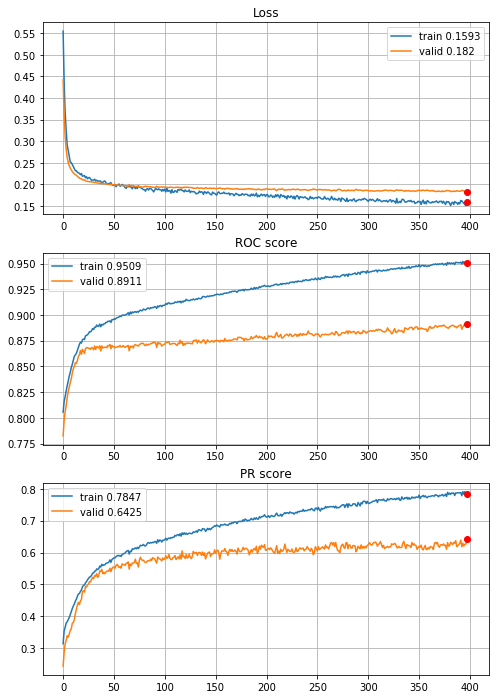


Fold 2------------------------------------------------------------


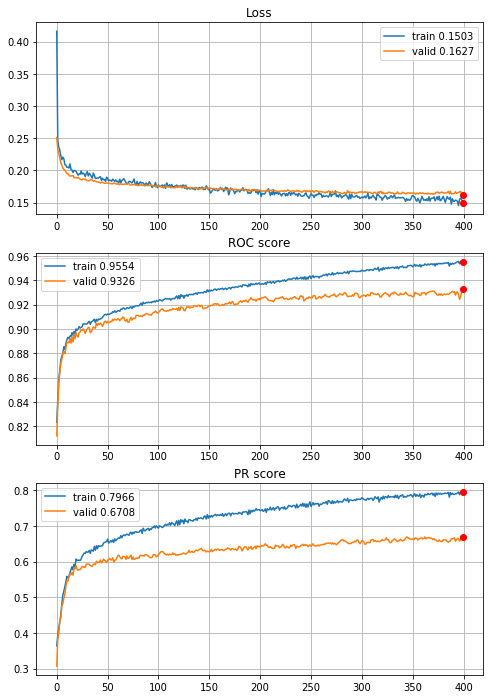


Fold 3------------------------------------------------------------


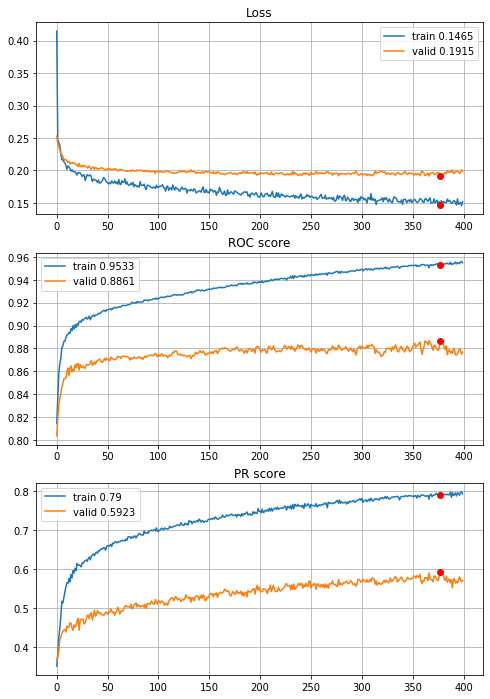


Fold 4------------------------------------------------------------


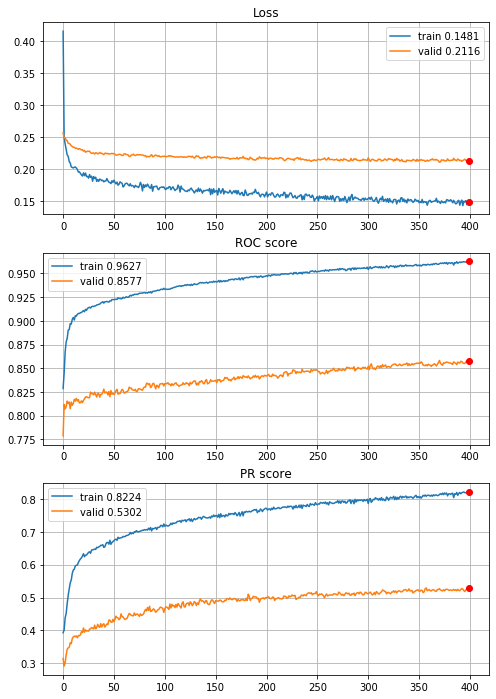


Fold 5------------------------------------------------------------


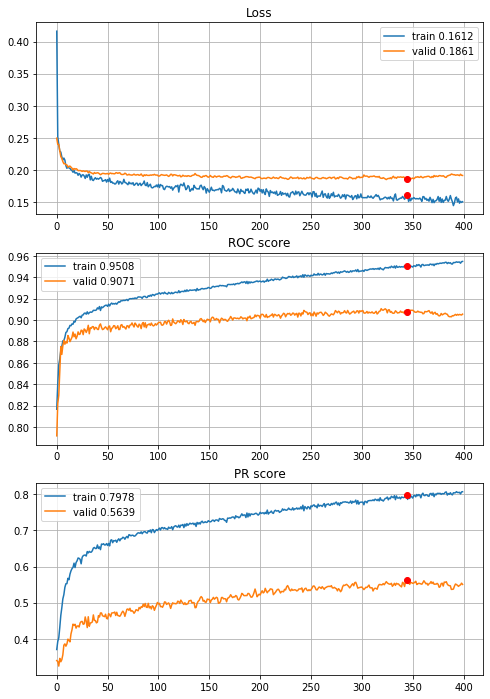


Fold 6------------------------------------------------------------


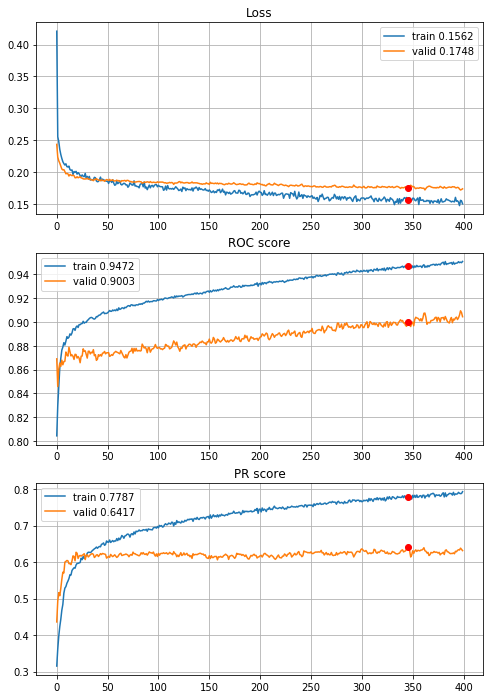

In [232]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)],
                                        opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Very good model, scores are slightly worse, but overfitting is smaller, learning curves are great, early stopping occurs later or never, and seems to be more stable, lets try more epochs.


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/600,
cumulative time: 19.59s train loss: 0.5547029220831954, validation loss: 0.4424824551705443
Epoch: 2/600,
cumulative time: 19.68s train loss: 0.4381420321843254, validation loss: 0.361103666944192
Epoch: 3/600,
cumulative time: 19.78s train loss: 0.36636567053919666, validation loss: 0.3111203759068701
Epoch: 4/600,
cumulative time: 19.9s train loss: 0.32529640671148197, validation loss: 0.28119098968812284
Epoch: 5/600,
cumulative time: 20.01s train loss: 0.29158918454651367, validation loss: 0.2628769538750643
Epoch: 6/600,
cumulative time: 20.14s train loss: 0.27913285208872723, validation loss: 0.2512030506416265
Epoch: 7/600,
cumulative time: 20.24s train loss: 0.26580215527908035, validation loss: 0.2435689307959265
Epoch: 8/600,
cumulative time: 20.34s train loss: 0.25192159959636223, validation loss: 0.238031377602188
Epoch: 9/600,
cumulative time: 20.46s train loss: 0.25042730185879053,

cumulative time: 27.81s train loss: 0.19236544750308088, validation loss: 0.19405510559627678
Epoch: 78/600,
cumulative time: 27.91s train loss: 0.19161336244309207, validation loss: 0.19413117552018622
Epoch: 79/600,
cumulative time: 28.02s train loss: 0.1896997132752131, validation loss: 0.19404614899042896
Epoch: 80/600,
cumulative time: 28.13s train loss: 0.18787488772362362, validation loss: 0.1938074364199848
Epoch: 81/600,
cumulative time: 28.23s train loss: 0.1879163931866953, validation loss: 0.19512486004238064
Epoch: 82/600,
cumulative time: 28.34s train loss: 0.18424476831747952, validation loss: 0.19595483017680074
Epoch: 83/600,
cumulative time: 28.44s train loss: 0.18917726563283038, validation loss: 0.19489366303301986
Epoch: 84/600,
cumulative time: 28.54s train loss: 0.19011155719657022, validation loss: 0.19505488983404812
Epoch: 85/600,
cumulative time: 28.64s train loss: 0.18689446198327017, validation loss: 0.19499333137320826
Epoch: 86/600,
cumulative time: 28.74

Epoch: 228/600,
cumulative time: 43.51s train loss: 0.17257649071232184, validation loss: 0.18853234834843047
Epoch: 229/600,
cumulative time: 43.61s train loss: 0.16605325873994978, validation loss: 0.18787779228125512
Epoch: 230/600,
cumulative time: 43.72s train loss: 0.1720102527834448, validation loss: 0.18780843856436827
Epoch: 231/600,
cumulative time: 43.82s train loss: 0.17423202959477685, validation loss: 0.18898823978263873
Epoch: 232/600,
cumulative time: 43.92s train loss: 0.17186092949112616, validation loss: 0.18861286965405658
Epoch: 233/600,
cumulative time: 44.02s train loss: 0.1661864967700699, validation loss: 0.1882463209793022
Epoch: 234/600,
cumulative time: 44.13s train loss: 0.17175898184522395, validation loss: 0.18676125719353742
Epoch: 235/600,
cumulative time: 44.23s train loss: 0.1700813196438099, validation loss: 0.18734942976355956
Epoch: 236/600,
cumulative time: 44.34s train loss: 0.17081941102735618, validation loss: 0.18751949206280197
Epoch: 237/600

Epoch: 304/600,
cumulative time: 51.58s train loss: 0.16306172891617468, validation loss: 0.18535538908123567
Epoch: 305/600,
cumulative time: 51.69s train loss: 0.16532515840678869, validation loss: 0.18521577012310436
Epoch: 306/600,
cumulative time: 51.79s train loss: 0.16386893370763705, validation loss: 0.1842530918598444
Epoch: 307/600,
cumulative time: 51.9s train loss: 0.16177187260536188, validation loss: 0.18444899608209947
Epoch: 308/600,
cumulative time: 52.01s train loss: 0.16041029629294193, validation loss: 0.1844095696759197
Epoch: 309/600,
cumulative time: 52.12s train loss: 0.1627657129916796, validation loss: 0.18489356303698853
Epoch: 310/600,
cumulative time: 52.23s train loss: 0.16687936482392923, validation loss: 0.18542009427421122
Epoch: 311/600,
cumulative time: 52.34s train loss: 0.16196073538586767, validation loss: 0.18572553293412003
Epoch: 312/600,
cumulative time: 52.44s train loss: 0.1643780903547787, validation loss: 0.18498360875494183
Epoch: 313/600,

Epoch: 379/600,
cumulative time: 59.57s train loss: 0.1591357929927939, validation loss: 0.1854739480451371
Epoch: 380/600,
cumulative time: 59.68s train loss: 0.16006683507793001, validation loss: 0.1853387252823476
Epoch: 381/600,
cumulative time: 59.79s train loss: 0.1555907241025072, validation loss: 0.18546263545986766
Epoch: 382/600,
cumulative time: 59.89s train loss: 0.1511211802423108, validation loss: 0.1836941849856124
Epoch: 383/600,
cumulative time: 60.0s train loss: 0.15729360974020584, validation loss: 0.18359181468019087
Epoch: 384/600,
cumulative time: 60.11s train loss: 0.15857932139658756, validation loss: 0.18391858084965182
Epoch: 385/600,
cumulative time: 60.23s train loss: 0.1534806269587485, validation loss: 0.1843478882091021
Epoch: 386/600,
cumulative time: 60.33s train loss: 0.16046920750586027, validation loss: 0.18444971639448787
Epoch: 387/600,
cumulative time: 60.44s train loss: 0.15785711758269083, validation loss: 0.18380226008384043
Epoch: 388/600,
cum

cumulative time: 67.43s train loss: 0.15826258642955376, validation loss: 0.18355677314648633
Epoch: 456/600,
cumulative time: 67.53s train loss: 0.15616311201496244, validation loss: 0.18408114116181112
Epoch: 457/600,
cumulative time: 67.63s train loss: 0.1507637423197554, validation loss: 0.1830615987402745
Epoch: 458/600,
cumulative time: 67.74s train loss: 0.15161731223565683, validation loss: 0.1835381119872161
Epoch: 459/600,
cumulative time: 67.84s train loss: 0.1540079663712733, validation loss: 0.18447545395897366
Epoch: 460/600,
cumulative time: 67.94s train loss: 0.15190421311110797, validation loss: 0.1846506782422071
Epoch: 461/600,
cumulative time: 68.05s train loss: 0.14817332187230406, validation loss: 0.1855456079981104
Epoch: 462/600,
cumulative time: 68.16s train loss: 0.1539503838866949, validation loss: 0.18542282706653654
Epoch: 463/600,
cumulative time: 68.26s train loss: 0.15589891583238483, validation loss: 0.18520666522802334
Epoch: 464/600,
cumulative time: 

Epoch: 533/600,
cumulative time: 75.62s train loss: 0.15264321709999862, validation loss: 0.18333185318828032
Epoch: 534/600,
cumulative time: 75.73s train loss: 0.1451450050993409, validation loss: 0.18434070763015425
Epoch: 535/600,
cumulative time: 75.83s train loss: 0.15042486824162493, validation loss: 0.18426113719332715
Epoch: 536/600,
cumulative time: 75.94s train loss: 0.152992076778428, validation loss: 0.18248897187806573
Epoch: 537/600,
cumulative time: 76.05s train loss: 0.148317632208232, validation loss: 0.1802682853907582
Epoch: 538/600,
cumulative time: 76.16s train loss: 0.14978140918369864, validation loss: 0.18134403510991454
Epoch: 539/600,
cumulative time: 76.27s train loss: 0.1539683657251164, validation loss: 0.18113523483141972
Epoch: 540/600,
cumulative time: 76.38s train loss: 0.15229529901895175, validation loss: 0.18334665308205628
Epoch: 541/600,
cumulative time: 76.48s train loss: 0.14953945371715707, validation loss: 0.1831522635031983
Epoch: 542/600,
cu

Epoch: 7/600,
cumulative time: 23.84s train loss: 0.2206765183849455, validation loss: 0.2037643624937924
Epoch: 8/600,
cumulative time: 23.95s train loss: 0.21784134433076915, validation loss: 0.2014524589430251
Epoch: 9/600,
cumulative time: 24.06s train loss: 0.20912372515896596, validation loss: 0.2008066647586317
Epoch: 10/600,
cumulative time: 24.17s train loss: 0.20817821141372733, validation loss: 0.19778233354967906
Epoch: 11/600,
cumulative time: 24.28s train loss: 0.20500623514129368, validation loss: 0.19537546259709115
Epoch: 12/600,
cumulative time: 24.39s train loss: 0.20501378892722544, validation loss: 0.19488661698451037
Epoch: 13/600,
cumulative time: 24.5s train loss: 0.20374985147496208, validation loss: 0.19290433091603917
Epoch: 14/600,
cumulative time: 24.61s train loss: 0.21018759406672705, validation loss: 0.19122454436682795
Epoch: 15/600,
cumulative time: 24.72s train loss: 0.2019835437315143, validation loss: 0.19153536110276434
Epoch: 16/600,
cumulative ti

Epoch: 85/600,
cumulative time: 32.0s train loss: 0.18136189066357777, validation loss: 0.1768681481900586
Epoch: 86/600,
cumulative time: 32.1s train loss: 0.1805549333483949, validation loss: 0.1776938703679716
Epoch: 87/600,
cumulative time: 32.2s train loss: 0.1785554293381716, validation loss: 0.17641805097242352
Epoch: 88/600,
cumulative time: 32.3s train loss: 0.17862017385809537, validation loss: 0.17608371995213068
Epoch: 89/600,
cumulative time: 32.4s train loss: 0.1805496584449219, validation loss: 0.1770596114462903
Epoch: 90/600,
cumulative time: 32.49s train loss: 0.17818681916578366, validation loss: 0.17660698541592315
Epoch: 91/600,
cumulative time: 32.6s train loss: 0.17833601188129788, validation loss: 0.17654855030230765
Epoch: 92/600,
cumulative time: 32.69s train loss: 0.18250222927100607, validation loss: 0.17694618515124316
Epoch: 93/600,
cumulative time: 32.79s train loss: 0.1799410857757829, validation loss: 0.17739896042841533
Epoch: 94/600,
cumulative time: 

cumulative time: 39.88s train loss: 0.17115352429879915, validation loss: 0.17143266312903993
Epoch: 162/600,
cumulative time: 39.97s train loss: 0.1738357869336644, validation loss: 0.17255609162496202
Epoch: 163/600,
cumulative time: 40.07s train loss: 0.17042812479101793, validation loss: 0.17104013119703484
Epoch: 164/600,
cumulative time: 40.18s train loss: 0.1723623144363023, validation loss: 0.17143956367703408
Epoch: 165/600,
cumulative time: 40.28s train loss: 0.16746104895960984, validation loss: 0.1715915201918517
Epoch: 166/600,
cumulative time: 40.4s train loss: 0.16955828021821778, validation loss: 0.17146372435595567
Epoch: 167/600,
cumulative time: 40.51s train loss: 0.17407688805799837, validation loss: 0.1705120185719805
Epoch: 168/600,
cumulative time: 40.62s train loss: 0.17218528040398975, validation loss: 0.16991657821677852
Epoch: 169/600,
cumulative time: 40.73s train loss: 0.17294658830100235, validation loss: 0.17042403369973988
Epoch: 170/600,
cumulative time

Epoch: 237/600,
cumulative time: 47.87s train loss: 0.16346924082251663, validation loss: 0.16930712387385738
Epoch: 238/600,
cumulative time: 47.98s train loss: 0.16015306528361803, validation loss: 0.16759851325425112
Epoch: 239/600,
cumulative time: 48.09s train loss: 0.1645896381392591, validation loss: 0.16867450087120192
Epoch: 240/600,
cumulative time: 48.2s train loss: 0.16310388292270017, validation loss: 0.16761806047822872
Epoch: 241/600,
cumulative time: 48.31s train loss: 0.16081625177770423, validation loss: 0.16716211237088938
Epoch: 242/600,
cumulative time: 48.42s train loss: 0.15976552057352306, validation loss: 0.1661074343132193
Epoch: 243/600,
cumulative time: 48.52s train loss: 0.1604566866740423, validation loss: 0.16775749130710002
Epoch: 244/600,
cumulative time: 48.63s train loss: 0.1607619183615442, validation loss: 0.16832376861148918
Epoch: 245/600,
cumulative time: 48.73s train loss: 0.16367417770952308, validation loss: 0.16881401447123578
Epoch: 246/600,

cumulative time: 56.09s train loss: 0.16149638729028754, validation loss: 0.1639823818825009
Epoch: 313/600,
cumulative time: 56.19s train loss: 0.15864662358046439, validation loss: 0.16632088813867751
Epoch: 314/600,
cumulative time: 56.29s train loss: 0.15736960470743666, validation loss: 0.166070430790491
Epoch: 315/600,
cumulative time: 56.39s train loss: 0.15417571019193002, validation loss: 0.16447114164120988
Epoch: 316/600,
cumulative time: 56.5s train loss: 0.16325227205140602, validation loss: 0.1647832226995148
Epoch: 317/600,
cumulative time: 56.6s train loss: 0.16227612184488385, validation loss: 0.16693890728938404
Epoch: 318/600,
cumulative time: 56.7s train loss: 0.16066800271386167, validation loss: 0.16459073494225238
Epoch: 319/600,
cumulative time: 56.8s train loss: 0.1584599741939657, validation loss: 0.16756766898454648
Epoch: 320/600,
cumulative time: 56.9s train loss: 0.158310364225765, validation loss: 0.16761006267054643
Epoch: 321/600,
cumulative time: 57.0s

Epoch: 388/600,
cumulative time: 64.16s train loss: 0.15845885251174657, validation loss: 0.16795395637243954
Epoch: 389/600,
cumulative time: 64.27s train loss: 0.14808795281050438, validation loss: 0.16404404602902853
Epoch: 390/600,
cumulative time: 64.38s train loss: 0.1560830722667196, validation loss: 0.1640916380615487
Epoch: 391/600,
cumulative time: 64.49s train loss: 0.15280734188854694, validation loss: 0.16412145893899
Epoch: 392/600,
cumulative time: 64.6s train loss: 0.15213251799775374, validation loss: 0.1645540492997632
Epoch: 393/600,
cumulative time: 64.71s train loss: 0.15401313480137702, validation loss: 0.16703738552741831
Epoch: 394/600,
cumulative time: 64.83s train loss: 0.15335794578269393, validation loss: 0.16464222190647546
Epoch: 395/600,
cumulative time: 64.93s train loss: 0.15207277580302223, validation loss: 0.16530410632104722
Epoch: 396/600,
cumulative time: 65.04s train loss: 0.14548988745880687, validation loss: 0.16599911175827836
Epoch: 397/600,
c

Epoch: 464/600,
cumulative time: 72.27s train loss: 0.1538259844978202, validation loss: 0.16519867575894348
Epoch: 465/600,
cumulative time: 72.37s train loss: 0.14556696872136116, validation loss: 0.16597568662049672
Epoch: 466/600,
cumulative time: 72.47s train loss: 0.15131333957523754, validation loss: 0.16413567940942866
Epoch: 467/600,
cumulative time: 72.57s train loss: 0.14678757532503092, validation loss: 0.16544174738102324
Epoch: 468/600,
cumulative time: 72.67s train loss: 0.1492039620546819, validation loss: 0.16545081809751075
Epoch: 469/600,
cumulative time: 72.78s train loss: 0.15124918219535896, validation loss: 0.16638393555647088
Epoch: 470/600,
cumulative time: 72.88s train loss: 0.15032909798439228, validation loss: 0.16526764220523457
Epoch: 471/600,
cumulative time: 72.99s train loss: 0.15316066661654612, validation loss: 0.16340586459085665
Epoch: 472/600,
cumulative time: 73.09s train loss: 0.147511452510415, validation loss: 0.16350135784239214
Epoch: 473/600

cumulative time: 79.92s train loss: 0.1501690649800675, validation loss: 0.16521799757555883
Epoch: 540/600,
cumulative time: 80.02s train loss: 0.14949549287086897, validation loss: 0.16560194432197858
Epoch: 541/600,
cumulative time: 80.12s train loss: 0.1503749277294758, validation loss: 0.1640059790892155
Epoch: 542/600,
cumulative time: 80.22s train loss: 0.14607890723575753, validation loss: 0.16277168914591716
Epoch: 543/600,
cumulative time: 80.32s train loss: 0.15285181843201606, validation loss: 0.16343295548988976
Epoch: 544/600,
cumulative time: 80.42s train loss: 0.15636338680875, validation loss: 0.163528366129858
Epoch: 545/600,
cumulative time: 80.52s train loss: 0.15059812406636103, validation loss: 0.1629041603009354
Epoch: 546/600,
cumulative time: 80.63s train loss: 0.14706428526540957, validation loss: 0.16490538254497822
Epoch: 547/600,
cumulative time: 80.73s train loss: 0.15047788779362228, validation loss: 0.1643490315894801
Epoch: 548/600,
cumulative time: 80.

Epoch: 87/600,
cumulative time: 27.8s train loss: 0.17887134850361394, validation loss: 0.20009425737744926
Epoch: 88/600,
cumulative time: 27.91s train loss: 0.17291364113427027, validation loss: 0.1979088980322357
Epoch: 89/600,
cumulative time: 28.01s train loss: 0.17038409052154432, validation loss: 0.19992763828801194
Epoch: 90/600,
cumulative time: 28.11s train loss: 0.1772102652057091, validation loss: 0.19916358546447324
Epoch: 91/600,
cumulative time: 28.21s train loss: 0.17688240154582455, validation loss: 0.1977958305746216
Epoch: 92/600,
cumulative time: 28.31s train loss: 0.1763488469167952, validation loss: 0.19887358093006366
Epoch: 93/600,
cumulative time: 28.42s train loss: 0.17428512701139337, validation loss: 0.19813159145120837
Epoch: 94/600,
cumulative time: 28.52s train loss: 0.17372138421673206, validation loss: 0.1977859476272525
Epoch: 95/600,
cumulative time: 28.61s train loss: 0.1725498078162328, validation loss: 0.1981046802732829
Epoch: 96/600,
cumulative t

Epoch: 163/600,
cumulative time: 35.43s train loss: 0.16620801128312568, validation loss: 0.19425155461808874
Epoch: 164/600,
cumulative time: 35.54s train loss: 0.16277205177485296, validation loss: 0.1947068050083743
Epoch: 165/600,
cumulative time: 35.62s train loss: 0.16478277477587067, validation loss: 0.19436929864638822
Epoch: 166/600,
cumulative time: 35.72s train loss: 0.16828503389758753, validation loss: 0.19328458214088384
Epoch: 167/600,
cumulative time: 35.83s train loss: 0.16119732972342077, validation loss: 0.194098945324894
Epoch: 168/600,
cumulative time: 35.94s train loss: 0.16214895094761672, validation loss: 0.19506399001686792
Epoch: 169/600,
cumulative time: 36.04s train loss: 0.16987554717217218, validation loss: 0.1951202465958364
Epoch: 170/600,
cumulative time: 36.14s train loss: 0.16331556689881785, validation loss: 0.19577234968324658
Epoch: 171/600,
cumulative time: 36.23s train loss: 0.16478123577708373, validation loss: 0.19669445880437783
Epoch: 172/600

cumulative time: 42.72s train loss: 0.1593118094190256, validation loss: 0.19221911771724834
Epoch: 239/600,
cumulative time: 42.82s train loss: 0.15697890559769495, validation loss: 0.19275548620718577
Epoch: 240/600,
cumulative time: 42.92s train loss: 0.16072484945360613, validation loss: 0.194303254087654
Epoch: 241/600,
cumulative time: 43.01s train loss: 0.1636286399895426, validation loss: 0.19309680725803774
Epoch: 242/600,
cumulative time: 43.11s train loss: 0.1560838382038883, validation loss: 0.1925250187331418
Epoch: 243/600,
cumulative time: 43.22s train loss: 0.15882278845010037, validation loss: 0.1959440169484263
Epoch: 244/600,
cumulative time: 43.32s train loss: 0.15702805261964833, validation loss: 0.1945700800170221
Epoch: 245/600,
cumulative time: 43.42s train loss: 0.15878973728456006, validation loss: 0.19582804659509606
Epoch: 246/600,
cumulative time: 43.53s train loss: 0.1594167546863375, validation loss: 0.19377249222261392
Epoch: 247/600,
cumulative time: 43

cumulative time: 50.35s train loss: 0.1557925957782927, validation loss: 0.19875858401566776
Epoch: 315/600,
cumulative time: 50.45s train loss: 0.14744997907443383, validation loss: 0.19552748818307478
Epoch: 316/600,
cumulative time: 50.55s train loss: 0.15296061410289594, validation loss: 0.1973717899524776
Epoch: 317/600,
cumulative time: 50.65s train loss: 0.15341121291183607, validation loss: 0.19665716554898152
Epoch: 318/600,
cumulative time: 50.74s train loss: 0.15404666334874795, validation loss: 0.19633614928739854
Epoch: 319/600,
cumulative time: 50.84s train loss: 0.15438154908670415, validation loss: 0.19879343383341794
Epoch: 320/600,
cumulative time: 50.93s train loss: 0.1552806572369989, validation loss: 0.1985094555503486
Epoch: 321/600,
cumulative time: 51.04s train loss: 0.15768279889026918, validation loss: 0.19813224224724388
Epoch: 322/600,
cumulative time: 51.14s train loss: 0.1515525372813217, validation loss: 0.1971763060538449
Epoch: 323/600,
cumulative time:

Epoch: 391/600,
cumulative time: 57.94s train loss: 0.15287598419853818, validation loss: 0.19533983712938216
Epoch: 392/600,
cumulative time: 58.04s train loss: 0.1531427581239801, validation loss: 0.19549550945957725
Epoch: 393/600,
cumulative time: 58.15s train loss: 0.15010735735512382, validation loss: 0.19811479470103543
Epoch: 394/600,
cumulative time: 58.26s train loss: 0.1466905704803684, validation loss: 0.1982870365512949
Epoch: 395/600,
cumulative time: 58.36s train loss: 0.1560942281898286, validation loss: 0.19871300373230605
Epoch: 396/600,
cumulative time: 58.44s train loss: 0.14768939111919718, validation loss: 0.19730078828811914
Epoch: 397/600,
cumulative time: 58.53s train loss: 0.1490695867653842, validation loss: 0.19508395877403228
Epoch: 398/600,
cumulative time: 58.65s train loss: 0.15095726625207098, validation loss: 0.19753675103153961
Epoch: 399/600,
cumulative time: 58.75s train loss: 0.145680135267279, validation loss: 0.20088389536036177
Epoch: 400/600,
c

cumulative time: 65.44s train loss: 0.1505808983004857, validation loss: 0.19984245939514145
Epoch: 467/600,
cumulative time: 65.54s train loss: 0.1508639669146671, validation loss: 0.20178646999994018
Epoch: 468/600,
cumulative time: 65.64s train loss: 0.15112368239674864, validation loss: 0.19607552547499185
Epoch: 469/600,
cumulative time: 65.74s train loss: 0.1515248746742303, validation loss: 0.1980976024905079
Epoch: 470/600,
cumulative time: 65.82s train loss: 0.14732815995005494, validation loss: 0.1994465330978929
Epoch: 471/600,
cumulative time: 65.92s train loss: 0.15275597417330375, validation loss: 0.19695391878065693
Epoch: 472/600,
cumulative time: 66.02s train loss: 0.1530087881819059, validation loss: 0.19965931475834486
Epoch: 473/600,
cumulative time: 66.12s train loss: 0.15189018393681797, validation loss: 0.1975069238626836
Epoch: 474/600,
cumulative time: 66.22s train loss: 0.15281283391458034, validation loss: 0.19780604259910015
Epoch: 475/600,
cumulative time: 

Epoch: 543/600,
cumulative time: 73.05s train loss: 0.14380788742245212, validation loss: 0.1986906191894812
Epoch: 544/600,
cumulative time: 73.15s train loss: 0.147140067941526, validation loss: 0.1991193718040675
Epoch: 545/600,
cumulative time: 73.26s train loss: 0.1478878090944854, validation loss: 0.19944099683772348
Epoch: 546/600,
cumulative time: 73.35s train loss: 0.14292361277293428, validation loss: 0.19784194950052153
Epoch: 547/600,
cumulative time: 73.45s train loss: 0.14552231342447686, validation loss: 0.2006715654722061
Epoch: 548/600,
cumulative time: 73.55s train loss: 0.14165230522718994, validation loss: 0.20132751889703238
Epoch: 549/600,
cumulative time: 73.66s train loss: 0.14724337417188535, validation loss: 0.19918445644746907
Epoch: 550/600,
cumulative time: 73.76s train loss: 0.13964430082401105, validation loss: 0.20165634075475788
Epoch: 551/600,
cumulative time: 73.85s train loss: 0.14379457498998097, validation loss: 0.20073502084918599
Epoch: 552/600,


cumulative time: 23.82s train loss: 0.19486006827990948, validation loss: 0.23039341110811815
Epoch: 17/600,
cumulative time: 23.92s train loss: 0.19527450645921893, validation loss: 0.23160635277998906
Epoch: 18/600,
cumulative time: 24.03s train loss: 0.19293175617553515, validation loss: 0.23051197631768125
Epoch: 19/600,
cumulative time: 24.12s train loss: 0.19048953590128456, validation loss: 0.22944469171372278
Epoch: 20/600,
cumulative time: 24.22s train loss: 0.18870254621302976, validation loss: 0.229798168179413
Epoch: 21/600,
cumulative time: 24.32s train loss: 0.19367605401381613, validation loss: 0.22775098072621408
Epoch: 22/600,
cumulative time: 24.42s train loss: 0.18929041410652853, validation loss: 0.22875482974149303
Epoch: 23/600,
cumulative time: 24.53s train loss: 0.19331260873418668, validation loss: 0.22583699330653886
Epoch: 24/600,
cumulative time: 24.63s train loss: 0.1879351991624776, validation loss: 0.2270578354866187
Epoch: 25/600,
cumulative time: 24.73s

cumulative time: 31.66s train loss: 0.17302440973778166, validation loss: 0.22050618741905179
Epoch: 94/600,
cumulative time: 31.76s train loss: 0.168834355707473, validation loss: 0.21957232095048873
Epoch: 95/600,
cumulative time: 31.86s train loss: 0.1672805388080544, validation loss: 0.22070184834385564
Epoch: 96/600,
cumulative time: 31.97s train loss: 0.17045863175429798, validation loss: 0.21906435879842961
Epoch: 97/600,
cumulative time: 32.08s train loss: 0.1709061835625896, validation loss: 0.21858940244931938
Epoch: 98/600,
cumulative time: 32.2s train loss: 0.1716917158047125, validation loss: 0.21933913547083164
Epoch: 99/600,
cumulative time: 32.29s train loss: 0.1707682396679572, validation loss: 0.2195694142485849
Epoch: 100/600,
cumulative time: 32.4s train loss: 0.17170983929411435, validation loss: 0.21920710196613458
Epoch: 101/600,
cumulative time: 32.5s train loss: 0.1687584008652605, validation loss: 0.2199140761560565
Epoch: 102/600,
cumulative time: 32.61s trai

cumulative time: 39.46s train loss: 0.165811834349714, validation loss: 0.21629418590806138
Epoch: 170/600,
cumulative time: 39.56s train loss: 0.1625545703407445, validation loss: 0.21592152777966742
Epoch: 171/600,
cumulative time: 39.66s train loss: 0.1661295629424326, validation loss: 0.2158272054138894
Epoch: 172/600,
cumulative time: 39.77s train loss: 0.16064864551001845, validation loss: 0.21788066948509646
Epoch: 173/600,
cumulative time: 39.88s train loss: 0.16596941868405887, validation loss: 0.21531221418563723
Epoch: 174/600,
cumulative time: 39.98s train loss: 0.1616349447037064, validation loss: 0.21584506453967256
Epoch: 175/600,
cumulative time: 40.08s train loss: 0.15929326701790814, validation loss: 0.2175479311302607
Epoch: 176/600,
cumulative time: 40.18s train loss: 0.16212611760588658, validation loss: 0.21687443477036453
Epoch: 177/600,
cumulative time: 40.29s train loss: 0.16322114514411773, validation loss: 0.21691006226948636
Epoch: 178/600,
cumulative time: 

cumulative time: 47.19s train loss: 0.15522681907770625, validation loss: 0.21167907858809823
Epoch: 246/600,
cumulative time: 47.29s train loss: 0.15884290667687317, validation loss: 0.2130440813289539
Epoch: 247/600,
cumulative time: 47.39s train loss: 0.15608336890278943, validation loss: 0.21314876360091345
Epoch: 248/600,
cumulative time: 47.49s train loss: 0.14941647087286644, validation loss: 0.2141994104024788
Epoch: 249/600,
cumulative time: 47.59s train loss: 0.1528379461874468, validation loss: 0.21305491440586796
Epoch: 250/600,
cumulative time: 47.7s train loss: 0.15412869836698934, validation loss: 0.21289549095232385
Epoch: 251/600,
cumulative time: 47.8s train loss: 0.15674787120775527, validation loss: 0.21427523383437647
Epoch: 252/600,
cumulative time: 47.9s train loss: 0.15005482571901652, validation loss: 0.21508741772336293
Epoch: 253/600,
cumulative time: 48.0s train loss: 0.15744221537881745, validation loss: 0.21430842901325656
Epoch: 254/600,
cumulative time: 

cumulative time: 55.22s train loss: 0.15348930166815355, validation loss: 0.21500059353444162
Epoch: 323/600,
cumulative time: 55.33s train loss: 0.14863986896253079, validation loss: 0.2150196373529951
Epoch: 324/600,
cumulative time: 55.44s train loss: 0.14927172370401215, validation loss: 0.214453921092014
Epoch: 325/600,
cumulative time: 55.55s train loss: 0.14684277991731684, validation loss: 0.21441363423860907
Epoch: 326/600,
cumulative time: 55.65s train loss: 0.15179951097702782, validation loss: 0.21199459456428718
Epoch: 327/600,
cumulative time: 55.76s train loss: 0.1520555534011592, validation loss: 0.21479234913401896
Epoch: 328/600,
cumulative time: 55.84s train loss: 0.15204379012601896, validation loss: 0.213003843450923
Epoch: 329/600,
cumulative time: 55.95s train loss: 0.14507147482561253, validation loss: 0.21630640449023408
Epoch: 330/600,
cumulative time: 56.06s train loss: 0.1500275572495081, validation loss: 0.21389906128561523
Epoch: 331/600,
cumulative time: 

Epoch: 399/600,
cumulative time: 63.12s train loss: 0.1468178281329863, validation loss: 0.21475383942068027
Epoch: 400/600,
cumulative time: 63.21s train loss: 0.1480540146333973, validation loss: 0.21164866921998576
Epoch: 401/600,
cumulative time: 63.31s train loss: 0.1487703061543494, validation loss: 0.21378099225444663
Epoch: 402/600,
cumulative time: 63.4s train loss: 0.15401936694223348, validation loss: 0.21387646607970545
Epoch: 403/600,
cumulative time: 63.52s train loss: 0.14719420139350714, validation loss: 0.21474976343172128
Epoch: 404/600,
cumulative time: 63.62s train loss: 0.1454058241257946, validation loss: 0.21401972436339806
Epoch: 405/600,
cumulative time: 63.72s train loss: 0.15008766125965786, validation loss: 0.21423030515153035
Epoch: 406/600,
cumulative time: 63.82s train loss: 0.14910222619213961, validation loss: 0.21501197506154363
Epoch: 407/600,
cumulative time: 63.91s train loss: 0.1458694985568752, validation loss: 0.21484582815697714
Epoch: 408/600,


Epoch: 550/600,
cumulative time: 78.54s train loss: 0.14026836755110075, validation loss: 0.21313309027029215
Epoch: 551/600,
cumulative time: 78.65s train loss: 0.13961032573314383, validation loss: 0.217326735905277
Epoch: 552/600,
cumulative time: 78.74s train loss: 0.14734752538065435, validation loss: 0.2139659401525493
Epoch: 553/600,
cumulative time: 78.84s train loss: 0.13838969742824228, validation loss: 0.2132814480138955
Epoch: 554/600,
cumulative time: 78.94s train loss: 0.14619304747996145, validation loss: 0.21361474706276276
Epoch: 555/600,
cumulative time: 79.05s train loss: 0.1406116363946025, validation loss: 0.2137517818748009
Epoch: 556/600,
cumulative time: 79.15s train loss: 0.14560410610620522, validation loss: 0.21447441059229874
Epoch: 557/600,
cumulative time: 79.25s train loss: 0.14240028436058078, validation loss: 0.21231260767908722
Epoch: 558/600,
cumulative time: 79.34s train loss: 0.14126877081655043, validation loss: 0.2137114801538717
Epoch: 559/600,
c

Epoch: 98/600,
cumulative time: 32.01s train loss: 0.1745560265625408, validation loss: 0.1925660181058987
Epoch: 99/600,
cumulative time: 32.1s train loss: 0.1770090851878141, validation loss: 0.19249597804002783
Epoch: 100/600,
cumulative time: 32.19s train loss: 0.17413610795093878, validation loss: 0.19242525511078587
Epoch: 101/600,
cumulative time: 32.3s train loss: 0.17811888080538194, validation loss: 0.19086982962374763
Epoch: 102/600,
cumulative time: 32.39s train loss: 0.17311230230594957, validation loss: 0.1910124959983352
Epoch: 103/600,
cumulative time: 32.5s train loss: 0.17781289107719395, validation loss: 0.1921426326238275
Epoch: 104/600,
cumulative time: 32.61s train loss: 0.17601738135674294, validation loss: 0.19329074058791046
Epoch: 105/600,
cumulative time: 32.7s train loss: 0.17613163711778365, validation loss: 0.19265174492352702
Epoch: 106/600,
cumulative time: 32.8s train loss: 0.1708841283481922, validation loss: 0.19235007898802145
Epoch: 107/600,
cumulat

cumulative time: 39.93s train loss: 0.16945973996677222, validation loss: 0.1899143321183142
Epoch: 176/600,
cumulative time: 40.04s train loss: 0.166639634140614, validation loss: 0.18988840574604662
Epoch: 177/600,
cumulative time: 40.13s train loss: 0.16612142458232027, validation loss: 0.18880598529601475
Epoch: 178/600,
cumulative time: 40.22s train loss: 0.16475287602511426, validation loss: 0.1894824457760589
Epoch: 179/600,
cumulative time: 40.33s train loss: 0.17085775002390113, validation loss: 0.18962642345283157
Epoch: 180/600,
cumulative time: 40.44s train loss: 0.16706118176880524, validation loss: 0.19066010741832293
Epoch: 181/600,
cumulative time: 40.54s train loss: 0.16344159744728667, validation loss: 0.1907380426777674
Epoch: 182/600,
cumulative time: 40.63s train loss: 0.17023848052315804, validation loss: 0.18789550736041963
Epoch: 183/600,
cumulative time: 40.74s train loss: 0.1670774995957974, validation loss: 0.18746664447386163
Epoch: 184/600,
cumulative time:

Epoch: 251/600,
cumulative time: 47.66s train loss: 0.16364371028665547, validation loss: 0.1880612621256245
Epoch: 252/600,
cumulative time: 47.76s train loss: 0.158439106151828, validation loss: 0.18716611782126719
Epoch: 253/600,
cumulative time: 47.86s train loss: 0.1666543557886988, validation loss: 0.1870716863036425
Epoch: 254/600,
cumulative time: 47.98s train loss: 0.16655076355138698, validation loss: 0.18620145219981535
Epoch: 255/600,
cumulative time: 48.08s train loss: 0.15938341234046557, validation loss: 0.18783063480197443
Epoch: 256/600,
cumulative time: 48.17s train loss: 0.16408612598435432, validation loss: 0.18879681610361448
Epoch: 257/600,
cumulative time: 48.27s train loss: 0.15786875196653377, validation loss: 0.18876011683090546
Epoch: 258/600,
cumulative time: 48.38s train loss: 0.1597664401644432, validation loss: 0.18744238016971346
Epoch: 259/600,
cumulative time: 48.48s train loss: 0.15995819501103167, validation loss: 0.1870310724656146
Epoch: 260/600,
c

cumulative time: 63.02s train loss: 0.15105324522410402, validation loss: 0.19187874395745064
Epoch: 401/600,
cumulative time: 63.12s train loss: 0.15108474632928906, validation loss: 0.19157793462007364
Epoch: 402/600,
cumulative time: 63.23s train loss: 0.15250689320698188, validation loss: 0.1918374122400047
Epoch: 403/600,
cumulative time: 63.33s train loss: 0.15350529734030982, validation loss: 0.18977423459627826
Epoch: 404/600,
cumulative time: 63.43s train loss: 0.1524232076806622, validation loss: 0.19117776259073554
Epoch: 405/600,
cumulative time: 63.53s train loss: 0.15236532092497793, validation loss: 0.1898080889917658
Epoch: 406/600,
cumulative time: 63.64s train loss: 0.15314319359040707, validation loss: 0.19023925398999897
Epoch: 407/600,
cumulative time: 63.74s train loss: 0.15249110439642272, validation loss: 0.18851668015963338
Epoch: 408/600,
cumulative time: 63.83s train loss: 0.1542416908201557, validation loss: 0.19056278652181474
Epoch: 409/600,
cumulative tim

Epoch: 476/600,
cumulative time: 70.87s train loss: 0.14570821286552033, validation loss: 0.18995179750580282
Epoch: 477/600,
cumulative time: 70.97s train loss: 0.1472092139083592, validation loss: 0.19331680416522662
Epoch: 478/600,
cumulative time: 71.09s train loss: 0.15445932054153932, validation loss: 0.19130975956572366
Epoch: 479/600,
cumulative time: 71.19s train loss: 0.14506190974570385, validation loss: 0.1920469435558362
Epoch: 480/600,
cumulative time: 71.29s train loss: 0.1541969111231684, validation loss: 0.19213796190026114
Epoch: 481/600,
cumulative time: 71.41s train loss: 0.15046498642975123, validation loss: 0.19193266671882525
Epoch: 482/600,
cumulative time: 71.51s train loss: 0.15329707129199807, validation loss: 0.1915266936304338
Epoch: 483/600,
cumulative time: 71.61s train loss: 0.14736420055315613, validation loss: 0.19259581632458062
Epoch: 484/600,
cumulative time: 71.71s train loss: 0.14976347504217685, validation loss: 0.19113248596745744
Epoch: 485/600

cumulative time: 78.63s train loss: 0.14234427434110544, validation loss: 0.19180260924937761
Epoch: 552/600,
cumulative time: 78.73s train loss: 0.15201346620752612, validation loss: 0.19185624629864576
Epoch: 553/600,
cumulative time: 78.83s train loss: 0.15043560464078837, validation loss: 0.1943576626530081
Epoch: 554/600,
cumulative time: 78.94s train loss: 0.14727189161594367, validation loss: 0.19408824568946528
Epoch: 555/600,
cumulative time: 79.04s train loss: 0.14350325236726824, validation loss: 0.19275103549790437
Epoch: 556/600,
cumulative time: 79.14s train loss: 0.15078765759276075, validation loss: 0.19399998429531976
Epoch: 557/600,
cumulative time: 79.24s train loss: 0.14126511108396608, validation loss: 0.19531097564148311
Epoch: 558/600,
cumulative time: 79.34s train loss: 0.15012560888348384, validation loss: 0.19690747653253998
Epoch: 559/600,
cumulative time: 79.44s train loss: 0.1492911171367253, validation loss: 0.1948595528677947
Epoch: 560/600,
cumulative ti

Epoch: 24/600,
cumulative time: 21.56s train loss: 0.1949620023756352, validation loss: 0.19326977623504657
Epoch: 25/600,
cumulative time: 21.66s train loss: 0.1938152251281508, validation loss: 0.19123103814388775
Epoch: 26/600,
cumulative time: 21.76s train loss: 0.1960104497444971, validation loss: 0.19100909846630915
Epoch: 27/600,
cumulative time: 21.86s train loss: 0.19377558391491662, validation loss: 0.1898246883471448
Epoch: 28/600,
cumulative time: 21.95s train loss: 0.19328463383097963, validation loss: 0.18960108306956883
Epoch: 29/600,
cumulative time: 22.05s train loss: 0.19839293470561248, validation loss: 0.18961804412288535
Epoch: 30/600,
cumulative time: 22.15s train loss: 0.1911073338392489, validation loss: 0.189746864257763
Epoch: 31/600,
cumulative time: 22.26s train loss: 0.19365551816322668, validation loss: 0.19094217371859884
Epoch: 32/600,
cumulative time: 22.36s train loss: 0.18977486509086047, validation loss: 0.1894069416259266
Epoch: 33/600,
cumulative t

Epoch: 100/600,
cumulative time: 29.35s train loss: 0.1773838848497457, validation loss: 0.18523868380227962
Epoch: 101/600,
cumulative time: 29.46s train loss: 0.17972694762923394, validation loss: 0.18412164015102603
Epoch: 102/600,
cumulative time: 29.56s train loss: 0.1781161616308652, validation loss: 0.1847890964278249
Epoch: 103/600,
cumulative time: 29.67s train loss: 0.17766408286459312, validation loss: 0.1847029943565752
Epoch: 104/600,
cumulative time: 29.77s train loss: 0.17744623421748712, validation loss: 0.18475481070594918
Epoch: 105/600,
cumulative time: 29.88s train loss: 0.1773773356448601, validation loss: 0.18478540228532614
Epoch: 106/600,
cumulative time: 29.98s train loss: 0.17192809849795976, validation loss: 0.18416370868548312
Epoch: 107/600,
cumulative time: 30.08s train loss: 0.1731496367770771, validation loss: 0.1835458136035411
Epoch: 108/600,
cumulative time: 30.17s train loss: 0.17851906845767532, validation loss: 0.18382759028982631
Epoch: 109/600,
c

Epoch: 176/600,
cumulative time: 37.37s train loss: 0.1714159754303866, validation loss: 0.18250955631178603
Epoch: 177/600,
cumulative time: 37.48s train loss: 0.1679157175606055, validation loss: 0.18134199449493976
Epoch: 178/600,
cumulative time: 37.59s train loss: 0.167705893214013, validation loss: 0.18082724511623383
Epoch: 179/600,
cumulative time: 37.68s train loss: 0.16748491148431818, validation loss: 0.18130828231640378
Epoch: 180/600,
cumulative time: 37.79s train loss: 0.17195240154059024, validation loss: 0.1814838938801875
Epoch: 181/600,
cumulative time: 37.89s train loss: 0.17157071380093006, validation loss: 0.18232504381014047
Epoch: 182/600,
cumulative time: 37.99s train loss: 0.16725124762776525, validation loss: 0.18178635933194687
Epoch: 183/600,
cumulative time: 38.09s train loss: 0.16838020925970398, validation loss: 0.18110769297549204
Epoch: 184/600,
cumulative time: 38.18s train loss: 0.1663854673467854, validation loss: 0.1817048045030835
Epoch: 185/600,
c

cumulative time: 45.08s train loss: 0.16274277616805694, validation loss: 0.177969921220506
Epoch: 252/600,
cumulative time: 45.18s train loss: 0.1634697361741893, validation loss: 0.17739630048215793
Epoch: 253/600,
cumulative time: 45.28s train loss: 0.15927791743361328, validation loss: 0.1782364098872342
Epoch: 254/600,
cumulative time: 45.38s train loss: 0.16121317031769136, validation loss: 0.17888975584076436
Epoch: 255/600,
cumulative time: 45.47s train loss: 0.15922249120822105, validation loss: 0.17851900963562606
Epoch: 256/600,
cumulative time: 45.57s train loss: 0.15824147846617817, validation loss: 0.17705162955998835
Epoch: 257/600,
cumulative time: 45.67s train loss: 0.16069170989612142, validation loss: 0.17758342953352574
Epoch: 258/600,
cumulative time: 45.77s train loss: 0.15438978630816616, validation loss: 0.17718637484056418
Epoch: 259/600,
cumulative time: 45.87s train loss: 0.1585571157836145, validation loss: 0.17718269361464756
Epoch: 260/600,
cumulative time

Epoch: 328/600,
cumulative time: 53.34s train loss: 0.15467460568470742, validation loss: 0.17780266379260587
Epoch: 329/600,
cumulative time: 53.45s train loss: 0.16025487432529875, validation loss: 0.1766636241437619
Epoch: 330/600,
cumulative time: 53.56s train loss: 0.15840353147321487, validation loss: 0.17697154701967002
Epoch: 331/600,
cumulative time: 53.68s train loss: 0.15769587416170736, validation loss: 0.17772561156991912
Epoch: 332/600,
cumulative time: 53.78s train loss: 0.15513611466411864, validation loss: 0.1761309530073041
Epoch: 333/600,
cumulative time: 53.89s train loss: 0.1494677651101274, validation loss: 0.17644367415802742
Epoch: 334/600,
cumulative time: 54.0s train loss: 0.154560989745847, validation loss: 0.1769489156876945
Epoch: 335/600,
cumulative time: 54.1s train loss: 0.15314872489606396, validation loss: 0.17802213529297245
Epoch: 336/600,
cumulative time: 54.2s train loss: 0.15853709958623124, validation loss: 0.17794601151690256
Epoch: 337/600,
cum

cumulative time: 61.57s train loss: 0.1542575593332714, validation loss: 0.17458289841496918
Epoch: 405/600,
cumulative time: 61.68s train loss: 0.15157230826632154, validation loss: 0.1745521353545092
Epoch: 406/600,
cumulative time: 61.79s train loss: 0.15246661686074403, validation loss: 0.17427513591995628
Epoch: 407/600,
cumulative time: 61.9s train loss: 0.15228227132495628, validation loss: 0.17383658509222163
Epoch: 408/600,
cumulative time: 62.01s train loss: 0.15106623530549226, validation loss: 0.1745289771336196
Epoch: 409/600,
cumulative time: 62.11s train loss: 0.15553481152800924, validation loss: 0.17386595780370467
Epoch: 410/600,
cumulative time: 62.22s train loss: 0.15459829698277466, validation loss: 0.17485271081429302
Epoch: 411/600,
cumulative time: 62.32s train loss: 0.1583907932375856, validation loss: 0.17598775160366473
Epoch: 412/600,
cumulative time: 62.43s train loss: 0.1545439795476439, validation loss: 0.17519987362771217
Epoch: 413/600,
cumulative time:

cumulative time: 69.59s train loss: 0.14814509089532782, validation loss: 0.17366910441599903
Epoch: 480/600,
cumulative time: 69.69s train loss: 0.1466102945617701, validation loss: 0.17343550325112742
Epoch: 481/600,
cumulative time: 69.8s train loss: 0.15240561856915336, validation loss: 0.17220168592698418
Epoch: 482/600,
cumulative time: 69.91s train loss: 0.15109830029172658, validation loss: 0.17192979352065188
Epoch: 483/600,
cumulative time: 70.01s train loss: 0.14842851389726397, validation loss: 0.17214170179033386
Epoch: 484/600,
cumulative time: 70.11s train loss: 0.15088408412283655, validation loss: 0.17173342992032353
Epoch: 485/600,
cumulative time: 70.22s train loss: 0.14826012778747386, validation loss: 0.17194073043477723
Epoch: 486/600,
cumulative time: 70.33s train loss: 0.14851627011627747, validation loss: 0.1718087033210974
Epoch: 487/600,
cumulative time: 70.44s train loss: 0.14993553738742765, validation loss: 0.17358881228395295
Epoch: 488/600,
cumulative ti

Epoch: 555/600,
cumulative time: 77.54s train loss: 0.1500220481023115, validation loss: 0.16826841225069747
Epoch: 556/600,
cumulative time: 77.64s train loss: 0.1509435892142078, validation loss: 0.16881750049763286
Epoch: 557/600,
cumulative time: 77.73s train loss: 0.1450904392911058, validation loss: 0.16764492563415595
Epoch: 558/600,
cumulative time: 77.84s train loss: 0.15176825764524515, validation loss: 0.16901452294456232
Epoch: 559/600,
cumulative time: 77.95s train loss: 0.15166861829136769, validation loss: 0.16999428273592793
Epoch: 560/600,
cumulative time: 78.05s train loss: 0.14661936570835415, validation loss: 0.16909994881255364
Epoch: 561/600,
cumulative time: 78.15s train loss: 0.1456139767019361, validation loss: 0.16924866643770015
Epoch: 562/600,
cumulative time: 78.24s train loss: 0.14872280389453713, validation loss: 0.1688983051892597
Epoch: 563/600,
cumulative time: 78.34s train loss: 0.15104193933360227, validation loss: 0.1688632492488986
Epoch: 564/600,


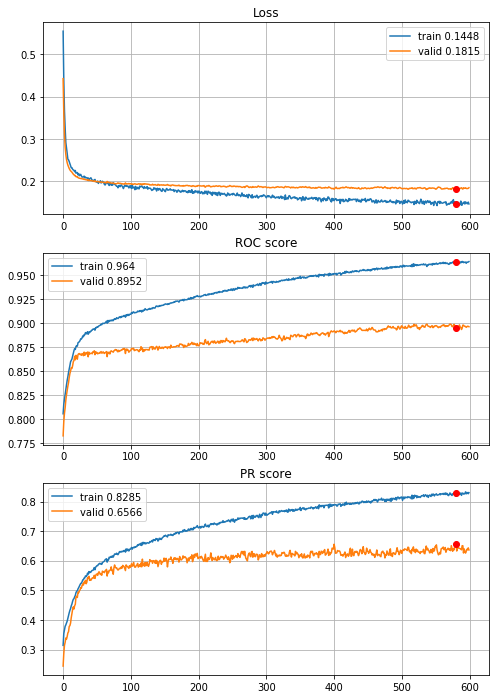


Fold 2------------------------------------------------------------


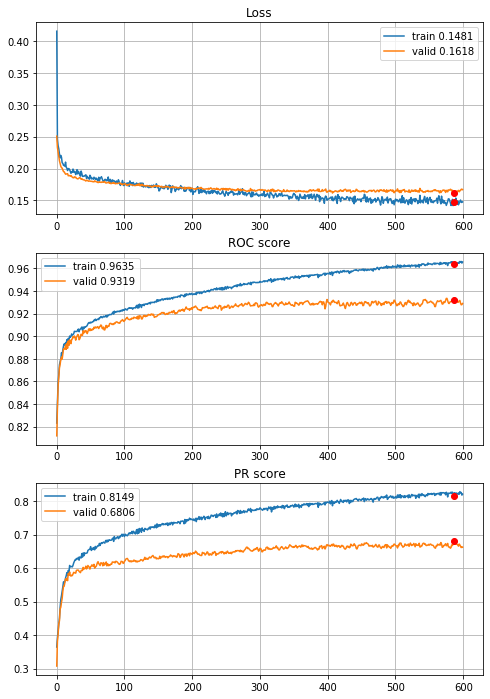


Fold 3------------------------------------------------------------


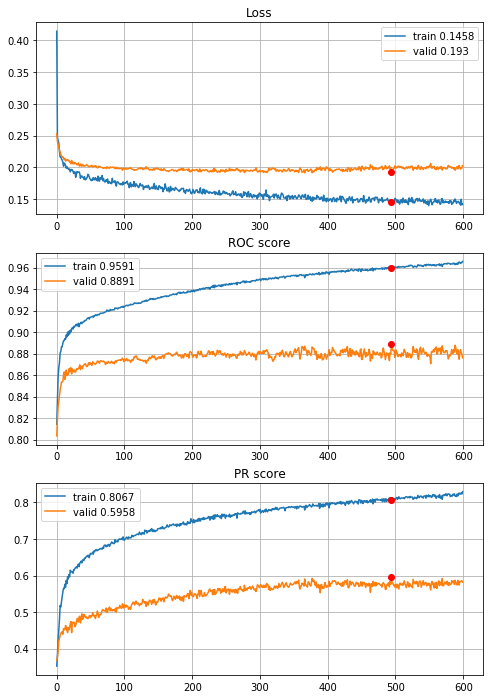


Fold 4------------------------------------------------------------


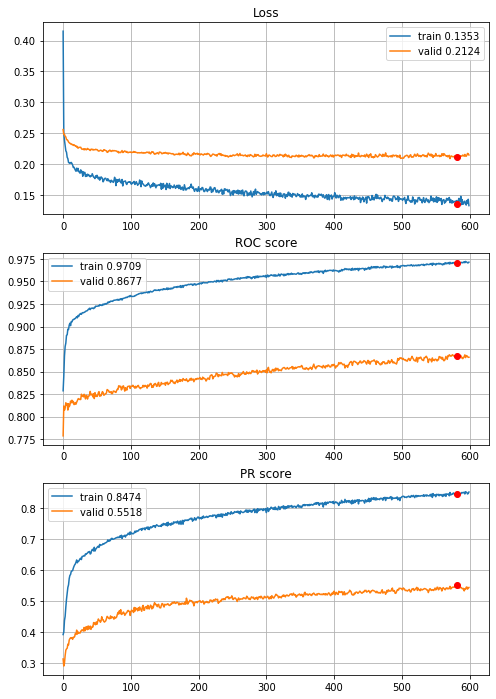


Fold 5------------------------------------------------------------


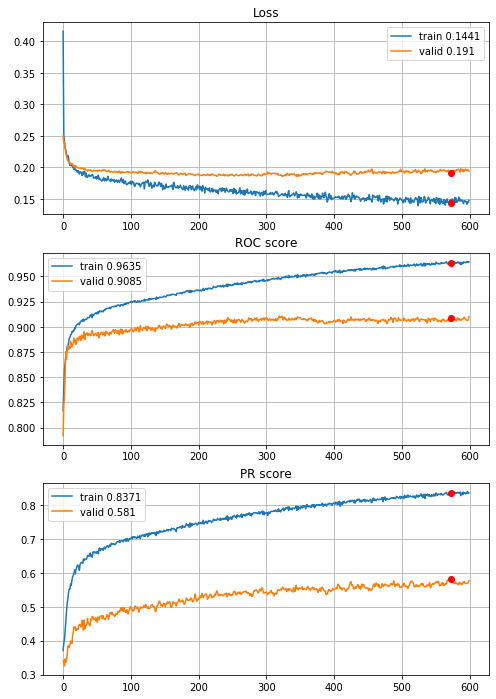


Fold 6------------------------------------------------------------


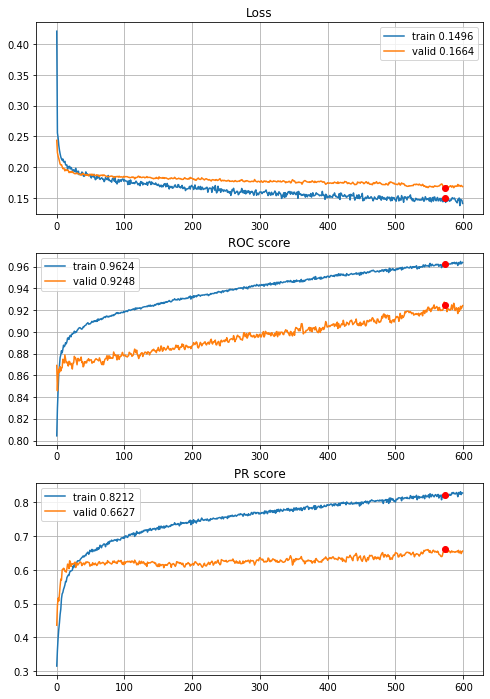

In [233]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=600,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)],
                                        opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

This performance is incredible! Lets try RMSprop optimization algorithm


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/600,
cumulative time: 24.98s train loss: 0.5044437757145197, validation loss: 0.389976565806949
Epoch: 2/600,
cumulative time: 25.1s train loss: 0.3906421504968555, validation loss: 0.32670868283059984
Epoch: 3/600,
cumulative time: 25.23s train loss: 0.33414147096259067, validation loss: 0.28784472701111397
Epoch: 4/600,
cumulative time: 25.35s train loss: 0.3006881804538333, validation loss: 0.26266878843307495
Epoch: 5/600,
cumulative time: 25.46s train loss: 0.2715658995353143, validation loss: 0.24748754121673955
Epoch: 6/600,
cumulative time: 25.58s train loss: 0.2613942376085782, validation loss: 0.24002230291705254
Epoch: 7/600,
cumulative time: 25.69s train loss: 0.25025666285884507, validation loss: 0.23450727184568748
Epoch: 8/600,
cumulative time: 25.79s train loss: 0.2395762029685591, validation loss: 0.23159072243239995
Epoch: 9/600,
cumulative time: 25.9s train loss: 0.2397476068230527

cumulative time: 32.67s train loss: 0.1936435369633488, validation loss: 0.1918752540528707
Epoch: 78/600,
cumulative time: 32.76s train loss: 0.19175055838233726, validation loss: 0.1934141761286283
Epoch: 79/600,
cumulative time: 32.86s train loss: 0.19061733279982412, validation loss: 0.1929172434861926
Epoch: 80/600,
cumulative time: 32.96s train loss: 0.18825285721045754, validation loss: 0.19315184110181308
Epoch: 81/600,
cumulative time: 33.06s train loss: 0.18842867839852825, validation loss: 0.19472761989782197
Epoch: 82/600,
cumulative time: 33.16s train loss: 0.18502263352274895, validation loss: 0.19335893362659748
Epoch: 83/600,
cumulative time: 33.25s train loss: 0.19027318330717, validation loss: 0.1951634806770886
Epoch: 84/600,
cumulative time: 33.36s train loss: 0.1912177383079318, validation loss: 0.19352135680439508
Epoch: 85/600,
cumulative time: 33.46s train loss: 0.18780456169336926, validation loss: 0.19474130341407278
Epoch: 86/600,
cumulative time: 33.56s trai

cumulative time: 48.01s train loss: 0.16872857650237608, validation loss: 0.18818921045628045
Epoch: 228/600,
cumulative time: 48.11s train loss: 0.1734936713721832, validation loss: 0.18789518870656896
Epoch: 229/600,
cumulative time: 48.21s train loss: 0.16708856648580583, validation loss: 0.18599379316325118
Epoch: 230/600,
cumulative time: 48.31s train loss: 0.17283220154767862, validation loss: 0.18680863756069066
Epoch: 231/600,
cumulative time: 48.41s train loss: 0.17512634158511023, validation loss: 0.18817629479501805
Epoch: 232/600,
cumulative time: 48.51s train loss: 0.17215130191013917, validation loss: 0.18680722784700363
Epoch: 233/600,
cumulative time: 48.62s train loss: 0.16754085616635608, validation loss: 0.18713780474904693
Epoch: 234/600,
cumulative time: 48.72s train loss: 0.17333401954104108, validation loss: 0.18710034707689233
Epoch: 235/600,
cumulative time: 48.81s train loss: 0.17060421313754273, validation loss: 0.18470798248032438
Epoch: 236/600,
cumulative 

cumulative time: 55.57s train loss: 0.16518065351185923, validation loss: 0.1873612007569299
Epoch: 303/600,
cumulative time: 55.67s train loss: 0.16522205598141312, validation loss: 0.18541898475088422
Epoch: 304/600,
cumulative time: 55.77s train loss: 0.16369045494857248, validation loss: 0.18612557750409459
Epoch: 305/600,
cumulative time: 55.86s train loss: 0.1652545821567197, validation loss: 0.18591856489455685
Epoch: 306/600,
cumulative time: 55.96s train loss: 0.16350214294282323, validation loss: 0.18407183641981514
Epoch: 307/600,
cumulative time: 56.06s train loss: 0.16195758075759298, validation loss: 0.18557490420180217
Epoch: 308/600,
cumulative time: 56.16s train loss: 0.162172514319904, validation loss: 0.18601790611477823
Epoch: 309/600,
cumulative time: 56.25s train loss: 0.16334025073957895, validation loss: 0.18500044199364027
Epoch: 310/600,
cumulative time: 56.35s train loss: 0.165260614208635, validation loss: 0.1854108878429202
Epoch: 311/600,
cumulative time: 

cumulative time: 63.16s train loss: 0.16145868210747355, validation loss: 0.1843212993968837
Epoch: 379/600,
cumulative time: 63.26s train loss: 0.16162298347747175, validation loss: 0.18546405080138897
Epoch: 380/600,
cumulative time: 63.36s train loss: 0.1599058098956566, validation loss: 0.1887038551195364
Epoch: 381/600,
cumulative time: 63.45s train loss: 0.15763456128631795, validation loss: 0.1846294504881174
Epoch: 382/600,
cumulative time: 63.55s train loss: 0.15303788835767804, validation loss: 0.18559484561777168
Epoch: 383/600,
cumulative time: 63.65s train loss: 0.15879913785962207, validation loss: 0.18385265448383709
Epoch: 384/600,
cumulative time: 63.74s train loss: 0.1595963307720229, validation loss: 0.18553748884760138
Epoch: 385/600,
cumulative time: 63.85s train loss: 0.15597665780610556, validation loss: 0.18560072467184657
Epoch: 386/600,
cumulative time: 63.96s train loss: 0.16188311592645485, validation loss: 0.1845408539290896
Epoch: 387/600,
cumulative time:

cumulative time: 71.13s train loss: 0.15964173093868506, validation loss: 0.18566865256432077
Epoch: 455/600,
cumulative time: 71.23s train loss: 0.1582158122292387, validation loss: 0.18640140347443143
Epoch: 456/600,
cumulative time: 71.32s train loss: 0.1589078994245951, validation loss: 0.18489734324486978
Epoch: 457/600,
cumulative time: 71.42s train loss: 0.1530068932262515, validation loss: 0.18736632178372703
Epoch: 458/600,
cumulative time: 71.52s train loss: 0.15417124091274365, validation loss: 0.18675379191337335
Epoch: 459/600,
cumulative time: 71.62s train loss: 0.1565487749592169, validation loss: 0.18700490307310658
Epoch: 460/600,
cumulative time: 71.71s train loss: 0.1531283602669889, validation loss: 0.18929569802867519
Epoch: 461/600,
cumulative time: 71.81s train loss: 0.15030806605109023, validation loss: 0.18655836610742996
Epoch: 462/600,
cumulative time: 71.91s train loss: 0.15448164568023776, validation loss: 0.18711445703178545
Epoch: 463/600,
cumulative time

Epoch: 530/600,
cumulative time: 79.04s train loss: 0.1560834402601749, validation loss: 0.1881294697355122
Epoch: 531/600,
cumulative time: 79.16s train loss: 0.14807167916898262, validation loss: 0.1869267934036631
Epoch: 532/600,
cumulative time: 79.27s train loss: 0.15164561308449678, validation loss: 0.18644615458461047
Epoch: 533/600,
cumulative time: 79.39s train loss: 0.1547045402316249, validation loss: 0.18763692016800468
Epoch: 534/600,
cumulative time: 79.51s train loss: 0.14479550650672793, validation loss: 0.18956701071111837
Epoch: 535/600,
cumulative time: 79.62s train loss: 0.1509144276898314, validation loss: 0.18777033584160896
Epoch: 536/600,
cumulative time: 79.73s train loss: 0.15366952231200917, validation loss: 0.18451489882780975
Epoch: 537/600,
cumulative time: 79.85s train loss: 0.15098967697700008, validation loss: 0.18630510192309857
Epoch: 538/600,
cumulative time: 79.96s train loss: 0.15065380466920375, validation loss: 0.18477444627911288
Epoch: 539/600,

Epoch: 3/600,
cumulative time: 25.31s train loss: 0.33522742934229144, validation loss: 0.2877218129602602
Epoch: 4/600,
cumulative time: 25.42s train loss: 0.3017951898707164, validation loss: 0.2627875645473818
Epoch: 5/600,
cumulative time: 25.53s train loss: 0.27108679231027616, validation loss: 0.2473311824419587
Epoch: 6/600,
cumulative time: 25.64s train loss: 0.25475144561124624, validation loss: 0.23833579100508834
Epoch: 7/600,
cumulative time: 25.74s train loss: 0.25056427356111227, validation loss: 0.23241363133155776
Epoch: 8/600,
cumulative time: 25.86s train loss: 0.24608204363162767, validation loss: 0.2285486623191242
Epoch: 9/600,
cumulative time: 25.95s train loss: 0.23494511012942781, validation loss: 0.22556101815541943
Epoch: 10/600,
cumulative time: 26.05s train loss: 0.2381864864486757, validation loss: 0.22321265707424556
Epoch: 11/600,
cumulative time: 26.15s train loss: 0.23449374179924007, validation loss: 0.220813598412403
Epoch: 12/600,
cumulative time: 26

Epoch: 79/600,
cumulative time: 33.41s train loss: 0.19116848882032214, validation loss: 0.18711779830219244
Epoch: 80/600,
cumulative time: 33.52s train loss: 0.1936335377933101, validation loss: 0.18660442757902176
Epoch: 81/600,
cumulative time: 33.64s train loss: 0.1916473375613186, validation loss: 0.18757102585564606
Epoch: 82/600,
cumulative time: 33.76s train loss: 0.19054349798319142, validation loss: 0.18652582398732323
Epoch: 83/600,
cumulative time: 33.87s train loss: 0.19533570705230485, validation loss: 0.18845896411103352
Epoch: 84/600,
cumulative time: 33.98s train loss: 0.19104388569706937, validation loss: 0.18716407946091493
Epoch: 85/600,
cumulative time: 34.1s train loss: 0.19112675951706373, validation loss: 0.18761969345129328
Epoch: 86/600,
cumulative time: 34.21s train loss: 0.1909386452408474, validation loss: 0.18629220536287366
Epoch: 87/600,
cumulative time: 34.33s train loss: 0.1918367249723053, validation loss: 0.18536825533515303
Epoch: 88/600,
cumulativ

cumulative time: 41.53s train loss: 0.18160454680073992, validation loss: 0.1793621622756745
Epoch: 156/600,
cumulative time: 41.63s train loss: 0.1823542533233923, validation loss: 0.17753262604505932
Epoch: 157/600,
cumulative time: 41.73s train loss: 0.1819683023415748, validation loss: 0.17786214205834347
Epoch: 158/600,
cumulative time: 41.83s train loss: 0.18113515591954926, validation loss: 0.1788321563799728
Epoch: 159/600,
cumulative time: 41.92s train loss: 0.1822996333053181, validation loss: 0.17889761751708746
Epoch: 160/600,
cumulative time: 42.02s train loss: 0.17847784519841095, validation loss: 0.179258709376533
Epoch: 161/600,
cumulative time: 42.12s train loss: 0.1803451931164583, validation loss: 0.1793753492657469
Epoch: 162/600,
cumulative time: 42.22s train loss: 0.1834460484058956, validation loss: 0.17920722326068492
Epoch: 163/600,
cumulative time: 42.32s train loss: 0.181365621414049, validation loss: 0.17881952535272855
Epoch: 164/600,
cumulative time: 42.43

cumulative time: 49.47s train loss: 0.17447239895509253, validation loss: 0.17070564056464219
Epoch: 233/600,
cumulative time: 49.57s train loss: 0.17297098277614112, validation loss: 0.17146992868205202
Epoch: 234/600,
cumulative time: 49.67s train loss: 0.17654474670679346, validation loss: 0.17081953128201313
Epoch: 235/600,
cumulative time: 49.77s train loss: 0.17081369692291593, validation loss: 0.1693881636878146
Epoch: 236/600,
cumulative time: 49.87s train loss: 0.16858639021400726, validation loss: 0.16998118330150205
Epoch: 237/600,
cumulative time: 49.98s train loss: 0.1709485407716961, validation loss: 0.17051901019009286
Epoch: 238/600,
cumulative time: 50.08s train loss: 0.1690623936199647, validation loss: 0.17552929686586108
Epoch: 239/600,
cumulative time: 50.18s train loss: 0.1712457940170696, validation loss: 0.17189000276460184
Epoch: 240/600,
cumulative time: 50.28s train loss: 0.17155477515546208, validation loss: 0.17195548342274167
Epoch: 241/600,
cumulative tim

Epoch: 310/600,
cumulative time: 57.57s train loss: 0.16354187378585877, validation loss: 0.17016672301856883
Epoch: 311/600,
cumulative time: 57.68s train loss: 0.165931528867878, validation loss: 0.16691964333026493
Epoch: 312/600,
cumulative time: 57.78s train loss: 0.16965558521772334, validation loss: 0.16695449740668966
Epoch: 313/600,
cumulative time: 57.88s train loss: 0.16657997823121962, validation loss: 0.16937637683571125
Epoch: 314/600,
cumulative time: 57.98s train loss: 0.16315461592311678, validation loss: 0.1680125457559121
Epoch: 315/600,
cumulative time: 58.09s train loss: 0.16299201966354132, validation loss: 0.16822168829072826
Epoch: 316/600,
cumulative time: 58.2s train loss: 0.17015182380883917, validation loss: 0.1720829535498291
Epoch: 317/600,
cumulative time: 58.3s train loss: 0.1680542534748462, validation loss: 0.16751730366449347
Epoch: 318/600,
cumulative time: 58.4s train loss: 0.17093630492794815, validation loss: 0.16812105641491384
Epoch: 319/600,
cu

Epoch: 386/600,
cumulative time: 65.4s train loss: 0.1621030928358597, validation loss: 0.16641961644574782
Epoch: 387/600,
cumulative time: 65.49s train loss: 0.15970114601056498, validation loss: 0.16694310766969217
Epoch: 388/600,
cumulative time: 65.59s train loss: 0.16429238350530717, validation loss: 0.1655567722077972
Epoch: 389/600,
cumulative time: 65.69s train loss: 0.15717973479402625, validation loss: 0.16449341778522683
Epoch: 390/600,
cumulative time: 65.8s train loss: 0.1601659245789051, validation loss: 0.1651384203349321
Epoch: 391/600,
cumulative time: 65.91s train loss: 0.1604223198993703, validation loss: 0.16585564868694766
Epoch: 392/600,
cumulative time: 66.0s train loss: 0.15953776933629374, validation loss: 0.16665193659443464
Epoch: 393/600,
cumulative time: 66.1s train loss: 0.16236934906698844, validation loss: 0.16546460575389485
Epoch: 394/600,
cumulative time: 66.21s train loss: 0.15898592409338225, validation loss: 0.171023691990733
Epoch: 395/600,
cumul

Epoch: 462/600,
cumulative time: 73.49s train loss: 0.15557438679483285, validation loss: 0.163684792203457
Epoch: 463/600,
cumulative time: 73.6s train loss: 0.16148142016321312, validation loss: 0.16202845344616032
Epoch: 464/600,
cumulative time: 73.69s train loss: 0.15457575788405398, validation loss: 0.16378112307832637
Epoch: 465/600,
cumulative time: 73.8s train loss: 0.15104114089416684, validation loss: 0.16280608599020638
Epoch: 466/600,
cumulative time: 73.89s train loss: 0.15585979598739086, validation loss: 0.1663453920146927
Epoch: 467/600,
cumulative time: 73.99s train loss: 0.15466312952474137, validation loss: 0.16455530549117112
Epoch: 468/600,
cumulative time: 74.09s train loss: 0.15588883531451334, validation loss: 0.16499348650891188
Epoch: 469/600,
cumulative time: 74.2s train loss: 0.15597794193855155, validation loss: 0.16499866159651702
Epoch: 470/600,
cumulative time: 74.31s train loss: 0.15893962282001542, validation loss: 0.16177767846132748
Epoch: 471/600,


Epoch: 538/600,
cumulative time: 81.73s train loss: 0.15119474522419785, validation loss: 0.1616539603777507
Epoch: 539/600,
cumulative time: 81.84s train loss: 0.15663872518331243, validation loss: 0.16372025495115772
Epoch: 540/600,
cumulative time: 81.94s train loss: 0.15371667477722525, validation loss: 0.16154955589583117
Epoch: 541/600,
cumulative time: 82.04s train loss: 0.15559886581523324, validation loss: 0.1609068733410072
Epoch: 542/600,
cumulative time: 82.14s train loss: 0.15762218746225543, validation loss: 0.1605928947197813
Epoch: 543/600,
cumulative time: 82.24s train loss: 0.15676745805983508, validation loss: 0.15922324198981685
Epoch: 544/600,
cumulative time: 82.34s train loss: 0.15848365164822512, validation loss: 0.160041859144557
Epoch: 545/600,
cumulative time: 82.45s train loss: 0.1569895428749951, validation loss: 0.15999260223906364
Epoch: 546/600,
cumulative time: 82.56s train loss: 0.15385603853619056, validation loss: 0.16028635534788602
Epoch: 547/600,


cumulative time: 21.48s train loss: 0.22911509121717744, validation loss: 0.22979959341557749
Epoch: 12/600,
cumulative time: 21.58s train loss: 0.23050466738641262, validation loss: 0.22835004926063834
Epoch: 13/600,
cumulative time: 21.67s train loss: 0.22805366484912293, validation loss: 0.22668759681057635
Epoch: 14/600,
cumulative time: 21.77s train loss: 0.22504117848210387, validation loss: 0.22528482829099847
Epoch: 15/600,
cumulative time: 21.87s train loss: 0.22323421009611136, validation loss: 0.22382152377887132
Epoch: 16/600,
cumulative time: 21.97s train loss: 0.2224206406797958, validation loss: 0.22269803784544062
Epoch: 17/600,
cumulative time: 22.06s train loss: 0.22030221934460562, validation loss: 0.2233489056820262
Epoch: 18/600,
cumulative time: 22.16s train loss: 0.21751519196434788, validation loss: 0.222114712991064
Epoch: 19/600,
cumulative time: 22.26s train loss: 0.21865305751696607, validation loss: 0.22185431506480546
Epoch: 20/600,
cumulative time: 22.36s

Epoch: 87/600,
cumulative time: 29.02s train loss: 0.18971937525318094, validation loss: 0.20497514786284832
Epoch: 88/600,
cumulative time: 29.13s train loss: 0.18400647660670297, validation loss: 0.20480421400527138
Epoch: 89/600,
cumulative time: 29.24s train loss: 0.18197369323337337, validation loss: 0.2072413978508118
Epoch: 90/600,
cumulative time: 29.35s train loss: 0.18588571839491813, validation loss: 0.2080115779411161
Epoch: 91/600,
cumulative time: 29.46s train loss: 0.18762201295378836, validation loss: 0.20779738226630373
Epoch: 92/600,
cumulative time: 29.56s train loss: 0.18907724731073913, validation loss: 0.20491244517090357
Epoch: 93/600,
cumulative time: 29.67s train loss: 0.18467155248868122, validation loss: 0.2036588976354986
Epoch: 94/600,
cumulative time: 29.78s train loss: 0.18387633868718406, validation loss: 0.20691621044845968
Epoch: 95/600,
cumulative time: 29.89s train loss: 0.1837730587389495, validation loss: 0.20593344592389556
Epoch: 96/600,
cumulati

Epoch: 164/600,
cumulative time: 37.19s train loss: 0.1713574760348035, validation loss: 0.20044856599984603
Epoch: 165/600,
cumulative time: 37.3s train loss: 0.1727764184959905, validation loss: 0.1945010311439583
Epoch: 166/600,
cumulative time: 37.41s train loss: 0.17564593898367795, validation loss: 0.1979019981898208
Epoch: 167/600,
cumulative time: 37.52s train loss: 0.172065546541115, validation loss: 0.20021567428999043
Epoch: 168/600,
cumulative time: 37.63s train loss: 0.17278204780973036, validation loss: 0.2005922235590495
Epoch: 169/600,
cumulative time: 37.74s train loss: 0.17811691579459377, validation loss: 0.1963802548513875
Epoch: 170/600,
cumulative time: 37.85s train loss: 0.17265776632225902, validation loss: 0.20179244200567786
Epoch: 171/600,
cumulative time: 37.96s train loss: 0.1747020634583833, validation loss: 0.1979637533728676
Epoch: 172/600,
cumulative time: 38.07s train loss: 0.17901950312731282, validation loss: 0.19820546060632557
Epoch: 173/600,
cumul

Epoch: 240/600,
cumulative time: 45.55s train loss: 0.16575436986014516, validation loss: 0.1930855504387261
Epoch: 241/600,
cumulative time: 45.66s train loss: 0.16714807079318197, validation loss: 0.19774602467809482
Epoch: 242/600,
cumulative time: 45.77s train loss: 0.16527582887923245, validation loss: 0.1968631335988792
Epoch: 243/600,
cumulative time: 45.88s train loss: 0.1652842254078668, validation loss: 0.19582221600759392
Epoch: 244/600,
cumulative time: 45.99s train loss: 0.16379053217597603, validation loss: 0.19696369437918723
Epoch: 245/600,
cumulative time: 46.1s train loss: 0.16273275141466395, validation loss: 0.19520809409852227
Epoch: 246/600,
cumulative time: 46.21s train loss: 0.16433867520319856, validation loss: 0.19760981089568863
Epoch: 247/600,
cumulative time: 46.31s train loss: 0.16855825605509728, validation loss: 0.19464607659429145
Epoch: 248/600,
cumulative time: 46.42s train loss: 0.16892937223161386, validation loss: 0.19366197336754912
Epoch: 249/600

Epoch: 316/600,
cumulative time: 53.74s train loss: 0.15875883364128723, validation loss: 0.19849279018910654
Epoch: 317/600,
cumulative time: 53.85s train loss: 0.16039049114009857, validation loss: 0.19501892501633225
Epoch: 318/600,
cumulative time: 53.95s train loss: 0.16088346397295755, validation loss: 0.19693530544957824
Epoch: 319/600,
cumulative time: 54.05s train loss: 0.1572214073168672, validation loss: 0.1975424629053376
Epoch: 320/600,
cumulative time: 54.15s train loss: 0.1583104745992577, validation loss: 0.19375056434074142
Epoch: 321/600,
cumulative time: 54.26s train loss: 0.16255500659830735, validation loss: 0.19711463380155594
Epoch: 322/600,
cumulative time: 54.36s train loss: 0.1601416949512242, validation loss: 0.198926855185255
Epoch: 323/600,
cumulative time: 54.48s train loss: 0.1640425714452344, validation loss: 0.2001786967224978
Epoch: 324/600,
cumulative time: 54.59s train loss: 0.16048657340048023, validation loss: 0.19491243606019584
Epoch: 325/600,
cu

Epoch: 392/600,
cumulative time: 62.13s train loss: 0.1577605083517542, validation loss: 0.19403504245109193
Epoch: 393/600,
cumulative time: 62.24s train loss: 0.15493474190631068, validation loss: 0.19508319772284355
Epoch: 394/600,
cumulative time: 62.35s train loss: 0.15081009057616068, validation loss: 0.1966779077805688
Epoch: 395/600,
cumulative time: 62.46s train loss: 0.1604854201171749, validation loss: 0.19604088031721492
Epoch: 396/600,
cumulative time: 62.57s train loss: 0.1524457802511886, validation loss: 0.19515474775665373
Epoch: 397/600,
cumulative time: 62.69s train loss: 0.15297331344941462, validation loss: 0.19802099086655034
Epoch: 398/600,
cumulative time: 62.8s train loss: 0.1563760770236004, validation loss: 0.20274100668535158
Epoch: 399/600,
cumulative time: 62.91s train loss: 0.15168515043097822, validation loss: 0.19936663194600462
Epoch: 400/600,
cumulative time: 63.02s train loss: 0.1563452756308046, validation loss: 0.19772211688212638
Epoch: 401/600,
c

Epoch: 543/600,
cumulative time: 78.9s train loss: 0.14927276102523404, validation loss: 0.2004249635516858
Epoch: 544/600,
cumulative time: 79.01s train loss: 0.14991236814980258, validation loss: 0.20179628259098112
Epoch: 545/600,
cumulative time: 79.12s train loss: 0.15074343656253622, validation loss: 0.19757778594835232
Epoch: 546/600,
cumulative time: 79.23s train loss: 0.14625213460640357, validation loss: 0.20047798447033732
Epoch: 547/600,
cumulative time: 79.34s train loss: 0.151122030839055, validation loss: 0.2072122910447427
Epoch: 548/600,
cumulative time: 79.45s train loss: 0.1468460563778716, validation loss: 0.1994929898282452
Epoch: 549/600,
cumulative time: 79.56s train loss: 0.15483010004842754, validation loss: 0.19864734226109076
Epoch: 550/600,
cumulative time: 79.67s train loss: 0.1492005780722529, validation loss: 0.19869381868046326
Epoch: 551/600,
cumulative time: 79.78s train loss: 0.14532600523103767, validation loss: 0.2004064231304601
Epoch: 552/600,
cum

Epoch: 17/600,
cumulative time: 27.77s train loss: 0.2207200761616378, validation loss: 0.23649117636492237
Epoch: 18/600,
cumulative time: 27.88s train loss: 0.2139970831541076, validation loss: 0.23660152713278346
Epoch: 19/600,
cumulative time: 28.0s train loss: 0.2120020619309731, validation loss: 0.23553285618264302
Epoch: 20/600,
cumulative time: 28.11s train loss: 0.21170247832727895, validation loss: 0.2355494058226355
Epoch: 21/600,
cumulative time: 28.22s train loss: 0.2146502751382242, validation loss: 0.23572162607722574
Epoch: 22/600,
cumulative time: 28.33s train loss: 0.21002772582550766, validation loss: 0.23404552079484908
Epoch: 23/600,
cumulative time: 28.45s train loss: 0.21653450538752822, validation loss: 0.23374512216442056
Epoch: 24/600,
cumulative time: 28.56s train loss: 0.20556824723754002, validation loss: 0.23375963784636547
Epoch: 25/600,
cumulative time: 28.67s train loss: 0.20879223195513671, validation loss: 0.2340162447559107
Epoch: 26/600,
cumulative 

Epoch: 93/600,
cumulative time: 36.13s train loss: 0.18276799342620462, validation loss: 0.22279813458499736
Epoch: 94/600,
cumulative time: 36.24s train loss: 0.18184436582736443, validation loss: 0.2233775487131782
Epoch: 95/600,
cumulative time: 36.35s train loss: 0.17837841548286118, validation loss: 0.22318826403897718
Epoch: 96/600,
cumulative time: 36.46s train loss: 0.17831079306880535, validation loss: 0.22217932417484224
Epoch: 97/600,
cumulative time: 36.57s train loss: 0.18232834197290052, validation loss: 0.22405337432975425
Epoch: 98/600,
cumulative time: 36.68s train loss: 0.18187585854245286, validation loss: 0.22573512140030785
Epoch: 99/600,
cumulative time: 36.79s train loss: 0.1842533375235086, validation loss: 0.22156055254807053
Epoch: 100/600,
cumulative time: 36.91s train loss: 0.181801860962553, validation loss: 0.2229666032115708
Epoch: 101/600,
cumulative time: 37.02s train loss: 0.17914003505882656, validation loss: 0.22303985425903888
Epoch: 102/600,
cumula

Epoch: 169/600,
cumulative time: 44.61s train loss: 0.1738184646575359, validation loss: 0.21795016628086702
Epoch: 170/600,
cumulative time: 44.73s train loss: 0.17269352729880405, validation loss: 0.2179946657228147
Epoch: 171/600,
cumulative time: 44.84s train loss: 0.17336496647582644, validation loss: 0.21935695204589492
Epoch: 172/600,
cumulative time: 44.95s train loss: 0.16938779346296973, validation loss: 0.21880005703688207
Epoch: 173/600,
cumulative time: 45.06s train loss: 0.1717531722002849, validation loss: 0.2158396988098024
Epoch: 174/600,
cumulative time: 45.17s train loss: 0.1696389505281261, validation loss: 0.21802528397627932
Epoch: 175/600,
cumulative time: 45.28s train loss: 0.17018362822609026, validation loss: 0.2176119211565022
Epoch: 176/600,
cumulative time: 45.39s train loss: 0.17126164993091816, validation loss: 0.220830307150802
Epoch: 177/600,
cumulative time: 45.5s train loss: 0.17319114866588553, validation loss: 0.21952774501815606
Epoch: 178/600,
cum

cumulative time: 52.79s train loss: 0.161506475107196, validation loss: 0.21654734657930197
Epoch: 246/600,
cumulative time: 52.89s train loss: 0.1651386267379743, validation loss: 0.2142702878597897
Epoch: 247/600,
cumulative time: 52.99s train loss: 0.16319509730929585, validation loss: 0.21600124391287767
Epoch: 248/600,
cumulative time: 53.11s train loss: 0.15970134282660706, validation loss: 0.21382355986007448
Epoch: 249/600,
cumulative time: 53.22s train loss: 0.16126569528061246, validation loss: 0.21428752692235511
Epoch: 250/600,
cumulative time: 53.33s train loss: 0.16249896014836582, validation loss: 0.21665208209852602
Epoch: 251/600,
cumulative time: 53.44s train loss: 0.16635678506364088, validation loss: 0.2152111898291999
Epoch: 252/600,
cumulative time: 53.6s train loss: 0.15787853299226876, validation loss: 0.21502636759867785
Epoch: 253/600,
cumulative time: 53.71s train loss: 0.16544889135148813, validation loss: 0.2139332039159792
Epoch: 254/600,
cumulative time: 

cumulative time: 60.65s train loss: 0.15956993274325149, validation loss: 0.21667291109637266
Epoch: 321/600,
cumulative time: 60.75s train loss: 0.15412788872938782, validation loss: 0.21474640249667803
Epoch: 322/600,
cumulative time: 60.85s train loss: 0.15602492614857855, validation loss: 0.21503803450151707
Epoch: 323/600,
cumulative time: 60.95s train loss: 0.15354188328103396, validation loss: 0.21396299927552181
Epoch: 324/600,
cumulative time: 61.04s train loss: 0.15660044231897224, validation loss: 0.2168357158689413
Epoch: 325/600,
cumulative time: 61.14s train loss: 0.1554047066391442, validation loss: 0.21247792432324342
Epoch: 326/600,
cumulative time: 61.24s train loss: 0.15772923503466876, validation loss: 0.21824394179924347
Epoch: 327/600,
cumulative time: 61.34s train loss: 0.1550456351562141, validation loss: 0.21510767408606699
Epoch: 328/600,
cumulative time: 61.43s train loss: 0.1580657312819201, validation loss: 0.21497264766800753
Epoch: 329/600,
cumulative tim

cumulative time: 75.8s train loss: 0.1477451957989137, validation loss: 0.21899154092738107
Epoch: 471/600,
cumulative time: 75.9s train loss: 0.14825214492146596, validation loss: 0.212118356747229
Epoch: 472/600,
cumulative time: 76.0s train loss: 0.14752930734023376, validation loss: 0.21136725318889316
Epoch: 473/600,
cumulative time: 76.11s train loss: 0.15093531152840636, validation loss: 0.21136781388292464
Epoch: 474/600,
cumulative time: 76.2s train loss: 0.15223641329046406, validation loss: 0.21122603330332324
Epoch: 475/600,
cumulative time: 76.3s train loss: 0.14947572564960412, validation loss: 0.21084844766701855
Epoch: 476/600,
cumulative time: 76.39s train loss: 0.1519650857725021, validation loss: 0.21211188429499855
Epoch: 477/600,
cumulative time: 76.49s train loss: 0.14915366395518012, validation loss: 0.21424368329968463
Epoch: 478/600,
cumulative time: 76.59s train loss: 0.15190663480634967, validation loss: 0.21025111174744893
Epoch: 479/600,
cumulative time: 76

Epoch: 19/600,
cumulative time: 22.9s train loss: 0.2149018177142026, validation loss: 0.21773171952965567
Epoch: 20/600,
cumulative time: 23.01s train loss: 0.21977947222414712, validation loss: 0.21708021873006972
Epoch: 21/600,
cumulative time: 23.12s train loss: 0.22026582757721574, validation loss: 0.21688312265189452
Epoch: 22/600,
cumulative time: 23.23s train loss: 0.21639818250258996, validation loss: 0.2152962769060049
Epoch: 23/600,
cumulative time: 23.34s train loss: 0.21784136859633277, validation loss: 0.2149339065662087
Epoch: 24/600,
cumulative time: 23.46s train loss: 0.21359137613591023, validation loss: 0.21478712370379516
Epoch: 25/600,
cumulative time: 23.55s train loss: 0.21025416235501035, validation loss: 0.21269780404142546
Epoch: 26/600,
cumulative time: 23.65s train loss: 0.21282084284868355, validation loss: 0.21319242965421611
Epoch: 27/600,
cumulative time: 23.75s train loss: 0.21507142441161944, validation loss: 0.21101776979712278
Epoch: 28/600,
cumulati

Epoch: 95/600,
cumulative time: 30.47s train loss: 0.1835427236643059, validation loss: 0.1978060351537528
Epoch: 96/600,
cumulative time: 30.58s train loss: 0.18356999994238585, validation loss: 0.19685675563715382
Epoch: 97/600,
cumulative time: 30.69s train loss: 0.1863212424538191, validation loss: 0.1967352442022909
Epoch: 98/600,
cumulative time: 30.8s train loss: 0.1850935631886901, validation loss: 0.19617532883217856
Epoch: 99/600,
cumulative time: 30.92s train loss: 0.18604735158486368, validation loss: 0.1966566863568588
Epoch: 100/600,
cumulative time: 31.03s train loss: 0.18453388106680443, validation loss: 0.1952437836819793
Epoch: 101/600,
cumulative time: 31.15s train loss: 0.18842425201564672, validation loss: 0.19655674877608065
Epoch: 102/600,
cumulative time: 31.26s train loss: 0.184952120744776, validation loss: 0.19571191190193254
Epoch: 103/600,
cumulative time: 31.37s train loss: 0.18793672500709743, validation loss: 0.1957893469801875
Epoch: 104/600,
cumulative

Epoch: 171/600,
cumulative time: 38.83s train loss: 0.174667525087741, validation loss: 0.19099462826149727
Epoch: 172/600,
cumulative time: 38.94s train loss: 0.1763610947375477, validation loss: 0.1909113931332969
Epoch: 173/600,
cumulative time: 39.06s train loss: 0.17604198088306836, validation loss: 0.19769521037423585
Epoch: 174/600,
cumulative time: 39.17s train loss: 0.17845920478211227, validation loss: 0.19306427401828982
Epoch: 175/600,
cumulative time: 39.29s train loss: 0.17598617263600488, validation loss: 0.1936226984986333
Epoch: 176/600,
cumulative time: 39.4s train loss: 0.17427743296375292, validation loss: 0.19258236007146856
Epoch: 177/600,
cumulative time: 39.51s train loss: 0.17041961645706227, validation loss: 0.19319369800338357
Epoch: 178/600,
cumulative time: 39.62s train loss: 0.17385839866699065, validation loss: 0.1919937210481269
Epoch: 179/600,
cumulative time: 39.74s train loss: 0.17857434132850494, validation loss: 0.19372494774397556
Epoch: 180/600,
c

Epoch: 247/600,
cumulative time: 46.7s train loss: 0.16643390588558152, validation loss: 0.18704380300190324
Epoch: 248/600,
cumulative time: 46.81s train loss: 0.17073399189522648, validation loss: 0.18810423942909285
Epoch: 249/600,
cumulative time: 46.92s train loss: 0.1648298500791888, validation loss: 0.18713536343913584
Epoch: 250/600,
cumulative time: 47.02s train loss: 0.16835934883405843, validation loss: 0.18640192357600407
Epoch: 251/600,
cumulative time: 47.13s train loss: 0.17037971844502128, validation loss: 0.18552065353092168
Epoch: 252/600,
cumulative time: 47.23s train loss: 0.16273834604577503, validation loss: 0.1882595020949706
Epoch: 253/600,
cumulative time: 47.34s train loss: 0.17146835441369385, validation loss: 0.1869747916543457
Epoch: 254/600,
cumulative time: 47.5s train loss: 0.16881531307222933, validation loss: 0.18780952268206508
Epoch: 255/600,
cumulative time: 47.62s train loss: 0.16440509380711785, validation loss: 0.1885912033222599
Epoch: 256/600,


cumulative time: 54.7s train loss: 0.159709225382892, validation loss: 0.1873866401730488
Epoch: 324/600,
cumulative time: 54.8s train loss: 0.16428524805008088, validation loss: 0.18400963878523954
Epoch: 325/600,
cumulative time: 54.9s train loss: 0.1646144070973279, validation loss: 0.1858101102689588
Epoch: 326/600,
cumulative time: 55.0s train loss: 0.16454461793745717, validation loss: 0.18358641936870515
Epoch: 327/600,
cumulative time: 55.1s train loss: 0.16165920786144447, validation loss: 0.1853073625814834
Epoch: 328/600,
cumulative time: 55.2s train loss: 0.15808326867802966, validation loss: 0.1835007376582036
Epoch: 329/600,
cumulative time: 55.3s train loss: 0.1644856859491825, validation loss: 0.18794974163342815
Epoch: 330/600,
cumulative time: 55.41s train loss: 0.15828343326368316, validation loss: 0.18448938523539032
Epoch: 331/600,
cumulative time: 55.51s train loss: 0.1606351698080896, validation loss: 0.18469366326961775
Epoch: 332/600,
cumulative time: 55.61s tr

Epoch: 474/600,
cumulative time: 70.18s train loss: 0.1471235761618523, validation loss: 0.18386947839577633
Epoch: 475/600,
cumulative time: 70.29s train loss: 0.15513801350836665, validation loss: 0.18788165587334815
Epoch: 476/600,
cumulative time: 70.41s train loss: 0.15343675373667065, validation loss: 0.18788473042354628
Epoch: 477/600,
cumulative time: 70.52s train loss: 0.15261957676610208, validation loss: 0.19087481855269747
Epoch: 478/600,
cumulative time: 70.62s train loss: 0.15455321243888714, validation loss: 0.1855953389244747
Epoch: 479/600,
cumulative time: 70.73s train loss: 0.15214152586411708, validation loss: 0.1847187393675001
Epoch: 480/600,
cumulative time: 70.84s train loss: 0.15347246225009833, validation loss: 0.18396672330645353
Epoch: 481/600,
cumulative time: 70.95s train loss: 0.15152382702072345, validation loss: 0.18608946169875815
Epoch: 482/600,
cumulative time: 71.06s train loss: 0.15657465421579342, validation loss: 0.18638050465363143
Epoch: 483/60

Epoch: 550/600,
cumulative time: 78.57s train loss: 0.15152198992906563, validation loss: 0.18313202285470598
Epoch: 551/600,
cumulative time: 78.68s train loss: 0.14654494603197057, validation loss: 0.18315156900721263
Epoch: 552/600,
cumulative time: 78.79s train loss: 0.15438072875851355, validation loss: 0.18606244680171088
Epoch: 553/600,
cumulative time: 78.9s train loss: 0.15417954393240443, validation loss: 0.18796205470174485
Epoch: 554/600,
cumulative time: 79.01s train loss: 0.15406579712686058, validation loss: 0.1845515607172964
Epoch: 555/600,
cumulative time: 79.12s train loss: 0.1496452789055341, validation loss: 0.18631894371848612
Epoch: 556/600,
cumulative time: 79.24s train loss: 0.1494181672320822, validation loss: 0.18983919720079237
Epoch: 557/600,
cumulative time: 79.35s train loss: 0.14474284932598852, validation loss: 0.186217945262487
Epoch: 558/600,
cumulative time: 79.46s train loss: 0.15705946964830894, validation loss: 0.18657228488550767
Epoch: 559/600,


Epoch: 23/600,
cumulative time: 28.99s train loss: 0.21758495034226008, validation loss: 0.20040258492761487
Epoch: 24/600,
cumulative time: 29.11s train loss: 0.2170387232428664, validation loss: 0.19946888206909258
Epoch: 25/600,
cumulative time: 29.22s train loss: 0.21205098457094942, validation loss: 0.2023674987979721
Epoch: 26/600,
cumulative time: 29.33s train loss: 0.2124186425446496, validation loss: 0.19904258985148057
Epoch: 27/600,
cumulative time: 29.45s train loss: 0.2110278300425013, validation loss: 0.19930152282219707
Epoch: 28/600,
cumulative time: 29.57s train loss: 0.2134446047369148, validation loss: 0.19719283874766821
Epoch: 29/600,
cumulative time: 29.68s train loss: 0.21700890435877757, validation loss: 0.19670916333559135
Epoch: 30/600,
cumulative time: 29.8s train loss: 0.20798653303171802, validation loss: 0.1972176378117727
Epoch: 31/600,
cumulative time: 29.91s train loss: 0.2093798702924321, validation loss: 0.19617953354967904
Epoch: 32/600,
cumulative t

Epoch: 100/600,
cumulative time: 37.65s train loss: 0.18667328306266853, validation loss: 0.18813681044104943
Epoch: 101/600,
cumulative time: 37.76s train loss: 0.1918855344814881, validation loss: 0.18900821770017895
Epoch: 102/600,
cumulative time: 37.87s train loss: 0.18911454379188808, validation loss: 0.18813763552137208
Epoch: 103/600,
cumulative time: 37.98s train loss: 0.18990469996382736, validation loss: 0.18792500331762413
Epoch: 104/600,
cumulative time: 38.08s train loss: 0.1850636074041745, validation loss: 0.18924151495536348
Epoch: 105/600,
cumulative time: 38.18s train loss: 0.1880010260286273, validation loss: 0.18693290095835183
Epoch: 106/600,
cumulative time: 38.29s train loss: 0.18371159152900718, validation loss: 0.1873443692451675
Epoch: 107/600,
cumulative time: 38.4s train loss: 0.18203563475928833, validation loss: 0.19142937313756878
Epoch: 108/600,
cumulative time: 38.52s train loss: 0.18879150408480846, validation loss: 0.18590706448926345
Epoch: 109/600,

Epoch: 176/600,
cumulative time: 46.1s train loss: 0.18146653890192926, validation loss: 0.18240599105508817
Epoch: 177/600,
cumulative time: 46.21s train loss: 0.1771990189481314, validation loss: 0.1830416248089573
Epoch: 178/600,
cumulative time: 46.33s train loss: 0.17681527875923503, validation loss: 0.18227853940518124
Epoch: 179/600,
cumulative time: 46.44s train loss: 0.1761787921096142, validation loss: 0.18241495630676535
Epoch: 180/600,
cumulative time: 46.55s train loss: 0.1778216332889641, validation loss: 0.18681056797504425
Epoch: 181/600,
cumulative time: 46.66s train loss: 0.18000377763374487, validation loss: 0.1838308328901403
Epoch: 182/600,
cumulative time: 46.76s train loss: 0.17644677542279436, validation loss: 0.18295253712355955
Epoch: 183/600,
cumulative time: 46.87s train loss: 0.17632391364787411, validation loss: 0.1810918321189708
Epoch: 184/600,
cumulative time: 46.98s train loss: 0.1731709331415212, validation loss: 0.1817071365516288
Epoch: 185/600,
cum

Epoch: 252/600,
cumulative time: 54.52s train loss: 0.17105498530446286, validation loss: 0.18010867731834912
Epoch: 253/600,
cumulative time: 54.63s train loss: 0.16649549054946206, validation loss: 0.18179811574266402
Epoch: 254/600,
cumulative time: 54.74s train loss: 0.16610260310141842, validation loss: 0.17980458377177236
Epoch: 255/600,
cumulative time: 54.85s train loss: 0.1651891719036438, validation loss: 0.1795102406301563
Epoch: 256/600,
cumulative time: 54.96s train loss: 0.1637772615001483, validation loss: 0.17940809461656057
Epoch: 257/600,
cumulative time: 55.07s train loss: 0.1661176980819117, validation loss: 0.179521784791828
Epoch: 258/600,
cumulative time: 55.18s train loss: 0.16124370875004693, validation loss: 0.18357239431506087
Epoch: 259/600,
cumulative time: 55.29s train loss: 0.1674146405476871, validation loss: 0.17988562883292042
Epoch: 260/600,
cumulative time: 55.4s train loss: 0.16828190060842932, validation loss: 0.17985252477649102
Epoch: 261/600,
cu

Epoch: 328/600,
cumulative time: 62.98s train loss: 0.16177057201736483, validation loss: 0.17869477364198888
Epoch: 329/600,
cumulative time: 63.09s train loss: 0.16328182329772262, validation loss: 0.17867263176102133
Epoch: 330/600,
cumulative time: 63.2s train loss: 0.16172845789710152, validation loss: 0.17974902716366487
Epoch: 331/600,
cumulative time: 63.3s train loss: 0.16630975079541815, validation loss: 0.17847270473131477
Epoch: 332/600,
cumulative time: 63.4s train loss: 0.16367338300961393, validation loss: 0.18041453189290135
Epoch: 333/600,
cumulative time: 63.5s train loss: 0.15845777985811932, validation loss: 0.17968563691757064
Epoch: 334/600,
cumulative time: 63.6s train loss: 0.16344190692790012, validation loss: 0.1798818747830445
Epoch: 335/600,
cumulative time: 63.72s train loss: 0.16140343613221741, validation loss: 0.1790278878559108
Epoch: 336/600,
cumulative time: 63.83s train loss: 0.16277841098914156, validation loss: 0.1787124140604355
Epoch: 337/600,
cu

Epoch: 403/600,
cumulative time: 71.18s train loss: 0.1568590237389508, validation loss: 0.17725328596531673
Epoch: 404/600,
cumulative time: 71.3s train loss: 0.16086245366003882, validation loss: 0.17848224978280122
Epoch: 405/600,
cumulative time: 71.39s train loss: 0.16063820282801963, validation loss: 0.17576012368530505
Epoch: 406/600,
cumulative time: 71.49s train loss: 0.1610508087157746, validation loss: 0.17604157722157765
Epoch: 407/600,
cumulative time: 71.6s train loss: 0.15908971025164984, validation loss: 0.17752829937445122
Epoch: 408/600,
cumulative time: 71.71s train loss: 0.1579850364015088, validation loss: 0.17471480487297136
Epoch: 409/600,
cumulative time: 71.82s train loss: 0.16281853407997862, validation loss: 0.17551899847677546
Epoch: 410/600,
cumulative time: 71.93s train loss: 0.15635548661759818, validation loss: 0.17444366021565336
Epoch: 411/600,
cumulative time: 72.04s train loss: 0.15916636425849684, validation loss: 0.175798466290362
Epoch: 412/600,
c

Epoch: 479/600,
cumulative time: 79.63s train loss: 0.154022698881205, validation loss: 0.17610517658848257
Epoch: 480/600,
cumulative time: 79.74s train loss: 0.1548456736001424, validation loss: 0.17441471085860552
Epoch: 481/600,
cumulative time: 79.84s train loss: 0.15641064764064133, validation loss: 0.17555022027772382
Epoch: 482/600,
cumulative time: 79.95s train loss: 0.15589095123856755, validation loss: 0.1766693220719796
Epoch: 483/600,
cumulative time: 80.05s train loss: 0.15255104075926518, validation loss: 0.17627427372114385
Epoch: 484/600,
cumulative time: 80.16s train loss: 0.15545600290333958, validation loss: 0.17645481356648773
Epoch: 485/600,
cumulative time: 80.26s train loss: 0.15652342071765543, validation loss: 0.17806689535387482
Epoch: 486/600,
cumulative time: 80.36s train loss: 0.15412373033732665, validation loss: 0.1793039411508203
Epoch: 487/600,
cumulative time: 80.46s train loss: 0.15454867535968034, validation loss: 0.17855414041816248
Epoch: 488/600,

Epoch: 555/600,
cumulative time: 87.96s train loss: 0.15194122784701905, validation loss: 0.17242153062911927
Epoch: 556/600,
cumulative time: 88.07s train loss: 0.15340073275937202, validation loss: 0.17617594159752736
Epoch: 557/600,
cumulative time: 88.18s train loss: 0.15087463670932705, validation loss: 0.17136834272547177
Epoch: 558/600,
cumulative time: 88.29s train loss: 0.1550695515703515, validation loss: 0.17335059448370277
Epoch: 559/600,
cumulative time: 88.41s train loss: 0.15585565377768829, validation loss: 0.17459211987916287
Epoch: 560/600,
cumulative time: 88.52s train loss: 0.1504799270539797, validation loss: 0.1732019216293137
Epoch: 561/600,
cumulative time: 88.63s train loss: 0.15001809018851672, validation loss: 0.1728846095418284
Epoch: 562/600,
cumulative time: 88.74s train loss: 0.15075049577913247, validation loss: 0.17078659590964393
Epoch: 563/600,
cumulative time: 88.85s train loss: 0.15371928504377624, validation loss: 0.17300464209530747
Epoch: 564/600

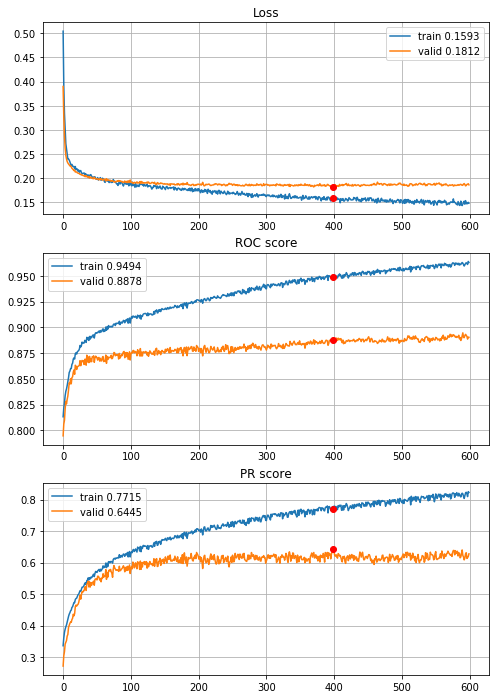


Fold 2------------------------------------------------------------


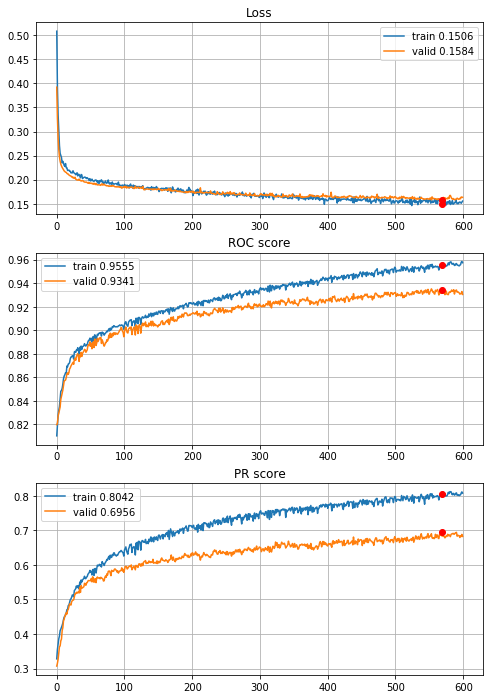


Fold 3------------------------------------------------------------


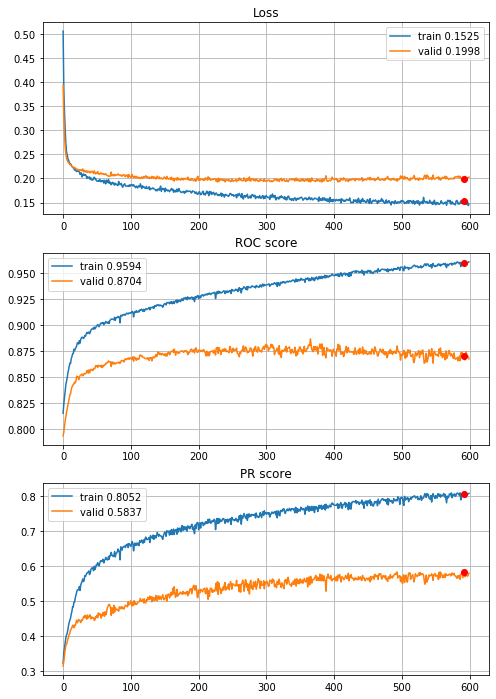


Fold 4------------------------------------------------------------


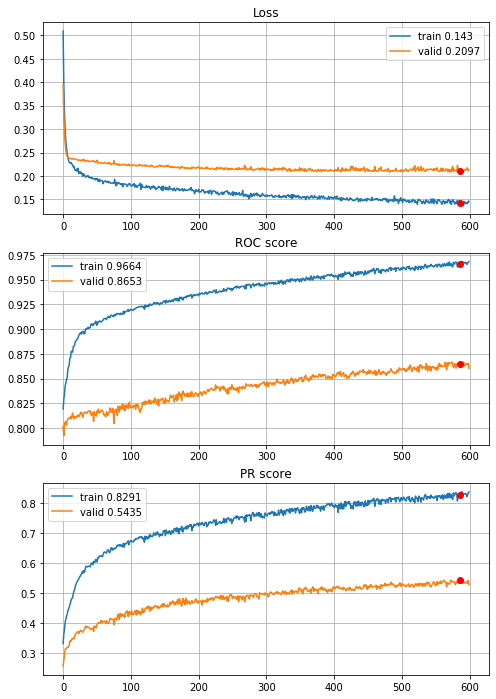


Fold 5------------------------------------------------------------


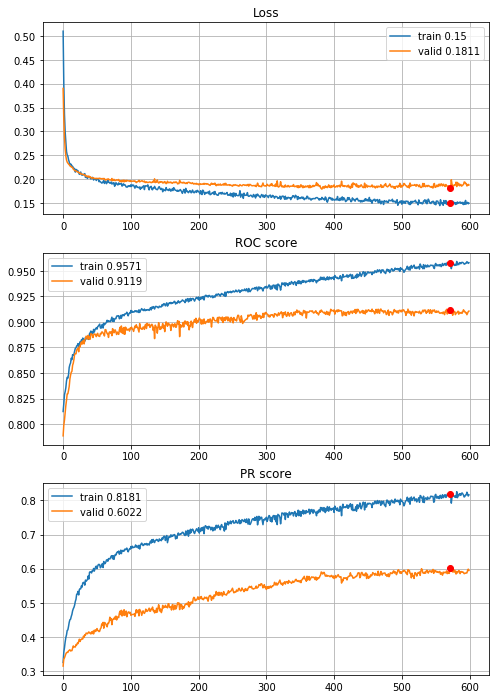


Fold 6------------------------------------------------------------


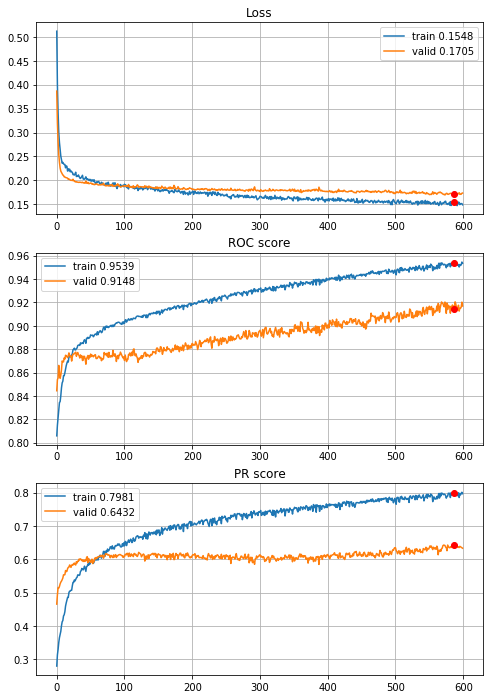

In [234]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=600,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)],
                                        opti=optimizers.RMSprop())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Both optimizers work well, there seems to be no point to perform deep analysis, lets pick Adam, because of higher results and try other learning rates

learning rate goes from 0.001 to 0.0005 and number of epochs from 600 to 800


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/800,
cumulative time: 20.68s train loss: 0.588267006060707, validation loss: 0.5028740189457155
Epoch: 2/800,
cumulative time: 20.8s train loss: 0.5115627389710518, validation loss: 0.44371809557567454
Epoch: 3/800,
cumulative time: 20.91s train loss: 0.4601002057025794, validation loss: 0.3992923860687011
Epoch: 4/800,
cumulative time: 21.03s train loss: 0.4215978053717837, validation loss: 0.36434858570373047
Epoch: 5/800,
cumulative time: 21.14s train loss: 0.38143274738093574, validation loss: 0.33705268361791546
Epoch: 6/800,
cumulative time: 21.25s train loss: 0.36068664756116026, validation loss: 0.3159990754511875
Epoch: 7/800,
cumulative time: 21.35s train loss: 0.3397727027965797, validation loss: 0.29952532251227937
Epoch: 8/800,
cumulative time: 21.46s train loss: 0.314744624985039, validation loss: 0.28644504776936375
Epoch: 9/800,
cumulative time: 21.57s train loss: 0.30811805322443536,

Epoch: 78/800,
cumulative time: 28.68s train loss: 0.20423311221712548, validation loss: 0.19960621765393685
Epoch: 79/800,
cumulative time: 28.79s train loss: 0.20242500348211626, validation loss: 0.20003714759360575
Epoch: 80/800,
cumulative time: 28.89s train loss: 0.20108230018631862, validation loss: 0.19951839177221428
Epoch: 81/800,
cumulative time: 29.0s train loss: 0.19945914658048738, validation loss: 0.19949488294769704
Epoch: 82/800,
cumulative time: 29.1s train loss: 0.1976710590147262, validation loss: 0.20026554617497402
Epoch: 83/800,
cumulative time: 29.21s train loss: 0.20155166357163917, validation loss: 0.20039179526361833
Epoch: 84/800,
cumulative time: 29.31s train loss: 0.2013267972086311, validation loss: 0.20020563389765772
Epoch: 85/800,
cumulative time: 29.42s train loss: 0.19976901626785956, validation loss: 0.19991585350224775
Epoch: 86/800,
cumulative time: 29.53s train loss: 0.20358178936725058, validation loss: 0.2000431189105637
Epoch: 87/800,
cumulativ

Epoch: 154/800,
cumulative time: 36.53s train loss: 0.1937479059807015, validation loss: 0.1942069141578513
Epoch: 155/800,
cumulative time: 36.64s train loss: 0.1895964907529337, validation loss: 0.19499487674290056
Epoch: 156/800,
cumulative time: 36.76s train loss: 0.1903102297389658, validation loss: 0.1942431202836612
Epoch: 157/800,
cumulative time: 36.87s train loss: 0.1902603729483453, validation loss: 0.1934623223516288
Epoch: 158/800,
cumulative time: 36.97s train loss: 0.19030219605629625, validation loss: 0.19376588400281133
Epoch: 159/800,
cumulative time: 37.07s train loss: 0.19310334540015953, validation loss: 0.19421277471567086
Epoch: 160/800,
cumulative time: 37.17s train loss: 0.19047841329517562, validation loss: 0.19286253685478158
Epoch: 161/800,
cumulative time: 37.26s train loss: 0.19089938372050813, validation loss: 0.19358932105099871
Epoch: 162/800,
cumulative time: 37.37s train loss: 0.1913453108775648, validation loss: 0.19417186504756986
Epoch: 163/800,
cu

Epoch: 230/800,
cumulative time: 44.49s train loss: 0.18345482919418962, validation loss: 0.1913339786290316
Epoch: 231/800,
cumulative time: 44.61s train loss: 0.18768263018491682, validation loss: 0.19229050143595613
Epoch: 232/800,
cumulative time: 44.72s train loss: 0.18460221973244464, validation loss: 0.1920879777046309
Epoch: 233/800,
cumulative time: 44.83s train loss: 0.17943475462012126, validation loss: 0.191795673788333
Epoch: 234/800,
cumulative time: 44.96s train loss: 0.18377651437605977, validation loss: 0.19127417252458875
Epoch: 235/800,
cumulative time: 45.07s train loss: 0.18261136689529306, validation loss: 0.19157798235486298
Epoch: 236/800,
cumulative time: 45.19s train loss: 0.18323838664386893, validation loss: 0.1917291347781593
Epoch: 237/800,
cumulative time: 45.31s train loss: 0.18344092904337908, validation loss: 0.19110492621091738
Epoch: 238/800,
cumulative time: 45.43s train loss: 0.18286413081420672, validation loss: 0.19117526458040837
Epoch: 239/800,

Epoch: 306/800,
cumulative time: 52.94s train loss: 0.17959976603784716, validation loss: 0.1891780889928005
Epoch: 307/800,
cumulative time: 53.05s train loss: 0.17669325804048713, validation loss: 0.18891819810921068
Epoch: 308/800,
cumulative time: 53.16s train loss: 0.17753391954308168, validation loss: 0.1887122338392017
Epoch: 309/800,
cumulative time: 53.28s train loss: 0.1773297014891671, validation loss: 0.1881811553622851
Epoch: 310/800,
cumulative time: 53.39s train loss: 0.1804828718170147, validation loss: 0.18879344520130717
Epoch: 311/800,
cumulative time: 53.5s train loss: 0.1776002543954858, validation loss: 0.18949377407417492
Epoch: 312/800,
cumulative time: 53.62s train loss: 0.1809093463991093, validation loss: 0.1892321260463291
Epoch: 313/800,
cumulative time: 53.73s train loss: 0.1772218415116898, validation loss: 0.18931567702513805
Epoch: 314/800,
cumulative time: 53.84s train loss: 0.17604215708746163, validation loss: 0.1892872325395651
Epoch: 315/800,
cumul

cumulative time: 61.17s train loss: 0.17025228794865874, validation loss: 0.187520381092622
Epoch: 383/800,
cumulative time: 61.28s train loss: 0.17435904936562377, validation loss: 0.18771027653502234
Epoch: 384/800,
cumulative time: 61.4s train loss: 0.17404587510031805, validation loss: 0.18727227843869498
Epoch: 385/800,
cumulative time: 61.51s train loss: 0.16720799863042599, validation loss: 0.18733110529997438
Epoch: 386/800,
cumulative time: 61.61s train loss: 0.1760000777178669, validation loss: 0.18749506391895665
Epoch: 387/800,
cumulative time: 61.72s train loss: 0.17157852501416787, validation loss: 0.18741609189730754
Epoch: 388/800,
cumulative time: 61.82s train loss: 0.17176361650981628, validation loss: 0.18779126795800455
Epoch: 389/800,
cumulative time: 61.93s train loss: 0.16851670728048262, validation loss: 0.18699072689456359
Epoch: 390/800,
cumulative time: 62.03s train loss: 0.17463566749507986, validation loss: 0.18691758151253288
Epoch: 391/800,
cumulative tim

Epoch: 457/800,
cumulative time: 69.17s train loss: 0.1695988862523103, validation loss: 0.18585511813572322
Epoch: 458/800,
cumulative time: 69.28s train loss: 0.16795837575576472, validation loss: 0.18571132030065057
Epoch: 459/800,
cumulative time: 69.38s train loss: 0.17079571943851155, validation loss: 0.1860568379435222
Epoch: 460/800,
cumulative time: 69.49s train loss: 0.16623394211438158, validation loss: 0.1855065440580568
Epoch: 461/800,
cumulative time: 69.6s train loss: 0.16501891304358893, validation loss: 0.1859280913900227
Epoch: 462/800,
cumulative time: 69.71s train loss: 0.16837996224929924, validation loss: 0.18625035120978564
Epoch: 463/800,
cumulative time: 69.81s train loss: 0.17131889234246545, validation loss: 0.18604468687814413
Epoch: 464/800,
cumulative time: 69.91s train loss: 0.16444612672680228, validation loss: 0.1857828705192553
Epoch: 465/800,
cumulative time: 70.02s train loss: 0.1652401814620525, validation loss: 0.18682861996745312
Epoch: 466/800,
c

Epoch: 533/800,
cumulative time: 77.23s train loss: 0.16737262113860368, validation loss: 0.183392966663824
Epoch: 534/800,
cumulative time: 77.34s train loss: 0.1599463447726698, validation loss: 0.18427095605058358
Epoch: 535/800,
cumulative time: 77.44s train loss: 0.1633374059727476, validation loss: 0.18440887622594027
Epoch: 536/800,
cumulative time: 77.55s train loss: 0.16835138256180804, validation loss: 0.1841328736760033
Epoch: 537/800,
cumulative time: 77.65s train loss: 0.16605376119352205, validation loss: 0.18300521306550757
Epoch: 538/800,
cumulative time: 77.76s train loss: 0.1647032536767988, validation loss: 0.18253361172512123
Epoch: 539/800,
cumulative time: 77.87s train loss: 0.16861454819729182, validation loss: 0.18233246434366554
Epoch: 540/800,
cumulative time: 77.98s train loss: 0.16723484975295916, validation loss: 0.18337553353159108
Epoch: 541/800,
cumulative time: 78.09s train loss: 0.16448959569692181, validation loss: 0.18375478095239556
Epoch: 542/800,


Epoch: 609/800,
cumulative time: 85.31s train loss: 0.1608943866787727, validation loss: 0.18228888436059942
Epoch: 610/800,
cumulative time: 85.41s train loss: 0.16453218587845672, validation loss: 0.18176441874014887
Epoch: 611/800,
cumulative time: 85.51s train loss: 0.16399856295692147, validation loss: 0.1806976156479342
Epoch: 612/800,
cumulative time: 85.62s train loss: 0.16336911066774856, validation loss: 0.1803892896570509
Epoch: 613/800,
cumulative time: 85.72s train loss: 0.15844395998798122, validation loss: 0.18100329356639738
Epoch: 614/800,
cumulative time: 85.83s train loss: 0.16512771602383805, validation loss: 0.1815673117069139
Epoch: 615/800,
cumulative time: 85.93s train loss: 0.16323447471571959, validation loss: 0.1820423544595583
Epoch: 616/800,
cumulative time: 86.04s train loss: 0.15987454779069563, validation loss: 0.182818499331813
Epoch: 617/800,
cumulative time: 86.17s train loss: 0.16589018904909975, validation loss: 0.18254638576655405
Epoch: 618/800,
c

Epoch: 685/800,
cumulative time: 93.4s train loss: 0.15630173606508907, validation loss: 0.18128581049410036
Epoch: 686/800,
cumulative time: 93.51s train loss: 0.15762358560943002, validation loss: 0.1805084802991508
Epoch: 687/800,
cumulative time: 93.61s train loss: 0.16183827857113703, validation loss: 0.1803385418122624
Epoch: 688/800,
cumulative time: 93.72s train loss: 0.16077190844698502, validation loss: 0.180240386250726
Epoch: 689/800,
cumulative time: 93.82s train loss: 0.15890832069171895, validation loss: 0.180498650757409
Epoch: 690/800,
cumulative time: 93.93s train loss: 0.15267121219933572, validation loss: 0.18022975777491104
Epoch: 691/800,
cumulative time: 94.03s train loss: 0.15767998861599486, validation loss: 0.17996732072470017
Epoch: 692/800,
cumulative time: 94.15s train loss: 0.15940320342510186, validation loss: 0.17988541703818212
Epoch: 693/800,
cumulative time: 94.26s train loss: 0.15658153852763912, validation loss: 0.1802431084089645
Epoch: 694/800,
cu

Epoch: 762/800,
cumulative time: 101.64s train loss: 0.15587614609486683, validation loss: 0.18069239557125388
Epoch: 763/800,
cumulative time: 101.75s train loss: 0.1557955947008643, validation loss: 0.18108616513961331
Epoch: 764/800,
cumulative time: 101.85s train loss: 0.16289389251129507, validation loss: 0.18179589185733538
Epoch: 765/800,
cumulative time: 101.95s train loss: 0.15467989023115875, validation loss: 0.18219530229638367
Epoch: 766/800,
cumulative time: 102.05s train loss: 0.1553401729824956, validation loss: 0.1823120682322858
Epoch: 767/800,
cumulative time: 102.16s train loss: 0.15071810768843236, validation loss: 0.1820176629834675
Epoch: 768/800,
cumulative time: 102.26s train loss: 0.15752208396953796, validation loss: 0.18069021966572948
Epoch: 769/800,
cumulative time: 102.37s train loss: 0.1617736905503897, validation loss: 0.18028935351594863
Epoch: 770/800,
cumulative time: 102.48s train loss: 0.15551015107290625, validation loss: 0.18131587183126063
Epoch:

cumulative time: 31.0s train loss: 0.19885895630539754, validation loss: 0.194252095906549
Epoch: 37/800,
cumulative time: 31.11s train loss: 0.20581636559688873, validation loss: 0.1929259898798307
Epoch: 38/800,
cumulative time: 31.22s train loss: 0.2046061229929059, validation loss: 0.1925944323234655
Epoch: 39/800,
cumulative time: 31.33s train loss: 0.1969297352761353, validation loss: 0.19237443742582735
Epoch: 40/800,
cumulative time: 31.43s train loss: 0.19821380910930975, validation loss: 0.19236773699354023
Epoch: 41/800,
cumulative time: 31.54s train loss: 0.19900725288014012, validation loss: 0.19156535273877717
Epoch: 42/800,
cumulative time: 31.65s train loss: 0.19978056476192568, validation loss: 0.19070675928805028
Epoch: 43/800,
cumulative time: 31.76s train loss: 0.20069037714051857, validation loss: 0.19091540388552958
Epoch: 44/800,
cumulative time: 31.86s train loss: 0.1993588115347529, validation loss: 0.1899023578494888
Epoch: 45/800,
cumulative time: 31.97s trai

Epoch: 113/800,
cumulative time: 39.13s train loss: 0.18267010126787403, validation loss: 0.18324053670534823
Epoch: 114/800,
cumulative time: 39.24s train loss: 0.18836108847968414, validation loss: 0.1830055658551187
Epoch: 115/800,
cumulative time: 39.35s train loss: 0.18662418090210495, validation loss: 0.1827958182861195
Epoch: 116/800,
cumulative time: 39.46s train loss: 0.18658490402334865, validation loss: 0.1824137197372744
Epoch: 117/800,
cumulative time: 39.57s train loss: 0.18672657079510524, validation loss: 0.182402800999607
Epoch: 118/800,
cumulative time: 39.68s train loss: 0.1860756271582648, validation loss: 0.1825952807939039
Epoch: 119/800,
cumulative time: 39.8s train loss: 0.18790317018136435, validation loss: 0.18302969271663613
Epoch: 120/800,
cumulative time: 39.91s train loss: 0.18645501152918226, validation loss: 0.1825099988276687
Epoch: 121/800,
cumulative time: 40.02s train loss: 0.18824049989803818, validation loss: 0.18276294629092685
Epoch: 122/800,
cum

cumulative time: 47.14s train loss: 0.1814780237240589, validation loss: 0.17886559431689972
Epoch: 189/800,
cumulative time: 47.24s train loss: 0.17717016749218484, validation loss: 0.17842609271524723
Epoch: 190/800,
cumulative time: 47.34s train loss: 0.17799665603706014, validation loss: 0.17865986056970232
Epoch: 191/800,
cumulative time: 47.44s train loss: 0.17678713482478464, validation loss: 0.17804344519216825
Epoch: 192/800,
cumulative time: 47.55s train loss: 0.17733460087799854, validation loss: 0.17801682546886005
Epoch: 193/800,
cumulative time: 47.65s train loss: 0.18208579098409047, validation loss: 0.17820528423436732
Epoch: 194/800,
cumulative time: 47.74s train loss: 0.17898631898773706, validation loss: 0.17834475785997836
Epoch: 195/800,
cumulative time: 47.85s train loss: 0.18305876475863078, validation loss: 0.17906568368231163
Epoch: 196/800,
cumulative time: 47.97s train loss: 0.18656436764779719, validation loss: 0.17854713891310514
Epoch: 197/800,
cumulative 

Epoch: 264/800,
cumulative time: 55.21s train loss: 0.17417089802478625, validation loss: 0.1759773072321493
Epoch: 265/800,
cumulative time: 55.31s train loss: 0.1769948819255463, validation loss: 0.17582690816586827
Epoch: 266/800,
cumulative time: 55.41s train loss: 0.1763386368845667, validation loss: 0.17615157256602165
Epoch: 267/800,
cumulative time: 55.52s train loss: 0.17141098838084334, validation loss: 0.17600686948960637
Epoch: 268/800,
cumulative time: 55.63s train loss: 0.17534888352163217, validation loss: 0.1764515243731061
Epoch: 269/800,
cumulative time: 55.73s train loss: 0.17429411243849066, validation loss: 0.17779139265535648
Epoch: 270/800,
cumulative time: 55.85s train loss: 0.17731866976145372, validation loss: 0.17624366972196465
Epoch: 271/800,
cumulative time: 55.96s train loss: 0.1740444378275088, validation loss: 0.17630178275546468
Epoch: 272/800,
cumulative time: 56.07s train loss: 0.17705325754729204, validation loss: 0.17663312418619434
Epoch: 273/800,

cumulative time: 63.3s train loss: 0.17125312762758577, validation loss: 0.17292866104081894
Epoch: 341/800,
cumulative time: 63.41s train loss: 0.172027569714705, validation loss: 0.17385138248711857
Epoch: 342/800,
cumulative time: 63.52s train loss: 0.16861145255838383, validation loss: 0.17311708022669176
Epoch: 343/800,
cumulative time: 63.62s train loss: 0.1693583426371701, validation loss: 0.17342071567810105
Epoch: 344/800,
cumulative time: 63.74s train loss: 0.16654755572522806, validation loss: 0.17246259428065147
Epoch: 345/800,
cumulative time: 63.85s train loss: 0.1690803495595494, validation loss: 0.17324079620193064
Epoch: 346/800,
cumulative time: 63.96s train loss: 0.1698864298647384, validation loss: 0.17376546336604617
Epoch: 347/800,
cumulative time: 64.06s train loss: 0.16887135873632741, validation loss: 0.17302208009943484
Epoch: 348/800,
cumulative time: 64.17s train loss: 0.1688950705251216, validation loss: 0.17310589657762543
Epoch: 349/800,
cumulative time: 

Epoch: 416/800,
cumulative time: 71.4s train loss: 0.17182262944535012, validation loss: 0.17047059644337034
Epoch: 417/800,
cumulative time: 71.5s train loss: 0.1661854633987488, validation loss: 0.17085682799810756
Epoch: 418/800,
cumulative time: 71.61s train loss: 0.17088702031233036, validation loss: 0.17061987885493438
Epoch: 419/800,
cumulative time: 71.72s train loss: 0.16650300601746093, validation loss: 0.17107563029886502
Epoch: 420/800,
cumulative time: 71.83s train loss: 0.16435172547004606, validation loss: 0.1715635667222194
Epoch: 421/800,
cumulative time: 71.95s train loss: 0.16608679667787646, validation loss: 0.17149273483366143
Epoch: 422/800,
cumulative time: 72.06s train loss: 0.16732396964077914, validation loss: 0.1706606060804079
Epoch: 423/800,
cumulative time: 72.17s train loss: 0.16669590006303378, validation loss: 0.17079658466974
Epoch: 424/800,
cumulative time: 72.27s train loss: 0.1672322411386007, validation loss: 0.1711882208185239
Epoch: 425/800,
cumu

cumulative time: 79.45s train loss: 0.1609117748377179, validation loss: 0.16950216301398724
Epoch: 492/800,
cumulative time: 79.56s train loss: 0.16320435256303864, validation loss: 0.1693567540559586
Epoch: 493/800,
cumulative time: 79.66s train loss: 0.16395316442427652, validation loss: 0.1696334305600491
Epoch: 494/800,
cumulative time: 79.77s train loss: 0.1677011406311382, validation loss: 0.17069659241829005
Epoch: 495/800,
cumulative time: 79.86s train loss: 0.15937666088638539, validation loss: 0.170627790464355
Epoch: 496/800,
cumulative time: 79.96s train loss: 0.16124463036306713, validation loss: 0.16981003407426726
Epoch: 497/800,
cumulative time: 80.06s train loss: 0.16089106747873855, validation loss: 0.16982403760429435
Epoch: 498/800,
cumulative time: 80.17s train loss: 0.16359695626106718, validation loss: 0.1699279851312702
Epoch: 499/800,
cumulative time: 80.27s train loss: 0.16203676980150197, validation loss: 0.1688299818970305
Epoch: 500/800,
cumulative time: 8

cumulative time: 87.47s train loss: 0.1638304180455552, validation loss: 0.16754047030828717
Epoch: 568/800,
cumulative time: 87.58s train loss: 0.1606310543466346, validation loss: 0.16753207916538773
Epoch: 569/800,
cumulative time: 87.68s train loss: 0.16720495131606444, validation loss: 0.16692588575763928
Epoch: 570/800,
cumulative time: 87.79s train loss: 0.16092758412920072, validation loss: 0.16722341292572399
Epoch: 571/800,
cumulative time: 87.9s train loss: 0.16364067683285538, validation loss: 0.16762299118343038
Epoch: 572/800,
cumulative time: 88.01s train loss: 0.1600948196570204, validation loss: 0.1677966503575528
Epoch: 573/800,
cumulative time: 88.12s train loss: 0.16205947202653875, validation loss: 0.167903237901586
Epoch: 574/800,
cumulative time: 88.24s train loss: 0.15816561914711438, validation loss: 0.1678397639779523
Epoch: 575/800,
cumulative time: 88.34s train loss: 0.16225033850553663, validation loss: 0.1673401505880587
Epoch: 576/800,
cumulative time: 88

Epoch: 644/800,
cumulative time: 95.73s train loss: 0.15985714150626307, validation loss: 0.16651333846664212
Epoch: 645/800,
cumulative time: 95.84s train loss: 0.15541570852191225, validation loss: 0.1665743213008329
Epoch: 646/800,
cumulative time: 95.94s train loss: 0.1603704621268954, validation loss: 0.16601665365890828
Epoch: 647/800,
cumulative time: 96.04s train loss: 0.16022701825045507, validation loss: 0.16592920495967856
Epoch: 648/800,
cumulative time: 96.15s train loss: 0.15497039482064734, validation loss: 0.16664291580607685
Epoch: 649/800,
cumulative time: 96.26s train loss: 0.16060526718113183, validation loss: 0.16814170907993864
Epoch: 650/800,
cumulative time: 96.37s train loss: 0.15748571172786963, validation loss: 0.1665903182853572
Epoch: 651/800,
cumulative time: 96.48s train loss: 0.1566252950713415, validation loss: 0.1651980175795254
Epoch: 652/800,
cumulative time: 96.59s train loss: 0.16079109646917897, validation loss: 0.16515767354236782
Epoch: 653/800,

cumulative time: 103.78s train loss: 0.1539402618493199, validation loss: 0.16457141299124098
Epoch: 720/800,
cumulative time: 103.88s train loss: 0.1589225106923051, validation loss: 0.16568644793353463
Epoch: 721/800,
cumulative time: 103.98s train loss: 0.1566852359538259, validation loss: 0.1648013056702114
Epoch: 722/800,
cumulative time: 104.09s train loss: 0.15927787603211963, validation loss: 0.16444955400811778
Epoch: 723/800,
cumulative time: 104.19s train loss: 0.16011199160455475, validation loss: 0.16600759284572913
Epoch: 724/800,
cumulative time: 104.29s train loss: 0.15708298548141542, validation loss: 0.1666329723804887
Epoch: 725/800,
cumulative time: 104.4s train loss: 0.1524757631929988, validation loss: 0.1653086925523929
Epoch: 726/800,
cumulative time: 104.51s train loss: 0.15661184835358646, validation loss: 0.16493321230305358
Epoch: 727/800,
cumulative time: 104.62s train loss: 0.15098020282409252, validation loss: 0.16511030909274585
Epoch: 728/800,
cumulativ

Epoch: 795/800,
cumulative time: 111.95s train loss: 0.1552208398169559, validation loss: 0.16391124249579808
Epoch: 796/800,
cumulative time: 112.05s train loss: 0.15400319911257132, validation loss: 0.16435477924622435
Epoch: 797/800,
cumulative time: 112.15s train loss: 0.15672015535245087, validation loss: 0.16376220549140735
Epoch: 798/800,
cumulative time: 112.26s train loss: 0.15145988497439275, validation loss: 0.1629727326392321
Epoch: 799/800,
cumulative time: 112.36s train loss: 0.15232573801295207, validation loss: 0.16275482167822666
Epoch: 800/800,
cumulative time: 112.48s train loss: 0.1534902529743927, validation loss: 0.16233437798136116

Early stopping results:
best results in epoch: 799, 
best valid PR: 0.6725972497121934, 
valid ROC: 0.9316324535679373        
overfitting PR: 0.11997507972820909, 
overfitting ROC: 0.02064550517256203

----------
Fold: 3
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/800,
cumulative time: 25.85s train loss: 0.4870

cumulative time: 33.01s train loss: 0.18907623857071468, validation loss: 0.20543027545714995
Epoch: 70/800,
cumulative time: 33.12s train loss: 0.19225592530645189, validation loss: 0.20437106125585927
Epoch: 71/800,
cumulative time: 33.23s train loss: 0.18921663452760193, validation loss: 0.20518030812533355
Epoch: 72/800,
cumulative time: 33.33s train loss: 0.18596290201890125, validation loss: 0.20534135147576402
Epoch: 73/800,
cumulative time: 33.43s train loss: 0.18846494080465193, validation loss: 0.20648181750916844
Epoch: 74/800,
cumulative time: 33.55s train loss: 0.19041505722927488, validation loss: 0.20511764840652333
Epoch: 75/800,
cumulative time: 33.66s train loss: 0.18819020888919435, validation loss: 0.2050441927376299
Epoch: 76/800,
cumulative time: 33.77s train loss: 0.18957560986199748, validation loss: 0.20634383858594174
Epoch: 77/800,
cumulative time: 33.88s train loss: 0.18387565343549966, validation loss: 0.20563826154762083
Epoch: 78/800,
cumulative time: 33.

cumulative time: 41.17s train loss: 0.17749667152197568, validation loss: 0.20111558948388364
Epoch: 147/800,
cumulative time: 41.27s train loss: 0.17991038438416884, validation loss: 0.20143518389413698
Epoch: 148/800,
cumulative time: 41.38s train loss: 0.18376483049391623, validation loss: 0.20233337115811387
Epoch: 149/800,
cumulative time: 41.48s train loss: 0.17916646955487744, validation loss: 0.2009682046688396
Epoch: 150/800,
cumulative time: 41.58s train loss: 0.18119571504556314, validation loss: 0.2019710253331949
Epoch: 151/800,
cumulative time: 41.69s train loss: 0.17494294841165253, validation loss: 0.20328473676890638
Epoch: 152/800,
cumulative time: 41.79s train loss: 0.18418176383425613, validation loss: 0.20295732215534068
Epoch: 153/800,
cumulative time: 41.9s train loss: 0.18109700609576831, validation loss: 0.20140763475499804
Epoch: 154/800,
cumulative time: 42.0s train loss: 0.18146883857029655, validation loss: 0.20058683925040546
Epoch: 155/800,
cumulative tim

Epoch: 222/800,
cumulative time: 49.33s train loss: 0.17686387932849273, validation loss: 0.19860635607124316
Epoch: 223/800,
cumulative time: 49.43s train loss: 0.17597072264549427, validation loss: 0.19818325480183727
Epoch: 224/800,
cumulative time: 49.53s train loss: 0.1751525259849074, validation loss: 0.19826165700106638
Epoch: 225/800,
cumulative time: 49.64s train loss: 0.17362502973782243, validation loss: 0.19790938499949562
Epoch: 226/800,
cumulative time: 49.76s train loss: 0.1772344164711689, validation loss: 0.19726837165191718
Epoch: 227/800,
cumulative time: 49.89s train loss: 0.1749137160754914, validation loss: 0.19744662243322697
Epoch: 228/800,
cumulative time: 50.0s train loss: 0.1757192044192757, validation loss: 0.19850959624620543
Epoch: 229/800,
cumulative time: 50.11s train loss: 0.17294971439785692, validation loss: 0.1986394154649173
Epoch: 230/800,
cumulative time: 50.23s train loss: 0.17291809816168965, validation loss: 0.1970433355419316
Epoch: 231/800,
c

Epoch: 372/800,
cumulative time: 65.33s train loss: 0.16987732027250507, validation loss: 0.19591095957909255
Epoch: 373/800,
cumulative time: 65.44s train loss: 0.17045105286009798, validation loss: 0.19524632127201677
Epoch: 374/800,
cumulative time: 65.56s train loss: 0.16758466852216944, validation loss: 0.19548424045222454
Epoch: 375/800,
cumulative time: 65.67s train loss: 0.16839591594957595, validation loss: 0.19584597176803945
Epoch: 376/800,
cumulative time: 65.78s train loss: 0.16619655957600163, validation loss: 0.1964998372915498
Epoch: 377/800,
cumulative time: 65.89s train loss: 0.16435254905843563, validation loss: 0.19578286953346033
Epoch: 378/800,
cumulative time: 66.0s train loss: 0.15989421618369404, validation loss: 0.19539881318706806
Epoch: 379/800,
cumulative time: 66.11s train loss: 0.16592968405906905, validation loss: 0.19709126589128909
Epoch: 380/800,
cumulative time: 66.22s train loss: 0.16441837268871412, validation loss: 0.1966442915336927
Epoch: 381/80

Epoch: 448/800,
cumulative time: 73.5s train loss: 0.1602017056560043, validation loss: 0.1972218467491724
Epoch: 449/800,
cumulative time: 73.61s train loss: 0.1624872569156145, validation loss: 0.19571154268107796
Epoch: 450/800,
cumulative time: 73.7s train loss: 0.1656099787378677, validation loss: 0.1942756625801627
Epoch: 451/800,
cumulative time: 73.81s train loss: 0.1631658979782344, validation loss: 0.19457404290272393
Epoch: 452/800,
cumulative time: 73.93s train loss: 0.15938264413296316, validation loss: 0.19657092787568975
Epoch: 453/800,
cumulative time: 74.04s train loss: 0.1597373262652959, validation loss: 0.1965513139828754
Epoch: 454/800,
cumulative time: 74.15s train loss: 0.16348292232770137, validation loss: 0.19565623276263241
Epoch: 455/800,
cumulative time: 74.26s train loss: 0.16102259394978358, validation loss: 0.19658884310332603
Epoch: 456/800,
cumulative time: 74.38s train loss: 0.15847269174330178, validation loss: 0.19385274390457985
Epoch: 457/800,
cumu

Epoch: 525/800,
cumulative time: 81.87s train loss: 0.16304848903272343, validation loss: 0.19527120533763623
Epoch: 526/800,
cumulative time: 81.98s train loss: 0.16168093049246482, validation loss: 0.19461578401194082
Epoch: 527/800,
cumulative time: 82.08s train loss: 0.15363770168247742, validation loss: 0.1936580358323008
Epoch: 528/800,
cumulative time: 82.19s train loss: 0.15817512836414876, validation loss: 0.19460579416931953
Epoch: 529/800,
cumulative time: 82.28s train loss: 0.1573812057220441, validation loss: 0.19548612473513657
Epoch: 530/800,
cumulative time: 82.39s train loss: 0.16033494020963512, validation loss: 0.19560478669680495
Epoch: 531/800,
cumulative time: 82.5s train loss: 0.16045642138159555, validation loss: 0.19523099961920548
Epoch: 532/800,
cumulative time: 82.61s train loss: 0.15721963022563218, validation loss: 0.19573926934058933
Epoch: 533/800,
cumulative time: 82.72s train loss: 0.1693966855843037, validation loss: 0.19479374095310353
Epoch: 534/800

Epoch: 602/800,
cumulative time: 90.17s train loss: 0.15107807173773594, validation loss: 0.19680300202082082
Epoch: 603/800,
cumulative time: 90.27s train loss: 0.15510368991696985, validation loss: 0.19628551614963216
Epoch: 604/800,
cumulative time: 90.37s train loss: 0.15570711878730178, validation loss: 0.19510788493186002
Epoch: 605/800,
cumulative time: 90.49s train loss: 0.15719447074464726, validation loss: 0.19533401129614003
Epoch: 606/800,
cumulative time: 90.6s train loss: 0.1558892540028487, validation loss: 0.19437086676261067
Epoch: 607/800,
cumulative time: 90.72s train loss: 0.15426096053531776, validation loss: 0.19427408326707
Epoch: 608/800,
cumulative time: 90.83s train loss: 0.15704037426611148, validation loss: 0.195195272598487
Epoch: 609/800,
cumulative time: 90.95s train loss: 0.1553162432305972, validation loss: 0.19570421832356405
Epoch: 610/800,
cumulative time: 91.07s train loss: 0.15423118529189042, validation loss: 0.19608144594824703
Epoch: 611/800,
cu

cumulative time: 98.33s train loss: 0.15014971106141697, validation loss: 0.19830067131538134
Epoch: 679/800,
cumulative time: 98.44s train loss: 0.1570938425373945, validation loss: 0.19951691097982036
Epoch: 680/800,
cumulative time: 98.54s train loss: 0.1521643417877303, validation loss: 0.19801585018433202
Epoch: 681/800,
cumulative time: 98.65s train loss: 0.1492232005532145, validation loss: 0.19661829186332536
Epoch: 682/800,
cumulative time: 98.74s train loss: 0.15110181332212816, validation loss: 0.19738836314323385
Epoch: 683/800,
cumulative time: 98.86s train loss: 0.1568602892445797, validation loss: 0.19710185337631114
Epoch: 684/800,
cumulative time: 98.97s train loss: 0.1526575292585021, validation loss: 0.19764280661923775
Epoch: 685/800,
cumulative time: 99.07s train loss: 0.1553595200961032, validation loss: 0.1967413130362246
Epoch: 686/800,
cumulative time: 99.18s train loss: 0.1512233195053111, validation loss: 0.19833557006169064
Epoch: 687/800,
cumulative time: 9

Epoch: 755/800,
cumulative time: 106.7s train loss: 0.159201190494243, validation loss: 0.1977870860625281
Epoch: 756/800,
cumulative time: 106.81s train loss: 0.15122415621963325, validation loss: 0.1968210318714817
Epoch: 757/800,
cumulative time: 106.96s train loss: 0.14946223958479476, validation loss: 0.196303035606123
Epoch: 758/800,
cumulative time: 107.06s train loss: 0.15367830224631066, validation loss: 0.19637813515700778
Epoch: 759/800,
cumulative time: 107.17s train loss: 0.15794858288033345, validation loss: 0.1968164636156067
Epoch: 760/800,
cumulative time: 107.28s train loss: 0.14977950164005968, validation loss: 0.19662518056766828
Epoch: 761/800,
cumulative time: 107.38s train loss: 0.15352294155621787, validation loss: 0.19832515525038374
Epoch: 762/800,
cumulative time: 107.49s train loss: 0.15139745287462691, validation loss: 0.19968374798404054
Epoch: 763/800,
cumulative time: 107.59s train loss: 0.14804593229578936, validation loss: 0.19792069876073043
Epoch: 76

Epoch: 30/800,
cumulative time: 23.93s train loss: 0.19093314687850216, validation loss: 0.23061193098602123
Epoch: 31/800,
cumulative time: 24.03s train loss: 0.19782824318174475, validation loss: 0.23113769612382282
Epoch: 32/800,
cumulative time: 24.15s train loss: 0.19554731049468818, validation loss: 0.22969417156268995
Epoch: 33/800,
cumulative time: 24.25s train loss: 0.1958257671796036, validation loss: 0.22992200369086815
Epoch: 34/800,
cumulative time: 24.36s train loss: 0.19073017445759932, validation loss: 0.22964369712510982
Epoch: 35/800,
cumulative time: 24.47s train loss: 0.19207654988190243, validation loss: 0.22859235572088385
Epoch: 36/800,
cumulative time: 24.58s train loss: 0.19250635454503026, validation loss: 0.228635732563839
Epoch: 37/800,
cumulative time: 24.69s train loss: 0.19474602766131643, validation loss: 0.22991231299146303
Epoch: 38/800,
cumulative time: 24.8s train loss: 0.19453526460207426, validation loss: 0.22972830538017755
Epoch: 39/800,
cumulati

Epoch: 107/800,
cumulative time: 32.24s train loss: 0.17609398447846064, validation loss: 0.22359081083576512
Epoch: 108/800,
cumulative time: 32.35s train loss: 0.1797482717825117, validation loss: 0.2229074602673339
Epoch: 109/800,
cumulative time: 32.46s train loss: 0.18038499759022333, validation loss: 0.22272683791059403
Epoch: 110/800,
cumulative time: 32.57s train loss: 0.1781042615998391, validation loss: 0.22222598832159493
Epoch: 111/800,
cumulative time: 32.68s train loss: 0.17688968213946937, validation loss: 0.22201719325094674
Epoch: 112/800,
cumulative time: 32.79s train loss: 0.1804434110127102, validation loss: 0.22194229392650164
Epoch: 113/800,
cumulative time: 32.9s train loss: 0.1819243750728443, validation loss: 0.22216261869494047
Epoch: 114/800,
cumulative time: 33.01s train loss: 0.18288022437725976, validation loss: 0.22217876078985616
Epoch: 115/800,
cumulative time: 33.11s train loss: 0.1843344285300965, validation loss: 0.22177185653025625
Epoch: 116/800,
c

Epoch: 183/800,
cumulative time: 40.44s train loss: 0.17053537663705134, validation loss: 0.219755691747364
Epoch: 184/800,
cumulative time: 40.54s train loss: 0.1749897922924725, validation loss: 0.2195637143357882
Epoch: 185/800,
cumulative time: 40.65s train loss: 0.17425070973287551, validation loss: 0.2203785393630947
Epoch: 186/800,
cumulative time: 40.76s train loss: 0.17411550955446478, validation loss: 0.21994029897061212
Epoch: 187/800,
cumulative time: 40.88s train loss: 0.17590812586135313, validation loss: 0.21997192818208958
Epoch: 188/800,
cumulative time: 40.99s train loss: 0.1757785610547056, validation loss: 0.2189914498722042
Epoch: 189/800,
cumulative time: 41.1s train loss: 0.1754692960996916, validation loss: 0.2189637281959267
Epoch: 190/800,
cumulative time: 41.2s train loss: 0.18114594515844148, validation loss: 0.21801388721164677
Epoch: 191/800,
cumulative time: 41.32s train loss: 0.17701318174661107, validation loss: 0.21843189559456458
Epoch: 192/800,
cumul

cumulative time: 48.75s train loss: 0.16908875745425986, validation loss: 0.21882528318912128
Epoch: 261/800,
cumulative time: 48.86s train loss: 0.17218582825926393, validation loss: 0.21980993116682324
Epoch: 262/800,
cumulative time: 48.97s train loss: 0.163089950611622, validation loss: 0.22041902416984868
Epoch: 263/800,
cumulative time: 49.08s train loss: 0.16669157440859228, validation loss: 0.21987346130892063
Epoch: 264/800,
cumulative time: 49.19s train loss: 0.16928394006709335, validation loss: 0.2198678552431662
Epoch: 265/800,
cumulative time: 49.29s train loss: 0.16929793430119586, validation loss: 0.21975560624228105
Epoch: 266/800,
cumulative time: 49.41s train loss: 0.173999405646066, validation loss: 0.21983739134958583
Epoch: 267/800,
cumulative time: 49.52s train loss: 0.16661370898574462, validation loss: 0.2197706289337128
Epoch: 268/800,
cumulative time: 49.63s train loss: 0.16260822747594317, validation loss: 0.21993183975295072
Epoch: 269/800,
cumulative time:

Epoch: 338/800,
cumulative time: 57.23s train loss: 0.16798158475703534, validation loss: 0.21635382499705588
Epoch: 339/800,
cumulative time: 57.33s train loss: 0.15969346729232203, validation loss: 0.2169762059003451
Epoch: 340/800,
cumulative time: 57.43s train loss: 0.16664791872236226, validation loss: 0.2181735206269249
Epoch: 341/800,
cumulative time: 57.53s train loss: 0.16424535539949986, validation loss: 0.2179162489506784
Epoch: 342/800,
cumulative time: 57.63s train loss: 0.1663383584332579, validation loss: 0.21805016854546677
Epoch: 343/800,
cumulative time: 57.75s train loss: 0.16516808710678044, validation loss: 0.2180030237942194
Epoch: 344/800,
cumulative time: 57.86s train loss: 0.16254806742761196, validation loss: 0.21772727114621457
Epoch: 345/800,
cumulative time: 57.97s train loss: 0.1639506963757933, validation loss: 0.21784518265562725
Epoch: 346/800,
cumulative time: 58.09s train loss: 0.16442213299249975, validation loss: 0.21793410054178863
Epoch: 347/800,


Epoch: 416/800,
cumulative time: 65.61s train loss: 0.15886847329965273, validation loss: 0.21743233175632917
Epoch: 417/800,
cumulative time: 65.71s train loss: 0.1593825707962947, validation loss: 0.217371356171087
Epoch: 418/800,
cumulative time: 65.83s train loss: 0.15895128294156632, validation loss: 0.21696101361149858
Epoch: 419/800,
cumulative time: 65.93s train loss: 0.15885475319078052, validation loss: 0.2184708012818752
Epoch: 420/800,
cumulative time: 66.04s train loss: 0.16256493147813034, validation loss: 0.21779575335118356
Epoch: 421/800,
cumulative time: 66.15s train loss: 0.16149835755425437, validation loss: 0.2176598583938844
Epoch: 422/800,
cumulative time: 66.24s train loss: 0.15803788533106955, validation loss: 0.21772301180233536
Epoch: 423/800,
cumulative time: 66.36s train loss: 0.1599899515822217, validation loss: 0.21742384620094946
Epoch: 424/800,
cumulative time: 66.47s train loss: 0.1612660328139308, validation loss: 0.216732609756375
Epoch: 425/800,
cum

cumulative time: 73.82s train loss: 0.1598629197645693, validation loss: 0.21680569527649718
Epoch: 493/800,
cumulative time: 73.93s train loss: 0.15580898866867499, validation loss: 0.2173042683851638
Epoch: 494/800,
cumulative time: 74.04s train loss: 0.15817066294639234, validation loss: 0.21690711695238377
Epoch: 495/800,
cumulative time: 74.14s train loss: 0.1576722320122991, validation loss: 0.21703398994613715
Epoch: 496/800,
cumulative time: 74.25s train loss: 0.15132586257151978, validation loss: 0.2170931096808905
Epoch: 497/800,
cumulative time: 74.36s train loss: 0.16033775175018447, validation loss: 0.216152918258047
Epoch: 498/800,
cumulative time: 74.47s train loss: 0.15644162350762597, validation loss: 0.21697814093217355
Epoch: 499/800,
cumulative time: 74.58s train loss: 0.16276880098053437, validation loss: 0.2160740208477791
Epoch: 500/800,
cumulative time: 74.69s train loss: 0.15579142879477048, validation loss: 0.21544684503336792
Epoch: 501/800,
cumulative time: 

cumulative time: 82.04s train loss: 0.15236514216482624, validation loss: 0.2171758440897104
Epoch: 569/800,
cumulative time: 82.14s train loss: 0.15744975934629915, validation loss: 0.21655743796184962
Epoch: 570/800,
cumulative time: 82.24s train loss: 0.1601555297794499, validation loss: 0.21611096123002183
Epoch: 571/800,
cumulative time: 82.35s train loss: 0.15754201769586773, validation loss: 0.21619191015681619
Epoch: 572/800,
cumulative time: 82.45s train loss: 0.15072308379560945, validation loss: 0.21426892835588005
Epoch: 573/800,
cumulative time: 82.55s train loss: 0.1550019784598783, validation loss: 0.21475436900054898
Epoch: 574/800,
cumulative time: 82.66s train loss: 0.15283332836028282, validation loss: 0.21517258936341677
Epoch: 575/800,
cumulative time: 82.77s train loss: 0.15379498880159068, validation loss: 0.21449218434754666
Epoch: 576/800,
cumulative time: 82.88s train loss: 0.15689760157802748, validation loss: 0.21515316245383656
Epoch: 577/800,
cumulative ti

Epoch: 645/800,
cumulative time: 90.36s train loss: 0.156351178286174, validation loss: 0.21426560630513097
Epoch: 646/800,
cumulative time: 90.46s train loss: 0.15077486786526642, validation loss: 0.21432757451625764
Epoch: 647/800,
cumulative time: 90.56s train loss: 0.15262787904234898, validation loss: 0.21369763206413045
Epoch: 648/800,
cumulative time: 90.67s train loss: 0.15523893801764765, validation loss: 0.2142634509850302
Epoch: 649/800,
cumulative time: 90.78s train loss: 0.15414072408139395, validation loss: 0.2146158506315933
Epoch: 650/800,
cumulative time: 90.89s train loss: 0.15172042834309674, validation loss: 0.2136425358110841
Epoch: 651/800,
cumulative time: 91.0s train loss: 0.15510212383473562, validation loss: 0.21361335123096578
Epoch: 652/800,
cumulative time: 91.1s train loss: 0.14806331778833837, validation loss: 0.2134302761027291
Epoch: 653/800,
cumulative time: 91.21s train loss: 0.15329765208937798, validation loss: 0.21473534691145404
Epoch: 654/800,
cu

cumulative time: 98.4s train loss: 0.15023351699692009, validation loss: 0.2153750120180724
Epoch: 721/800,
cumulative time: 98.5s train loss: 0.15374098396478753, validation loss: 0.21371415045541242
Epoch: 722/800,
cumulative time: 98.61s train loss: 0.1514064143681779, validation loss: 0.21427820999654637
Epoch: 723/800,
cumulative time: 98.72s train loss: 0.1478588901159324, validation loss: 0.21366446917670576
Epoch: 724/800,
cumulative time: 98.83s train loss: 0.14583160300139728, validation loss: 0.21474527027752274
Epoch: 725/800,
cumulative time: 98.94s train loss: 0.14905650727492864, validation loss: 0.21572321380906934
Epoch: 726/800,
cumulative time: 99.05s train loss: 0.14894344020839095, validation loss: 0.214546238730239
Epoch: 727/800,
cumulative time: 99.16s train loss: 0.1448971459189522, validation loss: 0.2132769910530366
Epoch: 728/800,
cumulative time: 99.28s train loss: 0.14942237102344025, validation loss: 0.21310874823119247
Epoch: 729/800,
cumulative time: 99

Epoch: 796/800,
cumulative time: 106.63s train loss: 0.14680496337530496, validation loss: 0.217274236154341
Epoch: 797/800,
cumulative time: 106.74s train loss: 0.14631061233914575, validation loss: 0.21594457970784964
Epoch: 798/800,
cumulative time: 106.85s train loss: 0.14949223666394937, validation loss: 0.2162585834348175
Epoch: 799/800,
cumulative time: 106.95s train loss: 0.15168177277293454, validation loss: 0.2161295628574578
Epoch: 800/800,
cumulative time: 107.06s train loss: 0.14741253478382393, validation loss: 0.21737997398688616

Early stopping results:
best results in epoch: 763, 
best valid PR: 0.518851697054963, 
valid ROC: 0.8529160457029309        
overfitting PR: 0.29221977292253265, 
overfitting ROC: 0.10517210856704151

----------
Fold: 5
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/800,
cumulative time: 27.94s train loss: 0.48756702235878224, validation loss: 0.3130390459743095
Epoch: 2/800,
cumulative time: 28.06s train loss: 0.3003371705

Epoch: 144/800,
cumulative time: 43.1s train loss: 0.18280792239689542, validation loss: 0.19373586649415725
Epoch: 145/800,
cumulative time: 43.21s train loss: 0.1801149598899502, validation loss: 0.19455285033980557
Epoch: 146/800,
cumulative time: 43.31s train loss: 0.18413408525151967, validation loss: 0.19412837196015342
Epoch: 147/800,
cumulative time: 43.42s train loss: 0.1810083861107512, validation loss: 0.19512358637480381
Epoch: 148/800,
cumulative time: 43.53s train loss: 0.17553053331743534, validation loss: 0.19557300368092667
Epoch: 149/800,
cumulative time: 43.63s train loss: 0.18295228000610106, validation loss: 0.19455117895425578
Epoch: 150/800,
cumulative time: 43.74s train loss: 0.18052385452636446, validation loss: 0.1939828097820282
Epoch: 151/800,
cumulative time: 43.84s train loss: 0.17932513960927704, validation loss: 0.19361388595863066
Epoch: 152/800,
cumulative time: 43.95s train loss: 0.17984626285383887, validation loss: 0.19485074789610188
Epoch: 153/800

Epoch: 221/800,
cumulative time: 51.6s train loss: 0.1776168975225292, validation loss: 0.19324535582189367
Epoch: 222/800,
cumulative time: 51.71s train loss: 0.17688524762045416, validation loss: 0.1928181034044003
Epoch: 223/800,
cumulative time: 51.82s train loss: 0.1781889142125287, validation loss: 0.19253851147053205
Epoch: 224/800,
cumulative time: 51.92s train loss: 0.17388982454366508, validation loss: 0.19205077513884206
Epoch: 225/800,
cumulative time: 52.03s train loss: 0.17820775238622696, validation loss: 0.19143804272060738
Epoch: 226/800,
cumulative time: 52.13s train loss: 0.17726009073710297, validation loss: 0.1915883220412661
Epoch: 227/800,
cumulative time: 52.23s train loss: 0.1721872848116354, validation loss: 0.19158652905820456
Epoch: 228/800,
cumulative time: 52.33s train loss: 0.17400094015641862, validation loss: 0.19118316232754468
Epoch: 229/800,
cumulative time: 52.44s train loss: 0.17409124004364873, validation loss: 0.19109321104753638
Epoch: 230/800,


Epoch: 298/800,
cumulative time: 59.88s train loss: 0.16721720027111467, validation loss: 0.19066326928999838
Epoch: 299/800,
cumulative time: 59.98s train loss: 0.1724095350493165, validation loss: 0.19039265717259918
Epoch: 300/800,
cumulative time: 60.08s train loss: 0.17458002465238642, validation loss: 0.19089218974113464
Epoch: 301/800,
cumulative time: 60.19s train loss: 0.17115905679915308, validation loss: 0.19055731988114644
Epoch: 302/800,
cumulative time: 60.29s train loss: 0.17267466500357798, validation loss: 0.1905614749168973
Epoch: 303/800,
cumulative time: 60.4s train loss: 0.172781957397874, validation loss: 0.19185798108981372
Epoch: 304/800,
cumulative time: 60.51s train loss: 0.17246300503426687, validation loss: 0.1918682677347558
Epoch: 305/800,
cumulative time: 60.62s train loss: 0.17308688807804806, validation loss: 0.19181255535401287
Epoch: 306/800,
cumulative time: 60.73s train loss: 0.1717876589159758, validation loss: 0.19150314501930304
Epoch: 307/800,
c

Epoch: 375/800,
cumulative time: 68.21s train loss: 0.17128621324806054, validation loss: 0.19006321866813686
Epoch: 376/800,
cumulative time: 68.32s train loss: 0.1710037052557427, validation loss: 0.1907490582014045
Epoch: 377/800,
cumulative time: 68.43s train loss: 0.16836523131030207, validation loss: 0.1911104564674821
Epoch: 378/800,
cumulative time: 68.53s train loss: 0.1702181202158443, validation loss: 0.19088978644956583
Epoch: 379/800,
cumulative time: 68.65s train loss: 0.16513965843245806, validation loss: 0.19057189883416178
Epoch: 380/800,
cumulative time: 68.76s train loss: 0.16862044733680723, validation loss: 0.1908538727001466
Epoch: 381/800,
cumulative time: 68.88s train loss: 0.16446904847161, validation loss: 0.19052501019452012
Epoch: 382/800,
cumulative time: 68.98s train loss: 0.16760739243423162, validation loss: 0.18986322587822685
Epoch: 383/800,
cumulative time: 69.08s train loss: 0.16821108160789627, validation loss: 0.18909839401126716
Epoch: 384/800,
cu

Epoch: 452/800,
cumulative time: 76.55s train loss: 0.1652995853769088, validation loss: 0.18955280559461218
Epoch: 453/800,
cumulative time: 76.66s train loss: 0.17242804320246324, validation loss: 0.18925833708814788
Epoch: 454/800,
cumulative time: 76.76s train loss: 0.16296819124363252, validation loss: 0.18952138489848067
Epoch: 455/800,
cumulative time: 76.87s train loss: 0.16476448048338943, validation loss: 0.18942058099850037
Epoch: 456/800,
cumulative time: 76.99s train loss: 0.16305891720054114, validation loss: 0.18911765273618375
Epoch: 457/800,
cumulative time: 77.1s train loss: 0.16058849173409123, validation loss: 0.18940912617652195
Epoch: 458/800,
cumulative time: 77.22s train loss: 0.16642289746366987, validation loss: 0.18909823272217477
Epoch: 459/800,
cumulative time: 77.34s train loss: 0.16702189249592228, validation loss: 0.18857021054618783
Epoch: 460/800,
cumulative time: 77.45s train loss: 0.16843266896911918, validation loss: 0.18887738177119745
Epoch: 461/8

Epoch: 527/800,
cumulative time: 84.7s train loss: 0.16303293311835249, validation loss: 0.18935184503651095
Epoch: 528/800,
cumulative time: 84.81s train loss: 0.1610327043847685, validation loss: 0.18877283949615187
Epoch: 529/800,
cumulative time: 84.92s train loss: 0.1609267712298242, validation loss: 0.18805384494650176
Epoch: 530/800,
cumulative time: 85.03s train loss: 0.15960308322176664, validation loss: 0.1883597938053764
Epoch: 531/800,
cumulative time: 85.14s train loss: 0.1601595416574319, validation loss: 0.18877260316306257
Epoch: 532/800,
cumulative time: 85.25s train loss: 0.15878140900142032, validation loss: 0.1896318571293058
Epoch: 533/800,
cumulative time: 85.36s train loss: 0.1618054557903448, validation loss: 0.18972273083492003
Epoch: 534/800,
cumulative time: 85.47s train loss: 0.1659514412650292, validation loss: 0.1896558642454664
Epoch: 535/800,
cumulative time: 85.58s train loss: 0.1666370092504804, validation loss: 0.19040704093049396
Epoch: 536/800,
cumu

Epoch: 603/800,
cumulative time: 93.01s train loss: 0.15886090423919372, validation loss: 0.19019467371850196
Epoch: 604/800,
cumulative time: 93.11s train loss: 0.15615309841095554, validation loss: 0.19085170833171086
Epoch: 605/800,
cumulative time: 93.22s train loss: 0.1565988871157371, validation loss: 0.19040133250755328
Epoch: 606/800,
cumulative time: 93.33s train loss: 0.1602941827448125, validation loss: 0.18940663330980134
Epoch: 607/800,
cumulative time: 93.44s train loss: 0.15555236421184296, validation loss: 0.18926787527770006
Epoch: 608/800,
cumulative time: 93.55s train loss: 0.16174829165190088, validation loss: 0.18801008830893928
Epoch: 609/800,
cumulative time: 93.65s train loss: 0.15460395857358986, validation loss: 0.18952146027884686
Epoch: 610/800,
cumulative time: 93.76s train loss: 0.15856881018500282, validation loss: 0.1890430492485619
Epoch: 611/800,
cumulative time: 93.87s train loss: 0.16011778430955662, validation loss: 0.18904088380374434
Epoch: 612/80

Epoch: 679/800,
cumulative time: 101.27s train loss: 0.15746776829878095, validation loss: 0.19291525900902112
Epoch: 680/800,
cumulative time: 101.38s train loss: 0.15572333633698004, validation loss: 0.19272385426622482
Epoch: 681/800,
cumulative time: 101.49s train loss: 0.15700630992886286, validation loss: 0.19291246112259464
Epoch: 682/800,
cumulative time: 101.6s train loss: 0.156721276873771, validation loss: 0.19166205298685327
Epoch: 683/800,
cumulative time: 101.69s train loss: 0.16016049073669136, validation loss: 0.1916737990710321
Epoch: 684/800,
cumulative time: 101.8s train loss: 0.15150215377421458, validation loss: 0.19166959603537825
Epoch: 685/800,
cumulative time: 101.91s train loss: 0.15673655197242836, validation loss: 0.19244481730810944
Epoch: 686/800,
cumulative time: 102.02s train loss: 0.1565992523269623, validation loss: 0.1919172843813089
Epoch: 687/800,
cumulative time: 102.12s train loss: 0.1570364407087432, validation loss: 0.19041927737387793
Epoch: 68

Epoch: 754/800,
cumulative time: 109.4s train loss: 0.15651979685811246, validation loss: 0.18913770966551374
Epoch: 755/800,
cumulative time: 109.52s train loss: 0.1564269592658193, validation loss: 0.18821896202273616
Epoch: 756/800,
cumulative time: 109.63s train loss: 0.1554978015092461, validation loss: 0.18823965943290202
Epoch: 757/800,
cumulative time: 109.74s train loss: 0.15140462251278825, validation loss: 0.18954237888548228
Epoch: 758/800,
cumulative time: 109.84s train loss: 0.1544826579717812, validation loss: 0.18902115688636126
Epoch: 759/800,
cumulative time: 109.96s train loss: 0.1583420026592764, validation loss: 0.1884711704996854
Epoch: 760/800,
cumulative time: 110.07s train loss: 0.15303807161259322, validation loss: 0.1894440004774464
Epoch: 761/800,
cumulative time: 110.18s train loss: 0.15566313213979904, validation loss: 0.19044376731457074
Epoch: 762/800,
cumulative time: 110.29s train loss: 0.1524281185343038, validation loss: 0.18889932294058745
Epoch: 76

cumulative time: 33.31s train loss: 0.18981275807821588, validation loss: 0.18824546257744523
Epoch: 104/800,
cumulative time: 33.42s train loss: 0.18714534644413122, validation loss: 0.18862484032225124
Epoch: 105/800,
cumulative time: 33.51s train loss: 0.1883073069731699, validation loss: 0.18852398657233665
Epoch: 106/800,
cumulative time: 33.63s train loss: 0.184096898622231, validation loss: 0.18802146633780029
Epoch: 107/800,
cumulative time: 33.73s train loss: 0.18239728620365353, validation loss: 0.18779498752433613
Epoch: 108/800,
cumulative time: 33.83s train loss: 0.1892187791169967, validation loss: 0.1879919088250089
Epoch: 109/800,
cumulative time: 33.94s train loss: 0.18435951438790218, validation loss: 0.1869044932904685
Epoch: 110/800,
cumulative time: 34.05s train loss: 0.18798689261169593, validation loss: 0.1867658841354314
Epoch: 111/800,
cumulative time: 34.17s train loss: 0.18519668527470198, validation loss: 0.1869767189496796
Epoch: 112/800,
cumulative time: 3

cumulative time: 41.44s train loss: 0.1800861268791904, validation loss: 0.18517896835744785
Epoch: 180/800,
cumulative time: 41.54s train loss: 0.1838337489358195, validation loss: 0.18470037965688427
Epoch: 181/800,
cumulative time: 41.64s train loss: 0.18240197211631717, validation loss: 0.18570083349472244
Epoch: 182/800,
cumulative time: 41.75s train loss: 0.18176060063882524, validation loss: 0.18559164686746576
Epoch: 183/800,
cumulative time: 41.86s train loss: 0.18117103127171486, validation loss: 0.18536477551099678
Epoch: 184/800,
cumulative time: 41.97s train loss: 0.17802609647473983, validation loss: 0.18520402750231613
Epoch: 185/800,
cumulative time: 42.08s train loss: 0.17903433846695924, validation loss: 0.18500602184784332
Epoch: 186/800,
cumulative time: 42.18s train loss: 0.1826796419775677, validation loss: 0.18440430787965892
Epoch: 187/800,
cumulative time: 42.28s train loss: 0.18032875993223296, validation loss: 0.1851588465088377
Epoch: 188/800,
cumulative tim

Epoch: 256/800,
cumulative time: 49.59s train loss: 0.17195798618689148, validation loss: 0.1828798158577818
Epoch: 257/800,
cumulative time: 49.7s train loss: 0.17614808402654686, validation loss: 0.18321555852890015
Epoch: 258/800,
cumulative time: 49.81s train loss: 0.1676138585768245, validation loss: 0.18315584264678825
Epoch: 259/800,
cumulative time: 49.92s train loss: 0.17395776761672632, validation loss: 0.1836335597807882
Epoch: 260/800,
cumulative time: 50.03s train loss: 0.17619598317221596, validation loss: 0.18321399198966962
Epoch: 261/800,
cumulative time: 50.14s train loss: 0.1760182191798253, validation loss: 0.18317712046222817
Epoch: 262/800,
cumulative time: 50.25s train loss: 0.18003149843232077, validation loss: 0.18276448023103967
Epoch: 263/800,
cumulative time: 50.35s train loss: 0.17412550372596575, validation loss: 0.18281287937078197
Epoch: 264/800,
cumulative time: 50.46s train loss: 0.17099487170082922, validation loss: 0.18335940219613284
Epoch: 265/800,

cumulative time: 57.86s train loss: 0.170290752707527, validation loss: 0.1814863802213432
Epoch: 333/800,
cumulative time: 57.97s train loss: 0.16440389746202994, validation loss: 0.18173788232270535
Epoch: 334/800,
cumulative time: 58.07s train loss: 0.17097178680039463, validation loss: 0.18128586155162707
Epoch: 335/800,
cumulative time: 58.18s train loss: 0.16869904919063805, validation loss: 0.18167831192032746
Epoch: 336/800,
cumulative time: 58.3s train loss: 0.1715164241075731, validation loss: 0.18167041329578676
Epoch: 337/800,
cumulative time: 58.4s train loss: 0.16668162978269596, validation loss: 0.18174608078686433
Epoch: 338/800,
cumulative time: 58.51s train loss: 0.17065000903981548, validation loss: 0.1814498982095826
Epoch: 339/800,
cumulative time: 58.63s train loss: 0.16788234680507835, validation loss: 0.1804345256857086
Epoch: 340/800,
cumulative time: 58.74s train loss: 0.16956312202308776, validation loss: 0.18058219780771242
Epoch: 341/800,
cumulative time: 5

Epoch: 408/800,
cumulative time: 66.03s train loss: 0.1654324218203891, validation loss: 0.18003199954199736
Epoch: 409/800,
cumulative time: 66.14s train loss: 0.17020299520109083, validation loss: 0.17976102831670446
Epoch: 410/800,
cumulative time: 66.25s train loss: 0.16775773296554122, validation loss: 0.18030616250856196
Epoch: 411/800,
cumulative time: 66.35s train loss: 0.16922640610387948, validation loss: 0.18027298976551598
Epoch: 412/800,
cumulative time: 66.46s train loss: 0.17156906204771677, validation loss: 0.18042244693226522
Epoch: 413/800,
cumulative time: 66.57s train loss: 0.16624174648406354, validation loss: 0.18068387717614057
Epoch: 414/800,
cumulative time: 66.69s train loss: 0.16852681046007664, validation loss: 0.17997400607266223
Epoch: 415/800,
cumulative time: 66.8s train loss: 0.16712521086851362, validation loss: 0.17941830103741813
Epoch: 416/800,
cumulative time: 66.9s train loss: 0.16833529152613097, validation loss: 0.17967696010259152
Epoch: 417/80

cumulative time: 74.14s train loss: 0.1616504012751789, validation loss: 0.17848693073199512
Epoch: 484/800,
cumulative time: 74.25s train loss: 0.1645439831221074, validation loss: 0.17863382187169508
Epoch: 485/800,
cumulative time: 74.36s train loss: 0.16194980650864577, validation loss: 0.17937365056564253
Epoch: 486/800,
cumulative time: 74.46s train loss: 0.1628212059744857, validation loss: 0.17929789844404226
Epoch: 487/800,
cumulative time: 74.57s train loss: 0.16230691687539875, validation loss: 0.17971194442992286
Epoch: 488/800,
cumulative time: 74.68s train loss: 0.1619017846611749, validation loss: 0.179610017460033
Epoch: 489/800,
cumulative time: 74.78s train loss: 0.16238494950520813, validation loss: 0.1789040413788156
Epoch: 490/800,
cumulative time: 74.89s train loss: 0.16183839325923133, validation loss: 0.17866099375230735
Epoch: 491/800,
cumulative time: 75.0s train loss: 0.16467298324936916, validation loss: 0.17881422508381828
Epoch: 492/800,
cumulative time: 7

Epoch: 559/800,
cumulative time: 82.36s train loss: 0.16450679000024196, validation loss: 0.17757831503790603
Epoch: 560/800,
cumulative time: 82.48s train loss: 0.1604113163392484, validation loss: 0.17735317941443915
Epoch: 561/800,
cumulative time: 82.58s train loss: 0.15864656345585573, validation loss: 0.17747063087152304
Epoch: 562/800,
cumulative time: 82.69s train loss: 0.1573226533690667, validation loss: 0.17736647804488448
Epoch: 563/800,
cumulative time: 82.8s train loss: 0.1618472655376677, validation loss: 0.1777200197998611
Epoch: 564/800,
cumulative time: 82.91s train loss: 0.15469023070686588, validation loss: 0.17760602756493785
Epoch: 565/800,
cumulative time: 83.02s train loss: 0.15656402997190194, validation loss: 0.17763501429261797
Epoch: 566/800,
cumulative time: 83.12s train loss: 0.15940124212606427, validation loss: 0.17812456193949783
Epoch: 567/800,
cumulative time: 83.23s train loss: 0.16362192652011978, validation loss: 0.17858159986091252
Epoch: 568/800,

Epoch: 635/800,
cumulative time: 90.58s train loss: 0.16226522368016535, validation loss: 0.17829129893677498
Epoch: 636/800,
cumulative time: 90.69s train loss: 0.16148831950617837, validation loss: 0.1782039215548582
Epoch: 637/800,
cumulative time: 90.79s train loss: 0.16049774219012009, validation loss: 0.17870942501532036
Epoch: 638/800,
cumulative time: 90.89s train loss: 0.16051335555488466, validation loss: 0.17914076253738145
Epoch: 639/800,
cumulative time: 91.0s train loss: 0.15801044238889672, validation loss: 0.17834344290987364
Epoch: 640/800,
cumulative time: 91.11s train loss: 0.1582087941808946, validation loss: 0.17833476397576772
Epoch: 641/800,
cumulative time: 91.21s train loss: 0.15735241874612108, validation loss: 0.17774900158291207
Epoch: 642/800,
cumulative time: 91.32s train loss: 0.16304947585438917, validation loss: 0.17762223074452332
Epoch: 643/800,
cumulative time: 91.43s train loss: 0.16196365030085344, validation loss: 0.1779599860478739
Epoch: 644/800

Epoch: 710/800,
cumulative time: 98.61s train loss: 0.16046084358383994, validation loss: 0.17735541001399538
Epoch: 711/800,
cumulative time: 98.72s train loss: 0.15715797997115294, validation loss: 0.17706735078960187
Epoch: 712/800,
cumulative time: 98.84s train loss: 0.16048996482937755, validation loss: 0.17766126166213447
Epoch: 713/800,
cumulative time: 98.94s train loss: 0.15538065279347618, validation loss: 0.1766310953797928
Epoch: 714/800,
cumulative time: 99.05s train loss: 0.1537642612626422, validation loss: 0.17671997357437358
Epoch: 715/800,
cumulative time: 99.16s train loss: 0.15706070881112552, validation loss: 0.17741606816750347
Epoch: 716/800,
cumulative time: 99.27s train loss: 0.15482924276231347, validation loss: 0.1777393114553348
Epoch: 717/800,
cumulative time: 99.37s train loss: 0.15541213579743113, validation loss: 0.17778245583344798
Epoch: 718/800,
cumulative time: 99.48s train loss: 0.161424638249254, validation loss: 0.1777884574022573
Epoch: 719/800,


Epoch: 785/800,
cumulative time: 106.69s train loss: 0.15490435370400182, validation loss: 0.17818452020934689
Epoch: 786/800,
cumulative time: 106.79s train loss: 0.15438647273429598, validation loss: 0.17845374312142487
Epoch: 787/800,
cumulative time: 106.9s train loss: 0.155957937122951, validation loss: 0.1780550359468697
Epoch: 788/800,
cumulative time: 107.01s train loss: 0.15929587551105004, validation loss: 0.17716324702746175
Epoch: 789/800,
cumulative time: 107.12s train loss: 0.15578663759580616, validation loss: 0.17688586329095252
Epoch: 790/800,
cumulative time: 107.22s train loss: 0.15659348205817678, validation loss: 0.17640494873103924
Epoch: 791/800,
cumulative time: 107.33s train loss: 0.15506519706314315, validation loss: 0.1761142627649329
Epoch: 792/800,
cumulative time: 107.44s train loss: 0.1536958631007902, validation loss: 0.17557378029177473
Epoch: 793/800,
cumulative time: 107.55s train loss: 0.1539116637004355, validation loss: 0.17508607379604407
Epoch: 7

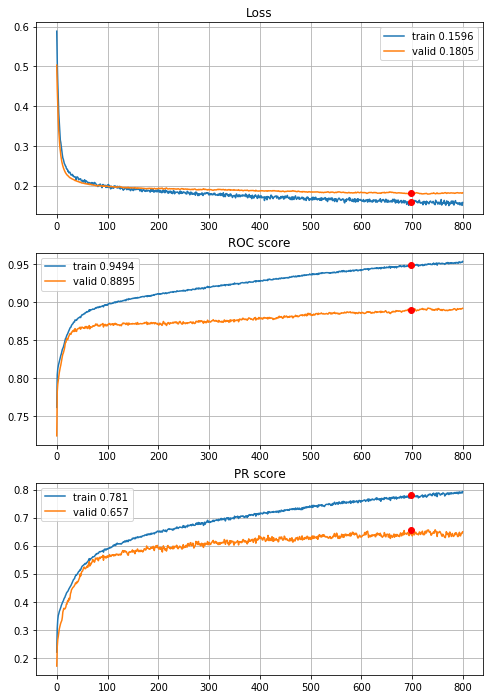


Fold 2------------------------------------------------------------


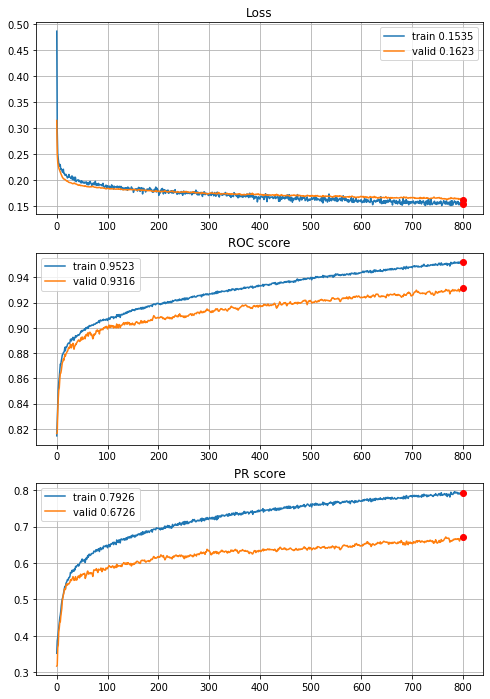


Fold 3------------------------------------------------------------


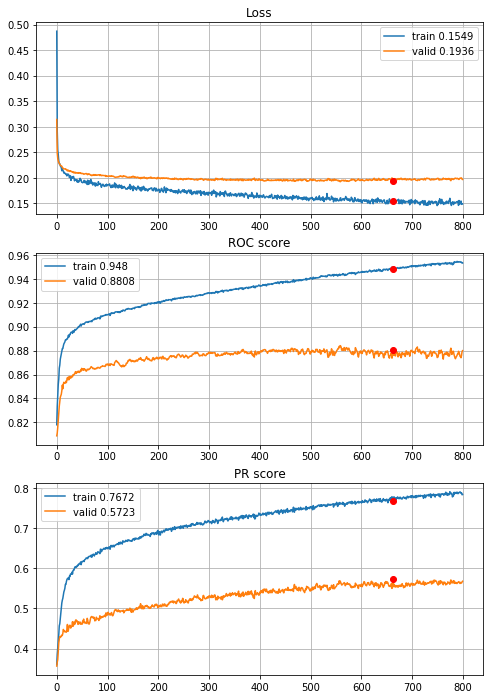


Fold 4------------------------------------------------------------


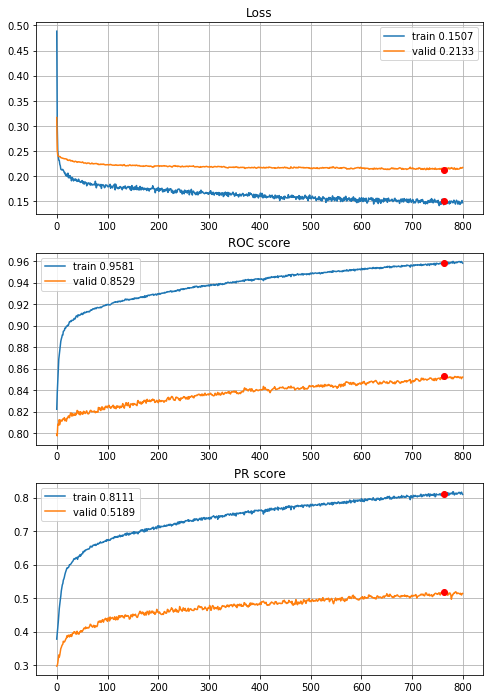


Fold 5------------------------------------------------------------


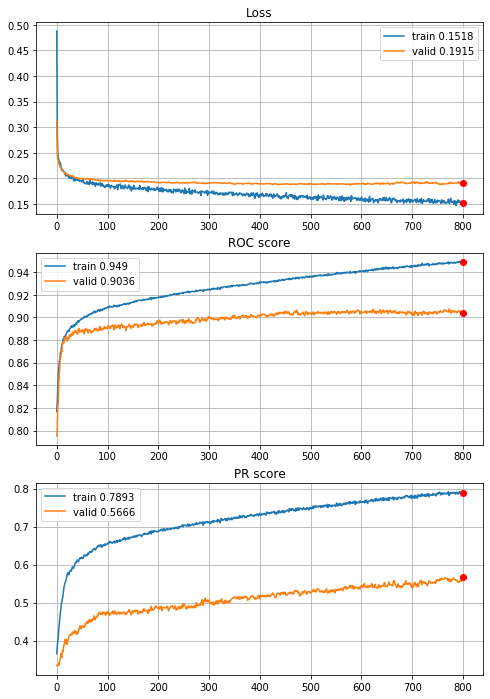


Fold 6------------------------------------------------------------


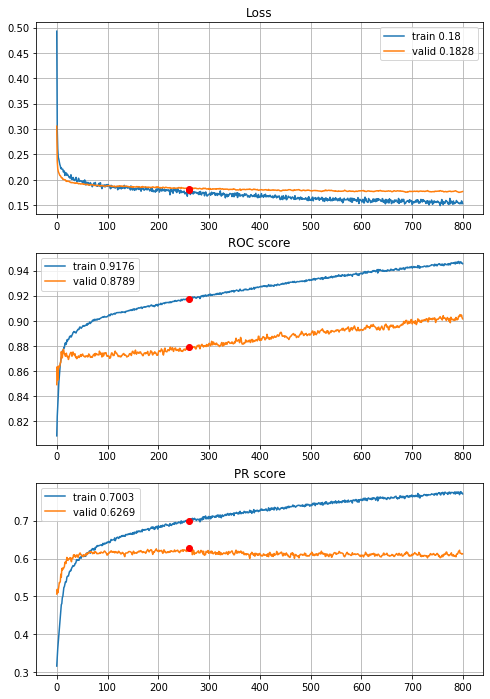

In [235]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=800,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)],
                                        opti=optimizers.Adam(learning_rate=0.0005))

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

The last fold learning curves looks bad, PR is not increasing. Lets try initial learning rate with 800 epochs.


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/800,
cumulative time: 27.4s train loss: 0.5546576747072303, validation loss: 0.4423624064769121
Epoch: 2/800,
cumulative time: 27.52s train loss: 0.43803847402280416, validation loss: 0.36102656406910066
Epoch: 3/800,
cumulative time: 27.63s train loss: 0.36629588283356346, validation loss: 0.3110728503751916
Epoch: 4/800,
cumulative time: 27.74s train loss: 0.32530419049710574, validation loss: 0.2811870228545373
Epoch: 5/800,
cumulative time: 27.85s train loss: 0.29158418636352146, validation loss: 0.26287271396552025
Epoch: 6/800,
cumulative time: 27.95s train loss: 0.2791277959283831, validation loss: 0.2511990701668426
Epoch: 7/800,
cumulative time: 28.06s train loss: 0.26579712882691775, validation loss: 0.2435656722966821
Epoch: 8/800,
cumulative time: 28.17s train loss: 0.2519171827402141, validation loss: 0.23802876813503102
Epoch: 9/800,
cumulative time: 28.28s train loss: 0.250421368284991

cumulative time: 35.32s train loss: 0.19440291752023386, validation loss: 0.19502228859648227
Epoch: 77/800,
cumulative time: 35.42s train loss: 0.19236369580971852, validation loss: 0.19405534131013555
Epoch: 78/800,
cumulative time: 35.52s train loss: 0.19161188223194128, validation loss: 0.19413118927898107
Epoch: 79/800,
cumulative time: 35.62s train loss: 0.18969756315062192, validation loss: 0.1940463280899549
Epoch: 80/800,
cumulative time: 35.72s train loss: 0.18787453413708977, validation loss: 0.19380741903249682
Epoch: 81/800,
cumulative time: 35.82s train loss: 0.18791587013979896, validation loss: 0.1951239014962077
Epoch: 82/800,
cumulative time: 35.91s train loss: 0.18424284917433553, validation loss: 0.19595423184562025
Epoch: 83/800,
cumulative time: 36.02s train loss: 0.1891757578451173, validation loss: 0.1948933536533304
Epoch: 84/800,
cumulative time: 36.12s train loss: 0.19011138753447723, validation loss: 0.19505444943501687
Epoch: 85/800,
cumulative time: 36.22s

Epoch: 153/800,
cumulative time: 43.54s train loss: 0.18092987436922234, validation loss: 0.1907555151650978
Epoch: 154/800,
cumulative time: 43.65s train loss: 0.1827081344510674, validation loss: 0.1908062692425028
Epoch: 155/800,
cumulative time: 43.75s train loss: 0.17931969896200978, validation loss: 0.1920853888168679
Epoch: 156/800,
cumulative time: 43.85s train loss: 0.1785095338222137, validation loss: 0.19100371115707626
Epoch: 157/800,
cumulative time: 43.97s train loss: 0.17945539187438223, validation loss: 0.1901165097783894
Epoch: 158/800,
cumulative time: 44.07s train loss: 0.17949644663784695, validation loss: 0.18982773419498994
Epoch: 159/800,
cumulative time: 44.19s train loss: 0.18212593856539966, validation loss: 0.1903976953284985
Epoch: 160/800,
cumulative time: 44.31s train loss: 0.17904515909400873, validation loss: 0.1886837372415633
Epoch: 161/800,
cumulative time: 44.42s train loss: 0.17914529828630416, validation loss: 0.1902789748205542
Epoch: 162/800,
cum

Epoch: 229/800,
cumulative time: 51.86s train loss: 0.16605266782418163, validation loss: 0.18787791330489123
Epoch: 230/800,
cumulative time: 51.97s train loss: 0.1720098588272714, validation loss: 0.1878076846529693
Epoch: 231/800,
cumulative time: 52.08s train loss: 0.17423165943271848, validation loss: 0.18898648564549417
Epoch: 232/800,
cumulative time: 52.18s train loss: 0.17186098463080204, validation loss: 0.18861166949739855
Epoch: 233/800,
cumulative time: 52.31s train loss: 0.16618692826156906, validation loss: 0.18824396469748947
Epoch: 234/800,
cumulative time: 52.42s train loss: 0.17175871859361763, validation loss: 0.18676067829938456
Epoch: 235/800,
cumulative time: 52.53s train loss: 0.17008046557057635, validation loss: 0.18734846972223065
Epoch: 236/800,
cumulative time: 52.65s train loss: 0.17081733024426962, validation loss: 0.18751985187460632
Epoch: 237/800,
cumulative time: 52.77s train loss: 0.16885686988206008, validation loss: 0.18761321991312463
Epoch: 238/8

Epoch: 306/800,
cumulative time: 60.45s train loss: 0.16386449880333154, validation loss: 0.18425273387918611
Epoch: 307/800,
cumulative time: 60.57s train loss: 0.16177024238739526, validation loss: 0.1844485523063677
Epoch: 308/800,
cumulative time: 60.68s train loss: 0.16040746920779078, validation loss: 0.1844091810025653
Epoch: 309/800,
cumulative time: 60.79s train loss: 0.16276486709525653, validation loss: 0.18489522659120056
Epoch: 310/800,
cumulative time: 60.9s train loss: 0.1668803190496424, validation loss: 0.18541921149380716
Epoch: 311/800,
cumulative time: 61.01s train loss: 0.16195922621293835, validation loss: 0.18572462471926496
Epoch: 312/800,
cumulative time: 61.13s train loss: 0.16437725745652557, validation loss: 0.18498296889538426
Epoch: 313/800,
cumulative time: 61.25s train loss: 0.1628845987021116, validation loss: 0.18458569310227538
Epoch: 314/800,
cumulative time: 61.36s train loss: 0.15996658728064614, validation loss: 0.184813676937457
Epoch: 315/800,
c

Epoch: 382/800,
cumulative time: 68.94s train loss: 0.15112048764091107, validation loss: 0.18369653059973926
Epoch: 383/800,
cumulative time: 69.05s train loss: 0.15729071444660317, validation loss: 0.18359339296011404
Epoch: 384/800,
cumulative time: 69.16s train loss: 0.15857891632842458, validation loss: 0.18392080538974406
Epoch: 385/800,
cumulative time: 69.26s train loss: 0.1534758309635337, validation loss: 0.18435075007202661
Epoch: 386/800,
cumulative time: 69.39s train loss: 0.16046768378816034, validation loss: 0.18445366911648897
Epoch: 387/800,
cumulative time: 69.5s train loss: 0.1578531126098351, validation loss: 0.18380559473524233
Epoch: 388/800,
cumulative time: 69.6s train loss: 0.15795343405893242, validation loss: 0.18535970813324917
Epoch: 389/800,
cumulative time: 69.71s train loss: 0.1537252624152692, validation loss: 0.1846891326458102
Epoch: 390/800,
cumulative time: 69.83s train loss: 0.15812100960943673, validation loss: 0.1843564034247479
Epoch: 391/800,
c

Epoch: 457/800,
cumulative time: 77.18s train loss: 0.15076496621210544, validation loss: 0.18306439231320998
Epoch: 458/800,
cumulative time: 77.3s train loss: 0.15161370634629193, validation loss: 0.18354106386188992
Epoch: 459/800,
cumulative time: 77.41s train loss: 0.15400606264034117, validation loss: 0.18447774578108458
Epoch: 460/800,
cumulative time: 77.52s train loss: 0.1519030919264908, validation loss: 0.1846537458318734
Epoch: 461/800,
cumulative time: 77.63s train loss: 0.14817236211581242, validation loss: 0.1855482102246806
Epoch: 462/800,
cumulative time: 77.73s train loss: 0.1539468447465974, validation loss: 0.18542680836449615
Epoch: 463/800,
cumulative time: 77.83s train loss: 0.15589752105747212, validation loss: 0.18521307284493324
Epoch: 464/800,
cumulative time: 77.93s train loss: 0.1483498151693157, validation loss: 0.18520920776595123
Epoch: 465/800,
cumulative time: 78.03s train loss: 0.14934332692652724, validation loss: 0.18645625172567207
Epoch: 466/800,


cumulative time: 85.58s train loss: 0.15264261195214215, validation loss: 0.18333306717093123
Epoch: 534/800,
cumulative time: 85.69s train loss: 0.1451454680439905, validation loss: 0.18434400414667915
Epoch: 535/800,
cumulative time: 85.8s train loss: 0.15042693671242532, validation loss: 0.184262843031894
Epoch: 536/800,
cumulative time: 85.9s train loss: 0.15299096109096755, validation loss: 0.1824905650591501
Epoch: 537/800,
cumulative time: 86.0s train loss: 0.14831978178815075, validation loss: 0.1802694635064653
Epoch: 538/800,
cumulative time: 86.11s train loss: 0.14978417190000254, validation loss: 0.18134659866402356
Epoch: 539/800,
cumulative time: 86.22s train loss: 0.15396635714474569, validation loss: 0.18113809158729458
Epoch: 540/800,
cumulative time: 86.33s train loss: 0.1522954270707625, validation loss: 0.18334768106058458
Epoch: 541/800,
cumulative time: 86.44s train loss: 0.14953823346268078, validation loss: 0.18315325699234225
Epoch: 542/800,
cumulative time: 86

Epoch: 609/800,
cumulative time: 94.06s train loss: 0.1479449052538467, validation loss: 0.18354722435807697
Epoch: 610/800,
cumulative time: 94.17s train loss: 0.14704269036274095, validation loss: 0.18230765881573335
Epoch: 611/800,
cumulative time: 94.28s train loss: 0.14627638676402155, validation loss: 0.18244161753334617
Epoch: 612/800,
cumulative time: 94.39s train loss: 0.1501093515722814, validation loss: 0.18177134500818565
Epoch: 613/800,
cumulative time: 94.5s train loss: 0.14334148771401883, validation loss: 0.18187100197510897
Epoch: 614/800,
cumulative time: 94.62s train loss: 0.14954040798657853, validation loss: 0.18294682284017022
Epoch: 615/800,
cumulative time: 94.74s train loss: 0.14779518744050918, validation loss: 0.1828561779006627
Epoch: 616/800,
cumulative time: 94.84s train loss: 0.1418753309303135, validation loss: 0.18406344829242688
Epoch: 617/800,
cumulative time: 94.94s train loss: 0.15078531437644244, validation loss: 0.18332538463956474
Epoch: 618/800,

Epoch: 685/800,
cumulative time: 102.59s train loss: 0.1427870171803591, validation loss: 0.1829041863509203
Epoch: 686/800,
cumulative time: 102.7s train loss: 0.1421371068442341, validation loss: 0.18331466175053004
Epoch: 687/800,
cumulative time: 102.81s train loss: 0.14714884363612435, validation loss: 0.1836369879451384
Epoch: 688/800,
cumulative time: 102.92s train loss: 0.14837273014944705, validation loss: 0.18419634086303538
Epoch: 689/800,
cumulative time: 103.03s train loss: 0.144881109774301, validation loss: 0.1836795325578939
Epoch: 690/800,
cumulative time: 103.14s train loss: 0.13808750705154688, validation loss: 0.1824158404228249
Epoch: 691/800,
cumulative time: 103.26s train loss: 0.1413202205040771, validation loss: 0.18090976956127192
Epoch: 692/800,
cumulative time: 103.37s train loss: 0.14555940746467574, validation loss: 0.18070829924292603
Epoch: 693/800,
cumulative time: 103.49s train loss: 0.1389116079543149, validation loss: 0.18309868687371122
Epoch: 694/8

cumulative time: 25.0s train loss: 0.19834758388046647, validation loss: 0.18422016874375713
Epoch: 32/800,
cumulative time: 25.1s train loss: 0.19161770021415145, validation loss: 0.18384870927121486
Epoch: 33/800,
cumulative time: 25.2s train loss: 0.1956742542530225, validation loss: 0.18427272349293633
Epoch: 34/800,
cumulative time: 25.31s train loss: 0.1934232532520802, validation loss: 0.18530592102276028
Epoch: 35/800,
cumulative time: 25.41s train loss: 0.19050756965626017, validation loss: 0.18616984416693952
Epoch: 36/800,
cumulative time: 25.51s train loss: 0.18820530948118183, validation loss: 0.1847118371772121
Epoch: 37/800,
cumulative time: 25.61s train loss: 0.19609095571757654, validation loss: 0.18329237339327273
Epoch: 38/800,
cumulative time: 25.72s train loss: 0.19242904390400067, validation loss: 0.18411004385389093
Epoch: 39/800,
cumulative time: 25.82s train loss: 0.18772573416064148, validation loss: 0.1832394114576843
Epoch: 40/800,
cumulative time: 25.92s tr

Epoch: 108/800,
cumulative time: 33.24s train loss: 0.1722777896436328, validation loss: 0.1753708458302927
Epoch: 109/800,
cumulative time: 33.35s train loss: 0.18069597583815508, validation loss: 0.1755362426717225
Epoch: 110/800,
cumulative time: 33.45s train loss: 0.1775447410070724, validation loss: 0.17451760520593693
Epoch: 111/800,
cumulative time: 33.55s train loss: 0.1751703787124329, validation loss: 0.17438481450752852
Epoch: 112/800,
cumulative time: 33.65s train loss: 0.1778624455178903, validation loss: 0.17469650401136383
Epoch: 113/800,
cumulative time: 33.75s train loss: 0.1733177890765753, validation loss: 0.17411435930543445
Epoch: 114/800,
cumulative time: 33.85s train loss: 0.17831865403572575, validation loss: 0.17399089465079473
Epoch: 115/800,
cumulative time: 33.96s train loss: 0.1749523045488428, validation loss: 0.17348148254625154
Epoch: 116/800,
cumulative time: 34.06s train loss: 0.174847555424117, validation loss: 0.17335294655775138
Epoch: 117/800,
cumu

cumulative time: 41.33s train loss: 0.16936740869259467, validation loss: 0.1708233191168698
Epoch: 184/800,
cumulative time: 41.44s train loss: 0.17332255444237257, validation loss: 0.17060613917793738
Epoch: 185/800,
cumulative time: 41.55s train loss: 0.16839428504908774, validation loss: 0.16983996130097678
Epoch: 186/800,
cumulative time: 41.67s train loss: 0.17045686624621442, validation loss: 0.16981080597793638
Epoch: 187/800,
cumulative time: 41.78s train loss: 0.17058849562672287, validation loss: 0.1697270770755669
Epoch: 188/800,
cumulative time: 41.9s train loss: 0.17004562250678074, validation loss: 0.16872143226317649
Epoch: 189/800,
cumulative time: 42.01s train loss: 0.16452217079860423, validation loss: 0.1684246234587376
Epoch: 190/800,
cumulative time: 42.11s train loss: 0.16580777962957693, validation loss: 0.17086418618142538
Epoch: 191/800,
cumulative time: 42.21s train loss: 0.1644809448197215, validation loss: 0.1678579035377825
Epoch: 192/800,
cumulative time:

cumulative time: 49.42s train loss: 0.16565258877977246, validation loss: 0.16618321563002758
Epoch: 260/800,
cumulative time: 49.53s train loss: 0.16311965087959912, validation loss: 0.1674217234671183
Epoch: 261/800,
cumulative time: 49.63s train loss: 0.1635698687809684, validation loss: 0.16734829980128244
Epoch: 262/800,
cumulative time: 49.74s train loss: 0.15831589178662975, validation loss: 0.1664041218504293
Epoch: 263/800,
cumulative time: 49.85s train loss: 0.161368330342137, validation loss: 0.16692704460431382
Epoch: 264/800,
cumulative time: 49.95s train loss: 0.15956860510397045, validation loss: 0.16578331555259807
Epoch: 265/800,
cumulative time: 50.06s train loss: 0.16016405566329883, validation loss: 0.16524006699326343
Epoch: 266/800,
cumulative time: 50.16s train loss: 0.16066163111921897, validation loss: 0.16700924079541826
Epoch: 267/800,
cumulative time: 50.27s train loss: 0.16020239623001228, validation loss: 0.1658004800355421
Epoch: 268/800,
cumulative time:

cumulative time: 57.61s train loss: 0.15770068277507374, validation loss: 0.164324372452437
Epoch: 336/800,
cumulative time: 57.71s train loss: 0.15764993335715485, validation loss: 0.16699402439150762
Epoch: 337/800,
cumulative time: 57.83s train loss: 0.15830802577900757, validation loss: 0.16419380263182867
Epoch: 338/800,
cumulative time: 57.94s train loss: 0.15763425114581409, validation loss: 0.1643388998078386
Epoch: 339/800,
cumulative time: 58.05s train loss: 0.15779534458360947, validation loss: 0.16406967405234008
Epoch: 340/800,
cumulative time: 58.15s train loss: 0.15770218452768206, validation loss: 0.16425684263264045
Epoch: 341/800,
cumulative time: 58.25s train loss: 0.15822845172231162, validation loss: 0.16650205515451066
Epoch: 342/800,
cumulative time: 58.36s train loss: 0.15762119369399785, validation loss: 0.16478571268019038
Epoch: 343/800,
cumulative time: 58.47s train loss: 0.15549735987848107, validation loss: 0.16495471041158194
Epoch: 344/800,
cumulative ti

Epoch: 411/800,
cumulative time: 65.83s train loss: 0.15155320981389672, validation loss: 0.16424193331528678
Epoch: 412/800,
cumulative time: 65.93s train loss: 0.15603144631623575, validation loss: 0.16510923655352974
Epoch: 413/800,
cumulative time: 66.03s train loss: 0.15685579532401012, validation loss: 0.164948357435063
Epoch: 414/800,
cumulative time: 66.14s train loss: 0.14932844532310746, validation loss: 0.16399851805092652
Epoch: 415/800,
cumulative time: 66.24s train loss: 0.14528895536982303, validation loss: 0.16426311563511442
Epoch: 416/800,
cumulative time: 66.35s train loss: 0.15920439865171157, validation loss: 0.16337792704715534
Epoch: 417/800,
cumulative time: 66.46s train loss: 0.15322206878113404, validation loss: 0.16480853006226906
Epoch: 418/800,
cumulative time: 66.56s train loss: 0.15606814185123796, validation loss: 0.16421904319974992
Epoch: 419/800,
cumulative time: 66.66s train loss: 0.15250171547157132, validation loss: 0.16581306593931514
Epoch: 420/8

Epoch: 487/800,
cumulative time: 74.07s train loss: 0.15059780075957843, validation loss: 0.16307288673711604
Epoch: 488/800,
cumulative time: 74.18s train loss: 0.14962391565395822, validation loss: 0.1667437868396486
Epoch: 489/800,
cumulative time: 74.3s train loss: 0.15532085174418958, validation loss: 0.1631450505828508
Epoch: 490/800,
cumulative time: 74.41s train loss: 0.1459244663897727, validation loss: 0.1644717239624618
Epoch: 491/800,
cumulative time: 74.52s train loss: 0.15044276543728174, validation loss: 0.16588056295807763
Epoch: 492/800,
cumulative time: 74.63s train loss: 0.15222220231412442, validation loss: 0.1649947121924182
Epoch: 493/800,
cumulative time: 74.73s train loss: 0.15151553191513575, validation loss: 0.16610212755949144
Epoch: 494/800,
cumulative time: 74.84s train loss: 0.15271335807948336, validation loss: 0.16686071979623232
Epoch: 495/800,
cumulative time: 74.95s train loss: 0.14861361709984847, validation loss: 0.16546101674118333
Epoch: 496/800,


cumulative time: 82.33s train loss: 0.15357130432050903, validation loss: 0.1651600820874415
Epoch: 563/800,
cumulative time: 82.45s train loss: 0.1456831002789499, validation loss: 0.16495277961083973
Epoch: 564/800,
cumulative time: 82.56s train loss: 0.15311811709716003, validation loss: 0.16539654603570264
Epoch: 565/800,
cumulative time: 82.67s train loss: 0.1573754011986219, validation loss: 0.16424454131248703
Epoch: 566/800,
cumulative time: 82.77s train loss: 0.15235044483081958, validation loss: 0.16206120477050642
Epoch: 567/800,
cumulative time: 82.88s train loss: 0.14898312480158646, validation loss: 0.1653587687025613
Epoch: 568/800,
cumulative time: 82.99s train loss: 0.14463440838542224, validation loss: 0.16246107469282398
Epoch: 569/800,
cumulative time: 83.1s train loss: 0.15680246115981564, validation loss: 0.16409098561076194
Epoch: 570/800,
cumulative time: 83.21s train loss: 0.14670422268755706, validation loss: 0.16511380047513238
Epoch: 571/800,
cumulative time

Epoch: 638/800,
cumulative time: 90.75s train loss: 0.14299730640509928, validation loss: 0.16896991745863854
Epoch: 639/800,
cumulative time: 90.86s train loss: 0.15717829300581548, validation loss: 0.16538604628609696
Epoch: 640/800,
cumulative time: 90.97s train loss: 0.1444909312570676, validation loss: 0.16588112397755683
Epoch: 641/800,
cumulative time: 91.07s train loss: 0.14695352848471288, validation loss: 0.165317287389294
Epoch: 642/800,
cumulative time: 91.18s train loss: 0.14667821420349908, validation loss: 0.16449560144372294
Epoch: 643/800,
cumulative time: 91.28s train loss: 0.14495119537875756, validation loss: 0.16705624529044014
Epoch: 644/800,
cumulative time: 91.4s train loss: 0.1456451891965169, validation loss: 0.16572379190663744
Epoch: 645/800,
cumulative time: 91.52s train loss: 0.14214108897447048, validation loss: 0.16742748574783192
Epoch: 646/800,
cumulative time: 91.64s train loss: 0.14682824449405235, validation loss: 0.16511316592421849
Epoch: 647/800,

Epoch: 714/800,
cumulative time: 99.1s train loss: 0.1417445763743849, validation loss: 0.16520461814715331
Epoch: 715/800,
cumulative time: 99.2s train loss: 0.14409076852811373, validation loss: 0.16549856308952662
Epoch: 716/800,
cumulative time: 99.3s train loss: 0.14322501381132954, validation loss: 0.16812821300416816
Epoch: 717/800,
cumulative time: 99.42s train loss: 0.14493788525273868, validation loss: 0.1671449090138901
Epoch: 718/800,
cumulative time: 99.53s train loss: 0.14252191989107682, validation loss: 0.16391834181553885
Epoch: 719/800,
cumulative time: 99.65s train loss: 0.14096781497464822, validation loss: 0.16279905929472696
Epoch: 720/800,
cumulative time: 99.76s train loss: 0.14770244701432622, validation loss: 0.16540652331229397
Epoch: 721/800,
cumulative time: 99.87s train loss: 0.14318473217168332, validation loss: 0.16227571928312975
Epoch: 722/800,
cumulative time: 99.98s train loss: 0.14689041314048135, validation loss: 0.16291775742573023
Epoch: 723/800,

Epoch: 62/800,
cumulative time: 35.66s train loss: 0.18606203442795827, validation loss: 0.19993209963183525
Epoch: 63/800,
cumulative time: 35.77s train loss: 0.17904100843473247, validation loss: 0.20152346830155696
Epoch: 64/800,
cumulative time: 35.87s train loss: 0.17806990383468596, validation loss: 0.20103242464170382
Epoch: 65/800,
cumulative time: 35.98s train loss: 0.18390269927841876, validation loss: 0.20133128233060762
Epoch: 66/800,
cumulative time: 36.09s train loss: 0.18114524941877982, validation loss: 0.19998916800489824
Epoch: 67/800,
cumulative time: 36.2s train loss: 0.18208159700654689, validation loss: 0.19975578590068366
Epoch: 68/800,
cumulative time: 36.31s train loss: 0.18707059964618314, validation loss: 0.19967490468245616
Epoch: 69/800,
cumulative time: 36.43s train loss: 0.17899125614052214, validation loss: 0.1989419168489224
Epoch: 70/800,
cumulative time: 36.54s train loss: 0.18241558777376848, validation loss: 0.19833897687536753
Epoch: 71/800,
cumula

Epoch: 214/800,
cumulative time: 52.4s train loss: 0.1596487274104292, validation loss: 0.1929051510006895
Epoch: 215/800,
cumulative time: 52.51s train loss: 0.15917109967703638, validation loss: 0.1940315261802383
Epoch: 216/800,
cumulative time: 52.62s train loss: 0.15819400514976967, validation loss: 0.19544892065151434
Epoch: 217/800,
cumulative time: 52.73s train loss: 0.16568245266695314, validation loss: 0.19601196140521274
Epoch: 218/800,
cumulative time: 52.84s train loss: 0.1599807674636802, validation loss: 0.1957408121063583
Epoch: 219/800,
cumulative time: 52.95s train loss: 0.16514171534201083, validation loss: 0.1946382440601422
Epoch: 220/800,
cumulative time: 53.06s train loss: 0.1582543457175743, validation loss: 0.19520808507718793
Epoch: 221/800,
cumulative time: 53.17s train loss: 0.16069020504394163, validation loss: 0.19635945115041034
Epoch: 222/800,
cumulative time: 53.28s train loss: 0.1638292068487793, validation loss: 0.19633467201450094
Epoch: 223/800,
cum

cumulative time: 60.72s train loss: 0.15185740265981815, validation loss: 0.19372927904834608
Epoch: 291/800,
cumulative time: 60.83s train loss: 0.1565195760867871, validation loss: 0.19518697660798554
Epoch: 292/800,
cumulative time: 60.93s train loss: 0.15689619489700032, validation loss: 0.1959697030560274
Epoch: 293/800,
cumulative time: 61.04s train loss: 0.15343155772072206, validation loss: 0.19531714640717363
Epoch: 294/800,
cumulative time: 61.16s train loss: 0.15559657947546954, validation loss: 0.19578111810103613
Epoch: 295/800,
cumulative time: 61.27s train loss: 0.15514230064792214, validation loss: 0.19926167118206636
Epoch: 296/800,
cumulative time: 61.37s train loss: 0.1552165289298507, validation loss: 0.19612950305827173
Epoch: 297/800,
cumulative time: 61.48s train loss: 0.15023638760597052, validation loss: 0.19325302421139487
Epoch: 298/800,
cumulative time: 61.59s train loss: 0.15691923557878187, validation loss: 0.19262526986496828
Epoch: 299/800,
cumulative ti

Epoch: 366/800,
cumulative time: 69.01s train loss: 0.15204816956463058, validation loss: 0.1961756296867448
Epoch: 367/800,
cumulative time: 69.12s train loss: 0.15536189293455238, validation loss: 0.19127711576431689
Epoch: 368/800,
cumulative time: 69.22s train loss: 0.1575738420602378, validation loss: 0.19470798217490937
Epoch: 369/800,
cumulative time: 69.33s train loss: 0.1494842035366417, validation loss: 0.1961404851048748
Epoch: 370/800,
cumulative time: 69.43s train loss: 0.1495351961373422, validation loss: 0.1957327603890635
Epoch: 371/800,
cumulative time: 69.54s train loss: 0.1504202723160171, validation loss: 0.1969184713961038
Epoch: 372/800,
cumulative time: 69.65s train loss: 0.15610702264556386, validation loss: 0.19347721728020617
Epoch: 373/800,
cumulative time: 69.76s train loss: 0.14995256584769767, validation loss: 0.1939003824885292
Epoch: 374/800,
cumulative time: 69.88s train loss: 0.15204235549599254, validation loss: 0.19519712628949992
Epoch: 375/800,
cum

Epoch: 443/800,
cumulative time: 77.47s train loss: 0.14969989835597333, validation loss: 0.19632501563365995
Epoch: 444/800,
cumulative time: 77.57s train loss: 0.14980747935695016, validation loss: 0.1964491587699199
Epoch: 445/800,
cumulative time: 77.68s train loss: 0.15071492687889815, validation loss: 0.19773246065672517
Epoch: 446/800,
cumulative time: 77.8s train loss: 0.14503621400774386, validation loss: 0.19626473883227807
Epoch: 447/800,
cumulative time: 77.91s train loss: 0.14623134206334928, validation loss: 0.20087795745761983
Epoch: 448/800,
cumulative time: 78.02s train loss: 0.14603676765296433, validation loss: 0.20040964771150332
Epoch: 449/800,
cumulative time: 78.12s train loss: 0.1494285115158515, validation loss: 0.19653979961034815
Epoch: 450/800,
cumulative time: 78.23s train loss: 0.15092679659839356, validation loss: 0.19420925145622306
Epoch: 451/800,
cumulative time: 78.36s train loss: 0.14932500457034753, validation loss: 0.20141529584179602
Epoch: 452/80

Epoch: 519/800,
cumulative time: 85.72s train loss: 0.14607399138235336, validation loss: 0.19828612401896695
Epoch: 520/800,
cumulative time: 85.83s train loss: 0.14118044825089215, validation loss: 0.2011462668505032
Epoch: 521/800,
cumulative time: 85.95s train loss: 0.15178531522960118, validation loss: 0.20049830411036898
Epoch: 522/800,
cumulative time: 86.06s train loss: 0.14638547809787822, validation loss: 0.19885958406944018
Epoch: 523/800,
cumulative time: 86.17s train loss: 0.14969757918456725, validation loss: 0.19977872225685883
Epoch: 524/800,
cumulative time: 86.28s train loss: 0.14578507747164918, validation loss: 0.2016874623170969
Epoch: 525/800,
cumulative time: 86.39s train loss: 0.1523282069322865, validation loss: 0.20219199358576986
Epoch: 526/800,
cumulative time: 86.49s train loss: 0.15043683998313623, validation loss: 0.20005354825344268
Epoch: 527/800,
cumulative time: 86.61s train loss: 0.1438851212100916, validation loss: 0.19538911359789943
Epoch: 528/800

Epoch: 594/800,
cumulative time: 93.95s train loss: 0.1463663003740274, validation loss: 0.20147072398676008
Epoch: 595/800,
cumulative time: 94.06s train loss: 0.1436804307268307, validation loss: 0.20289528796610998
Epoch: 596/800,
cumulative time: 94.16s train loss: 0.14375364144974884, validation loss: 0.19964725354512083
Epoch: 597/800,
cumulative time: 94.27s train loss: 0.1404562282009514, validation loss: 0.1972592425235498
Epoch: 598/800,
cumulative time: 94.39s train loss: 0.14962288955166023, validation loss: 0.1989950127185668
Epoch: 599/800,
cumulative time: 94.5s train loss: 0.14076794719908534, validation loss: 0.19891544044219386
Epoch: 600/800,
cumulative time: 94.61s train loss: 0.14185107746817144, validation loss: 0.20268620324679132
Epoch: 601/800,
cumulative time: 94.72s train loss: 0.1470040341281073, validation loss: 0.19861721893375595
Epoch: 602/800,
cumulative time: 94.84s train loss: 0.14187789973651566, validation loss: 0.20180970565610162
Epoch: 603/800,
c

Epoch: 744/800,
cumulative time: 110.51s train loss: 0.1375043228914161, validation loss: 0.20392136728514948
Epoch: 745/800,
cumulative time: 110.62s train loss: 0.1404693361862633, validation loss: 0.20884911603427658
Epoch: 746/800,
cumulative time: 110.73s train loss: 0.14061307392691663, validation loss: 0.20219855267541922
Epoch: 747/800,
cumulative time: 110.84s train loss: 0.1452002322960255, validation loss: 0.20374171145201536
Epoch: 748/800,
cumulative time: 110.95s train loss: 0.14286430285981308, validation loss: 0.20529217467031188
Epoch: 749/800,
cumulative time: 111.06s train loss: 0.13703988779618637, validation loss: 0.20636908473129875
Epoch: 750/800,
cumulative time: 111.17s train loss: 0.13662819608723215, validation loss: 0.20352554409486465
Epoch: 751/800,
cumulative time: 111.28s train loss: 0.14327046047855801, validation loss: 0.20295797486651979
Epoch: 752/800,
cumulative time: 111.4s train loss: 0.13659027013053532, validation loss: 0.20706211203518152
Epoch

Epoch: 17/800,
cumulative time: 29.64s train loss: 0.19527450645921893, validation loss: 0.23160635277998906
Epoch: 18/800,
cumulative time: 29.75s train loss: 0.19293175617553515, validation loss: 0.23051197631768125
Epoch: 19/800,
cumulative time: 29.85s train loss: 0.19048953590128456, validation loss: 0.22944469171372278
Epoch: 20/800,
cumulative time: 29.96s train loss: 0.18870254621302976, validation loss: 0.229798168179413
Epoch: 21/800,
cumulative time: 30.07s train loss: 0.19367605401381613, validation loss: 0.22775098072621408
Epoch: 22/800,
cumulative time: 30.19s train loss: 0.18929041410652853, validation loss: 0.22875482974149303
Epoch: 23/800,
cumulative time: 30.3s train loss: 0.19331260873418668, validation loss: 0.22583699330653886
Epoch: 24/800,
cumulative time: 30.42s train loss: 0.1879351991624776, validation loss: 0.2270578354866187
Epoch: 25/800,
cumulative time: 30.53s train loss: 0.1882052469234716, validation loss: 0.2273192285953203
Epoch: 26/800,
cumulative 

Epoch: 93/800,
cumulative time: 38.56s train loss: 0.17302440973778166, validation loss: 0.22050618741905179
Epoch: 94/800,
cumulative time: 38.69s train loss: 0.168834355707473, validation loss: 0.21957232095048873
Epoch: 95/800,
cumulative time: 38.82s train loss: 0.1672805388080544, validation loss: 0.22070184834385564
Epoch: 96/800,
cumulative time: 38.94s train loss: 0.17045863175429798, validation loss: 0.21906435879842961
Epoch: 97/800,
cumulative time: 39.07s train loss: 0.1709061835625896, validation loss: 0.21858940244931938
Epoch: 98/800,
cumulative time: 39.2s train loss: 0.1716917158047125, validation loss: 0.21933913547083164
Epoch: 99/800,
cumulative time: 39.33s train loss: 0.1707682396679572, validation loss: 0.2195694142485849
Epoch: 100/800,
cumulative time: 39.45s train loss: 0.17170983929411435, validation loss: 0.21920710196613458
Epoch: 101/800,
cumulative time: 39.58s train loss: 0.1687584008652605, validation loss: 0.2199140761560565
Epoch: 102/800,
cumulative 

Epoch: 169/800,
cumulative time: 47.93s train loss: 0.165811834349714, validation loss: 0.21629418590806138
Epoch: 170/800,
cumulative time: 48.06s train loss: 0.1625545703407445, validation loss: 0.21592152777966742
Epoch: 171/800,
cumulative time: 48.19s train loss: 0.1661295629424326, validation loss: 0.2158272054138894
Epoch: 172/800,
cumulative time: 48.31s train loss: 0.16064864551001845, validation loss: 0.21788066948509646
Epoch: 173/800,
cumulative time: 48.44s train loss: 0.16596941868405887, validation loss: 0.21531221418563723
Epoch: 174/800,
cumulative time: 48.57s train loss: 0.1616349447037064, validation loss: 0.21584506453967256
Epoch: 175/800,
cumulative time: 48.7s train loss: 0.15929326701790814, validation loss: 0.2175479311302607
Epoch: 176/800,
cumulative time: 48.83s train loss: 0.16212611760588658, validation loss: 0.21687443477036453
Epoch: 177/800,
cumulative time: 48.95s train loss: 0.16322114514411773, validation loss: 0.21691006226948636
Epoch: 178/800,
cu

Epoch: 245/800,
cumulative time: 57.5s train loss: 0.15522681907770625, validation loss: 0.21167907858809823
Epoch: 246/800,
cumulative time: 57.63s train loss: 0.15884290667687317, validation loss: 0.2130440813289539
Epoch: 247/800,
cumulative time: 57.75s train loss: 0.15608336890278943, validation loss: 0.21314876360091345
Epoch: 248/800,
cumulative time: 57.87s train loss: 0.14941647087286644, validation loss: 0.2141994104024788
Epoch: 249/800,
cumulative time: 58.0s train loss: 0.1528379461874468, validation loss: 0.21305491440586796
Epoch: 250/800,
cumulative time: 58.12s train loss: 0.15412869836698934, validation loss: 0.21289549095232385
Epoch: 251/800,
cumulative time: 58.25s train loss: 0.15674787120775527, validation loss: 0.21427523383437647
Epoch: 252/800,
cumulative time: 58.37s train loss: 0.15005482571901652, validation loss: 0.21508741772336293
Epoch: 253/800,
cumulative time: 58.5s train loss: 0.15744221537881745, validation loss: 0.21430842901325656
Epoch: 254/800,


Epoch: 321/800,
cumulative time: 66.89s train loss: 0.1475892177781482, validation loss: 0.21607888454642846
Epoch: 322/800,
cumulative time: 67.01s train loss: 0.15348930166815355, validation loss: 0.21500059353444162
Epoch: 323/800,
cumulative time: 67.14s train loss: 0.14863986896253079, validation loss: 0.2150196373529951
Epoch: 324/800,
cumulative time: 67.27s train loss: 0.14927172370401215, validation loss: 0.214453921092014
Epoch: 325/800,
cumulative time: 67.39s train loss: 0.14684277991731684, validation loss: 0.21441363423860907
Epoch: 326/800,
cumulative time: 67.52s train loss: 0.15179951097702782, validation loss: 0.21199459456428718
Epoch: 327/800,
cumulative time: 67.64s train loss: 0.1520555534011592, validation loss: 0.21479234913401896
Epoch: 328/800,
cumulative time: 67.76s train loss: 0.15204379012601896, validation loss: 0.213003843450923
Epoch: 329/800,
cumulative time: 67.89s train loss: 0.14507147482561253, validation loss: 0.21630640449023408
Epoch: 330/800,
c

Epoch: 397/800,
cumulative time: 76.15s train loss: 0.15026635054087978, validation loss: 0.21303312480449677
Epoch: 398/800,
cumulative time: 76.26s train loss: 0.1437450982957991, validation loss: 0.21233156562255145
Epoch: 399/800,
cumulative time: 76.39s train loss: 0.1468178281329863, validation loss: 0.21475383942068027
Epoch: 400/800,
cumulative time: 76.51s train loss: 0.1480540146333973, validation loss: 0.21164866921998576
Epoch: 401/800,
cumulative time: 76.64s train loss: 0.1487703061543494, validation loss: 0.21378099225444663
Epoch: 402/800,
cumulative time: 76.75s train loss: 0.15401936694223348, validation loss: 0.21387646607970545
Epoch: 403/800,
cumulative time: 76.86s train loss: 0.14719420139350714, validation loss: 0.21474976343172128
Epoch: 404/800,
cumulative time: 76.98s train loss: 0.1454058241257946, validation loss: 0.21401972436339806
Epoch: 405/800,
cumulative time: 77.11s train loss: 0.15008766125965786, validation loss: 0.21423030515153035
Epoch: 406/800,

Epoch: 473/800,
cumulative time: 85.35s train loss: 0.143589294251889, validation loss: 0.21618952963745083
Epoch: 474/800,
cumulative time: 85.46s train loss: 0.14345494448170554, validation loss: 0.21306850907495814
Epoch: 475/800,
cumulative time: 85.58s train loss: 0.1427686519394764, validation loss: 0.21459512153543683
Epoch: 476/800,
cumulative time: 85.7s train loss: 0.14973044323008242, validation loss: 0.2131936402137877
Epoch: 477/800,
cumulative time: 85.81s train loss: 0.14668873583063055, validation loss: 0.21837035511067435
Epoch: 478/800,
cumulative time: 85.93s train loss: 0.14595592699099577, validation loss: 0.2136199004763136
Epoch: 479/800,
cumulative time: 86.07s train loss: 0.14437944371612083, validation loss: 0.212696893388746
Epoch: 480/800,
cumulative time: 86.19s train loss: 0.1468550416115926, validation loss: 0.21364591289185508
Epoch: 481/800,
cumulative time: 86.33s train loss: 0.14484295707146416, validation loss: 0.21177733896413722
Epoch: 482/800,
cum

Epoch: 549/800,
cumulative time: 94.73s train loss: 0.14441611914112476, validation loss: 0.21331048489424229
Epoch: 550/800,
cumulative time: 94.84s train loss: 0.14026836755110075, validation loss: 0.21313309027029215
Epoch: 551/800,
cumulative time: 94.96s train loss: 0.13961032573314383, validation loss: 0.217326735905277
Epoch: 552/800,
cumulative time: 95.09s train loss: 0.14734752538065435, validation loss: 0.2139659401525493
Epoch: 553/800,
cumulative time: 95.22s train loss: 0.13838969742824228, validation loss: 0.2132814480138955
Epoch: 554/800,
cumulative time: 95.33s train loss: 0.14619304747996145, validation loss: 0.21361474706276276
Epoch: 555/800,
cumulative time: 95.46s train loss: 0.1406116363946025, validation loss: 0.2137517818748009
Epoch: 556/800,
cumulative time: 95.59s train loss: 0.14560410610620522, validation loss: 0.21447441059229874
Epoch: 557/800,
cumulative time: 95.71s train loss: 0.14240028436058078, validation loss: 0.21231260767908722
Epoch: 558/800,


Epoch: 625/800,
cumulative time: 104.04s train loss: 0.13450975214254499, validation loss: 0.2153057248813035
Epoch: 626/800,
cumulative time: 104.17s train loss: 0.136639751072073, validation loss: 0.2158872590444427
Epoch: 627/800,
cumulative time: 104.29s train loss: 0.13912275189837617, validation loss: 0.2123161869850977
Epoch: 628/800,
cumulative time: 104.4s train loss: 0.1364183715724687, validation loss: 0.21164313204266955
Epoch: 629/800,
cumulative time: 104.52s train loss: 0.13505374782582372, validation loss: 0.2173823709547116
Epoch: 630/800,
cumulative time: 104.64s train loss: 0.14053762564467115, validation loss: 0.21603162472323423
Epoch: 631/800,
cumulative time: 104.77s train loss: 0.1349123830575317, validation loss: 0.2142503766120153
Epoch: 632/800,
cumulative time: 104.88s train loss: 0.1379397500792933, validation loss: 0.21632096474111484
Epoch: 633/800,
cumulative time: 104.99s train loss: 0.14362637695625086, validation loss: 0.21649586774291088
Epoch: 634/8

Epoch: 701/800,
cumulative time: 113.13s train loss: 0.13532138504415664, validation loss: 0.21729904655409182
Epoch: 702/800,
cumulative time: 113.26s train loss: 0.1359278052144413, validation loss: 0.21575893017696743
Epoch: 703/800,
cumulative time: 113.38s train loss: 0.1350136462463742, validation loss: 0.21191354529852255
Epoch: 704/800,
cumulative time: 113.5s train loss: 0.1323562945062141, validation loss: 0.21443975530144324
Epoch: 705/800,
cumulative time: 113.62s train loss: 0.13651359814057198, validation loss: 0.21426134817218134
Epoch: 706/800,
cumulative time: 113.73s train loss: 0.13833026123079145, validation loss: 0.2144571415928632
Epoch: 707/800,
cumulative time: 113.85s train loss: 0.13486191860956664, validation loss: 0.2130711911494253
Epoch: 708/800,
cumulative time: 113.98s train loss: 0.1346025912743671, validation loss: 0.2142669865293912
Epoch: 709/800,
cumulative time: 114.1s train loss: 0.13923222705059657, validation loss: 0.2132617336094514
Epoch: 710/

Epoch: 777/800,
cumulative time: 122.39s train loss: 0.12916216874415734, validation loss: 0.2120543488261393
Epoch: 778/800,
cumulative time: 122.52s train loss: 0.14026248550175707, validation loss: 0.21323421587389693
Epoch: 779/800,
cumulative time: 122.65s train loss: 0.13700244402121722, validation loss: 0.2162569124865478
Epoch: 780/800,
cumulative time: 122.77s train loss: 0.13928208641494447, validation loss: 0.2140219093176366
Epoch: 781/800,
cumulative time: 122.89s train loss: 0.13378494343651678, validation loss: 0.2151622017740396
Epoch: 782/800,
cumulative time: 123.02s train loss: 0.1320719916954176, validation loss: 0.21419433371477148
Epoch: 783/800,
cumulative time: 123.14s train loss: 0.13834553099151875, validation loss: 0.21690765954974542
Epoch: 784/800,
cumulative time: 123.25s train loss: 0.1369357514574354, validation loss: 0.21862751144587858
Epoch: 785/800,
cumulative time: 123.38s train loss: 0.13351079634019544, validation loss: 0.21414962902026036
Epoch: 

Epoch: 51/800,
cumulative time: 29.17s train loss: 0.18546119025416172, validation loss: 0.1949461197341807
Epoch: 52/800,
cumulative time: 29.29s train loss: 0.18245882953891307, validation loss: 0.19368290218354348
Epoch: 53/800,
cumulative time: 29.41s train loss: 0.1876942513154695, validation loss: 0.19512555574994056
Epoch: 54/800,
cumulative time: 29.53s train loss: 0.18105755496611317, validation loss: 0.1956770240116873
Epoch: 55/800,
cumulative time: 29.66s train loss: 0.18243360537560832, validation loss: 0.19466431852657154
Epoch: 56/800,
cumulative time: 29.78s train loss: 0.17997830578107316, validation loss: 0.19498915401861308
Epoch: 57/800,
cumulative time: 29.91s train loss: 0.18011800490341578, validation loss: 0.19456828138360052
Epoch: 58/800,
cumulative time: 30.03s train loss: 0.17855863781053866, validation loss: 0.19445959399569923
Epoch: 59/800,
cumulative time: 30.15s train loss: 0.17892739802982155, validation loss: 0.19590971472570104
Epoch: 60/800,
cumulat

Epoch: 127/800,
cumulative time: 38.31s train loss: 0.17469073966827883, validation loss: 0.19073960632422168
Epoch: 128/800,
cumulative time: 38.43s train loss: 0.1696936664188954, validation loss: 0.1912875086674572
Epoch: 129/800,
cumulative time: 38.54s train loss: 0.17150187368670464, validation loss: 0.1904182246724316
Epoch: 130/800,
cumulative time: 38.66s train loss: 0.17618715484094438, validation loss: 0.19155039508778676
Epoch: 131/800,
cumulative time: 38.78s train loss: 0.17451260023419055, validation loss: 0.19121817410261313
Epoch: 132/800,
cumulative time: 38.91s train loss: 0.1672242393689018, validation loss: 0.1904998372895454
Epoch: 133/800,
cumulative time: 39.02s train loss: 0.1690672569576892, validation loss: 0.1906190644066705
Epoch: 134/800,
cumulative time: 39.13s train loss: 0.1717145466727864, validation loss: 0.19179397740697754
Epoch: 135/800,
cumulative time: 39.25s train loss: 0.16921251848551805, validation loss: 0.19233406178703696
Epoch: 136/800,
cu

Epoch: 203/800,
cumulative time: 47.42s train loss: 0.1646485382456987, validation loss: 0.18697284484959079
Epoch: 204/800,
cumulative time: 47.53s train loss: 0.1698443788909869, validation loss: 0.1875530891372711
Epoch: 205/800,
cumulative time: 47.65s train loss: 0.16485448586007637, validation loss: 0.18773987509192516
Epoch: 206/800,
cumulative time: 47.78s train loss: 0.162279990203166, validation loss: 0.18746123081136234
Epoch: 207/800,
cumulative time: 47.9s train loss: 0.17101543137209962, validation loss: 0.18699248898648246
Epoch: 208/800,
cumulative time: 48.02s train loss: 0.16744010088582514, validation loss: 0.18850696083519852
Epoch: 209/800,
cumulative time: 48.14s train loss: 0.1659712365198399, validation loss: 0.18876468950281294
Epoch: 210/800,
cumulative time: 48.27s train loss: 0.15933428111112388, validation loss: 0.18839775954223917
Epoch: 211/800,
cumulative time: 48.39s train loss: 0.16843318806433016, validation loss: 0.18757564677072702
Epoch: 212/800,
c

Epoch: 279/800,
cumulative time: 56.85s train loss: 0.159879826162218, validation loss: 0.18948313052309823
Epoch: 280/800,
cumulative time: 56.97s train loss: 0.15654882604452494, validation loss: 0.18945480704845746
Epoch: 281/800,
cumulative time: 57.1s train loss: 0.15770871134904715, validation loss: 0.18905502830213672
Epoch: 282/800,
cumulative time: 57.21s train loss: 0.16176759112292693, validation loss: 0.18817371288083207
Epoch: 283/800,
cumulative time: 57.34s train loss: 0.15913405176105064, validation loss: 0.18728556509211694
Epoch: 284/800,
cumulative time: 57.46s train loss: 0.16223130765911584, validation loss: 0.18713263282657477
Epoch: 285/800,
cumulative time: 57.59s train loss: 0.1552660865282706, validation loss: 0.18725293582099287
Epoch: 286/800,
cumulative time: 57.72s train loss: 0.16138703622278552, validation loss: 0.1871907261976001
Epoch: 287/800,
cumulative time: 57.84s train loss: 0.1612106447305363, validation loss: 0.18623451151912424
Epoch: 288/800,


Epoch: 355/800,
cumulative time: 65.81s train loss: 0.1559965076509459, validation loss: 0.1891367777542928
Epoch: 356/800,
cumulative time: 65.94s train loss: 0.15560087345804394, validation loss: 0.19000769159325628
Epoch: 357/800,
cumulative time: 66.06s train loss: 0.1553968194054476, validation loss: 0.18906686375964576
Epoch: 358/800,
cumulative time: 66.18s train loss: 0.15673330800173757, validation loss: 0.18896021587988593
Epoch: 359/800,
cumulative time: 66.28s train loss: 0.15450486163307253, validation loss: 0.1904866024347245
Epoch: 360/800,
cumulative time: 66.41s train loss: 0.15159209441673452, validation loss: 0.18916430928098968
Epoch: 361/800,
cumulative time: 66.53s train loss: 0.15895694843498653, validation loss: 0.1882518092948212
Epoch: 362/800,
cumulative time: 66.65s train loss: 0.15888508568424795, validation loss: 0.18922150878416497
Epoch: 363/800,
cumulative time: 66.76s train loss: 0.1549009881693489, validation loss: 0.18979809320538094
Epoch: 364/800,


Epoch: 431/800,
cumulative time: 74.98s train loss: 0.15596923361829246, validation loss: 0.19111610774127408
Epoch: 432/800,
cumulative time: 75.1s train loss: 0.1495638540278916, validation loss: 0.19376023860467476
Epoch: 433/800,
cumulative time: 75.22s train loss: 0.15271287627086236, validation loss: 0.19108352731097633
Epoch: 434/800,
cumulative time: 75.33s train loss: 0.15436942823955604, validation loss: 0.19040573305927605
Epoch: 435/800,
cumulative time: 75.45s train loss: 0.1535255402232464, validation loss: 0.18887688697191715
Epoch: 436/800,
cumulative time: 75.57s train loss: 0.1539689352563184, validation loss: 0.18950139810215538
Epoch: 437/800,
cumulative time: 75.69s train loss: 0.1520466698703797, validation loss: 0.18985162187645183
Epoch: 438/800,
cumulative time: 75.8s train loss: 0.15157815429976368, validation loss: 0.19026059961749522
Epoch: 439/800,
cumulative time: 75.91s train loss: 0.1500007480235017, validation loss: 0.19287112792512365
Epoch: 440/800,
c

Epoch: 507/800,
cumulative time: 83.95s train loss: 0.15237025459759826, validation loss: 0.19430269499395555
Epoch: 508/800,
cumulative time: 84.07s train loss: 0.14998052391071715, validation loss: 0.1932341674380593
Epoch: 509/800,
cumulative time: 84.19s train loss: 0.15015041757901904, validation loss: 0.1944290752739185
Epoch: 510/800,
cumulative time: 84.31s train loss: 0.1511867939047692, validation loss: 0.19237924042593008
Epoch: 511/800,
cumulative time: 84.43s train loss: 0.14544885140185482, validation loss: 0.19408411339228093
Epoch: 512/800,
cumulative time: 84.53s train loss: 0.1493183950753452, validation loss: 0.1927886783874869
Epoch: 513/800,
cumulative time: 84.66s train loss: 0.1430302321265466, validation loss: 0.1909899406521907
Epoch: 514/800,
cumulative time: 84.78s train loss: 0.15168892248822957, validation loss: 0.19236292526899557
Epoch: 515/800,
cumulative time: 84.9s train loss: 0.143699850049227, validation loss: 0.19182636196941608
Epoch: 516/800,
cumu

Epoch: 583/800,
cumulative time: 93.14s train loss: 0.1461711206548832, validation loss: 0.1957535947216822
Epoch: 584/800,
cumulative time: 93.26s train loss: 0.14702603991376392, validation loss: 0.19710134437337148
Epoch: 585/800,
cumulative time: 93.39s train loss: 0.15281874479248214, validation loss: 0.1967677066342287
Epoch: 586/800,
cumulative time: 93.51s train loss: 0.14670706999515695, validation loss: 0.19519115476522167
Epoch: 587/800,
cumulative time: 93.64s train loss: 0.1497860625167746, validation loss: 0.19244035799266523
Epoch: 588/800,
cumulative time: 93.77s train loss: 0.14655035370807468, validation loss: 0.19788247020599806
Epoch: 589/800,
cumulative time: 93.89s train loss: 0.14758518971158235, validation loss: 0.1962035428522403
Epoch: 590/800,
cumulative time: 94.02s train loss: 0.14801599006337665, validation loss: 0.19425647858841424
Epoch: 591/800,
cumulative time: 94.14s train loss: 0.14590098648530592, validation loss: 0.19692703977260848
Epoch: 592/800,

Epoch: 659/800,
cumulative time: 102.54s train loss: 0.1424549701330545, validation loss: 0.19694628070358766
Epoch: 660/800,
cumulative time: 102.65s train loss: 0.141502473132755, validation loss: 0.19502727233260264
Epoch: 661/800,
cumulative time: 102.78s train loss: 0.14252689280441108, validation loss: 0.1972462484449081
Epoch: 662/800,
cumulative time: 102.9s train loss: 0.14538922915670044, validation loss: 0.19617714125738725
Epoch: 663/800,
cumulative time: 103.03s train loss: 0.148499421908117, validation loss: 0.19370920128666252
Epoch: 664/800,
cumulative time: 103.15s train loss: 0.14753355322157372, validation loss: 0.19653398837919428
Epoch: 665/800,
cumulative time: 103.27s train loss: 0.1436121219820802, validation loss: 0.19440836992543653
Epoch: 666/800,
cumulative time: 103.39s train loss: 0.1468454439007292, validation loss: 0.197942750482204
Epoch: 667/800,
cumulative time: 103.52s train loss: 0.14361302283004904, validation loss: 0.1968883679292541
Epoch: 668/80

Epoch: 735/800,
cumulative time: 111.82s train loss: 0.14248350731979745, validation loss: 0.19438350755662467
Epoch: 736/800,
cumulative time: 111.94s train loss: 0.13814587372099066, validation loss: 0.19857303589649716
Epoch: 737/800,
cumulative time: 112.06s train loss: 0.14144157887701791, validation loss: 0.19755011544674297
Epoch: 738/800,
cumulative time: 112.18s train loss: 0.14327187814657127, validation loss: 0.197214600060379
Epoch: 739/800,
cumulative time: 112.3s train loss: 0.14144807372274987, validation loss: 0.1974726496916054
Epoch: 740/800,
cumulative time: 112.43s train loss: 0.14581708649050268, validation loss: 0.1994193373226958
Epoch: 741/800,
cumulative time: 112.55s train loss: 0.13897249202594622, validation loss: 0.19653789574620956
Epoch: 742/800,
cumulative time: 112.68s train loss: 0.13752738908924853, validation loss: 0.19617970163343185
Epoch: 743/800,
cumulative time: 112.8s train loss: 0.14132623737159014, validation loss: 0.19878378443201294
Epoch: 

Epoch: 7/800,
cumulative time: 29.48s train loss: 0.2167368762761509, validation loss: 0.2037817703951024
Epoch: 8/800,
cumulative time: 29.6s train loss: 0.2136952546079568, validation loss: 0.2042990966655869
Epoch: 9/800,
cumulative time: 29.72s train loss: 0.21145772423696874, validation loss: 0.20123289017591198
Epoch: 10/800,
cumulative time: 29.84s train loss: 0.2134375350653601, validation loss: 0.1977288417232225
Epoch: 11/800,
cumulative time: 29.96s train loss: 0.2088599615143568, validation loss: 0.19836091971693404
Epoch: 12/800,
cumulative time: 30.07s train loss: 0.2084907304647677, validation loss: 0.19769926473464708
Epoch: 13/800,
cumulative time: 30.18s train loss: 0.20974615153732834, validation loss: 0.19419616410344773
Epoch: 14/800,
cumulative time: 30.29s train loss: 0.20430712142701668, validation loss: 0.19671330340290716
Epoch: 15/800,
cumulative time: 30.42s train loss: 0.20325729874282666, validation loss: 0.19561991421821154
Epoch: 16/800,
cumulative time:

Epoch: 83/800,
cumulative time: 38.61s train loss: 0.1811685276581422, validation loss: 0.18529899391444488
Epoch: 84/800,
cumulative time: 38.74s train loss: 0.18202247887601064, validation loss: 0.18517152009779927
Epoch: 85/800,
cumulative time: 38.86s train loss: 0.18293823138763424, validation loss: 0.1831332196231351
Epoch: 86/800,
cumulative time: 38.98s train loss: 0.17738603262204283, validation loss: 0.18369727795333948
Epoch: 87/800,
cumulative time: 39.1s train loss: 0.1848721513556165, validation loss: 0.18480098624261723
Epoch: 88/800,
cumulative time: 39.23s train loss: 0.1753939280096091, validation loss: 0.1844732071825936
Epoch: 89/800,
cumulative time: 39.35s train loss: 0.17700009913886075, validation loss: 0.18463341158480462
Epoch: 90/800,
cumulative time: 39.47s train loss: 0.17292165794209596, validation loss: 0.18525094284968235
Epoch: 91/800,
cumulative time: 39.59s train loss: 0.17680581658070174, validation loss: 0.18483681482332284
Epoch: 92/800,
cumulative

Epoch: 159/800,
cumulative time: 47.92s train loss: 0.17252484976425145, validation loss: 0.18328928409257808
Epoch: 160/800,
cumulative time: 48.05s train loss: 0.17170398069233436, validation loss: 0.18185209245767872
Epoch: 161/800,
cumulative time: 48.17s train loss: 0.17349100194933612, validation loss: 0.18286275930921325
Epoch: 162/800,
cumulative time: 48.29s train loss: 0.16827267871910365, validation loss: 0.18257422704863494
Epoch: 163/800,
cumulative time: 48.42s train loss: 0.17029096539109817, validation loss: 0.18254052496117879
Epoch: 164/800,
cumulative time: 48.54s train loss: 0.17378622625916423, validation loss: 0.18165326824844824
Epoch: 165/800,
cumulative time: 48.66s train loss: 0.1688626273179092, validation loss: 0.18105897707675433
Epoch: 166/800,
cumulative time: 48.78s train loss: 0.1704182205244835, validation loss: 0.18065315942462895
Epoch: 167/800,
cumulative time: 48.91s train loss: 0.16477041849360197, validation loss: 0.1816544599713375
Epoch: 168/80

Epoch: 235/800,
cumulative time: 57.05s train loss: 0.17035134451641554, validation loss: 0.1786570010820307
Epoch: 236/800,
cumulative time: 57.16s train loss: 0.16265415934563868, validation loss: 0.18002159405777202
Epoch: 237/800,
cumulative time: 57.28s train loss: 0.1584042798187403, validation loss: 0.1798279548471722
Epoch: 238/800,
cumulative time: 57.4s train loss: 0.16099553704160938, validation loss: 0.17858348087182702
Epoch: 239/800,
cumulative time: 57.5s train loss: 0.16919974567603505, validation loss: 0.17888928344368127
Epoch: 240/800,
cumulative time: 57.61s train loss: 0.16209781514772734, validation loss: 0.17948916581360536
Epoch: 241/800,
cumulative time: 57.74s train loss: 0.1631971313530937, validation loss: 0.180721670590997
Epoch: 242/800,
cumulative time: 57.86s train loss: 0.1650978955785819, validation loss: 0.1815159061826917
Epoch: 243/800,
cumulative time: 57.98s train loss: 0.15932842310263398, validation loss: 0.178937188423245
Epoch: 244/800,
cumula

Epoch: 311/800,
cumulative time: 66.31s train loss: 0.1588994446993143, validation loss: 0.17681633750014597
Epoch: 312/800,
cumulative time: 66.42s train loss: 0.15777040829433697, validation loss: 0.17606915836275028
Epoch: 313/800,
cumulative time: 66.52s train loss: 0.15408632823449075, validation loss: 0.17582387149199405
Epoch: 314/800,
cumulative time: 66.63s train loss: 0.15902477409711627, validation loss: 0.17666110154199277
Epoch: 315/800,
cumulative time: 66.75s train loss: 0.15925320749986852, validation loss: 0.17585513544001913
Epoch: 316/800,
cumulative time: 66.88s train loss: 0.15547461746886168, validation loss: 0.1786697566441973
Epoch: 317/800,
cumulative time: 67.0s train loss: 0.1545475343838519, validation loss: 0.1774756709958845
Epoch: 318/800,
cumulative time: 67.12s train loss: 0.1594741599751519, validation loss: 0.17711486830533762
Epoch: 319/800,
cumulative time: 67.24s train loss: 0.15690830609423567, validation loss: 0.1765649625800264
Epoch: 320/800,
c

Epoch: 387/800,
cumulative time: 75.36s train loss: 0.15573523998152933, validation loss: 0.17709621299335704
Epoch: 388/800,
cumulative time: 75.47s train loss: 0.15502735912571258, validation loss: 0.17663762286204518
Epoch: 389/800,
cumulative time: 75.59s train loss: 0.15374510231901178, validation loss: 0.17642266970993972
Epoch: 390/800,
cumulative time: 75.7s train loss: 0.15481562177658403, validation loss: 0.17759097830032924
Epoch: 391/800,
cumulative time: 75.82s train loss: 0.15442848727594455, validation loss: 0.17727543275727645
Epoch: 392/800,
cumulative time: 75.95s train loss: 0.15389120318928343, validation loss: 0.17742180000174934
Epoch: 393/800,
cumulative time: 76.07s train loss: 0.1608875998989766, validation loss: 0.17598961091875762
Epoch: 394/800,
cumulative time: 76.2s train loss: 0.15476643397291492, validation loss: 0.17577642804478416
Epoch: 395/800,
cumulative time: 76.32s train loss: 0.15547654298931435, validation loss: 0.17657187917431644
Epoch: 396/80

Epoch: 463/800,
cumulative time: 84.47s train loss: 0.14956911453780164, validation loss: 0.17250488913758882
Epoch: 464/800,
cumulative time: 84.59s train loss: 0.15111619216605715, validation loss: 0.17237223247507624
Epoch: 465/800,
cumulative time: 84.72s train loss: 0.1522529673427108, validation loss: 0.17293215352983024
Epoch: 466/800,
cumulative time: 84.85s train loss: 0.15077634794083347, validation loss: 0.17200471666004533
Epoch: 467/800,
cumulative time: 84.98s train loss: 0.14867516409394813, validation loss: 0.17168798470873864
Epoch: 468/800,
cumulative time: 85.1s train loss: 0.14554615075744734, validation loss: 0.17431477028414036
Epoch: 469/800,
cumulative time: 85.22s train loss: 0.1481212263545763, validation loss: 0.17509240285403035
Epoch: 470/800,
cumulative time: 85.34s train loss: 0.15185476414995433, validation loss: 0.1735640052478954
Epoch: 471/800,
cumulative time: 85.46s train loss: 0.15006988922656322, validation loss: 0.17427889343443628
Epoch: 472/800

Epoch: 539/800,
cumulative time: 93.79s train loss: 0.14784063423376387, validation loss: 0.17022029732608365
Epoch: 540/800,
cumulative time: 93.91s train loss: 0.14693963741129418, validation loss: 0.17078284868806534
Epoch: 541/800,
cumulative time: 94.04s train loss: 0.15109986557585106, validation loss: 0.17239248268222163
Epoch: 542/800,
cumulative time: 94.16s train loss: 0.14762618346654505, validation loss: 0.1709223125911997
Epoch: 543/800,
cumulative time: 94.28s train loss: 0.14479112833361849, validation loss: 0.1689183248152313
Epoch: 544/800,
cumulative time: 94.39s train loss: 0.14666993744938578, validation loss: 0.16999851369023591
Epoch: 545/800,
cumulative time: 94.51s train loss: 0.1522916973060715, validation loss: 0.16889551056561566
Epoch: 546/800,
cumulative time: 94.63s train loss: 0.14967129100177134, validation loss: 0.1677287160408416
Epoch: 547/800,
cumulative time: 94.74s train loss: 0.14731051695016067, validation loss: 0.16881999901535819
Epoch: 548/800

Epoch: 615/800,
cumulative time: 103.0s train loss: 0.1477573161876258, validation loss: 0.16746408470462731
Epoch: 616/800,
cumulative time: 103.13s train loss: 0.1488990634209196, validation loss: 0.16951207819964492
Epoch: 617/800,
cumulative time: 103.25s train loss: 0.14679342947989374, validation loss: 0.1709381652403093
Epoch: 618/800,
cumulative time: 103.37s train loss: 0.1442222513801326, validation loss: 0.16849258790974153
Epoch: 619/800,
cumulative time: 103.5s train loss: 0.14580109583189976, validation loss: 0.16791443341741713
Epoch: 620/800,
cumulative time: 103.62s train loss: 0.1409245944207338, validation loss: 0.16820805827597193
Epoch: 621/800,
cumulative time: 103.76s train loss: 0.14477669631025739, validation loss: 0.17046949200113526
Epoch: 622/800,
cumulative time: 103.88s train loss: 0.14176258722439108, validation loss: 0.16885112851656317
Epoch: 623/800,
cumulative time: 103.99s train loss: 0.14099625739406146, validation loss: 0.16879574513865916
Epoch: 6

Epoch: 691/800,
cumulative time: 112.26s train loss: 0.14212707832485888, validation loss: 0.16577697718520196
Epoch: 692/800,
cumulative time: 112.38s train loss: 0.14640186229893404, validation loss: 0.16863537544456078
Epoch: 693/800,
cumulative time: 112.49s train loss: 0.14401628994024718, validation loss: 0.16665548227441498
Epoch: 694/800,
cumulative time: 112.61s train loss: 0.14517397872688484, validation loss: 0.16576931042003848
Epoch: 695/800,
cumulative time: 112.72s train loss: 0.14173738132030303, validation loss: 0.16717845628681355
Epoch: 696/800,
cumulative time: 112.83s train loss: 0.1439542017865337, validation loss: 0.16827559874773565
Epoch: 697/800,
cumulative time: 112.94s train loss: 0.14086830185399807, validation loss: 0.16689183537766303
Epoch: 698/800,
cumulative time: 113.06s train loss: 0.14269433844689186, validation loss: 0.16477177276971916
Epoch: 699/800,
cumulative time: 113.19s train loss: 0.14532044267388194, validation loss: 0.16391211445390774
Ep

Epoch: 767/800,
cumulative time: 121.43s train loss: 0.14790123409660735, validation loss: 0.16679824474971935
Epoch: 768/800,
cumulative time: 121.55s train loss: 0.14110825216692188, validation loss: 0.16681858197560967
Epoch: 769/800,
cumulative time: 121.68s train loss: 0.13887224971454784, validation loss: 0.16621235023099198
Epoch: 770/800,
cumulative time: 121.8s train loss: 0.14210826304072913, validation loss: 0.16726701005317826
Epoch: 771/800,
cumulative time: 121.93s train loss: 0.13898788251196212, validation loss: 0.16940720813269003
Epoch: 772/800,
cumulative time: 122.05s train loss: 0.14120256912888454, validation loss: 0.16621058382110726
Epoch: 773/800,
cumulative time: 122.16s train loss: 0.1408593986404418, validation loss: 0.16825590193540732
Epoch: 774/800,
cumulative time: 122.28s train loss: 0.13895627334730742, validation loss: 0.16801013876568383
Epoch: 775/800,
cumulative time: 122.39s train loss: 0.14519965631171755, validation loss: 0.16722318563719635
Epo

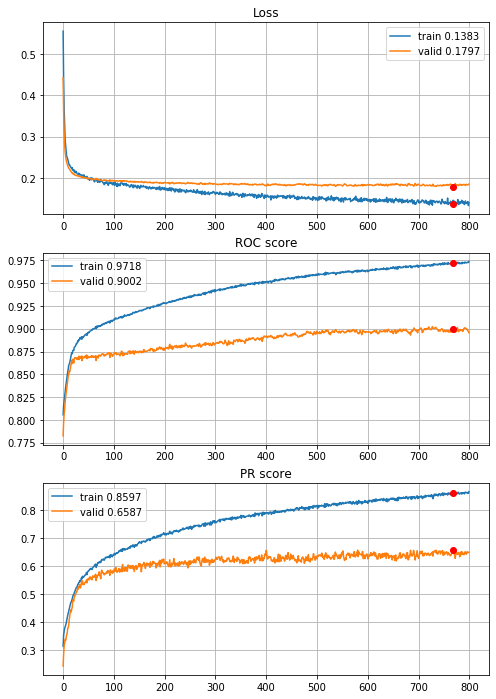


Fold 2------------------------------------------------------------


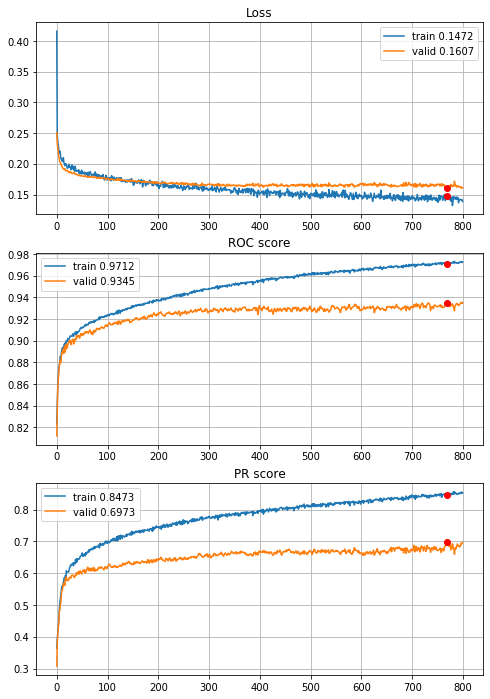


Fold 3------------------------------------------------------------


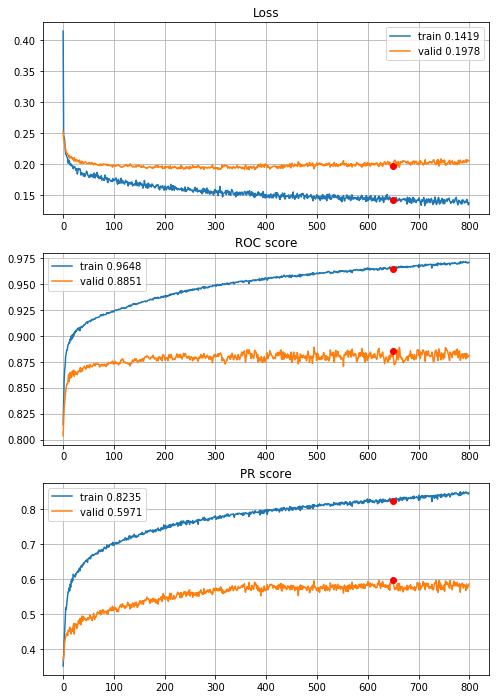


Fold 4------------------------------------------------------------


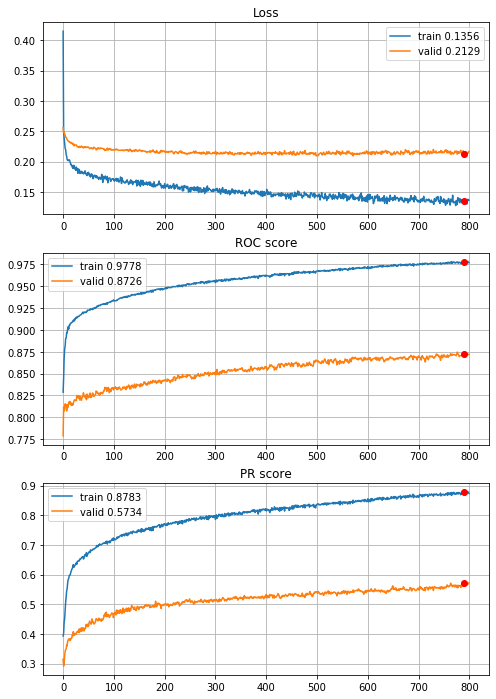


Fold 5------------------------------------------------------------


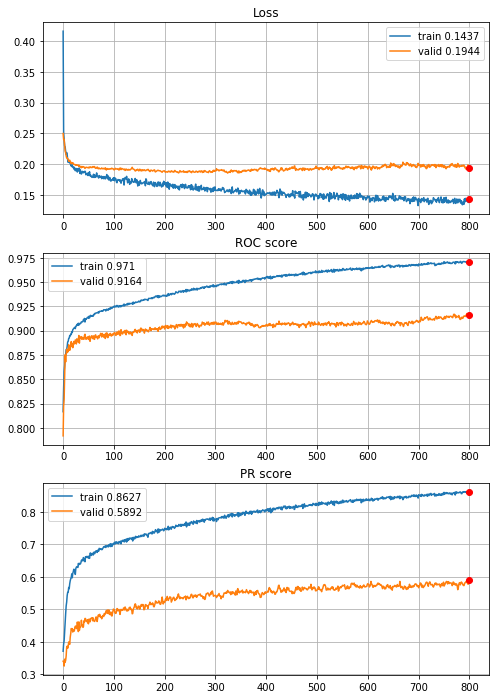


Fold 6------------------------------------------------------------


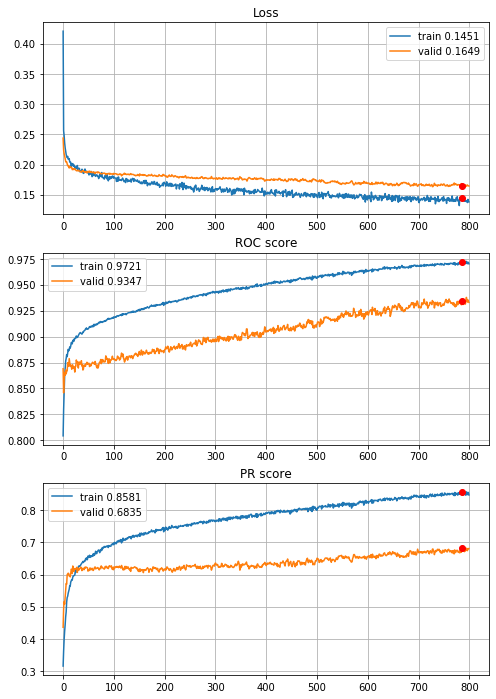

In [236]:
# THE BEST ONE
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=800,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)],
                                        opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

More epochs don't worsen results, we can conclude about different difficulty level of folds, 1st, 2nd and 6th are the easier and the results are stable over them (\~ 0.68). 3rd, 4th and 5th are harder, but the results are stable too (\~0.59). Median of early stopping rounds for this run seems to be reasonable number of epochs for main, "production" model.

##### EDIT: 
 2 and 3 year horizons shows that MLP has potential for much more epochs than 800, loking again on the learning curves, this conculsion doesn't seem to be wrong. Definitely it is worth considering, experiment below, 5000 epochs.


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/5000,
cumulative time: 1.23s train loss: 0.5546576747072303, validation loss: 0.4423624064769121
Epoch: 2/5000,
cumulative time: 1.32s train loss: 0.43803847402280416, validation loss: 0.36102656406910066
Epoch: 3/5000,
cumulative time: 1.42s train loss: 0.36629588283356346, validation loss: 0.3110728503751916
Epoch: 4/5000,
cumulative time: 1.51s train loss: 0.3253089589628287, validation loss: 0.2812069011379659
Epoch: 5/5000,
cumulative time: 1.6s train loss: 0.29160418881890143, validation loss: 0.2628858309856531
Epoch: 6/5000,
cumulative time: 1.68s train loss: 0.2791414604276849, validation loss: 0.2512076211822342
Epoch: 7/5000,
cumulative time: 1.76s train loss: 0.2658065765867487, validation loss: 0.2435714517296906
Epoch: 8/5000,
cumulative time: 1.84s train loss: 0.2519234923935001, validation loss: 0.23803280423297687
Epoch: 9/5000,
cumulative time: 1.9s train loss: 0.25042464805343306, 

Epoch: 79/5000,
cumulative time: 7.9s train loss: 0.18971108847603685, validation loss: 0.19405270566934932
Epoch: 80/5000,
cumulative time: 7.99s train loss: 0.18789141492023795, validation loss: 0.1938139643213526
Epoch: 81/5000,
cumulative time: 8.08s train loss: 0.18792725868173454, validation loss: 0.19512901850792305
Epoch: 82/5000,
cumulative time: 8.17s train loss: 0.18425810324962819, validation loss: 0.195959562815835
Epoch: 83/5000,
cumulative time: 8.25s train loss: 0.18918891197964818, validation loss: 0.1948978571471125
Epoch: 84/5000,
cumulative time: 8.33s train loss: 0.19012354701649842, validation loss: 0.19506019374025985
Epoch: 85/5000,
cumulative time: 8.42s train loss: 0.18690598991427182, validation loss: 0.1949981803824157
Epoch: 86/5000,
cumulative time: 8.51s train loss: 0.19028278175970062, validation loss: 0.19465415136050748
Epoch: 87/5000,
cumulative time: 8.6s train loss: 0.19126468773810226, validation loss: 0.19403310672809468
Epoch: 88/5000,
cumulative

Epoch: 154/5000,
cumulative time: 14.43s train loss: 0.18271502524964, validation loss: 0.19081728385494687
Epoch: 155/5000,
cumulative time: 14.51s train loss: 0.1793329898698343, validation loss: 0.19209383439856426
Epoch: 156/5000,
cumulative time: 14.6s train loss: 0.17851843853020496, validation loss: 0.19101446376443582
Epoch: 157/5000,
cumulative time: 14.68s train loss: 0.17946531606791036, validation loss: 0.19012872841137776
Epoch: 158/5000,
cumulative time: 14.76s train loss: 0.1795070589745303, validation loss: 0.18983817176122675
Epoch: 159/5000,
cumulative time: 14.86s train loss: 0.18214061913426818, validation loss: 0.19040817905977586
Epoch: 160/5000,
cumulative time: 14.94s train loss: 0.17905105981935449, validation loss: 0.18869506608875386
Epoch: 161/5000,
cumulative time: 15.03s train loss: 0.17915740895626348, validation loss: 0.19028690737895793
Epoch: 162/5000,
cumulative time: 15.12s train loss: 0.17891294786888123, validation loss: 0.19100525489721654
Epoch: 

Epoch: 231/5000,
cumulative time: 21.14s train loss: 0.17423912660901297, validation loss: 0.18899749963635656
Epoch: 232/5000,
cumulative time: 21.24s train loss: 0.1718758210028767, validation loss: 0.1886211040827709
Epoch: 233/5000,
cumulative time: 21.32s train loss: 0.1661981645171339, validation loss: 0.1882543895800998
Epoch: 234/5000,
cumulative time: 21.41s train loss: 0.17176547331150474, validation loss: 0.18676959062173643
Epoch: 235/5000,
cumulative time: 21.49s train loss: 0.1700904014443017, validation loss: 0.18735959415304082
Epoch: 236/5000,
cumulative time: 21.59s train loss: 0.1708252674795768, validation loss: 0.18752970831235607
Epoch: 237/5000,
cumulative time: 21.66s train loss: 0.16886719878063627, validation loss: 0.18762175500258518
Epoch: 238/5000,
cumulative time: 21.76s train loss: 0.17011731444094802, validation loss: 0.18822693050310874
Epoch: 239/5000,
cumulative time: 21.84s train loss: 0.17116036739482776, validation loss: 0.1875291982121774
Epoch: 2

Epoch: 308/5000,
cumulative time: 27.89s train loss: 0.1604236995310452, validation loss: 0.18441900061579944
Epoch: 309/5000,
cumulative time: 27.97s train loss: 0.16276934514299626, validation loss: 0.18490475560659217
Epoch: 310/5000,
cumulative time: 28.07s train loss: 0.16689267715553516, validation loss: 0.18543100716565078
Epoch: 311/5000,
cumulative time: 28.16s train loss: 0.16196274573474262, validation loss: 0.18573561982748338
Epoch: 312/5000,
cumulative time: 28.25s train loss: 0.16438788279137886, validation loss: 0.18499487586395044
Epoch: 313/5000,
cumulative time: 28.34s train loss: 0.1628967486187439, validation loss: 0.1845978862168152
Epoch: 314/5000,
cumulative time: 28.44s train loss: 0.15997694691622946, validation loss: 0.18482590064389595
Epoch: 315/5000,
cumulative time: 28.52s train loss: 0.16036208526026255, validation loss: 0.18602763860577795
Epoch: 316/5000,
cumulative time: 28.6s train loss: 0.16244157230219256, validation loss: 0.18553821507341564
Epoch

Epoch: 384/5000,
cumulative time: 34.52s train loss: 0.15858803881796257, validation loss: 0.18392534254973475
Epoch: 385/5000,
cumulative time: 34.6s train loss: 0.15348169217659463, validation loss: 0.18435647396587063
Epoch: 386/5000,
cumulative time: 34.68s train loss: 0.1604683701493626, validation loss: 0.18446034450071372
Epoch: 387/5000,
cumulative time: 34.77s train loss: 0.15785964122479143, validation loss: 0.1838121870291139
Epoch: 388/5000,
cumulative time: 34.86s train loss: 0.15795691493253092, validation loss: 0.1853677377591945
Epoch: 389/5000,
cumulative time: 34.93s train loss: 0.15373512556514154, validation loss: 0.18469579956308427
Epoch: 390/5000,
cumulative time: 35.03s train loss: 0.1581265076840236, validation loss: 0.18436141446518386
Epoch: 391/5000,
cumulative time: 35.12s train loss: 0.15503118286037057, validation loss: 0.18404422834801162
Epoch: 392/5000,
cumulative time: 35.2s train loss: 0.16283509576027466, validation loss: 0.18412777458936008
Epoch: 

Epoch: 460/5000,
cumulative time: 41.23s train loss: 0.1519061314406055, validation loss: 0.18465964726288933
Epoch: 461/5000,
cumulative time: 41.31s train loss: 0.14817466392830714, validation loss: 0.18555531490346355
Epoch: 462/5000,
cumulative time: 41.41s train loss: 0.15394420468581282, validation loss: 0.18543113907536632
Epoch: 463/5000,
cumulative time: 41.5s train loss: 0.1559021682024594, validation loss: 0.18521368209579214
Epoch: 464/5000,
cumulative time: 41.59s train loss: 0.14834798327462229, validation loss: 0.18521234297362632
Epoch: 465/5000,
cumulative time: 41.68s train loss: 0.149348007979053, validation loss: 0.18646191682124755
Epoch: 466/5000,
cumulative time: 41.77s train loss: 0.15442272466657825, validation loss: 0.18650274645650536
Epoch: 467/5000,
cumulative time: 41.85s train loss: 0.1520263850050121, validation loss: 0.18574575757294925
Epoch: 468/5000,
cumulative time: 41.95s train loss: 0.1508090046136926, validation loss: 0.18493266160082253
Epoch: 4

Epoch: 536/5000,
cumulative time: 47.94s train loss: 0.15299669674695185, validation loss: 0.18249151199686486
Epoch: 537/5000,
cumulative time: 48.02s train loss: 0.14832418330941713, validation loss: 0.18027077074317008
Epoch: 538/5000,
cumulative time: 48.12s train loss: 0.14977776220518868, validation loss: 0.18134493332906398
Epoch: 539/5000,
cumulative time: 48.21s train loss: 0.15398049571413533, validation loss: 0.18113496677851326
Epoch: 540/5000,
cumulative time: 48.29s train loss: 0.15230224413682944, validation loss: 0.18334506351286556
Epoch: 541/5000,
cumulative time: 48.37s train loss: 0.14953743537302913, validation loss: 0.18314897323608936
Epoch: 542/5000,
cumulative time: 48.46s train loss: 0.15287401648877114, validation loss: 0.184307270214012
Epoch: 543/5000,
cumulative time: 48.56s train loss: 0.15157709382339934, validation loss: 0.18375104185290375
Epoch: 544/5000,
cumulative time: 48.65s train loss: 0.14513057717441544, validation loss: 0.18296864487675965
Epo

Epoch: 613/5000,
cumulative time: 54.6s train loss: 0.14333917550231576, validation loss: 0.18186469995988935
Epoch: 614/5000,
cumulative time: 54.69s train loss: 0.14954769248243704, validation loss: 0.1829385258836972
Epoch: 615/5000,
cumulative time: 54.77s train loss: 0.1477989102663331, validation loss: 0.18284721071112653
Epoch: 616/5000,
cumulative time: 54.85s train loss: 0.1418730469877808, validation loss: 0.18405558021052446
Epoch: 617/5000,
cumulative time: 54.95s train loss: 0.15078795574175108, validation loss: 0.18331747299654508
Epoch: 618/5000,
cumulative time: 55.03s train loss: 0.14621337821929034, validation loss: 0.18408596670210967
Epoch: 619/5000,
cumulative time: 55.12s train loss: 0.1422855151306152, validation loss: 0.18539274441080406
Epoch: 620/5000,
cumulative time: 55.21s train loss: 0.14636097619115016, validation loss: 0.18559117117957574
Epoch: 621/5000,
cumulative time: 55.3s train loss: 0.1442873338371892, validation loss: 0.1856421157297717
Epoch: 62

cumulative time: 61.18s train loss: 0.1448762320614141, validation loss: 0.18367042574766926
Epoch: 690/5000,
cumulative time: 61.27s train loss: 0.1380940288312007, validation loss: 0.18240583745979
Epoch: 691/5000,
cumulative time: 61.35s train loss: 0.1413265480643091, validation loss: 0.18090202458614427
Epoch: 692/5000,
cumulative time: 61.43s train loss: 0.14555465743712248, validation loss: 0.18070210187182487
Epoch: 693/5000,
cumulative time: 61.5s train loss: 0.13890921763255384, validation loss: 0.18308872849656335
Epoch: 694/5000,
cumulative time: 61.58s train loss: 0.13665408335814408, validation loss: 0.1870218486332974
Epoch: 695/5000,
cumulative time: 61.67s train loss: 0.13997655722988425, validation loss: 0.18479002484675863
Epoch: 696/5000,
cumulative time: 61.76s train loss: 0.13793031412045664, validation loss: 0.18430604559727426
Epoch: 697/5000,
cumulative time: 61.83s train loss: 0.1420068278747345, validation loss: 0.18238176769979106
Epoch: 698/5000,
cumulative

Epoch: 765/5000,
cumulative time: 67.88s train loss: 0.13828366913829362, validation loss: 0.184736287714798
Epoch: 766/5000,
cumulative time: 67.97s train loss: 0.13837931212710236, validation loss: 0.18321749322712758
Epoch: 767/5000,
cumulative time: 68.05s train loss: 0.13589250780171327, validation loss: 0.18228821234678871
Epoch: 768/5000,
cumulative time: 68.14s train loss: 0.13832702545872771, validation loss: 0.17965727365809875
Epoch: 769/5000,
cumulative time: 68.23s train loss: 0.1465949867633491, validation loss: 0.18080485829707602
Epoch: 770/5000,
cumulative time: 68.32s train loss: 0.14105232902516743, validation loss: 0.18314614393060613
Epoch: 771/5000,
cumulative time: 68.39s train loss: 0.1413814603394765, validation loss: 0.18256356364710355
Epoch: 772/5000,
cumulative time: 68.49s train loss: 0.14426647282007155, validation loss: 0.18516500850272152
Epoch: 773/5000,
cumulative time: 68.57s train loss: 0.13753286457623923, validation loss: 0.18679563939705776
Epoch

Epoch: 840/5000,
cumulative time: 74.38s train loss: 0.1405093848960817, validation loss: 0.1859801620950559
Epoch: 841/5000,
cumulative time: 74.47s train loss: 0.14048804188759104, validation loss: 0.18097060130911186
Epoch: 842/5000,
cumulative time: 74.55s train loss: 0.13917919849835686, validation loss: 0.1805092758229244
Epoch: 843/5000,
cumulative time: 74.63s train loss: 0.1380893243409505, validation loss: 0.1817131188636165
Epoch: 844/5000,
cumulative time: 74.71s train loss: 0.1391253527153001, validation loss: 0.18122485590827775
Epoch: 845/5000,
cumulative time: 74.82s train loss: 0.14413284988475406, validation loss: 0.18088847474355707
Epoch: 846/5000,
cumulative time: 74.9s train loss: 0.1408995849581348, validation loss: 0.1821995792824359
Epoch: 847/5000,
cumulative time: 74.98s train loss: 0.14460221547229948, validation loss: 0.18016184831149415
Epoch: 848/5000,
cumulative time: 75.05s train loss: 0.1427741995457869, validation loss: 0.18127264226907538
Epoch: 849/

Epoch: 916/5000,
cumulative time: 80.98s train loss: 0.13845107834180986, validation loss: 0.1836395339605639
Epoch: 917/5000,
cumulative time: 81.06s train loss: 0.1353289700190567, validation loss: 0.18548091611034304
Epoch: 918/5000,
cumulative time: 81.16s train loss: 0.1337418313060857, validation loss: 0.18678205284755153
Epoch: 919/5000,
cumulative time: 81.26s train loss: 0.13319526026059036, validation loss: 0.1853045467728289
Epoch: 920/5000,
cumulative time: 81.35s train loss: 0.14018305253224037, validation loss: 0.18383328163032467
Epoch: 921/5000,
cumulative time: 81.43s train loss: 0.13390298762328465, validation loss: 0.18485629734958037
Epoch: 922/5000,
cumulative time: 81.51s train loss: 0.13612371171733856, validation loss: 0.18431605039145524
Epoch: 923/5000,
cumulative time: 81.6s train loss: 0.13185297812096478, validation loss: 0.1846091834473368
Epoch: 924/5000,
cumulative time: 81.68s train loss: 0.13805210948434224, validation loss: 0.1837648652922341
Epoch: 9

Epoch: 992/5000,
cumulative time: 87.54s train loss: 0.13403154383766522, validation loss: 0.18411600257121993
Epoch: 993/5000,
cumulative time: 87.64s train loss: 0.13987248188510054, validation loss: 0.18745740891981286
Epoch: 994/5000,
cumulative time: 87.72s train loss: 0.13601622607774144, validation loss: 0.18981918237322212
Epoch: 995/5000,
cumulative time: 87.81s train loss: 0.13404328759006537, validation loss: 0.18872149814478842
Epoch: 996/5000,
cumulative time: 87.89s train loss: 0.1345848702196879, validation loss: 0.18750326090157368
Epoch: 997/5000,
cumulative time: 87.99s train loss: 0.13856366908493778, validation loss: 0.18258611281668052
Epoch: 998/5000,
cumulative time: 88.07s train loss: 0.1315919119454517, validation loss: 0.18131957022555115
Epoch: 999/5000,
cumulative time: 88.17s train loss: 0.12878424422445603, validation loss: 0.1848567917086226
Epoch: 1000/5000,
cumulative time: 88.25s train loss: 0.13325868964881135, validation loss: 0.18544171342317523
Epo

Epoch: 1066/5000,
cumulative time: 93.96s train loss: 0.12965438067106133, validation loss: 0.1837890586797925
Epoch: 1067/5000,
cumulative time: 94.04s train loss: 0.1284258227311209, validation loss: 0.1859244085856731
Epoch: 1068/5000,
cumulative time: 94.13s train loss: 0.13447047587121005, validation loss: 0.18660150842978424
Epoch: 1069/5000,
cumulative time: 94.22s train loss: 0.1292709539163629, validation loss: 0.18600477469746934
Epoch: 1070/5000,
cumulative time: 94.32s train loss: 0.13378491161882017, validation loss: 0.18709542460344825
Epoch: 1071/5000,
cumulative time: 94.4s train loss: 0.13189145140955055, validation loss: 0.18670485493765876
Epoch: 1072/5000,
cumulative time: 94.48s train loss: 0.13083550293966859, validation loss: 0.18574045553148263
Epoch: 1073/5000,
cumulative time: 94.57s train loss: 0.12556682589937956, validation loss: 0.18721457267560174
Epoch: 1074/5000,
cumulative time: 94.65s train loss: 0.13458474652021316, validation loss: 0.188441191863986

Epoch: 1140/5000,
cumulative time: 100.19s train loss: 0.12981088194216095, validation loss: 0.1887880364493829
Epoch: 1141/5000,
cumulative time: 100.28s train loss: 0.12487811091211407, validation loss: 0.18850832453507851
Epoch: 1142/5000,
cumulative time: 100.37s train loss: 0.12842925619804688, validation loss: 0.1889084505154557
Epoch: 1143/5000,
cumulative time: 100.45s train loss: 0.13287870928187878, validation loss: 0.19025283401754287
Epoch: 1144/5000,
cumulative time: 100.54s train loss: 0.12607927035392408, validation loss: 0.19378108629513754
Epoch: 1145/5000,
cumulative time: 100.64s train loss: 0.1283361976277016, validation loss: 0.19007150158538086
Epoch: 1146/5000,
cumulative time: 100.72s train loss: 0.12849182417004332, validation loss: 0.1888946851016166
Epoch: 1147/5000,
cumulative time: 100.8s train loss: 0.12487354538057148, validation loss: 0.1866668497864262
Epoch: 1148/5000,
cumulative time: 100.9s train loss: 0.13163313520769673, validation loss: 0.18621321

Epoch: 1214/5000,
cumulative time: 106.61s train loss: 0.12835160450882108, validation loss: 0.19072595698992054
Epoch: 1215/5000,
cumulative time: 106.69s train loss: 0.13315701884779044, validation loss: 0.19248200484300546
Epoch: 1216/5000,
cumulative time: 106.77s train loss: 0.12938983679584326, validation loss: 0.19106110969081672
Epoch: 1217/5000,
cumulative time: 106.87s train loss: 0.13676421596779612, validation loss: 0.1903868647378354
Epoch: 1218/5000,
cumulative time: 106.95s train loss: 0.13024112904639343, validation loss: 0.19270401798281084
Epoch: 1219/5000,
cumulative time: 107.04s train loss: 0.12849045109797255, validation loss: 0.18868308066649797
Epoch: 1220/5000,
cumulative time: 107.12s train loss: 0.12955395845084414, validation loss: 0.18594868141809204
Epoch: 1221/5000,
cumulative time: 107.21s train loss: 0.12454868948914191, validation loss: 0.18607318226621816
Epoch: 1222/5000,
cumulative time: 107.29s train loss: 0.12585501479395136, validation loss: 0.18

Epoch: 1288/5000,
cumulative time: 113.04s train loss: 0.1282957682641566, validation loss: 0.18905019975165505
Epoch: 1289/5000,
cumulative time: 113.11s train loss: 0.12626957710469242, validation loss: 0.1893738990202294
Epoch: 1290/5000,
cumulative time: 113.19s train loss: 0.12879391320197697, validation loss: 0.18987612018052996
Epoch: 1291/5000,
cumulative time: 113.27s train loss: 0.13059784141823058, validation loss: 0.18741695959175586
Epoch: 1292/5000,
cumulative time: 113.34s train loss: 0.12960456857720007, validation loss: 0.1890540015469006
Epoch: 1293/5000,
cumulative time: 113.42s train loss: 0.12629032412389232, validation loss: 0.1891378812752286
Epoch: 1294/5000,
cumulative time: 113.52s train loss: 0.12806267620800635, validation loss: 0.1879480184972488
Epoch: 1295/5000,
cumulative time: 113.6s train loss: 0.12659794236751884, validation loss: 0.18916251321387265
Epoch: 1296/5000,
cumulative time: 113.7s train loss: 0.13039092155718093, validation loss: 0.19028481

Epoch: 1361/5000,
cumulative time: 119.43s train loss: 0.12200745562299925, validation loss: 0.18573655609751233
Epoch: 1362/5000,
cumulative time: 119.52s train loss: 0.12470187434745071, validation loss: 0.18636390553386262
Epoch: 1363/5000,
cumulative time: 119.61s train loss: 0.12046783105117212, validation loss: 0.18658978219029598
Epoch: 1364/5000,
cumulative time: 119.69s train loss: 0.13053028478492254, validation loss: 0.18642359595691205
Epoch: 1365/5000,
cumulative time: 119.79s train loss: 0.12404510501893204, validation loss: 0.1870272438952189
Epoch: 1366/5000,
cumulative time: 119.88s train loss: 0.1248084923877828, validation loss: 0.18907455490164987
Epoch: 1367/5000,
cumulative time: 119.97s train loss: 0.12255115897498944, validation loss: 0.18884906789294226
Epoch: 1368/5000,
cumulative time: 120.06s train loss: 0.12891133240548497, validation loss: 0.19116961371401386
Epoch: 1369/5000,
cumulative time: 120.16s train loss: 0.1238659342098645, validation loss: 0.1893

Epoch: 1435/5000,
cumulative time: 125.99s train loss: 0.12865311729751985, validation loss: 0.1859215573904345
Epoch: 1436/5000,
cumulative time: 126.08s train loss: 0.1265743324459137, validation loss: 0.18809538778954993
Epoch: 1437/5000,
cumulative time: 126.18s train loss: 0.1223820107333389, validation loss: 0.18813997735568608
Epoch: 1438/5000,
cumulative time: 126.26s train loss: 0.12255589764511435, validation loss: 0.18497376889830378
Epoch: 1439/5000,
cumulative time: 126.35s train loss: 0.11892345289461019, validation loss: 0.18461046524959057
Epoch: 1440/5000,
cumulative time: 126.43s train loss: 0.11978186118258466, validation loss: 0.18550939177579784
Epoch: 1441/5000,
cumulative time: 126.51s train loss: 0.1237399959533277, validation loss: 0.1855294581296882
Epoch: 1442/5000,
cumulative time: 126.61s train loss: 0.12631372253776996, validation loss: 0.18615924413268703
Epoch: 1443/5000,
cumulative time: 126.69s train loss: 0.12537512564796296, validation loss: 0.187873

Epoch: 1510/5000,
cumulative time: 132.55s train loss: 0.12632198127100938, validation loss: 0.18758651415954986
Epoch: 1511/5000,
cumulative time: 132.65s train loss: 0.12674202138578203, validation loss: 0.187314227844978
Epoch: 1512/5000,
cumulative time: 132.74s train loss: 0.12069369700236333, validation loss: 0.18675530415444122
Epoch: 1513/5000,
cumulative time: 132.83s train loss: 0.12347474695933101, validation loss: 0.18669169333163887
Epoch: 1514/5000,
cumulative time: 132.92s train loss: 0.12384338652049376, validation loss: 0.18408934126913615
Epoch: 1515/5000,
cumulative time: 133.0s train loss: 0.12108101291978725, validation loss: 0.18454764815301475
Epoch: 1516/5000,
cumulative time: 133.09s train loss: 0.12737501924689387, validation loss: 0.18703167016167518
Epoch: 1517/5000,
cumulative time: 133.17s train loss: 0.12256003384031221, validation loss: 0.187546003362103
Epoch: 1518/5000,
cumulative time: 133.25s train loss: 0.12395816957678928, validation loss: 0.185962

Epoch: 1585/5000,
cumulative time: 139.21s train loss: 0.12266226145791878, validation loss: 0.1919743763923376
Epoch: 1586/5000,
cumulative time: 139.3s train loss: 0.1201694407298596, validation loss: 0.1939931673490208
Epoch: 1587/5000,
cumulative time: 139.4s train loss: 0.12324201209060444, validation loss: 0.19400229369707012
Epoch: 1588/5000,
cumulative time: 139.49s train loss: 0.12267566458843245, validation loss: 0.18891588889961178
Epoch: 1589/5000,
cumulative time: 139.57s train loss: 0.13164948750394884, validation loss: 0.18709614988849022
Epoch: 1590/5000,
cumulative time: 139.64s train loss: 0.12191748966056087, validation loss: 0.18603606590961255
Epoch: 1591/5000,
cumulative time: 139.72s train loss: 0.12276894708469994, validation loss: 0.186129351899347
Epoch: 1592/5000,
cumulative time: 139.81s train loss: 0.1223377646098337, validation loss: 0.18699394935886918
Epoch: 1593/5000,
cumulative time: 139.9s train loss: 0.11842361765338734, validation loss: 0.1865632951

Epoch: 1659/5000,
cumulative time: 145.64s train loss: 0.12394932040521062, validation loss: 0.18866706559730625
Epoch: 1660/5000,
cumulative time: 145.71s train loss: 0.11796648297391643, validation loss: 0.18992330169193908
Epoch: 1661/5000,
cumulative time: 145.79s train loss: 0.1164287282019477, validation loss: 0.1911490811402526
Epoch: 1662/5000,
cumulative time: 145.88s train loss: 0.12509309329993565, validation loss: 0.19373121061346577
Epoch: 1663/5000,
cumulative time: 145.98s train loss: 0.12278850705762956, validation loss: 0.1927140071534519
Epoch: 1664/5000,
cumulative time: 146.07s train loss: 0.1288860898115252, validation loss: 0.19201469915292174
Epoch: 1665/5000,
cumulative time: 146.15s train loss: 0.1188300544570876, validation loss: 0.1924778725006938
Epoch: 1666/5000,
cumulative time: 146.24s train loss: 0.12247734471469687, validation loss: 0.19091017332595794
Epoch: 1667/5000,
cumulative time: 146.33s train loss: 0.1197291957449827, validation loss: 0.19204739

Epoch: 1733/5000,
cumulative time: 152.04s train loss: 0.12092751710564704, validation loss: 0.19296770699935406
Epoch: 1734/5000,
cumulative time: 152.12s train loss: 0.1257296979380267, validation loss: 0.1905124398135279
Epoch: 1735/5000,
cumulative time: 152.21s train loss: 0.11765201121487988, validation loss: 0.18941763483550664
Epoch: 1736/5000,
cumulative time: 152.3s train loss: 0.11969092712882193, validation loss: 0.18766821435366032
Epoch: 1737/5000,
cumulative time: 152.38s train loss: 0.12316034899668142, validation loss: 0.18850325456197797
Epoch: 1738/5000,
cumulative time: 152.47s train loss: 0.12594828803246902, validation loss: 0.1900715454824882
Epoch: 1739/5000,
cumulative time: 152.56s train loss: 0.11746406251235128, validation loss: 0.19032302880166213
Epoch: 1740/5000,
cumulative time: 152.64s train loss: 0.11991513415243113, validation loss: 0.18878064429746538
Epoch: 1741/5000,
cumulative time: 152.72s train loss: 0.11913952752880563, validation loss: 0.19332

Epoch: 1807/5000,
cumulative time: 158.59s train loss: 0.12178757599141408, validation loss: 0.1899897810134705
Epoch: 1808/5000,
cumulative time: 158.67s train loss: 0.12311602483708613, validation loss: 0.19081230938703392
Epoch: 1809/5000,
cumulative time: 158.76s train loss: 0.11904666371078698, validation loss: 0.1895935959618417
Epoch: 1810/5000,
cumulative time: 158.85s train loss: 0.118979014473083, validation loss: 0.18943183387817633
Epoch: 1811/5000,
cumulative time: 158.93s train loss: 0.12044398595212491, validation loss: 0.18914965604848766
Epoch: 1812/5000,
cumulative time: 159.02s train loss: 0.12163071182727922, validation loss: 0.19012005754831543
Epoch: 1813/5000,
cumulative time: 159.11s train loss: 0.12296340611867526, validation loss: 0.19419110978805496
Epoch: 1814/5000,
cumulative time: 159.19s train loss: 0.12202002761703966, validation loss: 0.1960840814042387
Epoch: 1815/5000,
cumulative time: 159.28s train loss: 0.11861253236269155, validation loss: 0.195373

Epoch: 1882/5000,
cumulative time: 165.11s train loss: 0.12231766540113338, validation loss: 0.19033547639510812
Epoch: 1883/5000,
cumulative time: 165.2s train loss: 0.12108156073582947, validation loss: 0.1921749120030086
Epoch: 1884/5000,
cumulative time: 165.3s train loss: 0.11781679426020664, validation loss: 0.18996282311612078
Epoch: 1885/5000,
cumulative time: 165.39s train loss: 0.12100166473403197, validation loss: 0.18845306093286904
Epoch: 1886/5000,
cumulative time: 165.46s train loss: 0.12366201978055794, validation loss: 0.1877909862471003
Epoch: 1887/5000,
cumulative time: 165.55s train loss: 0.12534857584022335, validation loss: 0.18646984309663633
Epoch: 1888/5000,
cumulative time: 165.65s train loss: 0.12055542615212043, validation loss: 0.18781272263981175
Epoch: 1889/5000,
cumulative time: 165.73s train loss: 0.11956521696562371, validation loss: 0.18808253378247194
Epoch: 1890/5000,
cumulative time: 165.81s train loss: 0.11437002360645937, validation loss: 0.18931

Epoch: 1956/5000,
cumulative time: 171.5s train loss: 0.1236024173514561, validation loss: 0.19255161014928354
Epoch: 1957/5000,
cumulative time: 171.59s train loss: 0.11912776726476229, validation loss: 0.1897292432817289
Epoch: 1958/5000,
cumulative time: 171.68s train loss: 0.11529957384395578, validation loss: 0.1891049372437573
Epoch: 1959/5000,
cumulative time: 171.76s train loss: 0.11884266156904964, validation loss: 0.19004955627402162
Epoch: 1960/5000,
cumulative time: 171.84s train loss: 0.11620452809433322, validation loss: 0.19252895895631095
Epoch: 1961/5000,
cumulative time: 171.92s train loss: 0.1188208475735859, validation loss: 0.19296571802192503
Epoch: 1962/5000,
cumulative time: 172.03s train loss: 0.11543025089165579, validation loss: 0.19446186472692242
Epoch: 1963/5000,
cumulative time: 172.11s train loss: 0.11740942678619377, validation loss: 0.19352075612128386
Epoch: 1964/5000,
cumulative time: 172.2s train loss: 0.12088823434476495, validation loss: 0.1949539

Epoch: 2030/5000,
cumulative time: 178.06s train loss: 0.12434202749349366, validation loss: 0.1918810149896239
Epoch: 2031/5000,
cumulative time: 178.15s train loss: 0.11684301612891983, validation loss: 0.1957879164408401
Epoch: 2032/5000,
cumulative time: 178.24s train loss: 0.12267019588244736, validation loss: 0.19703447047658812
Epoch: 2033/5000,
cumulative time: 178.32s train loss: 0.11866169439339573, validation loss: 0.1939165656871699
Epoch: 2034/5000,
cumulative time: 178.41s train loss: 0.12104506153841957, validation loss: 0.19265772325008806
Epoch: 2035/5000,
cumulative time: 178.5s train loss: 0.1202248482047059, validation loss: 0.19383735126545895
Epoch: 2036/5000,
cumulative time: 178.59s train loss: 0.11385091640969691, validation loss: 0.19570908802136225
Epoch: 2037/5000,
cumulative time: 178.68s train loss: 0.11497679300310379, validation loss: 0.19471370369162339
Epoch: 2038/5000,
cumulative time: 178.77s train loss: 0.12021505038862516, validation loss: 0.193434

Epoch: 2103/5000,
cumulative time: 184.49s train loss: 0.12191154445699728, validation loss: 0.19675836642404015
Epoch: 2104/5000,
cumulative time: 184.57s train loss: 0.1160696965309418, validation loss: 0.1945744600008413
Epoch: 2105/5000,
cumulative time: 184.66s train loss: 0.12190397857732076, validation loss: 0.19109798104343714
Epoch: 2106/5000,
cumulative time: 184.75s train loss: 0.11822722975621908, validation loss: 0.19338961311835448
Epoch: 2107/5000,
cumulative time: 184.83s train loss: 0.1174165620317259, validation loss: 0.19517430056646684
Epoch: 2108/5000,
cumulative time: 184.92s train loss: 0.1166192536756719, validation loss: 0.19478893800813962
Epoch: 2109/5000,
cumulative time: 185.01s train loss: 0.12054135880705359, validation loss: 0.19380612268187147
Epoch: 2110/5000,
cumulative time: 185.1s train loss: 0.11688317989237902, validation loss: 0.1936394542018886
Epoch: 2111/5000,
cumulative time: 185.18s train loss: 0.11932272545065367, validation loss: 0.1947510

Epoch: 2177/5000,
cumulative time: 190.82s train loss: 0.11496459018936657, validation loss: 0.19540675459881107
Epoch: 2178/5000,
cumulative time: 190.9s train loss: 0.12008818999833902, validation loss: 0.19768548428407517
Epoch: 2179/5000,
cumulative time: 190.99s train loss: 0.1132720481227774, validation loss: 0.20134937669136882
Epoch: 2180/5000,
cumulative time: 191.09s train loss: 0.12154802209647231, validation loss: 0.19897496695247013
Epoch: 2181/5000,
cumulative time: 191.18s train loss: 0.11650772241451895, validation loss: 0.1969199313319119
Epoch: 2182/5000,
cumulative time: 191.27s train loss: 0.11770109002838174, validation loss: 0.19729129496327652
Epoch: 2183/5000,
cumulative time: 191.36s train loss: 0.11809153817863026, validation loss: 0.20073238235248386
Epoch: 2184/5000,
cumulative time: 191.44s train loss: 0.11684144298724211, validation loss: 0.19943428615773812
Epoch: 2185/5000,
cumulative time: 191.52s train loss: 0.11859389779827009, validation loss: 0.1948

Epoch: 2251/5000,
cumulative time: 197.32s train loss: 0.11842200885583994, validation loss: 0.19413815584903102
Epoch: 2252/5000,
cumulative time: 197.4s train loss: 0.11844980727800501, validation loss: 0.19566468923040817
Epoch: 2253/5000,
cumulative time: 197.5s train loss: 0.12113581553760526, validation loss: 0.19488808927635465
Epoch: 2254/5000,
cumulative time: 197.59s train loss: 0.11891231703696375, validation loss: 0.19571752125542222
Epoch: 2255/5000,
cumulative time: 197.68s train loss: 0.11170650100745665, validation loss: 0.1957886183745697
Epoch: 2256/5000,
cumulative time: 197.77s train loss: 0.11675840933279333, validation loss: 0.19352051209166998
Epoch: 2257/5000,
cumulative time: 197.86s train loss: 0.11792536726429897, validation loss: 0.19343939489079168
Epoch: 2258/5000,
cumulative time: 197.95s train loss: 0.11729396699124188, validation loss: 0.19698828090876844
Epoch: 2259/5000,
cumulative time: 198.03s train loss: 0.11818366913319925, validation loss: 0.1970

Epoch: 2324/5000,
cumulative time: 203.78s train loss: 0.1159243586301696, validation loss: 0.19246030880270573
Epoch: 2325/5000,
cumulative time: 203.88s train loss: 0.11341583098382403, validation loss: 0.19429228000401644
Epoch: 2326/5000,
cumulative time: 203.97s train loss: 0.11884768463886386, validation loss: 0.19757409741537144
Epoch: 2327/5000,
cumulative time: 204.05s train loss: 0.10923849780865633, validation loss: 0.19808668153530581
Epoch: 2328/5000,
cumulative time: 204.13s train loss: 0.11583578041233526, validation loss: 0.1942788480771569
Epoch: 2329/5000,
cumulative time: 204.22s train loss: 0.12174810725684523, validation loss: 0.19360754056807436
Epoch: 2330/5000,
cumulative time: 204.3s train loss: 0.1155741174809554, validation loss: 0.19570350431938988
Epoch: 2331/5000,
cumulative time: 204.38s train loss: 0.11525408417954772, validation loss: 0.1968521862684538
Epoch: 2332/5000,
cumulative time: 204.47s train loss: 0.11740607068292286, validation loss: 0.195393

Epoch: 2398/5000,
cumulative time: 210.27s train loss: 0.11582023149107445, validation loss: 0.20317416707853858
Epoch: 2399/5000,
cumulative time: 210.34s train loss: 0.11867785334102944, validation loss: 0.19918252942661557
Epoch: 2400/5000,
cumulative time: 210.43s train loss: 0.1132562896270399, validation loss: 0.19965362557227878
Epoch: 2401/5000,
cumulative time: 210.52s train loss: 0.11447351411765018, validation loss: 0.2033022756036266
Epoch: 2402/5000,
cumulative time: 210.59s train loss: 0.11850714361436315, validation loss: 0.20013850917273202
Epoch: 2403/5000,
cumulative time: 210.68s train loss: 0.12102502936477158, validation loss: 0.2019297668233665
Epoch: 2404/5000,
cumulative time: 210.76s train loss: 0.10903237005931053, validation loss: 0.20425561152759775
Epoch: 2405/5000,
cumulative time: 210.84s train loss: 0.1201872390019119, validation loss: 0.20464332568067575
Epoch: 2406/5000,
cumulative time: 210.93s train loss: 0.11849791930470656, validation loss: 0.19926

Epoch: 2473/5000,
cumulative time: 216.74s train loss: 0.11287308713280014, validation loss: 0.1998888706576327
Epoch: 2474/5000,
cumulative time: 216.84s train loss: 0.11760136808541062, validation loss: 0.19989691921662048
Epoch: 2475/5000,
cumulative time: 216.93s train loss: 0.11480959352199997, validation loss: 0.20061517141448604
Epoch: 2476/5000,
cumulative time: 217.03s train loss: 0.11823824334499639, validation loss: 0.198969977583396
Epoch: 2477/5000,
cumulative time: 217.11s train loss: 0.11389531034115527, validation loss: 0.19940746650351746
Epoch: 2478/5000,
cumulative time: 217.19s train loss: 0.11325935478446608, validation loss: 0.19753907997215747
Epoch: 2479/5000,
cumulative time: 217.27s train loss: 0.11908754311999582, validation loss: 0.19698432635562127
Epoch: 2480/5000,
cumulative time: 217.36s train loss: 0.11472928185782492, validation loss: 0.19609050864297078
Epoch: 2481/5000,
cumulative time: 217.42s train loss: 0.1166599173240014, validation loss: 0.19771

cumulative time: 222.98s train loss: 0.113096546785173, validation loss: 0.19491899268871768
Epoch: 2547/5000,
cumulative time: 223.07s train loss: 0.1125884272716267, validation loss: 0.19342289567665694
Epoch: 2548/5000,
cumulative time: 223.16s train loss: 0.11863780826572262, validation loss: 0.19826415816181273
Epoch: 2549/5000,
cumulative time: 223.22s train loss: 0.11418530381274568, validation loss: 0.19931875159197487
Epoch: 2550/5000,
cumulative time: 223.32s train loss: 0.11477327939048948, validation loss: 0.19972498061423102
Epoch: 2551/5000,
cumulative time: 223.39s train loss: 0.11682236917814516, validation loss: 0.19853549078526866
Epoch: 2552/5000,
cumulative time: 223.49s train loss: 0.1105834300485221, validation loss: 0.19738483612069685
Epoch: 2553/5000,
cumulative time: 223.59s train loss: 0.11432147320588573, validation loss: 0.19797725211135966
Epoch: 2554/5000,
cumulative time: 223.67s train loss: 0.11520687062360535, validation loss: 0.1988402840585827
Epoch:

Epoch: 2621/5000,
cumulative time: 229.54s train loss: 0.11998729861680997, validation loss: 0.19886702443593787
Epoch: 2622/5000,
cumulative time: 229.63s train loss: 0.11432728923130982, validation loss: 0.19774558800855377
Epoch: 2623/5000,
cumulative time: 229.71s train loss: 0.1144420636031064, validation loss: 0.20069980090473524
Epoch: 2624/5000,
cumulative time: 229.81s train loss: 0.1118461032186228, validation loss: 0.20241327894580674
Epoch: 2625/5000,
cumulative time: 229.89s train loss: 0.1085638433244308, validation loss: 0.19988218853680634
Epoch: 2626/5000,
cumulative time: 229.98s train loss: 0.11816795840388708, validation loss: 0.19779013816305052
Epoch: 2627/5000,
cumulative time: 230.06s train loss: 0.11597369208474667, validation loss: 0.19360574087067145
Epoch: 2628/5000,
cumulative time: 230.14s train loss: 0.11480794456999224, validation loss: 0.19288714320777905
Epoch: 2629/5000,
cumulative time: 230.24s train loss: 0.11497125047383433, validation loss: 0.1962

Epoch: 2695/5000,
cumulative time: 236.14s train loss: 0.11285393222803351, validation loss: 0.1993255856811261
Epoch: 2696/5000,
cumulative time: 236.22s train loss: 0.11151458715703944, validation loss: 0.1986288864925722
Epoch: 2697/5000,
cumulative time: 236.31s train loss: 0.11628472152088738, validation loss: 0.19961105806179757
Epoch: 2698/5000,
cumulative time: 236.39s train loss: 0.11705094851916555, validation loss: 0.19978383769782043
Epoch: 2699/5000,
cumulative time: 236.47s train loss: 0.10915173187058433, validation loss: 0.19924653120750505
Epoch: 2700/5000,
cumulative time: 236.58s train loss: 0.11542764006498596, validation loss: 0.1993360288415982
Epoch: 2701/5000,
cumulative time: 236.68s train loss: 0.1171821474807088, validation loss: 0.2007668280749337
Epoch: 2702/5000,
cumulative time: 236.77s train loss: 0.11604362082691184, validation loss: 0.19894796206690413
Epoch: 2703/5000,
cumulative time: 236.85s train loss: 0.11359758979039072, validation loss: 0.198517

Epoch: 2769/5000,
cumulative time: 242.75s train loss: 0.11185163275980885, validation loss: 0.19976582750258076
Epoch: 2770/5000,
cumulative time: 242.85s train loss: 0.1095645849118917, validation loss: 0.20047291569000167
Epoch: 2771/5000,
cumulative time: 242.93s train loss: 0.10582893897547296, validation loss: 0.19844935308583292
Epoch: 2772/5000,
cumulative time: 243.01s train loss: 0.12087653110994005, validation loss: 0.19607352242797713
Epoch: 2773/5000,
cumulative time: 243.1s train loss: 0.11186220738969554, validation loss: 0.19901768789283317
Epoch: 2774/5000,
cumulative time: 243.18s train loss: 0.11334534690106819, validation loss: 0.19857004029506223
Epoch: 2775/5000,
cumulative time: 243.28s train loss: 0.1146069980455085, validation loss: 0.19656060377331167
Epoch: 2776/5000,
cumulative time: 243.37s train loss: 0.11383833632626258, validation loss: 0.1969579273610131
Epoch: 2777/5000,
cumulative time: 243.46s train loss: 0.1136795930591301, validation loss: 0.197523

Epoch: 2842/5000,
cumulative time: 249.2s train loss: 0.11235108971595764, validation loss: 0.1961092535981734
Epoch: 2843/5000,
cumulative time: 249.3s train loss: 0.11040930073230867, validation loss: 0.1968113102833609
Epoch: 2844/5000,
cumulative time: 249.39s train loss: 0.10931769071906697, validation loss: 0.19839163583187805
Epoch: 2845/5000,
cumulative time: 249.47s train loss: 0.10958537087180661, validation loss: 0.198849512110837
Epoch: 2846/5000,
cumulative time: 249.54s train loss: 0.11380356612080701, validation loss: 0.19933532148162839
Epoch: 2847/5000,
cumulative time: 249.64s train loss: 0.11635389194121107, validation loss: 0.1958901298220827
Epoch: 2848/5000,
cumulative time: 249.73s train loss: 0.1124475096900433, validation loss: 0.19646411636905176
Epoch: 2849/5000,
cumulative time: 249.81s train loss: 0.10988056003738074, validation loss: 0.20048867636428477
Epoch: 2850/5000,
cumulative time: 249.9s train loss: 0.111188087928435, validation loss: 0.200006849769

Epoch: 2916/5000,
cumulative time: 255.79s train loss: 0.11141614290122413, validation loss: 0.19692065592817415
Epoch: 2917/5000,
cumulative time: 255.87s train loss: 0.1119202201217682, validation loss: 0.19850306006268154
Epoch: 2918/5000,
cumulative time: 255.96s train loss: 0.11607811904919169, validation loss: 0.2026049405033989
Epoch: 2919/5000,
cumulative time: 256.04s train loss: 0.11303711051813962, validation loss: 0.2038926604837011
Epoch: 2920/5000,
cumulative time: 256.14s train loss: 0.11802185588055678, validation loss: 0.20485583596191922
Epoch: 2921/5000,
cumulative time: 256.22s train loss: 0.11592808460635183, validation loss: 0.20981436430265563
Epoch: 2922/5000,
cumulative time: 256.32s train loss: 0.11469138613717113, validation loss: 0.2078764640895194
Epoch: 2923/5000,
cumulative time: 256.41s train loss: 0.1095065113715155, validation loss: 0.2073357014033813
Epoch: 2924/5000,
cumulative time: 256.49s train loss: 0.11293710081330383, validation loss: 0.2052145

Epoch: 2989/5000,
cumulative time: 262.23s train loss: 0.11259958586094074, validation loss: 0.2053145693852372
Epoch: 2990/5000,
cumulative time: 262.33s train loss: 0.11727417568719882, validation loss: 0.20097347373287736
Epoch: 2991/5000,
cumulative time: 262.42s train loss: 0.11303911553292337, validation loss: 0.20375442323448156
Epoch: 2992/5000,
cumulative time: 262.49s train loss: 0.11040664018578962, validation loss: 0.20709202887979677
Epoch: 2993/5000,
cumulative time: 262.58s train loss: 0.11455321421893817, validation loss: 0.2085946109040883
Epoch: 2994/5000,
cumulative time: 262.68s train loss: 0.11818178979821153, validation loss: 0.2037879000286642
Epoch: 2995/5000,
cumulative time: 262.75s train loss: 0.10844734306732993, validation loss: 0.20350641208745984
Epoch: 2996/5000,
cumulative time: 262.85s train loss: 0.11322011000103577, validation loss: 0.20311504069887934
Epoch: 2997/5000,
cumulative time: 262.94s train loss: 0.11329047431301877, validation loss: 0.2032

Epoch: 3062/5000,
cumulative time: 268.69s train loss: 0.11633025489021294, validation loss: 0.21128981237078198
Epoch: 3063/5000,
cumulative time: 268.78s train loss: 0.1064227333003218, validation loss: 0.20999365520853605
Epoch: 3064/5000,
cumulative time: 268.87s train loss: 0.11443053545356335, validation loss: 0.21089521490600224
Epoch: 3065/5000,
cumulative time: 268.95s train loss: 0.12009588800814501, validation loss: 0.20526428240127736
Epoch: 3066/5000,
cumulative time: 269.05s train loss: 0.10799176182550806, validation loss: 0.20223067033922523
Epoch: 3067/5000,
cumulative time: 269.13s train loss: 0.10886073822915446, validation loss: 0.20472027494109066
Epoch: 3068/5000,
cumulative time: 269.23s train loss: 0.11453534761907715, validation loss: 0.2074523205452062
Epoch: 3069/5000,
cumulative time: 269.33s train loss: 0.11443284691550133, validation loss: 0.20410865152164404
Epoch: 3070/5000,
cumulative time: 269.42s train loss: 0.1138521049588596, validation loss: 0.1992

Epoch: 3137/5000,
cumulative time: 275.32s train loss: 0.11111706716516173, validation loss: 0.20192735365842887
Epoch: 3138/5000,
cumulative time: 275.42s train loss: 0.11078304396639663, validation loss: 0.20307341779098168
Epoch: 3139/5000,
cumulative time: 275.51s train loss: 0.11675137467346144, validation loss: 0.20339407293879866
Epoch: 3140/5000,
cumulative time: 275.6s train loss: 0.10709312303657459, validation loss: 0.2034821540890041
Epoch: 3141/5000,
cumulative time: 275.67s train loss: 0.10954334132965075, validation loss: 0.20418565823636706
Epoch: 3142/5000,
cumulative time: 275.78s train loss: 0.10747371045099269, validation loss: 0.20620012321964057
Epoch: 3143/5000,
cumulative time: 275.87s train loss: 0.11308123088283767, validation loss: 0.20672377003220319
Epoch: 3144/5000,
cumulative time: 275.95s train loss: 0.11395227795446608, validation loss: 0.20333690484387226
Epoch: 3145/5000,
cumulative time: 276.03s train loss: 0.11169420386116535, validation loss: 0.205

cumulative time: 281.91s train loss: 0.11904476873495949, validation loss: 0.20408109398275245
Epoch: 3212/5000,
cumulative time: 281.99s train loss: 0.10891900372620847, validation loss: 0.20563516796911985
Epoch: 3213/5000,
cumulative time: 282.07s train loss: 0.10800559478492514, validation loss: 0.20496080642757178
Epoch: 3214/5000,
cumulative time: 282.16s train loss: 0.10923807437292936, validation loss: 0.20485270532370958
Epoch: 3215/5000,
cumulative time: 282.22s train loss: 0.10896404445615164, validation loss: 0.20586233936342607
Epoch: 3216/5000,
cumulative time: 282.32s train loss: 0.1122025856243897, validation loss: 0.2016928814007169
Epoch: 3217/5000,
cumulative time: 282.41s train loss: 0.11057506133180232, validation loss: 0.20211780679400637
Epoch: 3218/5000,
cumulative time: 282.49s train loss: 0.11367350964998618, validation loss: 0.20517986021692347
Epoch: 3219/5000,
cumulative time: 282.57s train loss: 0.10915504127323951, validation loss: 0.20405898037394918
Epo

Epoch: 3286/5000,
cumulative time: 288.49s train loss: 0.11445081285755772, validation loss: 0.20621062563196782
Epoch: 3287/5000,
cumulative time: 288.57s train loss: 0.10934098117013162, validation loss: 0.20784044731093368
Epoch: 3288/5000,
cumulative time: 288.66s train loss: 0.11360256409185135, validation loss: 0.2072282291386012
Epoch: 3289/5000,
cumulative time: 288.76s train loss: 0.11849543051827793, validation loss: 0.20726857963516854
Epoch: 3290/5000,
cumulative time: 288.84s train loss: 0.11196313697562321, validation loss: 0.21075119368790773
Epoch: 3291/5000,
cumulative time: 288.94s train loss: 0.11507046485272664, validation loss: 0.20682972504966288
Epoch: 3292/5000,
cumulative time: 289.03s train loss: 0.10883556021922117, validation loss: 0.20720943444006337
Epoch: 3293/5000,
cumulative time: 289.12s train loss: 0.1089576444444028, validation loss: 0.20558859864848308
Epoch: 3294/5000,
cumulative time: 289.21s train loss: 0.10869458398448861, validation loss: 0.205

cumulative time: 294.84s train loss: 0.11207792612418048, validation loss: 0.21194295076130476
Epoch: 3359/5000,
cumulative time: 294.91s train loss: 0.10901510985803518, validation loss: 0.210659508439035
Epoch: 3360/5000,
cumulative time: 295.0s train loss: 0.11065771726266034, validation loss: 0.20971469787761082
Epoch: 3361/5000,
cumulative time: 295.08s train loss: 0.10654997527397604, validation loss: 0.2110700535901907
Epoch: 3362/5000,
cumulative time: 295.17s train loss: 0.10900979553305608, validation loss: 0.2077766808407148
Epoch: 3363/5000,
cumulative time: 295.26s train loss: 0.11016111695527062, validation loss: 0.20632463703698478
Epoch: 3364/5000,
cumulative time: 295.33s train loss: 0.11369434604589367, validation loss: 0.21225056280681218
Epoch: 3365/5000,
cumulative time: 295.41s train loss: 0.11877459109448138, validation loss: 0.20811679040364242
Epoch: 3366/5000,
cumulative time: 295.48s train loss: 0.1114626811138129, validation loss: 0.20893564798450254
Epoch: 

Epoch: 3431/5000,
cumulative time: 301.27s train loss: 0.10488198298140554, validation loss: 0.20134245411922322
Epoch: 3432/5000,
cumulative time: 301.37s train loss: 0.1115173891738111, validation loss: 0.20237098358731126
Epoch: 3433/5000,
cumulative time: 301.45s train loss: 0.10385567077943242, validation loss: 0.20236781348706367
Epoch: 3434/5000,
cumulative time: 301.55s train loss: 0.10884047760241514, validation loss: 0.20408362519781378
Epoch: 3435/5000,
cumulative time: 301.62s train loss: 0.1103276641575438, validation loss: 0.20263298878943906
Epoch: 3436/5000,
cumulative time: 301.69s train loss: 0.11200013130042527, validation loss: 0.2031926351274955
Epoch: 3437/5000,
cumulative time: 301.77s train loss: 0.11474654542463782, validation loss: 0.20258737230314344
Epoch: 3438/5000,
cumulative time: 301.86s train loss: 0.11016038387664173, validation loss: 0.2016998824097527
Epoch: 3439/5000,
cumulative time: 301.94s train loss: 0.10651023356775191, validation loss: 0.20808

Epoch: 3505/5000,
cumulative time: 307.79s train loss: 0.10437943615079841, validation loss: 0.2024606831346585
Epoch: 3506/5000,
cumulative time: 307.89s train loss: 0.11209334146957643, validation loss: 0.20332221844755408
Epoch: 3507/5000,
cumulative time: 307.97s train loss: 0.11283803323371208, validation loss: 0.20503194206798495
Epoch: 3508/5000,
cumulative time: 308.07s train loss: 0.11050762985883422, validation loss: 0.2079542456646245
Epoch: 3509/5000,
cumulative time: 308.16s train loss: 0.10870134416591067, validation loss: 0.20663708819679102
Epoch: 3510/5000,
cumulative time: 308.25s train loss: 0.11097866783274964, validation loss: 0.20875391777365426
Epoch: 3511/5000,
cumulative time: 308.35s train loss: 0.11408574496217691, validation loss: 0.20947203959055924
Epoch: 3512/5000,
cumulative time: 308.42s train loss: 0.1114317194999125, validation loss: 0.20566378671596122
Epoch: 3513/5000,
cumulative time: 308.53s train loss: 0.1084218610360519, validation loss: 0.20439

Epoch: 3580/5000,
cumulative time: 314.61s train loss: 0.1092617955825389, validation loss: 0.2041120158073733
Epoch: 3581/5000,
cumulative time: 314.69s train loss: 0.11055600320052907, validation loss: 0.20191532937891724
Epoch: 3582/5000,
cumulative time: 314.77s train loss: 0.11196293151644916, validation loss: 0.20359952364793088
Epoch: 3583/5000,
cumulative time: 314.85s train loss: 0.10877767071087545, validation loss: 0.2037749006218679
Epoch: 3584/5000,
cumulative time: 314.94s train loss: 0.11761331261851782, validation loss: 0.20608904591542085
Epoch: 3585/5000,
cumulative time: 315.02s train loss: 0.1104052300608653, validation loss: 0.203672776697991
Epoch: 3586/5000,
cumulative time: 315.1s train loss: 0.10778368116501005, validation loss: 0.2049569756363801
Epoch: 3587/5000,
cumulative time: 315.17s train loss: 0.10942635824735737, validation loss: 0.20544570125009456
Epoch: 3588/5000,
cumulative time: 315.26s train loss: 0.11412914987949366, validation loss: 0.202369126

Epoch: 3655/5000,
cumulative time: 320.95s train loss: 0.11068549503098218, validation loss: 0.20158004221478068
Epoch: 3656/5000,
cumulative time: 321.02s train loss: 0.1124617919756187, validation loss: 0.20821144071480063
Epoch: 3657/5000,
cumulative time: 321.1s train loss: 0.10943017057092719, validation loss: 0.20841444334962322
Epoch: 3658/5000,
cumulative time: 321.19s train loss: 0.1068999675045375, validation loss: 0.20849290283516536
Epoch: 3659/5000,
cumulative time: 321.27s train loss: 0.10657886300733589, validation loss: 0.2079065067624293
Epoch: 3660/5000,
cumulative time: 321.35s train loss: 0.11557101396110837, validation loss: 0.20951304152154332
Epoch: 3661/5000,
cumulative time: 321.44s train loss: 0.10419805336488068, validation loss: 0.20960027557349392
Epoch: 3662/5000,
cumulative time: 321.53s train loss: 0.10655350581699115, validation loss: 0.20972939546239955
Epoch: 3663/5000,
cumulative time: 321.62s train loss: 0.1035310903476679, validation loss: 0.211325

Epoch: 3729/5000,
cumulative time: 327.18s train loss: 0.10842044323360016, validation loss: 0.2112177283646961
Epoch: 3730/5000,
cumulative time: 327.27s train loss: 0.11023121232348444, validation loss: 0.20913388755638676
Epoch: 3731/5000,
cumulative time: 327.35s train loss: 0.10862673684241862, validation loss: 0.21164578473218532
Epoch: 3732/5000,
cumulative time: 327.42s train loss: 0.10636306397065466, validation loss: 0.2114050193293925
Epoch: 3733/5000,
cumulative time: 327.5s train loss: 0.11232548333462394, validation loss: 0.21029021501070752
Epoch: 3734/5000,
cumulative time: 327.58s train loss: 0.11024908360685574, validation loss: 0.21080980561631643
Epoch: 3735/5000,
cumulative time: 327.67s train loss: 0.10386428871067638, validation loss: 0.21168312553018165
Epoch: 3736/5000,
cumulative time: 327.75s train loss: 0.10886400095472913, validation loss: 0.21102455381005836
Epoch: 3737/5000,
cumulative time: 327.84s train loss: 0.10259203096374278, validation loss: 0.2106

Epoch: 3804/5000,
cumulative time: 333.52s train loss: 0.1101785156210138, validation loss: 0.20849369856053301
Epoch: 3805/5000,
cumulative time: 333.59s train loss: 0.10684732767326306, validation loss: 0.21253702919741224
Epoch: 3806/5000,
cumulative time: 333.68s train loss: 0.11664502624597145, validation loss: 0.21321509573545638
Epoch: 3807/5000,
cumulative time: 333.77s train loss: 0.10873904986986184, validation loss: 0.20991974748175468
Epoch: 3808/5000,
cumulative time: 333.84s train loss: 0.10739189028296121, validation loss: 0.21136888712140592
Epoch: 3809/5000,
cumulative time: 333.92s train loss: 0.11056916382069622, validation loss: 0.20987288936082243
Epoch: 3810/5000,
cumulative time: 334.02s train loss: 0.10882155691014624, validation loss: 0.20822969668680275
Epoch: 3811/5000,
cumulative time: 334.1s train loss: 0.1044072462380309, validation loss: 0.2093510570796259
Epoch: 3812/5000,
cumulative time: 334.18s train loss: 0.11015710782676612, validation loss: 0.20984

Epoch: 3879/5000,
cumulative time: 339.79s train loss: 0.10765514544645048, validation loss: 0.20734246377544446
Epoch: 3880/5000,
cumulative time: 339.86s train loss: 0.11166084301910138, validation loss: 0.21028800535497696
Epoch: 3881/5000,
cumulative time: 339.95s train loss: 0.1082345475795736, validation loss: 0.2098552462347734
Epoch: 3882/5000,
cumulative time: 340.04s train loss: 0.1099425314081705, validation loss: 0.20919499473211595
Epoch: 3883/5000,
cumulative time: 340.11s train loss: 0.10567074046480311, validation loss: 0.21164736637200954
Epoch: 3884/5000,
cumulative time: 340.2s train loss: 0.10733337648589474, validation loss: 0.2147372743490718
Epoch: 3885/5000,
cumulative time: 340.3s train loss: 0.11140474845194645, validation loss: 0.21243548846836155
Epoch: 3886/5000,
cumulative time: 340.36s train loss: 0.11079015371319081, validation loss: 0.20994785009739497
Epoch: 3887/5000,
cumulative time: 340.45s train loss: 0.10944294013984045, validation loss: 0.2102188

Epoch: 3954/5000,
cumulative time: 346.17s train loss: 0.11234728983916101, validation loss: 0.21140285738425701
Epoch: 3955/5000,
cumulative time: 346.24s train loss: 0.11245272997161541, validation loss: 0.2068291704811937
Epoch: 3956/5000,
cumulative time: 346.33s train loss: 0.11460671965570764, validation loss: 0.2067259736569113
Epoch: 3957/5000,
cumulative time: 346.43s train loss: 0.11386727821418094, validation loss: 0.21102674885021927
Epoch: 3958/5000,
cumulative time: 346.51s train loss: 0.10346707415561922, validation loss: 0.2145127049125437
Epoch: 3959/5000,
cumulative time: 346.59s train loss: 0.11122185664607838, validation loss: 0.21393855678793275
Epoch: 3960/5000,
cumulative time: 346.68s train loss: 0.10861853751545564, validation loss: 0.21420615520055292
Epoch: 3961/5000,
cumulative time: 346.76s train loss: 0.11015668236028524, validation loss: 0.2135563758039152
Epoch: 3962/5000,
cumulative time: 346.83s train loss: 0.11081238126967251, validation loss: 0.21209

Epoch: 4029/5000,
cumulative time: 352.53s train loss: 0.11258802823520632, validation loss: 0.2126417964394493
Epoch: 4030/5000,
cumulative time: 352.62s train loss: 0.0976512405839799, validation loss: 0.21647707104951713
Epoch: 4031/5000,
cumulative time: 352.71s train loss: 0.10254870091198476, validation loss: 0.21688021104593824
Epoch: 4032/5000,
cumulative time: 352.79s train loss: 0.11233882100022119, validation loss: 0.21656444725888155
Epoch: 4033/5000,
cumulative time: 352.87s train loss: 0.11151154079081134, validation loss: 0.21388758013388215
Epoch: 4034/5000,
cumulative time: 352.96s train loss: 0.10890911602909384, validation loss: 0.21610034145456827
Epoch: 4035/5000,
cumulative time: 353.04s train loss: 0.10818280304180264, validation loss: 0.21355357981185097
Epoch: 4036/5000,
cumulative time: 353.12s train loss: 0.1053056652566909, validation loss: 0.21454477027948976
Epoch: 4037/5000,
cumulative time: 353.2s train loss: 0.11345536620541062, validation loss: 0.21252

cumulative time: 358.64s train loss: 0.11280934677361797, validation loss: 0.21897964970772538
Epoch: 4103/5000,
cumulative time: 358.73s train loss: 0.11006172563853785, validation loss: 0.2182771242155432
Epoch: 4104/5000,
cumulative time: 358.81s train loss: 0.10972862807690882, validation loss: 0.2127455317382748
Epoch: 4105/5000,
cumulative time: 358.88s train loss: 0.11247808294243007, validation loss: 0.21053622483266382
Epoch: 4106/5000,
cumulative time: 358.97s train loss: 0.10834907402287805, validation loss: 0.21523577557811607
Epoch: 4107/5000,
cumulative time: 359.03s train loss: 0.1055309008100887, validation loss: 0.21361519204790724
Epoch: 4108/5000,
cumulative time: 359.13s train loss: 0.10735747611506537, validation loss: 0.21805040543350857
Epoch: 4109/5000,
cumulative time: 359.22s train loss: 0.10744636620156171, validation loss: 0.2186304902848961
Epoch: 4110/5000,
cumulative time: 359.31s train loss: 0.11019919263972272, validation loss: 0.2168999113218088
Epoch:

Epoch: 4177/5000,
cumulative time: 364.92s train loss: 0.10949974006801735, validation loss: 0.2171164295450273
Epoch: 4178/5000,
cumulative time: 365.0s train loss: 0.11200101054626574, validation loss: 0.2208342505818424
Epoch: 4179/5000,
cumulative time: 365.09s train loss: 0.10900028514262249, validation loss: 0.21741865793707138
Epoch: 4180/5000,
cumulative time: 365.17s train loss: 0.11038108782284634, validation loss: 0.21519791628018844
Epoch: 4181/5000,
cumulative time: 365.26s train loss: 0.1043210056600319, validation loss: 0.21350726078704352
Epoch: 4182/5000,
cumulative time: 365.34s train loss: 0.11092203438268564, validation loss: 0.2150928036403226
Epoch: 4183/5000,
cumulative time: 365.43s train loss: 0.1130645874659077, validation loss: 0.22131353462159029
Epoch: 4184/5000,
cumulative time: 365.51s train loss: 0.10462432871791215, validation loss: 0.22278883792837953
Epoch: 4185/5000,
cumulative time: 365.59s train loss: 0.1135743041640477, validation loss: 0.21973744

Epoch: 4251/5000,
cumulative time: 371.15s train loss: 0.10810834956473069, validation loss: 0.2178601638373017
Epoch: 4252/5000,
cumulative time: 371.22s train loss: 0.11041966568517234, validation loss: 0.2141510596941934
Epoch: 4253/5000,
cumulative time: 371.3s train loss: 0.10922119001242658, validation loss: 0.21789964354831176
Epoch: 4254/5000,
cumulative time: 371.4s train loss: 0.11110271593481841, validation loss: 0.2175180129496866
Epoch: 4255/5000,
cumulative time: 371.48s train loss: 0.11314875070032553, validation loss: 0.21610863426156351
Epoch: 4256/5000,
cumulative time: 371.55s train loss: 0.10544935054068423, validation loss: 0.21803668416876937
Epoch: 4257/5000,
cumulative time: 371.65s train loss: 0.11497432072159401, validation loss: 0.21901136740890942
Epoch: 4258/5000,
cumulative time: 371.74s train loss: 0.11221020631761112, validation loss: 0.21863181171718282
Epoch: 4259/5000,
cumulative time: 371.82s train loss: 0.11242712425263027, validation loss: 0.214709

Epoch: 4326/5000,
cumulative time: 377.43s train loss: 0.10972009595510439, validation loss: 0.21388491092768436
Epoch: 4327/5000,
cumulative time: 377.51s train loss: 0.11226651742919903, validation loss: 0.2145351941918843
Epoch: 4328/5000,
cumulative time: 377.59s train loss: 0.10685744162796852, validation loss: 0.2164953347660912
Epoch: 4329/5000,
cumulative time: 377.69s train loss: 0.101921866395736, validation loss: 0.2174548102372663
Epoch: 4330/5000,
cumulative time: 377.76s train loss: 0.10822302292333075, validation loss: 0.21909873511772412
Epoch: 4331/5000,
cumulative time: 377.85s train loss: 0.10756578117219012, validation loss: 0.2194911568449745
Epoch: 4332/5000,
cumulative time: 377.94s train loss: 0.11192917029309467, validation loss: 0.22072572688642456
Epoch: 4333/5000,
cumulative time: 378.01s train loss: 0.10971013665037896, validation loss: 0.22337457888760723
Epoch: 4334/5000,
cumulative time: 378.1s train loss: 0.10732285362678422, validation loss: 0.22058365

Epoch: 4401/5000,
cumulative time: 383.72s train loss: 0.10469694049618734, validation loss: 0.2178108278229379
Epoch: 4402/5000,
cumulative time: 383.79s train loss: 0.10402579674167753, validation loss: 0.21533272567435074
Epoch: 4403/5000,
cumulative time: 383.88s train loss: 0.10505153679554535, validation loss: 0.21483526126037455
Epoch: 4404/5000,
cumulative time: 383.98s train loss: 0.10592009059224103, validation loss: 0.21450585267992675
Epoch: 4405/5000,
cumulative time: 384.06s train loss: 0.11094870680559843, validation loss: 0.21362086828155474
Epoch: 4406/5000,
cumulative time: 384.15s train loss: 0.10722126570002374, validation loss: 0.21414356392292724
Epoch: 4407/5000,
cumulative time: 384.24s train loss: 0.10870867264910941, validation loss: 0.21359502691292576
Epoch: 4408/5000,
cumulative time: 384.31s train loss: 0.10426568587240007, validation loss: 0.21019836900736863
Epoch: 4409/5000,
cumulative time: 384.39s train loss: 0.10831100915958736, validation loss: 0.21

Epoch: 4476/5000,
cumulative time: 390.12s train loss: 0.11228818559366874, validation loss: 0.21518891881794375
Epoch: 4477/5000,
cumulative time: 390.2s train loss: 0.10844500403219182, validation loss: 0.21133375068729598
Epoch: 4478/5000,
cumulative time: 390.28s train loss: 0.10791516148347394, validation loss: 0.21444596355232876
Epoch: 4479/5000,
cumulative time: 390.37s train loss: 0.10757597997139078, validation loss: 0.21448465232583017
Epoch: 4480/5000,
cumulative time: 390.45s train loss: 0.10540799973431693, validation loss: 0.21671258659010675
Epoch: 4481/5000,
cumulative time: 390.52s train loss: 0.10706860041548413, validation loss: 0.2156364298357367
Epoch: 4482/5000,
cumulative time: 390.61s train loss: 0.10405115079847484, validation loss: 0.21499864019562723
Epoch: 4483/5000,
cumulative time: 390.68s train loss: 0.10981832319258675, validation loss: 0.21690851671719902
Epoch: 4484/5000,
cumulative time: 390.76s train loss: 0.10826174948458638, validation loss: 0.212

Epoch: 4551/5000,
cumulative time: 396.43s train loss: 0.10905308185972354, validation loss: 0.2172450278260931
Epoch: 4552/5000,
cumulative time: 396.51s train loss: 0.10253883456804584, validation loss: 0.21791161386781238
Epoch: 4553/5000,
cumulative time: 396.59s train loss: 0.10458953136961491, validation loss: 0.2244912352005551
Epoch: 4554/5000,
cumulative time: 396.68s train loss: 0.10772083256568504, validation loss: 0.21992316539688067
Epoch: 4555/5000,
cumulative time: 396.76s train loss: 0.10226428212214678, validation loss: 0.21860753644883565
Epoch: 4556/5000,
cumulative time: 396.84s train loss: 0.10350686678871351, validation loss: 0.22016860761395168
Epoch: 4557/5000,
cumulative time: 396.93s train loss: 0.1080052231670448, validation loss: 0.2193190209659944
Epoch: 4558/5000,
cumulative time: 397.01s train loss: 0.10852388741737669, validation loss: 0.21544490524451118
Epoch: 4559/5000,
cumulative time: 397.08s train loss: 0.1088503141944643, validation loss: 0.212422

Epoch: 4626/5000,
cumulative time: 402.66s train loss: 0.11091400130184549, validation loss: 0.21293534970135672
Epoch: 4627/5000,
cumulative time: 402.73s train loss: 0.10319201055988131, validation loss: 0.21338732038302244
Epoch: 4628/5000,
cumulative time: 402.81s train loss: 0.10858647836647954, validation loss: 0.21314283562015654
Epoch: 4629/5000,
cumulative time: 402.9s train loss: 0.1067079476447312, validation loss: 0.2143011805438673
Epoch: 4630/5000,
cumulative time: 402.98s train loss: 0.10757421501424662, validation loss: 0.21266055266712
Epoch: 4631/5000,
cumulative time: 403.06s train loss: 0.09854791897083448, validation loss: 0.2161858812260117
Epoch: 4632/5000,
cumulative time: 403.15s train loss: 0.10547983515940418, validation loss: 0.21410546850795273
Epoch: 4633/5000,
cumulative time: 403.23s train loss: 0.10569817743630616, validation loss: 0.21425003229966966
Epoch: 4634/5000,
cumulative time: 403.31s train loss: 0.10926529701247757, validation loss: 0.21849498

Epoch: 4701/5000,
cumulative time: 409.03s train loss: 0.10654586765390656, validation loss: 0.22003899949782327
Epoch: 4702/5000,
cumulative time: 409.1s train loss: 0.10774035527562514, validation loss: 0.22298104336995553
Epoch: 4703/5000,
cumulative time: 409.2s train loss: 0.1100538452845134, validation loss: 0.21792402626629478
Epoch: 4704/5000,
cumulative time: 409.28s train loss: 0.10987822326162447, validation loss: 0.21712550809848402
Epoch: 4705/5000,
cumulative time: 409.36s train loss: 0.10884130823624318, validation loss: 0.21677998454218653
Epoch: 4706/5000,
cumulative time: 409.45s train loss: 0.10702175258689085, validation loss: 0.218507810150354
Epoch: 4707/5000,
cumulative time: 409.54s train loss: 0.10517469791204598, validation loss: 0.21846399714134995
Epoch: 4708/5000,
cumulative time: 409.62s train loss: 0.10709617384759851, validation loss: 0.2185393179417194
Epoch: 4709/5000,
cumulative time: 409.7s train loss: 0.10776883091387551, validation loss: 0.21787731

Epoch: 4776/5000,
cumulative time: 415.38s train loss: 0.11360292280906482, validation loss: 0.21584786582221577
Epoch: 4777/5000,
cumulative time: 415.46s train loss: 0.1090736615838019, validation loss: 0.2124822739482329
Epoch: 4778/5000,
cumulative time: 415.55s train loss: 0.1054054737790397, validation loss: 0.21577205911295524
Epoch: 4779/5000,
cumulative time: 415.64s train loss: 0.10525412897710497, validation loss: 0.2155833983165973
Epoch: 4780/5000,
cumulative time: 415.72s train loss: 0.1111333142085142, validation loss: 0.2144037410364882
Epoch: 4781/5000,
cumulative time: 415.8s train loss: 0.10442351028726635, validation loss: 0.21504779526251952
Epoch: 4782/5000,
cumulative time: 415.89s train loss: 0.11386578343304325, validation loss: 0.2115591001080553
Epoch: 4783/5000,
cumulative time: 415.96s train loss: 0.11184154131150525, validation loss: 0.21282141643083888
Epoch: 4784/5000,
cumulative time: 416.05s train loss: 0.11129345605317974, validation loss: 0.212063573

Epoch: 4851/5000,
cumulative time: 421.65s train loss: 0.10617002875406281, validation loss: 0.21025056911899112
Epoch: 4852/5000,
cumulative time: 421.73s train loss: 0.1080887021382578, validation loss: 0.20750420816923074
Epoch: 4853/5000,
cumulative time: 421.81s train loss: 0.10833471578408019, validation loss: 0.21120502058051216
Epoch: 4854/5000,
cumulative time: 421.9s train loss: 0.10670652659105588, validation loss: 0.20816658121421344
Epoch: 4855/5000,
cumulative time: 421.98s train loss: 0.10927095902337279, validation loss: 0.2081197560875096
Epoch: 4856/5000,
cumulative time: 422.05s train loss: 0.10669791353496619, validation loss: 0.2117573711118139
Epoch: 4857/5000,
cumulative time: 422.14s train loss: 0.10822998774691825, validation loss: 0.20981009034051432
Epoch: 4858/5000,
cumulative time: 422.21s train loss: 0.10553573486176639, validation loss: 0.20822322267824794
Epoch: 4859/5000,
cumulative time: 422.3s train loss: 0.10276983503507793, validation loss: 0.211241

Epoch: 4926/5000,
cumulative time: 427.92s train loss: 0.1061828248841614, validation loss: 0.2103998213838429
Epoch: 4927/5000,
cumulative time: 428.0s train loss: 0.10427989836930153, validation loss: 0.2131216202305027
Epoch: 4928/5000,
cumulative time: 428.06s train loss: 0.10247882830806157, validation loss: 0.21593436252707962
Epoch: 4929/5000,
cumulative time: 428.16s train loss: 0.10941305075392181, validation loss: 0.21356716548778293
Epoch: 4930/5000,
cumulative time: 428.23s train loss: 0.10822676758984581, validation loss: 0.2122167328870283
Epoch: 4931/5000,
cumulative time: 428.31s train loss: 0.11252984653028662, validation loss: 0.21346306103662815
Epoch: 4932/5000,
cumulative time: 428.41s train loss: 0.106192467549298, validation loss: 0.2113511502205183
Epoch: 4933/5000,
cumulative time: 428.48s train loss: 0.10511316718795885, validation loss: 0.2143872272739819
Epoch: 4934/5000,
cumulative time: 428.57s train loss: 0.10288568688657417, validation loss: 0.2162850830

Train on 4432 samples, validate on 887 samples
Epoch: 1/5000,
cumulative time: 1.16s train loss: 0.4156742367073087, validation loss: 0.25090465631667763
Epoch: 2/5000,
cumulative time: 1.25s train loss: 0.24657405320460832, validation loss: 0.2331537701937096
Epoch: 3/5000,
cumulative time: 1.33s train loss: 0.23629202487935658, validation loss: 0.22597414478575634
Epoch: 4/5000,
cumulative time: 1.43s train loss: 0.23129059646668632, validation loss: 0.2188885938187194
Epoch: 5/5000,
cumulative time: 1.5s train loss: 0.22306057457754974, validation loss: 0.21217443909088682
Epoch: 6/5000,
cumulative time: 1.6s train loss: 0.216781357787415, validation loss: 0.2077338800355036
Epoch: 7/5000,
cumulative time: 1.69s train loss: 0.2206727338127711, validation loss: 0.2037578234207536
Epoch: 8/5000,
cumulative time: 1.76s train loss: 0.21783792720401546, validation loss: 0.20144724404059242
Epoch: 9/5000,
cumulative time: 1.85s train loss: 0.20911868290457916, validation loss: 0.200801161

Epoch: 79/5000,
cumulative time: 7.76s train loss: 0.17752513890608554, validation loss: 0.1768983626043111
Epoch: 80/5000,
cumulative time: 7.85s train loss: 0.18315998719003226, validation loss: 0.1774899636005737
Epoch: 81/5000,
cumulative time: 7.92s train loss: 0.17836305654409346, validation loss: 0.17632989954988745
Epoch: 82/5000,
cumulative time: 8.02s train loss: 0.17909724490602738, validation loss: 0.17689096148145778
Epoch: 83/5000,
cumulative time: 8.1s train loss: 0.1823386084355602, validation loss: 0.17717962045949098
Epoch: 84/5000,
cumulative time: 8.18s train loss: 0.1804882575882202, validation loss: 0.17798491670690234
Epoch: 85/5000,
cumulative time: 8.27s train loss: 0.18136334228951362, validation loss: 0.1768680516601012
Epoch: 86/5000,
cumulative time: 8.35s train loss: 0.18055361924887994, validation loss: 0.17769322953404273
Epoch: 87/5000,
cumulative time: 8.44s train loss: 0.17855227702979792, validation loss: 0.17641706379989358
Epoch: 88/5000,
cumulativ

Epoch: 154/5000,
cumulative time: 14.12s train loss: 0.16918773854332925, validation loss: 0.17140212211560504
Epoch: 155/5000,
cumulative time: 14.2s train loss: 0.17086474655955922, validation loss: 0.1715428675813632
Epoch: 156/5000,
cumulative time: 14.27s train loss: 0.1699571577590026, validation loss: 0.1722534338375627
Epoch: 157/5000,
cumulative time: 14.37s train loss: 0.16924718788250043, validation loss: 0.17106383991886556
Epoch: 158/5000,
cumulative time: 14.45s train loss: 0.17162533212681755, validation loss: 0.1701467380918806
Epoch: 159/5000,
cumulative time: 14.52s train loss: 0.168420655659605, validation loss: 0.17043846314762465
Epoch: 160/5000,
cumulative time: 14.61s train loss: 0.16865743328195187, validation loss: 0.17154791613509449
Epoch: 161/5000,
cumulative time: 14.69s train loss: 0.1711493685491894, validation loss: 0.1714330773544419
Epoch: 162/5000,
cumulative time: 14.78s train loss: 0.17383410862314141, validation loss: 0.17255707550478896
Epoch: 163

Epoch: 229/5000,
cumulative time: 20.41s train loss: 0.16552353016897658, validation loss: 0.16935300058449
Epoch: 230/5000,
cumulative time: 20.49s train loss: 0.16562689768843056, validation loss: 0.16802771627197405
Epoch: 231/5000,
cumulative time: 20.57s train loss: 0.161316348249866, validation loss: 0.16768442256441246
Epoch: 232/5000,
cumulative time: 20.66s train loss: 0.16535765153863585, validation loss: 0.16804908990456796
Epoch: 233/5000,
cumulative time: 20.74s train loss: 0.1634101639955644, validation loss: 0.16876294949378612
Epoch: 234/5000,
cumulative time: 20.8s train loss: 0.16588434370214436, validation loss: 0.16835820388464676
Epoch: 235/5000,
cumulative time: 20.9s train loss: 0.16415526687641652, validation loss: 0.16807895294876754
Epoch: 236/5000,
cumulative time: 20.97s train loss: 0.16210087695048067, validation loss: 0.1674614034198317
Epoch: 237/5000,
cumulative time: 21.07s train loss: 0.16347135777924787, validation loss: 0.1693135193363252
Epoch: 238/

Epoch: 305/5000,
cumulative time: 26.7s train loss: 0.1574562287448976, validation loss: 0.16631252389178605
Epoch: 306/5000,
cumulative time: 26.77s train loss: 0.1600035457881941, validation loss: 0.16638319252275158
Epoch: 307/5000,
cumulative time: 26.85s train loss: 0.16416236370573298, validation loss: 0.16635228649806547
Epoch: 308/5000,
cumulative time: 26.95s train loss: 0.15611499986049823, validation loss: 0.1658012645052412
Epoch: 309/5000,
cumulative time: 27.03s train loss: 0.15890806428886387, validation loss: 0.1663143696114337
Epoch: 310/5000,
cumulative time: 27.1s train loss: 0.15702084301960811, validation loss: 0.1651006913003685
Epoch: 311/5000,
cumulative time: 27.19s train loss: 0.15935486697655724, validation loss: 0.16440582090596068
Epoch: 312/5000,
cumulative time: 27.27s train loss: 0.16149331582878257, validation loss: 0.1639862370833738
Epoch: 313/5000,
cumulative time: 27.35s train loss: 0.158644938148854, validation loss: 0.16632101690688558
Epoch: 314/

Epoch: 380/5000,
cumulative time: 33.03s train loss: 0.15698515314151557, validation loss: 0.16678070864958316
Epoch: 381/5000,
cumulative time: 33.1s train loss: 0.15981734597161143, validation loss: 0.16513589690644148
Epoch: 382/5000,
cumulative time: 33.18s train loss: 0.15489927693085226, validation loss: 0.16511736289422702
Epoch: 383/5000,
cumulative time: 33.29s train loss: 0.15039659746071923, validation loss: 0.16553593011155068
Epoch: 384/5000,
cumulative time: 33.37s train loss: 0.1558641018783035, validation loss: 0.1653253891607148
Epoch: 385/5000,
cumulative time: 33.45s train loss: 0.15958687311058548, validation loss: 0.16594792718515053
Epoch: 386/5000,
cumulative time: 33.55s train loss: 0.15618974106245093, validation loss: 0.16769266939956146
Epoch: 387/5000,
cumulative time: 33.62s train loss: 0.15554957152663693, validation loss: 0.1643047751575339
Epoch: 388/5000,
cumulative time: 33.71s train loss: 0.1584473498811145, validation loss: 0.1679669563336195
Epoch: 

Epoch: 455/5000,
cumulative time: 39.36s train loss: 0.1596901257310587, validation loss: 0.1631592593104353
Epoch: 456/5000,
cumulative time: 39.44s train loss: 0.15867241759471837, validation loss: 0.16478374749926059
Epoch: 457/5000,
cumulative time: 39.52s train loss: 0.14970060001843566, validation loss: 0.1640768123469331
Epoch: 458/5000,
cumulative time: 39.61s train loss: 0.147483077384397, validation loss: 0.16314122226958613
Epoch: 459/5000,
cumulative time: 39.69s train loss: 0.15563015362066268, validation loss: 0.1631242054374941
Epoch: 460/5000,
cumulative time: 39.76s train loss: 0.15076052534330084, validation loss: 0.16372824671941788
Epoch: 461/5000,
cumulative time: 39.85s train loss: 0.1476203020097224, validation loss: 0.16452517898872981
Epoch: 462/5000,
cumulative time: 39.92s train loss: 0.1528690115141847, validation loss: 0.1654767910062662
Epoch: 463/5000,
cumulative time: 40.01s train loss: 0.1526465282879689, validation loss: 0.16567934457351283
Epoch: 464/

Epoch: 530/5000,
cumulative time: 45.65s train loss: 0.14785336420975545, validation loss: 0.16683670964087816
Epoch: 531/5000,
cumulative time: 45.74s train loss: 0.1528229860333383, validation loss: 0.16423062437550998
Epoch: 532/5000,
cumulative time: 45.82s train loss: 0.15037273926936118, validation loss: 0.16599270210022857
Epoch: 533/5000,
cumulative time: 45.91s train loss: 0.14998106037801137, validation loss: 0.1642471058157681
Epoch: 534/5000,
cumulative time: 45.99s train loss: 0.1450737180416926, validation loss: 0.16353531868912052
Epoch: 535/5000,
cumulative time: 46.07s train loss: 0.14958609961686045, validation loss: 0.16557143645396766
Epoch: 536/5000,
cumulative time: 46.15s train loss: 0.1469356492128129, validation loss: 0.1630024481333767
Epoch: 537/5000,
cumulative time: 46.24s train loss: 0.15813039378044516, validation loss: 0.16896660783009976
Epoch: 538/5000,
cumulative time: 46.31s train loss: 0.14624864711604393, validation loss: 0.16631154579098895
Epoch:

Epoch: 605/5000,
cumulative time: 51.87s train loss: 0.14479533356651395, validation loss: 0.16423971363865134
Epoch: 606/5000,
cumulative time: 51.95s train loss: 0.14553039801048134, validation loss: 0.1650245197982503
Epoch: 607/5000,
cumulative time: 52.03s train loss: 0.1537173213773417, validation loss: 0.16684930659032593
Epoch: 608/5000,
cumulative time: 52.12s train loss: 0.15002090825500902, validation loss: 0.1676962593866443
Epoch: 609/5000,
cumulative time: 52.19s train loss: 0.14655105049120068, validation loss: 0.16556830436260078
Epoch: 610/5000,
cumulative time: 52.28s train loss: 0.1490263363702848, validation loss: 0.1655562133302549
Epoch: 611/5000,
cumulative time: 52.37s train loss: 0.14377247284600236, validation loss: 0.16570360227797723
Epoch: 612/5000,
cumulative time: 52.45s train loss: 0.1424085675647973, validation loss: 0.1644263207710851
Epoch: 613/5000,
cumulative time: 52.54s train loss: 0.1468756363125323, validation loss: 0.16613563623073538
Epoch: 61

Epoch: 680/5000,
cumulative time: 58.14s train loss: 0.14720027698439273, validation loss: 0.16415180914364377
Epoch: 681/5000,
cumulative time: 58.22s train loss: 0.14501914101239252, validation loss: 0.16615058553091167
Epoch: 682/5000,
cumulative time: 58.3s train loss: 0.13879059439370348, validation loss: 0.1632004060615547
Epoch: 683/5000,
cumulative time: 58.39s train loss: 0.15314157328329683, validation loss: 0.16481641841277464
Epoch: 684/5000,
cumulative time: 58.48s train loss: 0.14342878521537739, validation loss: 0.16928673568344438
Epoch: 685/5000,
cumulative time: 58.56s train loss: 0.14181522493139717, validation loss: 0.16445650886891255
Epoch: 686/5000,
cumulative time: 58.65s train loss: 0.1467122316851351, validation loss: 0.16401134076052615
Epoch: 687/5000,
cumulative time: 58.73s train loss: 0.14206104951201257, validation loss: 0.16521105568398214
Epoch: 688/5000,
cumulative time: 58.82s train loss: 0.14354045911681995, validation loss: 0.16406963891617474
Epoc

Epoch: 756/5000,
cumulative time: 64.8s train loss: 0.1414693530501011, validation loss: 0.16399338224056473
Epoch: 757/5000,
cumulative time: 64.89s train loss: 0.1478983839294648, validation loss: 0.16575956888068488
Epoch: 758/5000,
cumulative time: 64.98s train loss: 0.14771980333683293, validation loss: 0.1674539576606928
Epoch: 759/5000,
cumulative time: 65.07s train loss: 0.14667736240645823, validation loss: 0.16378742621911285
Epoch: 760/5000,
cumulative time: 65.17s train loss: 0.14625651285805427, validation loss: 0.1669073819593351
Epoch: 761/5000,
cumulative time: 65.26s train loss: 0.14062014344528265, validation loss: 0.165330844573265
Epoch: 762/5000,
cumulative time: 65.35s train loss: 0.14337177904127738, validation loss: 0.1648435897982376
Epoch: 763/5000,
cumulative time: 65.44s train loss: 0.14409734504398242, validation loss: 0.16652561009366992
Epoch: 764/5000,
cumulative time: 65.52s train loss: 0.14964636296222142, validation loss: 0.16527352170449636
Epoch: 76

Epoch: 831/5000,
cumulative time: 71.46s train loss: 0.13813915736771556, validation loss: 0.16418232636897917
Epoch: 832/5000,
cumulative time: 71.52s train loss: 0.14229030998269035, validation loss: 0.1630597634339682
Epoch: 833/5000,
cumulative time: 71.62s train loss: 0.14696495718783312, validation loss: 0.16294779009453472
Epoch: 834/5000,
cumulative time: 71.71s train loss: 0.14445265090691484, validation loss: 0.1613450072193361
Epoch: 835/5000,
cumulative time: 71.79s train loss: 0.13820021766631288, validation loss: 0.16395805734960445
Epoch: 836/5000,
cumulative time: 71.87s train loss: 0.13901036333575145, validation loss: 0.16613630732057327
Epoch: 837/5000,
cumulative time: 71.95s train loss: 0.13968851196071946, validation loss: 0.16347883837434055
Epoch: 838/5000,
cumulative time: 72.03s train loss: 0.14557743247679103, validation loss: 0.16215057362799176
Epoch: 839/5000,
cumulative time: 72.11s train loss: 0.14240104127137346, validation loss: 0.16352342442098033
Epo

Epoch: 906/5000,
cumulative time: 77.52s train loss: 0.13359350633104786, validation loss: 0.1625940419036345
Epoch: 907/5000,
cumulative time: 77.59s train loss: 0.13867382717651688, validation loss: 0.1657447274165331
Epoch: 908/5000,
cumulative time: 77.68s train loss: 0.14171552494006898, validation loss: 0.16304278805465547
Epoch: 909/5000,
cumulative time: 77.76s train loss: 0.13990245800169474, validation loss: 0.16569768001557472
Epoch: 910/5000,
cumulative time: 77.85s train loss: 0.1339467264046146, validation loss: 0.1595919967000084
Epoch: 911/5000,
cumulative time: 77.92s train loss: 0.14184246005806467, validation loss: 0.16137114783755285
Epoch: 912/5000,
cumulative time: 78.0s train loss: 0.1345049218083009, validation loss: 0.16587280517332717
Epoch: 913/5000,
cumulative time: 78.09s train loss: 0.14036275547952642, validation loss: 0.1604285395568764
Epoch: 914/5000,
cumulative time: 78.17s train loss: 0.13882668389323494, validation loss: 0.16517529210754017
Epoch: 9

Epoch: 981/5000,
cumulative time: 83.71s train loss: 0.13202759369683287, validation loss: 0.1595420853529869
Epoch: 982/5000,
cumulative time: 83.79s train loss: 0.1416042108115629, validation loss: 0.16166275445678457
Epoch: 983/5000,
cumulative time: 83.88s train loss: 0.13485627795909177, validation loss: 0.16268060998959633
Epoch: 984/5000,
cumulative time: 83.96s train loss: 0.14018117336536143, validation loss: 0.1630681339386754
Epoch: 985/5000,
cumulative time: 84.04s train loss: 0.13758650456054222, validation loss: 0.1603777664456319
Epoch: 986/5000,
cumulative time: 84.11s train loss: 0.13533131219110442, validation loss: 0.15890876633002765
Epoch: 987/5000,
cumulative time: 84.2s train loss: 0.14163456179389886, validation loss: 0.15986750052303175
Epoch: 988/5000,
cumulative time: 84.28s train loss: 0.1319014686949901, validation loss: 0.1606860701267722
Epoch: 989/5000,
cumulative time: 84.36s train loss: 0.13929111551197534, validation loss: 0.166284005412792
Epoch: 990

Epoch: 1056/5000,
cumulative time: 89.85s train loss: 0.13469717891328709, validation loss: 0.16342124478994388
Epoch: 1057/5000,
cumulative time: 89.94s train loss: 0.1362856125243896, validation loss: 0.16128211556655578
Epoch: 1058/5000,
cumulative time: 90.02s train loss: 0.12545788402430416, validation loss: 0.16079831019195118
Epoch: 1059/5000,
cumulative time: 90.11s train loss: 0.13699560303119976, validation loss: 0.16093488277819137
Epoch: 1060/5000,
cumulative time: 90.19s train loss: 0.13170726433571173, validation loss: 0.16101778178499945
Epoch: 1061/5000,
cumulative time: 90.27s train loss: 0.1288899435604576, validation loss: 0.15947353718917828
Epoch: 1062/5000,
cumulative time: 90.36s train loss: 0.1311475375183061, validation loss: 0.162642377070671
Epoch: 1063/5000,
cumulative time: 90.44s train loss: 0.1383741395716095, validation loss: 0.15972815297770795
Epoch: 1064/5000,
cumulative time: 90.52s train loss: 0.12954186564748468, validation loss: 0.1631578026085319

Epoch: 1132/5000,
cumulative time: 96.27s train loss: 0.14072517265938894, validation loss: 0.1638839780578753
Epoch: 1133/5000,
cumulative time: 96.36s train loss: 0.13265845654969396, validation loss: 0.1624792164449896
Epoch: 1134/5000,
cumulative time: 96.43s train loss: 0.1327697087570164, validation loss: 0.16394962975177851
Epoch: 1135/5000,
cumulative time: 96.52s train loss: 0.1311133895035739, validation loss: 0.1662964876804169
Epoch: 1136/5000,
cumulative time: 96.61s train loss: 0.13418420132532016, validation loss: 0.16377142997376679
Epoch: 1137/5000,
cumulative time: 96.69s train loss: 0.12903679421823808, validation loss: 0.1621304220754103
Epoch: 1138/5000,
cumulative time: 96.77s train loss: 0.1330439556349701, validation loss: 0.16671626560448793
Epoch: 1139/5000,
cumulative time: 96.86s train loss: 0.13582638670969419, validation loss: 0.16189000934463207
Epoch: 1140/5000,
cumulative time: 96.94s train loss: 0.13221562634951803, validation loss: 0.1637401844394785


Epoch: 1206/5000,
cumulative time: 102.47s train loss: 0.1283313028433693, validation loss: 0.16332284521559315
Epoch: 1207/5000,
cumulative time: 102.56s train loss: 0.13210388382271415, validation loss: 0.16322733033469458
Epoch: 1208/5000,
cumulative time: 102.65s train loss: 0.12844595607598766, validation loss: 0.1620313517640113
Epoch: 1209/5000,
cumulative time: 102.74s train loss: 0.13823221091328974, validation loss: 0.16180124850324204
Epoch: 1210/5000,
cumulative time: 102.83s train loss: 0.1301903667513429, validation loss: 0.1618227973966749
Epoch: 1211/5000,
cumulative time: 102.91s train loss: 0.12931762772884609, validation loss: 0.16319412097183666
Epoch: 1212/5000,
cumulative time: 103.0s train loss: 0.12516493606465173, validation loss: 0.16528935530543193
Epoch: 1213/5000,
cumulative time: 103.07s train loss: 0.13030793928685816, validation loss: 0.16267943691374082
Epoch: 1214/5000,
cumulative time: 103.15s train loss: 0.12690306353359232, validation loss: 0.164605

cumulative time: 109.03s train loss: 0.12978241483374947, validation loss: 0.16862388701086786
Epoch: 1281/5000,
cumulative time: 109.12s train loss: 0.12752343918321257, validation loss: 0.16413026315652532
Epoch: 1282/5000,
cumulative time: 109.21s train loss: 0.13342272154381668, validation loss: 0.1660526223489101
Epoch: 1283/5000,
cumulative time: 109.29s train loss: 0.12810366594699962, validation loss: 0.16485013472590399
Epoch: 1284/5000,
cumulative time: 109.38s train loss: 0.12477206662028274, validation loss: 0.16268077420476054
Epoch: 1285/5000,
cumulative time: 109.46s train loss: 0.12927906484501134, validation loss: 0.1667100937014368
Epoch: 1286/5000,
cumulative time: 109.55s train loss: 0.129032909473411, validation loss: 0.17058440172685713
Epoch: 1287/5000,
cumulative time: 109.62s train loss: 0.1288542004725778, validation loss: 0.16315784114659707
Epoch: 1288/5000,
cumulative time: 109.7s train loss: 0.12984535057057328, validation loss: 0.16767675697534706
Epoch: 

Epoch: 1354/5000,
cumulative time: 115.17s train loss: 0.13327650087700638, validation loss: 0.16880739145106904
Epoch: 1355/5000,
cumulative time: 115.24s train loss: 0.12619715642910248, validation loss: 0.16896011449371412
Epoch: 1356/5000,
cumulative time: 115.32s train loss: 0.12711302493951057, validation loss: 0.16579010954972992
Epoch: 1357/5000,
cumulative time: 115.42s train loss: 0.12543989641975195, validation loss: 0.17022625569426356
Epoch: 1358/5000,
cumulative time: 115.5s train loss: 0.12600980759581504, validation loss: 0.16869635921992202
Epoch: 1359/5000,
cumulative time: 115.59s train loss: 0.1253886181551842, validation loss: 0.1659726299085101
Epoch: 1360/5000,
cumulative time: 115.67s train loss: 0.12271267000168885, validation loss: 0.16514569043844368
Epoch: 1361/5000,
cumulative time: 115.76s train loss: 0.1255037317805611, validation loss: 0.16519228280800172
Epoch: 1362/5000,
cumulative time: 115.84s train loss: 0.125584412561158, validation loss: 0.1646950

Epoch: 1429/5000,
cumulative time: 121.52s train loss: 0.1237238364442107, validation loss: 0.16522961772617117
Epoch: 1430/5000,
cumulative time: 121.59s train loss: 0.12752442649609344, validation loss: 0.163588467939193
Epoch: 1431/5000,
cumulative time: 121.67s train loss: 0.1270978735215182, validation loss: 0.16401780214425274
Epoch: 1432/5000,
cumulative time: 121.77s train loss: 0.12211027667464332, validation loss: 0.1680808009027494
Epoch: 1433/5000,
cumulative time: 121.86s train loss: 0.1303082358542601, validation loss: 0.1653587885679763
Epoch: 1434/5000,
cumulative time: 121.94s train loss: 0.1277840703940994, validation loss: 0.16502581693005267
Epoch: 1435/5000,
cumulative time: 122.03s train loss: 0.12767138842506745, validation loss: 0.16603698585657015
Epoch: 1436/5000,
cumulative time: 122.11s train loss: 0.12667679873090035, validation loss: 0.1674196319623085
Epoch: 1437/5000,
cumulative time: 122.18s train loss: 0.13263162298107836, validation loss: 0.1677162320

Epoch: 1504/5000,
cumulative time: 127.82s train loss: 0.12337732902099294, validation loss: 0.16940917603864744
Epoch: 1505/5000,
cumulative time: 127.9s train loss: 0.12251178040051504, validation loss: 0.16518121816663087
Epoch: 1506/5000,
cumulative time: 127.98s train loss: 0.1309744619734128, validation loss: 0.16926745677276556
Epoch: 1507/5000,
cumulative time: 128.07s train loss: 0.12362074914862425, validation loss: 0.16369431554061584
Epoch: 1508/5000,
cumulative time: 128.14s train loss: 0.12858365469743305, validation loss: 0.16386821931553533
Epoch: 1509/5000,
cumulative time: 128.23s train loss: 0.12986808397306215, validation loss: 0.16662949550447495
Epoch: 1510/5000,
cumulative time: 128.32s train loss: 0.12547106754760987, validation loss: 0.16595423828050276
Epoch: 1511/5000,
cumulative time: 128.39s train loss: 0.1259119315610842, validation loss: 0.16512745921211286
Epoch: 1512/5000,
cumulative time: 128.48s train loss: 0.129756791718869, validation loss: 0.167353

Epoch: 1579/5000,
cumulative time: 134.16s train loss: 0.12848977829306135, validation loss: 0.1665789417947696
Epoch: 1580/5000,
cumulative time: 134.24s train loss: 0.1298082874220416, validation loss: 0.1682325742021623
Epoch: 1581/5000,
cumulative time: 134.33s train loss: 0.12426750607358204, validation loss: 0.1706026557501166
Epoch: 1582/5000,
cumulative time: 134.41s train loss: 0.1253687012705293, validation loss: 0.17020239965757092
Epoch: 1583/5000,
cumulative time: 134.49s train loss: 0.12506891302898904, validation loss: 0.1698164222541495
Epoch: 1584/5000,
cumulative time: 134.58s train loss: 0.12570892864105288, validation loss: 0.16932891930843016
Epoch: 1585/5000,
cumulative time: 134.67s train loss: 0.1223116166997257, validation loss: 0.17114148778670804
Epoch: 1586/5000,
cumulative time: 134.74s train loss: 0.12533251109738106, validation loss: 0.16972210062531232
Epoch: 1587/5000,
cumulative time: 134.83s train loss: 0.12274610937072052, validation loss: 0.16850537

Epoch: 1654/5000,
cumulative time: 140.48s train loss: 0.13166157374770418, validation loss: 0.16832880097889713
Epoch: 1655/5000,
cumulative time: 140.56s train loss: 0.12735481541738292, validation loss: 0.1669348358368793
Epoch: 1656/5000,
cumulative time: 140.64s train loss: 0.12242295565789679, validation loss: 0.16852012933510133
Epoch: 1657/5000,
cumulative time: 140.73s train loss: 0.12316904787565934, validation loss: 0.1668819074163039
Epoch: 1658/5000,
cumulative time: 140.82s train loss: 0.12442847842599403, validation loss: 0.16728195833649145
Epoch: 1659/5000,
cumulative time: 140.9s train loss: 0.12142382712113513, validation loss: 0.16687221620168868
Epoch: 1660/5000,
cumulative time: 140.99s train loss: 0.12301997205289585, validation loss: 0.17122007879557713
Epoch: 1661/5000,
cumulative time: 141.07s train loss: 0.12475210635011699, validation loss: 0.16693145360927839
Epoch: 1662/5000,
cumulative time: 141.16s train loss: 0.12527588893077757, validation loss: 0.1670

Epoch: 1729/5000,
cumulative time: 146.66s train loss: 0.12506066248600878, validation loss: 0.1686777927594631
Epoch: 1730/5000,
cumulative time: 146.74s train loss: 0.1276938527022297, validation loss: 0.17029165878908745
Epoch: 1731/5000,
cumulative time: 146.83s train loss: 0.12344850103844912, validation loss: 0.1669205513519257
Epoch: 1732/5000,
cumulative time: 146.92s train loss: 0.12316946319173282, validation loss: 0.17234834612020644
Epoch: 1733/5000,
cumulative time: 147.0s train loss: 0.12735109135427844, validation loss: 0.17014335663705696
Epoch: 1734/5000,
cumulative time: 147.08s train loss: 0.12501389905810356, validation loss: 0.16892197768475856
Epoch: 1735/5000,
cumulative time: 147.17s train loss: 0.12251532592538354, validation loss: 0.16954149287341008
Epoch: 1736/5000,
cumulative time: 147.25s train loss: 0.12195928129518828, validation loss: 0.17040724207341604
Epoch: 1737/5000,
cumulative time: 147.33s train loss: 0.12252008445251612, validation loss: 0.16861

Epoch: 1804/5000,
cumulative time: 152.96s train loss: 0.1211213502790846, validation loss: 0.16785210836363754
Epoch: 1805/5000,
cumulative time: 153.04s train loss: 0.1240504872733021, validation loss: 0.17081872507375417
Epoch: 1806/5000,
cumulative time: 153.13s train loss: 0.12788977163645443, validation loss: 0.16769039639289646
Epoch: 1807/5000,
cumulative time: 153.22s train loss: 0.11665976799970715, validation loss: 0.16878832068626076
Epoch: 1808/5000,
cumulative time: 153.29s train loss: 0.12342412152499069, validation loss: 0.16887165869774115
Epoch: 1809/5000,
cumulative time: 153.38s train loss: 0.12172701747731611, validation loss: 0.16798752605108694
Epoch: 1810/5000,
cumulative time: 153.48s train loss: 0.11961040576576971, validation loss: 0.16758079687395924
Epoch: 1811/5000,
cumulative time: 153.56s train loss: 0.12098753681601385, validation loss: 0.16850911727618204
Epoch: 1812/5000,
cumulative time: 153.63s train loss: 0.1267600198871446, validation loss: 0.1691

Epoch: 1877/5000,
cumulative time: 159.18s train loss: 0.12721694658580993, validation loss: 0.1661961762047674
Epoch: 1878/5000,
cumulative time: 159.26s train loss: 0.12187150750470613, validation loss: 0.16989933915243075
Epoch: 1879/5000,
cumulative time: 159.34s train loss: 0.11935381330751448, validation loss: 0.16634247593976464
Epoch: 1880/5000,
cumulative time: 159.44s train loss: 0.12053324182985169, validation loss: 0.16805135612423283
Epoch: 1881/5000,
cumulative time: 159.52s train loss: 0.12478879785050877, validation loss: 0.16850364964199174
Epoch: 1882/5000,
cumulative time: 159.61s train loss: 0.11695539963092076, validation loss: 0.1690434278099217
Epoch: 1883/5000,
cumulative time: 159.71s train loss: 0.11937818927724009, validation loss: 0.16771183234325526
Epoch: 1884/5000,
cumulative time: 159.79s train loss: 0.11909298746702043, validation loss: 0.17081056649480625
Epoch: 1885/5000,
cumulative time: 159.88s train loss: 0.12545890249110195, validation loss: 0.170

Epoch: 1952/5000,
cumulative time: 165.48s train loss: 0.1229020055443963, validation loss: 0.1721236953068747
Epoch: 1953/5000,
cumulative time: 165.56s train loss: 0.12047748256219208, validation loss: 0.1717828516727639
Epoch: 1954/5000,
cumulative time: 165.65s train loss: 0.12349257673328534, validation loss: 0.17280544768997888
Epoch: 1955/5000,
cumulative time: 165.74s train loss: 0.12443879539893422, validation loss: 0.16908227345720353
Epoch: 1956/5000,
cumulative time: 165.82s train loss: 0.12067691810993941, validation loss: 0.17006891602996774
Epoch: 1957/5000,
cumulative time: 165.9s train loss: 0.11871578568249726, validation loss: 0.16951491837437016
Epoch: 1958/5000,
cumulative time: 165.99s train loss: 0.12712375082694236, validation loss: 0.16838189489139913
Epoch: 1959/5000,
cumulative time: 166.06s train loss: 0.11735887507763473, validation loss: 0.17383533548206728
Epoch: 1960/5000,
cumulative time: 166.15s train loss: 0.1184268790811623, validation loss: 0.171515

Epoch: 2027/5000,
cumulative time: 171.77s train loss: 0.12123361914435449, validation loss: 0.17256610955635618
Epoch: 2028/5000,
cumulative time: 171.84s train loss: 0.12226977618243075, validation loss: 0.1704727780523268
Epoch: 2029/5000,
cumulative time: 171.92s train loss: 0.11984720960636001, validation loss: 0.17154817688021612
Epoch: 2030/5000,
cumulative time: 172.01s train loss: 0.12110815037526056, validation loss: 0.16967904537479397
Epoch: 2031/5000,
cumulative time: 172.09s train loss: 0.12801942989458784, validation loss: 0.17038539638312317
Epoch: 2032/5000,
cumulative time: 172.17s train loss: 0.12075533389722397, validation loss: 0.17141523303751746
Epoch: 2033/5000,
cumulative time: 172.26s train loss: 0.11871281100457218, validation loss: 0.16893067388147484
Epoch: 2034/5000,
cumulative time: 172.34s train loss: 0.12249597827046571, validation loss: 0.17003878606682835
Epoch: 2035/5000,
cumulative time: 172.42s train loss: 0.1195656183488425, validation loss: 0.172

Epoch: 2102/5000,
cumulative time: 178.04s train loss: 0.12372058293772088, validation loss: 0.16585080730471563
Epoch: 2103/5000,
cumulative time: 178.12s train loss: 0.12364929990795868, validation loss: 0.170613334742044
Epoch: 2104/5000,
cumulative time: 178.2s train loss: 0.12440479456679054, validation loss: 0.16481131627702122
Epoch: 2105/5000,
cumulative time: 178.29s train loss: 0.12187910023135291, validation loss: 0.163808897473632
Epoch: 2106/5000,
cumulative time: 178.37s train loss: 0.12320116828683265, validation loss: 0.16895601526322734
Epoch: 2107/5000,
cumulative time: 178.44s train loss: 0.11845110015883127, validation loss: 0.16509210492201828
Epoch: 2108/5000,
cumulative time: 178.53s train loss: 0.11794389804509142, validation loss: 0.1687330351270979
Epoch: 2109/5000,
cumulative time: 178.61s train loss: 0.11560689610856105, validation loss: 0.1658983057891906
Epoch: 2110/5000,
cumulative time: 178.69s train loss: 0.12005060860073523, validation loss: 0.16693849

Epoch: 2177/5000,
cumulative time: 184.27s train loss: 0.11777893838133084, validation loss: 0.17566858485693862
Epoch: 2178/5000,
cumulative time: 184.34s train loss: 0.11925086761666764, validation loss: 0.17359981794233656
Epoch: 2179/5000,
cumulative time: 184.42s train loss: 0.12043045482359531, validation loss: 0.172540932725758
Epoch: 2180/5000,
cumulative time: 184.52s train loss: 0.11779924238349448, validation loss: 0.17413523905777206
Epoch: 2181/5000,
cumulative time: 184.61s train loss: 0.1200164576407374, validation loss: 0.17254751898860715
Epoch: 2182/5000,
cumulative time: 184.69s train loss: 0.12064596776268866, validation loss: 0.1732010946198542
Epoch: 2183/5000,
cumulative time: 184.77s train loss: 0.11869753989313699, validation loss: 0.17080253646567278
Epoch: 2184/5000,
cumulative time: 184.84s train loss: 0.11954173980959916, validation loss: 0.16932643608955547
Epoch: 2185/5000,
cumulative time: 184.92s train loss: 0.11764805735381394, validation loss: 0.17425

Epoch: 2252/5000,
cumulative time: 190.56s train loss: 0.12455825329445544, validation loss: 0.17780502090123487
Epoch: 2253/5000,
cumulative time: 190.63s train loss: 0.11636109577175835, validation loss: 0.17399308192958424
Epoch: 2254/5000,
cumulative time: 190.73s train loss: 0.12334428785456217, validation loss: 0.17505879806020752
Epoch: 2255/5000,
cumulative time: 190.82s train loss: 0.12029766996091884, validation loss: 0.17415504701847154
Epoch: 2256/5000,
cumulative time: 190.9s train loss: 0.11602306810782596, validation loss: 0.17399588712777736
Epoch: 2257/5000,
cumulative time: 190.97s train loss: 0.11575263576239132, validation loss: 0.17139360053294675
Epoch: 2258/5000,
cumulative time: 191.06s train loss: 0.11788185345957103, validation loss: 0.17168067684638594
Epoch: 2259/5000,
cumulative time: 191.14s train loss: 0.1228420056456478, validation loss: 0.1708376737229585
Epoch: 2260/5000,
cumulative time: 191.21s train loss: 0.11860440757851846, validation loss: 0.1726

Epoch: 2327/5000,
cumulative time: 196.82s train loss: 0.11684463344958178, validation loss: 0.17219440082955387
Epoch: 2328/5000,
cumulative time: 196.9s train loss: 0.12090252184171216, validation loss: 0.1743650258158616
Epoch: 2329/5000,
cumulative time: 196.98s train loss: 0.12026969384442383, validation loss: 0.16660410269943676
Epoch: 2330/5000,
cumulative time: 197.07s train loss: 0.11951601698940842, validation loss: 0.16981560801572704
Epoch: 2331/5000,
cumulative time: 197.16s train loss: 0.12009357889972977, validation loss: 0.17285236539875642
Epoch: 2332/5000,
cumulative time: 197.24s train loss: 0.11964782488797976, validation loss: 0.17101167812691467
Epoch: 2333/5000,
cumulative time: 197.33s train loss: 0.116510160112693, validation loss: 0.17369495829506415
Epoch: 2334/5000,
cumulative time: 197.41s train loss: 0.11586077505594879, validation loss: 0.17405413709404505
Epoch: 2335/5000,
cumulative time: 197.48s train loss: 0.12137789363949307, validation loss: 0.17273

Epoch: 2402/5000,
cumulative time: 203.11s train loss: 0.12282013976173173, validation loss: 0.168586890468334
Epoch: 2403/5000,
cumulative time: 203.19s train loss: 0.12125140575133936, validation loss: 0.17347808921417765
Epoch: 2404/5000,
cumulative time: 203.27s train loss: 0.1181998310092877, validation loss: 0.1728776857475283
Epoch: 2405/5000,
cumulative time: 203.36s train loss: 0.11636104264938767, validation loss: 0.1676526074680965
Epoch: 2406/5000,
cumulative time: 203.44s train loss: 0.11932527877403834, validation loss: 0.16665383299818975
Epoch: 2407/5000,
cumulative time: 203.52s train loss: 0.11791213901061229, validation loss: 0.16844070243324744
Epoch: 2408/5000,
cumulative time: 203.61s train loss: 0.11941250044489381, validation loss: 0.1688923580233919
Epoch: 2409/5000,
cumulative time: 203.69s train loss: 0.11740166508333778, validation loss: 0.1671693868506721
Epoch: 2410/5000,
cumulative time: 203.77s train loss: 0.11759256251115983, validation loss: 0.17255733

Epoch: 2477/5000,
cumulative time: 209.4s train loss: 0.11690849755362806, validation loss: 0.1744400428979749
Epoch: 2478/5000,
cumulative time: 209.48s train loss: 0.11313737849015676, validation loss: 0.16916689565646742
Epoch: 2479/5000,
cumulative time: 209.57s train loss: 0.11485028944048856, validation loss: 0.17295135838203257
Epoch: 2480/5000,
cumulative time: 209.65s train loss: 0.12116613155667963, validation loss: 0.1709980207842931
Epoch: 2481/5000,
cumulative time: 209.73s train loss: 0.11515780402824874, validation loss: 0.16993110891528168
Epoch: 2482/5000,
cumulative time: 209.81s train loss: 0.12376712637513015, validation loss: 0.17166836791605664
Epoch: 2483/5000,
cumulative time: 209.91s train loss: 0.12000816138562097, validation loss: 0.16965975013499598
Epoch: 2484/5000,
cumulative time: 209.98s train loss: 0.11393929473948178, validation loss: 0.1756052052289281
Epoch: 2485/5000,
cumulative time: 210.07s train loss: 0.12458671083075368, validation loss: 0.17553

Epoch: 2552/5000,
cumulative time: 215.67s train loss: 0.11615764945812712, validation loss: 0.1681975096195365
Epoch: 2553/5000,
cumulative time: 215.74s train loss: 0.121734732338345, validation loss: 0.1717911647399625
Epoch: 2554/5000,
cumulative time: 215.84s train loss: 0.11133710403560193, validation loss: 0.1724454574244939
Epoch: 2555/5000,
cumulative time: 215.92s train loss: 0.11818638077469724, validation loss: 0.1685788780450821
Epoch: 2556/5000,
cumulative time: 216.01s train loss: 0.11651857622263664, validation loss: 0.17347314661492624
Epoch: 2557/5000,
cumulative time: 216.09s train loss: 0.11960813698664792, validation loss: 0.1716892678781991
Epoch: 2558/5000,
cumulative time: 216.18s train loss: 0.11999084397020753, validation loss: 0.1727966963068877
Epoch: 2559/5000,
cumulative time: 216.26s train loss: 0.1260412125091744, validation loss: 0.1748759935041963
Epoch: 2560/5000,
cumulative time: 216.34s train loss: 0.11963369169470851, validation loss: 0.17112045191

Epoch: 2627/5000,
cumulative time: 221.96s train loss: 0.1195852525518797, validation loss: 0.171142760685224
Epoch: 2628/5000,
cumulative time: 222.04s train loss: 0.11686671134891385, validation loss: 0.1678058903374559
Epoch: 2629/5000,
cumulative time: 222.14s train loss: 0.11508363307477228, validation loss: 0.16705658228851628
Epoch: 2630/5000,
cumulative time: 222.22s train loss: 0.11562523815363969, validation loss: 0.17150875087722448
Epoch: 2631/5000,
cumulative time: 222.29s train loss: 0.11817982640211548, validation loss: 0.1724427539977038
Epoch: 2632/5000,
cumulative time: 222.37s train loss: 0.11755217094687133, validation loss: 0.17222484648899672
Epoch: 2633/5000,
cumulative time: 222.47s train loss: 0.12023102404005045, validation loss: 0.17389010233970478
Epoch: 2634/5000,
cumulative time: 222.54s train loss: 0.118754402767961, validation loss: 0.17299710484610067
Epoch: 2635/5000,
cumulative time: 222.62s train loss: 0.11166646631118515, validation loss: 0.17050317

Epoch: 2702/5000,
cumulative time: 228.35s train loss: 0.12222739961670732, validation loss: 0.1688208085943639
Epoch: 2703/5000,
cumulative time: 228.43s train loss: 0.1123146403964192, validation loss: 0.17092700732668195
Epoch: 2704/5000,
cumulative time: 228.5s train loss: 0.12341677737405476, validation loss: 0.17217415136105582
Epoch: 2705/5000,
cumulative time: 228.6s train loss: 0.11180680099242646, validation loss: 0.17005752047194167
Epoch: 2706/5000,
cumulative time: 228.68s train loss: 0.11642793716613997, validation loss: 0.1676599919762391
Epoch: 2707/5000,
cumulative time: 228.75s train loss: 0.11879554620039538, validation loss: 0.16627816380481442
Epoch: 2708/5000,
cumulative time: 228.84s train loss: 0.11477724248577004, validation loss: 0.1677194087353473
Epoch: 2709/5000,
cumulative time: 228.92s train loss: 0.11528647917958265, validation loss: 0.16499516068881098
Epoch: 2710/5000,
cumulative time: 229.0s train loss: 0.11815639492796755, validation loss: 0.16562018

Epoch: 2777/5000,
cumulative time: 234.61s train loss: 0.11538272643872009, validation loss: 0.16597162568448226
Epoch: 2778/5000,
cumulative time: 234.69s train loss: 0.11641311156311297, validation loss: 0.16997291354342808
Epoch: 2779/5000,
cumulative time: 234.78s train loss: 0.12129175796136529, validation loss: 0.167641490009081
Epoch: 2780/5000,
cumulative time: 234.87s train loss: 0.11298043715569193, validation loss: 0.16920777112077565
Epoch: 2781/5000,
cumulative time: 234.94s train loss: 0.11387479075630758, validation loss: 0.16947152960327325
Epoch: 2782/5000,
cumulative time: 235.03s train loss: 0.12499815471712433, validation loss: 0.16943177523715117
Epoch: 2783/5000,
cumulative time: 235.12s train loss: 0.11346068108851083, validation loss: 0.16784372077383344
Epoch: 2784/5000,
cumulative time: 235.19s train loss: 0.1187030882692294, validation loss: 0.1735423426012579
Epoch: 2785/5000,
cumulative time: 235.28s train loss: 0.10940546091202148, validation loss: 0.17402

Epoch: 2852/5000,
cumulative time: 240.91s train loss: 0.11482516949868589, validation loss: 0.1703492728772803
Epoch: 2853/5000,
cumulative time: 240.99s train loss: 0.11198713903782707, validation loss: 0.17455451492862745
Epoch: 2854/5000,
cumulative time: 241.07s train loss: 0.11419798542378934, validation loss: 0.17076163397096056
Epoch: 2855/5000,
cumulative time: 241.17s train loss: 0.11707229229087003, validation loss: 0.1698144025168263
Epoch: 2856/5000,
cumulative time: 241.24s train loss: 0.11577017154437003, validation loss: 0.17273178367362083
Epoch: 2857/5000,
cumulative time: 241.33s train loss: 0.11582544970490873, validation loss: 0.1707608594969671
Epoch: 2858/5000,
cumulative time: 241.42s train loss: 0.11622775194742835, validation loss: 0.16610124396431136
Epoch: 2859/5000,
cumulative time: 241.49s train loss: 0.11276914411987639, validation loss: 0.16825347087160172
Epoch: 2860/5000,
cumulative time: 241.57s train loss: 0.1127218766817117, validation loss: 0.17181

Epoch: 2927/5000,
cumulative time: 247.2s train loss: 0.11579635095469895, validation loss: 0.16827129042605538
Epoch: 2928/5000,
cumulative time: 247.28s train loss: 0.1123149704275525, validation loss: 0.16862303527594957
Epoch: 2929/5000,
cumulative time: 247.35s train loss: 0.1223600503319491, validation loss: 0.16651467720241933
Epoch: 2930/5000,
cumulative time: 247.45s train loss: 0.11202395618271203, validation loss: 0.16591569018605865
Epoch: 2931/5000,
cumulative time: 247.53s train loss: 0.1132676609075672, validation loss: 0.1665316990323642
Epoch: 2932/5000,
cumulative time: 247.6s train loss: 0.11574944353827178, validation loss: 0.165537464443968
Epoch: 2933/5000,
cumulative time: 247.7s train loss: 0.11826585130328951, validation loss: 0.1657443995069893
Epoch: 2934/5000,
cumulative time: 247.78s train loss: 0.11354978694597306, validation loss: 0.1661473051671111
Epoch: 2935/5000,
cumulative time: 247.87s train loss: 0.12264415777426227, validation loss: 0.167688479871

Epoch: 3002/5000,
cumulative time: 253.5s train loss: 0.11468784703069539, validation loss: 0.17325032553651287
Epoch: 3003/5000,
cumulative time: 253.58s train loss: 0.1186692337286978, validation loss: 0.17331050474116874
Epoch: 3004/5000,
cumulative time: 253.66s train loss: 0.11700258490088183, validation loss: 0.1708212108125547
Epoch: 3005/5000,
cumulative time: 253.76s train loss: 0.11585909111714428, validation loss: 0.17450165884672184
Epoch: 3006/5000,
cumulative time: 253.84s train loss: 0.11437005659948618, validation loss: 0.17161393973644584
Epoch: 3007/5000,
cumulative time: 253.91s train loss: 0.11231694491546507, validation loss: 0.1712366089712001
Epoch: 3008/5000,
cumulative time: 254.01s train loss: 0.11367504405604158, validation loss: 0.1698999441194158
Epoch: 3009/5000,
cumulative time: 254.09s train loss: 0.11556830377207013, validation loss: 0.1675035057436116
Epoch: 3010/5000,
cumulative time: 254.17s train loss: 0.11662324850148242, validation loss: 0.1686297

Epoch: 3077/5000,
cumulative time: 259.78s train loss: 0.11440224884017387, validation loss: 0.1684112139928166
Epoch: 3078/5000,
cumulative time: 259.86s train loss: 0.11207694376042174, validation loss: 0.17166881269975875
Epoch: 3079/5000,
cumulative time: 259.94s train loss: 0.11039979025950178, validation loss: 0.17262116081281875
Epoch: 3080/5000,
cumulative time: 260.03s train loss: 0.11772286962206721, validation loss: 0.17837421486853478
Epoch: 3081/5000,
cumulative time: 260.12s train loss: 0.12165460385893226, validation loss: 0.17478970449161638
Epoch: 3082/5000,
cumulative time: 260.19s train loss: 0.11612737110550331, validation loss: 0.17536122984386215
Epoch: 3083/5000,
cumulative time: 260.29s train loss: 0.12307081726927727, validation loss: 0.17599172863307103
Epoch: 3084/5000,
cumulative time: 260.36s train loss: 0.11086568989478293, validation loss: 0.17480824580321586
Epoch: 3085/5000,
cumulative time: 260.44s train loss: 0.11299903639709906, validation loss: 0.17

Epoch: 3151/5000,
cumulative time: 265.86s train loss: 0.1120725614741606, validation loss: 0.17342800629380858
Epoch: 3152/5000,
cumulative time: 265.93s train loss: 0.11244893197763697, validation loss: 0.1706683566329713
Epoch: 3153/5000,
cumulative time: 266.02s train loss: 0.11209954666343622, validation loss: 0.16894984739205748
Epoch: 3154/5000,
cumulative time: 266.11s train loss: 0.12054237607019258, validation loss: 0.17188597978706963
Epoch: 3155/5000,
cumulative time: 266.2s train loss: 0.11626609518370903, validation loss: 0.1716763198946885
Epoch: 3156/5000,
cumulative time: 266.27s train loss: 0.1132991009405293, validation loss: 0.1688802557941757
Epoch: 3157/5000,
cumulative time: 266.37s train loss: 0.11136896168604654, validation loss: 0.16763526921946945
Epoch: 3158/5000,
cumulative time: 266.44s train loss: 0.11267612682863909, validation loss: 0.16777107514348616
Epoch: 3159/5000,
cumulative time: 266.54s train loss: 0.11369404950538912, validation loss: 0.1699570

Epoch: 3226/5000,
cumulative time: 272.18s train loss: 0.11874539007025936, validation loss: 0.177780059322698
Epoch: 3227/5000,
cumulative time: 272.26s train loss: 0.11091393978076076, validation loss: 0.17332170134265365
Epoch: 3228/5000,
cumulative time: 272.34s train loss: 0.11682139137517727, validation loss: 0.17320893202585996
Epoch: 3229/5000,
cumulative time: 272.43s train loss: 0.10991684703445499, validation loss: 0.17783201523671155
Epoch: 3230/5000,
cumulative time: 272.51s train loss: 0.11095253533821567, validation loss: 0.17204482467024007
Epoch: 3231/5000,
cumulative time: 272.59s train loss: 0.12571083841381414, validation loss: 0.17279704277988486
Epoch: 3232/5000,
cumulative time: 272.69s train loss: 0.11390630822521147, validation loss: 0.17210612945855
Epoch: 3233/5000,
cumulative time: 272.76s train loss: 0.12008130877524184, validation loss: 0.16856153919167288
Epoch: 3234/5000,
cumulative time: 272.84s train loss: 0.12034199276555746, validation loss: 0.172390

Epoch: 3301/5000,
cumulative time: 278.48s train loss: 0.11380255618048596, validation loss: 0.16852292376481157
Epoch: 3302/5000,
cumulative time: 278.56s train loss: 0.11186805750757779, validation loss: 0.1702805798681371
Epoch: 3303/5000,
cumulative time: 278.63s train loss: 0.11658828819190767, validation loss: 0.16989629565325504
Epoch: 3304/5000,
cumulative time: 278.73s train loss: 0.11084962437191595, validation loss: 0.16997160274522818
Epoch: 3305/5000,
cumulative time: 278.81s train loss: 0.11515737784226233, validation loss: 0.1673211639971717
Epoch: 3306/5000,
cumulative time: 278.9s train loss: 0.11706340649511517, validation loss: 0.16532751751523947
Epoch: 3307/5000,
cumulative time: 278.99s train loss: 0.11409423756497217, validation loss: 0.16707841423681383
Epoch: 3308/5000,
cumulative time: 279.08s train loss: 0.10745256316481622, validation loss: 0.16866671820638413
Epoch: 3309/5000,
cumulative time: 279.16s train loss: 0.10944465744151105, validation loss: 0.1688

Epoch: 3376/5000,
cumulative time: 284.71s train loss: 0.11166020589359509, validation loss: 0.17363648358501468
Epoch: 3377/5000,
cumulative time: 284.79s train loss: 0.11053099722974674, validation loss: 0.17227720985821163
Epoch: 3378/5000,
cumulative time: 284.86s train loss: 0.11249880334664983, validation loss: 0.17276891728331836
Epoch: 3379/5000,
cumulative time: 284.96s train loss: 0.11688926580298141, validation loss: 0.1708989542527828
Epoch: 3380/5000,
cumulative time: 285.04s train loss: 0.11225367452451683, validation loss: 0.16963488523761208
Epoch: 3381/5000,
cumulative time: 285.11s train loss: 0.11680373411948393, validation loss: 0.17218840831162024
Epoch: 3382/5000,
cumulative time: 285.21s train loss: 0.11277117534449815, validation loss: 0.1684998346591345
Epoch: 3383/5000,
cumulative time: 285.29s train loss: 0.11511183708959968, validation loss: 0.16832059910762404
Epoch: 3384/5000,
cumulative time: 285.38s train loss: 0.11015312138285878, validation loss: 0.171

Epoch: 3451/5000,
cumulative time: 291.13s train loss: 0.11038063019043379, validation loss: 0.1708319293169185
Epoch: 3452/5000,
cumulative time: 291.21s train loss: 0.1178577854180379, validation loss: 0.16673043929670414
Epoch: 3453/5000,
cumulative time: 291.29s train loss: 0.11372356771723457, validation loss: 0.1660297406499254
Epoch: 3454/5000,
cumulative time: 291.39s train loss: 0.11565522436348433, validation loss: 0.16879596378918835
Epoch: 3455/5000,
cumulative time: 291.47s train loss: 0.11290163791903197, validation loss: 0.17177252259773224
Epoch: 3456/5000,
cumulative time: 291.54s train loss: 0.11352750724887589, validation loss: 0.17322378705561228
Epoch: 3457/5000,
cumulative time: 291.64s train loss: 0.11118831899729877, validation loss: 0.1752632038233111
Epoch: 3458/5000,
cumulative time: 291.73s train loss: 0.1136558387388176, validation loss: 0.17330480159471376
Epoch: 3459/5000,
cumulative time: 291.81s train loss: 0.1148019354481129, validation loss: 0.1713182

Epoch: 3526/5000,
cumulative time: 297.44s train loss: 0.11470975425928186, validation loss: 0.16643865351074846
Epoch: 3527/5000,
cumulative time: 297.51s train loss: 0.11159512005907748, validation loss: 0.1673594572095215
Epoch: 3528/5000,
cumulative time: 297.59s train loss: 0.11246314163350025, validation loss: 0.16729877008862265
Epoch: 3529/5000,
cumulative time: 297.68s train loss: 0.1212098141594215, validation loss: 0.16596553631740063
Epoch: 3530/5000,
cumulative time: 297.76s train loss: 0.11216544814488517, validation loss: 0.1699125771626007
Epoch: 3531/5000,
cumulative time: 297.84s train loss: 0.11482318681715198, validation loss: 0.16910404329773002
Epoch: 3532/5000,
cumulative time: 297.93s train loss: 0.10922436082621344, validation loss: 0.16750226135385615
Epoch: 3533/5000,
cumulative time: 298.01s train loss: 0.10637404738390811, validation loss: 0.16955894542587113
Epoch: 3534/5000,
cumulative time: 298.09s train loss: 0.10939840096576872, validation loss: 0.1756

Epoch: 3601/5000,
cumulative time: 303.69s train loss: 0.11355551519508504, validation loss: 0.16929901970010733
Epoch: 3602/5000,
cumulative time: 303.78s train loss: 0.1160547847755334, validation loss: 0.16975215198356647
Epoch: 3603/5000,
cumulative time: 303.85s train loss: 0.11804842420379608, validation loss: 0.1667014581005361
Epoch: 3604/5000,
cumulative time: 303.96s train loss: 0.11564610172264843, validation loss: 0.1680740018069677
Epoch: 3605/5000,
cumulative time: 304.03s train loss: 0.11209098704239952, validation loss: 0.16914779754206455
Epoch: 3606/5000,
cumulative time: 304.12s train loss: 0.11625278751880254, validation loss: 0.17009778574461867
Epoch: 3607/5000,
cumulative time: 304.2s train loss: 0.10767775504691829, validation loss: 0.17129282418138683
Epoch: 3608/5000,
cumulative time: 304.28s train loss: 0.11658540318992379, validation loss: 0.1676897349795736
Epoch: 3609/5000,
cumulative time: 304.36s train loss: 0.11705021198758257, validation loss: 0.168011

Epoch: 3676/5000,
cumulative time: 310.01s train loss: 0.10864016823874054, validation loss: 0.17277297748855433
Epoch: 3677/5000,
cumulative time: 310.09s train loss: 0.11339983290283258, validation loss: 0.17252055717697273
Epoch: 3678/5000,
cumulative time: 310.2s train loss: 0.10913722513626845, validation loss: 0.17086214112724768
Epoch: 3679/5000,
cumulative time: 310.28s train loss: 0.10906472400045997, validation loss: 0.17249091177876397
Epoch: 3680/5000,
cumulative time: 310.36s train loss: 0.11398830824608945, validation loss: 0.173427667850975
Epoch: 3681/5000,
cumulative time: 310.43s train loss: 0.11370616279448305, validation loss: 0.1697949294710643
Epoch: 3682/5000,
cumulative time: 310.52s train loss: 0.10903159698088138, validation loss: 0.1704415519718656
Epoch: 3683/5000,
cumulative time: 310.61s train loss: 0.10935498374793343, validation loss: 0.17360344183082108
Epoch: 3684/5000,
cumulative time: 310.68s train loss: 0.1151629994162745, validation loss: 0.1708217

Epoch: 3751/5000,
cumulative time: 316.34s train loss: 0.11186624685847049, validation loss: 0.1658154912334956
Epoch: 3752/5000,
cumulative time: 316.43s train loss: 0.11464708463863775, validation loss: 0.1678954551359712
Epoch: 3753/5000,
cumulative time: 316.51s train loss: 0.11448657187542438, validation loss: 0.16886237174642127
Epoch: 3754/5000,
cumulative time: 316.59s train loss: 0.11209097141837063, validation loss: 0.16648983711790474
Epoch: 3755/5000,
cumulative time: 316.68s train loss: 0.11530611632116113, validation loss: 0.16790362678493426
Epoch: 3756/5000,
cumulative time: 316.76s train loss: 0.10955316454696634, validation loss: 0.1694619878706561
Epoch: 3757/5000,
cumulative time: 316.85s train loss: 0.11773234719430711, validation loss: 0.1686928095684514
Epoch: 3758/5000,
cumulative time: 316.93s train loss: 0.11351657775819086, validation loss: 0.16752841725962273
Epoch: 3759/5000,
cumulative time: 317.01s train loss: 0.11409961726072677, validation loss: 0.16838

Epoch: 3826/5000,
cumulative time: 322.7s train loss: 0.11544971320347773, validation loss: 0.16887803676432123
Epoch: 3827/5000,
cumulative time: 322.79s train loss: 0.10987380062253467, validation loss: 0.16789331472780147
Epoch: 3828/5000,
cumulative time: 322.87s train loss: 0.10859214022943904, validation loss: 0.16872453871009852
Epoch: 3829/5000,
cumulative time: 322.96s train loss: 0.11385490430270184, validation loss: 0.17104016256171123
Epoch: 3830/5000,
cumulative time: 323.04s train loss: 0.11200366301683957, validation loss: 0.170309217749615
Epoch: 3831/5000,
cumulative time: 323.12s train loss: 0.10634164674214293, validation loss: 0.1721843136169999
Epoch: 3832/5000,
cumulative time: 323.21s train loss: 0.1081787863853875, validation loss: 0.16861227986307262
Epoch: 3833/5000,
cumulative time: 323.29s train loss: 0.11616053413397999, validation loss: 0.1708965066824583
Epoch: 3834/5000,
cumulative time: 323.37s train loss: 0.12375474653949807, validation loss: 0.1707297

Epoch: 3901/5000,
cumulative time: 329.04s train loss: 0.10760852621888425, validation loss: 0.17049300117920055
Epoch: 3902/5000,
cumulative time: 329.13s train loss: 0.11484484660980504, validation loss: 0.16611160971266306
Epoch: 3903/5000,
cumulative time: 329.2s train loss: 0.10947057243019666, validation loss: 0.16764349027577757
Epoch: 3904/5000,
cumulative time: 329.3s train loss: 0.10969397919218893, validation loss: 0.16607752608675028
Epoch: 3905/5000,
cumulative time: 329.38s train loss: 0.11134611071837185, validation loss: 0.1698990028263348
Epoch: 3906/5000,
cumulative time: 329.45s train loss: 0.11356539562653871, validation loss: 0.1699658922405899
Epoch: 3907/5000,
cumulative time: 329.55s train loss: 0.10977629113552373, validation loss: 0.17206845681992566
Epoch: 3908/5000,
cumulative time: 329.62s train loss: 0.11161869743818734, validation loss: 0.1741931758644616
Epoch: 3909/5000,
cumulative time: 329.7s train loss: 0.10872694762215179, validation loss: 0.1752693

Epoch: 3976/5000,
cumulative time: 335.35s train loss: 0.11672983056149489, validation loss: 0.17315361389245632
Epoch: 3977/5000,
cumulative time: 335.41s train loss: 0.11087288794575077, validation loss: 0.17173288416499619
Epoch: 3978/5000,
cumulative time: 335.51s train loss: 0.11040924815292931, validation loss: 0.1729058176111073
Epoch: 3979/5000,
cumulative time: 335.59s train loss: 0.11305484420112216, validation loss: 0.17069130672274205
Epoch: 3980/5000,
cumulative time: 335.68s train loss: 0.10925384187929682, validation loss: 0.17080238765565492
Epoch: 3981/5000,
cumulative time: 335.75s train loss: 0.11084154898146106, validation loss: 0.17196115438134452
Epoch: 3982/5000,
cumulative time: 335.84s train loss: 0.11116177408152432, validation loss: 0.1713986280536974
Epoch: 3983/5000,
cumulative time: 335.91s train loss: 0.11512561616175118, validation loss: 0.17603239872342705
Epoch: 3984/5000,
cumulative time: 335.99s train loss: 0.1104833685762723, validation loss: 0.1757

Epoch: 4051/5000,
cumulative time: 341.59s train loss: 0.11258016762723777, validation loss: 0.1779318634156041
Epoch: 4052/5000,
cumulative time: 341.67s train loss: 0.11668055779250197, validation loss: 0.17417874104073514
Epoch: 4053/5000,
cumulative time: 341.74s train loss: 0.11211484114199016, validation loss: 0.17420560568403096
Epoch: 4054/5000,
cumulative time: 341.84s train loss: 0.11267554917329055, validation loss: 0.1742312548831189
Epoch: 4055/5000,
cumulative time: 341.92s train loss: 0.10905399631258329, validation loss: 0.17078040923247073
Epoch: 4056/5000,
cumulative time: 341.99s train loss: 0.1077182908249945, validation loss: 0.16933370647865864
Epoch: 4057/5000,
cumulative time: 342.09s train loss: 0.1132356823869184, validation loss: 0.17098314638471118
Epoch: 4058/5000,
cumulative time: 342.18s train loss: 0.10910762257752973, validation loss: 0.16898264931651355
Epoch: 4059/5000,
cumulative time: 342.26s train loss: 0.10516574915283317, validation loss: 0.17287

Epoch: 4126/5000,
cumulative time: 347.92s train loss: 0.11213218997693233, validation loss: 0.1678249104349562
Epoch: 4127/5000,
cumulative time: 348.0s train loss: 0.11013587890024758, validation loss: 0.1720836300659072
Epoch: 4128/5000,
cumulative time: 348.09s train loss: 0.11497678887099028, validation loss: 0.1666641043333217
Epoch: 4129/5000,
cumulative time: 348.17s train loss: 0.11088269151451355, validation loss: 0.16568889241275014
Epoch: 4130/5000,
cumulative time: 348.25s train loss: 0.10773044648758448, validation loss: 0.16698985186477927
Epoch: 4131/5000,
cumulative time: 348.33s train loss: 0.10665832941726335, validation loss: 0.16791392004342062
Epoch: 4132/5000,
cumulative time: 348.42s train loss: 0.10950160716804894, validation loss: 0.16735711020103572
Epoch: 4133/5000,
cumulative time: 348.5s train loss: 0.10648248301960178, validation loss: 0.1669764884463023
Epoch: 4134/5000,
cumulative time: 348.57s train loss: 0.1040605488956136, validation loss: 0.16647750

Epoch: 4201/5000,
cumulative time: 354.27s train loss: 0.11001697028331485, validation loss: 0.176152014997793
Epoch: 4202/5000,
cumulative time: 354.34s train loss: 0.11117513673144665, validation loss: 0.1741369494154058
Epoch: 4203/5000,
cumulative time: 354.41s train loss: 0.11229871142494227, validation loss: 0.17416978545965714
Epoch: 4204/5000,
cumulative time: 354.51s train loss: 0.11160152675146875, validation loss: 0.17380580899075698
Epoch: 4205/5000,
cumulative time: 354.6s train loss: 0.11504829281584665, validation loss: 0.17222313137710296
Epoch: 4206/5000,
cumulative time: 354.67s train loss: 0.113014153793239, validation loss: 0.17121881888307874
Epoch: 4207/5000,
cumulative time: 354.76s train loss: 0.10859057524439876, validation loss: 0.16693656655551348
Epoch: 4208/5000,
cumulative time: 354.85s train loss: 0.1080297231438842, validation loss: 0.170456527924457
Epoch: 4209/5000,
cumulative time: 354.92s train loss: 0.11231366962880326, validation loss: 0.1741578373

Epoch: 4276/5000,
cumulative time: 360.49s train loss: 0.11456350190396881, validation loss: 0.1676428747755027
Epoch: 4277/5000,
cumulative time: 360.56s train loss: 0.10728145678551189, validation loss: 0.16772131295927215
Epoch: 4278/5000,
cumulative time: 360.66s train loss: 0.11400923822142373, validation loss: 0.16989156765088423
Epoch: 4279/5000,
cumulative time: 360.74s train loss: 0.10548306619983826, validation loss: 0.17064555738595857
Epoch: 4280/5000,
cumulative time: 360.82s train loss: 0.10879658223785434, validation loss: 0.16858190647510155
Epoch: 4281/5000,
cumulative time: 360.89s train loss: 0.11054153767975874, validation loss: 0.1690503452918172
Epoch: 4282/5000,
cumulative time: 360.98s train loss: 0.1125843810280684, validation loss: 0.16911301487193706
Epoch: 4283/5000,
cumulative time: 361.06s train loss: 0.10779995746601252, validation loss: 0.1697544565733014
Epoch: 4284/5000,
cumulative time: 361.14s train loss: 0.11178967346595298, validation loss: 0.17254

Epoch: 4351/5000,
cumulative time: 366.83s train loss: 0.10561797664658795, validation loss: 0.17183197592936347
Epoch: 4352/5000,
cumulative time: 366.91s train loss: 0.11190841509372211, validation loss: 0.17451096405910396
Epoch: 4353/5000,
cumulative time: 366.99s train loss: 0.1106761690256075, validation loss: 0.171204613288602
Epoch: 4354/5000,
cumulative time: 367.08s train loss: 0.10939512293557183, validation loss: 0.1725060503841656
Epoch: 4355/5000,
cumulative time: 367.16s train loss: 0.10241785075259983, validation loss: 0.1719675996963443
Epoch: 4356/5000,
cumulative time: 367.23s train loss: 0.10983031160712566, validation loss: 0.17354736508215696
Epoch: 4357/5000,
cumulative time: 367.33s train loss: 0.11309088255187988, validation loss: 0.17314295889022252
Epoch: 4358/5000,
cumulative time: 367.4s train loss: 0.10526470971774539, validation loss: 0.17290897420455262
Epoch: 4359/5000,
cumulative time: 367.49s train loss: 0.11091686285265624, validation loss: 0.1748600

Epoch: 4426/5000,
cumulative time: 373.11s train loss: 0.11000069078488363, validation loss: 0.17436047345231862
Epoch: 4427/5000,
cumulative time: 373.18s train loss: 0.11628366511194069, validation loss: 0.1711479834666247
Epoch: 4428/5000,
cumulative time: 373.26s train loss: 0.11230282575591377, validation loss: 0.1691591028363487
Epoch: 4429/5000,
cumulative time: 373.35s train loss: 0.10663626033691723, validation loss: 0.1670481657867636
Epoch: 4430/5000,
cumulative time: 373.43s train loss: 0.11046754537547, validation loss: 0.1666198749653785
Epoch: 4431/5000,
cumulative time: 373.5s train loss: 0.10603483224670918, validation loss: 0.1668607438195249
Epoch: 4432/5000,
cumulative time: 373.6s train loss: 0.11006731225937497, validation loss: 0.16674180060053892
Epoch: 4433/5000,
cumulative time: 373.69s train loss: 0.10916753365432957, validation loss: 0.1641730826091874
Epoch: 4434/5000,
cumulative time: 373.76s train loss: 0.11673772064397374, validation loss: 0.164860871625

Epoch: 4500/5000,
cumulative time: 379.35s train loss: 0.10598785604689849, validation loss: 0.16928906849634823
Epoch: 4501/5000,
cumulative time: 379.43s train loss: 0.10989196454964928, validation loss: 0.16984317674308916
Epoch: 4502/5000,
cumulative time: 379.51s train loss: 0.10947666751617559, validation loss: 0.16876507003654084
Epoch: 4503/5000,
cumulative time: 379.61s train loss: 0.11531919427216053, validation loss: 0.16951077326443445
Epoch: 4504/5000,
cumulative time: 379.68s train loss: 0.1172594136057509, validation loss: 0.16976204853853485
Epoch: 4505/5000,
cumulative time: 379.76s train loss: 0.10963825044299506, validation loss: 0.17235438557595786
Epoch: 4506/5000,
cumulative time: 379.86s train loss: 0.10771925931305554, validation loss: 0.16613636475808188
Epoch: 4507/5000,
cumulative time: 379.94s train loss: 0.10556346923449086, validation loss: 0.16671484888540716
Epoch: 4508/5000,
cumulative time: 380.01s train loss: 0.10613924122351602, validation loss: 0.16

Epoch: 4574/5000,
cumulative time: 385.54s train loss: 0.11158280572534576, validation loss: 0.16597402971048902
Epoch: 4575/5000,
cumulative time: 385.61s train loss: 0.10862651854309686, validation loss: 0.16833097876596612
Epoch: 4576/5000,
cumulative time: 385.7s train loss: 0.10383874658387598, validation loss: 0.16723790761448754
Epoch: 4577/5000,
cumulative time: 385.8s train loss: 0.10689608447441985, validation loss: 0.16492462754585563
Epoch: 4578/5000,
cumulative time: 385.88s train loss: 0.10734926947200879, validation loss: 0.1674456058118362
Epoch: 4579/5000,
cumulative time: 385.94s train loss: 0.11111905288946435, validation loss: 0.16804948539852155
Epoch: 4580/5000,
cumulative time: 386.03s train loss: 0.10973651394826303, validation loss: 0.16439705136260427
Epoch: 4581/5000,
cumulative time: 386.11s train loss: 0.10803484829270453, validation loss: 0.16402609520324055
Epoch: 4582/5000,
cumulative time: 386.17s train loss: 0.11845928808465761, validation loss: 0.1671

cumulative time: 391.72s train loss: 0.10942346921076306, validation loss: 0.16866037666192857
Epoch: 4649/5000,
cumulative time: 391.81s train loss: 0.10812093160158891, validation loss: 0.17318585419265098
Epoch: 4650/5000,
cumulative time: 391.87s train loss: 0.10604446734358904, validation loss: 0.1736722376697362
Epoch: 4651/5000,
cumulative time: 391.97s train loss: 0.10915987155255644, validation loss: 0.17366647315468836
Epoch: 4652/5000,
cumulative time: 392.05s train loss: 0.11028215042332234, validation loss: 0.17275208614455806
Epoch: 4653/5000,
cumulative time: 392.13s train loss: 0.1043892920064313, validation loss: 0.17217921815904985
Epoch: 4654/5000,
cumulative time: 392.22s train loss: 0.11400586134663343, validation loss: 0.1705213623728263
Epoch: 4655/5000,
cumulative time: 392.3s train loss: 0.1116197218257759, validation loss: 0.17153598265690895
Epoch: 4656/5000,
cumulative time: 392.39s train loss: 0.1126500866997866, validation loss: 0.17113553326925537
Epoch: 

Epoch: 4723/5000,
cumulative time: 397.99s train loss: 0.10292682442679625, validation loss: 0.17459511572102415
Epoch: 4724/5000,
cumulative time: 398.08s train loss: 0.11031840976314208, validation loss: 0.17678546843359408
Epoch: 4725/5000,
cumulative time: 398.16s train loss: 0.1038294683751862, validation loss: 0.17464217644399022
Epoch: 4726/5000,
cumulative time: 398.24s train loss: 0.10091892915982954, validation loss: 0.1768515649615979
Epoch: 4727/5000,
cumulative time: 398.32s train loss: 0.10574744394660965, validation loss: 0.17584772211454364
Epoch: 4728/5000,
cumulative time: 398.4s train loss: 0.11012277295913829, validation loss: 0.17495612027344065
Epoch: 4729/5000,
cumulative time: 398.49s train loss: 0.1080169053613763, validation loss: 0.17376875674106357
Epoch: 4730/5000,
cumulative time: 398.56s train loss: 0.10305074221431025, validation loss: 0.17296984003858878
Epoch: 4731/5000,
cumulative time: 398.65s train loss: 0.11211630203071915, validation loss: 0.17400

Epoch: 4798/5000,
cumulative time: 404.34s train loss: 0.1117734372151834, validation loss: 0.17074472748641903
Epoch: 4799/5000,
cumulative time: 404.41s train loss: 0.10661463276399064, validation loss: 0.16951488101227039
Epoch: 4800/5000,
cumulative time: 404.49s train loss: 0.10800622690751449, validation loss: 0.17077024734611576
Epoch: 4801/5000,
cumulative time: 404.59s train loss: 0.1081687822124319, validation loss: 0.17082170465081226
Epoch: 4802/5000,
cumulative time: 404.67s train loss: 0.11236248944048847, validation loss: 0.17027199973920287
Epoch: 4803/5000,
cumulative time: 404.74s train loss: 0.1069543059202523, validation loss: 0.17241040735664068
Epoch: 4804/5000,
cumulative time: 404.84s train loss: 0.11146577296018709, validation loss: 0.1714168169956734
Epoch: 4805/5000,
cumulative time: 404.91s train loss: 0.11276891508176654, validation loss: 0.17594767886863888
Epoch: 4806/5000,
cumulative time: 405.0s train loss: 0.11124195389126827, validation loss: 0.171810

Epoch: 4873/5000,
cumulative time: 410.59s train loss: 0.10718770377633804, validation loss: 0.17213133130361155
Epoch: 4874/5000,
cumulative time: 410.66s train loss: 0.11212248853424611, validation loss: 0.1721671519647725
Epoch: 4875/5000,
cumulative time: 410.74s train loss: 0.11016617192876683, validation loss: 0.1727001879368452
Epoch: 4876/5000,
cumulative time: 410.83s train loss: 0.11961793277197474, validation loss: 0.1682640394235813
Epoch: 4877/5000,
cumulative time: 410.91s train loss: 0.10449783010441904, validation loss: 0.16634197366815542
Epoch: 4878/5000,
cumulative time: 410.98s train loss: 0.10397839885110889, validation loss: 0.1659678337505463
Epoch: 4879/5000,
cumulative time: 411.08s train loss: 0.1099918958586422, validation loss: 0.17382388557764158
Epoch: 4880/5000,
cumulative time: 411.15s train loss: 0.11198044451296545, validation loss: 0.16756442164017357
Epoch: 4881/5000,
cumulative time: 411.24s train loss: 0.10502311079308982, validation loss: 0.167506

Epoch: 4948/5000,
cumulative time: 416.98s train loss: 0.10607702296482742, validation loss: 0.17029223465932936
Epoch: 4949/5000,
cumulative time: 417.06s train loss: 0.10842918217289749, validation loss: 0.1711938849397281
Epoch: 4950/5000,
cumulative time: 417.14s train loss: 0.10696566468340073, validation loss: 0.17186681249230396
Epoch: 4951/5000,
cumulative time: 417.22s train loss: 0.10900476375520768, validation loss: 0.17155378305992655
Epoch: 4952/5000,
cumulative time: 417.3s train loss: 0.10791517272658835, validation loss: 0.1701336608865753
Epoch: 4953/5000,
cumulative time: 417.38s train loss: 0.10822593918345895, validation loss: 0.1723038318326535
Epoch: 4954/5000,
cumulative time: 417.47s train loss: 0.10312286479607063, validation loss: 0.16890464755029258
Epoch: 4955/5000,
cumulative time: 417.55s train loss: 0.1131480071619691, validation loss: 0.16864042220954292
Epoch: 4956/5000,
cumulative time: 417.64s train loss: 0.10342455927336366, validation loss: 0.170557

Epoch: 22/5000,
cumulative time: 3.4s train loss: 0.19680941128424143, validation loss: 0.20549562559993317
Epoch: 23/5000,
cumulative time: 3.48s train loss: 0.1959357197372922, validation loss: 0.21088202210330104
Epoch: 24/5000,
cumulative time: 3.56s train loss: 0.1961083311910341, validation loss: 0.20646800156241743
Epoch: 25/5000,
cumulative time: 3.65s train loss: 0.19362589491645568, validation loss: 0.20539869772944402
Epoch: 26/5000,
cumulative time: 3.73s train loss: 0.19037740526297248, validation loss: 0.20783775228389623
Epoch: 27/5000,
cumulative time: 3.8s train loss: 0.1929433587669573, validation loss: 0.2054333168899865
Epoch: 28/5000,
cumulative time: 3.9s train loss: 0.19270447804340388, validation loss: 0.2074790424767046
Epoch: 29/5000,
cumulative time: 3.97s train loss: 0.18430424050599445, validation loss: 0.20640135332186033
Epoch: 30/5000,
cumulative time: 4.05s train loss: 0.1899048346649546, validation loss: 0.20573102633270363
Epoch: 31/5000,
cumulative t

Epoch: 100/5000,
cumulative time: 9.82s train loss: 0.17349192966111945, validation loss: 0.19825343742311471
Epoch: 101/5000,
cumulative time: 9.9s train loss: 0.17536478766680624, validation loss: 0.1974507164894661
Epoch: 102/5000,
cumulative time: 9.98s train loss: 0.17467321027137528, validation loss: 0.19753885297724197
Epoch: 103/5000,
cumulative time: 10.07s train loss: 0.17565647962533396, validation loss: 0.19879666886375347
Epoch: 104/5000,
cumulative time: 10.16s train loss: 0.17567853779542103, validation loss: 0.19700031642714913
Epoch: 105/5000,
cumulative time: 10.23s train loss: 0.1781729783876278, validation loss: 0.19747940594542523
Epoch: 106/5000,
cumulative time: 10.32s train loss: 0.173431533782168, validation loss: 0.19721781008004335
Epoch: 107/5000,
cumulative time: 10.4s train loss: 0.17322606591353132, validation loss: 0.19809245145979432
Epoch: 108/5000,
cumulative time: 10.48s train loss: 0.16792705950633174, validation loss: 0.1982895772076782
Epoch: 109/

Epoch: 176/5000,
cumulative time: 16.43s train loss: 0.16839618380400032, validation loss: 0.1954716174887428
Epoch: 177/5000,
cumulative time: 16.5s train loss: 0.16745367663700658, validation loss: 0.19526242972965843
Epoch: 178/5000,
cumulative time: 16.58s train loss: 0.16632838948673503, validation loss: 0.1932881051987376
Epoch: 179/5000,
cumulative time: 16.67s train loss: 0.1646774804172533, validation loss: 0.1942428281906627
Epoch: 180/5000,
cumulative time: 16.75s train loss: 0.1639907267448973, validation loss: 0.19551489941498607
Epoch: 181/5000,
cumulative time: 16.83s train loss: 0.1629729793215379, validation loss: 0.19671164523587556
Epoch: 182/5000,
cumulative time: 16.91s train loss: 0.16187445358423658, validation loss: 0.19514507656704883
Epoch: 183/5000,
cumulative time: 17.0s train loss: 0.16474665906482008, validation loss: 0.1971880024322125
Epoch: 184/5000,
cumulative time: 17.06s train loss: 0.1642522177178184, validation loss: 0.1959429167572245
Epoch: 185/5

Epoch: 251/5000,
cumulative time: 22.67s train loss: 0.1598066893147325, validation loss: 0.1969229979976054
Epoch: 252/5000,
cumulative time: 22.75s train loss: 0.1602337654437937, validation loss: 0.19414940390740065
Epoch: 253/5000,
cumulative time: 22.83s train loss: 0.1578184937325303, validation loss: 0.19416624041360286
Epoch: 254/5000,
cumulative time: 22.92s train loss: 0.15756959750549027, validation loss: 0.19443572221036157
Epoch: 255/5000,
cumulative time: 23.01s train loss: 0.15801550824504468, validation loss: 0.19477622331095926
Epoch: 256/5000,
cumulative time: 23.09s train loss: 0.1586346233781387, validation loss: 0.19861279517042596
Epoch: 257/5000,
cumulative time: 23.17s train loss: 0.15501556249960774, validation loss: 0.195216532977216
Epoch: 258/5000,
cumulative time: 23.26s train loss: 0.15704377617902165, validation loss: 0.19469630163847526
Epoch: 259/5000,
cumulative time: 23.35s train loss: 0.15787437345684652, validation loss: 0.1964183423705945
Epoch: 26

Epoch: 326/5000,
cumulative time: 28.96s train loss: 0.1539724948193999, validation loss: 0.1945627932987998
Epoch: 327/5000,
cumulative time: 29.04s train loss: 0.15130174519083991, validation loss: 0.19630225786462577
Epoch: 328/5000,
cumulative time: 29.11s train loss: 0.156166810522172, validation loss: 0.19453923688128405
Epoch: 329/5000,
cumulative time: 29.21s train loss: 0.153030480338859, validation loss: 0.19355699268779733
Epoch: 330/5000,
cumulative time: 29.29s train loss: 0.15118679129569002, validation loss: 0.1955529330077811
Epoch: 331/5000,
cumulative time: 29.37s train loss: 0.1499436231672979, validation loss: 0.19521980539485057
Epoch: 332/5000,
cumulative time: 29.46s train loss: 0.15682806431009882, validation loss: 0.1953753054629184
Epoch: 333/5000,
cumulative time: 29.54s train loss: 0.15951705071066477, validation loss: 0.19393693323939065
Epoch: 334/5000,
cumulative time: 29.61s train loss: 0.15759692160204214, validation loss: 0.19269176664958543
Epoch: 335

Epoch: 401/5000,
cumulative time: 35.24s train loss: 0.15086310125537727, validation loss: 0.19851606551729975
Epoch: 402/5000,
cumulative time: 35.32s train loss: 0.146566916640431, validation loss: 0.1974335346862321
Epoch: 403/5000,
cumulative time: 35.4s train loss: 0.1495931274005437, validation loss: 0.19471258115707954
Epoch: 404/5000,
cumulative time: 35.5s train loss: 0.1485017871531231, validation loss: 0.1982162956320581
Epoch: 405/5000,
cumulative time: 35.58s train loss: 0.15065037567397102, validation loss: 0.19499003493228115
Epoch: 406/5000,
cumulative time: 35.67s train loss: 0.14975375166357854, validation loss: 0.19592118684072238
Epoch: 407/5000,
cumulative time: 35.75s train loss: 0.1457128455922922, validation loss: 0.1957365974800697
Epoch: 408/5000,
cumulative time: 35.84s train loss: 0.1503011434362522, validation loss: 0.1924394622461906
Epoch: 409/5000,
cumulative time: 35.91s train loss: 0.15132251545948242, validation loss: 0.19391212147884196
Epoch: 410/50

Epoch: 478/5000,
cumulative time: 41.66s train loss: 0.14996473638455146, validation loss: 0.19844837392666698
Epoch: 479/5000,
cumulative time: 41.74s train loss: 0.1482649056160224, validation loss: 0.199944995654476
Epoch: 480/5000,
cumulative time: 41.82s train loss: 0.14743362261917078, validation loss: 0.2010170436194408
Epoch: 481/5000,
cumulative time: 41.91s train loss: 0.15228093942015394, validation loss: 0.20183774949027292
Epoch: 482/5000,
cumulative time: 42.0s train loss: 0.1450484465263004, validation loss: 0.1964119435902244
Epoch: 483/5000,
cumulative time: 42.07s train loss: 0.1473288643930363, validation loss: 0.19672886993664632
Epoch: 484/5000,
cumulative time: 42.16s train loss: 0.14820412042069953, validation loss: 0.19807116170713032
Epoch: 485/5000,
cumulative time: 42.25s train loss: 0.14766600359540555, validation loss: 0.19824236448278826
Epoch: 486/5000,
cumulative time: 42.32s train loss: 0.14800663721421564, validation loss: 0.20288266486823223
Epoch: 48

Epoch: 553/5000,
cumulative time: 47.95s train loss: 0.1496968118890797, validation loss: 0.20603099730802363
Epoch: 554/5000,
cumulative time: 48.04s train loss: 0.1460331703505953, validation loss: 0.19918871375290087
Epoch: 555/5000,
cumulative time: 48.12s train loss: 0.14096668965791753, validation loss: 0.1985279575175067
Epoch: 556/5000,
cumulative time: 48.22s train loss: 0.14394713145435287, validation loss: 0.2009623552910908
Epoch: 557/5000,
cumulative time: 48.3s train loss: 0.14514383085959656, validation loss: 0.19981915408823106
Epoch: 558/5000,
cumulative time: 48.37s train loss: 0.1456327033649444, validation loss: 0.20162989517512156
Epoch: 559/5000,
cumulative time: 48.46s train loss: 0.15029056157096413, validation loss: 0.1974103077658134
Epoch: 560/5000,
cumulative time: 48.54s train loss: 0.1505862071417568, validation loss: 0.19816421734204825
Epoch: 561/5000,
cumulative time: 48.62s train loss: 0.14511625599519548, validation loss: 0.1963038235533197
Epoch: 562

Epoch: 630/5000,
cumulative time: 54.46s train loss: 0.14834389593183242, validation loss: 0.19661652588252956
Epoch: 631/5000,
cumulative time: 54.54s train loss: 0.14444498716103793, validation loss: 0.2011702307232203
Epoch: 632/5000,
cumulative time: 54.62s train loss: 0.13844925467435956, validation loss: 0.2013972818918669
Epoch: 633/5000,
cumulative time: 54.71s train loss: 0.14356109794457897, validation loss: 0.2029826875351865
Epoch: 634/5000,
cumulative time: 54.79s train loss: 0.1454742775544094, validation loss: 0.20410540761276996
Epoch: 635/5000,
cumulative time: 54.87s train loss: 0.1432641578219589, validation loss: 0.2034157350776967
Epoch: 636/5000,
cumulative time: 54.97s train loss: 0.14889810612889187, validation loss: 0.2000394821032596
Epoch: 637/5000,
cumulative time: 55.04s train loss: 0.14498555867021587, validation loss: 0.19982557507754717
Epoch: 638/5000,
cumulative time: 55.12s train loss: 0.1441712914915614, validation loss: 0.2015535534352165
Epoch: 639

Epoch: 705/5000,
cumulative time: 60.73s train loss: 0.13786360945902254, validation loss: 0.20542651513988297
Epoch: 706/5000,
cumulative time: 60.8s train loss: 0.13397612386056984, validation loss: 0.20324679622017142
Epoch: 707/5000,
cumulative time: 60.89s train loss: 0.1428625978872395, validation loss: 0.2028398221902541
Epoch: 708/5000,
cumulative time: 60.97s train loss: 0.14038661875113145, validation loss: 0.20216958232333185
Epoch: 709/5000,
cumulative time: 61.06s train loss: 0.14251529235755925, validation loss: 0.20079800803235312
Epoch: 710/5000,
cumulative time: 61.13s train loss: 0.14176882091331353, validation loss: 0.19873572094733444
Epoch: 711/5000,
cumulative time: 61.23s train loss: 0.14666319597472138, validation loss: 0.20127403054054588
Epoch: 712/5000,
cumulative time: 61.3s train loss: 0.13959017742949703, validation loss: 0.20026650002568525
Epoch: 713/5000,
cumulative time: 61.39s train loss: 0.13347465958822827, validation loss: 0.20163937542994906
Epoch

Epoch: 780/5000,
cumulative time: 66.99s train loss: 0.14217775332193405, validation loss: 0.20361941044870868
Epoch: 781/5000,
cumulative time: 67.06s train loss: 0.14103076349782492, validation loss: 0.20087387000358628
Epoch: 782/5000,
cumulative time: 67.14s train loss: 0.13972409063149982, validation loss: 0.20265294111668727
Epoch: 783/5000,
cumulative time: 67.23s train loss: 0.1379920882794885, validation loss: 0.2069239752806026
Epoch: 784/5000,
cumulative time: 67.31s train loss: 0.13646731228779477, validation loss: 0.2042134356303844
Epoch: 785/5000,
cumulative time: 67.39s train loss: 0.1407205535784794, validation loss: 0.20371664733769795
Epoch: 786/5000,
cumulative time: 67.48s train loss: 0.13610826730593661, validation loss: 0.2031323616440159
Epoch: 787/5000,
cumulative time: 67.56s train loss: 0.14282986232573805, validation loss: 0.20220298664444866
Epoch: 788/5000,
cumulative time: 67.64s train loss: 0.14276890264023834, validation loss: 0.20380157422118955
Epoch:

Epoch: 855/5000,
cumulative time: 73.3s train loss: 0.13471247055416502, validation loss: 0.20768241927850878
Epoch: 856/5000,
cumulative time: 73.37s train loss: 0.13392996872415505, validation loss: 0.2114887722886536
Epoch: 857/5000,
cumulative time: 73.46s train loss: 0.14103841443717588, validation loss: 0.20646055719763745
Epoch: 858/5000,
cumulative time: 73.56s train loss: 0.13616580287135788, validation loss: 0.20500615447457238
Epoch: 859/5000,
cumulative time: 73.64s train loss: 0.13823156163688172, validation loss: 0.21331321091098204
Epoch: 860/5000,
cumulative time: 73.72s train loss: 0.13422748001648738, validation loss: 0.21210676067946593
Epoch: 861/5000,
cumulative time: 73.8s train loss: 0.13639045342641617, validation loss: 0.2118981951320588
Epoch: 862/5000,
cumulative time: 73.88s train loss: 0.13684463595789909, validation loss: 0.20794817287865458
Epoch: 863/5000,
cumulative time: 73.96s train loss: 0.13346004906692122, validation loss: 0.20717527729951543
Epoch

cumulative time: 79.58s train loss: 0.138989167350146, validation loss: 0.20304824142236988
Epoch: 930/5000,
cumulative time: 79.68s train loss: 0.1382140853889421, validation loss: 0.20813775340592847
Epoch: 931/5000,
cumulative time: 79.75s train loss: 0.13489092588222953, validation loss: 0.2059277800723423
Epoch: 932/5000,
cumulative time: 79.85s train loss: 0.13304196019734285, validation loss: 0.203287019704079
Epoch: 933/5000,
cumulative time: 79.92s train loss: 0.1416627287441051, validation loss: 0.20944840682769172
Epoch: 934/5000,
cumulative time: 80.0s train loss: 0.1426384913355166, validation loss: 0.2060992628873537
Epoch: 935/5000,
cumulative time: 80.09s train loss: 0.1341738222261037, validation loss: 0.20470014228795266
Epoch: 936/5000,
cumulative time: 80.17s train loss: 0.13689623379051039, validation loss: 0.20594305900401166
Epoch: 937/5000,
cumulative time: 80.25s train loss: 0.13214450973062525, validation loss: 0.20552562370375554
Epoch: 938/5000,
cumulative t

Epoch: 1006/5000,
cumulative time: 85.96s train loss: 0.13052792519344428, validation loss: 0.20121494291734535
Epoch: 1007/5000,
cumulative time: 86.04s train loss: 0.12920561524962046, validation loss: 0.2016259669048004
Epoch: 1008/5000,
cumulative time: 86.11s train loss: 0.1312034488504329, validation loss: 0.20438846799606938
Epoch: 1009/5000,
cumulative time: 86.21s train loss: 0.13940994302651405, validation loss: 0.20207293792769498
Epoch: 1010/5000,
cumulative time: 86.29s train loss: 0.13671023721742823, validation loss: 0.2009523631805363
Epoch: 1011/5000,
cumulative time: 86.37s train loss: 0.1327754683886732, validation loss: 0.20130102490122181
Epoch: 1012/5000,
cumulative time: 86.47s train loss: 0.1312867901573758, validation loss: 0.20017017901212547
Epoch: 1013/5000,
cumulative time: 86.55s train loss: 0.13263579813716428, validation loss: 0.20497684270613895
Epoch: 1014/5000,
cumulative time: 86.63s train loss: 0.1372884200811924, validation loss: 0.2080353930206148

Epoch: 1081/5000,
cumulative time: 92.26s train loss: 0.13815412175797923, validation loss: 0.20568146047590818
Epoch: 1082/5000,
cumulative time: 92.34s train loss: 0.13947270818337099, validation loss: 0.2012787477576343
Epoch: 1083/5000,
cumulative time: 92.41s train loss: 0.1373302016595533, validation loss: 0.20112159393786577
Epoch: 1084/5000,
cumulative time: 92.52s train loss: 0.13511196419004928, validation loss: 0.20630352884497422
Epoch: 1085/5000,
cumulative time: 92.6s train loss: 0.13064680938753517, validation loss: 0.21061093187990693
Epoch: 1086/5000,
cumulative time: 92.67s train loss: 0.1294869588593875, validation loss: 0.20908731165034392
Epoch: 1087/5000,
cumulative time: 92.76s train loss: 0.12896375109976163, validation loss: 0.20192336526267826
Epoch: 1088/5000,
cumulative time: 92.84s train loss: 0.1363708574143289, validation loss: 0.2032409564265404
Epoch: 1089/5000,
cumulative time: 92.91s train loss: 0.1325032331943781, validation loss: 0.20442631871784955

Epoch: 1156/5000,
cumulative time: 98.58s train loss: 0.12946771039200497, validation loss: 0.20216113729601917
Epoch: 1157/5000,
cumulative time: 98.65s train loss: 0.13168951083942979, validation loss: 0.20233370057961314
Epoch: 1158/5000,
cumulative time: 98.73s train loss: 0.1324894561294453, validation loss: 0.2012566916115389
Epoch: 1159/5000,
cumulative time: 98.81s train loss: 0.13134984698630736, validation loss: 0.20622435882435577
Epoch: 1160/5000,
cumulative time: 98.9s train loss: 0.13762131233830743, validation loss: 0.20536319726685393
Epoch: 1161/5000,
cumulative time: 98.98s train loss: 0.13233951591156987, validation loss: 0.20469846200983313
Epoch: 1162/5000,
cumulative time: 99.07s train loss: 0.13532288527512917, validation loss: 0.20278538840800825
Epoch: 1163/5000,
cumulative time: 99.15s train loss: 0.12948953179097886, validation loss: 0.2001228589047977
Epoch: 1164/5000,
cumulative time: 99.24s train loss: 0.13493726365200986, validation loss: 0.20013908628613

Epoch: 1231/5000,
cumulative time: 104.83s train loss: 0.12201445290838983, validation loss: 0.19594858756463182
Epoch: 1232/5000,
cumulative time: 104.91s train loss: 0.12823607302220397, validation loss: 0.19671871003263294
Epoch: 1233/5000,
cumulative time: 104.99s train loss: 0.1355857118251414, validation loss: 0.19572824298529104
Epoch: 1234/5000,
cumulative time: 105.08s train loss: 0.12702530635258566, validation loss: 0.19681709286627666
Epoch: 1235/5000,
cumulative time: 105.16s train loss: 0.137748429692932, validation loss: 0.19881434598360148
Epoch: 1236/5000,
cumulative time: 105.24s train loss: 0.12859597435685055, validation loss: 0.19828682982498252
Epoch: 1237/5000,
cumulative time: 105.32s train loss: 0.12743157969740646, validation loss: 0.19528986738728024
Epoch: 1238/5000,
cumulative time: 105.41s train loss: 0.13054392856313757, validation loss: 0.1938513291846402
Epoch: 1239/5000,
cumulative time: 105.49s train loss: 0.12787330871454644, validation loss: 0.19676

Epoch: 1306/5000,
cumulative time: 111.06s train loss: 0.13418201582055767, validation loss: 0.19506401787884745
Epoch: 1307/5000,
cumulative time: 111.13s train loss: 0.13055580837941233, validation loss: 0.19554113021294725
Epoch: 1308/5000,
cumulative time: 111.23s train loss: 0.12623938362009904, validation loss: 0.20171704712788982
Epoch: 1309/5000,
cumulative time: 111.32s train loss: 0.13102736711394486, validation loss: 0.2023257688359854
Epoch: 1310/5000,
cumulative time: 111.4s train loss: 0.12726172701949892, validation loss: 0.20166370070202375
Epoch: 1311/5000,
cumulative time: 111.48s train loss: 0.12479379427844545, validation loss: 0.19881256736117797
Epoch: 1312/5000,
cumulative time: 111.57s train loss: 0.12527951145954833, validation loss: 0.19932967867059664
Epoch: 1313/5000,
cumulative time: 111.66s train loss: 0.1221221798513125, validation loss: 0.19858240248822306
Epoch: 1314/5000,
cumulative time: 111.75s train loss: 0.13008338270796335, validation loss: 0.2025

Epoch: 1381/5000,
cumulative time: 117.42s train loss: 0.1294728749690557, validation loss: 0.1995429915902042
Epoch: 1382/5000,
cumulative time: 117.49s train loss: 0.1315865768086071, validation loss: 0.1986077429964013
Epoch: 1383/5000,
cumulative time: 117.58s train loss: 0.12577977305822854, validation loss: 0.20490921180371904
Epoch: 1384/5000,
cumulative time: 117.66s train loss: 0.1265939406257136, validation loss: 0.20186958202447536
Epoch: 1385/5000,
cumulative time: 117.75s train loss: 0.12964191566816521, validation loss: 0.19855468954550776
Epoch: 1386/5000,
cumulative time: 117.82s train loss: 0.12563502617745193, validation loss: 0.19823973757774477
Epoch: 1387/5000,
cumulative time: 117.91s train loss: 0.1273328912871409, validation loss: 0.20008476732851016
Epoch: 1388/5000,
cumulative time: 118.0s train loss: 0.13282759299683333, validation loss: 0.19919726974094598
Epoch: 1389/5000,
cumulative time: 118.06s train loss: 0.12277865629064907, validation loss: 0.20099027

Epoch: 1456/5000,
cumulative time: 123.67s train loss: 0.12711290606643857, validation loss: 0.19653885533535495
Epoch: 1457/5000,
cumulative time: 123.75s train loss: 0.12683316386415747, validation loss: 0.19949673876384738
Epoch: 1458/5000,
cumulative time: 123.82s train loss: 0.1267042317720204, validation loss: 0.2006501716382071
Epoch: 1459/5000,
cumulative time: 123.92s train loss: 0.126308817789631, validation loss: 0.20093313026690296
Epoch: 1460/5000,
cumulative time: 124.0s train loss: 0.12516375820720668, validation loss: 0.2047519694085589
Epoch: 1461/5000,
cumulative time: 124.07s train loss: 0.1256587420613757, validation loss: 0.19960951494323897
Epoch: 1462/5000,
cumulative time: 124.17s train loss: 0.12041673041705298, validation loss: 0.19882491886145368
Epoch: 1463/5000,
cumulative time: 124.24s train loss: 0.12774345374561927, validation loss: 0.19845299488259008
Epoch: 1464/5000,
cumulative time: 124.32s train loss: 0.12801874970297736, validation loss: 0.19839398

Epoch: 1531/5000,
cumulative time: 129.9s train loss: 0.12911405546140153, validation loss: 0.19799373397160544
Epoch: 1532/5000,
cumulative time: 129.97s train loss: 0.1264568147273055, validation loss: 0.19667431330801805
Epoch: 1533/5000,
cumulative time: 130.05s train loss: 0.1311597446087304, validation loss: 0.1991399556079201
Epoch: 1534/5000,
cumulative time: 130.14s train loss: 0.12700124087303016, validation loss: 0.20092823456347056
Epoch: 1535/5000,
cumulative time: 130.23s train loss: 0.1303485218092584, validation loss: 0.2020917670736184
Epoch: 1536/5000,
cumulative time: 130.3s train loss: 0.12210034770682615, validation loss: 0.19659883513828275
Epoch: 1537/5000,
cumulative time: 130.39s train loss: 0.1239804790963819, validation loss: 0.1981562461531821
Epoch: 1538/5000,
cumulative time: 130.46s train loss: 0.12434112220088067, validation loss: 0.19598067893721205
Epoch: 1539/5000,
cumulative time: 130.53s train loss: 0.12291224963546123, validation loss: 0.1987759048

Epoch: 1606/5000,
cumulative time: 136.15s train loss: 0.1253205627532481, validation loss: 0.2034639976456711
Epoch: 1607/5000,
cumulative time: 136.22s train loss: 0.1240214931304543, validation loss: 0.1988684277910122
Epoch: 1608/5000,
cumulative time: 136.3s train loss: 0.12433691545715723, validation loss: 0.19613973076508842
Epoch: 1609/5000,
cumulative time: 136.4s train loss: 0.12155972465213778, validation loss: 0.1963191972005999
Epoch: 1610/5000,
cumulative time: 136.48s train loss: 0.1172496809519908, validation loss: 0.19724962123687534
Epoch: 1611/5000,
cumulative time: 136.55s train loss: 0.1246560773230578, validation loss: 0.1968536569391458
Epoch: 1612/5000,
cumulative time: 136.64s train loss: 0.12767451460933857, validation loss: 0.19917262763860127
Epoch: 1613/5000,
cumulative time: 136.72s train loss: 0.12313162625871518, validation loss: 0.20107458042990933
Epoch: 1614/5000,
cumulative time: 136.8s train loss: 0.12795393390493595, validation loss: 0.201531689601

Epoch: 1681/5000,
cumulative time: 142.35s train loss: 0.1236416101791906, validation loss: 0.19979942189330044
Epoch: 1682/5000,
cumulative time: 142.43s train loss: 0.12303393039287536, validation loss: 0.2011589611278849
Epoch: 1683/5000,
cumulative time: 142.51s train loss: 0.12569573834968817, validation loss: 0.19928178303741684
Epoch: 1684/5000,
cumulative time: 142.6s train loss: 0.127767596151747, validation loss: 0.19984921604697303
Epoch: 1685/5000,
cumulative time: 142.68s train loss: 0.11864015777403697, validation loss: 0.20103335894619062
Epoch: 1686/5000,
cumulative time: 142.75s train loss: 0.12357648808024958, validation loss: 0.2034489633147988
Epoch: 1687/5000,
cumulative time: 142.85s train loss: 0.12851075872119905, validation loss: 0.2040973250431837
Epoch: 1688/5000,
cumulative time: 142.92s train loss: 0.12406087079041701, validation loss: 0.20125704315798662
Epoch: 1689/5000,
cumulative time: 143.0s train loss: 0.12062211860213362, validation loss: 0.202139694

Epoch: 1756/5000,
cumulative time: 148.62s train loss: 0.1173395538527774, validation loss: 0.19803785801505022
Epoch: 1757/5000,
cumulative time: 148.69s train loss: 0.12175473533503522, validation loss: 0.20218071783341576
Epoch: 1758/5000,
cumulative time: 148.77s train loss: 0.12452093794915005, validation loss: 0.20367776187558856
Epoch: 1759/5000,
cumulative time: 148.87s train loss: 0.11886143864599806, validation loss: 0.20212535834802983
Epoch: 1760/5000,
cumulative time: 148.95s train loss: 0.11942978545229896, validation loss: 0.20094627425864153
Epoch: 1761/5000,
cumulative time: 149.02s train loss: 0.11833948252339332, validation loss: 0.1996841990003591
Epoch: 1762/5000,
cumulative time: 149.12s train loss: 0.115707788159163, validation loss: 0.20057511533764869
Epoch: 1763/5000,
cumulative time: 149.2s train loss: 0.12283769103661449, validation loss: 0.20220009824670557
Epoch: 1764/5000,
cumulative time: 149.28s train loss: 0.11877866135405828, validation loss: 0.198571

Epoch: 1831/5000,
cumulative time: 154.87s train loss: 0.12121581374280935, validation loss: 0.19880031918625954
Epoch: 1832/5000,
cumulative time: 154.94s train loss: 0.11872472636576487, validation loss: 0.20219951320393378
Epoch: 1833/5000,
cumulative time: 155.02s train loss: 0.11879952259307949, validation loss: 0.20546564799150727
Epoch: 1834/5000,
cumulative time: 155.12s train loss: 0.12108727242286563, validation loss: 0.1923420692141994
Epoch: 1835/5000,
cumulative time: 155.2s train loss: 0.12085835006262852, validation loss: 0.19265586152051187
Epoch: 1836/5000,
cumulative time: 155.28s train loss: 0.11573565943966811, validation loss: 0.19441123162275506
Epoch: 1837/5000,
cumulative time: 155.37s train loss: 0.11898849269758494, validation loss: 0.19476485372496835
Epoch: 1838/5000,
cumulative time: 155.45s train loss: 0.11801879097865592, validation loss: 0.19631119172394343
Epoch: 1839/5000,
cumulative time: 155.54s train loss: 0.12253119875189415, validation loss: 0.205

Epoch: 1906/5000,
cumulative time: 161.17s train loss: 0.1223832960358219, validation loss: 0.19524020710046558
Epoch: 1907/5000,
cumulative time: 161.25s train loss: 0.12153408459861786, validation loss: 0.19309580960261646
Epoch: 1908/5000,
cumulative time: 161.33s train loss: 0.12113273219753473, validation loss: 0.19548480978745889
Epoch: 1909/5000,
cumulative time: 161.42s train loss: 0.12433297619129453, validation loss: 0.1951078575990649
Epoch: 1910/5000,
cumulative time: 161.51s train loss: 0.11571353738488703, validation loss: 0.19416733117188245
Epoch: 1911/5000,
cumulative time: 161.58s train loss: 0.12247384509024638, validation loss: 0.19321011755250084
Epoch: 1912/5000,
cumulative time: 161.68s train loss: 0.1221482168398932, validation loss: 0.19641166058575824
Epoch: 1913/5000,
cumulative time: 161.75s train loss: 0.12426001369105888, validation loss: 0.19470268309855543
Epoch: 1914/5000,
cumulative time: 161.84s train loss: 0.11961245814519884, validation loss: 0.1928

Epoch: 1981/5000,
cumulative time: 167.43s train loss: 0.12213716345304616, validation loss: 0.1949407627140387
Epoch: 1982/5000,
cumulative time: 167.51s train loss: 0.1169362593583413, validation loss: 0.1938387618695198
Epoch: 1983/5000,
cumulative time: 167.59s train loss: 0.11983450154172062, validation loss: 0.19528869196789375
Epoch: 1984/5000,
cumulative time: 167.69s train loss: 0.11850434296935905, validation loss: 0.1983805233119171
Epoch: 1985/5000,
cumulative time: 167.77s train loss: 0.12356665762080828, validation loss: 0.2024263879273763
Epoch: 1986/5000,
cumulative time: 167.85s train loss: 0.11737543815202231, validation loss: 0.2025590223567865
Epoch: 1987/5000,
cumulative time: 167.95s train loss: 0.11839171756220315, validation loss: 0.19935750061690202
Epoch: 1988/5000,
cumulative time: 168.02s train loss: 0.12884616234847462, validation loss: 0.19745408655422517
Epoch: 1989/5000,
cumulative time: 168.11s train loss: 0.11822555911481811, validation loss: 0.1967565

Epoch: 2056/5000,
cumulative time: 173.7s train loss: 0.11800414347005772, validation loss: 0.19757928962167248
Epoch: 2057/5000,
cumulative time: 173.77s train loss: 0.1211415708623154, validation loss: 0.1948796506832525
Epoch: 2058/5000,
cumulative time: 173.87s train loss: 0.11838959113086174, validation loss: 0.1949195355983302
Epoch: 2059/5000,
cumulative time: 173.96s train loss: 0.11866502956376286, validation loss: 0.1968308599768658
Epoch: 2060/5000,
cumulative time: 174.04s train loss: 0.11612472226944102, validation loss: 0.1968950275352735
Epoch: 2061/5000,
cumulative time: 174.12s train loss: 0.11473854683971685, validation loss: 0.19568513894900932
Epoch: 2062/5000,
cumulative time: 174.21s train loss: 0.11695411794277627, validation loss: 0.1944662875326806
Epoch: 2063/5000,
cumulative time: 174.29s train loss: 0.12199749944845907, validation loss: 0.19466653917291388
Epoch: 2064/5000,
cumulative time: 174.37s train loss: 0.12165575404903627, validation loss: 0.19775586

Epoch: 2131/5000,
cumulative time: 179.97s train loss: 0.12197361849517384, validation loss: 0.19785229931454246
Epoch: 2132/5000,
cumulative time: 180.04s train loss: 0.11466440006028121, validation loss: 0.19954287689998157
Epoch: 2133/5000,
cumulative time: 180.13s train loss: 0.1179390565764549, validation loss: 0.1944061439513757
Epoch: 2134/5000,
cumulative time: 180.22s train loss: 0.11383211549828737, validation loss: 0.19164469948179155
Epoch: 2135/5000,
cumulative time: 180.31s train loss: 0.1228598723598228, validation loss: 0.19587098511425188
Epoch: 2136/5000,
cumulative time: 180.38s train loss: 0.11630770765809806, validation loss: 0.1953313686499601
Epoch: 2137/5000,
cumulative time: 180.47s train loss: 0.10760069459622948, validation loss: 0.19644625557181264
Epoch: 2138/5000,
cumulative time: 180.54s train loss: 0.11822218051859402, validation loss: 0.20157159438195063
Epoch: 2139/5000,
cumulative time: 180.63s train loss: 0.12025985384312886, validation loss: 0.19485

Epoch: 2206/5000,
cumulative time: 186.3s train loss: 0.11704146038297066, validation loss: 0.1932553509764768
Epoch: 2207/5000,
cumulative time: 186.38s train loss: 0.10969319759064526, validation loss: 0.19437581744242413
Epoch: 2208/5000,
cumulative time: 186.46s train loss: 0.11669286874724746, validation loss: 0.1995559626142363
Epoch: 2209/5000,
cumulative time: 186.55s train loss: 0.11661846083101383, validation loss: 0.19909605281396003
Epoch: 2210/5000,
cumulative time: 186.63s train loss: 0.1149206316024603, validation loss: 0.19819148993613084
Epoch: 2211/5000,
cumulative time: 186.71s train loss: 0.11508998717937874, validation loss: 0.19643077670083106
Epoch: 2212/5000,
cumulative time: 186.79s train loss: 0.11249139931873293, validation loss: 0.19676709590057645
Epoch: 2213/5000,
cumulative time: 186.87s train loss: 0.11688026162503214, validation loss: 0.20001575306242725
Epoch: 2214/5000,
cumulative time: 186.94s train loss: 0.11887631464467152, validation loss: 0.19822

Epoch: 2281/5000,
cumulative time: 192.58s train loss: 0.11427700332961035, validation loss: 0.2005882351632989
Epoch: 2282/5000,
cumulative time: 192.66s train loss: 0.11112843610897714, validation loss: 0.19747567080221692
Epoch: 2283/5000,
cumulative time: 192.74s train loss: 0.11193680336584576, validation loss: 0.19801688253913147
Epoch: 2284/5000,
cumulative time: 192.83s train loss: 0.11003529489215208, validation loss: 0.198060653456975
Epoch: 2285/5000,
cumulative time: 192.92s train loss: 0.11501328066152786, validation loss: 0.19687227661203774
Epoch: 2286/5000,
cumulative time: 192.99s train loss: 0.11761085124558597, validation loss: 0.19682737398712047
Epoch: 2287/5000,
cumulative time: 193.09s train loss: 0.11273796905827328, validation loss: 0.19758462806766708
Epoch: 2288/5000,
cumulative time: 193.16s train loss: 0.11851516156877637, validation loss: 0.1990782539228979
Epoch: 2289/5000,
cumulative time: 193.24s train loss: 0.11987448957772247, validation loss: 0.19978

Epoch: 2356/5000,
cumulative time: 198.82s train loss: 0.11802730535826098, validation loss: 0.19877606904157252
Epoch: 2357/5000,
cumulative time: 198.89s train loss: 0.11366676467568328, validation loss: 0.19561696526297317
Epoch: 2358/5000,
cumulative time: 198.98s train loss: 0.11585750019292108, validation loss: 0.19300746396939944
Epoch: 2359/5000,
cumulative time: 199.07s train loss: 0.11952567795822766, validation loss: 0.19165443692024559
Epoch: 2360/5000,
cumulative time: 199.18s train loss: 0.11597446182453568, validation loss: 0.1922434924302671
Epoch: 2361/5000,
cumulative time: 199.26s train loss: 0.11434088774119582, validation loss: 0.1949038792405752
Epoch: 2362/5000,
cumulative time: 199.35s train loss: 0.11900293086033435, validation loss: 0.1964657239053134
Epoch: 2363/5000,
cumulative time: 199.42s train loss: 0.11917396830495729, validation loss: 0.19663692479102696
Epoch: 2364/5000,
cumulative time: 199.52s train loss: 0.11638293580054591, validation loss: 0.1965

Epoch: 2429/5000,
cumulative time: 204.82s train loss: 0.11236617847645003, validation loss: 0.19942333379586089
Epoch: 2430/5000,
cumulative time: 204.89s train loss: 0.12213563354894358, validation loss: 0.19878281915839657
Epoch: 2431/5000,
cumulative time: 204.97s train loss: 0.10942523595994667, validation loss: 0.19838980206507842
Epoch: 2432/5000,
cumulative time: 205.06s train loss: 0.11147710400219966, validation loss: 0.19846094104019335
Epoch: 2433/5000,
cumulative time: 205.15s train loss: 0.11284362270567391, validation loss: 0.19593703278089455
Epoch: 2434/5000,
cumulative time: 205.23s train loss: 0.11939515808213919, validation loss: 0.19658562360413315
Epoch: 2435/5000,
cumulative time: 205.31s train loss: 0.1184202797663825, validation loss: 0.1979503384135084
Epoch: 2436/5000,
cumulative time: 205.39s train loss: 0.11088430892259206, validation loss: 0.19724195561421093
Epoch: 2437/5000,
cumulative time: 205.48s train loss: 0.11722495718875947, validation loss: 0.194

Epoch: 2504/5000,
cumulative time: 211.11s train loss: 0.12328027170285959, validation loss: 0.19817868642836575
Epoch: 2505/5000,
cumulative time: 211.19s train loss: 0.11418211473898444, validation loss: 0.19679913611866306
Epoch: 2506/5000,
cumulative time: 211.26s train loss: 0.11533377449690542, validation loss: 0.19708955363531122
Epoch: 2507/5000,
cumulative time: 211.36s train loss: 0.11522485270410346, validation loss: 0.19766088343291568
Epoch: 2508/5000,
cumulative time: 211.44s train loss: 0.11104152928903323, validation loss: 0.20219983141176326
Epoch: 2509/5000,
cumulative time: 211.51s train loss: 0.1194499372992167, validation loss: 0.20188301775642287
Epoch: 2510/5000,
cumulative time: 211.6s train loss: 0.1297980910167098, validation loss: 0.20120616932530816
Epoch: 2511/5000,
cumulative time: 211.68s train loss: 0.11785940079536249, validation loss: 0.1988633997410771
Epoch: 2512/5000,
cumulative time: 211.76s train loss: 0.11467142360762353, validation loss: 0.19972

Epoch: 2579/5000,
cumulative time: 217.35s train loss: 0.11233875229416772, validation loss: 0.19367864586858094
Epoch: 2580/5000,
cumulative time: 217.43s train loss: 0.11340161792543929, validation loss: 0.1967966803333805
Epoch: 2581/5000,
cumulative time: 217.5s train loss: 0.11191279736653455, validation loss: 0.19692076874525194
Epoch: 2582/5000,
cumulative time: 217.6s train loss: 0.11499899178608876, validation loss: 0.19645856682047366
Epoch: 2583/5000,
cumulative time: 217.69s train loss: 0.11209761144236967, validation loss: 0.19933140634012061
Epoch: 2584/5000,
cumulative time: 217.75s train loss: 0.12043279520696573, validation loss: 0.2009544300824706
Epoch: 2585/5000,
cumulative time: 217.86s train loss: 0.11050620048713705, validation loss: 0.1967679260145314
Epoch: 2586/5000,
cumulative time: 217.94s train loss: 0.11196865531404096, validation loss: 0.19653028756245686
Epoch: 2587/5000,
cumulative time: 218.02s train loss: 0.12360177880038746, validation loss: 0.195166

Epoch: 2654/5000,
cumulative time: 223.64s train loss: 0.11464777495375825, validation loss: 0.19739305326272025
Epoch: 2655/5000,
cumulative time: 223.72s train loss: 0.11631300840997524, validation loss: 0.19564592241904916
Epoch: 2656/5000,
cumulative time: 223.8s train loss: 0.12073305025293293, validation loss: 0.1954782865899526
Epoch: 2657/5000,
cumulative time: 223.89s train loss: 0.11891344089787252, validation loss: 0.1966138342489922
Epoch: 2658/5000,
cumulative time: 223.97s train loss: 0.11499138121301516, validation loss: 0.1986973117512001
Epoch: 2659/5000,
cumulative time: 224.04s train loss: 0.11754641585751346, validation loss: 0.19790009486466947
Epoch: 2660/5000,
cumulative time: 224.13s train loss: 0.11750544086502132, validation loss: 0.19602063939966505
Epoch: 2661/5000,
cumulative time: 224.22s train loss: 0.11783122706701071, validation loss: 0.19582527034245054
Epoch: 2662/5000,
cumulative time: 224.3s train loss: 0.12288786532081637, validation loss: 0.195924

Epoch: 2729/5000,
cumulative time: 229.96s train loss: 0.1159594553969935, validation loss: 0.19710324942360063
Epoch: 2730/5000,
cumulative time: 230.02s train loss: 0.11744788979660949, validation loss: 0.19845294907033914
Epoch: 2731/5000,
cumulative time: 230.11s train loss: 0.11877382969624944, validation loss: 0.19896371308987143
Epoch: 2732/5000,
cumulative time: 230.2s train loss: 0.11392938770649666, validation loss: 0.20097813222729502
Epoch: 2733/5000,
cumulative time: 230.28s train loss: 0.12089521659450733, validation loss: 0.20121589625567166
Epoch: 2734/5000,
cumulative time: 230.36s train loss: 0.11030531698158717, validation loss: 0.20194010338257776
Epoch: 2735/5000,
cumulative time: 230.44s train loss: 0.10819811474141877, validation loss: 0.20081475144409677
Epoch: 2736/5000,
cumulative time: 230.52s train loss: 0.11730834567038484, validation loss: 0.20296429007775083
Epoch: 2737/5000,
cumulative time: 230.59s train loss: 0.11562109599058056, validation loss: 0.202

Epoch: 2804/5000,
cumulative time: 236.17s train loss: 0.1126360152293306, validation loss: 0.19678170976503054
Epoch: 2805/5000,
cumulative time: 236.25s train loss: 0.11362560585625335, validation loss: 0.1948826773997224
Epoch: 2806/5000,
cumulative time: 236.32s train loss: 0.11411510740780012, validation loss: 0.19373157438995336
Epoch: 2807/5000,
cumulative time: 236.41s train loss: 0.11895264847547031, validation loss: 0.1950583530016655
Epoch: 2808/5000,
cumulative time: 236.49s train loss: 0.11372874203786953, validation loss: 0.1963282472032974
Epoch: 2809/5000,
cumulative time: 236.57s train loss: 0.11374668442788752, validation loss: 0.19362458433817312
Epoch: 2810/5000,
cumulative time: 236.65s train loss: 0.11794022788102015, validation loss: 0.19487812223066203
Epoch: 2811/5000,
cumulative time: 236.73s train loss: 0.11324377260456663, validation loss: 0.19973718306929578
Epoch: 2812/5000,
cumulative time: 236.81s train loss: 0.1251714095735539, validation loss: 0.201144

Epoch: 2879/5000,
cumulative time: 242.44s train loss: 0.11265239928132897, validation loss: 0.19868092675690183
Epoch: 2880/5000,
cumulative time: 242.52s train loss: 0.10990385413304347, validation loss: 0.19988649536717973
Epoch: 2881/5000,
cumulative time: 242.6s train loss: 0.11297057348468244, validation loss: 0.19945430832052982
Epoch: 2882/5000,
cumulative time: 242.69s train loss: 0.11161152540037025, validation loss: 0.19983449477488185
Epoch: 2883/5000,
cumulative time: 242.77s train loss: 0.11770456610751819, validation loss: 0.19818577022536363
Epoch: 2884/5000,
cumulative time: 242.85s train loss: 0.11483366905782197, validation loss: 0.19845393800681715
Epoch: 2885/5000,
cumulative time: 242.94s train loss: 0.11297216677923926, validation loss: 0.19706529997112787
Epoch: 2886/5000,
cumulative time: 243.01s train loss: 0.11420006092826059, validation loss: 0.19969603849371229
Epoch: 2887/5000,
cumulative time: 243.1s train loss: 0.11562994345081197, validation loss: 0.201

Epoch: 2954/5000,
cumulative time: 248.74s train loss: 0.12156358001491438, validation loss: 0.20077181421850285
Epoch: 2955/5000,
cumulative time: 248.83s train loss: 0.11371947362319657, validation loss: 0.19837477095971112
Epoch: 2956/5000,
cumulative time: 248.91s train loss: 0.11449613350541045, validation loss: 0.1982159567608371
Epoch: 2957/5000,
cumulative time: 249.0s train loss: 0.11557223210077638, validation loss: 0.19934852548119986
Epoch: 2958/5000,
cumulative time: 249.08s train loss: 0.11090337384209736, validation loss: 0.20083881997773181
Epoch: 2959/5000,
cumulative time: 249.15s train loss: 0.1175342922162816, validation loss: 0.19902787685999068
Epoch: 2960/5000,
cumulative time: 249.24s train loss: 0.11155383105621763, validation loss: 0.20160165473633984
Epoch: 2961/5000,
cumulative time: 249.33s train loss: 0.11590127962295114, validation loss: 0.1972592152411532
Epoch: 2962/5000,
cumulative time: 249.39s train loss: 0.11919619245891752, validation loss: 0.19712

Epoch: 3029/5000,
cumulative time: 254.91s train loss: 0.1084407354748744, validation loss: 0.19903174812959037
Epoch: 3030/5000,
cumulative time: 254.99s train loss: 0.11300019030576901, validation loss: 0.20222247160945966
Epoch: 3031/5000,
cumulative time: 255.07s train loss: 0.10904250586143147, validation loss: 0.20172249222554375
Epoch: 3032/5000,
cumulative time: 255.17s train loss: 0.11269733037745802, validation loss: 0.19807106980543662
Epoch: 3033/5000,
cumulative time: 255.25s train loss: 0.11570569187308584, validation loss: 0.1979678209866854
Epoch: 3034/5000,
cumulative time: 255.33s train loss: 0.10973997594660907, validation loss: 0.19619842837097412
Epoch: 3035/5000,
cumulative time: 255.42s train loss: 0.11710761077298584, validation loss: 0.1953804574848028
Epoch: 3036/5000,
cumulative time: 255.49s train loss: 0.11723302043839913, validation loss: 0.19801747219336746
Epoch: 3037/5000,
cumulative time: 255.58s train loss: 0.11418308207718152, validation loss: 0.2005

Epoch: 3104/5000,
cumulative time: 261.2s train loss: 0.11881276506876795, validation loss: 0.20232193185417602
Epoch: 3105/5000,
cumulative time: 261.29s train loss: 0.11996634457838665, validation loss: 0.2047712495120026
Epoch: 3106/5000,
cumulative time: 261.36s train loss: 0.11450958770736783, validation loss: 0.2028259894943963
Epoch: 3107/5000,
cumulative time: 261.45s train loss: 0.10822133736731988, validation loss: 0.19892377340000672
Epoch: 3108/5000,
cumulative time: 261.54s train loss: 0.11571165282507881, validation loss: 0.20012311979271513
Epoch: 3109/5000,
cumulative time: 261.62s train loss: 0.11056051656455877, validation loss: 0.20145518807305826
Epoch: 3110/5000,
cumulative time: 261.71s train loss: 0.11892189575688719, validation loss: 0.2011383935691539
Epoch: 3111/5000,
cumulative time: 261.79s train loss: 0.11525797200748959, validation loss: 0.2000207652956281
Epoch: 3112/5000,
cumulative time: 261.86s train loss: 0.11113474135781345, validation loss: 0.201155

Epoch: 3179/5000,
cumulative time: 267.41s train loss: 0.11366912418646932, validation loss: 0.1977456844797129
Epoch: 3180/5000,
cumulative time: 267.49s train loss: 0.10970956601189039, validation loss: 0.2031467704369089
Epoch: 3181/5000,
cumulative time: 267.57s train loss: 0.11346882944489536, validation loss: 0.20233425508928407
Epoch: 3182/5000,
cumulative time: 267.66s train loss: 0.10847385052174653, validation loss: 0.20059935006038984
Epoch: 3183/5000,
cumulative time: 267.75s train loss: 0.11126306040770634, validation loss: 0.19740914076297905
Epoch: 3184/5000,
cumulative time: 267.82s train loss: 0.11005890096742861, validation loss: 0.19770374726147097
Epoch: 3185/5000,
cumulative time: 267.92s train loss: 0.11706407987832054, validation loss: 0.19852836423352982
Epoch: 3186/5000,
cumulative time: 267.99s train loss: 0.11643741976146986, validation loss: 0.2011571356180421
Epoch: 3187/5000,
cumulative time: 268.07s train loss: 0.11624554043723143, validation loss: 0.1976

Epoch: 3254/5000,
cumulative time: 273.7s train loss: 0.11254155229346739, validation loss: 0.19659236467442356
Epoch: 3255/5000,
cumulative time: 273.78s train loss: 0.1098715219888769, validation loss: 0.19599617749721382
Epoch: 3256/5000,
cumulative time: 273.86s train loss: 0.11754787008913523, validation loss: 0.196261235446645
Epoch: 3257/5000,
cumulative time: 273.94s train loss: 0.11301823624406374, validation loss: 0.19518034338211931
Epoch: 3258/5000,
cumulative time: 274.02s train loss: 0.1075411993263807, validation loss: 0.19724662176920302
Epoch: 3259/5000,
cumulative time: 274.1s train loss: 0.11769650047745837, validation loss: 0.20120384190504553
Epoch: 3260/5000,
cumulative time: 274.18s train loss: 0.11296602719486944, validation loss: 0.19714264685903354
Epoch: 3261/5000,
cumulative time: 274.26s train loss: 0.12237964782003138, validation loss: 0.19627107841119154
Epoch: 3262/5000,
cumulative time: 274.34s train loss: 0.11193710878585543, validation loss: 0.1967384

Epoch: 3329/5000,
cumulative time: 279.94s train loss: 0.10997369831313618, validation loss: 0.19592375029403436
Epoch: 3330/5000,
cumulative time: 280.01s train loss: 0.11219025014593713, validation loss: 0.1977087855591043
Epoch: 3331/5000,
cumulative time: 280.09s train loss: 0.10828991588339586, validation loss: 0.1987499326568311
Epoch: 3332/5000,
cumulative time: 280.19s train loss: 0.1182092746067456, validation loss: 0.1954049058300532
Epoch: 3333/5000,
cumulative time: 280.27s train loss: 0.1152149838015491, validation loss: 0.19355392584570902
Epoch: 3334/5000,
cumulative time: 280.34s train loss: 0.11104821169661486, validation loss: 0.19721551742635693
Epoch: 3335/5000,
cumulative time: 280.43s train loss: 0.1163940864551261, validation loss: 0.19567653676232463
Epoch: 3336/5000,
cumulative time: 280.51s train loss: 0.11779928417197204, validation loss: 0.19150361180171085
Epoch: 3337/5000,
cumulative time: 280.6s train loss: 0.11672122034812447, validation loss: 0.19469688

Epoch: 3404/5000,
cumulative time: 286.13s train loss: 0.11533086958411906, validation loss: 0.19383984980548247
Epoch: 3405/5000,
cumulative time: 286.2s train loss: 0.11440854481276838, validation loss: 0.1942521236677315
Epoch: 3406/5000,
cumulative time: 286.27s train loss: 0.11321691965973442, validation loss: 0.19350138709805864
Epoch: 3407/5000,
cumulative time: 286.37s train loss: 0.10669935928045735, validation loss: 0.19375742805582022
Epoch: 3408/5000,
cumulative time: 286.45s train loss: 0.11354311524355777, validation loss: 0.1938402793856323
Epoch: 3409/5000,
cumulative time: 286.52s train loss: 0.11167266414860526, validation loss: 0.19399826238698326
Epoch: 3410/5000,
cumulative time: 286.62s train loss: 0.10946825416657792, validation loss: 0.193935732015964
Epoch: 3411/5000,
cumulative time: 286.69s train loss: 0.10770812193570585, validation loss: 0.19267846832919147
Epoch: 3412/5000,
cumulative time: 286.77s train loss: 0.11176772185665175, validation loss: 0.196033

Epoch: 3479/5000,
cumulative time: 292.51s train loss: 0.10940884572154563, validation loss: 0.20141696525903538
Epoch: 3480/5000,
cumulative time: 292.58s train loss: 0.11461035321241358, validation loss: 0.20055832897796974
Epoch: 3481/5000,
cumulative time: 292.66s train loss: 0.11784137531926701, validation loss: 0.20112415331729772
Epoch: 3482/5000,
cumulative time: 292.75s train loss: 0.11670033661615009, validation loss: 0.1991348265593592
Epoch: 3483/5000,
cumulative time: 292.84s train loss: 0.11344070224905058, validation loss: 0.19531497754904167
Epoch: 3484/5000,
cumulative time: 292.92s train loss: 0.11216887201952483, validation loss: 0.19487526618036638
Epoch: 3485/5000,
cumulative time: 293.0s train loss: 0.1075790651673821, validation loss: 0.19736544016786467
Epoch: 3486/5000,
cumulative time: 293.08s train loss: 0.11293875013178867, validation loss: 0.19862000396414298
Epoch: 3487/5000,
cumulative time: 293.16s train loss: 0.1180861181804796, validation loss: 0.19651

Epoch: 3554/5000,
cumulative time: 298.76s train loss: 0.11031343120516746, validation loss: 0.19649543042852213
Epoch: 3555/5000,
cumulative time: 298.85s train loss: 0.11498108432571057, validation loss: 0.19866396273405468
Epoch: 3556/5000,
cumulative time: 298.93s train loss: 0.11095339895330289, validation loss: 0.19826716954873405
Epoch: 3557/5000,
cumulative time: 299.02s train loss: 0.11204716416970165, validation loss: 0.19594727614485022
Epoch: 3558/5000,
cumulative time: 299.1s train loss: 0.10882173717485923, validation loss: 0.19239778659624607
Epoch: 3559/5000,
cumulative time: 299.18s train loss: 0.10664219251205129, validation loss: 0.19332502831063383
Epoch: 3560/5000,
cumulative time: 299.27s train loss: 0.10620014685868463, validation loss: 0.19499702083016193
Epoch: 3561/5000,
cumulative time: 299.35s train loss: 0.10592202624702819, validation loss: 0.19319058186978336
Epoch: 3562/5000,
cumulative time: 299.43s train loss: 0.10767109724373594, validation loss: 0.19

Epoch: 3629/5000,
cumulative time: 305.06s train loss: 0.11233005113899708, validation loss: 0.19776132796064708
Epoch: 3630/5000,
cumulative time: 305.13s train loss: 0.11798807147500318, validation loss: 0.19724698230338608
Epoch: 3631/5000,
cumulative time: 305.21s train loss: 0.1132142235514866, validation loss: 0.1989237811949772
Epoch: 3632/5000,
cumulative time: 305.31s train loss: 0.10489625391291475, validation loss: 0.19472987668456462
Epoch: 3633/5000,
cumulative time: 305.39s train loss: 0.11417847886573967, validation loss: 0.197700987018754
Epoch: 3634/5000,
cumulative time: 305.47s train loss: 0.11070978926958698, validation loss: 0.19743640638526694
Epoch: 3635/5000,
cumulative time: 305.56s train loss: 0.11220591293399085, validation loss: 0.19990655395129892
Epoch: 3636/5000,
cumulative time: 305.63s train loss: 0.1090304261436585, validation loss: 0.19856137653819067
Epoch: 3637/5000,
cumulative time: 305.72s train loss: 0.11290040946757213, validation loss: 0.196732

Epoch: 3704/5000,
cumulative time: 311.33s train loss: 0.11155708803919678, validation loss: 0.19296875167659064
Epoch: 3705/5000,
cumulative time: 311.41s train loss: 0.10805549499131605, validation loss: 0.19721410427717104
Epoch: 3706/5000,
cumulative time: 311.48s train loss: 0.10877109924835633, validation loss: 0.19986306648310842
Epoch: 3707/5000,
cumulative time: 311.58s train loss: 0.10950036342541557, validation loss: 0.1990775374239972
Epoch: 3708/5000,
cumulative time: 311.66s train loss: 0.11802608839199216, validation loss: 0.1946236321444307
Epoch: 3709/5000,
cumulative time: 311.74s train loss: 0.11599055464154223, validation loss: 0.1941303043818393
Epoch: 3710/5000,
cumulative time: 311.83s train loss: 0.10933267349706768, validation loss: 0.19989462232105895
Epoch: 3711/5000,
cumulative time: 311.91s train loss: 0.11124949112857292, validation loss: 0.19756819017172667
Epoch: 3712/5000,
cumulative time: 312.0s train loss: 0.10548977894096598, validation loss: 0.19707

Epoch: 3779/5000,
cumulative time: 317.57s train loss: 0.10741773288064915, validation loss: 0.19280442041938173
Epoch: 3780/5000,
cumulative time: 317.64s train loss: 0.11495655078091238, validation loss: 0.1937555059320225
Epoch: 3781/5000,
cumulative time: 317.74s train loss: 0.11067538311039282, validation loss: 0.19548178457454468
Epoch: 3782/5000,
cumulative time: 317.82s train loss: 0.11088151175071509, validation loss: 0.19454002042701038
Epoch: 3783/5000,
cumulative time: 317.9s train loss: 0.1113192586544296, validation loss: 0.19260069564942442
Epoch: 3784/5000,
cumulative time: 317.98s train loss: 0.10696576790218426, validation loss: 0.192326764646485
Epoch: 3785/5000,
cumulative time: 318.07s train loss: 0.10959249345538634, validation loss: 0.1917979513560637
Epoch: 3786/5000,
cumulative time: 318.15s train loss: 0.1105999872122054, validation loss: 0.1954296504681785
Epoch: 3787/5000,
cumulative time: 318.22s train loss: 0.11175957239747371, validation loss: 0.196798758

Epoch: 3852/5000,
cumulative time: 323.67s train loss: 0.10611049664149645, validation loss: 0.1991398697036498
Epoch: 3853/5000,
cumulative time: 323.75s train loss: 0.10741243957262822, validation loss: 0.1988587213308459
Epoch: 3854/5000,
cumulative time: 323.82s train loss: 0.10893958182635613, validation loss: 0.19978852877487863
Epoch: 3855/5000,
cumulative time: 323.91s train loss: 0.1101394156094923, validation loss: 0.19838672349693542
Epoch: 3856/5000,
cumulative time: 324.0s train loss: 0.11136637018516068, validation loss: 0.19667122633172265
Epoch: 3857/5000,
cumulative time: 324.07s train loss: 0.10718863487364691, validation loss: 0.19830277426905402
Epoch: 3858/5000,
cumulative time: 324.16s train loss: 0.10851242125289857, validation loss: 0.19637376563928038
Epoch: 3859/5000,
cumulative time: 324.24s train loss: 0.10754788611487684, validation loss: 0.197525998188987
Epoch: 3860/5000,
cumulative time: 324.32s train loss: 0.11648741666402412, validation loss: 0.1953406

Epoch: 3927/5000,
cumulative time: 329.93s train loss: 0.11091443074914199, validation loss: 0.19774887319381235
Epoch: 3928/5000,
cumulative time: 330.01s train loss: 0.11400286980739892, validation loss: 0.19832908191635212
Epoch: 3929/5000,
cumulative time: 330.1s train loss: 0.10773004494970563, validation loss: 0.19714298806538577
Epoch: 3930/5000,
cumulative time: 330.19s train loss: 0.10584892890338755, validation loss: 0.1957148589286218
Epoch: 3931/5000,
cumulative time: 330.28s train loss: 0.10650033430475406, validation loss: 0.19989067783081546
Epoch: 3932/5000,
cumulative time: 330.34s train loss: 0.11046349686244335, validation loss: 0.19971480955534615
Epoch: 3933/5000,
cumulative time: 330.44s train loss: 0.10718796718764768, validation loss: 0.1985723553088902
Epoch: 3934/5000,
cumulative time: 330.51s train loss: 0.11055912641599935, validation loss: 0.19694362189347742
Epoch: 3935/5000,
cumulative time: 330.6s train loss: 0.10574459070373421, validation loss: 0.19770

Epoch: 4002/5000,
cumulative time: 336.15s train loss: 0.1089783270342363, validation loss: 0.1971558029548157
Epoch: 4003/5000,
cumulative time: 336.23s train loss: 0.10663409066463851, validation loss: 0.1945894962300577
Epoch: 4004/5000,
cumulative time: 336.31s train loss: 0.11274846678848516, validation loss: 0.19182237775276048
Epoch: 4005/5000,
cumulative time: 336.4s train loss: 0.10940332957862839, validation loss: 0.19323020916444741
Epoch: 4006/5000,
cumulative time: 336.48s train loss: 0.11800638750693106, validation loss: 0.1970986236126205
Epoch: 4007/5000,
cumulative time: 336.56s train loss: 0.1116426686490701, validation loss: 0.19907600572070247
Epoch: 4008/5000,
cumulative time: 336.65s train loss: 0.10867503222871558, validation loss: 0.19777807942775352
Epoch: 4009/5000,
cumulative time: 336.73s train loss: 0.11166587183151112, validation loss: 0.1946942175758463
Epoch: 4010/5000,
cumulative time: 336.81s train loss: 0.10359369631224591, validation loss: 0.19199098

Epoch: 4077/5000,
cumulative time: 342.49s train loss: 0.11176268437655394, validation loss: 0.19685663696139077
Epoch: 4078/5000,
cumulative time: 342.56s train loss: 0.10951056779574078, validation loss: 0.19625491738789783
Epoch: 4079/5000,
cumulative time: 342.65s train loss: 0.11149748505197385, validation loss: 0.19651050718654506
Epoch: 4080/5000,
cumulative time: 342.74s train loss: 0.10819206314517811, validation loss: 0.19459868895295238
Epoch: 4081/5000,
cumulative time: 342.83s train loss: 0.10925985983024866, validation loss: 0.19240190009791258
Epoch: 4082/5000,
cumulative time: 342.9s train loss: 0.10847707584312032, validation loss: 0.19388014150378133
Epoch: 4083/5000,
cumulative time: 343.0s train loss: 0.108783890893313, validation loss: 0.19854644372672883
Epoch: 4084/5000,
cumulative time: 343.08s train loss: 0.1086314240208279, validation loss: 0.19865419611485996
Epoch: 4085/5000,
cumulative time: 343.15s train loss: 0.10615608249774156, validation loss: 0.200755

Epoch: 4152/5000,
cumulative time: 348.77s train loss: 0.1169013590098019, validation loss: 0.19606880663884668
Epoch: 4153/5000,
cumulative time: 348.86s train loss: 0.11049447278576208, validation loss: 0.19520406721510505
Epoch: 4154/5000,
cumulative time: 348.93s train loss: 0.11429963277363712, validation loss: 0.19379615884488438
Epoch: 4155/5000,
cumulative time: 349.02s train loss: 0.10802492705452851, validation loss: 0.1954910266039874
Epoch: 4156/5000,
cumulative time: 349.11s train loss: 0.1087817969742073, validation loss: 0.1947111826150635
Epoch: 4157/5000,
cumulative time: 349.19s train loss: 0.1042996071184908, validation loss: 0.1955863485425677
Epoch: 4158/5000,
cumulative time: 349.28s train loss: 0.1096202838016062, validation loss: 0.19801667942471274
Epoch: 4159/5000,
cumulative time: 349.36s train loss: 0.11317973574522601, validation loss: 0.1972278770743927
Epoch: 4160/5000,
cumulative time: 349.44s train loss: 0.1194037624436434, validation loss: 0.1963872215

Epoch: 4227/5000,
cumulative time: 355.12s train loss: 0.10979607901014792, validation loss: 0.19477070889854647
Epoch: 4228/5000,
cumulative time: 355.2s train loss: 0.10632912489158582, validation loss: 0.1932927767631704
Epoch: 4229/5000,
cumulative time: 355.27s train loss: 0.11448338936462944, validation loss: 0.19440723827115042
Epoch: 4230/5000,
cumulative time: 355.37s train loss: 0.10720929850417354, validation loss: 0.19639806525851047
Epoch: 4231/5000,
cumulative time: 355.47s train loss: 0.1093740811611825, validation loss: 0.1947650575617658
Epoch: 4232/5000,
cumulative time: 355.54s train loss: 0.11292936062500795, validation loss: 0.19503111122627537
Epoch: 4233/5000,
cumulative time: 355.64s train loss: 0.10368482926221638, validation loss: 0.19235559384072914
Epoch: 4234/5000,
cumulative time: 355.73s train loss: 0.10658728873310107, validation loss: 0.1949611628992985
Epoch: 4235/5000,
cumulative time: 355.81s train loss: 0.12000417526448247, validation loss: 0.199078

Epoch: 4302/5000,
cumulative time: 361.43s train loss: 0.11373265130976584, validation loss: 0.19685210332929617
Epoch: 4303/5000,
cumulative time: 361.5s train loss: 0.1139883926333288, validation loss: 0.1943345516164112
Epoch: 4304/5000,
cumulative time: 361.58s train loss: 0.11492995506603042, validation loss: 0.19588315003082207
Epoch: 4305/5000,
cumulative time: 361.68s train loss: 0.11375501114767489, validation loss: 0.19583276686129467
Epoch: 4306/5000,
cumulative time: 361.77s train loss: 0.1076861067712038, validation loss: 0.19438585225732108
Epoch: 4307/5000,
cumulative time: 361.84s train loss: 0.11248480583900848, validation loss: 0.19084277426511081
Epoch: 4308/5000,
cumulative time: 361.93s train loss: 0.11377535593302564, validation loss: 0.19091824341351177
Epoch: 4309/5000,
cumulative time: 362.01s train loss: 0.11302702195458249, validation loss: 0.19420335293152152
Epoch: 4310/5000,
cumulative time: 362.09s train loss: 0.11423374440803424, validation loss: 0.19288

Epoch: 4377/5000,
cumulative time: 367.7s train loss: 0.10842187842858504, validation loss: 0.19528751353299603
Epoch: 4378/5000,
cumulative time: 367.78s train loss: 0.10739369770438018, validation loss: 0.2003763808607383
Epoch: 4379/5000,
cumulative time: 367.86s train loss: 0.11360064011389921, validation loss: 0.1985663912241193
Epoch: 4380/5000,
cumulative time: 367.95s train loss: 0.10705847654572355, validation loss: 0.1958004309551154
Epoch: 4381/5000,
cumulative time: 368.03s train loss: 0.11283718583439661, validation loss: 0.1970478070830546
Epoch: 4382/5000,
cumulative time: 368.11s train loss: 0.11744280900160652, validation loss: 0.1943820498824926
Epoch: 4383/5000,
cumulative time: 368.2s train loss: 0.11722600645308352, validation loss: 0.1933713930552949
Epoch: 4384/5000,
cumulative time: 368.28s train loss: 0.11392947802797551, validation loss: 0.19361595431470818
Epoch: 4385/5000,
cumulative time: 368.38s train loss: 0.11060192969557073, validation loss: 0.196885881

Epoch: 4452/5000,
cumulative time: 373.97s train loss: 0.11027227419795005, validation loss: 0.1948658556098868
Epoch: 4453/5000,
cumulative time: 374.04s train loss: 0.10951425450171481, validation loss: 0.19340906004088573
Epoch: 4454/5000,
cumulative time: 374.12s train loss: 0.1087127598540501, validation loss: 0.1938630288473111
Epoch: 4455/5000,
cumulative time: 374.22s train loss: 0.11193066153554279, validation loss: 0.19438603501913915
Epoch: 4456/5000,
cumulative time: 374.3s train loss: 0.10631734401404534, validation loss: 0.19569568372128915
Epoch: 4457/5000,
cumulative time: 374.38s train loss: 0.10942274351210908, validation loss: 0.19724910028421624
Epoch: 4458/5000,
cumulative time: 374.48s train loss: 0.11245535446216591, validation loss: 0.19533200364606088
Epoch: 4459/5000,
cumulative time: 374.56s train loss: 0.10406380373688703, validation loss: 0.19304115648602954
Epoch: 4460/5000,
cumulative time: 374.64s train loss: 0.11005641318629042, validation loss: 0.19615

Epoch: 4527/5000,
cumulative time: 380.23s train loss: 0.11292917270294058, validation loss: 0.19422930994794496
Epoch: 4528/5000,
cumulative time: 380.31s train loss: 0.10768387304948449, validation loss: 0.1968664853857765
Epoch: 4529/5000,
cumulative time: 380.39s train loss: 0.10947130269804693, validation loss: 0.19909627522261059
Epoch: 4530/5000,
cumulative time: 380.49s train loss: 0.1138756558171302, validation loss: 0.19629833505414385
Epoch: 4531/5000,
cumulative time: 380.56s train loss: 0.10977664977540716, validation loss: 0.19672111261388225
Epoch: 4532/5000,
cumulative time: 380.64s train loss: 0.10676528574959358, validation loss: 0.19394498381431907
Epoch: 4533/5000,
cumulative time: 380.73s train loss: 0.10979021998922532, validation loss: 0.1937253230588412
Epoch: 4534/5000,
cumulative time: 380.81s train loss: 0.10905704323861358, validation loss: 0.19649392786396935
Epoch: 4535/5000,
cumulative time: 380.89s train loss: 0.1067361934009657, validation loss: 0.19910

Epoch: 4602/5000,
cumulative time: 386.48s train loss: 0.10886134422091694, validation loss: 0.19995138470793256
Epoch: 4603/5000,
cumulative time: 386.55s train loss: 0.10889114935408323, validation loss: 0.2012258911381445
Epoch: 4604/5000,
cumulative time: 386.63s train loss: 0.10939762527324824, validation loss: 0.20154971967051236
Epoch: 4605/5000,
cumulative time: 386.73s train loss: 0.10211983542311062, validation loss: 0.2009624205319696
Epoch: 4606/5000,
cumulative time: 386.81s train loss: 0.11648146018372438, validation loss: 0.20164661661311228
Epoch: 4607/5000,
cumulative time: 386.89s train loss: 0.10948069360349261, validation loss: 0.19927872161316898
Epoch: 4608/5000,
cumulative time: 386.98s train loss: 0.11457451124968081, validation loss: 0.19446875536320846
Epoch: 4609/5000,
cumulative time: 387.06s train loss: 0.10681225018683377, validation loss: 0.19260422109280795
Epoch: 4610/5000,
cumulative time: 387.13s train loss: 0.11366963618861962, validation loss: 0.192

Epoch: 4677/5000,
cumulative time: 392.75s train loss: 0.11282299650624555, validation loss: 0.19423580058801
Epoch: 4678/5000,
cumulative time: 392.83s train loss: 0.11144932976752411, validation loss: 0.19373055747389928
Epoch: 4679/5000,
cumulative time: 392.91s train loss: 0.10671016930296533, validation loss: 0.19632901302554562
Epoch: 4680/5000,
cumulative time: 393.0s train loss: 0.10635974411835847, validation loss: 0.19873914255297573
Epoch: 4681/5000,
cumulative time: 393.08s train loss: 0.11285778547936398, validation loss: 0.20241300225795458
Epoch: 4682/5000,
cumulative time: 393.15s train loss: 0.11124605781294486, validation loss: 0.19865858163411615
Epoch: 4683/5000,
cumulative time: 393.24s train loss: 0.11726953086211256, validation loss: 0.19763722689874816
Epoch: 4684/5000,
cumulative time: 393.32s train loss: 0.10581505717205335, validation loss: 0.19597724579871037
Epoch: 4685/5000,
cumulative time: 393.4s train loss: 0.10751892091363453, validation loss: 0.198415

Epoch: 4752/5000,
cumulative time: 399.01s train loss: 0.10578838324961035, validation loss: 0.19702210032886153
Epoch: 4753/5000,
cumulative time: 399.1s train loss: 0.10564750562748108, validation loss: 0.19375050925516357
Epoch: 4754/5000,
cumulative time: 399.16s train loss: 0.11060914763380582, validation loss: 0.1939956352131477
Epoch: 4755/5000,
cumulative time: 399.27s train loss: 0.1067855836561333, validation loss: 0.1980340692646205
Epoch: 4756/5000,
cumulative time: 399.35s train loss: 0.1148439723399841, validation loss: 0.19781843990322703
Epoch: 4757/5000,
cumulative time: 399.42s train loss: 0.10665643576949511, validation loss: 0.19902868187548478
Epoch: 4758/5000,
cumulative time: 399.51s train loss: 0.10616821544211263, validation loss: 0.19981727230004553
Epoch: 4759/5000,
cumulative time: 399.58s train loss: 0.11219293563643518, validation loss: 0.20180415580513245
Epoch: 4760/5000,
cumulative time: 399.67s train loss: 0.11037864113757756, validation loss: 0.203338

Epoch: 4827/5000,
cumulative time: 405.26s train loss: 0.1059121240555756, validation loss: 0.1958444110519991
Epoch: 4828/5000,
cumulative time: 405.35s train loss: 0.10598756541373605, validation loss: 0.19318827787643086
Epoch: 4829/5000,
cumulative time: 405.42s train loss: 0.11222061539062093, validation loss: 0.19370945972278125
Epoch: 4830/5000,
cumulative time: 405.52s train loss: 0.11298880772833252, validation loss: 0.19646478426698363
Epoch: 4831/5000,
cumulative time: 405.61s train loss: 0.10707827300061926, validation loss: 0.1994407464578966
Epoch: 4832/5000,
cumulative time: 405.68s train loss: 0.10714035398505009, validation loss: 0.19950491195836492
Epoch: 4833/5000,
cumulative time: 405.77s train loss: 0.10907520035732308, validation loss: 0.19484843392651674
Epoch: 4834/5000,
cumulative time: 405.85s train loss: 0.1042889770345648, validation loss: 0.19271317447757236
Epoch: 4835/5000,
cumulative time: 405.92s train loss: 0.10695892004195319, validation loss: 0.19270

Epoch: 4902/5000,
cumulative time: 411.59s train loss: 0.11287012054426898, validation loss: 0.1995470563649056
Epoch: 4903/5000,
cumulative time: 411.67s train loss: 0.10928568357958153, validation loss: 0.1967450141100362
Epoch: 4904/5000,
cumulative time: 411.75s train loss: 0.10267530056557178, validation loss: 0.20030316833108497
Epoch: 4905/5000,
cumulative time: 411.84s train loss: 0.11102969563206395, validation loss: 0.1974626343273122
Epoch: 4906/5000,
cumulative time: 411.92s train loss: 0.10908733855677426, validation loss: 0.19696586448888231
Epoch: 4907/5000,
cumulative time: 412.0s train loss: 0.10749308930689785, validation loss: 0.19526480550729705
Epoch: 4908/5000,
cumulative time: 412.08s train loss: 0.10995857365469748, validation loss: 0.1989875335872106
Epoch: 4909/5000,
cumulative time: 412.17s train loss: 0.11106872635251348, validation loss: 0.19649374005389994
Epoch: 4910/5000,
cumulative time: 412.24s train loss: 0.11332606162458982, validation loss: 0.193070

Epoch: 4977/5000,
cumulative time: 417.86s train loss: 0.10642836928461756, validation loss: 0.19707043512630892
Epoch: 4978/5000,
cumulative time: 417.95s train loss: 0.1064165315728648, validation loss: 0.19815335804943032
Epoch: 4979/5000,
cumulative time: 418.03s train loss: 0.10641950728297772, validation loss: 0.19774748592426436
Epoch: 4980/5000,
cumulative time: 418.12s train loss: 0.10824494519765196, validation loss: 0.20105131728135747
Epoch: 4981/5000,
cumulative time: 418.2s train loss: 0.10811196895322968, validation loss: 0.19156858750872036
Epoch: 4982/5000,
cumulative time: 418.28s train loss: 0.10869611478292986, validation loss: 0.19267137300773296
Epoch: 4983/5000,
cumulative time: 418.38s train loss: 0.10909455775918728, validation loss: 0.18979119331383787
Epoch: 4984/5000,
cumulative time: 418.46s train loss: 0.10624176255403765, validation loss: 0.1921862369443142
Epoch: 4985/5000,
cumulative time: 418.55s train loss: 0.10626322346056949, validation loss: 0.1905

Epoch: 52/5000,
cumulative time: 5.82s train loss: 0.1789140067969384, validation loss: 0.22275051192020992
Epoch: 53/5000,
cumulative time: 5.88s train loss: 0.1764160789836752, validation loss: 0.22133503043624672
Epoch: 54/5000,
cumulative time: 5.97s train loss: 0.17918336709439014, validation loss: 0.221369949810661
Epoch: 55/5000,
cumulative time: 6.06s train loss: 0.17432627954494864, validation loss: 0.2217995715464211
Epoch: 56/5000,
cumulative time: 6.15s train loss: 0.175969376141563, validation loss: 0.22280484747402285
Epoch: 57/5000,
cumulative time: 6.23s train loss: 0.17964058797810703, validation loss: 0.22252761665100976
Epoch: 58/5000,
cumulative time: 6.31s train loss: 0.17832076280616677, validation loss: 0.22177435948805668
Epoch: 59/5000,
cumulative time: 6.4s train loss: 0.17730493552792886, validation loss: 0.22077318962083176
Epoch: 60/5000,
cumulative time: 6.47s train loss: 0.1716058848674911, validation loss: 0.2211524669930305
Epoch: 61/5000,
cumulative ti

Epoch: 130/5000,
cumulative time: 12.25s train loss: 0.16217398820976467, validation loss: 0.21676186675680947
Epoch: 131/5000,
cumulative time: 12.33s train loss: 0.1648451352553741, validation loss: 0.21830472804219136
Epoch: 132/5000,
cumulative time: 12.41s train loss: 0.16709404227805144, validation loss: 0.22040869537782992
Epoch: 133/5000,
cumulative time: 12.5s train loss: 0.16438549046400247, validation loss: 0.21945040782337533
Epoch: 134/5000,
cumulative time: 12.59s train loss: 0.1698365846290401, validation loss: 0.21985067598706712
Epoch: 135/5000,
cumulative time: 12.66s train loss: 0.16481576491203584, validation loss: 0.21748861583038054
Epoch: 136/5000,
cumulative time: 12.75s train loss: 0.16848088276526096, validation loss: 0.2161744848801912
Epoch: 137/5000,
cumulative time: 12.83s train loss: 0.16527522900371822, validation loss: 0.21741207260175968
Epoch: 138/5000,
cumulative time: 12.91s train loss: 0.16192115873212662, validation loss: 0.21687529533765118
Epoch

Epoch: 205/5000,
cumulative time: 18.54s train loss: 0.15876788585309168, validation loss: 0.2167533798895894
Epoch: 206/5000,
cumulative time: 18.62s train loss: 0.16236323906630176, validation loss: 0.21593885870469612
Epoch: 207/5000,
cumulative time: 18.72s train loss: 0.16221768667338637, validation loss: 0.21553998546460412
Epoch: 208/5000,
cumulative time: 18.81s train loss: 0.15830213191168802, validation loss: 0.2147911755077995
Epoch: 209/5000,
cumulative time: 18.89s train loss: 0.15583383623731611, validation loss: 0.21622608228677012
Epoch: 210/5000,
cumulative time: 18.97s train loss: 0.1560463109586246, validation loss: 0.21684453449722876
Epoch: 211/5000,
cumulative time: 19.05s train loss: 0.15951666149703422, validation loss: 0.2159764052917403
Epoch: 212/5000,
cumulative time: 19.14s train loss: 0.16060344601911802, validation loss: 0.2162622023987716
Epoch: 213/5000,
cumulative time: 19.23s train loss: 0.15786051625138395, validation loss: 0.21576413391136962
Epoch:

Epoch: 282/5000,
cumulative time: 24.87s train loss: 0.15582480253187442, validation loss: 0.2119005929939365
Epoch: 283/5000,
cumulative time: 24.95s train loss: 0.1501199519952909, validation loss: 0.21271861406804207
Epoch: 284/5000,
cumulative time: 25.03s train loss: 0.1565660110834676, validation loss: 0.2161763734930525
Epoch: 285/5000,
cumulative time: 25.12s train loss: 0.15975208421498907, validation loss: 0.21304240927066545
Epoch: 286/5000,
cumulative time: 25.2s train loss: 0.15139397998446943, validation loss: 0.21296141305034372
Epoch: 287/5000,
cumulative time: 25.28s train loss: 0.15397629670894578, validation loss: 0.21568354590886332
Epoch: 288/5000,
cumulative time: 25.37s train loss: 0.15595121644378487, validation loss: 0.2145562614934439
Epoch: 289/5000,
cumulative time: 25.45s train loss: 0.1540962829143851, validation loss: 0.21555858500655026
Epoch: 290/5000,
cumulative time: 25.53s train loss: 0.15426388957041692, validation loss: 0.2134808037539368
Epoch: 29

Epoch: 357/5000,
cumulative time: 31.15s train loss: 0.14792037755755144, validation loss: 0.21163087356709465
Epoch: 358/5000,
cumulative time: 31.23s train loss: 0.14843894646980144, validation loss: 0.21204785807541746
Epoch: 359/5000,
cumulative time: 31.31s train loss: 0.14310983314138756, validation loss: 0.21358379492910398
Epoch: 360/5000,
cumulative time: 31.4s train loss: 0.14765298410917335, validation loss: 0.21209511816770713
Epoch: 361/5000,
cumulative time: 31.48s train loss: 0.15040781994167687, validation loss: 0.21290866341063455
Epoch: 362/5000,
cumulative time: 31.56s train loss: 0.1506025245778318, validation loss: 0.21411545732758652
Epoch: 363/5000,
cumulative time: 31.65s train loss: 0.14756375838624902, validation loss: 0.21415457338027438
Epoch: 364/5000,
cumulative time: 31.73s train loss: 0.14877738294538514, validation loss: 0.21556090121210025
Epoch: 365/5000,
cumulative time: 31.81s train loss: 0.14897081517767158, validation loss: 0.21380506973907049
Epo

Epoch: 434/5000,
cumulative time: 37.65s train loss: 0.14698946633296978, validation loss: 0.2137364045155506
Epoch: 435/5000,
cumulative time: 37.73s train loss: 0.1450288024008906, validation loss: 0.21287009725452277
Epoch: 436/5000,
cumulative time: 37.81s train loss: 0.14532587082437648, validation loss: 0.21314091284172798
Epoch: 437/5000,
cumulative time: 37.91s train loss: 0.14327923719242414, validation loss: 0.2181976779319901
Epoch: 438/5000,
cumulative time: 38.0s train loss: 0.14604078746698468, validation loss: 0.21299480658621606
Epoch: 439/5000,
cumulative time: 38.08s train loss: 0.1467225577118379, validation loss: 0.212537501385734
Epoch: 440/5000,
cumulative time: 38.16s train loss: 0.13812058847401767, validation loss: 0.2121743728022005
Epoch: 441/5000,
cumulative time: 38.25s train loss: 0.1438231763954951, validation loss: 0.2141878718918118
Epoch: 442/5000,
cumulative time: 38.33s train loss: 0.14282141619998714, validation loss: 0.2138222568325749
Epoch: 443/5

Epoch: 509/5000,
cumulative time: 43.9s train loss: 0.14205169857906322, validation loss: 0.2142455206834974
Epoch: 510/5000,
cumulative time: 43.98s train loss: 0.14892732148148422, validation loss: 0.21329549022237548
Epoch: 511/5000,
cumulative time: 44.06s train loss: 0.14293331292703892, validation loss: 0.21071928093718623
Epoch: 512/5000,
cumulative time: 44.14s train loss: 0.14100779906611074, validation loss: 0.2123397173986478
Epoch: 513/5000,
cumulative time: 44.23s train loss: 0.14101339479668426, validation loss: 0.21436432094794633
Epoch: 514/5000,
cumulative time: 44.3s train loss: 0.13865814288246586, validation loss: 0.21537877800905947
Epoch: 515/5000,
cumulative time: 44.39s train loss: 0.14077057942374951, validation loss: 0.21168175053784863
Epoch: 516/5000,
cumulative time: 44.46s train loss: 0.13877724036792854, validation loss: 0.21128744788417428
Epoch: 517/5000,
cumulative time: 44.56s train loss: 0.1471961992819046, validation loss: 0.21207519275878406
Epoch:

Epoch: 584/5000,
cumulative time: 50.15s train loss: 0.13878894283503676, validation loss: 0.21178103455302408
Epoch: 585/5000,
cumulative time: 50.22s train loss: 0.1447046145968208, validation loss: 0.21387034832893054
Epoch: 586/5000,
cumulative time: 50.31s train loss: 0.14033210325625636, validation loss: 0.21301425152519218
Epoch: 587/5000,
cumulative time: 50.41s train loss: 0.14029253675555528, validation loss: 0.21365490636491882
Epoch: 588/5000,
cumulative time: 50.48s train loss: 0.14827308036889497, validation loss: 0.21354723538421347
Epoch: 589/5000,
cumulative time: 50.57s train loss: 0.13476322712147717, validation loss: 0.2129216451138998
Epoch: 590/5000,
cumulative time: 50.67s train loss: 0.14287027833277824, validation loss: 0.2135195179798264
Epoch: 591/5000,
cumulative time: 50.75s train loss: 0.1352419606213534, validation loss: 0.21491667860383104
Epoch: 592/5000,
cumulative time: 50.84s train loss: 0.13595195416131678, validation loss: 0.21379829283896204
Epoch

Epoch: 659/5000,
cumulative time: 56.49s train loss: 0.14094765938460463, validation loss: 0.21528727256821187
Epoch: 660/5000,
cumulative time: 56.57s train loss: 0.13888113122175436, validation loss: 0.2158849363469647
Epoch: 661/5000,
cumulative time: 56.63s train loss: 0.13791250113961714, validation loss: 0.2131564430808375
Epoch: 662/5000,
cumulative time: 56.71s train loss: 0.13448066369771366, validation loss: 0.21337735178642833
Epoch: 663/5000,
cumulative time: 56.81s train loss: 0.13894141552990402, validation loss: 0.2132165176671999
Epoch: 664/5000,
cumulative time: 56.88s train loss: 0.1367945602138882, validation loss: 0.2128600633238562
Epoch: 665/5000,
cumulative time: 56.97s train loss: 0.14004026956061275, validation loss: 0.21168836167515265
Epoch: 666/5000,
cumulative time: 57.05s train loss: 0.14108060587247123, validation loss: 0.21749760176877136
Epoch: 667/5000,
cumulative time: 57.13s train loss: 0.1392352923787853, validation loss: 0.21465141169777305
Epoch: 

Epoch: 734/5000,
cumulative time: 62.74s train loss: 0.13576174983214825, validation loss: 0.21607071884464196
Epoch: 735/5000,
cumulative time: 62.81s train loss: 0.13476472641258402, validation loss: 0.21745473627446738
Epoch: 736/5000,
cumulative time: 62.89s train loss: 0.14113568822323214, validation loss: 0.2140079893121332
Epoch: 737/5000,
cumulative time: 62.99s train loss: 0.13843300269348155, validation loss: 0.21461338248801823
Epoch: 738/5000,
cumulative time: 63.08s train loss: 0.1395880329119495, validation loss: 0.2145447331747675
Epoch: 739/5000,
cumulative time: 63.14s train loss: 0.142210359965171, validation loss: 0.21458425468704231
Epoch: 740/5000,
cumulative time: 63.25s train loss: 0.13500624875263464, validation loss: 0.21493549443125456
Epoch: 741/5000,
cumulative time: 63.33s train loss: 0.1335043861013273, validation loss: 0.21638354141071742
Epoch: 742/5000,
cumulative time: 63.41s train loss: 0.13489364703729356, validation loss: 0.2147855290777258
Epoch: 7

Epoch: 809/5000,
cumulative time: 69.01s train loss: 0.13437884223970742, validation loss: 0.21279545219165208
Epoch: 810/5000,
cumulative time: 69.08s train loss: 0.1337289645235936, validation loss: 0.21260489614230516
Epoch: 811/5000,
cumulative time: 69.17s train loss: 0.13488328008633715, validation loss: 0.21367492962367918
Epoch: 812/5000,
cumulative time: 69.26s train loss: 0.13582991656884905, validation loss: 0.21596024752201398
Epoch: 813/5000,
cumulative time: 69.35s train loss: 0.1311294494304758, validation loss: 0.21617674962123415
Epoch: 814/5000,
cumulative time: 69.42s train loss: 0.13184505282232514, validation loss: 0.21653738584260102
Epoch: 815/5000,
cumulative time: 69.51s train loss: 0.1307083629248187, validation loss: 0.21573548728671624
Epoch: 816/5000,
cumulative time: 69.58s train loss: 0.13341770561976274, validation loss: 0.217074667795248
Epoch: 817/5000,
cumulative time: 69.67s train loss: 0.13122319434482682, validation loss: 0.21703248304518835
Epoch:

Epoch: 884/5000,
cumulative time: 75.22s train loss: 0.13088188897553615, validation loss: 0.21396000239300136
Epoch: 885/5000,
cumulative time: 75.3s train loss: 0.128912592334885, validation loss: 0.2170499521843736
Epoch: 886/5000,
cumulative time: 75.37s train loss: 0.13049140821796976, validation loss: 0.21764103045716512
Epoch: 887/5000,
cumulative time: 75.47s train loss: 0.1301227032032369, validation loss: 0.21729581101753373
Epoch: 888/5000,
cumulative time: 75.55s train loss: 0.12898635550301474, validation loss: 0.21523534740336053
Epoch: 889/5000,
cumulative time: 75.62s train loss: 0.13427394980801274, validation loss: 0.2171230578866554
Epoch: 890/5000,
cumulative time: 75.71s train loss: 0.1336168472522972, validation loss: 0.2166234359447897
Epoch: 891/5000,
cumulative time: 75.79s train loss: 0.13322217774235204, validation loss: 0.2168496624139846
Epoch: 892/5000,
cumulative time: 75.87s train loss: 0.1345788796310255, validation loss: 0.2152711293632774
Epoch: 893/5

Epoch: 959/5000,
cumulative time: 81.49s train loss: 0.13074420818068658, validation loss: 0.2161272041011879
Epoch: 960/5000,
cumulative time: 81.57s train loss: 0.1305553645430019, validation loss: 0.21388936231152467
Epoch: 961/5000,
cumulative time: 81.65s train loss: 0.12287309904306112, validation loss: 0.2145538066028203
Epoch: 962/5000,
cumulative time: 81.74s train loss: 0.12323782463093093, validation loss: 0.21673530357013168
Epoch: 963/5000,
cumulative time: 81.82s train loss: 0.1266680460363566, validation loss: 0.21527608650532587
Epoch: 964/5000,
cumulative time: 81.9s train loss: 0.13177401425067764, validation loss: 0.21640423239622913
Epoch: 965/5000,
cumulative time: 81.99s train loss: 0.12857035872375833, validation loss: 0.22068638198128135
Epoch: 966/5000,
cumulative time: 82.07s train loss: 0.12492334225525739, validation loss: 0.21738977518361524
Epoch: 967/5000,
cumulative time: 82.15s train loss: 0.13000865012723276, validation loss: 0.2174247803658449
Epoch: 

Epoch: 1034/5000,
cumulative time: 87.82s train loss: 0.12364756953439297, validation loss: 0.22034481901078407
Epoch: 1035/5000,
cumulative time: 87.9s train loss: 0.12135159866134335, validation loss: 0.21835232823750775
Epoch: 1036/5000,
cumulative time: 87.98s train loss: 0.1282114628429287, validation loss: 0.21795426810299032
Epoch: 1037/5000,
cumulative time: 88.06s train loss: 0.12099144476182891, validation loss: 0.2199548412257339
Epoch: 1038/5000,
cumulative time: 88.14s train loss: 0.12581152146727942, validation loss: 0.21787544640945797
Epoch: 1039/5000,
cumulative time: 88.21s train loss: 0.12127188201207972, validation loss: 0.22106271396910365
Epoch: 1040/5000,
cumulative time: 88.3s train loss: 0.12879831816336385, validation loss: 0.22287101791351696
Epoch: 1041/5000,
cumulative time: 88.38s train loss: 0.12286669018909675, validation loss: 0.22161673278491062
Epoch: 1042/5000,
cumulative time: 88.46s train loss: 0.12205710197016748, validation loss: 0.22028728986566

Epoch: 1109/5000,
cumulative time: 94.1s train loss: 0.12679780197821217, validation loss: 0.21773248439986873
Epoch: 1110/5000,
cumulative time: 94.18s train loss: 0.12033019788998554, validation loss: 0.21765651942375822
Epoch: 1111/5000,
cumulative time: 94.26s train loss: 0.12062279290118176, validation loss: 0.21965501630682976
Epoch: 1112/5000,
cumulative time: 94.35s train loss: 0.12571715035289022, validation loss: 0.2194963689245973
Epoch: 1113/5000,
cumulative time: 94.43s train loss: 0.12707745875283394, validation loss: 0.22136071112435773
Epoch: 1114/5000,
cumulative time: 94.51s train loss: 0.12428276409568782, validation loss: 0.22229432908326185
Epoch: 1115/5000,
cumulative time: 94.59s train loss: 0.11617980647505258, validation loss: 0.22078338981885673
Epoch: 1116/5000,
cumulative time: 94.67s train loss: 0.12353150691091679, validation loss: 0.22032231650826087
Epoch: 1117/5000,
cumulative time: 94.76s train loss: 0.12819489976863896, validation loss: 0.218301332629

Epoch: 1184/5000,
cumulative time: 100.38s train loss: 0.12914451035048444, validation loss: 0.22387317758112404
Epoch: 1185/5000,
cumulative time: 100.47s train loss: 0.12576131916109337, validation loss: 0.21975153072423914
Epoch: 1186/5000,
cumulative time: 100.54s train loss: 0.1193502807160707, validation loss: 0.2208199883825892
Epoch: 1187/5000,
cumulative time: 100.63s train loss: 0.12464784013816257, validation loss: 0.21968596093945256
Epoch: 1188/5000,
cumulative time: 100.71s train loss: 0.12839308697221888, validation loss: 0.22036169001803171
Epoch: 1189/5000,
cumulative time: 100.79s train loss: 0.12052233533808966, validation loss: 0.22127129961620873
Epoch: 1190/5000,
cumulative time: 100.87s train loss: 0.12185363439574566, validation loss: 0.2203805569063191
Epoch: 1191/5000,
cumulative time: 100.95s train loss: 0.12308969426821996, validation loss: 0.22126595060389415
Epoch: 1192/5000,
cumulative time: 101.02s train loss: 0.1206511184858894, validation loss: 0.22338

Epoch: 1259/5000,
cumulative time: 106.64s train loss: 0.12366972969894939, validation loss: 0.22077666132229445
Epoch: 1260/5000,
cumulative time: 106.72s train loss: 0.12076440081756647, validation loss: 0.22109767118506723
Epoch: 1261/5000,
cumulative time: 106.8s train loss: 0.1195534755115097, validation loss: 0.22363291946544603
Epoch: 1262/5000,
cumulative time: 106.89s train loss: 0.12198150724327217, validation loss: 0.22478721110869207
Epoch: 1263/5000,
cumulative time: 106.97s train loss: 0.12442044157449962, validation loss: 0.2239983161873527
Epoch: 1264/5000,
cumulative time: 107.05s train loss: 0.12086681976574903, validation loss: 0.2261126372063402
Epoch: 1265/5000,
cumulative time: 107.14s train loss: 0.12386533948568682, validation loss: 0.2248651918789065
Epoch: 1266/5000,
cumulative time: 107.22s train loss: 0.11975908108995108, validation loss: 0.2241573463915164
Epoch: 1267/5000,
cumulative time: 107.3s train loss: 0.11836828672936989, validation loss: 0.22385755

Epoch: 1334/5000,
cumulative time: 112.95s train loss: 0.11987645116678995, validation loss: 0.22296619694469744
Epoch: 1335/5000,
cumulative time: 113.03s train loss: 0.11220439411523297, validation loss: 0.22395293582777406
Epoch: 1336/5000,
cumulative time: 113.11s train loss: 0.12797041499544798, validation loss: 0.22447643084262348
Epoch: 1337/5000,
cumulative time: 113.2s train loss: 0.12288091447857306, validation loss: 0.22552568305695836
Epoch: 1338/5000,
cumulative time: 113.28s train loss: 0.11411197660013969, validation loss: 0.22700518282218657
Epoch: 1339/5000,
cumulative time: 113.36s train loss: 0.11943460979742415, validation loss: 0.22577353827571223
Epoch: 1340/5000,
cumulative time: 113.45s train loss: 0.12372156529240487, validation loss: 0.2276873646417536
Epoch: 1341/5000,
cumulative time: 113.52s train loss: 0.1239453038058296, validation loss: 0.22827041199594802
Epoch: 1342/5000,
cumulative time: 113.61s train loss: 0.12236862211323687, validation loss: 0.2237

Epoch: 1409/5000,
cumulative time: 119.21s train loss: 0.12096734969510523, validation loss: 0.22928716376861116
Epoch: 1410/5000,
cumulative time: 119.28s train loss: 0.12337893115500685, validation loss: 0.22812201536805043
Epoch: 1411/5000,
cumulative time: 119.37s train loss: 0.11604144476470091, validation loss: 0.22805341792294995
Epoch: 1412/5000,
cumulative time: 119.47s train loss: 0.1148787873971282, validation loss: 0.22524153826333598
Epoch: 1413/5000,
cumulative time: 119.53s train loss: 0.1148194167557108, validation loss: 0.2261998542073618
Epoch: 1414/5000,
cumulative time: 119.62s train loss: 0.11860642306373857, validation loss: 0.22814351158809446
Epoch: 1415/5000,
cumulative time: 119.71s train loss: 0.11536917370758125, validation loss: 0.2277426544417108
Epoch: 1416/5000,
cumulative time: 119.78s train loss: 0.11902527093463791, validation loss: 0.23008957939142569
Epoch: 1417/5000,
cumulative time: 119.87s train loss: 0.1153521951319078, validation loss: 0.230086

Epoch: 1484/5000,
cumulative time: 125.47s train loss: 0.1211179221036766, validation loss: 0.22453910670754065
Epoch: 1485/5000,
cumulative time: 125.55s train loss: 0.11874587416225327, validation loss: 0.2260518296712139
Epoch: 1486/5000,
cumulative time: 125.63s train loss: 0.12124456282551284, validation loss: 0.2265005754159751
Epoch: 1487/5000,
cumulative time: 125.72s train loss: 0.11548625009406266, validation loss: 0.22627775966448385
Epoch: 1488/5000,
cumulative time: 125.81s train loss: 0.12041890760347963, validation loss: 0.22578908136413006
Epoch: 1489/5000,
cumulative time: 125.88s train loss: 0.1127316403134854, validation loss: 0.22822684466704288
Epoch: 1490/5000,
cumulative time: 125.97s train loss: 0.12159985208750686, validation loss: 0.2294078734335458
Epoch: 1491/5000,
cumulative time: 126.05s train loss: 0.11272940704018758, validation loss: 0.22728124691455143
Epoch: 1492/5000,
cumulative time: 126.13s train loss: 0.11993722126691249, validation loss: 0.224720

Epoch: 1559/5000,
cumulative time: 131.73s train loss: 0.11477095442984783, validation loss: 0.22687299529397462
Epoch: 1560/5000,
cumulative time: 131.81s train loss: 0.11759196949239081, validation loss: 0.22681586602471482
Epoch: 1561/5000,
cumulative time: 131.89s train loss: 0.11340490431299388, validation loss: 0.22718998803242066
Epoch: 1562/5000,
cumulative time: 131.98s train loss: 0.11353787320638493, validation loss: 0.22584635537311132
Epoch: 1563/5000,
cumulative time: 132.07s train loss: 0.11497987339223935, validation loss: 0.22707248585084222
Epoch: 1564/5000,
cumulative time: 132.15s train loss: 0.11476496201846391, validation loss: 0.2285605321888461
Epoch: 1565/5000,
cumulative time: 132.24s train loss: 0.1123721544249935, validation loss: 0.22731731613387374
Epoch: 1566/5000,
cumulative time: 132.32s train loss: 0.11262275164280093, validation loss: 0.22782061482794397
Epoch: 1567/5000,
cumulative time: 132.41s train loss: 0.11772146833795417, validation loss: 0.228

Epoch: 1634/5000,
cumulative time: 138.0s train loss: 0.11909877641486605, validation loss: 0.2281911301491761
Epoch: 1635/5000,
cumulative time: 138.08s train loss: 0.1182206671776579, validation loss: 0.23131536219782
Epoch: 1636/5000,
cumulative time: 138.15s train loss: 0.11421088711311336, validation loss: 0.229798735600831
Epoch: 1637/5000,
cumulative time: 138.25s train loss: 0.11093514743909162, validation loss: 0.22784352433735308
Epoch: 1638/5000,
cumulative time: 138.33s train loss: 0.1188798507328042, validation loss: 0.22823190773179247
Epoch: 1639/5000,
cumulative time: 138.41s train loss: 0.10931916898101764, validation loss: 0.2277497392206644
Epoch: 1640/5000,
cumulative time: 138.5s train loss: 0.1177389752165999, validation loss: 0.2257178279468222
Epoch: 1641/5000,
cumulative time: 138.57s train loss: 0.1142955728929037, validation loss: 0.22521139011964303
Epoch: 1642/5000,
cumulative time: 138.68s train loss: 0.1101603408968263, validation loss: 0.2257672342436039

Epoch: 1709/5000,
cumulative time: 144.2s train loss: 0.118936757590078, validation loss: 0.23260080535175032
Epoch: 1710/5000,
cumulative time: 144.29s train loss: 0.11552935671468849, validation loss: 0.2337433892232839
Epoch: 1711/5000,
cumulative time: 144.37s train loss: 0.11014096849481811, validation loss: 0.23138272661387785
Epoch: 1712/5000,
cumulative time: 144.45s train loss: 0.11778016717162865, validation loss: 0.22997184672958426
Epoch: 1713/5000,
cumulative time: 144.53s train loss: 0.11339087805803381, validation loss: 0.23322786693513797
Epoch: 1714/5000,
cumulative time: 144.6s train loss: 0.11484381396339409, validation loss: 0.22971158543639475
Epoch: 1715/5000,
cumulative time: 144.68s train loss: 0.1144714902472125, validation loss: 0.2318975524829688
Epoch: 1716/5000,
cumulative time: 144.76s train loss: 0.10850259766382636, validation loss: 0.23260472782174835
Epoch: 1717/5000,
cumulative time: 144.83s train loss: 0.11601361063259223, validation loss: 0.23331722

Epoch: 1784/5000,
cumulative time: 150.45s train loss: 0.11459287073645559, validation loss: 0.23546930417653938
Epoch: 1785/5000,
cumulative time: 150.53s train loss: 0.11692062601322734, validation loss: 0.23199379807401188
Epoch: 1786/5000,
cumulative time: 150.61s train loss: 0.1135095682859878, validation loss: 0.23230861914480783
Epoch: 1787/5000,
cumulative time: 150.7s train loss: 0.10810540798869166, validation loss: 0.23394974272353386
Epoch: 1788/5000,
cumulative time: 150.79s train loss: 0.11395457833534757, validation loss: 0.23415477328322004
Epoch: 1789/5000,
cumulative time: 150.86s train loss: 0.11410216649310626, validation loss: 0.2331248677543808
Epoch: 1790/5000,
cumulative time: 150.96s train loss: 0.11179917894460105, validation loss: 0.23369643552981434
Epoch: 1791/5000,
cumulative time: 151.03s train loss: 0.10987680092262356, validation loss: 0.22925733006296523
Epoch: 1792/5000,
cumulative time: 151.11s train loss: 0.12101719541546187, validation loss: 0.2287

Epoch: 1859/5000,
cumulative time: 156.66s train loss: 0.1137709368819473, validation loss: 0.229807030535713
Epoch: 1860/5000,
cumulative time: 156.75s train loss: 0.10987116812570569, validation loss: 0.2322968488084005
Epoch: 1861/5000,
cumulative time: 156.82s train loss: 0.113761687808843, validation loss: 0.23567825434708434
Epoch: 1862/5000,
cumulative time: 156.91s train loss: 0.11420870660229619, validation loss: 0.23525991904681745
Epoch: 1863/5000,
cumulative time: 156.99s train loss: 0.11580091575360207, validation loss: 0.2336949704395729
Epoch: 1864/5000,
cumulative time: 157.07s train loss: 0.10930681629990875, validation loss: 0.23493188485065916
Epoch: 1865/5000,
cumulative time: 157.16s train loss: 0.11503052351479065, validation loss: 0.23715231051294314
Epoch: 1866/5000,
cumulative time: 157.24s train loss: 0.11672763818210655, validation loss: 0.23331748302311175
Epoch: 1867/5000,
cumulative time: 157.31s train loss: 0.11012899069909234, validation loss: 0.23487778

Epoch: 1934/5000,
cumulative time: 162.87s train loss: 0.10967042423346068, validation loss: 0.23445853409325834
Epoch: 1935/5000,
cumulative time: 162.95s train loss: 0.11116527093201707, validation loss: 0.2326750866984675
Epoch: 1936/5000,
cumulative time: 163.03s train loss: 0.10890335972680751, validation loss: 0.2352737647483365
Epoch: 1937/5000,
cumulative time: 163.12s train loss: 0.11690344750719847, validation loss: 0.234189508831797
Epoch: 1938/5000,
cumulative time: 163.2s train loss: 0.11667090732526113, validation loss: 0.23437081031820844
Epoch: 1939/5000,
cumulative time: 163.28s train loss: 0.11264189072129771, validation loss: 0.23532843179412136
Epoch: 1940/5000,
cumulative time: 163.38s train loss: 0.11462876853799271, validation loss: 0.23802953807145155
Epoch: 1941/5000,
cumulative time: 163.45s train loss: 0.10793910393381721, validation loss: 0.238287528198944
Epoch: 1942/5000,
cumulative time: 163.53s train loss: 0.11757634465511028, validation loss: 0.23458493

Epoch: 2009/5000,
cumulative time: 169.12s train loss: 0.11314844271008866, validation loss: 0.22743567161716133
Epoch: 2010/5000,
cumulative time: 169.21s train loss: 0.11112665442320016, validation loss: 0.2330943967297707
Epoch: 2011/5000,
cumulative time: 169.28s train loss: 0.10951209813020257, validation loss: 0.2342846123144266
Epoch: 2012/5000,
cumulative time: 169.38s train loss: 0.10742708166337245, validation loss: 0.23413786295439803
Epoch: 2013/5000,
cumulative time: 169.47s train loss: 0.11024176184329174, validation loss: 0.23514555095280804
Epoch: 2014/5000,
cumulative time: 169.55s train loss: 0.10851053178256612, validation loss: 0.23300235777353326
Epoch: 2015/5000,
cumulative time: 169.63s train loss: 0.11320206190161315, validation loss: 0.23242366051566252
Epoch: 2016/5000,
cumulative time: 169.7s train loss: 0.11077790577767155, validation loss: 0.2336492420722884
Epoch: 2017/5000,
cumulative time: 169.8s train loss: 0.11568212752185716, validation loss: 0.233076

Epoch: 2083/5000,
cumulative time: 175.35s train loss: 0.11326602569907507, validation loss: 0.23070360868160128
Epoch: 2084/5000,
cumulative time: 175.43s train loss: 0.1096111932017721, validation loss: 0.23171348661251584
Epoch: 2085/5000,
cumulative time: 175.51s train loss: 0.11141320858331397, validation loss: 0.23456078818231887
Epoch: 2086/5000,
cumulative time: 175.6s train loss: 0.1105768120089853, validation loss: 0.23745278832471128
Epoch: 2087/5000,
cumulative time: 175.69s train loss: 0.10926269999283607, validation loss: 0.23441421400343593
Epoch: 2088/5000,
cumulative time: 175.76s train loss: 0.11446362232317539, validation loss: 0.23283399453147002
Epoch: 2089/5000,
cumulative time: 175.85s train loss: 0.10691593397982686, validation loss: 0.23150367957474685
Epoch: 2090/5000,
cumulative time: 175.93s train loss: 0.10839297135204863, validation loss: 0.23082424296616968
Epoch: 2091/5000,
cumulative time: 176.01s train loss: 0.11055828025196897, validation loss: 0.2308

Epoch: 2158/5000,
cumulative time: 181.57s train loss: 0.11178362403487664, validation loss: 0.2361891989514198
Epoch: 2159/5000,
cumulative time: 181.65s train loss: 0.1101986389281974, validation loss: 0.23058923264927572
Epoch: 2160/5000,
cumulative time: 181.72s train loss: 0.11040527732215508, validation loss: 0.23144312657029043
Epoch: 2161/5000,
cumulative time: 181.82s train loss: 0.10981364912920065, validation loss: 0.23184786091136073
Epoch: 2162/5000,
cumulative time: 181.9s train loss: 0.10751461125061525, validation loss: 0.23299718797879618
Epoch: 2163/5000,
cumulative time: 181.98s train loss: 0.11287785201639562, validation loss: 0.23411452245497003
Epoch: 2164/5000,
cumulative time: 182.06s train loss: 0.11019889479925314, validation loss: 0.2342488748561717
Epoch: 2165/5000,
cumulative time: 182.14s train loss: 0.11125336517007363, validation loss: 0.23314243474340332
Epoch: 2166/5000,
cumulative time: 182.21s train loss: 0.11201203856663432, validation loss: 0.23089

Epoch: 2233/5000,
cumulative time: 187.84s train loss: 0.11405411941315932, validation loss: 0.23814975071706837
Epoch: 2234/5000,
cumulative time: 187.92s train loss: 0.11175181267091014, validation loss: 0.23369423786081525
Epoch: 2235/5000,
cumulative time: 188.02s train loss: 0.11006402274219333, validation loss: 0.23672754743029248
Epoch: 2236/5000,
cumulative time: 188.1s train loss: 0.10582213256547608, validation loss: 0.24188606461203124
Epoch: 2237/5000,
cumulative time: 188.18s train loss: 0.10894530295263476, validation loss: 0.23980597734585843
Epoch: 2238/5000,
cumulative time: 188.25s train loss: 0.10557195009105286, validation loss: 0.2419417968722014
Epoch: 2239/5000,
cumulative time: 188.34s train loss: 0.1099819882161295, validation loss: 0.23790190027475897
Epoch: 2240/5000,
cumulative time: 188.42s train loss: 0.10312308075346394, validation loss: 0.23455009237772725
Epoch: 2241/5000,
cumulative time: 188.49s train loss: 0.10893597440218888, validation loss: 0.2377

Epoch: 2308/5000,
cumulative time: 194.07s train loss: 0.10921146030044707, validation loss: 0.24406383033530707
Epoch: 2309/5000,
cumulative time: 194.15s train loss: 0.1051459961226044, validation loss: 0.2431791863040515
Epoch: 2310/5000,
cumulative time: 194.23s train loss: 0.11278337742582875, validation loss: 0.24793644851540336
Epoch: 2311/5000,
cumulative time: 194.33s train loss: 0.11049240398811697, validation loss: 0.24556676710432324
Epoch: 2312/5000,
cumulative time: 194.4s train loss: 0.1083216160878677, validation loss: 0.24176048129191516
Epoch: 2313/5000,
cumulative time: 194.48s train loss: 0.10783895985730717, validation loss: 0.24043090402676343
Epoch: 2314/5000,
cumulative time: 194.58s train loss: 0.10648112210468005, validation loss: 0.2411870228181305
Epoch: 2315/5000,
cumulative time: 194.66s train loss: 0.11048402477407897, validation loss: 0.2430945269881199
Epoch: 2316/5000,
cumulative time: 194.73s train loss: 0.10781412969156175, validation loss: 0.2436589

Epoch: 2383/5000,
cumulative time: 200.35s train loss: 0.11205808913972613, validation loss: 0.2457655086339731
Epoch: 2384/5000,
cumulative time: 200.42s train loss: 0.10748760927423999, validation loss: 0.2423515337315424
Epoch: 2385/5000,
cumulative time: 200.5s train loss: 0.11067073075228934, validation loss: 0.23499124377764105
Epoch: 2386/5000,
cumulative time: 200.59s train loss: 0.11063368086712155, validation loss: 0.23944331140469752
Epoch: 2387/5000,
cumulative time: 200.67s train loss: 0.10715443925155142, validation loss: 0.24215700448770286
Epoch: 2388/5000,
cumulative time: 200.74s train loss: 0.1097318041164612, validation loss: 0.24501775904783546
Epoch: 2389/5000,
cumulative time: 200.84s train loss: 0.10783107562619623, validation loss: 0.24509413298177396
Epoch: 2390/5000,
cumulative time: 200.92s train loss: 0.11094680135389388, validation loss: 0.2446212036951401
Epoch: 2391/5000,
cumulative time: 201.0s train loss: 0.11204912547780944, validation loss: 0.2437332

Epoch: 2458/5000,
cumulative time: 206.58s train loss: 0.1129999649449393, validation loss: 0.25266191444063296
Epoch: 2459/5000,
cumulative time: 206.66s train loss: 0.11590238369643326, validation loss: 0.24804183551474027
Epoch: 2460/5000,
cumulative time: 206.72s train loss: 0.10387008574835581, validation loss: 0.24524933930578943
Epoch: 2461/5000,
cumulative time: 206.82s train loss: 0.11088106458380183, validation loss: 0.24463042159381893
Epoch: 2462/5000,
cumulative time: 206.9s train loss: 0.10604273580466816, validation loss: 0.24099798604812364
Epoch: 2463/5000,
cumulative time: 206.97s train loss: 0.10961298571095734, validation loss: 0.2416533874873383
Epoch: 2464/5000,
cumulative time: 207.07s train loss: 0.11178345084795424, validation loss: 0.24688861884059002
Epoch: 2465/5000,
cumulative time: 207.15s train loss: 0.11382078362081327, validation loss: 0.245488557771151
Epoch: 2466/5000,
cumulative time: 207.23s train loss: 0.10840310920563503, validation loss: 0.239361

Epoch: 2533/5000,
cumulative time: 212.83s train loss: 0.10799692857219757, validation loss: 0.24505250879119805
Epoch: 2534/5000,
cumulative time: 212.9s train loss: 0.10448820877231164, validation loss: 0.2492214467536246
Epoch: 2535/5000,
cumulative time: 212.98s train loss: 0.10243297157022987, validation loss: 0.24855563905653513
Epoch: 2536/5000,
cumulative time: 213.08s train loss: 0.11243121408324411, validation loss: 0.2441764007034474
Epoch: 2537/5000,
cumulative time: 213.17s train loss: 0.11187283441293275, validation loss: 0.24199592650071225
Epoch: 2538/5000,
cumulative time: 213.24s train loss: 0.11204793022013991, validation loss: 0.24078971853912817
Epoch: 2539/5000,
cumulative time: 213.33s train loss: 0.10934744214274775, validation loss: 0.2392290596499131
Epoch: 2540/5000,
cumulative time: 213.4s train loss: 0.10800022198260839, validation loss: 0.23610593237268737
Epoch: 2541/5000,
cumulative time: 213.48s train loss: 0.11269028419609832, validation loss: 0.238648

Epoch: 2608/5000,
cumulative time: 219.15s train loss: 0.11011462057622377, validation loss: 0.2457327556462105
Epoch: 2609/5000,
cumulative time: 219.24s train loss: 0.11119895665062864, validation loss: 0.24464232984165038
Epoch: 2610/5000,
cumulative time: 219.31s train loss: 0.11160495362969142, validation loss: 0.24013776145454993
Epoch: 2611/5000,
cumulative time: 219.41s train loss: 0.10995253429956316, validation loss: 0.23861244539509507
Epoch: 2612/5000,
cumulative time: 219.5s train loss: 0.104812196577117, validation loss: 0.239898415673398
Epoch: 2613/5000,
cumulative time: 219.58s train loss: 0.10653351759254436, validation loss: 0.24084817515538992
Epoch: 2614/5000,
cumulative time: 219.67s train loss: 0.10525765374366731, validation loss: 0.24516628591793654
Epoch: 2615/5000,
cumulative time: 219.75s train loss: 0.10939861818250565, validation loss: 0.24591072505806694
Epoch: 2616/5000,
cumulative time: 219.84s train loss: 0.10545504127288548, validation loss: 0.2445677

Epoch: 2683/5000,
cumulative time: 225.47s train loss: 0.10353615669419743, validation loss: 0.24903466803091104
Epoch: 2684/5000,
cumulative time: 225.55s train loss: 0.10490476439721477, validation loss: 0.24709312473139966
Epoch: 2685/5000,
cumulative time: 225.63s train loss: 0.10522225094606612, validation loss: 0.2455144723032183
Epoch: 2686/5000,
cumulative time: 225.73s train loss: 0.10895052255410091, validation loss: 0.24601636171071847
Epoch: 2687/5000,
cumulative time: 225.81s train loss: 0.10504383651782126, validation loss: 0.2502188239221379
Epoch: 2688/5000,
cumulative time: 225.89s train loss: 0.1059193729466895, validation loss: 0.24860059760897746
Epoch: 2689/5000,
cumulative time: 225.98s train loss: 0.11062486503359806, validation loss: 0.24463978288674193
Epoch: 2690/5000,
cumulative time: 226.05s train loss: 0.10863397706416829, validation loss: 0.2501268551325421
Epoch: 2691/5000,
cumulative time: 226.13s train loss: 0.09890308239350813, validation loss: 0.24587

Epoch: 2758/5000,
cumulative time: 231.71s train loss: 0.1064205822330443, validation loss: 0.246809892474125
Epoch: 2759/5000,
cumulative time: 231.79s train loss: 0.10617390068610527, validation loss: 0.24614211341731973
Epoch: 2760/5000,
cumulative time: 231.87s train loss: 0.1036040532603749, validation loss: 0.2467886037603189
Epoch: 2761/5000,
cumulative time: 231.96s train loss: 0.10695254160337085, validation loss: 0.25002429215552846
Epoch: 2762/5000,
cumulative time: 232.04s train loss: 0.10955071032127946, validation loss: 0.24842096458170268
Epoch: 2763/5000,
cumulative time: 232.11s train loss: 0.10397766979430993, validation loss: 0.24811244747574118
Epoch: 2764/5000,
cumulative time: 232.22s train loss: 0.10514586204576783, validation loss: 0.24871199505727393
Epoch: 2765/5000,
cumulative time: 232.29s train loss: 0.10779887582865574, validation loss: 0.24789047977859763
Epoch: 2766/5000,
cumulative time: 232.37s train loss: 0.10571118299831474, validation loss: 0.245578

Epoch: 2833/5000,
cumulative time: 238.03s train loss: 0.10750522995113439, validation loss: 0.24669753401866076
Epoch: 2834/5000,
cumulative time: 238.11s train loss: 0.1094902668584423, validation loss: 0.2442241827063851
Epoch: 2835/5000,
cumulative time: 238.2s train loss: 0.11085097747040795, validation loss: 0.24928200184357086
Epoch: 2836/5000,
cumulative time: 238.29s train loss: 0.10464712232687445, validation loss: 0.24926632619200118
Epoch: 2837/5000,
cumulative time: 238.38s train loss: 0.11187548650365206, validation loss: 0.249590789087739
Epoch: 2838/5000,
cumulative time: 238.45s train loss: 0.10209934216117902, validation loss: 0.24776201767523187
Epoch: 2839/5000,
cumulative time: 238.54s train loss: 0.11357849540544798, validation loss: 0.24901123418899476
Epoch: 2840/5000,
cumulative time: 238.62s train loss: 0.10988822168450632, validation loss: 0.24893048351828184
Epoch: 2841/5000,
cumulative time: 238.7s train loss: 0.10314569816736183, validation loss: 0.2496869

Epoch: 2908/5000,
cumulative time: 244.34s train loss: 0.11004527893607326, validation loss: 0.24475356300716744
Epoch: 2909/5000,
cumulative time: 244.42s train loss: 0.1028843194333689, validation loss: 0.24214586154736462
Epoch: 2910/5000,
cumulative time: 244.49s train loss: 0.10795429713491282, validation loss: 0.23993843659321287
Epoch: 2911/5000,
cumulative time: 244.59s train loss: 0.1094280461254035, validation loss: 0.24262901417423316
Epoch: 2912/5000,
cumulative time: 244.68s train loss: 0.10450053464948203, validation loss: 0.2447392921684558
Epoch: 2913/5000,
cumulative time: 244.76s train loss: 0.10802032511127525, validation loss: 0.24729224965480864
Epoch: 2914/5000,
cumulative time: 244.85s train loss: 0.10642416533540716, validation loss: 0.24779060267702452
Epoch: 2915/5000,
cumulative time: 244.92s train loss: 0.10630242579809678, validation loss: 0.25231932651915884
Epoch: 2916/5000,
cumulative time: 245.01s train loss: 0.1085191874412121, validation loss: 0.25113

Epoch: 2983/5000,
cumulative time: 250.57s train loss: 0.11170188438238905, validation loss: 0.24857893761070804
Epoch: 2984/5000,
cumulative time: 250.65s train loss: 0.11010434071285688, validation loss: 0.24830079489044896
Epoch: 2985/5000,
cumulative time: 250.72s train loss: 0.11441158609514766, validation loss: 0.24724480257481
Epoch: 2986/5000,
cumulative time: 250.82s train loss: 0.10025758067002663, validation loss: 0.24727056328518396
Epoch: 2987/5000,
cumulative time: 250.9s train loss: 0.10556578789113903, validation loss: 0.24957926510822692
Epoch: 2988/5000,
cumulative time: 250.98s train loss: 0.10390102141951697, validation loss: 0.2447939869310732
Epoch: 2989/5000,
cumulative time: 251.07s train loss: 0.10715614753035156, validation loss: 0.24443860362130418
Epoch: 2990/5000,
cumulative time: 251.15s train loss: 0.10534380325245421, validation loss: 0.24501023423052803
Epoch: 2991/5000,
cumulative time: 251.24s train loss: 0.10472355340623221, validation loss: 0.244938

Epoch: 3058/5000,
cumulative time: 256.82s train loss: 0.11196081822844356, validation loss: 0.2482213316396989
Epoch: 3059/5000,
cumulative time: 256.89s train loss: 0.10881747636828927, validation loss: 0.24722802931648882
Epoch: 3060/5000,
cumulative time: 256.97s train loss: 0.10464756354141687, validation loss: 0.24731732958730135
Epoch: 3061/5000,
cumulative time: 257.06s train loss: 0.10809144489307476, validation loss: 0.24599909065943001
Epoch: 3062/5000,
cumulative time: 257.15s train loss: 0.11015455562603707, validation loss: 0.24534837582041394
Epoch: 3063/5000,
cumulative time: 257.22s train loss: 0.10699311183492835, validation loss: 0.24678146253859218
Epoch: 3064/5000,
cumulative time: 257.32s train loss: 0.10945048952967218, validation loss: 0.24961130768397052
Epoch: 3065/5000,
cumulative time: 257.39s train loss: 0.10787891791181749, validation loss: 0.24651492382010812
Epoch: 3066/5000,
cumulative time: 257.47s train loss: 0.11160909457095665, validation loss: 0.24

Epoch: 3133/5000,
cumulative time: 262.95s train loss: 0.10709410225151086, validation loss: 0.24490857020054121
Epoch: 3134/5000,
cumulative time: 263.03s train loss: 0.11193883829970083, validation loss: 0.24077288638253783
Epoch: 3135/5000,
cumulative time: 263.11s train loss: 0.1056914736142606, validation loss: 0.2436457958501295
Epoch: 3136/5000,
cumulative time: 263.21s train loss: 0.10556729886316968, validation loss: 0.24735672933387973
Epoch: 3137/5000,
cumulative time: 263.29s train loss: 0.11032205140573188, validation loss: 0.24699986798365015
Epoch: 3138/5000,
cumulative time: 263.36s train loss: 0.10804821716227812, validation loss: 0.2502197611143573
Epoch: 3139/5000,
cumulative time: 263.46s train loss: 0.10872258028629374, validation loss: 0.25041575595299226
Epoch: 3140/5000,
cumulative time: 263.53s train loss: 0.10958014550298863, validation loss: 0.250792767104123
Epoch: 3141/5000,
cumulative time: 263.61s train loss: 0.10750725147701563, validation loss: 0.248539

Epoch: 3208/5000,
cumulative time: 269.22s train loss: 0.11340347743689166, validation loss: 0.25228238277322285
Epoch: 3209/5000,
cumulative time: 269.3s train loss: 0.10908443234506268, validation loss: 0.25339859125307396
Epoch: 3210/5000,
cumulative time: 269.38s train loss: 0.1054858149187091, validation loss: 0.25031351013861713
Epoch: 3211/5000,
cumulative time: 269.47s train loss: 0.10484874533888935, validation loss: 0.245396288132829
Epoch: 3212/5000,
cumulative time: 269.55s train loss: 0.10211978901657487, validation loss: 0.24624836555856613
Epoch: 3213/5000,
cumulative time: 269.63s train loss: 0.10257601889912119, validation loss: 0.24905716340240452
Epoch: 3214/5000,
cumulative time: 269.72s train loss: 0.11062471433791624, validation loss: 0.2489175387147318
Epoch: 3215/5000,
cumulative time: 269.8s train loss: 0.1071456571532081, validation loss: 0.24817602773686834
Epoch: 3216/5000,
cumulative time: 269.88s train loss: 0.10421847237600529, validation loss: 0.24516960

Epoch: 3283/5000,
cumulative time: 275.46s train loss: 0.10779513401699313, validation loss: 0.2486968291734196
Epoch: 3284/5000,
cumulative time: 275.54s train loss: 0.10001063613087013, validation loss: 0.24662378955102668
Epoch: 3285/5000,
cumulative time: 275.62s train loss: 0.1049844257293209, validation loss: 0.25155261169034254
Epoch: 3286/5000,
cumulative time: 275.71s train loss: 0.11278884608139714, validation loss: 0.25509611535691246
Epoch: 3287/5000,
cumulative time: 275.81s train loss: 0.10769114230385274, validation loss: 0.24857126778458366
Epoch: 3288/5000,
cumulative time: 275.9s train loss: 0.10924277357301619, validation loss: 0.25318703711301965
Epoch: 3289/5000,
cumulative time: 275.99s train loss: 0.10441008418590039, validation loss: 0.25459761947864334
Epoch: 3290/5000,
cumulative time: 276.05s train loss: 0.10762800755953643, validation loss: 0.24913283940362607
Epoch: 3291/5000,
cumulative time: 276.13s train loss: 0.10137619241188053, validation loss: 0.2472

Epoch: 3358/5000,
cumulative time: 281.73s train loss: 0.10901471490438329, validation loss: 0.25115727470098714
Epoch: 3359/5000,
cumulative time: 281.82s train loss: 0.09802758162591195, validation loss: 0.25566455106299296
Epoch: 3360/5000,
cumulative time: 281.9s train loss: 0.10581458435420552, validation loss: 0.2540179997951667
Epoch: 3361/5000,
cumulative time: 281.98s train loss: 0.1021535356474224, validation loss: 0.2529482479221934
Epoch: 3362/5000,
cumulative time: 282.07s train loss: 0.10316723058394753, validation loss: 0.2545333642924612
Epoch: 3363/5000,
cumulative time: 282.14s train loss: 0.10375538148690153, validation loss: 0.25468702163572504
Epoch: 3364/5000,
cumulative time: 282.23s train loss: 0.10769327013454398, validation loss: 0.25318877960704517
Epoch: 3365/5000,
cumulative time: 282.32s train loss: 0.10835723762967478, validation loss: 0.24471992338349535
Epoch: 3366/5000,
cumulative time: 282.4s train loss: 0.10163449210478441, validation loss: 0.2504484

Epoch: 3433/5000,
cumulative time: 287.98s train loss: 0.10111018886233786, validation loss: 0.24812055481744943
Epoch: 3434/5000,
cumulative time: 288.06s train loss: 0.1028169923735719, validation loss: 0.24449266257861937
Epoch: 3435/5000,
cumulative time: 288.14s train loss: 0.1078999610926587, validation loss: 0.24564113607525018
Epoch: 3436/5000,
cumulative time: 288.23s train loss: 0.10340926299548542, validation loss: 0.24848673800447993
Epoch: 3437/5000,
cumulative time: 288.31s train loss: 0.10449778531465201, validation loss: 0.2534255097130351
Epoch: 3438/5000,
cumulative time: 288.38s train loss: 0.0998118542422163, validation loss: 0.2592072977976659
Epoch: 3439/5000,
cumulative time: 288.48s train loss: 0.10352793939120877, validation loss: 0.2567072794615011
Epoch: 3440/5000,
cumulative time: 288.55s train loss: 0.10663757250872632, validation loss: 0.25330241636686346
Epoch: 3441/5000,
cumulative time: 288.63s train loss: 0.10971860231622842, validation loss: 0.2507011

Epoch: 3508/5000,
cumulative time: 294.22s train loss: 0.10839260786523029, validation loss: 0.2627108200678169
Epoch: 3509/5000,
cumulative time: 294.31s train loss: 0.10756276247734252, validation loss: 0.2548399860918118
Epoch: 3510/5000,
cumulative time: 294.39s train loss: 0.09947729940315468, validation loss: 0.2513452430611001
Epoch: 3511/5000,
cumulative time: 294.48s train loss: 0.10033488525222661, validation loss: 0.2525090267103897
Epoch: 3512/5000,
cumulative time: 294.56s train loss: 0.1090330716223365, validation loss: 0.25515050076065965
Epoch: 3513/5000,
cumulative time: 294.64s train loss: 0.10658255051388688, validation loss: 0.25701500155855783
Epoch: 3514/5000,
cumulative time: 294.73s train loss: 0.1077580857890039, validation loss: 0.25747744318593974
Epoch: 3515/5000,
cumulative time: 294.81s train loss: 0.10484568161409648, validation loss: 0.2609164172249508
Epoch: 3516/5000,
cumulative time: 294.89s train loss: 0.09191400437585769, validation loss: 0.25750836

Epoch: 3583/5000,
cumulative time: 300.6s train loss: 0.10728500339484312, validation loss: 0.2562474009683923
Epoch: 3584/5000,
cumulative time: 300.67s train loss: 0.1028867149034365, validation loss: 0.2607096810373173
Epoch: 3585/5000,
cumulative time: 300.75s train loss: 0.11089871753618111, validation loss: 0.25967009469833113
Epoch: 3586/5000,
cumulative time: 300.85s train loss: 0.1024973230575523, validation loss: 0.2597262364545202
Epoch: 3587/5000,
cumulative time: 300.93s train loss: 0.10402694014429427, validation loss: 0.2565750834904191
Epoch: 3588/5000,
cumulative time: 301.01s train loss: 0.10038930182394583, validation loss: 0.2610529222216617
Epoch: 3589/5000,
cumulative time: 301.09s train loss: 0.10481274217373895, validation loss: 0.2614532099956853
Epoch: 3590/5000,
cumulative time: 301.16s train loss: 0.10745527266030815, validation loss: 0.25926861933876105
Epoch: 3591/5000,
cumulative time: 301.24s train loss: 0.10509240650482594, validation loss: 0.2472731630

Epoch: 3658/5000,
cumulative time: 306.86s train loss: 0.10377822886625532, validation loss: 0.25991290535264844
Epoch: 3659/5000,
cumulative time: 306.94s train loss: 0.10028268652322087, validation loss: 0.260449718608275
Epoch: 3660/5000,
cumulative time: 307.02s train loss: 0.10320826366076533, validation loss: 0.26207865145620857
Epoch: 3661/5000,
cumulative time: 307.11s train loss: 0.09969194998476001, validation loss: 0.26004574634555233
Epoch: 3662/5000,
cumulative time: 307.19s train loss: 0.09925716116809291, validation loss: 0.2599687735733006
Epoch: 3663/5000,
cumulative time: 307.26s train loss: 0.10933403273804473, validation loss: 0.261581390154281
Epoch: 3664/5000,
cumulative time: 307.36s train loss: 0.1075522689690392, validation loss: 0.2589244156335869
Epoch: 3665/5000,
cumulative time: 307.44s train loss: 0.10333954221355762, validation loss: 0.2601786477840243
Epoch: 3666/5000,
cumulative time: 307.52s train loss: 0.1006864195258037, validation loss: 0.2607658315

Epoch: 3733/5000,
cumulative time: 313.13s train loss: 0.10516416420456305, validation loss: 0.2512701001379883
Epoch: 3734/5000,
cumulative time: 313.21s train loss: 0.10356580578807566, validation loss: 0.25978826036840746
Epoch: 3735/5000,
cumulative time: 313.29s train loss: 0.10659291908336552, validation loss: 0.26134084599012714
Epoch: 3736/5000,
cumulative time: 313.38s train loss: 0.09770315417466517, validation loss: 0.26013645287561094
Epoch: 3737/5000,
cumulative time: 313.47s train loss: 0.10248991616445069, validation loss: 0.26226249734112156
Epoch: 3738/5000,
cumulative time: 313.55s train loss: 0.1068017983003634, validation loss: 0.2605736299373764
Epoch: 3739/5000,
cumulative time: 313.63s train loss: 0.10481670295482239, validation loss: 0.25649496189762183
Epoch: 3740/5000,
cumulative time: 313.71s train loss: 0.10696597087572854, validation loss: 0.25499673873926126
Epoch: 3741/5000,
cumulative time: 313.79s train loss: 0.10652448366356843, validation loss: 0.2593

Epoch: 3808/5000,
cumulative time: 319.36s train loss: 0.10376650997694475, validation loss: 0.25612186184720587
Epoch: 3809/5000,
cumulative time: 319.45s train loss: 0.11026997820884091, validation loss: 0.2520880867342378
Epoch: 3810/5000,
cumulative time: 319.52s train loss: 0.1112258128457136, validation loss: 0.2525452378102942
Epoch: 3811/5000,
cumulative time: 319.61s train loss: 0.10516448250217307, validation loss: 0.25474581418403386
Epoch: 3812/5000,
cumulative time: 319.7s train loss: 0.10578306956133078, validation loss: 0.2529061779749851
Epoch: 3813/5000,
cumulative time: 319.77s train loss: 0.10023878007865022, validation loss: 0.25052749838167065
Epoch: 3814/5000,
cumulative time: 319.86s train loss: 0.10835702272756842, validation loss: 0.2538300110174356
Epoch: 3815/5000,
cumulative time: 319.94s train loss: 0.10254730204044227, validation loss: 0.25804706863033045
Epoch: 3816/5000,
cumulative time: 320.02s train loss: 0.11018847670769977, validation loss: 0.2561912

Epoch: 3883/5000,
cumulative time: 325.63s train loss: 0.09894437931802401, validation loss: 0.26142541502453137
Epoch: 3884/5000,
cumulative time: 325.71s train loss: 0.10796436146590771, validation loss: 0.26526286612784084
Epoch: 3885/5000,
cumulative time: 325.8s train loss: 0.10611937878942909, validation loss: 0.26297665486620997
Epoch: 3886/5000,
cumulative time: 325.89s train loss: 0.09910248053072539, validation loss: 0.2652216467577502
Epoch: 3887/5000,
cumulative time: 325.97s train loss: 0.10434508537791691, validation loss: 0.26248070819652375
Epoch: 3888/5000,
cumulative time: 326.05s train loss: 0.1039558578473355, validation loss: 0.2620186685641248
Epoch: 3889/5000,
cumulative time: 326.15s train loss: 0.10123169014409786, validation loss: 0.26091607523825583
Epoch: 3890/5000,
cumulative time: 326.22s train loss: 0.10632305051110384, validation loss: 0.2539440438857735
Epoch: 3891/5000,
cumulative time: 326.3s train loss: 0.10171204634278025, validation loss: 0.2562446

Epoch: 3958/5000,
cumulative time: 331.91s train loss: 0.09987043423131495, validation loss: 0.26091623265910097
Epoch: 3959/5000,
cumulative time: 331.99s train loss: 0.10785788055967321, validation loss: 0.25854368961960683
Epoch: 3960/5000,
cumulative time: 332.07s train loss: 0.10235568992801963, validation loss: 0.26151057707805936
Epoch: 3961/5000,
cumulative time: 332.16s train loss: 0.10384563390252124, validation loss: 0.26033949976446397
Epoch: 3962/5000,
cumulative time: 332.24s train loss: 0.10092819110483449, validation loss: 0.25837409745220674
Epoch: 3963/5000,
cumulative time: 332.31s train loss: 0.10639543612184037, validation loss: 0.26100514102601036
Epoch: 3964/5000,
cumulative time: 332.4s train loss: 0.10037759098186735, validation loss: 0.2575629143628794
Epoch: 3965/5000,
cumulative time: 332.47s train loss: 0.09862404643393466, validation loss: 0.2604860398354972
Epoch: 3966/5000,
cumulative time: 332.55s train loss: 0.10768771377792752, validation loss: 0.2554

Epoch: 4033/5000,
cumulative time: 338.25s train loss: 0.10938067787856086, validation loss: 0.26037778131848804
Epoch: 4034/5000,
cumulative time: 338.32s train loss: 0.10707767157166853, validation loss: 0.2610427205772486
Epoch: 4035/5000,
cumulative time: 338.41s train loss: 0.10027034081873279, validation loss: 0.2583237400038786
Epoch: 4036/5000,
cumulative time: 338.5s train loss: 0.10503072622207979, validation loss: 0.25348290542043894
Epoch: 4037/5000,
cumulative time: 338.59s train loss: 0.10467700337280599, validation loss: 0.25479026801430077
Epoch: 4038/5000,
cumulative time: 338.67s train loss: 0.10602010704178641, validation loss: 0.26184607675597577
Epoch: 4039/5000,
cumulative time: 338.76s train loss: 0.09963758074515242, validation loss: 0.2600028667573735
Epoch: 4040/5000,
cumulative time: 338.85s train loss: 0.10339651131250777, validation loss: 0.2604758768399198
Epoch: 4041/5000,
cumulative time: 338.92s train loss: 0.10766139942140039, validation loss: 0.260404

Epoch: 4108/5000,
cumulative time: 344.53s train loss: 0.1021851921147763, validation loss: 0.2639946636174118
Epoch: 4109/5000,
cumulative time: 344.61s train loss: 0.10961265259958297, validation loss: 0.2669981594615811
Epoch: 4110/5000,
cumulative time: 344.68s train loss: 0.09803867083275639, validation loss: 0.26619814023476424
Epoch: 4111/5000,
cumulative time: 344.77s train loss: 0.10348715201379913, validation loss: 0.26562424552359915
Epoch: 4112/5000,
cumulative time: 344.86s train loss: 0.0945435236747018, validation loss: 0.2698480963505149
Epoch: 4113/5000,
cumulative time: 344.93s train loss: 0.10458037542914957, validation loss: 0.27083499504265884
Epoch: 4114/5000,
cumulative time: 345.03s train loss: 0.10191622135428363, validation loss: 0.26511358690046566
Epoch: 4115/5000,
cumulative time: 345.11s train loss: 0.10036544457662866, validation loss: 0.2650648355820378
Epoch: 4116/5000,
cumulative time: 345.19s train loss: 0.09796774679802892, validation loss: 0.2650076

Epoch: 4183/5000,
cumulative time: 350.79s train loss: 0.10067241615368931, validation loss: 0.2628117702884545
Epoch: 4184/5000,
cumulative time: 350.87s train loss: 0.1029558340051818, validation loss: 0.26268271008678806
Epoch: 4185/5000,
cumulative time: 350.95s train loss: 0.1036628694142226, validation loss: 0.2615403527599963
Epoch: 4186/5000,
cumulative time: 351.04s train loss: 0.10432164043107421, validation loss: 0.261618503396721
Epoch: 4187/5000,
cumulative time: 351.12s train loss: 0.10359792193339475, validation loss: 0.25924361001019014
Epoch: 4188/5000,
cumulative time: 351.2s train loss: 0.1017758113090701, validation loss: 0.26354002935757215
Epoch: 4189/5000,
cumulative time: 351.29s train loss: 0.10321599617852548, validation loss: 0.265970321124079
Epoch: 4190/5000,
cumulative time: 351.36s train loss: 0.10610482146084886, validation loss: 0.2596887268344651
Epoch: 4191/5000,
cumulative time: 351.43s train loss: 0.10231677179758204, validation loss: 0.258342521454

Epoch: 4258/5000,
cumulative time: 357.09s train loss: 0.0998898717792637, validation loss: 0.26931271996374323
Epoch: 4259/5000,
cumulative time: 357.17s train loss: 0.10629883302661815, validation loss: 0.25992299353968745
Epoch: 4260/5000,
cumulative time: 357.26s train loss: 0.10753464576435928, validation loss: 0.26021451938636686
Epoch: 4261/5000,
cumulative time: 357.35s train loss: 0.10546131878116452, validation loss: 0.2623819578985597
Epoch: 4262/5000,
cumulative time: 357.44s train loss: 0.09988421290783481, validation loss: 0.26267857587229854
Epoch: 4263/5000,
cumulative time: 357.51s train loss: 0.10029596345112175, validation loss: 0.2600743671706783
Epoch: 4264/5000,
cumulative time: 357.6s train loss: 0.1057586620441818, validation loss: 0.25942662432285246
Epoch: 4265/5000,
cumulative time: 357.67s train loss: 0.10250704477192611, validation loss: 0.26000263479708546
Epoch: 4266/5000,
cumulative time: 357.74s train loss: 0.10786358922881303, validation loss: 0.258796

Epoch: 4333/5000,
cumulative time: 363.48s train loss: 0.10521899972816044, validation loss: 0.26223757886590593
Epoch: 4334/5000,
cumulative time: 363.57s train loss: 0.09658685178169676, validation loss: 0.2629928117277391
Epoch: 4335/5000,
cumulative time: 363.64s train loss: 0.10440103573560339, validation loss: 0.2639303115905004
Epoch: 4336/5000,
cumulative time: 363.74s train loss: 0.1072021434652921, validation loss: 0.25863055699834975
Epoch: 4337/5000,
cumulative time: 363.82s train loss: 0.09820074605707818, validation loss: 0.2593519508704106
Epoch: 4338/5000,
cumulative time: 363.9s train loss: 0.10317021932897465, validation loss: 0.2622317493500074
Epoch: 4339/5000,
cumulative time: 363.99s train loss: 0.10289066014805094, validation loss: 0.2633643576173158
Epoch: 4340/5000,
cumulative time: 364.06s train loss: 0.10668645563692748, validation loss: 0.2619066431479314
Epoch: 4341/5000,
cumulative time: 364.16s train loss: 0.10053762817575086, validation loss: 0.258928195

Epoch: 4408/5000,
cumulative time: 369.84s train loss: 0.10637237815643955, validation loss: 0.2542983881506909
Epoch: 4409/5000,
cumulative time: 369.91s train loss: 0.10826796209223244, validation loss: 0.25671207269077645
Epoch: 4410/5000,
cumulative time: 370.0s train loss: 0.10349092105798088, validation loss: 0.25692806683867564
Epoch: 4411/5000,
cumulative time: 370.09s train loss: 0.10272843276751167, validation loss: 0.2568075852321448
Epoch: 4412/5000,
cumulative time: 370.18s train loss: 0.10199157805084348, validation loss: 0.259153017711155
Epoch: 4413/5000,
cumulative time: 370.25s train loss: 0.10763171904449562, validation loss: 0.2588831526027576
Epoch: 4414/5000,
cumulative time: 370.34s train loss: 0.1018310297266264, validation loss: 0.2593709289623975
Epoch: 4415/5000,
cumulative time: 370.42s train loss: 0.0995073634757163, validation loss: 0.26485891922736543
Epoch: 4416/5000,
cumulative time: 370.5s train loss: 0.10443519791825587, validation loss: 0.26147640259

Epoch: 4483/5000,
cumulative time: 376.17s train loss: 0.1072107612155588, validation loss: 0.25783204766616863
Epoch: 4484/5000,
cumulative time: 376.25s train loss: 0.10057946949854356, validation loss: 0.2543096527558148
Epoch: 4485/5000,
cumulative time: 376.33s train loss: 0.09911988190205727, validation loss: 0.25862552383683335
Epoch: 4486/5000,
cumulative time: 376.43s train loss: 0.10286556046137604, validation loss: 0.2614074965631989
Epoch: 4487/5000,
cumulative time: 376.51s train loss: 0.10270984015540348, validation loss: 0.26428548433307064
Epoch: 4488/5000,
cumulative time: 376.58s train loss: 0.10198082830172857, validation loss: 0.2642177369941707
Epoch: 4489/5000,
cumulative time: 376.67s train loss: 0.10934587342325516, validation loss: 0.2623859912022511
Epoch: 4490/5000,
cumulative time: 376.74s train loss: 0.1052494563772424, validation loss: 0.2568990801446325
Epoch: 4491/5000,
cumulative time: 376.83s train loss: 0.10029398908255845, validation loss: 0.25576265

Epoch: 4557/5000,
cumulative time: 382.34s train loss: 0.10226555375355834, validation loss: 0.26153466273645787
Epoch: 4558/5000,
cumulative time: 382.42s train loss: 0.10279494124161533, validation loss: 0.26271823781876746
Epoch: 4559/5000,
cumulative time: 382.51s train loss: 0.1023761236906966, validation loss: 0.2644990545026874
Epoch: 4560/5000,
cumulative time: 382.58s train loss: 0.10171868062344733, validation loss: 0.25960094564117103
Epoch: 4561/5000,
cumulative time: 382.66s train loss: 0.11004701714240857, validation loss: 0.25857273120912416
Epoch: 4562/5000,
cumulative time: 382.72s train loss: 0.10240627584582711, validation loss: 0.2604022998842106
Epoch: 4563/5000,
cumulative time: 382.82s train loss: 0.09728974583265665, validation loss: 0.26101839851848696
Epoch: 4564/5000,
cumulative time: 382.9s train loss: 0.10180842162637443, validation loss: 0.25770210547048944
Epoch: 4565/5000,
cumulative time: 382.98s train loss: 0.10295186302555943, validation loss: 0.26105

Epoch: 4632/5000,
cumulative time: 388.66s train loss: 0.10870335700346281, validation loss: 0.26213012460795804
Epoch: 4633/5000,
cumulative time: 388.74s train loss: 0.1009298210727047, validation loss: 0.25937504316291204
Epoch: 4634/5000,
cumulative time: 388.82s train loss: 0.10183937480547561, validation loss: 0.2600201973796698
Epoch: 4635/5000,
cumulative time: 388.92s train loss: 0.10168651483840392, validation loss: 0.2644453264655163
Epoch: 4636/5000,
cumulative time: 389.0s train loss: 0.1060624831576071, validation loss: 0.26074736425758216
Epoch: 4637/5000,
cumulative time: 389.07s train loss: 0.10422057439773744, validation loss: 0.2597686782916566
Epoch: 4638/5000,
cumulative time: 389.17s train loss: 0.1027110977841639, validation loss: 0.26456192169447784
Epoch: 4639/5000,
cumulative time: 389.24s train loss: 0.10405658304476184, validation loss: 0.264440973678238
Epoch: 4640/5000,
cumulative time: 389.32s train loss: 0.10153970993952748, validation loss: 0.2612002726

Epoch: 4707/5000,
cumulative time: 394.98s train loss: 0.1030846089998648, validation loss: 0.26669694786012577
Epoch: 4708/5000,
cumulative time: 395.06s train loss: 0.10359115067666899, validation loss: 0.2724369893157455
Epoch: 4709/5000,
cumulative time: 395.15s train loss: 0.1006489463676563, validation loss: 0.2720876047156465
Epoch: 4710/5000,
cumulative time: 395.24s train loss: 0.09929816113915585, validation loss: 0.2653433812391139
Epoch: 4711/5000,
cumulative time: 395.32s train loss: 0.10002880432375554, validation loss: 0.26296549275282005
Epoch: 4712/5000,
cumulative time: 395.4s train loss: 0.10535406376414393, validation loss: 0.25808355905132424
Epoch: 4713/5000,
cumulative time: 395.49s train loss: 0.10556463718148755, validation loss: 0.26182788721460254
Epoch: 4714/5000,
cumulative time: 395.56s train loss: 0.09797274178961667, validation loss: 0.26876292695579357
Epoch: 4715/5000,
cumulative time: 395.63s train loss: 0.10609756920553076, validation loss: 0.2670951

Epoch: 4782/5000,
cumulative time: 401.2s train loss: 0.09972658216408728, validation loss: 0.264013961529355
Epoch: 4783/5000,
cumulative time: 401.28s train loss: 0.09921525526491805, validation loss: 0.26114039314788834
Epoch: 4784/5000,
cumulative time: 401.36s train loss: 0.10171608211203297, validation loss: 0.25947236900404935
Epoch: 4785/5000,
cumulative time: 401.46s train loss: 0.1028141620521241, validation loss: 0.266972487855442
Epoch: 4786/5000,
cumulative time: 401.54s train loss: 0.1035859979892487, validation loss: 0.2633882289075421
Epoch: 4787/5000,
cumulative time: 401.61s train loss: 0.10300090011505894, validation loss: 0.2613265979908928
Epoch: 4788/5000,
cumulative time: 401.7s train loss: 0.10296616340743052, validation loss: 0.2561276884703281
Epoch: 4789/5000,
cumulative time: 401.78s train loss: 0.10103243130903977, validation loss: 0.2597854237658714
Epoch: 4790/5000,
cumulative time: 401.86s train loss: 0.10293097779601847, validation loss: 0.2651850194344

Epoch: 4857/5000,
cumulative time: 407.46s train loss: 0.10339975002762321, validation loss: 0.2682887422379199
Epoch: 4858/5000,
cumulative time: 407.54s train loss: 0.09800165012804886, validation loss: 0.26865375903067146
Epoch: 4859/5000,
cumulative time: 407.62s train loss: 0.10185409167866769, validation loss: 0.2685566338338378
Epoch: 4860/5000,
cumulative time: 407.71s train loss: 0.09671445642008675, validation loss: 0.2728720803158547
Epoch: 4861/5000,
cumulative time: 407.79s train loss: 0.10055823456903572, validation loss: 0.2698047331977913
Epoch: 4862/5000,
cumulative time: 407.87s train loss: 0.10179936398596358, validation loss: 0.26918075285835136
Epoch: 4863/5000,
cumulative time: 407.96s train loss: 0.09938025749176102, validation loss: 0.27290257007623636
Epoch: 4864/5000,
cumulative time: 408.04s train loss: 0.09888057646856549, validation loss: 0.2793787413741342
Epoch: 4865/5000,
cumulative time: 408.11s train loss: 0.09955799347514523, validation loss: 0.273438

Epoch: 4931/5000,
cumulative time: 413.62s train loss: 0.09427874060185908, validation loss: 0.2716662714564773
Epoch: 4932/5000,
cumulative time: 413.7s train loss: 0.09800243885091431, validation loss: 0.27434852029749823
Epoch: 4933/5000,
cumulative time: 413.78s train loss: 0.10100400891552493, validation loss: 0.27470820926920286
Epoch: 4934/5000,
cumulative time: 413.87s train loss: 0.10088923977872413, validation loss: 0.2751155770457356
Epoch: 4935/5000,
cumulative time: 413.95s train loss: 0.10266865160296901, validation loss: 0.2698905886766873
Epoch: 4936/5000,
cumulative time: 414.02s train loss: 0.1020378948817693, validation loss: 0.27087779746771395
Epoch: 4937/5000,
cumulative time: 414.11s train loss: 0.1029141646944963, validation loss: 0.2731390411778444
Epoch: 4938/5000,
cumulative time: 414.19s train loss: 0.09530955823648872, validation loss: 0.27181541818797456
Epoch: 4939/5000,
cumulative time: 414.27s train loss: 0.09538055538203413, validation loss: 0.26753020

Epoch: 4/5000,
cumulative time: 2.39s train loss: 0.2297630377488617, validation loss: 0.22987713864909876
Epoch: 5/5000,
cumulative time: 2.48s train loss: 0.2281969165845028, validation loss: 0.22134852648185016
Epoch: 6/5000,
cumulative time: 2.56s train loss: 0.22071181344254517, validation loss: 0.21838460603632184
Epoch: 7/5000,
cumulative time: 2.64s train loss: 0.21590567216993103, validation loss: 0.2134398230715207
Epoch: 8/5000,
cumulative time: 2.73s train loss: 0.21892868885264127, validation loss: 0.21016513504104745
Epoch: 9/5000,
cumulative time: 2.81s train loss: 0.21570527677258491, validation loss: 0.21036189767630858
Epoch: 10/5000,
cumulative time: 2.9s train loss: 0.20694488129321592, validation loss: 0.20858782593741104
Epoch: 11/5000,
cumulative time: 2.98s train loss: 0.2029742400344489, validation loss: 0.20830946430799385
Epoch: 12/5000,
cumulative time: 3.06s train loss: 0.20569196566620018, validation loss: 0.2046983092686931
Epoch: 13/5000,
cumulative time

Epoch: 82/5000,
cumulative time: 9.1s train loss: 0.17853796419227685, validation loss: 0.19214839190581043
Epoch: 83/5000,
cumulative time: 9.18s train loss: 0.1798313765971676, validation loss: 0.19258888338274127
Epoch: 84/5000,
cumulative time: 9.26s train loss: 0.1760563347064263, validation loss: 0.1942019091233712
Epoch: 85/5000,
cumulative time: 9.35s train loss: 0.17815433356204205, validation loss: 0.19196274345131006
Epoch: 86/5000,
cumulative time: 9.43s train loss: 0.17945018613376118, validation loss: 0.1906041212329477
Epoch: 87/5000,
cumulative time: 9.51s train loss: 0.1832470891406029, validation loss: 0.19291076033836563
Epoch: 88/5000,
cumulative time: 9.6s train loss: 0.17673233603210287, validation loss: 0.1917678587323656
Epoch: 89/5000,
cumulative time: 9.68s train loss: 0.17608889681933132, validation loss: 0.19292043761663458
Epoch: 90/5000,
cumulative time: 9.76s train loss: 0.18079712817530694, validation loss: 0.19205902150199322
Epoch: 91/5000,
cumulative 

Epoch: 157/5000,
cumulative time: 15.43s train loss: 0.16939941420730983, validation loss: 0.19063367995666866
Epoch: 158/5000,
cumulative time: 15.51s train loss: 0.16939554682823757, validation loss: 0.1893545106288811
Epoch: 159/5000,
cumulative time: 15.6s train loss: 0.1700086811246061, validation loss: 0.19033938098034525
Epoch: 160/5000,
cumulative time: 15.69s train loss: 0.16970724584070468, validation loss: 0.1906901921227608
Epoch: 161/5000,
cumulative time: 15.78s train loss: 0.17185473753680985, validation loss: 0.1909612043851116
Epoch: 162/5000,
cumulative time: 15.85s train loss: 0.17113480316430915, validation loss: 0.18958922127434147
Epoch: 163/5000,
cumulative time: 15.95s train loss: 0.16492883934007657, validation loss: 0.1894668176871121
Epoch: 164/5000,
cumulative time: 16.02s train loss: 0.1762464176531492, validation loss: 0.1894603017759646
Epoch: 165/5000,
cumulative time: 16.11s train loss: 0.17475960760159065, validation loss: 0.19058067608902202
Epoch: 16

Epoch: 232/5000,
cumulative time: 21.72s train loss: 0.16531183758694673, validation loss: 0.1888077910274738
Epoch: 233/5000,
cumulative time: 21.8s train loss: 0.16682013462554138, validation loss: 0.18725159239553704
Epoch: 234/5000,
cumulative time: 21.87s train loss: 0.1636308233100083, validation loss: 0.1879002555162051
Epoch: 235/5000,
cumulative time: 21.95s train loss: 0.1618383443338081, validation loss: 0.18782930980955775
Epoch: 236/5000,
cumulative time: 22.03s train loss: 0.167554243457874, validation loss: 0.18782944832644666
Epoch: 237/5000,
cumulative time: 22.11s train loss: 0.16299238807053054, validation loss: 0.1879862902126786
Epoch: 238/5000,
cumulative time: 22.2s train loss: 0.16601151167109404, validation loss: 0.18927617892454762
Epoch: 239/5000,
cumulative time: 22.28s train loss: 0.16634542421901466, validation loss: 0.18680537668630717
Epoch: 240/5000,
cumulative time: 22.35s train loss: 0.1603377146132504, validation loss: 0.1877423522501982
Epoch: 241/5

Epoch: 307/5000,
cumulative time: 28.0s train loss: 0.16016410561788977, validation loss: 0.1899908407008944
Epoch: 308/5000,
cumulative time: 28.08s train loss: 0.1583260781684848, validation loss: 0.18901952085322773
Epoch: 309/5000,
cumulative time: 28.16s train loss: 0.1576761820973539, validation loss: 0.19031311611962373
Epoch: 310/5000,
cumulative time: 28.25s train loss: 0.15997406520653654, validation loss: 0.19038990328328065
Epoch: 311/5000,
cumulative time: 28.33s train loss: 0.15764980910595078, validation loss: 0.19025074581260337
Epoch: 312/5000,
cumulative time: 28.41s train loss: 0.15638504797681416, validation loss: 0.19060158588278106
Epoch: 313/5000,
cumulative time: 28.5s train loss: 0.15843049770764403, validation loss: 0.19116975854804769
Epoch: 314/5000,
cumulative time: 28.58s train loss: 0.15998890799336418, validation loss: 0.19011980530639802
Epoch: 315/5000,
cumulative time: 28.66s train loss: 0.16211536034568555, validation loss: 0.18960217515986338
Epoch:

Epoch: 382/5000,
cumulative time: 34.37s train loss: 0.15326710420976017, validation loss: 0.1902850878763414
Epoch: 383/5000,
cumulative time: 34.44s train loss: 0.15345586403051403, validation loss: 0.18899271484153266
Epoch: 384/5000,
cumulative time: 34.52s train loss: 0.1591914740529524, validation loss: 0.18895758234351268
Epoch: 385/5000,
cumulative time: 34.62s train loss: 0.15380429791296252, validation loss: 0.19114516897476017
Epoch: 386/5000,
cumulative time: 34.71s train loss: 0.1516178405442196, validation loss: 0.1915485086613261
Epoch: 387/5000,
cumulative time: 34.78s train loss: 0.15522092694915393, validation loss: 0.19233899800691326
Epoch: 388/5000,
cumulative time: 34.87s train loss: 0.16063955168395447, validation loss: 0.19255104916628543
Epoch: 389/5000,
cumulative time: 34.94s train loss: 0.15506128091327284, validation loss: 0.1941372106360528
Epoch: 390/5000,
cumulative time: 35.04s train loss: 0.1510103289806867, validation loss: 0.19361589139255928
Epoch: 

Epoch: 457/5000,
cumulative time: 40.7s train loss: 0.14481742751670965, validation loss: 0.19717951075218063
Epoch: 458/5000,
cumulative time: 40.78s train loss: 0.15628164543434322, validation loss: 0.19206020299925491
Epoch: 459/5000,
cumulative time: 40.87s train loss: 0.15295474465870035, validation loss: 0.18994562781960378
Epoch: 460/5000,
cumulative time: 40.96s train loss: 0.15472538508399195, validation loss: 0.19289996587665031
Epoch: 461/5000,
cumulative time: 41.05s train loss: 0.15308207479874275, validation loss: 0.1918244290567144
Epoch: 462/5000,
cumulative time: 41.12s train loss: 0.1521382338302065, validation loss: 0.1910801896526905
Epoch: 463/5000,
cumulative time: 41.22s train loss: 0.15281436853186423, validation loss: 0.1908223657925565
Epoch: 464/5000,
cumulative time: 41.3s train loss: 0.15299838687237138, validation loss: 0.1906609219366487
Epoch: 465/5000,
cumulative time: 41.39s train loss: 0.15522892695166526, validation loss: 0.19086745832090185
Epoch: 4

Epoch: 532/5000,
cumulative time: 47.06s train loss: 0.14500591440217478, validation loss: 0.19530395578180965
Epoch: 533/5000,
cumulative time: 47.13s train loss: 0.14696173343161226, validation loss: 0.19398998716345758
Epoch: 534/5000,
cumulative time: 47.22s train loss: 0.15395801921958932, validation loss: 0.19415462366883426
Epoch: 535/5000,
cumulative time: 47.32s train loss: 0.15198242977621215, validation loss: 0.19769117128499206
Epoch: 536/5000,
cumulative time: 47.4s train loss: 0.14351101587729237, validation loss: 0.19273433075801513
Epoch: 537/5000,
cumulative time: 47.48s train loss: 0.1467230627882596, validation loss: 0.19492190161354117
Epoch: 538/5000,
cumulative time: 47.58s train loss: 0.14782550521220145, validation loss: 0.1946704674587831
Epoch: 539/5000,
cumulative time: 47.65s train loss: 0.1478064704258663, validation loss: 0.19340685474146033
Epoch: 540/5000,
cumulative time: 47.75s train loss: 0.1529934847063118, validation loss: 0.19561959735830536
Epoch:

Epoch: 607/5000,
cumulative time: 53.43s train loss: 0.14143950353821325, validation loss: 0.1914079573770678
Epoch: 608/5000,
cumulative time: 53.5s train loss: 0.14443727180499566, validation loss: 0.19047077891519862
Epoch: 609/5000,
cumulative time: 53.6s train loss: 0.14067108963443709, validation loss: 0.19488303265776108
Epoch: 610/5000,
cumulative time: 53.68s train loss: 0.14485499591220186, validation loss: 0.19298031317326608
Epoch: 611/5000,
cumulative time: 53.76s train loss: 0.14581866831784052, validation loss: 0.19692682775902157
Epoch: 612/5000,
cumulative time: 53.84s train loss: 0.14552272111009373, validation loss: 0.19593646987835386
Epoch: 613/5000,
cumulative time: 53.94s train loss: 0.14454328668943087, validation loss: 0.1946399333312872
Epoch: 614/5000,
cumulative time: 54.01s train loss: 0.13877204068285764, validation loss: 0.1950988337633034
Epoch: 615/5000,
cumulative time: 54.1s train loss: 0.14111896182609793, validation loss: 0.19284711694071577
Epoch: 

Epoch: 682/5000,
cumulative time: 59.84s train loss: 0.14085815789439785, validation loss: 0.19811823691659802
Epoch: 683/5000,
cumulative time: 59.91s train loss: 0.14340784844576626, validation loss: 0.19748192410033122
Epoch: 684/5000,
cumulative time: 59.99s train loss: 0.1358359172543607, validation loss: 0.19897185040650464
Epoch: 685/5000,
cumulative time: 60.08s train loss: 0.14068110292903893, validation loss: 0.2005851866496605
Epoch: 686/5000,
cumulative time: 60.16s train loss: 0.14323313221984166, validation loss: 0.199170993628405
Epoch: 687/5000,
cumulative time: 60.24s train loss: 0.14072372591404084, validation loss: 0.1960869183255103
Epoch: 688/5000,
cumulative time: 60.33s train loss: 0.1392072308737135, validation loss: 0.1971162350062054
Epoch: 689/5000,
cumulative time: 60.41s train loss: 0.1450374419449039, validation loss: 0.1986214778560548
Epoch: 690/5000,
cumulative time: 60.49s train loss: 0.1397979780947573, validation loss: 0.19778629972622572
Epoch: 691/

Epoch: 757/5000,
cumulative time: 66.28s train loss: 0.1370685330879707, validation loss: 0.19631427728295595
Epoch: 758/5000,
cumulative time: 66.36s train loss: 0.1406194593126285, validation loss: 0.19529099577436598
Epoch: 759/5000,
cumulative time: 66.45s train loss: 0.14203196747857508, validation loss: 0.19579429214748786
Epoch: 760/5000,
cumulative time: 66.55s train loss: 0.13692751779611131, validation loss: 0.19572470581020243
Epoch: 761/5000,
cumulative time: 66.63s train loss: 0.14065595508166315, validation loss: 0.1969194179463871
Epoch: 762/5000,
cumulative time: 66.71s train loss: 0.13825297690448982, validation loss: 0.1953721880307316
Epoch: 763/5000,
cumulative time: 66.81s train loss: 0.13764821086898227, validation loss: 0.19742447316108386
Epoch: 764/5000,
cumulative time: 66.88s train loss: 0.139879786279813, validation loss: 0.19981495020217335
Epoch: 765/5000,
cumulative time: 66.97s train loss: 0.13863984273211724, validation loss: 0.19817763630880997
Epoch: 

Epoch: 834/5000,
cumulative time: 72.89s train loss: 0.13221542976885706, validation loss: 0.19146234927274303
Epoch: 835/5000,
cumulative time: 72.96s train loss: 0.13667696694064674, validation loss: 0.19646406052613097
Epoch: 836/5000,
cumulative time: 73.06s train loss: 0.1371210281426848, validation loss: 0.19512536930042249
Epoch: 837/5000,
cumulative time: 73.15s train loss: 0.13721970080347812, validation loss: 0.1930301080775315
Epoch: 838/5000,
cumulative time: 73.23s train loss: 0.14505862064462952, validation loss: 0.1968234131285084
Epoch: 839/5000,
cumulative time: 73.29s train loss: 0.14422012169393922, validation loss: 0.19169481885756112
Epoch: 840/5000,
cumulative time: 73.39s train loss: 0.14465457005705706, validation loss: 0.19619248689701002
Epoch: 841/5000,
cumulative time: 73.46s train loss: 0.13587748017788148, validation loss: 0.19678504684305084
Epoch: 842/5000,
cumulative time: 73.53s train loss: 0.13686795702370919, validation loss: 0.19704436021383945
Epoc

Epoch: 911/5000,
cumulative time: 79.39s train loss: 0.13861643303309235, validation loss: 0.19521373823184193
Epoch: 912/5000,
cumulative time: 79.46s train loss: 0.13913502933752878, validation loss: 0.1971326584404263
Epoch: 913/5000,
cumulative time: 79.54s train loss: 0.13655541486283498, validation loss: 0.19528965487168012
Epoch: 914/5000,
cumulative time: 79.62s train loss: 0.13375830040904702, validation loss: 0.19560195149067564
Epoch: 915/5000,
cumulative time: 79.7s train loss: 0.13488462557749367, validation loss: 0.19674081030736928
Epoch: 916/5000,
cumulative time: 79.79s train loss: 0.13900832518911674, validation loss: 0.19671757004600077
Epoch: 917/5000,
cumulative time: 79.87s train loss: 0.13085456018372044, validation loss: 0.19905367459992523
Epoch: 918/5000,
cumulative time: 79.96s train loss: 0.13668153385074797, validation loss: 0.19568554572676966
Epoch: 919/5000,
cumulative time: 80.04s train loss: 0.13421087223467534, validation loss: 0.1925248043531758
Epoc

Epoch: 988/5000,
cumulative time: 85.73s train loss: 0.12894975542080958, validation loss: 0.19447584837069629
Epoch: 989/5000,
cumulative time: 85.8s train loss: 0.1343220161438365, validation loss: 0.19192112292715982
Epoch: 990/5000,
cumulative time: 85.87s train loss: 0.1349262553898497, validation loss: 0.193093353684815
Epoch: 991/5000,
cumulative time: 85.97s train loss: 0.12698893485510562, validation loss: 0.1940818473057607
Epoch: 992/5000,
cumulative time: 86.05s train loss: 0.13596389236123196, validation loss: 0.19554301635540905
Epoch: 993/5000,
cumulative time: 86.11s train loss: 0.1282148690137507, validation loss: 0.1967942407249597
Epoch: 994/5000,
cumulative time: 86.21s train loss: 0.13585874176095308, validation loss: 0.1935258449200314
Epoch: 995/5000,
cumulative time: 86.3s train loss: 0.1334104959771269, validation loss: 0.19338065735642582
Epoch: 996/5000,
cumulative time: 86.37s train loss: 0.13592571896447733, validation loss: 0.1950218610919625
Epoch: 997/50

Epoch: 1063/5000,
cumulative time: 92.06s train loss: 0.1365751244670619, validation loss: 0.1929182319420455
Epoch: 1064/5000,
cumulative time: 92.13s train loss: 0.13139340444851375, validation loss: 0.19646842047807594
Epoch: 1065/5000,
cumulative time: 92.21s train loss: 0.1353702008549419, validation loss: 0.19434890534484897
Epoch: 1066/5000,
cumulative time: 92.31s train loss: 0.13066547534252274, validation loss: 0.19669136485719788
Epoch: 1067/5000,
cumulative time: 92.39s train loss: 0.1417044073834044, validation loss: 0.19398371024271704
Epoch: 1068/5000,
cumulative time: 92.46s train loss: 0.13092875838978899, validation loss: 0.19056447482674171
Epoch: 1069/5000,
cumulative time: 92.56s train loss: 0.13573587246318178, validation loss: 0.19333313566971042
Epoch: 1070/5000,
cumulative time: 92.63s train loss: 0.1357179257641413, validation loss: 0.19147873362084813
Epoch: 1071/5000,
cumulative time: 92.73s train loss: 0.13347173780169252, validation loss: 0.193310648068348

Epoch: 1138/5000,
cumulative time: 98.38s train loss: 0.13221925987653851, validation loss: 0.19282402971057266
Epoch: 1139/5000,
cumulative time: 98.46s train loss: 0.13421640793034273, validation loss: 0.18810281322314562
Epoch: 1140/5000,
cumulative time: 98.54s train loss: 0.12855086145687664, validation loss: 0.19422205801607523
Epoch: 1141/5000,
cumulative time: 98.64s train loss: 0.12971730143699048, validation loss: 0.18931971503837922
Epoch: 1142/5000,
cumulative time: 98.72s train loss: 0.12927811260709315, validation loss: 0.19136520194280768
Epoch: 1143/5000,
cumulative time: 98.79s train loss: 0.1335675523723729, validation loss: 0.19305382322511608
Epoch: 1144/5000,
cumulative time: 98.88s train loss: 0.12929876829723783, validation loss: 0.19157304350732413
Epoch: 1145/5000,
cumulative time: 98.96s train loss: 0.1309655317765661, validation loss: 0.18907938542740071
Epoch: 1146/5000,
cumulative time: 99.05s train loss: 0.1379301918734822, validation loss: 0.1911121736497

Epoch: 1213/5000,
cumulative time: 104.68s train loss: 0.12992881909063217, validation loss: 0.1954234324849755
Epoch: 1214/5000,
cumulative time: 104.75s train loss: 0.13021953850850115, validation loss: 0.19746980245979862
Epoch: 1215/5000,
cumulative time: 104.83s train loss: 0.13114124920051953, validation loss: 0.19339309710143113
Epoch: 1216/5000,
cumulative time: 104.93s train loss: 0.12755374227222513, validation loss: 0.19473135430979674
Epoch: 1217/5000,
cumulative time: 105.01s train loss: 0.12955737624551866, validation loss: 0.19318302688830055
Epoch: 1218/5000,
cumulative time: 105.09s train loss: 0.13227276438660204, validation loss: 0.19379898461746578
Epoch: 1219/5000,
cumulative time: 105.18s train loss: 0.12406500414965144, validation loss: 0.193996967567009
Epoch: 1220/5000,
cumulative time: 105.25s train loss: 0.13103296711264414, validation loss: 0.19418785524287557
Epoch: 1221/5000,
cumulative time: 105.33s train loss: 0.12539055786174763, validation loss: 0.1928

Epoch: 1288/5000,
cumulative time: 111.0s train loss: 0.1280025279087647, validation loss: 0.1980530004738147
Epoch: 1289/5000,
cumulative time: 111.08s train loss: 0.12505329701652007, validation loss: 0.19556237535202206
Epoch: 1290/5000,
cumulative time: 111.16s train loss: 0.12436369123320103, validation loss: 0.19564515722255404
Epoch: 1291/5000,
cumulative time: 111.26s train loss: 0.12222983282897264, validation loss: 0.19417778814619335
Epoch: 1292/5000,
cumulative time: 111.33s train loss: 0.12705310672931683, validation loss: 0.18803939663933308
Epoch: 1293/5000,
cumulative time: 111.42s train loss: 0.13085935043140376, validation loss: 0.1935847250925499
Epoch: 1294/5000,
cumulative time: 111.51s train loss: 0.12749494729866542, validation loss: 0.1943719882190093
Epoch: 1295/5000,
cumulative time: 111.58s train loss: 0.1317562657004416, validation loss: 0.19577556377608943
Epoch: 1296/5000,
cumulative time: 111.66s train loss: 0.12708483781928595, validation loss: 0.1934418

Epoch: 1363/5000,
cumulative time: 117.3s train loss: 0.12763704878366103, validation loss: 0.1925775910271479
Epoch: 1364/5000,
cumulative time: 117.38s train loss: 0.12509865911260243, validation loss: 0.18889702696765248
Epoch: 1365/5000,
cumulative time: 117.46s train loss: 0.12266425986053872, validation loss: 0.19044535650827546
Epoch: 1366/5000,
cumulative time: 117.56s train loss: 0.12949154962979453, validation loss: 0.18949465002889826
Epoch: 1367/5000,
cumulative time: 117.63s train loss: 0.12215880722903302, validation loss: 0.19452852851650246
Epoch: 1368/5000,
cumulative time: 117.71s train loss: 0.12684991159101333, validation loss: 0.19590069272851837
Epoch: 1369/5000,
cumulative time: 117.81s train loss: 0.12621723610580896, validation loss: 0.1920688429481558
Epoch: 1370/5000,
cumulative time: 117.88s train loss: 0.12240609406631632, validation loss: 0.1966432954771255
Epoch: 1371/5000,
cumulative time: 117.98s train loss: 0.12268612962892624, validation loss: 0.19443

Epoch: 1438/5000,
cumulative time: 123.6s train loss: 0.12075366037285358, validation loss: 0.19486692914440723
Epoch: 1439/5000,
cumulative time: 123.68s train loss: 0.12691192569271212, validation loss: 0.19082187561835445
Epoch: 1440/5000,
cumulative time: 123.76s train loss: 0.13030265007792438, validation loss: 0.18935117778067664
Epoch: 1441/5000,
cumulative time: 123.86s train loss: 0.12541143380705508, validation loss: 0.19226556180494903
Epoch: 1442/5000,
cumulative time: 123.93s train loss: 0.12535558888021023, validation loss: 0.19412805624390295
Epoch: 1443/5000,
cumulative time: 124.03s train loss: 0.12593359410924135, validation loss: 0.19224404323316321
Epoch: 1444/5000,
cumulative time: 124.12s train loss: 0.12750715707501653, validation loss: 0.19792014932255714
Epoch: 1445/5000,
cumulative time: 124.2s train loss: 0.12398670502334745, validation loss: 0.19961544491232922
Epoch: 1446/5000,
cumulative time: 124.29s train loss: 0.12311431882197503, validation loss: 0.197

Epoch: 1513/5000,
cumulative time: 130.01s train loss: 0.12285453184998764, validation loss: 0.19359019926789114
Epoch: 1514/5000,
cumulative time: 130.08s train loss: 0.1316572012127239, validation loss: 0.1930810735134185
Epoch: 1515/5000,
cumulative time: 130.17s train loss: 0.12421172878461473, validation loss: 0.1974540410845059
Epoch: 1516/5000,
cumulative time: 130.26s train loss: 0.12162669170576429, validation loss: 0.19645500669159147
Epoch: 1517/5000,
cumulative time: 130.35s train loss: 0.12391543278112224, validation loss: 0.19420223607435722
Epoch: 1518/5000,
cumulative time: 130.42s train loss: 0.12652848413041395, validation loss: 0.19175298690257708
Epoch: 1519/5000,
cumulative time: 130.52s train loss: 0.1217872358013189, validation loss: 0.19055509762354952
Epoch: 1520/5000,
cumulative time: 130.6s train loss: 0.12666383121114752, validation loss: 0.194035145653828
Epoch: 1521/5000,
cumulative time: 130.68s train loss: 0.12149567321907605, validation loss: 0.19523633

Epoch: 1588/5000,
cumulative time: 136.38s train loss: 0.12354624926196837, validation loss: 0.19729713311851965
Epoch: 1589/5000,
cumulative time: 136.46s train loss: 0.12382452711446168, validation loss: 0.19908113540497105
Epoch: 1590/5000,
cumulative time: 136.55s train loss: 0.12086900281275526, validation loss: 0.19165019087207505
Epoch: 1591/5000,
cumulative time: 136.64s train loss: 0.11889546879514894, validation loss: 0.19414799801719376
Epoch: 1592/5000,
cumulative time: 136.73s train loss: 0.12007632635797681, validation loss: 0.20255623061554695
Epoch: 1593/5000,
cumulative time: 136.79s train loss: 0.12548037310324806, validation loss: 0.19869592742107253
Epoch: 1594/5000,
cumulative time: 136.9s train loss: 0.11738889325076507, validation loss: 0.1962947174738546
Epoch: 1595/5000,
cumulative time: 136.98s train loss: 0.12354015104662558, validation loss: 0.20209021869685256
Epoch: 1596/5000,
cumulative time: 137.06s train loss: 0.12504122370277118, validation loss: 0.197

Epoch: 1663/5000,
cumulative time: 142.62s train loss: 0.12519364909409886, validation loss: 0.19417503795693744
Epoch: 1664/5000,
cumulative time: 142.69s train loss: 0.13271422015942974, validation loss: 0.1992398006484148
Epoch: 1665/5000,
cumulative time: 142.77s train loss: 0.12270372962470305, validation loss: 0.19301001535850507
Epoch: 1666/5000,
cumulative time: 142.86s train loss: 0.12315018960444298, validation loss: 0.1982359344110263
Epoch: 1667/5000,
cumulative time: 142.93s train loss: 0.11958274347617291, validation loss: 0.1990840920072646
Epoch: 1668/5000,
cumulative time: 143.0s train loss: 0.12089660622561028, validation loss: 0.19866881785287813
Epoch: 1669/5000,
cumulative time: 143.09s train loss: 0.12129099203196761, validation loss: 0.19229251904829361
Epoch: 1670/5000,
cumulative time: 143.17s train loss: 0.12022876738157387, validation loss: 0.1945871038206813
Epoch: 1671/5000,
cumulative time: 143.24s train loss: 0.11893834036533542, validation loss: 0.196280

Epoch: 1738/5000,
cumulative time: 148.93s train loss: 0.12040835631073879, validation loss: 0.19400413845651038
Epoch: 1739/5000,
cumulative time: 149.0s train loss: 0.12029643971939376, validation loss: 0.1904777587132852
Epoch: 1740/5000,
cumulative time: 149.09s train loss: 0.12017294319130996, validation loss: 0.19266999766869686
Epoch: 1741/5000,
cumulative time: 149.18s train loss: 0.11770760847145081, validation loss: 0.18978065571854938
Epoch: 1742/5000,
cumulative time: 149.26s train loss: 0.12266285667570294, validation loss: 0.19072556135751323
Epoch: 1743/5000,
cumulative time: 149.33s train loss: 0.12203462432650608, validation loss: 0.192704394661546
Epoch: 1744/5000,
cumulative time: 149.42s train loss: 0.12422437205349326, validation loss: 0.19952241322929648
Epoch: 1745/5000,
cumulative time: 149.51s train loss: 0.11797492904262943, validation loss: 0.20054543906356087
Epoch: 1746/5000,
cumulative time: 149.59s train loss: 0.11786112450559037, validation loss: 0.19669

Epoch: 1813/5000,
cumulative time: 155.2s train loss: 0.11637478073045843, validation loss: 0.1984080643336337
Epoch: 1814/5000,
cumulative time: 155.28s train loss: 0.12042833852923913, validation loss: 0.20155318229381441
Epoch: 1815/5000,
cumulative time: 155.37s train loss: 0.1184845803057182, validation loss: 0.20621392820408865
Epoch: 1816/5000,
cumulative time: 155.46s train loss: 0.12186640073618178, validation loss: 0.19875507975001366
Epoch: 1817/5000,
cumulative time: 155.53s train loss: 0.12049159563585407, validation loss: 0.19625659416478053
Epoch: 1818/5000,
cumulative time: 155.63s train loss: 0.11787804564725403, validation loss: 0.1965629722981905
Epoch: 1819/5000,
cumulative time: 155.72s train loss: 0.11948942082637647, validation loss: 0.19579653547862313
Epoch: 1820/5000,
cumulative time: 155.8s train loss: 0.1276593534336815, validation loss: 0.19370655881968363
Epoch: 1821/5000,
cumulative time: 155.88s train loss: 0.12044682954252102, validation loss: 0.2011597

Epoch: 1888/5000,
cumulative time: 161.52s train loss: 0.11828603961721597, validation loss: 0.20096601325488792
Epoch: 1889/5000,
cumulative time: 161.6s train loss: 0.11577883725803108, validation loss: 0.2057070595214383
Epoch: 1890/5000,
cumulative time: 161.68s train loss: 0.12024376321707518, validation loss: 0.20088126327060415
Epoch: 1891/5000,
cumulative time: 161.77s train loss: 0.1184058070616423, validation loss: 0.2011892163692963
Epoch: 1892/5000,
cumulative time: 161.85s train loss: 0.12208988996356651, validation loss: 0.20546322050199553
Epoch: 1893/5000,
cumulative time: 161.93s train loss: 0.12086993095711018, validation loss: 0.20009341652654364
Epoch: 1894/5000,
cumulative time: 162.02s train loss: 0.11489365440968759, validation loss: 0.19704030893120755
Epoch: 1895/5000,
cumulative time: 162.1s train loss: 0.11646504982206747, validation loss: 0.20254858589939284
Epoch: 1896/5000,
cumulative time: 162.18s train loss: 0.12308541845010092, validation loss: 0.198343

Epoch: 1963/5000,
cumulative time: 167.77s train loss: 0.11802898754781507, validation loss: 0.20306023178332008
Epoch: 1964/5000,
cumulative time: 167.83s train loss: 0.11711197393340664, validation loss: 0.19796674481633017
Epoch: 1965/5000,
cumulative time: 167.92s train loss: 0.11745427417117803, validation loss: 0.1976069950290512
Epoch: 1966/5000,
cumulative time: 168.02s train loss: 0.12127652182795247, validation loss: 0.20051853728751834
Epoch: 1967/5000,
cumulative time: 168.11s train loss: 0.1180482751933764, validation loss: 0.2042482463016467
Epoch: 1968/5000,
cumulative time: 168.18s train loss: 0.12080028415492661, validation loss: 0.2059638963057817
Epoch: 1969/5000,
cumulative time: 168.27s train loss: 0.11492245865680283, validation loss: 0.19889820405780329
Epoch: 1970/5000,
cumulative time: 168.35s train loss: 0.1256380395519661, validation loss: 0.2042108611046057
Epoch: 1971/5000,
cumulative time: 168.42s train loss: 0.11471226018786887, validation loss: 0.2104951

Epoch: 2038/5000,
cumulative time: 174.03s train loss: 0.12259956971382331, validation loss: 0.2098930512742049
Epoch: 2039/5000,
cumulative time: 174.11s train loss: 0.11811097897379118, validation loss: 0.20618452138475585
Epoch: 2040/5000,
cumulative time: 174.18s train loss: 0.1162043057202271, validation loss: 0.21114454601742075
Epoch: 2041/5000,
cumulative time: 174.28s train loss: 0.12687702999678632, validation loss: 0.2099378685178929
Epoch: 2042/5000,
cumulative time: 174.36s train loss: 0.11949150128293838, validation loss: 0.20661753173875486
Epoch: 2043/5000,
cumulative time: 174.44s train loss: 0.11901170226179959, validation loss: 0.1996519539345468
Epoch: 2044/5000,
cumulative time: 174.53s train loss: 0.1147099905389979, validation loss: 0.207264099076693
Epoch: 2045/5000,
cumulative time: 174.6s train loss: 0.12000260466468972, validation loss: 0.21139579429448863
Epoch: 2046/5000,
cumulative time: 174.7s train loss: 0.11269371586662906, validation loss: 0.2064542823

Epoch: 2113/5000,
cumulative time: 180.35s train loss: 0.11321312365744632, validation loss: 0.19266312589561965
Epoch: 2114/5000,
cumulative time: 180.43s train loss: 0.12581477469699312, validation loss: 0.19460402010324038
Epoch: 2115/5000,
cumulative time: 180.52s train loss: 0.11777834794926316, validation loss: 0.19883798711994163
Epoch: 2116/5000,
cumulative time: 180.6s train loss: 0.11654409656446943, validation loss: 0.19480904622285145
Epoch: 2117/5000,
cumulative time: 180.69s train loss: 0.1181838425528027, validation loss: 0.1954758006145938
Epoch: 2118/5000,
cumulative time: 180.76s train loss: 0.11405175458072621, validation loss: 0.20041435366626786
Epoch: 2119/5000,
cumulative time: 180.86s train loss: 0.1216081193848493, validation loss: 0.1948559525218828
Epoch: 2120/5000,
cumulative time: 180.93s train loss: 0.11513637935714584, validation loss: 0.20175185459865674
Epoch: 2121/5000,
cumulative time: 181.02s train loss: 0.12288620747657761, validation loss: 0.197295

Epoch: 2188/5000,
cumulative time: 186.67s train loss: 0.12096479674937788, validation loss: 0.2059864381130608
Epoch: 2189/5000,
cumulative time: 186.74s train loss: 0.12128782282255048, validation loss: 0.20516773531923982
Epoch: 2190/5000,
cumulative time: 186.83s train loss: 0.11902279028794632, validation loss: 0.21161261002446943
Epoch: 2191/5000,
cumulative time: 186.92s train loss: 0.12125387146796703, validation loss: 0.20650614236332224
Epoch: 2192/5000,
cumulative time: 187.0s train loss: 0.12104391119575866, validation loss: 0.2132302465476516
Epoch: 2193/5000,
cumulative time: 187.07s train loss: 0.12387425679534492, validation loss: 0.2068897288956976
Epoch: 2194/5000,
cumulative time: 187.16s train loss: 0.11549355617070774, validation loss: 0.2030149625433487
Epoch: 2195/5000,
cumulative time: 187.23s train loss: 0.11452744727731154, validation loss: 0.20258422527235195
Epoch: 2196/5000,
cumulative time: 187.33s train loss: 0.1171138001643264, validation loss: 0.2018173

Epoch: 2263/5000,
cumulative time: 193.02s train loss: 0.11382129860164994, validation loss: 0.20305986120523234
Epoch: 2264/5000,
cumulative time: 193.1s train loss: 0.12019578256544937, validation loss: 0.20146848135217857
Epoch: 2265/5000,
cumulative time: 193.19s train loss: 0.11689906819105256, validation loss: 0.20100335938263156
Epoch: 2266/5000,
cumulative time: 193.27s train loss: 0.11187457435291884, validation loss: 0.19936035982171246
Epoch: 2267/5000,
cumulative time: 193.35s train loss: 0.11398918490403935, validation loss: 0.1992994379378334
Epoch: 2268/5000,
cumulative time: 193.44s train loss: 0.11622794413510118, validation loss: 0.19532539707274255
Epoch: 2269/5000,
cumulative time: 193.52s train loss: 0.11699581431120318, validation loss: 0.19771495762514477
Epoch: 2270/5000,
cumulative time: 193.6s train loss: 0.12311786312686383, validation loss: 0.19763470678243358
Epoch: 2271/5000,
cumulative time: 193.67s train loss: 0.11806255366889344, validation loss: 0.1986

Epoch: 2338/5000,
cumulative time: 199.28s train loss: 0.11670688269653574, validation loss: 0.20253690653407008
Epoch: 2339/5000,
cumulative time: 199.37s train loss: 0.11210085003862202, validation loss: 0.20078159555893718
Epoch: 2340/5000,
cumulative time: 199.47s train loss: 0.11279110558383115, validation loss: 0.21413315220422724
Epoch: 2341/5000,
cumulative time: 199.56s train loss: 0.11596140298070527, validation loss: 0.2113517351599902
Epoch: 2342/5000,
cumulative time: 199.63s train loss: 0.11853635843407077, validation loss: 0.20547882422098457
Epoch: 2343/5000,
cumulative time: 199.71s train loss: 0.11151518862624753, validation loss: 0.2123352965638546
Epoch: 2344/5000,
cumulative time: 199.79s train loss: 0.1161237432544317, validation loss: 0.2069657302669693
Epoch: 2345/5000,
cumulative time: 199.88s train loss: 0.1264797176030428, validation loss: 0.20477811477523356
Epoch: 2346/5000,
cumulative time: 199.96s train loss: 0.11889057007286098, validation loss: 0.210546

Epoch: 2411/5000,
cumulative time: 205.29s train loss: 0.11916994234723914, validation loss: 0.21120415816323213
Epoch: 2412/5000,
cumulative time: 205.37s train loss: 0.118542733500753, validation loss: 0.2093552734290773
Epoch: 2413/5000,
cumulative time: 205.44s train loss: 0.11808435250129976, validation loss: 0.2114413274498341
Epoch: 2414/5000,
cumulative time: 205.53s train loss: 0.11166681932147189, validation loss: 0.2093681284724724
Epoch: 2415/5000,
cumulative time: 205.62s train loss: 0.11263537909117075, validation loss: 0.21597696169706285
Epoch: 2416/5000,
cumulative time: 205.69s train loss: 0.11327028365294389, validation loss: 0.21263484648401526
Epoch: 2417/5000,
cumulative time: 205.78s train loss: 0.11479969110912161, validation loss: 0.22065104776257585
Epoch: 2418/5000,
cumulative time: 205.85s train loss: 0.11291967752372173, validation loss: 0.21697136726121063
Epoch: 2419/5000,
cumulative time: 205.94s train loss: 0.11635210399847656, validation loss: 0.219964

Epoch: 2486/5000,
cumulative time: 211.52s train loss: 0.12026350290262212, validation loss: 0.2128963105666449
Epoch: 2487/5000,
cumulative time: 211.6s train loss: 0.11674660478882237, validation loss: 0.2103875302299689
Epoch: 2488/5000,
cumulative time: 211.68s train loss: 0.1186155430113734, validation loss: 0.21576266967886995
Epoch: 2489/5000,
cumulative time: 211.78s train loss: 0.11674388248818791, validation loss: 0.20974457802137456
Epoch: 2490/5000,
cumulative time: 211.86s train loss: 0.11965767757371723, validation loss: 0.20998453448103999
Epoch: 2491/5000,
cumulative time: 211.93s train loss: 0.11331323902493483, validation loss: 0.2147954635103454
Epoch: 2492/5000,
cumulative time: 212.03s train loss: 0.11589810411016585, validation loss: 0.2120041398680506
Epoch: 2493/5000,
cumulative time: 212.11s train loss: 0.11649526380710076, validation loss: 0.20886474878066819
Epoch: 2494/5000,
cumulative time: 212.19s train loss: 0.10604739840254405, validation loss: 0.2127089

Epoch: 2561/5000,
cumulative time: 217.78s train loss: 0.11100335292956803, validation loss: 0.22287379975512658
Epoch: 2562/5000,
cumulative time: 217.85s train loss: 0.11785344960671797, validation loss: 0.21631654854821836
Epoch: 2563/5000,
cumulative time: 217.94s train loss: 0.11222755307272436, validation loss: 0.21795655608715375
Epoch: 2564/5000,
cumulative time: 218.04s train loss: 0.11944495141170053, validation loss: 0.20907431780350128
Epoch: 2565/5000,
cumulative time: 218.13s train loss: 0.11152857772463094, validation loss: 0.2009839228024332
Epoch: 2566/5000,
cumulative time: 218.21s train loss: 0.11957997064671935, validation loss: 0.20469617989948588
Epoch: 2567/5000,
cumulative time: 218.3s train loss: 0.1168937847277071, validation loss: 0.21235322647856267
Epoch: 2568/5000,
cumulative time: 218.38s train loss: 0.11524019765310677, validation loss: 0.21480835045837118
Epoch: 2569/5000,
cumulative time: 218.46s train loss: 0.11022157946922105, validation loss: 0.2126

Epoch: 2636/5000,
cumulative time: 224.05s train loss: 0.11443020309937772, validation loss: 0.2061274727432238
Epoch: 2637/5000,
cumulative time: 224.13s train loss: 0.12032884910968257, validation loss: 0.20864707986670747
Epoch: 2638/5000,
cumulative time: 224.21s train loss: 0.10887574682467252, validation loss: 0.21400449436754998
Epoch: 2639/5000,
cumulative time: 224.31s train loss: 0.11104227462310756, validation loss: 0.20926249242528566
Epoch: 2640/5000,
cumulative time: 224.39s train loss: 0.11126057155381576, validation loss: 0.2110378681503354
Epoch: 2641/5000,
cumulative time: 224.45s train loss: 0.11388222522615123, validation loss: 0.21660069552824138
Epoch: 2642/5000,
cumulative time: 224.55s train loss: 0.11413754017243341, validation loss: 0.2106774522676963
Epoch: 2643/5000,
cumulative time: 224.63s train loss: 0.11422832405159765, validation loss: 0.19990699233710094
Epoch: 2644/5000,
cumulative time: 224.71s train loss: 0.11420172453598919, validation loss: 0.2102

Epoch: 2711/5000,
cumulative time: 230.38s train loss: 0.11596636224715402, validation loss: 0.20286102439897055
Epoch: 2712/5000,
cumulative time: 230.45s train loss: 0.11879999555114588, validation loss: 0.20466465420566887
Epoch: 2713/5000,
cumulative time: 230.54s train loss: 0.11160978029832705, validation loss: 0.20915062670043036
Epoch: 2714/5000,
cumulative time: 230.64s train loss: 0.11290680620455457, validation loss: 0.20820605859126787
Epoch: 2715/5000,
cumulative time: 230.72s train loss: 0.11241200034347582, validation loss: 0.2083544494504315
Epoch: 2716/5000,
cumulative time: 230.8s train loss: 0.11476229675855347, validation loss: 0.21346513451020283
Epoch: 2717/5000,
cumulative time: 230.89s train loss: 0.11737882736511486, validation loss: 0.21132390450005067
Epoch: 2718/5000,
cumulative time: 230.97s train loss: 0.11093426167548119, validation loss: 0.21088627108601898
Epoch: 2719/5000,
cumulative time: 231.04s train loss: 0.11848399221910572, validation loss: 0.207

Epoch: 2784/5000,
cumulative time: 236.52s train loss: 0.10916590813976794, validation loss: 0.21069751575622817
Epoch: 2785/5000,
cumulative time: 236.59s train loss: 0.11669390892810379, validation loss: 0.21573943237755153
Epoch: 2786/5000,
cumulative time: 236.68s train loss: 0.1200727656409699, validation loss: 0.22087025087385628
Epoch: 2787/5000,
cumulative time: 236.77s train loss: 0.10994314082334952, validation loss: 0.21119905015954046
Epoch: 2788/5000,
cumulative time: 236.85s train loss: 0.12090316805429714, validation loss: 0.21167297809306979
Epoch: 2789/5000,
cumulative time: 236.93s train loss: 0.11278332866679565, validation loss: 0.20803419004444612
Epoch: 2790/5000,
cumulative time: 237.03s train loss: 0.11217255113545965, validation loss: 0.20819045931235394
Epoch: 2791/5000,
cumulative time: 237.1s train loss: 0.1083746461625054, validation loss: 0.2193995623199719
Epoch: 2792/5000,
cumulative time: 237.2s train loss: 0.11750916705399368, validation loss: 0.217781

Epoch: 2859/5000,
cumulative time: 242.79s train loss: 0.11785122972194373, validation loss: 0.21761091260353008
Epoch: 2860/5000,
cumulative time: 242.87s train loss: 0.10890128838136615, validation loss: 0.20854357130505968
Epoch: 2861/5000,
cumulative time: 242.95s train loss: 0.10952058805922958, validation loss: 0.20825943357519316
Epoch: 2862/5000,
cumulative time: 243.04s train loss: 0.11231720955282308, validation loss: 0.21265037120666783
Epoch: 2863/5000,
cumulative time: 243.13s train loss: 0.11555786295706764, validation loss: 0.21550583940327303
Epoch: 2864/5000,
cumulative time: 243.21s train loss: 0.11118568144209251, validation loss: 0.20853694136471027
Epoch: 2865/5000,
cumulative time: 243.29s train loss: 0.1071741034211866, validation loss: 0.21965329865367902
Epoch: 2866/5000,
cumulative time: 243.37s train loss: 0.11391242052842929, validation loss: 0.20814894556864658
Epoch: 2867/5000,
cumulative time: 243.45s train loss: 0.11123334908697854, validation loss: 0.21

Epoch: 2934/5000,
cumulative time: 249.12s train loss: 0.11421945250931158, validation loss: 0.20869223721342217
Epoch: 2935/5000,
cumulative time: 249.2s train loss: 0.1173771486499765, validation loss: 0.2097726573087023
Epoch: 2936/5000,
cumulative time: 249.28s train loss: 0.10853864516270448, validation loss: 0.22071105976742492
Epoch: 2937/5000,
cumulative time: 249.37s train loss: 0.11557791988473969, validation loss: 0.21333948504305855
Epoch: 2938/5000,
cumulative time: 249.46s train loss: 0.11145163623764422, validation loss: 0.20936964332855582
Epoch: 2939/5000,
cumulative time: 249.53s train loss: 0.11503314831584671, validation loss: 0.20909895845447113
Epoch: 2940/5000,
cumulative time: 249.61s train loss: 0.11349791592584085, validation loss: 0.20947989607839498
Epoch: 2941/5000,
cumulative time: 249.7s train loss: 0.11686299760260163, validation loss: 0.20830354760516578
Epoch: 2942/5000,
cumulative time: 249.77s train loss: 0.1103457996095246, validation loss: 0.207720

Epoch: 3009/5000,
cumulative time: 255.5s train loss: 0.11853348990507759, validation loss: 0.21354268023714792
Epoch: 3010/5000,
cumulative time: 255.58s train loss: 0.11038483341640257, validation loss: 0.22291966337651756
Epoch: 3011/5000,
cumulative time: 255.66s train loss: 0.1090514629326312, validation loss: 0.22847601899175018
Epoch: 3012/5000,
cumulative time: 255.76s train loss: 0.1137092631102657, validation loss: 0.22905428615098075
Epoch: 3013/5000,
cumulative time: 255.84s train loss: 0.11194233846414339, validation loss: 0.21006791774629202
Epoch: 3014/5000,
cumulative time: 255.91s train loss: 0.10653677683919432, validation loss: 0.2126874571527369
Epoch: 3015/5000,
cumulative time: 256.01s train loss: 0.1084256869052324, validation loss: 0.20480962783838233
Epoch: 3016/5000,
cumulative time: 256.08s train loss: 0.11540236385753884, validation loss: 0.20625734122356496
Epoch: 3017/5000,
cumulative time: 256.16s train loss: 0.11755428151449178, validation loss: 0.214560

Epoch: 3084/5000,
cumulative time: 261.8s train loss: 0.11294798745263007, validation loss: 0.22665818442609456
Epoch: 3085/5000,
cumulative time: 261.89s train loss: 0.11088386385079944, validation loss: 0.22196648426303475
Epoch: 3086/5000,
cumulative time: 261.96s train loss: 0.1061150519534048, validation loss: 0.22091104409764636
Epoch: 3087/5000,
cumulative time: 262.05s train loss: 0.11254428450111446, validation loss: 0.22372569909012344
Epoch: 3088/5000,
cumulative time: 262.14s train loss: 0.11010348741381103, validation loss: 0.2248045553707646
Epoch: 3089/5000,
cumulative time: 262.21s train loss: 0.11112235568189847, validation loss: 0.2264562202091949
Epoch: 3090/5000,
cumulative time: 262.3s train loss: 0.11125872401319345, validation loss: 0.22348976167208992
Epoch: 3091/5000,
cumulative time: 262.37s train loss: 0.1145495267796269, validation loss: 0.21537754403818274
Epoch: 3092/5000,
cumulative time: 262.46s train loss: 0.11686956667682266, validation loss: 0.2204378

Epoch: 3159/5000,
cumulative time: 268.05s train loss: 0.11599295563321874, validation loss: 0.2245040834286412
Epoch: 3160/5000,
cumulative time: 268.14s train loss: 0.11060523381425219, validation loss: 0.2192479759522001
Epoch: 3161/5000,
cumulative time: 268.21s train loss: 0.10625147376484294, validation loss: 0.21710285029750376
Epoch: 3162/5000,
cumulative time: 268.3s train loss: 0.11400792331424492, validation loss: 0.22027908928238243
Epoch: 3163/5000,
cumulative time: 268.39s train loss: 0.10891816909106676, validation loss: 0.22477961738612798
Epoch: 3164/5000,
cumulative time: 268.47s train loss: 0.11143567591078685, validation loss: 0.22808350074371958
Epoch: 3165/5000,
cumulative time: 268.56s train loss: 0.11489939349124696, validation loss: 0.226201360654212
Epoch: 3166/5000,
cumulative time: 268.64s train loss: 0.10787284728866545, validation loss: 0.2267759267249172
Epoch: 3167/5000,
cumulative time: 268.72s train loss: 0.10806913222775566, validation loss: 0.2274784

Epoch: 3234/5000,
cumulative time: 274.36s train loss: 0.11091551864332737, validation loss: 0.23134409338572223
Epoch: 3235/5000,
cumulative time: 274.44s train loss: 0.11089817910357896, validation loss: 0.22322157671166326
Epoch: 3236/5000,
cumulative time: 274.51s train loss: 0.10837309919306098, validation loss: 0.22421358482025008
Epoch: 3237/5000,
cumulative time: 274.6s train loss: 0.11217700805495723, validation loss: 0.22350526338708052
Epoch: 3238/5000,
cumulative time: 274.68s train loss: 0.10768028142965595, validation loss: 0.21529621091034287
Epoch: 3239/5000,
cumulative time: 274.75s train loss: 0.10671398860456818, validation loss: 0.22472634492757357
Epoch: 3240/5000,
cumulative time: 274.86s train loss: 0.11489348284296814, validation loss: 0.2187952554824659
Epoch: 3241/5000,
cumulative time: 274.94s train loss: 0.11466692338308739, validation loss: 0.21834782246945944
Epoch: 3242/5000,
cumulative time: 275.02s train loss: 0.11405183283787346, validation loss: 0.210

Epoch: 3309/5000,
cumulative time: 280.63s train loss: 0.11558108841010849, validation loss: 0.22877998949442707
Epoch: 3310/5000,
cumulative time: 280.7s train loss: 0.11527299499796767, validation loss: 0.2230631486085952
Epoch: 3311/5000,
cumulative time: 280.78s train loss: 0.1102405110701411, validation loss: 0.22374489864767538
Epoch: 3312/5000,
cumulative time: 280.87s train loss: 0.11484750886480291, validation loss: 0.22998953899936267
Epoch: 3313/5000,
cumulative time: 280.96s train loss: 0.11078327629331162, validation loss: 0.22313589167110537
Epoch: 3314/5000,
cumulative time: 281.03s train loss: 0.1119170577029813, validation loss: 0.218791408931025
Epoch: 3315/5000,
cumulative time: 281.13s train loss: 0.10642166534208052, validation loss: 0.23018822001617056
Epoch: 3316/5000,
cumulative time: 281.2s train loss: 0.11670163681887354, validation loss: 0.2243796340768009
Epoch: 3317/5000,
cumulative time: 281.28s train loss: 0.1073915253599449, validation loss: 0.2244016413

Epoch: 3384/5000,
cumulative time: 286.91s train loss: 0.10451585450708638, validation loss: 0.23713085919820429
Epoch: 3385/5000,
cumulative time: 286.99s train loss: 0.11893033063320282, validation loss: 0.21836417042240333
Epoch: 3386/5000,
cumulative time: 287.06s train loss: 0.11345140781516608, validation loss: 0.2195348267529673
Epoch: 3387/5000,
cumulative time: 287.16s train loss: 0.10988113125620215, validation loss: 0.2284836751444614
Epoch: 3388/5000,
cumulative time: 287.24s train loss: 0.10618877358450568, validation loss: 0.22543012809941784
Epoch: 3389/5000,
cumulative time: 287.32s train loss: 0.11251746865647817, validation loss: 0.21820964516218305
Epoch: 3390/5000,
cumulative time: 287.4s train loss: 0.1158841324799114, validation loss: 0.22797390488953945
Epoch: 3391/5000,
cumulative time: 287.49s train loss: 0.10910665913794451, validation loss: 0.22480357505599746
Epoch: 3392/5000,
cumulative time: 287.56s train loss: 0.11545656786165576, validation loss: 0.21806

Epoch: 3459/5000,
cumulative time: 293.16s train loss: 0.11146877064860596, validation loss: 0.23487023015256392
Epoch: 3460/5000,
cumulative time: 293.24s train loss: 0.11468372558185379, validation loss: 0.23467188802785313
Epoch: 3461/5000,
cumulative time: 293.32s train loss: 0.1111978389442088, validation loss: 0.22486876872942088
Epoch: 3462/5000,
cumulative time: 293.42s train loss: 0.10661589512431323, validation loss: 0.23163160500085112
Epoch: 3463/5000,
cumulative time: 293.5s train loss: 0.10736060667570413, validation loss: 0.23294200588429753
Epoch: 3464/5000,
cumulative time: 293.58s train loss: 0.1189314523010525, validation loss: 0.22368794735142664
Epoch: 3465/5000,
cumulative time: 293.66s train loss: 0.10947677868901809, validation loss: 0.22122169339831743
Epoch: 3466/5000,
cumulative time: 293.74s train loss: 0.11424823673414694, validation loss: 0.2281540764104701
Epoch: 3467/5000,
cumulative time: 293.82s train loss: 0.12013236032418625, validation loss: 0.22207

Epoch: 3534/5000,
cumulative time: 299.43s train loss: 0.10782794058390135, validation loss: 0.21897517988967036
Epoch: 3535/5000,
cumulative time: 299.5s train loss: 0.11268612071653265, validation loss: 0.21489418948880706
Epoch: 3536/5000,
cumulative time: 299.59s train loss: 0.10979187426201624, validation loss: 0.2191707698237277
Epoch: 3537/5000,
cumulative time: 299.68s train loss: 0.10946965443477549, validation loss: 0.22511285316392476
Epoch: 3538/5000,
cumulative time: 299.76s train loss: 0.10636326447784726, validation loss: 0.23267203152314267
Epoch: 3539/5000,
cumulative time: 299.84s train loss: 0.11663896735180267, validation loss: 0.21491007750715144
Epoch: 3540/5000,
cumulative time: 299.92s train loss: 0.1133788723541441, validation loss: 0.22209703967681588
Epoch: 3541/5000,
cumulative time: 300.0s train loss: 0.10663087268211006, validation loss: 0.2299770297436359
Epoch: 3542/5000,
cumulative time: 300.08s train loss: 0.10743603930163001, validation loss: 0.224408

Epoch: 3609/5000,
cumulative time: 305.66s train loss: 0.11012996003425017, validation loss: 0.2312886244859168
Epoch: 3610/5000,
cumulative time: 305.75s train loss: 0.11154010645606544, validation loss: 0.22313505165598463
Epoch: 3611/5000,
cumulative time: 305.82s train loss: 0.1078362705111638, validation loss: 0.22050370346611833
Epoch: 3612/5000,
cumulative time: 305.92s train loss: 0.11070555392900655, validation loss: 0.2222318653832978
Epoch: 3613/5000,
cumulative time: 306.0s train loss: 0.10773503592797926, validation loss: 0.22352961529861992
Epoch: 3614/5000,
cumulative time: 306.07s train loss: 0.11343677323282154, validation loss: 0.2271691119933236
Epoch: 3615/5000,
cumulative time: 306.16s train loss: 0.11020298987566524, validation loss: 0.22817618679045015
Epoch: 3616/5000,
cumulative time: 306.24s train loss: 0.11035221307031086, validation loss: 0.23161603325376662
Epoch: 3617/5000,
cumulative time: 306.32s train loss: 0.10890576019866349, validation loss: 0.221146

Epoch: 3684/5000,
cumulative time: 311.96s train loss: 0.11497924381397713, validation loss: 0.21997634748640232
Epoch: 3685/5000,
cumulative time: 312.04s train loss: 0.11380898481549621, validation loss: 0.21721619048048627
Epoch: 3686/5000,
cumulative time: 312.12s train loss: 0.10649615905703311, validation loss: 0.22018300770502328
Epoch: 3687/5000,
cumulative time: 312.21s train loss: 0.10784281618151954, validation loss: 0.22311635818290387
Epoch: 3688/5000,
cumulative time: 312.29s train loss: 0.10844204229773934, validation loss: 0.2208908096325855
Epoch: 3689/5000,
cumulative time: 312.37s train loss: 0.10722354231261519, validation loss: 0.22763692328609678
Epoch: 3690/5000,
cumulative time: 312.47s train loss: 0.10888164632481215, validation loss: 0.22876128339067808
Epoch: 3691/5000,
cumulative time: 312.55s train loss: 0.1068468247824965, validation loss: 0.2275828794149459
Epoch: 3692/5000,
cumulative time: 312.63s train loss: 0.10527227056092342, validation loss: 0.2211

Epoch: 3759/5000,
cumulative time: 318.33s train loss: 0.11063137646624177, validation loss: 0.22138297441783392
Epoch: 3760/5000,
cumulative time: 318.4s train loss: 0.10926847337513403, validation loss: 0.22425809082139964
Epoch: 3761/5000,
cumulative time: 318.49s train loss: 0.10855950895144766, validation loss: 0.218598511465247
Epoch: 3762/5000,
cumulative time: 318.58s train loss: 0.10964867038689696, validation loss: 0.2236697108528953
Epoch: 3763/5000,
cumulative time: 318.66s train loss: 0.10972065719576901, validation loss: 0.22288546332790943
Epoch: 3764/5000,
cumulative time: 318.75s train loss: 0.1061221712394732, validation loss: 0.22232254542427193
Epoch: 3765/5000,
cumulative time: 318.85s train loss: 0.1091925253582786, validation loss: 0.22530936205898397
Epoch: 3766/5000,
cumulative time: 318.93s train loss: 0.10543876586361338, validation loss: 0.23472481890335578
Epoch: 3767/5000,
cumulative time: 319.02s train loss: 0.10558457547215126, validation loss: 0.2293149

Epoch: 3834/5000,
cumulative time: 324.57s train loss: 0.10290444848864444, validation loss: 0.22670055078195395
Epoch: 3835/5000,
cumulative time: 324.65s train loss: 0.1080643132214699, validation loss: 0.21960552796956917
Epoch: 3836/5000,
cumulative time: 324.72s train loss: 0.10876385139596803, validation loss: 0.22128920652325482
Epoch: 3837/5000,
cumulative time: 324.81s train loss: 0.10708536829706135, validation loss: 0.2305080364910259
Epoch: 3838/5000,
cumulative time: 324.89s train loss: 0.1098287732901542, validation loss: 0.22633415926458067
Epoch: 3839/5000,
cumulative time: 324.96s train loss: 0.11388417820265727, validation loss: 0.22261687983710393
Epoch: 3840/5000,
cumulative time: 325.04s train loss: 0.10909394436836672, validation loss: 0.22829836364793454
Epoch: 3841/5000,
cumulative time: 325.13s train loss: 0.1113956272938223, validation loss: 0.22278202816204884
Epoch: 3842/5000,
cumulative time: 325.2s train loss: 0.1070842029425567, validation loss: 0.2260685

Epoch: 3909/5000,
cumulative time: 330.86s train loss: 0.10744918323507058, validation loss: 0.2269540167419959
Epoch: 3910/5000,
cumulative time: 330.94s train loss: 0.10749401549453422, validation loss: 0.23415995510316057
Epoch: 3911/5000,
cumulative time: 331.01s train loss: 0.11432583688741717, validation loss: 0.23291275093571595
Epoch: 3912/5000,
cumulative time: 331.11s train loss: 0.1067252103419974, validation loss: 0.23316462950162908
Epoch: 3913/5000,
cumulative time: 331.19s train loss: 0.1037128139182189, validation loss: 0.23792406502884075
Epoch: 3914/5000,
cumulative time: 331.27s train loss: 0.10815856816192902, validation loss: 0.2421933713938797
Epoch: 3915/5000,
cumulative time: 331.37s train loss: 0.10834812938649364, validation loss: 0.23128519513335238
Epoch: 3916/5000,
cumulative time: 331.45s train loss: 0.11402838250604086, validation loss: 0.2269768081521342
Epoch: 3917/5000,
cumulative time: 331.53s train loss: 0.10786420717153059, validation loss: 0.236346

Epoch: 3983/5000,
cumulative time: 337.08s train loss: 0.10702778052764689, validation loss: 0.23236348342074767
Epoch: 3984/5000,
cumulative time: 337.15s train loss: 0.10778644714927178, validation loss: 0.2295175511768386
Epoch: 3985/5000,
cumulative time: 337.23s train loss: 0.10777904859332449, validation loss: 0.23199057547085442
Epoch: 3986/5000,
cumulative time: 337.33s train loss: 0.10786768778933377, validation loss: 0.22849019692525369
Epoch: 3987/5000,
cumulative time: 337.41s train loss: 0.10891919464760323, validation loss: 0.23105700798416784
Epoch: 3988/5000,
cumulative time: 337.48s train loss: 0.10375972948640673, validation loss: 0.2274448589062314
Epoch: 3989/5000,
cumulative time: 337.58s train loss: 0.10801762713553431, validation loss: 0.22507460997282247
Epoch: 3990/5000,
cumulative time: 337.66s train loss: 0.10408735728387555, validation loss: 0.22527032404398004
Epoch: 3991/5000,
cumulative time: 337.74s train loss: 0.10455689691687824, validation loss: 0.230

Epoch: 4058/5000,
cumulative time: 343.36s train loss: 0.106199516030102, validation loss: 0.24285814389754634
Epoch: 4059/5000,
cumulative time: 343.44s train loss: 0.10838473793274658, validation loss: 0.23686582973525433
Epoch: 4060/5000,
cumulative time: 343.52s train loss: 0.10754605307889367, validation loss: 0.23450561910531323
Epoch: 4061/5000,
cumulative time: 343.62s train loss: 0.1038607409185678, validation loss: 0.24070460630189752
Epoch: 4062/5000,
cumulative time: 343.7s train loss: 0.10161811437230064, validation loss: 0.24010039324415994
Epoch: 4063/5000,
cumulative time: 343.77s train loss: 0.10959353036598672, validation loss: 0.23381245021895414
Epoch: 4064/5000,
cumulative time: 343.87s train loss: 0.10678375128319643, validation loss: 0.2356522442524912
Epoch: 4065/5000,
cumulative time: 343.95s train loss: 0.10429781696683743, validation loss: 0.234778457651289
Epoch: 4066/5000,
cumulative time: 344.04s train loss: 0.10337010523299721, validation loss: 0.23914459

Epoch: 4133/5000,
cumulative time: 349.66s train loss: 0.11001048928528802, validation loss: 0.23064850117700095
Epoch: 4134/5000,
cumulative time: 349.75s train loss: 0.10216442473231066, validation loss: 0.22936823336790163
Epoch: 4135/5000,
cumulative time: 349.81s train loss: 0.10756790168548098, validation loss: 0.23079978972337048
Epoch: 4136/5000,
cumulative time: 349.91s train loss: 0.10844999447233006, validation loss: 0.22482543346171455
Epoch: 4137/5000,
cumulative time: 350.0s train loss: 0.1038209430296911, validation loss: 0.22812132772823487
Epoch: 4138/5000,
cumulative time: 350.07s train loss: 0.10060306149140966, validation loss: 0.2353139511282234
Epoch: 4139/5000,
cumulative time: 350.16s train loss: 0.10249336235630252, validation loss: 0.2413326886989193
Epoch: 4140/5000,
cumulative time: 350.24s train loss: 0.11335415726566649, validation loss: 0.23064123110900345
Epoch: 4141/5000,
cumulative time: 350.32s train loss: 0.10661652791609001, validation loss: 0.23407

Epoch: 4208/5000,
cumulative time: 355.96s train loss: 0.11071036429981225, validation loss: 0.22747469989427324
Epoch: 4209/5000,
cumulative time: 356.04s train loss: 0.10338791921321355, validation loss: 0.22882000129863317
Epoch: 4210/5000,
cumulative time: 356.11s train loss: 0.10296591676346421, validation loss: 0.23281409174338422
Epoch: 4211/5000,
cumulative time: 356.21s train loss: 0.10752268764468743, validation loss: 0.23738508997800387
Epoch: 4212/5000,
cumulative time: 356.29s train loss: 0.10521776299228686, validation loss: 0.22824133937636024
Epoch: 4213/5000,
cumulative time: 356.37s train loss: 0.11188322459968358, validation loss: 0.24056844640329783
Epoch: 4214/5000,
cumulative time: 356.47s train loss: 0.11111257654864122, validation loss: 0.23824650264485964
Epoch: 4215/5000,
cumulative time: 356.54s train loss: 0.10351848808013638, validation loss: 0.23100700215951583
Epoch: 4216/5000,
cumulative time: 356.63s train loss: 0.1011072979698379, validation loss: 0.23

Epoch: 4283/5000,
cumulative time: 362.25s train loss: 0.104821573137, validation loss: 0.23214149619736468
Epoch: 4284/5000,
cumulative time: 362.34s train loss: 0.10516400304142896, validation loss: 0.23173375441177704
Epoch: 4285/5000,
cumulative time: 362.42s train loss: 0.10097839881449823, validation loss: 0.23027790141024923
Epoch: 4286/5000,
cumulative time: 362.51s train loss: 0.1057616561321811, validation loss: 0.22309594737622324
Epoch: 4287/5000,
cumulative time: 362.6s train loss: 0.10432382373690954, validation loss: 0.22739169776910584
Epoch: 4288/5000,
cumulative time: 362.67s train loss: 0.10770649818240077, validation loss: 0.2254990997553948
Epoch: 4289/5000,
cumulative time: 362.76s train loss: 0.10974433466358484, validation loss: 0.2256539011075588
Epoch: 4290/5000,
cumulative time: 362.84s train loss: 0.10670429102768889, validation loss: 0.22214999374498362
Epoch: 4291/5000,
cumulative time: 362.92s train loss: 0.10461619672147625, validation loss: 0.2280172220

Epoch: 4357/5000,
cumulative time: 368.48s train loss: 0.1116381843721197, validation loss: 0.24167654459820914
Epoch: 4358/5000,
cumulative time: 368.55s train loss: 0.10642178989434226, validation loss: 0.23525681035513266
Epoch: 4359/5000,
cumulative time: 368.64s train loss: 0.10125155483233642, validation loss: 0.23732484831699668
Epoch: 4360/5000,
cumulative time: 368.74s train loss: 0.10404243706117332, validation loss: 0.23425005408294045
Epoch: 4361/5000,
cumulative time: 368.82s train loss: 0.10936242662674413, validation loss: 0.2463649392935277
Epoch: 4362/5000,
cumulative time: 368.89s train loss: 0.11047503538723862, validation loss: 0.2412499009419241
Epoch: 4363/5000,
cumulative time: 368.98s train loss: 0.10559072470371862, validation loss: 0.2307536381866539
Epoch: 4364/5000,
cumulative time: 369.06s train loss: 0.10390179230334284, validation loss: 0.2321169937269144
Epoch: 4365/5000,
cumulative time: 369.14s train loss: 0.10639818818446022, validation loss: 0.236351

Epoch: 4432/5000,
cumulative time: 374.83s train loss: 0.101154812031585, validation loss: 0.23521793953250278
Epoch: 4433/5000,
cumulative time: 374.91s train loss: 0.11118457037951321, validation loss: 0.2287536488665146
Epoch: 4434/5000,
cumulative time: 374.99s train loss: 0.10166911369228697, validation loss: 0.2282788580783872
Epoch: 4435/5000,
cumulative time: 375.08s train loss: 0.11588259846368708, validation loss: 0.22993098808196005
Epoch: 4436/5000,
cumulative time: 375.17s train loss: 0.10356913241768916, validation loss: 0.236822727941498
Epoch: 4437/5000,
cumulative time: 375.24s train loss: 0.1126783478214325, validation loss: 0.22779129395097428
Epoch: 4438/5000,
cumulative time: 375.34s train loss: 0.10372329652544716, validation loss: 0.23438722673912887
Epoch: 4439/5000,
cumulative time: 375.42s train loss: 0.10671300829774553, validation loss: 0.2292468699355427
Epoch: 4440/5000,
cumulative time: 375.5s train loss: 0.10880204278050495, validation loss: 0.2361672412

Epoch: 4507/5000,
cumulative time: 381.13s train loss: 0.10518052210972913, validation loss: 0.22793261160228914
Epoch: 4508/5000,
cumulative time: 381.21s train loss: 0.10703863064362883, validation loss: 0.2305446083470338
Epoch: 4509/5000,
cumulative time: 381.3s train loss: 0.10531187603053083, validation loss: 0.2351049663957301
Epoch: 4510/5000,
cumulative time: 381.39s train loss: 0.10709468015639152, validation loss: 0.23341834568681352
Epoch: 4511/5000,
cumulative time: 381.47s train loss: 0.10385113148980503, validation loss: 0.23202032626146118
Epoch: 4512/5000,
cumulative time: 381.55s train loss: 0.10581990666376558, validation loss: 0.238732764467967
Epoch: 4513/5000,
cumulative time: 381.65s train loss: 0.1095906180595803, validation loss: 0.2332589719654744
Epoch: 4514/5000,
cumulative time: 381.74s train loss: 0.10876056253943679, validation loss: 0.23195992965192344
Epoch: 4515/5000,
cumulative time: 381.81s train loss: 0.10217168938957648, validation loss: 0.23795289

Epoch: 4582/5000,
cumulative time: 387.49s train loss: 0.10851376550261603, validation loss: 0.2317320788384291
Epoch: 4583/5000,
cumulative time: 387.57s train loss: 0.10838491473823429, validation loss: 0.23986117230648382
Epoch: 4584/5000,
cumulative time: 387.65s train loss: 0.11349910747586753, validation loss: 0.22755805342447677
Epoch: 4585/5000,
cumulative time: 387.74s train loss: 0.10237420810827304, validation loss: 0.23510012583929044
Epoch: 4586/5000,
cumulative time: 387.82s train loss: 0.11028725626827389, validation loss: 0.23783516096745871
Epoch: 4587/5000,
cumulative time: 387.9s train loss: 0.10226968915352777, validation loss: 0.23730624236721487
Epoch: 4588/5000,
cumulative time: 387.99s train loss: 0.1092873082748122, validation loss: 0.24494430278144086
Epoch: 4589/5000,
cumulative time: 388.08s train loss: 0.11526984377549244, validation loss: 0.2506975514927782
Epoch: 4590/5000,
cumulative time: 388.15s train loss: 0.10334496912537001, validation loss: 0.24957

Epoch: 4657/5000,
cumulative time: 393.76s train loss: 0.11219144334057343, validation loss: 0.23123441502014616
Epoch: 4658/5000,
cumulative time: 393.84s train loss: 0.10060115353688144, validation loss: 0.23170664272445587
Epoch: 4659/5000,
cumulative time: 393.92s train loss: 0.10644042800827057, validation loss: 0.23115952154852737
Epoch: 4660/5000,
cumulative time: 394.01s train loss: 0.10398180104124877, validation loss: 0.23360800655647002
Epoch: 4661/5000,
cumulative time: 394.1s train loss: 0.1114963492273128, validation loss: 0.23502926679820024
Epoch: 4662/5000,
cumulative time: 394.18s train loss: 0.10737308454102112, validation loss: 0.2403391872282491
Epoch: 4663/5000,
cumulative time: 394.26s train loss: 0.09985272461973246, validation loss: 0.24087357776697818
Epoch: 4664/5000,
cumulative time: 394.34s train loss: 0.10132549874553448, validation loss: 0.22873156941569417
Epoch: 4665/5000,
cumulative time: 394.42s train loss: 0.10476266859133303, validation loss: 0.2334

Epoch: 4732/5000,
cumulative time: 400.08s train loss: 0.10146928984506282, validation loss: 0.235182749195777
Epoch: 4733/5000,
cumulative time: 400.16s train loss: 0.10833651757007685, validation loss: 0.233721352995922
Epoch: 4734/5000,
cumulative time: 400.23s train loss: 0.10980487045446045, validation loss: 0.23445470034067034
Epoch: 4735/5000,
cumulative time: 400.32s train loss: 0.09737006593356949, validation loss: 0.246800477917119
Epoch: 4736/5000,
cumulative time: 400.41s train loss: 0.10826155470720726, validation loss: 0.24830216012945563
Epoch: 4737/5000,
cumulative time: 400.49s train loss: 0.10724599730200728, validation loss: 0.241876975408257
Epoch: 4738/5000,
cumulative time: 400.58s train loss: 0.11643331835561968, validation loss: 0.24506970722034876
Epoch: 4739/5000,
cumulative time: 400.66s train loss: 0.10136571858971538, validation loss: 0.24311016518496498
Epoch: 4740/5000,
cumulative time: 400.74s train loss: 0.10316089685597055, validation loss: 0.242104428

Epoch: 4807/5000,
cumulative time: 406.37s train loss: 0.10331355477751525, validation loss: 0.23764764240041006
Epoch: 4808/5000,
cumulative time: 406.46s train loss: 0.10479250570942794, validation loss: 0.24985581880296595
Epoch: 4809/5000,
cumulative time: 406.53s train loss: 0.10920261077712251, validation loss: 0.25004259084874836
Epoch: 4810/5000,
cumulative time: 406.62s train loss: 0.10303009066629054, validation loss: 0.25155659087220916
Epoch: 4811/5000,
cumulative time: 406.71s train loss: 0.10887068062146738, validation loss: 0.24482628529887168
Epoch: 4812/5000,
cumulative time: 406.79s train loss: 0.10270730647227577, validation loss: 0.2384896697665714
Epoch: 4813/5000,
cumulative time: 406.88s train loss: 0.10979712687427724, validation loss: 0.2355357334690492
Epoch: 4814/5000,
cumulative time: 406.96s train loss: 0.11153677115483664, validation loss: 0.25077253983736575
Epoch: 4815/5000,
cumulative time: 407.04s train loss: 0.1086438080069445, validation loss: 0.2498

Epoch: 4882/5000,
cumulative time: 412.69s train loss: 0.1053730571260577, validation loss: 0.2305146770438276
Epoch: 4883/5000,
cumulative time: 412.77s train loss: 0.11456598053559637, validation loss: 0.23250513042808924
Epoch: 4884/5000,
cumulative time: 412.85s train loss: 0.10299975630219461, validation loss: 0.24181429604509883
Epoch: 4885/5000,
cumulative time: 412.94s train loss: 0.11173335705670981, validation loss: 0.24417361928229944
Epoch: 4886/5000,
cumulative time: 413.02s train loss: 0.10611233617728057, validation loss: 0.24915351841438974
Epoch: 4887/5000,
cumulative time: 413.09s train loss: 0.10422342825078437, validation loss: 0.24539319881601743
Epoch: 4888/5000,
cumulative time: 413.19s train loss: 0.10448625162932934, validation loss: 0.24396589970211952
Epoch: 4889/5000,
cumulative time: 413.26s train loss: 0.10700708930900611, validation loss: 0.24627709323140892
Epoch: 4890/5000,
cumulative time: 413.35s train loss: 0.10883586168685831, validation loss: 0.241

Epoch: 4957/5000,
cumulative time: 419.01s train loss: 0.11096703346348928, validation loss: 0.23286907657409092
Epoch: 4958/5000,
cumulative time: 419.09s train loss: 0.10552156980456387, validation loss: 0.23236010341356356
Epoch: 4959/5000,
cumulative time: 419.18s train loss: 0.11013081817709779, validation loss: 0.2314695109430339
Epoch: 4960/5000,
cumulative time: 419.26s train loss: 0.1088822651835158, validation loss: 0.2323691959810311
Epoch: 4961/5000,
cumulative time: 419.34s train loss: 0.10698704939178438, validation loss: 0.2403292464550677
Epoch: 4962/5000,
cumulative time: 419.41s train loss: 0.10480054270937457, validation loss: 0.23728698302001502
Epoch: 4963/5000,
cumulative time: 419.51s train loss: 0.1117998898683123, validation loss: 0.2364759054161087
Epoch: 4964/5000,
cumulative time: 419.59s train loss: 0.10780171486961904, validation loss: 0.2393168666090976
Epoch: 4965/5000,
cumulative time: 419.67s train loss: 0.1028071604761533, validation loss: 0.233921943

Epoch: 31/5000,
cumulative time: 4.87s train loss: 0.19365551816322668, validation loss: 0.19094217371859884
Epoch: 32/5000,
cumulative time: 4.94s train loss: 0.18977486509086047, validation loss: 0.1894069416259266
Epoch: 33/5000,
cumulative time: 5.04s train loss: 0.19366292688746015, validation loss: 0.18914311279965307
Epoch: 34/5000,
cumulative time: 5.14s train loss: 0.18794390947440126, validation loss: 0.18901881454491454
Epoch: 35/5000,
cumulative time: 5.21s train loss: 0.18880164296866916, validation loss: 0.18819552696989028
Epoch: 36/5000,
cumulative time: 5.29s train loss: 0.18838068574310668, validation loss: 0.1881600569252505
Epoch: 37/5000,
cumulative time: 5.38s train loss: 0.18850875831258074, validation loss: 0.18698105024295789
Epoch: 38/5000,
cumulative time: 5.47s train loss: 0.1921962232318657, validation loss: 0.1890854430521584
Epoch: 39/5000,
cumulative time: 5.56s train loss: 0.19161278393288486, validation loss: 0.1885120857246304
Epoch: 40/5000,
cumulati

Epoch: 109/5000,
cumulative time: 11.42s train loss: 0.17229948080395457, validation loss: 0.18287834471289244
Epoch: 110/5000,
cumulative time: 11.49s train loss: 0.17941415216458614, validation loss: 0.18331331522550862
Epoch: 111/5000,
cumulative time: 11.57s train loss: 0.1748079926098224, validation loss: 0.18352290456504908
Epoch: 112/5000,
cumulative time: 11.66s train loss: 0.17407934130340674, validation loss: 0.1842766329477926
Epoch: 113/5000,
cumulative time: 11.74s train loss: 0.17466347450640463, validation loss: 0.18354674871027066
Epoch: 114/5000,
cumulative time: 11.81s train loss: 0.1738597592811619, validation loss: 0.18417475132048802
Epoch: 115/5000,
cumulative time: 11.91s train loss: 0.17500883061837968, validation loss: 0.1835708827385784
Epoch: 116/5000,
cumulative time: 11.98s train loss: 0.17342471615229615, validation loss: 0.18118663983205102
Epoch: 117/5000,
cumulative time: 12.07s train loss: 0.17523080155592913, validation loss: 0.1833741265279714
Epoch:

Epoch: 184/5000,
cumulative time: 17.73s train loss: 0.1663854673467854, validation loss: 0.1817048045030835
Epoch: 185/5000,
cumulative time: 17.81s train loss: 0.16801757166973494, validation loss: 0.18069861119541572
Epoch: 186/5000,
cumulative time: 17.88s train loss: 0.17061673604605726, validation loss: 0.1801808028067746
Epoch: 187/5000,
cumulative time: 17.97s train loss: 0.16556228537968795, validation loss: 0.18044547615551787
Epoch: 188/5000,
cumulative time: 18.04s train loss: 0.16557508695953832, validation loss: 0.18042986932511254
Epoch: 189/5000,
cumulative time: 18.13s train loss: 0.1676546571696017, validation loss: 0.18213627781744196
Epoch: 190/5000,
cumulative time: 18.2s train loss: 0.16725958206772992, validation loss: 0.18318327851004848
Epoch: 191/5000,
cumulative time: 18.28s train loss: 0.16219465203621897, validation loss: 0.18166504669135633
Epoch: 192/5000,
cumulative time: 18.36s train loss: 0.16434329972360195, validation loss: 0.18135822892323575
Epoch:

Epoch: 259/5000,
cumulative time: 23.87s train loss: 0.1585571157836145, validation loss: 0.17718269361464756
Epoch: 260/5000,
cumulative time: 23.96s train loss: 0.16394173046004656, validation loss: 0.17793975245737328
Epoch: 261/5000,
cumulative time: 24.04s train loss: 0.1620176834155764, validation loss: 0.1775042429801842
Epoch: 262/5000,
cumulative time: 24.13s train loss: 0.1659184469344141, validation loss: 0.1766694547024053
Epoch: 263/5000,
cumulative time: 24.21s train loss: 0.161078486395775, validation loss: 0.17693378788084801
Epoch: 264/5000,
cumulative time: 24.29s train loss: 0.15745011336904816, validation loss: 0.17832957403250796
Epoch: 265/5000,
cumulative time: 24.38s train loss: 0.15922305948936508, validation loss: 0.17823865511885614
Epoch: 266/5000,
cumulative time: 24.46s train loss: 0.1595478939090387, validation loss: 0.1770028831525527
Epoch: 267/5000,
cumulative time: 24.54s train loss: 0.1611403146951537, validation loss: 0.17693674227992245
Epoch: 268/

Epoch: 334/5000,
cumulative time: 30.24s train loss: 0.154560989745847, validation loss: 0.1769489156876945
Epoch: 335/5000,
cumulative time: 30.32s train loss: 0.15314872489606396, validation loss: 0.17802213529297245
Epoch: 336/5000,
cumulative time: 30.41s train loss: 0.15853709958623124, validation loss: 0.17794601151690256
Epoch: 337/5000,
cumulative time: 30.49s train loss: 0.15118617039050308, validation loss: 0.1772025916431074
Epoch: 338/5000,
cumulative time: 30.58s train loss: 0.15891067834624367, validation loss: 0.1762605127510583
Epoch: 339/5000,
cumulative time: 30.65s train loss: 0.15188515035550265, validation loss: 0.17485339720954207
Epoch: 340/5000,
cumulative time: 30.75s train loss: 0.15741061201932977, validation loss: 0.17633981444362054
Epoch: 341/5000,
cumulative time: 30.83s train loss: 0.1552633070768257, validation loss: 0.1760630668824198
Epoch: 342/5000,
cumulative time: 30.91s train loss: 0.15890035631222083, validation loss: 0.17577575093332853
Epoch: 3

Epoch: 409/5000,
cumulative time: 36.47s train loss: 0.15553481152800924, validation loss: 0.17386595780370467
Epoch: 410/5000,
cumulative time: 36.54s train loss: 0.15459829698277466, validation loss: 0.17485271081429302
Epoch: 411/5000,
cumulative time: 36.63s train loss: 0.1583907932375856, validation loss: 0.17598775160366473
Epoch: 412/5000,
cumulative time: 36.72s train loss: 0.1545439795476439, validation loss: 0.17519987362771217
Epoch: 413/5000,
cumulative time: 36.8s train loss: 0.15216213769953593, validation loss: 0.1748244066136147
Epoch: 414/5000,
cumulative time: 36.87s train loss: 0.1529550765952595, validation loss: 0.17498049768987142
Epoch: 415/5000,
cumulative time: 36.95s train loss: 0.15154659963208075, validation loss: 0.1738043537460116
Epoch: 416/5000,
cumulative time: 37.04s train loss: 0.15112514008645841, validation loss: 0.17633252548848533
Epoch: 417/5000,
cumulative time: 37.12s train loss: 0.1501911684531217, validation loss: 0.1738462536248881
Epoch: 41

Epoch: 484/5000,
cumulative time: 42.75s train loss: 0.15088408412283655, validation loss: 0.17173342992032353
Epoch: 485/5000,
cumulative time: 42.83s train loss: 0.14826012778747386, validation loss: 0.17194073043477723
Epoch: 486/5000,
cumulative time: 42.91s train loss: 0.14851627011627747, validation loss: 0.1718087033210974
Epoch: 487/5000,
cumulative time: 43.0s train loss: 0.14993553738742765, validation loss: 0.17358881228395295
Epoch: 488/5000,
cumulative time: 43.08s train loss: 0.14648384791974314, validation loss: 0.172778449397593
Epoch: 489/5000,
cumulative time: 43.16s train loss: 0.15179511052765374, validation loss: 0.17208342048976547
Epoch: 490/5000,
cumulative time: 43.25s train loss: 0.15139494210434584, validation loss: 0.1710537387474396
Epoch: 491/5000,
cumulative time: 43.33s train loss: 0.1498451088621335, validation loss: 0.17472695749311898
Epoch: 492/5000,
cumulative time: 43.41s train loss: 0.15130999247685745, validation loss: 0.17347281128504474
Epoch: 

Epoch: 559/5000,
cumulative time: 49.0s train loss: 0.15166861829136769, validation loss: 0.16999428273592793
Epoch: 560/5000,
cumulative time: 49.08s train loss: 0.14661936570835415, validation loss: 0.16909994881255364
Epoch: 561/5000,
cumulative time: 49.15s train loss: 0.1456139767019361, validation loss: 0.16924866643770015
Epoch: 562/5000,
cumulative time: 49.24s train loss: 0.14872280389453713, validation loss: 0.1688983051892597
Epoch: 563/5000,
cumulative time: 49.32s train loss: 0.15104193933360227, validation loss: 0.1688632492488986
Epoch: 564/5000,
cumulative time: 49.39s train loss: 0.1455705442843791, validation loss: 0.169364180172001
Epoch: 565/5000,
cumulative time: 49.49s train loss: 0.14567305327819804, validation loss: 0.16963241432644174
Epoch: 566/5000,
cumulative time: 49.58s train loss: 0.1491627431624419, validation loss: 0.16995537287763762
Epoch: 567/5000,
cumulative time: 49.65s train loss: 0.1494389943914652, validation loss: 0.17142269748597327
Epoch: 568

Epoch: 634/5000,
cumulative time: 55.22s train loss: 0.14809700006485899, validation loss: 0.16684070673537846
Epoch: 635/5000,
cumulative time: 55.29s train loss: 0.15189600826492972, validation loss: 0.16853767915988346
Epoch: 636/5000,
cumulative time: 55.38s train loss: 0.1456931869470183, validation loss: 0.16877727452707614
Epoch: 637/5000,
cumulative time: 55.47s train loss: 0.14552275815626958, validation loss: 0.16902640690652834
Epoch: 638/5000,
cumulative time: 55.56s train loss: 0.14621701218757568, validation loss: 0.16847790125126763
Epoch: 639/5000,
cumulative time: 55.63s train loss: 0.14122473007160896, validation loss: 0.16767420372494726
Epoch: 640/5000,
cumulative time: 55.72s train loss: 0.1471264548658545, validation loss: 0.16728552274456412
Epoch: 641/5000,
cumulative time: 55.79s train loss: 0.14219230818151488, validation loss: 0.16543470373541183
Epoch: 642/5000,
cumulative time: 55.88s train loss: 0.15003585164995514, validation loss: 0.1674162998425503
Epoc

Epoch: 709/5000,
cumulative time: 61.51s train loss: 0.1418576399971555, validation loss: 0.1664074388906595
Epoch: 710/5000,
cumulative time: 61.59s train loss: 0.14287353434574515, validation loss: 0.16494871060412303
Epoch: 711/5000,
cumulative time: 61.66s train loss: 0.14510420632703885, validation loss: 0.16582983294943385
Epoch: 712/5000,
cumulative time: 61.76s train loss: 0.145674619251413, validation loss: 0.16495228688280955
Epoch: 713/5000,
cumulative time: 61.84s train loss: 0.13983746465256056, validation loss: 0.1646936147328693
Epoch: 714/5000,
cumulative time: 61.92s train loss: 0.13973687074199476, validation loss: 0.1650449430431254
Epoch: 715/5000,
cumulative time: 62.01s train loss: 0.1437444374647631, validation loss: 0.16647743872675885
Epoch: 716/5000,
cumulative time: 62.09s train loss: 0.1442232179690128, validation loss: 0.16741508131102567
Epoch: 717/5000,
cumulative time: 62.18s train loss: 0.1409070053159478, validation loss: 0.16589052934813445
Epoch: 718

Epoch: 784/5000,
cumulative time: 67.83s train loss: 0.14069798582702195, validation loss: 0.16431226122190937
Epoch: 785/5000,
cumulative time: 67.91s train loss: 0.14209233299351534, validation loss: 0.16836875704018311
Epoch: 786/5000,
cumulative time: 67.99s train loss: 0.1403416168863177, validation loss: 0.1664776207362018
Epoch: 787/5000,
cumulative time: 68.08s train loss: 0.14514216523178, validation loss: 0.16486990835273777
Epoch: 788/5000,
cumulative time: 68.16s train loss: 0.1435571781452262, validation loss: 0.1660895865940348
Epoch: 789/5000,
cumulative time: 68.24s train loss: 0.14081860417212316, validation loss: 0.16519028089654633
Epoch: 790/5000,
cumulative time: 68.33s train loss: 0.14026067035342887, validation loss: 0.16521723968718982
Epoch: 791/5000,
cumulative time: 68.41s train loss: 0.13928853496388122, validation loss: 0.16586608592731958
Epoch: 792/5000,
cumulative time: 68.5s train loss: 0.1406389147937365, validation loss: 0.16606112043152543
Epoch: 793

Epoch: 859/5000,
cumulative time: 74.08s train loss: 0.1373519191176822, validation loss: 0.16004732204075592
Epoch: 860/5000,
cumulative time: 74.16s train loss: 0.14096185134061162, validation loss: 0.16158494282656813
Epoch: 861/5000,
cumulative time: 74.24s train loss: 0.1366668939002206, validation loss: 0.1659320239356086
Epoch: 862/5000,
cumulative time: 74.34s train loss: 0.1387626070511575, validation loss: 0.16522672119851037
Epoch: 863/5000,
cumulative time: 74.42s train loss: 0.13420374963761128, validation loss: 0.16408526103598808
Epoch: 864/5000,
cumulative time: 74.49s train loss: 0.13272548165737896, validation loss: 0.16236275511858964
Epoch: 865/5000,
cumulative time: 74.59s train loss: 0.141704716321149, validation loss: 0.16239074326664815
Epoch: 866/5000,
cumulative time: 74.66s train loss: 0.14111443098400023, validation loss: 0.165342562993816
Epoch: 867/5000,
cumulative time: 74.76s train loss: 0.14214912633742055, validation loss: 0.16581761140721107
Epoch: 86

Epoch: 934/5000,
cumulative time: 80.34s train loss: 0.13985977498505633, validation loss: 0.16633015174763466
Epoch: 935/5000,
cumulative time: 80.41s train loss: 0.1382398916546658, validation loss: 0.1626393661811174
Epoch: 936/5000,
cumulative time: 80.51s train loss: 0.14317830003581197, validation loss: 0.16422346432779497
Epoch: 937/5000,
cumulative time: 80.59s train loss: 0.13797419545627893, validation loss: 0.1630094925248596
Epoch: 938/5000,
cumulative time: 80.68s train loss: 0.13636169998748776, validation loss: 0.16295350593584115
Epoch: 939/5000,
cumulative time: 80.76s train loss: 0.13673273569274214, validation loss: 0.16182690021281318
Epoch: 940/5000,
cumulative time: 80.85s train loss: 0.1328594184640485, validation loss: 0.16292068052776243
Epoch: 941/5000,
cumulative time: 80.93s train loss: 0.14023939926179785, validation loss: 0.16323100188515793
Epoch: 942/5000,
cumulative time: 81.01s train loss: 0.13920407532845613, validation loss: 0.16308362109262842
Epoch

Epoch: 1009/5000,
cumulative time: 86.6s train loss: 0.1363879251320099, validation loss: 0.16420097972011996
Epoch: 1010/5000,
cumulative time: 86.68s train loss: 0.1400965148389353, validation loss: 0.16520045576596099
Epoch: 1011/5000,
cumulative time: 86.75s train loss: 0.12883836347437486, validation loss: 0.16320344637532805
Epoch: 1012/5000,
cumulative time: 86.85s train loss: 0.13740764449405368, validation loss: 0.16266726384582691
Epoch: 1013/5000,
cumulative time: 86.94s train loss: 0.13669673155782294, validation loss: 0.1638983832525077
Epoch: 1014/5000,
cumulative time: 87.0s train loss: 0.13464974601745283, validation loss: 0.16475843105036303
Epoch: 1015/5000,
cumulative time: 87.1s train loss: 0.13626563608370756, validation loss: 0.16799895293825637
Epoch: 1016/5000,
cumulative time: 87.18s train loss: 0.13271823959387696, validation loss: 0.16614342247121222
Epoch: 1017/5000,
cumulative time: 87.27s train loss: 0.13650818867283268, validation loss: 0.1671955333202741

Epoch: 1084/5000,
cumulative time: 92.88s train loss: 0.1298864270652252, validation loss: 0.16273199092453813
Epoch: 1085/5000,
cumulative time: 92.96s train loss: 0.13679666990805447, validation loss: 0.16112460589570332
Epoch: 1086/5000,
cumulative time: 93.04s train loss: 0.13000080261035776, validation loss: 0.1594864941679328
Epoch: 1087/5000,
cumulative time: 93.14s train loss: 0.13714831967991684, validation loss: 0.16154811041887943
Epoch: 1088/5000,
cumulative time: 93.21s train loss: 0.13288727002006176, validation loss: 0.16291250275031707
Epoch: 1089/5000,
cumulative time: 93.3s train loss: 0.13677694788507272, validation loss: 0.1609402385037855
Epoch: 1090/5000,
cumulative time: 93.39s train loss: 0.13298099053556806, validation loss: 0.16206481844254056
Epoch: 1091/5000,
cumulative time: 93.46s train loss: 0.12826581026357908, validation loss: 0.16418273780604248
Epoch: 1092/5000,
cumulative time: 93.55s train loss: 0.13447532983832508, validation loss: 0.16287721569059

Epoch: 1159/5000,
cumulative time: 99.09s train loss: 0.1320578970608339, validation loss: 0.1616114752354525
Epoch: 1160/5000,
cumulative time: 99.17s train loss: 0.13062776585827823, validation loss: 0.16039722306868293
Epoch: 1161/5000,
cumulative time: 99.24s train loss: 0.14068304233214346, validation loss: 0.1613534699040665
Epoch: 1162/5000,
cumulative time: 99.34s train loss: 0.12800366107938307, validation loss: 0.16116355231733948
Epoch: 1163/5000,
cumulative time: 99.42s train loss: 0.13412505868606364, validation loss: 0.16297449793826377
Epoch: 1164/5000,
cumulative time: 99.49s train loss: 0.1268789728839995, validation loss: 0.1627005813622313
Epoch: 1165/5000,
cumulative time: 99.59s train loss: 0.12929386871610785, validation loss: 0.16437179378273795
Epoch: 1166/5000,
cumulative time: 99.66s train loss: 0.14238253331281195, validation loss: 0.1627862837594465
Epoch: 1167/5000,
cumulative time: 99.74s train loss: 0.1328730954156889, validation loss: 0.16120251057917592

Epoch: 1234/5000,
cumulative time: 105.31s train loss: 0.13384871409704688, validation loss: 0.1669753128263267
Epoch: 1235/5000,
cumulative time: 105.4s train loss: 0.1346943511325297, validation loss: 0.16313817791018476
Epoch: 1236/5000,
cumulative time: 105.47s train loss: 0.12543010624273082, validation loss: 0.1618273595924033
Epoch: 1237/5000,
cumulative time: 105.57s train loss: 0.13588825280648065, validation loss: 0.16126315447062456
Epoch: 1238/5000,
cumulative time: 105.65s train loss: 0.12685190373474928, validation loss: 0.16200578108463545
Epoch: 1239/5000,
cumulative time: 105.72s train loss: 0.12963347542697357, validation loss: 0.1638758934311081
Epoch: 1240/5000,
cumulative time: 105.82s train loss: 0.12517604846301425, validation loss: 0.16555891682143675
Epoch: 1241/5000,
cumulative time: 105.9s train loss: 0.13164555618718868, validation loss: 0.1652226737000334
Epoch: 1242/5000,
cumulative time: 105.99s train loss: 0.1303720675911372, validation loss: 0.164380656

Epoch: 1309/5000,
cumulative time: 111.64s train loss: 0.13004294814726394, validation loss: 0.16141575026592875
Epoch: 1310/5000,
cumulative time: 111.71s train loss: 0.1274316615023571, validation loss: 0.1639730040967868
Epoch: 1311/5000,
cumulative time: 111.79s train loss: 0.13020397576667536, validation loss: 0.16284384633967355
Epoch: 1312/5000,
cumulative time: 111.88s train loss: 0.13093955870301788, validation loss: 0.16202804116578456
Epoch: 1313/5000,
cumulative time: 111.96s train loss: 0.1322636123660077, validation loss: 0.16300645628712784
Epoch: 1314/5000,
cumulative time: 112.03s train loss: 0.13320091850139637, validation loss: 0.1603475354662329
Epoch: 1315/5000,
cumulative time: 112.12s train loss: 0.1330650872169594, validation loss: 0.15957844233808882
Epoch: 1316/5000,
cumulative time: 112.2s train loss: 0.1309157872029252, validation loss: 0.16221993435048088
Epoch: 1317/5000,
cumulative time: 112.28s train loss: 0.13284392818260646, validation loss: 0.16357372

Epoch: 1384/5000,
cumulative time: 117.89s train loss: 0.13409118940551637, validation loss: 0.15973580045032718
Epoch: 1385/5000,
cumulative time: 117.97s train loss: 0.128977409199455, validation loss: 0.16263929483718312
Epoch: 1386/5000,
cumulative time: 118.04s train loss: 0.12852648618243873, validation loss: 0.162695793144859
Epoch: 1387/5000,
cumulative time: 118.13s train loss: 0.12852097335785204, validation loss: 0.1645965769584238
Epoch: 1388/5000,
cumulative time: 118.22s train loss: 0.13398027381723793, validation loss: 0.16457758416709728
Epoch: 1389/5000,
cumulative time: 118.29s train loss: 0.12857182885289273, validation loss: 0.16344727397503217
Epoch: 1390/5000,
cumulative time: 118.38s train loss: 0.13016513836738786, validation loss: 0.16080390394541264
Epoch: 1391/5000,
cumulative time: 118.46s train loss: 0.13105240635642773, validation loss: 0.1626235242285524
Epoch: 1392/5000,
cumulative time: 118.54s train loss: 0.12925394900275922, validation loss: 0.1622553

Epoch: 1459/5000,
cumulative time: 124.14s train loss: 0.12864291763234403, validation loss: 0.159689783444523
Epoch: 1460/5000,
cumulative time: 124.21s train loss: 0.1273437924758726, validation loss: 0.1605464559107279
Epoch: 1461/5000,
cumulative time: 124.28s train loss: 0.12605519628224943, validation loss: 0.15992372975796124
Epoch: 1462/5000,
cumulative time: 124.38s train loss: 0.12844055756916453, validation loss: 0.1598651783528231
Epoch: 1463/5000,
cumulative time: 124.46s train loss: 0.12687924037715423, validation loss: 0.16312174377941924
Epoch: 1464/5000,
cumulative time: 124.53s train loss: 0.13321801575021336, validation loss: 0.1634171823413862
Epoch: 1465/5000,
cumulative time: 124.62s train loss: 0.1267051758392116, validation loss: 0.16487463380359366
Epoch: 1466/5000,
cumulative time: 124.7s train loss: 0.12528960106437642, validation loss: 0.1656845284974871
Epoch: 1467/5000,
cumulative time: 124.78s train loss: 0.12632190255448641, validation loss: 0.1647068170

Epoch: 1533/5000,
cumulative time: 130.36s train loss: 0.12600285211145648, validation loss: 0.16536184772008158
Epoch: 1534/5000,
cumulative time: 130.43s train loss: 0.12576061277781603, validation loss: 0.16477061606287688
Epoch: 1535/5000,
cumulative time: 130.51s train loss: 0.12632597716995375, validation loss: 0.16562911555271922
Epoch: 1536/5000,
cumulative time: 130.61s train loss: 0.12478425320319389, validation loss: 0.17011331173151933
Epoch: 1537/5000,
cumulative time: 130.7s train loss: 0.1331013539171961, validation loss: 0.16731487964668876
Epoch: 1538/5000,
cumulative time: 130.78s train loss: 0.12645777822475307, validation loss: 0.16112058100124513
Epoch: 1539/5000,
cumulative time: 130.86s train loss: 0.12657940014944694, validation loss: 0.16320971582866953
Epoch: 1540/5000,
cumulative time: 130.94s train loss: 0.13060043977744526, validation loss: 0.16451553226728202
Epoch: 1541/5000,
cumulative time: 131.01s train loss: 0.12886455601651434, validation loss: 0.165

Epoch: 1607/5000,
cumulative time: 136.66s train loss: 0.12789478043576222, validation loss: 0.16110819033252466
Epoch: 1608/5000,
cumulative time: 136.73s train loss: 0.1291217965471161, validation loss: 0.16255672128017545
Epoch: 1609/5000,
cumulative time: 136.8s train loss: 0.12457112375350185, validation loss: 0.1631285351770457
Epoch: 1610/5000,
cumulative time: 136.89s train loss: 0.12703812780174262, validation loss: 0.16236649396457198
Epoch: 1611/5000,
cumulative time: 136.97s train loss: 0.12925725738155958, validation loss: 0.1621138315235788
Epoch: 1612/5000,
cumulative time: 137.03s train loss: 0.121152294331188, validation loss: 0.16559364009253327
Epoch: 1613/5000,
cumulative time: 137.12s train loss: 0.1232286778407013, validation loss: 0.16627979123834563
Epoch: 1614/5000,
cumulative time: 137.19s train loss: 0.12902658426503472, validation loss: 0.1690924774779692
Epoch: 1615/5000,
cumulative time: 137.27s train loss: 0.12191043131955988, validation loss: 0.167679405

Epoch: 1682/5000,
cumulative time: 142.77s train loss: 0.12247002844129597, validation loss: 0.15997043541268893
Epoch: 1683/5000,
cumulative time: 142.85s train loss: 0.12704941508680173, validation loss: 0.1593196975996478
Epoch: 1684/5000,
cumulative time: 142.93s train loss: 0.12127577784554619, validation loss: 0.16252976440683714
Epoch: 1685/5000,
cumulative time: 143.02s train loss: 0.1324800380345744, validation loss: 0.162921838075528
Epoch: 1686/5000,
cumulative time: 143.1s train loss: 0.12766794238332807, validation loss: 0.1603989791520293
Epoch: 1687/5000,
cumulative time: 143.18s train loss: 0.121272099658783, validation loss: 0.1586915471887481
Epoch: 1688/5000,
cumulative time: 143.27s train loss: 0.12457545662663091, validation loss: 0.15929495729926477
Epoch: 1689/5000,
cumulative time: 143.35s train loss: 0.13135978871292167, validation loss: 0.16186195911322437
Epoch: 1690/5000,
cumulative time: 143.43s train loss: 0.1227194974095994, validation loss: 0.16333430955

Epoch: 1757/5000,
cumulative time: 149.08s train loss: 0.12241100503592682, validation loss: 0.15889618436450614
Epoch: 1758/5000,
cumulative time: 149.16s train loss: 0.12186023662698314, validation loss: 0.16078290097734999
Epoch: 1759/5000,
cumulative time: 149.24s train loss: 0.11674792619206527, validation loss: 0.16204932123489896
Epoch: 1760/5000,
cumulative time: 149.33s train loss: 0.13052688540036592, validation loss: 0.1653049061449064
Epoch: 1761/5000,
cumulative time: 149.42s train loss: 0.12451561003715009, validation loss: 0.1629654471815036
Epoch: 1762/5000,
cumulative time: 149.49s train loss: 0.12620879646862115, validation loss: 0.16262068981241695
Epoch: 1763/5000,
cumulative time: 149.59s train loss: 0.12075459852582737, validation loss: 0.1636352218166162
Epoch: 1764/5000,
cumulative time: 149.66s train loss: 0.12344336105830347, validation loss: 0.16220187034214054
Epoch: 1765/5000,
cumulative time: 149.76s train loss: 0.12188406007609355, validation loss: 0.1628

Epoch: 1832/5000,
cumulative time: 155.39s train loss: 0.11910441958511653, validation loss: 0.1596122843551851
Epoch: 1833/5000,
cumulative time: 155.48s train loss: 0.11954931119831265, validation loss: 0.159585147389709
Epoch: 1834/5000,
cumulative time: 155.55s train loss: 0.12617462699001325, validation loss: 0.1598093521783368
Epoch: 1835/5000,
cumulative time: 155.65s train loss: 0.11908197827669129, validation loss: 0.16352513556959397
Epoch: 1836/5000,
cumulative time: 155.74s train loss: 0.12406848307498121, validation loss: 0.16344133725822912
Epoch: 1837/5000,
cumulative time: 155.82s train loss: 0.12784632913702743, validation loss: 0.15886356121530382
Epoch: 1838/5000,
cumulative time: 155.9s train loss: 0.1236047373079108, validation loss: 0.16178574017827183
Epoch: 1839/5000,
cumulative time: 155.99s train loss: 0.12085506227392659, validation loss: 0.1619190764077361
Epoch: 1840/5000,
cumulative time: 156.07s train loss: 0.12386443393845711, validation loss: 0.16513968

Epoch: 1907/5000,
cumulative time: 161.61s train loss: 0.12497823993313428, validation loss: 0.1640757238555439
Epoch: 1908/5000,
cumulative time: 161.68s train loss: 0.11980839558878521, validation loss: 0.16375149070005654
Epoch: 1909/5000,
cumulative time: 161.76s train loss: 0.12182870980863938, validation loss: 0.163517258069047
Epoch: 1910/5000,
cumulative time: 161.85s train loss: 0.12061998211460837, validation loss: 0.16730473225864814
Epoch: 1911/5000,
cumulative time: 161.93s train loss: 0.12553295828931466, validation loss: 0.16888700385260527
Epoch: 1912/5000,
cumulative time: 162.01s train loss: 0.12360850453692743, validation loss: 0.16673354491692363
Epoch: 1913/5000,
cumulative time: 162.09s train loss: 0.12277764616084104, validation loss: 0.16651394966628158
Epoch: 1914/5000,
cumulative time: 162.16s train loss: 0.12814664952297283, validation loss: 0.16780078512013094
Epoch: 1915/5000,
cumulative time: 162.25s train loss: 0.1177689407988055, validation loss: 0.16519

Epoch: 1982/5000,
cumulative time: 167.83s train loss: 0.12017749859360037, validation loss: 0.1648062181324776
Epoch: 1983/5000,
cumulative time: 167.91s train loss: 0.1202813604636088, validation loss: 0.1661886253623338
Epoch: 1984/5000,
cumulative time: 167.99s train loss: 0.12329913829401817, validation loss: 0.16200135527157622
Epoch: 1985/5000,
cumulative time: 168.09s train loss: 0.12466898556826428, validation loss: 0.16636071133828864
Epoch: 1986/5000,
cumulative time: 168.18s train loss: 0.12539644588937132, validation loss: 0.1647250864562278
Epoch: 1987/5000,
cumulative time: 168.26s train loss: 0.12003003527550457, validation loss: 0.16223928524059314
Epoch: 1988/5000,
cumulative time: 168.35s train loss: 0.11587568884431819, validation loss: 0.1646057087465549
Epoch: 1989/5000,
cumulative time: 168.41s train loss: 0.1195899561272769, validation loss: 0.16127267385713134
Epoch: 1990/5000,
cumulative time: 168.49s train loss: 0.12240449950256978, validation loss: 0.1602690

Epoch: 2057/5000,
cumulative time: 174.1s train loss: 0.11706283863338907, validation loss: 0.16815991285961315
Epoch: 2058/5000,
cumulative time: 174.18s train loss: 0.11979584678244488, validation loss: 0.1676025374142903
Epoch: 2059/5000,
cumulative time: 174.25s train loss: 0.12368449002685865, validation loss: 0.1654363221427926
Epoch: 2060/5000,
cumulative time: 174.35s train loss: 0.12407207141107021, validation loss: 0.1657140184673176
Epoch: 2061/5000,
cumulative time: 174.43s train loss: 0.12423624368894996, validation loss: 0.16231491835472547
Epoch: 2062/5000,
cumulative time: 174.51s train loss: 0.11980701498090615, validation loss: 0.160941127628828
Epoch: 2063/5000,
cumulative time: 174.6s train loss: 0.12142909221063745, validation loss: 0.1592972288349681
Epoch: 2064/5000,
cumulative time: 174.68s train loss: 0.12089401153276555, validation loss: 0.1568587867051161
Epoch: 2065/5000,
cumulative time: 174.75s train loss: 0.11662274254193941, validation loss: 0.1606375376

Epoch: 2132/5000,
cumulative time: 180.34s train loss: 0.12489023027168879, validation loss: 0.16711808219720226
Epoch: 2133/5000,
cumulative time: 180.41s train loss: 0.11825542532776484, validation loss: 0.16626567274130225
Epoch: 2134/5000,
cumulative time: 180.48s train loss: 0.11551351922913165, validation loss: 0.16629926772876463
Epoch: 2135/5000,
cumulative time: 180.57s train loss: 0.12117468116785209, validation loss: 0.16564116729570566
Epoch: 2136/5000,
cumulative time: 180.66s train loss: 0.1192575795216725, validation loss: 0.1623524528661108
Epoch: 2137/5000,
cumulative time: 180.73s train loss: 0.12502856267888848, validation loss: 0.16046354732987037
Epoch: 2138/5000,
cumulative time: 180.82s train loss: 0.12032034179876869, validation loss: 0.16159832669300098
Epoch: 2139/5000,
cumulative time: 180.91s train loss: 0.11512176873330039, validation loss: 0.16527039519012915
Epoch: 2140/5000,
cumulative time: 180.98s train loss: 0.11881358347061712, validation loss: 0.166

Epoch: 2207/5000,
cumulative time: 186.55s train loss: 0.11925153174439053, validation loss: 0.16891778295788215
Epoch: 2208/5000,
cumulative time: 186.63s train loss: 0.12099249311381421, validation loss: 0.16306506881057276
Epoch: 2209/5000,
cumulative time: 186.69s train loss: 0.12498478537323296, validation loss: 0.1616517445640155
Epoch: 2210/5000,
cumulative time: 186.79s train loss: 0.12110757857003117, validation loss: 0.16220447380709593
Epoch: 2211/5000,
cumulative time: 186.87s train loss: 0.12304444341486903, validation loss: 0.15907621329847899
Epoch: 2212/5000,
cumulative time: 186.95s train loss: 0.12077497929408591, validation loss: 0.15570460048001722
Epoch: 2213/5000,
cumulative time: 187.03s train loss: 0.11950079790160427, validation loss: 0.15990784256372173
Epoch: 2214/5000,
cumulative time: 187.11s train loss: 0.12112295640367378, validation loss: 0.16374341077244847
Epoch: 2215/5000,
cumulative time: 187.18s train loss: 0.11531076623312163, validation loss: 0.16

Epoch: 2282/5000,
cumulative time: 192.78s train loss: 0.11897642262903531, validation loss: 0.16425664568189574
Epoch: 2283/5000,
cumulative time: 192.86s train loss: 0.11349090234288883, validation loss: 0.16558592596656851
Epoch: 2284/5000,
cumulative time: 192.94s train loss: 0.11069736643170171, validation loss: 0.16634920925641974
Epoch: 2285/5000,
cumulative time: 193.04s train loss: 0.11516941249531923, validation loss: 0.17045700015252116
Epoch: 2286/5000,
cumulative time: 193.12s train loss: 0.11644907305451997, validation loss: 0.17073134354759284
Epoch: 2287/5000,
cumulative time: 193.19s train loss: 0.12028785465050303, validation loss: 0.16591244424708002
Epoch: 2288/5000,
cumulative time: 193.28s train loss: 0.11855617449269079, validation loss: 0.1662852116955053
Epoch: 2289/5000,
cumulative time: 193.37s train loss: 0.11573439347752056, validation loss: 0.16893322096452218
Epoch: 2290/5000,
cumulative time: 193.44s train loss: 0.12161281797341614, validation loss: 0.16

Epoch: 2357/5000,
cumulative time: 199.2s train loss: 0.12486628475440374, validation loss: 0.16757481641075142
Epoch: 2358/5000,
cumulative time: 199.28s train loss: 0.11826015618089196, validation loss: 0.16728017067128864
Epoch: 2359/5000,
cumulative time: 199.37s train loss: 0.11604154924762294, validation loss: 0.16671190735448832
Epoch: 2360/5000,
cumulative time: 199.46s train loss: 0.11696935529441832, validation loss: 0.16056621283225497
Epoch: 2361/5000,
cumulative time: 199.54s train loss: 0.1101224085640859, validation loss: 0.1605452997084396
Epoch: 2362/5000,
cumulative time: 199.62s train loss: 0.1201396405246439, validation loss: 0.16076261693145028
Epoch: 2363/5000,
cumulative time: 199.72s train loss: 0.1154619570499668, validation loss: 0.1627515580664908
Epoch: 2364/5000,
cumulative time: 199.79s train loss: 0.11243747855258693, validation loss: 0.16063963677355722
Epoch: 2365/5000,
cumulative time: 199.89s train loss: 0.12051455880929782, validation loss: 0.1608998

Epoch: 2432/5000,
cumulative time: 205.5s train loss: 0.11844301866121655, validation loss: 0.16678213497989602
Epoch: 2433/5000,
cumulative time: 205.58s train loss: 0.11047244030615021, validation loss: 0.16617452960385695
Epoch: 2434/5000,
cumulative time: 205.65s train loss: 0.11565267972475031, validation loss: 0.16246659125350668
Epoch: 2435/5000,
cumulative time: 205.74s train loss: 0.11111796651175887, validation loss: 0.15854794927294583
Epoch: 2436/5000,
cumulative time: 205.83s train loss: 0.11559134235022812, validation loss: 0.1646366370652653
Epoch: 2437/5000,
cumulative time: 205.9s train loss: 0.11899403715789815, validation loss: 0.16793576387465672
Epoch: 2438/5000,
cumulative time: 205.99s train loss: 0.11747935880542797, validation loss: 0.1690724669676064
Epoch: 2439/5000,
cumulative time: 206.07s train loss: 0.11589216385284612, validation loss: 0.16854219064621032
Epoch: 2440/5000,
cumulative time: 206.15s train loss: 0.11563664462317362, validation loss: 0.16727

Epoch: 2507/5000,
cumulative time: 211.71s train loss: 0.11226135816701562, validation loss: 0.16130496056973262
Epoch: 2508/5000,
cumulative time: 211.78s train loss: 0.11756891924144182, validation loss: 0.15678948688722358
Epoch: 2509/5000,
cumulative time: 211.86s train loss: 0.11524898879870372, validation loss: 0.16204444781517605
Epoch: 2510/5000,
cumulative time: 211.97s train loss: 0.11073406370255416, validation loss: 0.16483692680201734
Epoch: 2511/5000,
cumulative time: 212.05s train loss: 0.11259326754071065, validation loss: 0.16311219845883734
Epoch: 2512/5000,
cumulative time: 212.11s train loss: 0.12216295583600953, validation loss: 0.16413689762959363
Epoch: 2513/5000,
cumulative time: 212.21s train loss: 0.11842127457956898, validation loss: 0.16337207740101264
Epoch: 2514/5000,
cumulative time: 212.29s train loss: 0.11421945190761795, validation loss: 0.16426190165445445
Epoch: 2515/5000,
cumulative time: 212.36s train loss: 0.1221262042278526, validation loss: 0.16

Epoch: 2582/5000,
cumulative time: 217.89s train loss: 0.12151114279250919, validation loss: 0.165928438204944
Epoch: 2583/5000,
cumulative time: 217.98s train loss: 0.11485866802273338, validation loss: 0.1655559511203529
Epoch: 2584/5000,
cumulative time: 218.06s train loss: 0.12152282920885162, validation loss: 0.16434087246050952
Epoch: 2585/5000,
cumulative time: 218.15s train loss: 0.11888602032783524, validation loss: 0.16194024634953277
Epoch: 2586/5000,
cumulative time: 218.23s train loss: 0.11918750062951272, validation loss: 0.16623501203802854
Epoch: 2587/5000,
cumulative time: 218.31s train loss: 0.11668871312883082, validation loss: 0.16919253013069419
Epoch: 2588/5000,
cumulative time: 218.4s train loss: 0.11651760162926408, validation loss: 0.167048900209485
Epoch: 2589/5000,
cumulative time: 218.48s train loss: 0.10987029042613444, validation loss: 0.16250569398596917
Epoch: 2590/5000,
cumulative time: 218.56s train loss: 0.11995095524162948, validation loss: 0.1588932

Epoch: 2657/5000,
cumulative time: 224.14s train loss: 0.12237106072709061, validation loss: 0.16717129259561578
Epoch: 2658/5000,
cumulative time: 224.22s train loss: 0.11572353544372106, validation loss: 0.16655335587115105
Epoch: 2659/5000,
cumulative time: 224.3s train loss: 0.12058684901125727, validation loss: 0.16316645580678169
Epoch: 2660/5000,
cumulative time: 224.39s train loss: 0.1172179729889296, validation loss: 0.16099695370240352
Epoch: 2661/5000,
cumulative time: 224.48s train loss: 0.1167087884249656, validation loss: 0.16113194281710458
Epoch: 2662/5000,
cumulative time: 224.56s train loss: 0.11566068227017354, validation loss: 0.1615180501348547
Epoch: 2663/5000,
cumulative time: 224.65s train loss: 0.1128985980748727, validation loss: 0.15932800800751887
Epoch: 2664/5000,
cumulative time: 224.73s train loss: 0.11375918441544315, validation loss: 0.1619600104020896
Epoch: 2665/5000,
cumulative time: 224.81s train loss: 0.11254247274445595, validation loss: 0.1623106

Epoch: 2732/5000,
cumulative time: 230.39s train loss: 0.11026097476287429, validation loss: 0.16748931953519516
Epoch: 2733/5000,
cumulative time: 230.47s train loss: 0.11991032836515479, validation loss: 0.16946520580664176
Epoch: 2734/5000,
cumulative time: 230.55s train loss: 0.11263956197451555, validation loss: 0.16468878753029198
Epoch: 2735/5000,
cumulative time: 230.64s train loss: 0.11164809217873584, validation loss: 0.1658450396685245
Epoch: 2736/5000,
cumulative time: 230.73s train loss: 0.11889635508482112, validation loss: 0.16466631503191273
Epoch: 2737/5000,
cumulative time: 230.8s train loss: 0.11345022369219007, validation loss: 0.16218617541660843
Epoch: 2738/5000,
cumulative time: 230.89s train loss: 0.11677732480155838, validation loss: 0.16775407142617632
Epoch: 2739/5000,
cumulative time: 230.97s train loss: 0.11545214914298074, validation loss: 0.16716994584010364
Epoch: 2740/5000,
cumulative time: 231.04s train loss: 0.1134707192024151, validation loss: 0.1643

Epoch: 2807/5000,
cumulative time: 236.57s train loss: 0.11472683502943123, validation loss: 0.1683462273926552
Epoch: 2808/5000,
cumulative time: 236.65s train loss: 0.11025410419980855, validation loss: 0.17036527055515394
Epoch: 2809/5000,
cumulative time: 236.73s train loss: 0.11667914868759136, validation loss: 0.17081514293533953
Epoch: 2810/5000,
cumulative time: 236.82s train loss: 0.11076500228302166, validation loss: 0.17140861417316153
Epoch: 2811/5000,
cumulative time: 236.9s train loss: 0.1157164129659873, validation loss: 0.16942605860615423
Epoch: 2812/5000,
cumulative time: 236.98s train loss: 0.11452601269179963, validation loss: 0.16607219155701236
Epoch: 2813/5000,
cumulative time: 237.07s train loss: 0.11148190730962101, validation loss: 0.16805366246748724
Epoch: 2814/5000,
cumulative time: 237.15s train loss: 0.11245939980947807, validation loss: 0.16799457391417053
Epoch: 2815/5000,
cumulative time: 237.23s train loss: 0.10956664396184791, validation loss: 0.1703

Epoch: 2882/5000,
cumulative time: 242.79s train loss: 0.11577580534568792, validation loss: 0.16668592928225515
Epoch: 2883/5000,
cumulative time: 242.87s train loss: 0.11173084857580545, validation loss: 0.1665730972524152
Epoch: 2884/5000,
cumulative time: 242.94s train loss: 0.1158405078178788, validation loss: 0.1652073469643668
Epoch: 2885/5000,
cumulative time: 243.03s train loss: 0.11517039733753365, validation loss: 0.1669120899912466
Epoch: 2886/5000,
cumulative time: 243.11s train loss: 0.11364596830031792, validation loss: 0.16859618179146915
Epoch: 2887/5000,
cumulative time: 243.19s train loss: 0.11526188508815645, validation loss: 0.16684962439079587
Epoch: 2888/5000,
cumulative time: 243.28s train loss: 0.11201020563977206, validation loss: 0.16714564524170508
Epoch: 2889/5000,
cumulative time: 243.37s train loss: 0.11458828374356898, validation loss: 0.16766453953144514
Epoch: 2890/5000,
cumulative time: 243.44s train loss: 0.1111043693651982, validation loss: 0.168826

Epoch: 2957/5000,
cumulative time: 248.99s train loss: 0.1103525074497588, validation loss: 0.16542217582800586
Epoch: 2958/5000,
cumulative time: 249.07s train loss: 0.1145404437958132, validation loss: 0.16856672471855888
Epoch: 2959/5000,
cumulative time: 249.14s train loss: 0.11192696286752372, validation loss: 0.17103317551499833
Epoch: 2960/5000,
cumulative time: 249.24s train loss: 0.10868578540157471, validation loss: 0.17218535798801526
Epoch: 2961/5000,
cumulative time: 249.33s train loss: 0.11149190411983428, validation loss: 0.1720195726804755
Epoch: 2962/5000,
cumulative time: 249.39s train loss: 0.11551236237060827, validation loss: 0.16984974772881709
Epoch: 2963/5000,
cumulative time: 249.49s train loss: 0.1107987604418485, validation loss: 0.17001779185729962
Epoch: 2964/5000,
cumulative time: 249.57s train loss: 0.1122678283634773, validation loss: 0.1696787355446654
Epoch: 2965/5000,
cumulative time: 249.65s train loss: 0.11387525894673876, validation loss: 0.1680546

Epoch: 3032/5000,
cumulative time: 255.21s train loss: 0.11687847174588106, validation loss: 0.1711676232096304
Epoch: 3033/5000,
cumulative time: 255.28s train loss: 0.11606134408393724, validation loss: 0.17202826466571128
Epoch: 3034/5000,
cumulative time: 255.37s train loss: 0.1115834909356154, validation loss: 0.1730829060212215
Epoch: 3035/5000,
cumulative time: 255.46s train loss: 0.10984464112762508, validation loss: 0.17253654320675954
Epoch: 3036/5000,
cumulative time: 255.55s train loss: 0.11624037109512038, validation loss: 0.1726830509527004
Epoch: 3037/5000,
cumulative time: 255.64s train loss: 0.11277592461157028, validation loss: 0.17360128566589098
Epoch: 3038/5000,
cumulative time: 255.73s train loss: 0.11162210567968843, validation loss: 0.172745491628184
Epoch: 3039/5000,
cumulative time: 255.82s train loss: 0.11080077757603854, validation loss: 0.1667564231439853
Epoch: 3040/5000,
cumulative time: 255.89s train loss: 0.11311321959030593, validation loss: 0.17081306

Epoch: 3107/5000,
cumulative time: 261.41s train loss: 0.11122252302361535, validation loss: 0.17395666900929693
Epoch: 3108/5000,
cumulative time: 261.5s train loss: 0.11163194526634823, validation loss: 0.17705137048833258
Epoch: 3109/5000,
cumulative time: 261.59s train loss: 0.10706473196027458, validation loss: 0.18002188986095832
Epoch: 3110/5000,
cumulative time: 261.67s train loss: 0.11611096305823504, validation loss: 0.17856691942527117
Epoch: 3111/5000,
cumulative time: 261.75s train loss: 0.11280415094708203, validation loss: 0.17724225853420542
Epoch: 3112/5000,
cumulative time: 261.83s train loss: 0.11278360584755394, validation loss: 0.17544851268790915
Epoch: 3113/5000,
cumulative time: 261.93s train loss: 0.11346060446697354, validation loss: 0.17078581600372195
Epoch: 3114/5000,
cumulative time: 262.02s train loss: 0.11692687616461479, validation loss: 0.17211566680441054
Epoch: 3115/5000,
cumulative time: 262.1s train loss: 0.11825516841130845, validation loss: 0.172

Epoch: 3182/5000,
cumulative time: 267.66s train loss: 0.11452251539968783, validation loss: 0.16860580881616063
Epoch: 3183/5000,
cumulative time: 267.74s train loss: 0.10678254005375441, validation loss: 0.16834328022552128
Epoch: 3184/5000,
cumulative time: 267.82s train loss: 0.1089538471332501, validation loss: 0.16820384747018663
Epoch: 3185/5000,
cumulative time: 267.91s train loss: 0.11576322616558432, validation loss: 0.16858753720067154
Epoch: 3186/5000,
cumulative time: 267.99s train loss: 0.11230216867265437, validation loss: 0.16739767016191245
Epoch: 3187/5000,
cumulative time: 268.08s train loss: 0.11044757682624208, validation loss: 0.16861891178056834
Epoch: 3188/5000,
cumulative time: 268.17s train loss: 0.11259234064512212, validation loss: 0.16546692835423532
Epoch: 3189/5000,
cumulative time: 268.25s train loss: 0.11312110202726058, validation loss: 0.16634020915688025
Epoch: 3190/5000,
cumulative time: 268.33s train loss: 0.11841036813968518, validation loss: 0.16

Epoch: 3257/5000,
cumulative time: 273.92s train loss: 0.11539029613718771, validation loss: 0.16963934602371458
Epoch: 3258/5000,
cumulative time: 274.0s train loss: 0.11671224594815385, validation loss: 0.1700487526020132
Epoch: 3259/5000,
cumulative time: 274.08s train loss: 0.11034958712469232, validation loss: 0.1702719698102964
Epoch: 3260/5000,
cumulative time: 274.17s train loss: 0.1186058143951703, validation loss: 0.17273408591612735
Epoch: 3261/5000,
cumulative time: 274.25s train loss: 0.1155598248177986, validation loss: 0.17364997135866309
Epoch: 3262/5000,
cumulative time: 274.33s train loss: 0.11195121523511348, validation loss: 0.172522765250023
Epoch: 3263/5000,
cumulative time: 274.42s train loss: 0.11794125052921503, validation loss: 0.17062721191222188
Epoch: 3264/5000,
cumulative time: 274.5s train loss: 0.10801660190673598, validation loss: 0.16690690129255334
Epoch: 3265/5000,
cumulative time: 274.58s train loss: 0.10857547568852709, validation loss: 0.166539629

Epoch: 3332/5000,
cumulative time: 280.16s train loss: 0.11541146637286555, validation loss: 0.1689563992330237
Epoch: 3333/5000,
cumulative time: 280.24s train loss: 0.10898774834053526, validation loss: 0.16744652474572375
Epoch: 3334/5000,
cumulative time: 280.31s train loss: 0.11601280513289494, validation loss: 0.17167024600317463
Epoch: 3335/5000,
cumulative time: 280.4s train loss: 0.11312275566622873, validation loss: 0.17277806573473842
Epoch: 3336/5000,
cumulative time: 280.49s train loss: 0.11358048675252815, validation loss: 0.16828919879873505
Epoch: 3337/5000,
cumulative time: 280.57s train loss: 0.11640472836858017, validation loss: 0.16655881585170668
Epoch: 3338/5000,
cumulative time: 280.65s train loss: 0.11091021728211753, validation loss: 0.16723746189145416
Epoch: 3339/5000,
cumulative time: 280.73s train loss: 0.11151932260937973, validation loss: 0.16705439550881998
Epoch: 3340/5000,
cumulative time: 280.81s train loss: 0.11175281105879438, validation loss: 0.165

Epoch: 3407/5000,
cumulative time: 286.38s train loss: 0.1137913700160393, validation loss: 0.16938169303919876
Epoch: 3408/5000,
cumulative time: 286.46s train loss: 0.11510199396128368, validation loss: 0.16748814587533878
Epoch: 3409/5000,
cumulative time: 286.54s train loss: 0.11578982927286675, validation loss: 0.16597835036755684
Epoch: 3410/5000,
cumulative time: 286.64s train loss: 0.11321246203647735, validation loss: 0.1651997137015883
Epoch: 3411/5000,
cumulative time: 286.72s train loss: 0.11732626323664455, validation loss: 0.1667686788276948
Epoch: 3412/5000,
cumulative time: 286.8s train loss: 0.11204403059499515, validation loss: 0.16803342581602573
Epoch: 3413/5000,
cumulative time: 286.88s train loss: 0.11453323586077716, validation loss: 0.16815537624649754
Epoch: 3414/5000,
cumulative time: 286.96s train loss: 0.11050139692629429, validation loss: 0.16799385169558817
Epoch: 3415/5000,
cumulative time: 287.05s train loss: 0.11742938181837928, validation loss: 0.16743

Epoch: 3482/5000,
cumulative time: 292.65s train loss: 0.11445525874140675, validation loss: 0.1740653218184314
Epoch: 3483/5000,
cumulative time: 292.73s train loss: 0.11310004799408485, validation loss: 0.1752166817002587
Epoch: 3484/5000,
cumulative time: 292.81s train loss: 0.11290022498889564, validation loss: 0.1733127528334848
Epoch: 3485/5000,
cumulative time: 292.89s train loss: 0.11645985003951546, validation loss: 0.17085348046121962
Epoch: 3486/5000,
cumulative time: 292.97s train loss: 0.1115240342789005, validation loss: 0.17260591998595418
Epoch: 3487/5000,
cumulative time: 293.05s train loss: 0.11327186651895957, validation loss: 0.17440546248486563
Epoch: 3488/5000,
cumulative time: 293.14s train loss: 0.10753490095304738, validation loss: 0.17270525687838784
Epoch: 3489/5000,
cumulative time: 293.22s train loss: 0.10943205098138553, validation loss: 0.17010050621850764
Epoch: 3490/5000,
cumulative time: 293.29s train loss: 0.1079793177341705, validation loss: 0.170513

Epoch: 3557/5000,
cumulative time: 298.9s train loss: 0.11024178674802967, validation loss: 0.16777055500323293
Epoch: 3558/5000,
cumulative time: 298.97s train loss: 0.11350857734028061, validation loss: 0.17117501590106612
Epoch: 3559/5000,
cumulative time: 299.05s train loss: 0.1107242016296959, validation loss: 0.17147073089134612
Epoch: 3560/5000,
cumulative time: 299.14s train loss: 0.11132862653853041, validation loss: 0.17454855773034536
Epoch: 3561/5000,
cumulative time: 299.23s train loss: 0.1080134382923973, validation loss: 0.17245016016621084
Epoch: 3562/5000,
cumulative time: 299.3s train loss: 0.11922893276702408, validation loss: 0.16860074309409337
Epoch: 3563/5000,
cumulative time: 299.4s train loss: 0.11219855883328285, validation loss: 0.16755781687678387
Epoch: 3564/5000,
cumulative time: 299.48s train loss: 0.11388146713923956, validation loss: 0.16406697351022984
Epoch: 3565/5000,
cumulative time: 299.55s train loss: 0.1121569163769571, validation loss: 0.1660403

Epoch: 3632/5000,
cumulative time: 305.15s train loss: 0.10290104550612637, validation loss: 0.17383656830739222
Epoch: 3633/5000,
cumulative time: 305.22s train loss: 0.10680682840195085, validation loss: 0.17492053047259828
Epoch: 3634/5000,
cumulative time: 305.3s train loss: 0.11630078992213295, validation loss: 0.17571091409730588
Epoch: 3635/5000,
cumulative time: 305.39s train loss: 0.11048770723656448, validation loss: 0.17370407656676076
Epoch: 3636/5000,
cumulative time: 305.47s train loss: 0.11681814314434068, validation loss: 0.1726272132743831
Epoch: 3637/5000,
cumulative time: 305.53s train loss: 0.11689653336672381, validation loss: 0.17013865796760835
Epoch: 3638/5000,
cumulative time: 305.62s train loss: 0.10199947225695911, validation loss: 0.17497761285197386
Epoch: 3639/5000,
cumulative time: 305.7s train loss: 0.10502366957937706, validation loss: 0.1788956371575392
Epoch: 3640/5000,
cumulative time: 305.78s train loss: 0.11084610191164397, validation loss: 0.17374

Epoch: 3707/5000,
cumulative time: 311.36s train loss: 0.10911183340566141, validation loss: 0.17646737537992188
Epoch: 3708/5000,
cumulative time: 311.43s train loss: 0.107296943311602, validation loss: 0.17455667119397536
Epoch: 3709/5000,
cumulative time: 311.51s train loss: 0.11268922493631513, validation loss: 0.1807182106960977
Epoch: 3710/5000,
cumulative time: 311.61s train loss: 0.11188287474677225, validation loss: 0.1762877998045282
Epoch: 3711/5000,
cumulative time: 311.69s train loss: 0.11410939822529337, validation loss: 0.17500076188998082
Epoch: 3712/5000,
cumulative time: 311.76s train loss: 0.11326245947942867, validation loss: 0.17496503482553813
Epoch: 3713/5000,
cumulative time: 311.86s train loss: 0.11255839723524756, validation loss: 0.1728667667972315
Epoch: 3714/5000,
cumulative time: 311.95s train loss: 0.11530342311870426, validation loss: 0.1735970314011886
Epoch: 3715/5000,
cumulative time: 312.03s train loss: 0.11168594607281249, validation loss: 0.1760629

Epoch: 3782/5000,
cumulative time: 317.61s train loss: 0.10814339462344168, validation loss: 0.1671496678152149
Epoch: 3783/5000,
cumulative time: 317.68s train loss: 0.1094437519677896, validation loss: 0.16819446296778004
Epoch: 3784/5000,
cumulative time: 317.76s train loss: 0.10803111297213518, validation loss: 0.17256814217863448
Epoch: 3785/5000,
cumulative time: 317.86s train loss: 0.11308994224034931, validation loss: 0.1746717146839568
Epoch: 3786/5000,
cumulative time: 317.95s train loss: 0.1110439016110817, validation loss: 0.17232598862179785
Epoch: 3787/5000,
cumulative time: 318.02s train loss: 0.1037902665910026, validation loss: 0.1712783544784744
Epoch: 3788/5000,
cumulative time: 318.11s train loss: 0.10692885365465708, validation loss: 0.1718402855081429
Epoch: 3789/5000,
cumulative time: 318.18s train loss: 0.111500070967955, validation loss: 0.17749393756583368
Epoch: 3790/5000,
cumulative time: 318.27s train loss: 0.11170929893027733, validation loss: 0.1767466126

Epoch: 3857/5000,
cumulative time: 323.84s train loss: 0.11090040162706548, validation loss: 0.17623922201903625
Epoch: 3858/5000,
cumulative time: 323.92s train loss: 0.1072208877445316, validation loss: 0.1715910719291351
Epoch: 3859/5000,
cumulative time: 324.0s train loss: 0.11193952321696975, validation loss: 0.17050947756853382
Epoch: 3860/5000,
cumulative time: 324.09s train loss: 0.11572022184295953, validation loss: 0.1722895073836867
Epoch: 3861/5000,
cumulative time: 324.17s train loss: 0.11276477543704805, validation loss: 0.1750591056543333
Epoch: 3862/5000,
cumulative time: 324.24s train loss: 0.1111475806956417, validation loss: 0.17331310622309992
Epoch: 3863/5000,
cumulative time: 324.33s train loss: 0.10561534797005101, validation loss: 0.17395157096213734
Epoch: 3864/5000,
cumulative time: 324.42s train loss: 0.11525834919353277, validation loss: 0.17682780308594284
Epoch: 3865/5000,
cumulative time: 324.5s train loss: 0.1143822324412444, validation loss: 0.180416825

Epoch: 3932/5000,
cumulative time: 330.12s train loss: 0.11397023410438657, validation loss: 0.17307106141446676
Epoch: 3933/5000,
cumulative time: 330.2s train loss: 0.11188372804917951, validation loss: 0.1719556090928631
Epoch: 3934/5000,
cumulative time: 330.26s train loss: 0.11036439982515787, validation loss: 0.17748751671265803
Epoch: 3935/5000,
cumulative time: 330.36s train loss: 0.10682357440118781, validation loss: 0.17751247854587995
Epoch: 3936/5000,
cumulative time: 330.44s train loss: 0.11381481843186425, validation loss: 0.1833982731701289
Epoch: 3937/5000,
cumulative time: 330.51s train loss: 0.11285670822330396, validation loss: 0.18423578987406825
Epoch: 3938/5000,
cumulative time: 330.61s train loss: 0.11825150218110522, validation loss: 0.1799478466973617
Epoch: 3939/5000,
cumulative time: 330.69s train loss: 0.11074184306838188, validation loss: 0.17623578210447496
Epoch: 3940/5000,
cumulative time: 330.76s train loss: 0.11108898101032062, validation loss: 0.17528

Epoch: 4007/5000,
cumulative time: 336.33s train loss: 0.10771194785436712, validation loss: 0.17447354817767174
Epoch: 4008/5000,
cumulative time: 336.41s train loss: 0.10905301748039005, validation loss: 0.17483438541334853
Epoch: 4009/5000,
cumulative time: 336.48s train loss: 0.1086795205977709, validation loss: 0.17539128788976044
Epoch: 4010/5000,
cumulative time: 336.57s train loss: 0.11246677865575727, validation loss: 0.17683449242911542
Epoch: 4011/5000,
cumulative time: 336.66s train loss: 0.10993103709213894, validation loss: 0.17735660082868743
Epoch: 4012/5000,
cumulative time: 336.73s train loss: 0.10655638621605305, validation loss: 0.17675847164933353
Epoch: 4013/5000,
cumulative time: 336.82s train loss: 0.11484866844103188, validation loss: 0.17590126425498764
Epoch: 4014/5000,
cumulative time: 336.9s train loss: 0.11089696617998282, validation loss: 0.17672284707662483
Epoch: 4015/5000,
cumulative time: 336.98s train loss: 0.11129216226597229, validation loss: 0.175

Epoch: 4082/5000,
cumulative time: 342.53s train loss: 0.11160793149381197, validation loss: 0.181773145971126
Epoch: 4083/5000,
cumulative time: 342.62s train loss: 0.11308358024621747, validation loss: 0.17400597029157472
Epoch: 4084/5000,
cumulative time: 342.69s train loss: 0.1144212308860164, validation loss: 0.1697002224472791
Epoch: 4085/5000,
cumulative time: 342.78s train loss: 0.10678456599317607, validation loss: 0.16881674430574845
Epoch: 4086/5000,
cumulative time: 342.87s train loss: 0.10918517703702642, validation loss: 0.16816441048752373
Epoch: 4087/5000,
cumulative time: 342.93s train loss: 0.11328440552424852, validation loss: 0.17236970459230866
Epoch: 4088/5000,
cumulative time: 343.04s train loss: 0.10738084137947301, validation loss: 0.17649618490824043
Epoch: 4089/5000,
cumulative time: 343.12s train loss: 0.11282784529593361, validation loss: 0.17616946362883995
Epoch: 4090/5000,
cumulative time: 343.19s train loss: 0.10618424053731848, validation loss: 0.17758

Epoch: 4157/5000,
cumulative time: 348.74s train loss: 0.11357612312831675, validation loss: 0.17462855210826306
Epoch: 4158/5000,
cumulative time: 348.82s train loss: 0.11397112347983948, validation loss: 0.17692752932587272
Epoch: 4159/5000,
cumulative time: 348.9s train loss: 0.10894120131809824, validation loss: 0.17587581562807544
Epoch: 4160/5000,
cumulative time: 348.99s train loss: 0.10662584409147952, validation loss: 0.1755295765857395
Epoch: 4161/5000,
cumulative time: 349.08s train loss: 0.10889770324534603, validation loss: 0.17391186091485464
Epoch: 4162/5000,
cumulative time: 349.15s train loss: 0.11090562224872166, validation loss: 0.17518085352319626
Epoch: 4163/5000,
cumulative time: 349.25s train loss: 0.11567237616230719, validation loss: 0.17405577585874776
Epoch: 4164/5000,
cumulative time: 349.33s train loss: 0.10924314520622844, validation loss: 0.17542806355194368
Epoch: 4165/5000,
cumulative time: 349.4s train loss: 0.10654123739910643, validation loss: 0.1761

Epoch: 4232/5000,
cumulative time: 355.03s train loss: 0.11096653532839348, validation loss: 0.1733092876239501
Epoch: 4233/5000,
cumulative time: 355.1s train loss: 0.1097469778213387, validation loss: 0.1723484818068907
Epoch: 4234/5000,
cumulative time: 355.18s train loss: 0.11595588026683001, validation loss: 0.17308208874466727
Epoch: 4235/5000,
cumulative time: 355.27s train loss: 0.11421210573094977, validation loss: 0.17117693667083508
Epoch: 4236/5000,
cumulative time: 355.36s train loss: 0.11080436937270625, validation loss: 0.1697797089747866
Epoch: 4237/5000,
cumulative time: 355.43s train loss: 0.11281494412738423, validation loss: 0.17373281118563014
Epoch: 4238/5000,
cumulative time: 355.52s train loss: 0.10560656575069668, validation loss: 0.18047497998376463
Epoch: 4239/5000,
cumulative time: 355.6s train loss: 0.1084816168641603, validation loss: 0.17484057925086527
Epoch: 4240/5000,
cumulative time: 355.68s train loss: 0.11071406349206976, validation loss: 0.17157339

Epoch: 4307/5000,
cumulative time: 361.18s train loss: 0.11616099113377873, validation loss: 0.17331558223771726
Epoch: 4308/5000,
cumulative time: 361.26s train loss: 0.11087726614234841, validation loss: 0.17670437633049407
Epoch: 4309/5000,
cumulative time: 361.34s train loss: 0.11755000940905773, validation loss: 0.18108411735390434
Epoch: 4310/5000,
cumulative time: 361.42s train loss: 0.10780904190133717, validation loss: 0.1813207669667143
Epoch: 4311/5000,
cumulative time: 361.51s train loss: 0.10980733960678689, validation loss: 0.17326174286229884
Epoch: 4312/5000,
cumulative time: 361.59s train loss: 0.10854986813209301, validation loss: 0.1754235610130409
Epoch: 4313/5000,
cumulative time: 361.67s train loss: 0.1066279611824437, validation loss: 0.18277874390508467
Epoch: 4314/5000,
cumulative time: 361.75s train loss: 0.11027970406532073, validation loss: 0.17798014748715385
Epoch: 4315/5000,
cumulative time: 361.82s train loss: 0.11807483622916472, validation loss: 0.1742

Epoch: 4382/5000,
cumulative time: 367.37s train loss: 0.10956154098138028, validation loss: 0.1789629492681667
Epoch: 4383/5000,
cumulative time: 367.45s train loss: 0.11635048298037888, validation loss: 0.1751926235905081
Epoch: 4384/5000,
cumulative time: 367.53s train loss: 0.110983090350409, validation loss: 0.17541826037063554
Epoch: 4385/5000,
cumulative time: 367.62s train loss: 0.1060614626230275, validation loss: 0.1784357331676354
Epoch: 4386/5000,
cumulative time: 367.71s train loss: 0.10967753928078235, validation loss: 0.17318000642763573
Epoch: 4387/5000,
cumulative time: 367.78s train loss: 0.10698982815918093, validation loss: 0.17726015738520612
Epoch: 4388/5000,
cumulative time: 367.87s train loss: 0.10950697893257903, validation loss: 0.1789992133126033
Epoch: 4389/5000,
cumulative time: 367.95s train loss: 0.10759464005954159, validation loss: 0.17427476598097025
Epoch: 4390/5000,
cumulative time: 368.04s train loss: 0.10863493235364553, validation loss: 0.17273868

Epoch: 4457/5000,
cumulative time: 373.65s train loss: 0.1025700848721877, validation loss: 0.1807714540587053
Epoch: 4458/5000,
cumulative time: 373.74s train loss: 0.11066915565114674, validation loss: 0.1778694598790485
Epoch: 4459/5000,
cumulative time: 373.82s train loss: 0.11045760148411381, validation loss: 0.17791413086935307
Epoch: 4460/5000,
cumulative time: 373.91s train loss: 0.10935879026609163, validation loss: 0.17861392670237453
Epoch: 4461/5000,
cumulative time: 373.99s train loss: 0.11138874657255464, validation loss: 0.17731855547320494
Epoch: 4462/5000,
cumulative time: 374.06s train loss: 0.1125031760226731, validation loss: 0.1730287511313742
Epoch: 4463/5000,
cumulative time: 374.15s train loss: 0.11486498631676459, validation loss: 0.17701096314743464
Epoch: 4464/5000,
cumulative time: 374.23s train loss: 0.11160036322160523, validation loss: 0.18003047696623792
Epoch: 4465/5000,
cumulative time: 374.3s train loss: 0.11537852946197424, validation loss: 0.1753824

Epoch: 4531/5000,
cumulative time: 379.75s train loss: 0.11319306948949756, validation loss: 0.17749705385946526
Epoch: 4532/5000,
cumulative time: 379.83s train loss: 0.10906987243491426, validation loss: 0.1768992087776451
Epoch: 4533/5000,
cumulative time: 379.9s train loss: 0.10831893501501172, validation loss: 0.16941698346261785
Epoch: 4534/5000,
cumulative time: 380.0s train loss: 0.11186572103623528, validation loss: 0.16619252405102042
Epoch: 4535/5000,
cumulative time: 380.08s train loss: 0.11061184446415835, validation loss: 0.17350090942587326
Epoch: 4536/5000,
cumulative time: 380.17s train loss: 0.1077995234173898, validation loss: 0.17433604503861938
Epoch: 4537/5000,
cumulative time: 380.26s train loss: 0.10740828384012287, validation loss: 0.17369826800667137
Epoch: 4538/5000,
cumulative time: 380.34s train loss: 0.10348738277002836, validation loss: 0.17365705987131622
Epoch: 4539/5000,
cumulative time: 380.42s train loss: 0.10584070482588556, validation loss: 0.17743

Epoch: 4606/5000,
cumulative time: 386.02s train loss: 0.10482757453345133, validation loss: 0.18351872557980212
Epoch: 4607/5000,
cumulative time: 386.1s train loss: 0.11543234176690062, validation loss: 0.18210251333347563
Epoch: 4608/5000,
cumulative time: 386.18s train loss: 0.10824120076809783, validation loss: 0.18453499267790172
Epoch: 4609/5000,
cumulative time: 386.27s train loss: 0.11113473740060739, validation loss: 0.18532395463764803
Epoch: 4610/5000,
cumulative time: 386.35s train loss: 0.10928002575329618, validation loss: 0.18602250664417147
Epoch: 4611/5000,
cumulative time: 386.43s train loss: 0.10655477901505961, validation loss: 0.18551356145275366
Epoch: 4612/5000,
cumulative time: 386.52s train loss: 0.10755321196413406, validation loss: 0.18415194790196474
Epoch: 4613/5000,
cumulative time: 386.6s train loss: 0.10376677751211719, validation loss: 0.17942398093623985
Epoch: 4614/5000,
cumulative time: 386.69s train loss: 0.11019548328377822, validation loss: 0.182

Epoch: 4681/5000,
cumulative time: 392.25s train loss: 0.10560964258165412, validation loss: 0.18247864968889724
Epoch: 4682/5000,
cumulative time: 392.33s train loss: 0.10847668876813062, validation loss: 0.1813988323674514
Epoch: 4683/5000,
cumulative time: 392.42s train loss: 0.11494230854976481, validation loss: 0.18333973844890938
Epoch: 4684/5000,
cumulative time: 392.51s train loss: 0.10706579609075088, validation loss: 0.19213212219237205
Epoch: 4685/5000,
cumulative time: 392.59s train loss: 0.11182455405233246, validation loss: 0.17440807530088834
Epoch: 4686/5000,
cumulative time: 392.66s train loss: 0.10410764838801854, validation loss: 0.173895135387341
Epoch: 4687/5000,
cumulative time: 392.75s train loss: 0.10689451025465717, validation loss: 0.18188685737129798
Epoch: 4688/5000,
cumulative time: 392.83s train loss: 0.1048256393422022, validation loss: 0.18675626454450206
Epoch: 4689/5000,
cumulative time: 392.91s train loss: 0.11152114069726703, validation loss: 0.17935

Epoch: 4756/5000,
cumulative time: 398.45s train loss: 0.11351719516281777, validation loss: 0.17836498854257182
Epoch: 4757/5000,
cumulative time: 398.52s train loss: 0.11266537119579616, validation loss: 0.178285558659659
Epoch: 4758/5000,
cumulative time: 398.6s train loss: 0.11270055625929726, validation loss: 0.17510321406693813
Epoch: 4759/5000,
cumulative time: 398.69s train loss: 0.11178657835059098, validation loss: 0.17624637504732635
Epoch: 4760/5000,
cumulative time: 398.78s train loss: 0.10816752877672128, validation loss: 0.17877817258205156
Epoch: 4761/5000,
cumulative time: 398.85s train loss: 0.10374942854863646, validation loss: 0.18129894308930863
Epoch: 4762/5000,
cumulative time: 398.94s train loss: 0.10552263955869068, validation loss: 0.173010894528361
Epoch: 4763/5000,
cumulative time: 399.02s train loss: 0.10330319145436806, validation loss: 0.1720118386750835
Epoch: 4764/5000,
cumulative time: 399.1s train loss: 0.1047188276204411, validation loss: 0.173515522

Epoch: 4831/5000,
cumulative time: 404.7s train loss: 0.10674673049445349, validation loss: 0.1741026333169528
Epoch: 4832/5000,
cumulative time: 404.78s train loss: 0.10979235571271917, validation loss: 0.17889062609548761
Epoch: 4833/5000,
cumulative time: 404.85s train loss: 0.10829157271827286, validation loss: 0.18396217189308753
Epoch: 4834/5000,
cumulative time: 404.95s train loss: 0.11017580217428248, validation loss: 0.18222869051363882
Epoch: 4835/5000,
cumulative time: 405.03s train loss: 0.11115872065483946, validation loss: 0.18233830742453883
Epoch: 4836/5000,
cumulative time: 405.1s train loss: 0.10125244429182474, validation loss: 0.18207277233121627
Epoch: 4837/5000,
cumulative time: 405.2s train loss: 0.10980221003246932, validation loss: 0.18704170153453173
Epoch: 4838/5000,
cumulative time: 405.28s train loss: 0.11403019962415936, validation loss: 0.19247359474679418
Epoch: 4839/5000,
cumulative time: 405.35s train loss: 0.10649097756563125, validation loss: 0.18079

Epoch: 4905/5000,
cumulative time: 410.82s train loss: 0.10961927831367906, validation loss: 0.17015410498894634
Epoch: 4906/5000,
cumulative time: 410.9s train loss: 0.112481019101884, validation loss: 0.16871339254266252
Epoch: 4907/5000,
cumulative time: 410.98s train loss: 0.10937699865984266, validation loss: 0.17511831741973455
Epoch: 4908/5000,
cumulative time: 411.06s train loss: 0.10926029420405889, validation loss: 0.17429052384120347
Epoch: 4909/5000,
cumulative time: 411.15s train loss: 0.10828198201092161, validation loss: 0.1743821565978414
Epoch: 4910/5000,
cumulative time: 411.23s train loss: 0.10765093729696612, validation loss: 0.1753133292862847
Epoch: 4911/5000,
cumulative time: 411.32s train loss: 0.10862125679867385, validation loss: 0.17016944982128274
Epoch: 4912/5000,
cumulative time: 411.4s train loss: 0.116050020209855, validation loss: 0.1701736335493372
Epoch: 4913/5000,
cumulative time: 411.46s train loss: 0.10848282983145487, validation loss: 0.1715445160

Epoch: 4980/5000,
cumulative time: 417.04s train loss: 0.1054681822987004, validation loss: 0.1681582557361228
Epoch: 4981/5000,
cumulative time: 417.12s train loss: 0.10897405860710703, validation loss: 0.17616520970050692
Epoch: 4982/5000,
cumulative time: 417.19s train loss: 0.10915030174826273, validation loss: 0.17617907803968166
Epoch: 4983/5000,
cumulative time: 417.28s train loss: 0.10755397789323139, validation loss: 0.17191315551643715
Epoch: 4984/5000,
cumulative time: 417.37s train loss: 0.11161952958724419, validation loss: 0.17119578051782355
Epoch: 4985/5000,
cumulative time: 417.44s train loss: 0.10356624889845722, validation loss: 0.17541706757136447
Epoch: 4986/5000,
cumulative time: 417.53s train loss: 0.11072948980742858, validation loss: 0.17053654426645748
Epoch: 4987/5000,
cumulative time: 417.6s train loss: 0.10662053969995233, validation loss: 0.17102552577012278
Epoch: 4988/5000,
cumulative time: 417.68s train loss: 0.1082812571751461, validation loss: 0.16850

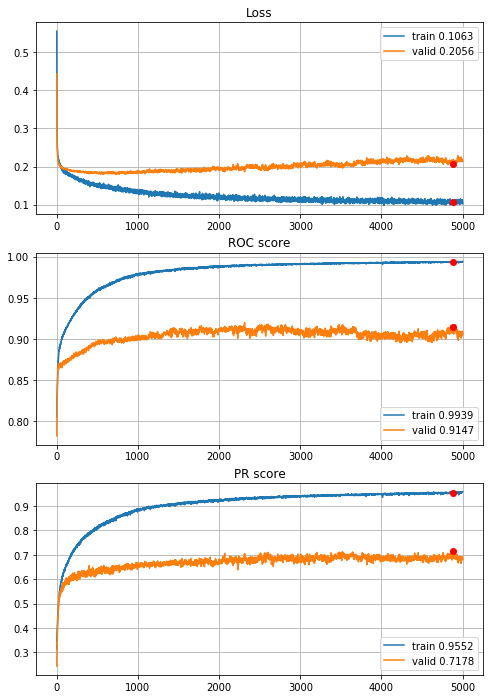


Fold 2------------------------------------------------------------


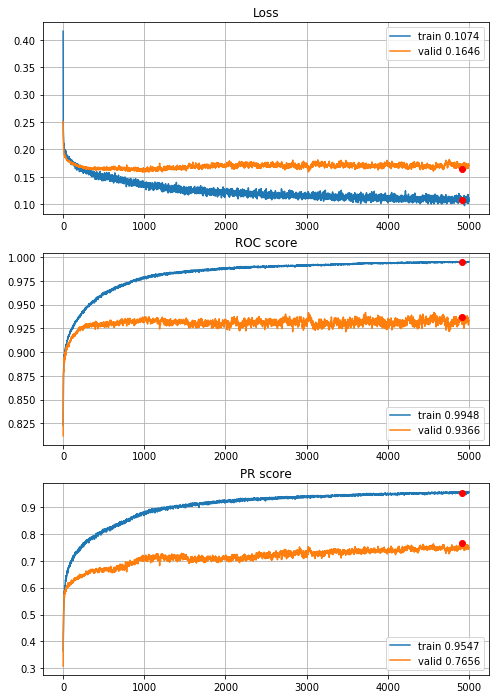


Fold 3------------------------------------------------------------


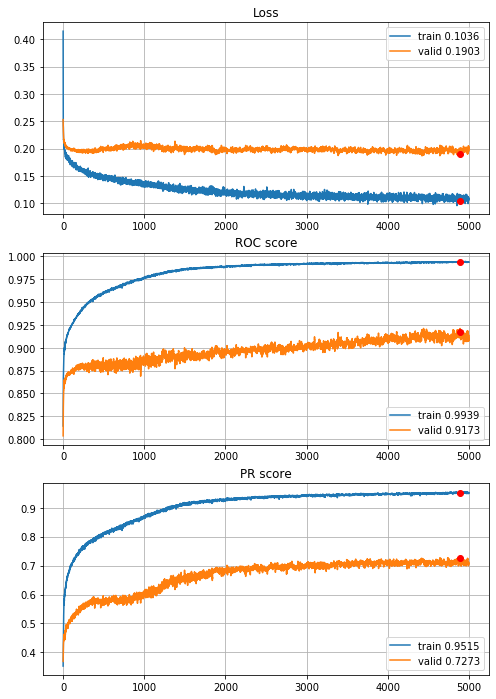


Fold 4------------------------------------------------------------


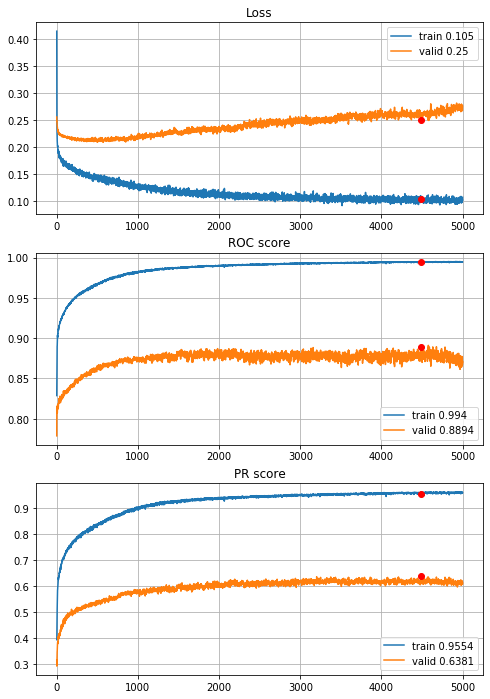


Fold 5------------------------------------------------------------


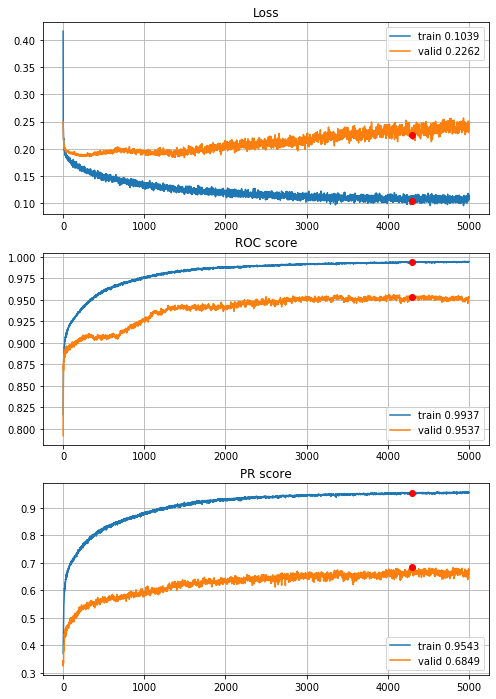


Fold 6------------------------------------------------------------


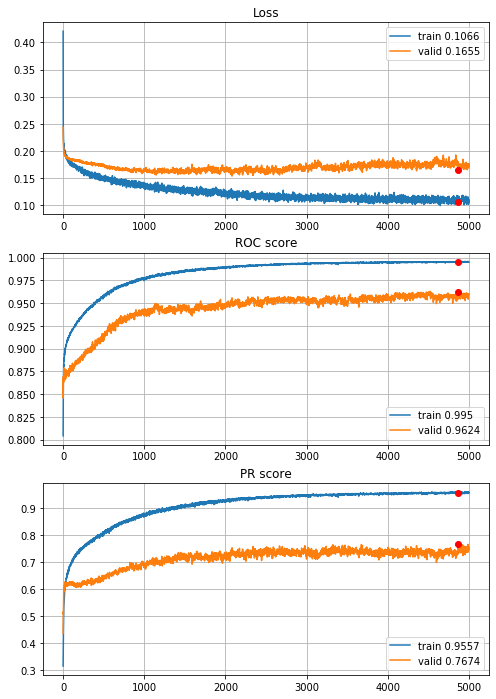

In [36]:
# THE BEST ONE
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=5000,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)],
                                        opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])
    
with open(r"results\5year\MLP_L1_5000ep.p", "wb") as fp:
    pickle.dump(MLPhistories, fp)

Incredible results, much higher metrics, constant overfitting, there are folds with better potential and ones with less, so it is time to stop, model above is considered as the best one.

To sum up, the best Multilayer Percepton specification:
 - 2 layers $l^{[1]},l^{[2]}$,
 - units: $u^{[1]}=60, u^{[2]}=60$,
 - activations: $a^{[1]}:tanh,a^{[2]}:\sigma$,
 - dropout: $d^{[1]}=0.4,d^{[2]}=0.4$,
 - regularization: $L_1^{[1]}=0.00005,L_1^{[2]}=0.00005$,
 - optimizer: Adam with default setings,
 - 4873 epochs (rounded folds median, 4872.5),
 - 394 batch size.
 
 ##### Convolutional Neural Network
 - functions for Monte Carlo Energy objective quasi-minimization (Tadaaki Hosaka 2019):
 
 $$E=\sum_{(i,j)\in \xi}|\phi[R(i),R(j)]|*d(i,j) $$
 where:<br>
 $d(i,j)=(x(i)-x(j))^2+(y(i)-y(j))^2$ - distance measure, <br>
 $i,j$ - pixels indices, <br>
 $x(i), y(i)$ - $xy-$coordinates of pixel $i$, <br>
 $\xi$ - set of all pixels combinations (sample space), <br>
 $R(i)$ - financial ratio for pixel $i$,<br>
 $\phi(\cdot)$ - correlation coefficient, <br>

when randomly swapped ratio for pair of pixels can reduce energy, they're swapped. Simulation ends when there is no reduction after $\alpha N$ steps, where $N$ is number of features.<br>
The idea of image with correlated features close to each other is based on correlation matrix (below) and the fact that pixels are dependent from their neighbours on the real pictures - when we have image of black cat sitting on the white pillow, then: $$P(pixel_{i}=black|pixel_{j}=black) > P(pixel_{i}=black|pixel_{j}=white)$$ where $d(i,j)=\varepsilon$

In [38]:
# raw imputed data
X_train = train_test_imp_sets["train_set_imp"][features]
Y_train = train_test_imp_sets["train_set_imp"][target]

# normalization
sclr=scaler(images=False)
sclr.fit(X=X_train ,q=None, power_transform=False)
X_train_norm=pd.DataFrame(sclr.transform(X=X_train),columns=features)

# normalization with quantile clipping (Q_0.005, Q_0.995)
sclr=scaler(images=False)
sclr.fit(X=X_train, q=0.005, power_transform=False)
X_train_clip_norm=pd.DataFrame(sclr.transform(X=X_train), columns=features)

# normalization with quantile clipping (Q_0.005, Q_0.995) and power transform
sclr=scaler(images=False)
sclr.fit(X=X_train, q=0.005, power_transform=True)
X_train_clip_norm_pt=pd.DataFrame(sclr.transform(X=X_train), columns=features)

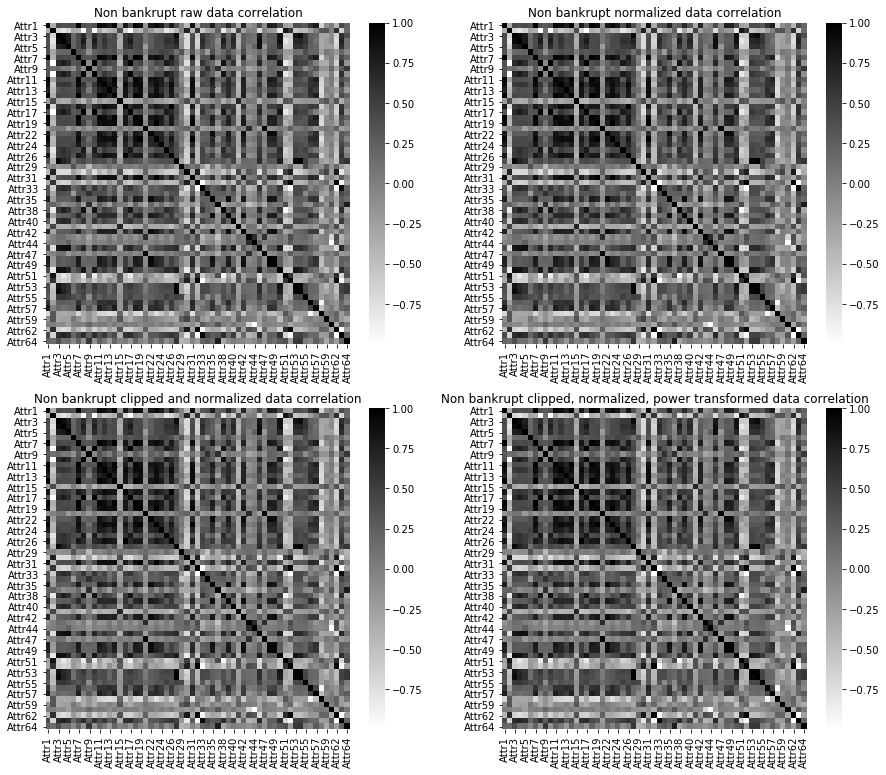

In [39]:
fig,ax=plt.subplots(nrows=2,ncols=2,figsize=(15,13))

sns.heatmap(X_train[Y_train==0].corr(method="spearman"),cmap="binary",annot=False, cbar=True, ax=ax[0,0])
ax[0,0].set_title("Non bankrupt raw data correlation")
sns.heatmap(X_train_norm[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[0,1])
ax[0,1].set_title("Non bankrupt normalized data correlation")
sns.heatmap(X_train_clip_norm[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[1,0])
ax[1,0].set_title("Non bankrupt clipped and normalized data correlation")
sns.heatmap(X_train_clip_norm_pt[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[1,1])
ax[1,1].set_title("Non bankrupt clipped, normalized, power transformed data correlation")

plt.show()

Analytical differences between correlation matrix variants presented above

In [40]:
corrs=[X_train[Y_train==0].corr(method="spearman"),
       X_train_norm[Y_train==0].corr(method="spearman"),
       X_train_clip_norm[Y_train==0].corr(method="spearman"),
       X_train_clip_norm_pt[Y_train==0].corr(method="spearman")]

print(np.sum(np.sum(np.abs(corrs[0]-corrs[1])))/2)
print(np.sum(np.sum(np.abs(corrs[0]-corrs[2])))/2)
print(np.sum(np.sum(np.abs(corrs[0]-corrs[3])))/2)
print(np.sum(np.sum(np.abs(corrs[1]-corrs[2])))/2)
print(np.sum(np.sum(np.abs(corrs[1]-corrs[3])))/2)
print(np.sum(np.sum(np.abs(corrs[2]-corrs[3])))/2)

0.0
0.0
0.0
0.0
0.0
0.0


Correlation matrix is robust to applied transformations.

In [41]:
def distance(x1, x2, y1, y2):
    '''
    function computes distance between two points (Tadaaki Hosaka 2019)
    arguments:
    x1, y2 - xy-coordinates of the first point
    x2, y2 - xy-coordinates of the second point
    
    return distance (scalar)
    '''
    d = (x1-x2)**2+(y1-y2)**2
    return d

def image_energy_v3(image, cor_matrix):
    '''
    function computes Energy for given image (Tadaaki Hosaka 2019).
    
    Energy = sum |c[R(i), R(j)]|d(i,j)
    d(i,j) = (x(i)-x(j))^2+(y(i)-y(j))^2
    where:
    i, j - indices of pixels,
    x(i), x(j) - xy coordinates of pixel,
    R(i) - feature for i,
    c[R(i), R(j)] - correlation coefficient between R(i) and R(j)
    
    arguments:
    image - dictionary (attributes names, xy coordinates) 
    corr_matrix - correlation matrix computed for analyzed data 
    
    return calculated Energy (scalar)
    ----
    188 times faster than first version
    '''
    # absolute value of correlation matrix - could be performed outside for loop
    cor_matrix = abs(cor_matrix)
    # energy inicjation
    E = 0
    # extracting features names
    for feature1 in image.keys():
        for feature2 in image.keys():
            # looking for correlation between features in previously computed (given) correlation matrix
            cor = cor_matrix.loc[feature1, feature2]
            # computing distance 
            d = distance(image[feature1][0], image[feature2][0], image[feature1][1], image[feature2][1])
            # computing energy
            E += cor*d
    
    # because of double counting returned energy is a half of computed
    # note: when feature1 = feature2 <=> distance = 0
    return E/2

def image_dict_to_matrix(image_dict):
    '''
    function converts dictionary to matrix draft of image, arguments:
    image_dict - dictionary to convert, keys: attribute, value: tuple of xy-coordinates,
    
    return matrix image draft 
    '''
    from math import ceil
    shape = ceil(len(image_dict)**(1/2))
    
#     matrix = np.zeros((shape,shape))+128
#     matrix = matrix.astype(object)
    matrix = np.zeros((shape,shape), dtype=object)+128
    for cords in list(image_dict.values()):
        matrix[cords[0], cords[1]] = list(image_dict.keys())[list(image_dict.values()).index(cords)]
    
    return matrix

def map_image(draft, example):
    '''
    function converts draft to image for concrete example, arguments:
    draft - matrix with order of features in image xy-coordinate system, matrix element must match example indices
    example - pandas.Series contains single observation - example indices must match draft values
    
    return numpy.array() - matrix with values for given example with draft order
    '''
    draft_tmp = draft.copy()
    
    for i in range(draft_tmp.shape[0]):
        for j in range(draft_tmp.shape[1]):
            attr = draft_tmp[i,j]
            draft_tmp[i,j] = example[attr] if attr != 128 else 128
    
    #draft_tmp=draft_tmp.astype(np.float)
    draft_tmp=draft_tmp.astype(np.uint8)
    
    return draft_tmp

def image_draft_inicialization(features, random_state):
    '''
    function inicializes draft in dictionary form, keys=feature names, values=position in the image space
    (xy-coordinates in the integers space), arguments:
    
    features - list of the features in dataset for which draft is inicialized,
    random_state - random seed
    
    return draft_dict (python dictionary inicialized draft)
    ----------
    Note: generated draft is for square-shaped image => range(x)=range(y)=ceil(len(features)**(1/2)), but image space
          is created like grid iterating all columns for all rows, thus if len(features) is not a perfect square then
          some potential coordinates are excluded from image space, and as conversion process progress this coordinates
          becomes placeholders, and are not consider while Monte Carlo quasi optimization. When len(features)**(1/2) - its
          ceil = 1 then there is only one placeholder - just right bottom one coordinate, when difference is in range
          [1, range(x)] then the last row of image contains placeholders, if difference is equal to range(x)+1 then 
          placeholders are the last row and new right bottom corner, if difference is in range [range(x)+1, 2*range(x)]
          then two last rows are placeholders etc. It is the best currently found solution for computing non-biased energy
          which is as low as possible.
    '''
    # seeds
    random.seed(random_state)
    np.random.seed(random_state)
    
    from math import ceil
    shape = ceil(len(features)**(1/2))

    # keys
    ks = features.copy()
    # values
    vs = []
    for i in range(shape):
        for j in range(shape):
            vs.append((i,j))
            
    # dictionary
    draft_dict = dict(zip(ks,vs))
    
    return draft_dict

def MC_Energy_optimization(corr_matrix, draft, alpha, n_eval, random_state):
    '''
    function performes Monte Carlo quasi optimization for Energy objective (Tadaaki Hosaka 2019), arguments:
    corr_matrix - correlation matrix (pandas DataFrame),
    draft - initial draft for image to optimize,
    alpha - parameter that impact on simulation duration (3 in Hosakas' article),
    n_eval - number of iteration per which current state is printed,
    random_state - random seed
    
    return ordered draft
    '''
    random.seed(random_state)
    np.random.seed(random_state)
    
    start = time.time()
    initial_energy = image_energy_v3(draft, corr_matrix)
    print("initial image energy:", round(initial_energy, 4))

    energy = initial_energy
    stop_criterion = 0
    i = 0
    while stop_criterion < alpha*len(features):
        draft_tmp = draft.copy()
        # coordinates pair sampling
        xy1, xy2 = random.sample(list(draft_tmp.values()), 2)
        # feature name under coordinates
        ft1 = list(draft_tmp.keys())[list(draft_tmp.values()).index(xy1)]
        ft2 = list(draft_tmp.keys())[list(draft_tmp.values()).index(xy2)]
        # coordinates swap
        draft_tmp[ft1] = xy2
        draft_tmp[ft2] = xy1
        # new energy
        energy_new = image_energy_v3(draft_tmp, corr_matrix)
        # saving changes
        if energy_new < energy:
            energy = energy_new
            draft = draft_tmp.copy()
            stop_criterion = 0
        else:
            stop_criterion += 1
        i += 1
        # evaluation
        if i%n_eval == 0:
            print("iteration: {}\ncurrent energy: {}".format(i, round(energy, 4)))
    
    stop = time.time()
    print("MC simulation time: {}s\nenergy after MC quasi optimization: {}".format(round(stop-start), round(energy, 4)))
    
    return draft

 - CNN definitions

In [42]:
def define_CNN(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid)(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model

def define_CNN_Adam(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid)(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model

 - 6-fold Cross Validation CNN

In [43]:
def CNN_6FoldCrossValidation(datasets, model_definition, features, target, n_epochs, batch_size, alpha, random_state,
                             normalize="power", q=None, drafts=None, instruction=None, info=None):
    '''
    function performes 6 fold Cross Validation for Multilayer Percepton keras model, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    n_epochs - number of epochs for training MLP model,
    batch_size - number of weight matrices updates per loop through entire, current trainin dataset,
    alpha - Monte Carlo duration parameter,
    random_state - random seed,
    info - same arguent as for network_training(),
    *args and **kwargs - arguments for create_MLP() function
    
    returns CNNhistories - list of every CNN model history 
    '''
    # seeds
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]
    
    CVstart=time.time()
    # history of CV
    CNNhistories=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        
        if drafts is None and instruction is None:
            # ----- current fold train and validation sets ------
            X_train = training_sets[fold][features].copy()
            Y_train = training_sets[fold][target].copy()
            X_valid = validation_sets[fold][features].copy()
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- Monte Carlo energy optimization -----
            # correlation matrix for non bankrupt observations
            corr_matrix = X_train[Y_train==0].corr(method="spearman")
            # draft inicialization
            draft = image_draft_inicialization(features, random_state)
            # quasi optimization
            draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=alpha, n_eval=99999,
                                           random_state=random_state)
            # transform draft dictionary to matrix
            draft = image_dict_to_matrix(draft)
            
            # temporary features list
            features_tmp = X_train.columns.tolist()
        
        elif drafts is not None and instruction is None:
            # ----- current fold train and validation sets with feature generation -----
            X_train = training_sets[fold][features].copy()
            Y_train = training_sets[fold][target].copy()
            X_valid = validation_sets[fold][features].copy()
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- loading draft from passed object -----
            draft = drafts[fold]
            
            # temporary features list
            features_tmp = X_train.columns.tolist()    
            
        elif drafts is not None and instruction is not None:
            # ----- current fold train and validation sets with feature generation -----
            X_train = generate_features(data=training_sets[fold][features], instruction=instruction)
            Y_train = training_sets[fold][target].copy()
            X_valid = generate_features(data=validation_sets[fold][features].copy(), instruction=instruction)
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- loading draft from passed object -----
            draft = drafts[fold]
            
            # temporary features list
            features_tmp = X_train.columns.tolist()
            
        else:
            raise "valid options are: drafts=None and instruction=None, drafts!=None and instruction=None, drafts!=None and instruction!=None"
            
        # ----- standarization for CNN (images) -----
        if normalize==True:
            normalizer = scaler(images=True)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features_tmp)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features_tmp)
        elif normalize=="power":
            normalizer = scaler(images=True)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features_tmp)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features_tmp)
        else:
            pass
            
        # ----- vector to image conversion -----
        # training set
        X_train_CNN = np.array([map_image(draft, X_train.iloc[i,:])/255 for i in range(X_train.shape[0])])
        X_train_CNN = X_train_CNN.reshape(X_train_CNN.shape+(1,))
        Y_train_CNN = Y_train.values
        # validation set
        X_valid_CNN = np.array([map_image(draft, X_valid.iloc[i,:])/255 for i in range(X_valid.shape[0])])
        X_valid_CNN = X_valid_CNN.reshape(X_valid_CNN.shape+(1,))
        Y_valid_CNN = Y_valid.values
        
        # ----- CNN training -----
        modelCNN = model_definition(input_shape=X_train_CNN.shape[1:], random_state=random_state)
        modelCNN, historyCNN = network_training(network=modelCNN, X_train=X_train_CNN, Y_train=Y_train_CNN,
                                                X_val=X_valid_CNN, Y_val=Y_valid_CNN, n_epochs=n_epochs,
                                                batch_size=batch_size, random_state=random_state, info=info)
        # ----- MLP history saving -----
        CNNhistories.append(historyCNN.copy())

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    return CNNhistories


----------
Fold: 1
----------
initial image energy: 12619.1266
MC simulation time: 79s
energy after MC quasi optimization: 8581.7805
Train on 4432 samples, validate on 887 samples
Epoch: 1/100,
cumulative time: 1.63s train loss: 0.2811447436776725, validation loss: 0.2625579829280513
Epoch: 2/100,
cumulative time: 2.48s train loss: 0.25631997536612333, validation loss: 0.29383008516358955
Epoch: 3/100,
cumulative time: 3.34s train loss: 0.2646075805736578, validation loss: 0.2508787007786107
Epoch: 4/100,
cumulative time: 4.2s train loss: 0.2460999863040684, validation loss: 0.22776138829539835
Epoch: 5/100,
cumulative time: 5.06s train loss: 0.23379824488736448, validation loss: 0.26004619867852735
Epoch: 6/100,
cumulative time: 5.92s train loss: 0.22914662705028316, validation loss: 0.2985921169483137
Epoch: 7/100,
cumulative time: 6.77s train loss: 0.21859432722606598, validation loss: 0.2050543252584496
Epoch: 8/100,
cumulative time: 7.62s train loss: 0.21620577969840502, validati

Epoch: 76/100,
cumulative time: 65.32s train loss: 0.16445084441359079, validation loss: 0.1769377572006276
Epoch: 77/100,
cumulative time: 66.17s train loss: 0.14972333692431128, validation loss: 0.18439608889609876
Epoch: 78/100,
cumulative time: 67.01s train loss: 0.15690221743059718, validation loss: 0.17689563199592148
Epoch: 79/100,
cumulative time: 67.85s train loss: 0.1497777465240028, validation loss: 0.1847333385112455
Epoch: 80/100,
cumulative time: 68.71s train loss: 0.15163859598244464, validation loss: 0.17872078021255394
Epoch: 81/100,
cumulative time: 69.54s train loss: 0.1538438605353075, validation loss: 0.195289739610243
Epoch: 82/100,
cumulative time: 70.39s train loss: 0.14541085252356767, validation loss: 0.17541865639917745
Epoch: 83/100,
cumulative time: 71.24s train loss: 0.15063516552886164, validation loss: 0.19391095389642468
Epoch: 84/100,
cumulative time: 72.08s train loss: 0.15424626613109765, validation loss: 0.18934584910463723
Epoch: 85/100,
cumulative

Epoch: 49/100,
cumulative time: 43.9s train loss: 0.19084658055475473, validation loss: 0.1922055664635027
Epoch: 50/100,
cumulative time: 44.77s train loss: 0.193267502784998, validation loss: 0.2186191293674499
Epoch: 51/100,
cumulative time: 45.64s train loss: 0.1909659565039759, validation loss: 0.20096713853863477
Epoch: 52/100,
cumulative time: 46.49s train loss: 0.1883627990334688, validation loss: 0.1933977256162594
Epoch: 53/100,
cumulative time: 47.36s train loss: 0.1882814652612601, validation loss: 0.19478702009261797
Epoch: 54/100,
cumulative time: 48.23s train loss: 0.18988883044126878, validation loss: 0.21469828659477472
Epoch: 55/100,
cumulative time: 49.1s train loss: 0.1854029019373311, validation loss: 0.19996710712974208
Epoch: 56/100,
cumulative time: 49.96s train loss: 0.1838573590257215, validation loss: 0.2535797515978539
Epoch: 57/100,
cumulative time: 50.82s train loss: 0.19017490120234795, validation loss: 0.18982674332656882
Epoch: 58/100,
cumulative time: 

Epoch: 22/100,
cumulative time: 19.95s train loss: 0.20915978418037778, validation loss: 0.1995334521927183
Epoch: 23/100,
cumulative time: 20.82s train loss: 0.20074442747159985, validation loss: 0.19819873095969875
Epoch: 24/100,
cumulative time: 21.69s train loss: 0.20468474653573027, validation loss: 0.2059572743758005
Epoch: 25/100,
cumulative time: 22.63s train loss: 0.20538945355543375, validation loss: 0.2087248467505314
Epoch: 26/100,
cumulative time: 23.52s train loss: 0.19528547366442234, validation loss: 0.19898577597256847
Epoch: 27/100,
cumulative time: 24.39s train loss: 0.20169214354928866, validation loss: 0.1980751716566462
Epoch: 28/100,
cumulative time: 25.28s train loss: 0.19607015830273017, validation loss: 0.2760248233090662
Epoch: 29/100,
cumulative time: 26.15s train loss: 0.2061328423488549, validation loss: 0.1954974163210244
Epoch: 30/100,
cumulative time: 27.01s train loss: 0.1915861803345678, validation loss: 0.22836457688483203
Epoch: 31/100,
cumulative t

Epoch: 98/100,
cumulative time: 86.67s train loss: 0.15104485257101727, validation loss: 0.2665925744286788
Epoch: 99/100,
cumulative time: 87.54s train loss: 0.15725122462783264, validation loss: 0.2076318536327549
Epoch: 100/100,
cumulative time: 88.41s train loss: 0.15137357909286173, validation loss: 0.2645157573927349

Early stopping results:
best results in epoch: 68, 
best valid PR: 0.416325675391597, 
valid ROC: 0.841505376344086        
overfitting PR: 0.1395876274684072, 
overfitting ROC: 0.05354940600711344

----------
Fold: 4
----------
initial image energy: 12597.9088
MC simulation time: 63s
energy after MC quasi optimization: 8628.6874
Train on 4433 samples, validate on 886 samples
Epoch: 1/100,
cumulative time: 1.66s train loss: 0.2904731453527265, validation loss: 0.28601627990300715
Epoch: 2/100,
cumulative time: 2.54s train loss: 0.2656827933536731, validation loss: 0.30145525609397456
Epoch: 3/100,
cumulative time: 3.41s train loss: 0.26213195663178285, validation lo

Epoch: 71/100,
cumulative time: 65.54s train loss: 0.17751952370482912, validation loss: 0.22506748516591893
Epoch: 72/100,
cumulative time: 66.47s train loss: 0.18007535436151798, validation loss: 0.22826442448737658
Epoch: 73/100,
cumulative time: 67.4s train loss: 0.1776254792905085, validation loss: 0.21489296806450622
Epoch: 74/100,
cumulative time: 68.35s train loss: 0.1804668781129711, validation loss: 0.21250204795773897
Epoch: 75/100,
cumulative time: 69.25s train loss: 0.17265153311725773, validation loss: 0.21357968056040477
Epoch: 76/100,
cumulative time: 70.16s train loss: 0.17888736097276978, validation loss: 0.22844127967583674
Epoch: 77/100,
cumulative time: 71.07s train loss: 0.17613895953259565, validation loss: 0.21350106768495072
Epoch: 78/100,
cumulative time: 71.96s train loss: 0.1704949225592554, validation loss: 0.21653392773045912
Epoch: 79/100,
cumulative time: 72.88s train loss: 0.17902258013310185, validation loss: 0.21295597046008227
Epoch: 80/100,
cumulati

Epoch: 44/100,
cumulative time: 38.94s train loss: 0.1889392151863909, validation loss: 0.2298425822171885
Epoch: 45/100,
cumulative time: 39.81s train loss: 0.18836774296357728, validation loss: 0.22553006827023983
Epoch: 46/100,
cumulative time: 40.69s train loss: 0.18823863545081, validation loss: 0.2017463564738194
Epoch: 47/100,
cumulative time: 41.55s train loss: 0.18709130144175734, validation loss: 0.20052240873028948
Epoch: 48/100,
cumulative time: 42.42s train loss: 0.18533117133353436, validation loss: 0.20303316511903335
Epoch: 49/100,
cumulative time: 43.27s train loss: 0.18541374245938774, validation loss: 0.20496979338993607
Epoch: 50/100,
cumulative time: 44.15s train loss: 0.18287448686212066, validation loss: 0.19146020253006008
Epoch: 51/100,
cumulative time: 45.02s train loss: 0.18951992684848792, validation loss: 0.19585553208538425
Epoch: 52/100,
cumulative time: 45.89s train loss: 0.18115348079969348, validation loss: 0.19909300673626884
Epoch: 53/100,
cumulative

Epoch: 17/100,
cumulative time: 15.6s train loss: 0.2073111284499832, validation loss: 0.23351867318691572
Epoch: 18/100,
cumulative time: 16.47s train loss: 0.21477110944763952, validation loss: 0.20973501769872066
Epoch: 19/100,
cumulative time: 17.36s train loss: 0.20987633464300362, validation loss: 0.22073172483568
Epoch: 20/100,
cumulative time: 18.23s train loss: 0.21097206299632498, validation loss: 0.20667039793043587
Epoch: 21/100,
cumulative time: 19.09s train loss: 0.20408430882764675, validation loss: 0.2015402510123113
Epoch: 22/100,
cumulative time: 19.96s train loss: 0.2155596900545607, validation loss: 0.22433914583907977
Epoch: 23/100,
cumulative time: 20.82s train loss: 0.20834882928156406, validation loss: 0.21993780492659884
Epoch: 24/100,
cumulative time: 21.7s train loss: 0.21113573169697494, validation loss: 0.20290490376088205
Epoch: 25/100,
cumulative time: 22.58s train loss: 0.20521520331296914, validation loss: 0.1986505186719227
Epoch: 26/100,
cumulative ti

Epoch: 93/100,
cumulative time: 82.28s train loss: 0.1740057510600089, validation loss: 0.20117692326449918
Epoch: 94/100,
cumulative time: 83.15s train loss: 0.18019312500664592, validation loss: 0.19532785737891228
Epoch: 95/100,
cumulative time: 84.02s train loss: 0.17331778449013732, validation loss: 0.19057886632113102
Epoch: 96/100,
cumulative time: 84.89s train loss: 0.17703707068620728, validation loss: 0.1830105916439276
Epoch: 97/100,
cumulative time: 85.76s train loss: 0.17700897652665085, validation loss: 0.19783717326601258
Epoch: 98/100,
cumulative time: 86.63s train loss: 0.17232580993222835, validation loss: 0.18300720679302518
Epoch: 99/100,
cumulative time: 87.49s train loss: 0.17389066649456741, validation loss: 0.19264964332160778
Epoch: 100/100,
cumulative time: 88.35s train loss: 0.17186568468849464, validation loss: 0.22736093092449094

Early stopping results:
best results in epoch: 97, 
best valid PR: 0.4864324051840439, 
valid ROC: 0.8423646299056136        
ov

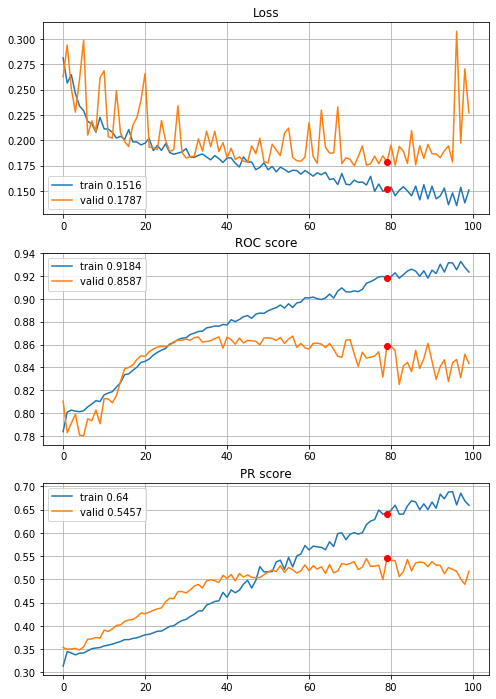


Fold 2------------------------------------------------------------


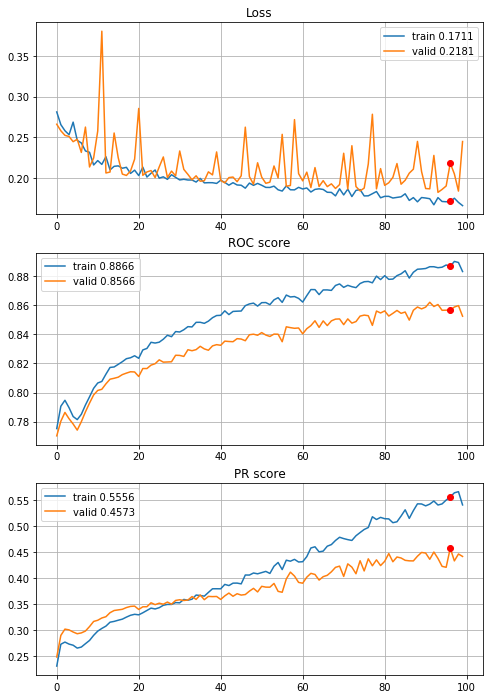


Fold 3------------------------------------------------------------


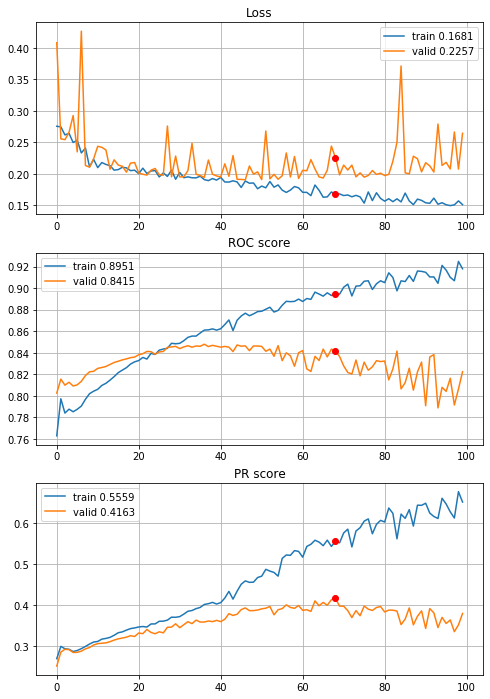


Fold 4------------------------------------------------------------


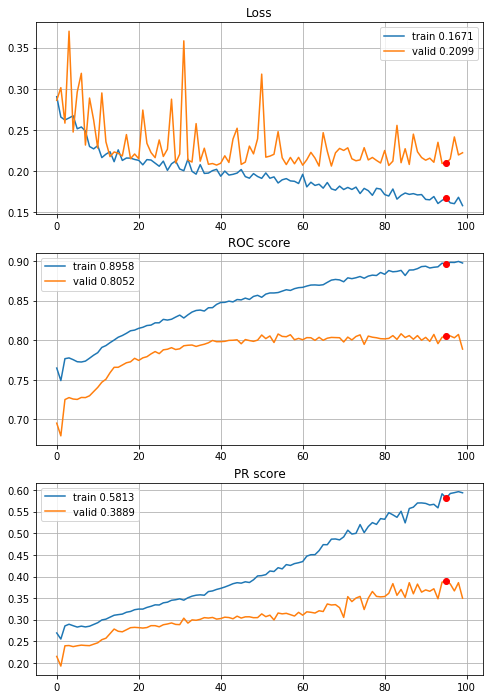


Fold 5------------------------------------------------------------


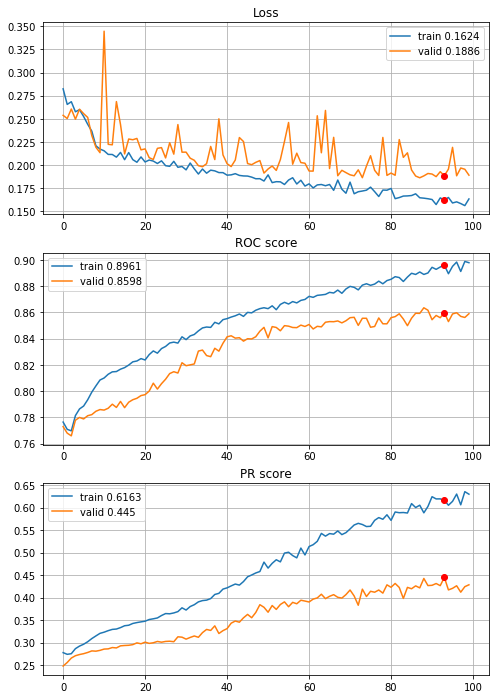


Fold 6------------------------------------------------------------


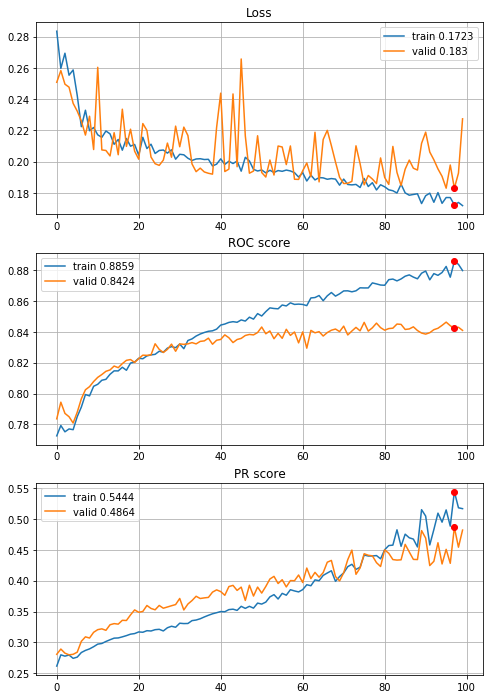

In [181]:
# first CNN only normalization applied
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize=True, q=None, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])


----------
Fold: 1
----------
initial image energy: 12619.1266
MC simulation time: 79s
energy after MC quasi optimization: 8581.7805
Train on 4432 samples, validate on 887 samples
Epoch: 1/100,
cumulative time: 1.72s train loss: 0.28020129028021856, validation loss: 0.260354839895328
Epoch: 2/100,
cumulative time: 2.63s train loss: 0.25036080710805064, validation loss: 0.25796550858383654
Epoch: 3/100,
cumulative time: 3.53s train loss: 0.24455584712756884, validation loss: 0.22288950572153626
Epoch: 4/100,
cumulative time: 4.45s train loss: 0.21219444072499388, validation loss: 0.21870119367403806
Epoch: 5/100,
cumulative time: 5.39s train loss: 0.2136157597162986, validation loss: 0.2532932151869158
Epoch: 6/100,
cumulative time: 6.3s train loss: 0.2150471203419168, validation loss: 0.20996626737824692
Epoch: 7/100,
cumulative time: 7.19s train loss: 0.20916071802458394, validation loss: 0.2144684079601907
Epoch: 8/100,
cumulative time: 8.13s train loss: 0.20933924237474638, validat

Epoch: 76/100,
cumulative time: 69.47s train loss: 0.14141392716566362, validation loss: 0.16663498890910639
Epoch: 77/100,
cumulative time: 70.35s train loss: 0.12082447217851339, validation loss: 0.17777874620616638
Epoch: 78/100,
cumulative time: 71.27s train loss: 0.12813926013421925, validation loss: 0.1695009388340366
Epoch: 79/100,
cumulative time: 72.21s train loss: 0.12092009186408473, validation loss: 0.2515359992978269
Epoch: 80/100,
cumulative time: 73.1s train loss: 0.12950026801709988, validation loss: 0.16525428941244472
Epoch: 81/100,
cumulative time: 74.02s train loss: 0.12379334198263901, validation loss: 0.2191493758152679
Epoch: 82/100,
cumulative time: 74.9s train loss: 0.12109935691828977, validation loss: 0.17079197503668345
Epoch: 83/100,
cumulative time: 75.82s train loss: 0.11605907937962333, validation loss: 0.2030500756007574
Epoch: 84/100,
cumulative time: 76.73s train loss: 0.12766290215324838, validation loss: 0.18284308120793125
Epoch: 85/100,
cumulative

Epoch: 49/100,
cumulative time: 43.21s train loss: 0.1576421950348663, validation loss: 0.16908706213938746
Epoch: 50/100,
cumulative time: 44.08s train loss: 0.15665407601528758, validation loss: 0.1881477428430097
Epoch: 51/100,
cumulative time: 45.05s train loss: 0.14777179404635937, validation loss: 0.18528565823225454
Epoch: 52/100,
cumulative time: 45.97s train loss: 0.14876834615150514, validation loss: 0.16994719754950707
Epoch: 53/100,
cumulative time: 46.89s train loss: 0.14745778620027894, validation loss: 0.17780596560461545
Epoch: 54/100,
cumulative time: 47.81s train loss: 0.14759132536699734, validation loss: 0.21074924775081127
Epoch: 55/100,
cumulative time: 48.66s train loss: 0.14173584569595243, validation loss: 0.1841508638798317
Epoch: 56/100,
cumulative time: 49.54s train loss: 0.1445054280561553, validation loss: 0.1897595778796423
Epoch: 57/100,
cumulative time: 50.42s train loss: 0.14848021864689323, validation loss: 0.16831704451709886
Epoch: 58/100,
cumulativ

Epoch: 22/100,
cumulative time: 20.0s train loss: 0.19058190091153346, validation loss: 0.18449327786449918
Epoch: 23/100,
cumulative time: 20.87s train loss: 0.17858989941231934, validation loss: 0.18071725169929603
Epoch: 24/100,
cumulative time: 21.73s train loss: 0.19166105439960418, validation loss: 0.18456296180926154
Epoch: 25/100,
cumulative time: 22.6s train loss: 0.18537937302397908, validation loss: 0.19235860241373334
Epoch: 26/100,
cumulative time: 23.45s train loss: 0.1765334054572165, validation loss: 0.18016583501889444
Epoch: 27/100,
cumulative time: 24.32s train loss: 0.17929845297245128, validation loss: 0.17999050172367118
Epoch: 28/100,
cumulative time: 25.18s train loss: 0.177141734792276, validation loss: 0.23662793365849985
Epoch: 29/100,
cumulative time: 26.04s train loss: 0.18559348349886465, validation loss: 0.17845232210204998
Epoch: 30/100,
cumulative time: 26.91s train loss: 0.1676340214101201, validation loss: 0.22784770549754818
Epoch: 31/100,
cumulative

Epoch: 98/100,
cumulative time: 85.8s train loss: 0.08716804075091808, validation loss: 0.2191164684067181
Epoch: 99/100,
cumulative time: 86.67s train loss: 0.07868122438553869, validation loss: 0.2117527105258578
Epoch: 100/100,
cumulative time: 87.54s train loss: 0.10603141693721126, validation loss: 0.36995724881783953

Early stopping results:
best results in epoch: 77, 
best valid PR: 0.491342925463022, 
valid ROC: 0.8834604105571848        
overfitting PR: 0.2718573372614907, 
overfitting ROC: 0.07838659368721357

----------
Fold: 4
----------
initial image energy: 12597.9088
MC simulation time: 62s
energy after MC quasi optimization: 8628.6874
Train on 4433 samples, validate on 886 samples
Epoch: 1/100,
cumulative time: 1.67s train loss: 0.2900323386846319, validation loss: 0.2819444329286537
Epoch: 2/100,
cumulative time: 2.53s train loss: 0.2623020266719497, validation loss: 0.3145752731483623
Epoch: 3/100,
cumulative time: 3.39s train loss: 0.23232230850315352, validation los

Epoch: 71/100,
cumulative time: 62.52s train loss: 0.13715827252279683, validation loss: 0.22973862340837783
Epoch: 72/100,
cumulative time: 63.38s train loss: 0.13368264768426424, validation loss: 0.2315353476705185
Epoch: 73/100,
cumulative time: 64.25s train loss: 0.13138267138043028, validation loss: 0.21334957410465782
Epoch: 74/100,
cumulative time: 65.12s train loss: 0.13734916132720792, validation loss: 0.21468654759312322
Epoch: 75/100,
cumulative time: 65.99s train loss: 0.12654850838007142, validation loss: 0.21262501654452717
Epoch: 76/100,
cumulative time: 66.86s train loss: 0.13460789767770232, validation loss: 0.21838215064114427
Epoch: 77/100,
cumulative time: 67.72s train loss: 0.1283530700046753, validation loss: 0.2099922427205415
Epoch: 78/100,
cumulative time: 68.61s train loss: 0.11933152281384879, validation loss: 0.21770525378917194
Epoch: 79/100,
cumulative time: 69.49s train loss: 0.13158666410397493, validation loss: 0.24468391656068325
Epoch: 80/100,
cumulat

Epoch: 44/100,
cumulative time: 40.02s train loss: 0.14986201111851657, validation loss: 0.22506778662010993
Epoch: 45/100,
cumulative time: 40.9s train loss: 0.15358081547732066, validation loss: 0.2571613495963422
Epoch: 46/100,
cumulative time: 41.77s train loss: 0.15760735658680428, validation loss: 0.18905089765316208
Epoch: 47/100,
cumulative time: 42.65s train loss: 0.15040737884982616, validation loss: 0.18966307085739031
Epoch: 48/100,
cumulative time: 43.52s train loss: 0.14908198137302686, validation loss: 0.23035384223504207
Epoch: 49/100,
cumulative time: 44.38s train loss: 0.14720661849449054, validation loss: 0.18823861651980311
Epoch: 50/100,
cumulative time: 45.26s train loss: 0.14140308976926358, validation loss: 0.19147484256774525
Epoch: 51/100,
cumulative time: 46.13s train loss: 0.14607563466102577, validation loss: 0.19156791394235856
Epoch: 52/100,
cumulative time: 47.01s train loss: 0.1476295438246159, validation loss: 0.1898656844352761
Epoch: 53/100,
cumulati

Epoch: 17/100,
cumulative time: 15.67s train loss: 0.18626012588068994, validation loss: 0.21241092839978348
Epoch: 18/100,
cumulative time: 16.54s train loss: 0.19713766811705055, validation loss: 0.17880961473854617
Epoch: 19/100,
cumulative time: 17.41s train loss: 0.1858936225688272, validation loss: 0.20498322377624684
Epoch: 20/100,
cumulative time: 18.27s train loss: 0.18979686253930816, validation loss: 0.19075491748598844
Epoch: 21/100,
cumulative time: 19.15s train loss: 0.18042731623589897, validation loss: 0.20155997066411693
Epoch: 22/100,
cumulative time: 20.03s train loss: 0.19203581656111893, validation loss: 0.18093978823845866
Epoch: 23/100,
cumulative time: 20.91s train loss: 0.17899410902257162, validation loss: 0.21698352660874481
Epoch: 24/100,
cumulative time: 21.78s train loss: 0.1886332522436536, validation loss: 0.17488898770803793
Epoch: 25/100,
cumulative time: 22.65s train loss: 0.1782082227324891, validation loss: 0.17873510466068646
Epoch: 26/100,
cumulat

Epoch: 93/100,
cumulative time: 81.97s train loss: 0.10551497113306689, validation loss: 0.19054329597115785
Epoch: 94/100,
cumulative time: 82.84s train loss: 0.10797231365226338, validation loss: 0.19295174186170505
Epoch: 95/100,
cumulative time: 83.71s train loss: 0.09378469817066419, validation loss: 0.2048025585660547
Epoch: 96/100,
cumulative time: 84.63s train loss: 0.09859629037913743, validation loss: 0.1953288701869564
Epoch: 97/100,
cumulative time: 85.57s train loss: 0.10454870622454662, validation loss: 0.22007405915997635
Epoch: 98/100,
cumulative time: 86.47s train loss: 0.09751368069820847, validation loss: 0.18925983672351923
Epoch: 99/100,
cumulative time: 87.4s train loss: 0.09561598565897526, validation loss: 0.19521296330418597
Epoch: 100/100,
cumulative time: 88.28s train loss: 0.09532813339023781, validation loss: 0.25067130555283135

Early stopping results:
best results in epoch: 96, 
best valid PR: 0.5695251666279474, 
valid ROC: 0.8890611028315947        
ove

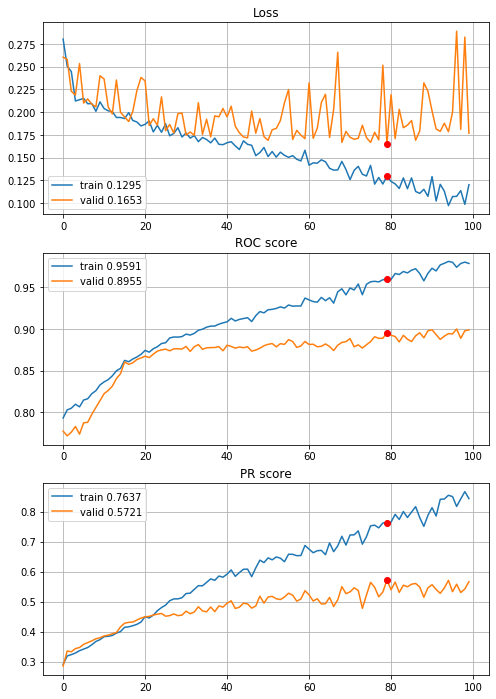


Fold 2------------------------------------------------------------


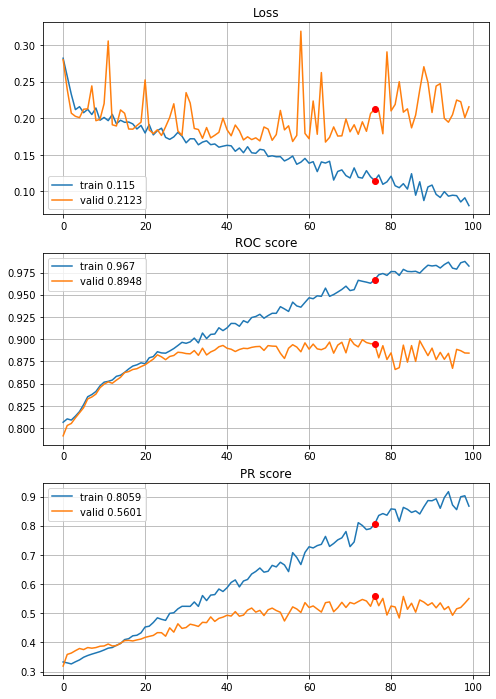


Fold 3------------------------------------------------------------


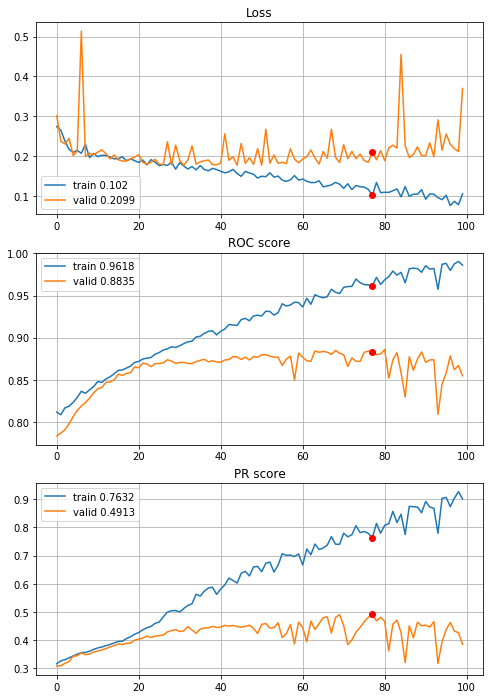


Fold 4------------------------------------------------------------


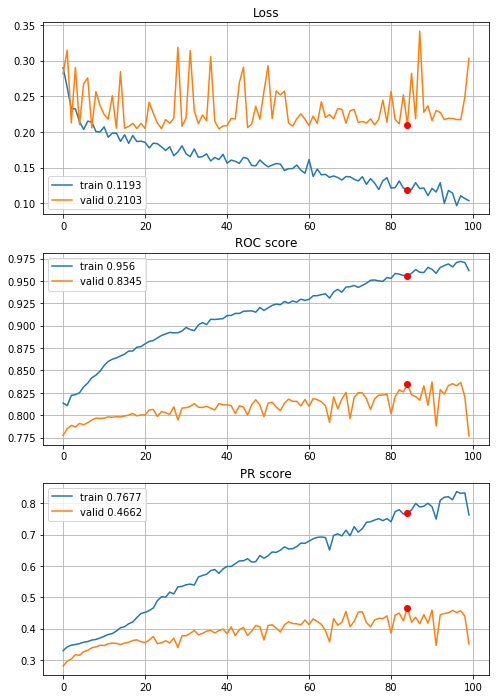


Fold 5------------------------------------------------------------


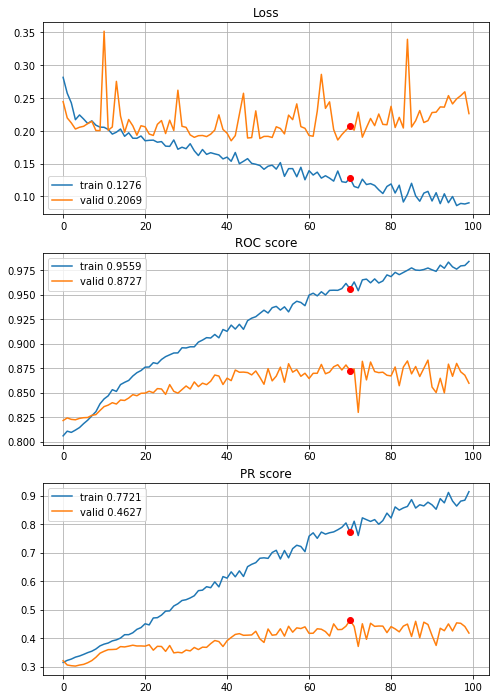


Fold 6------------------------------------------------------------


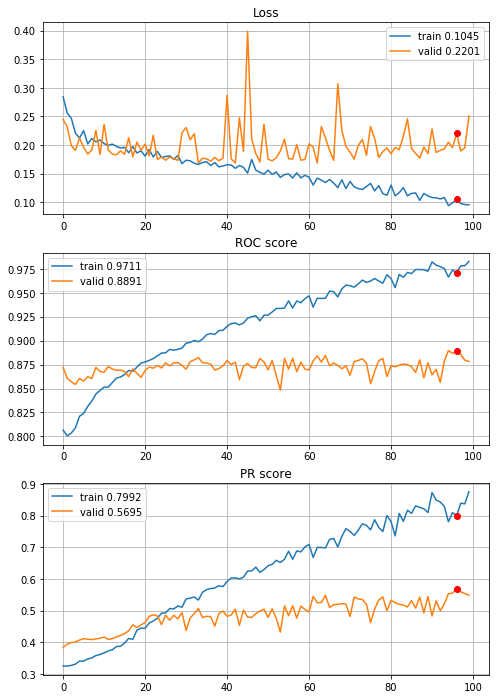

In [182]:
# first CNN with quantile clipping (Q_0.005, Q_0.995) and normalization
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize=True, q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Huge improvement, +0.06 on PR, much bigger overfitting, but seems like architecture is not appropriate. Lets try with power transform added.


----------
Fold: 1
----------
initial image energy: 12619.1266
MC simulation time: 78s
energy after MC quasi optimization: 8581.7805
Train on 4432 samples, validate on 887 samples
Epoch: 1/100,
cumulative time: 1.64s train loss: 0.2803659623939315, validation loss: 0.2597762209519727
Epoch: 2/100,
cumulative time: 2.51s train loss: 0.2481500148329386, validation loss: 0.25144724633540483
Epoch: 3/100,
cumulative time: 3.38s train loss: 0.24008522668873575, validation loss: 0.213309001257347
Epoch: 4/100,
cumulative time: 4.24s train loss: 0.21167056453464694, validation loss: 0.21136286016448644
Epoch: 5/100,
cumulative time: 5.13s train loss: 0.21182604195946822, validation loss: 0.270866258302966
Epoch: 6/100,
cumulative time: 6.0s train loss: 0.21256587277116112, validation loss: 0.20826318251911924
Epoch: 7/100,
cumulative time: 6.86s train loss: 0.20899319580826733, validation loss: 0.21294147365861976
Epoch: 8/100,
cumulative time: 7.73s train loss: 0.2070642496166677, validatio

Epoch: 76/100,
cumulative time: 66.8s train loss: 0.12261037280722538, validation loss: 0.16860749096249514
Epoch: 77/100,
cumulative time: 67.65s train loss: 0.11017863489418468, validation loss: 0.17496870646280527
Epoch: 78/100,
cumulative time: 68.5s train loss: 0.10698466356305762, validation loss: 0.1784624365298025
Epoch: 79/100,
cumulative time: 69.37s train loss: 0.10231690738511537, validation loss: 0.19055793702333595
Epoch: 80/100,
cumulative time: 70.24s train loss: 0.11201635236761093, validation loss: 0.17331221015974796
Epoch: 81/100,
cumulative time: 71.09s train loss: 0.10304269931928023, validation loss: 0.23648700833723807
Epoch: 82/100,
cumulative time: 71.94s train loss: 0.1111049156279609, validation loss: 0.19402993753502037
Epoch: 83/100,
cumulative time: 72.8s train loss: 0.09524933776619847, validation loss: 0.20369249652848573
Epoch: 84/100,
cumulative time: 73.65s train loss: 0.10772387191169099, validation loss: 0.19126012655901128
Epoch: 85/100,
cumulativ

Epoch: 49/100,
cumulative time: 43.1s train loss: 0.15085731309566258, validation loss: 0.16584298422868787
Epoch: 50/100,
cumulative time: 43.97s train loss: 0.1535505488756977, validation loss: 0.2035662051386871
Epoch: 51/100,
cumulative time: 44.84s train loss: 0.14478345270460263, validation loss: 0.18176607426419736
Epoch: 52/100,
cumulative time: 45.72s train loss: 0.14165687835052448, validation loss: 0.16818475089925253
Epoch: 53/100,
cumulative time: 46.58s train loss: 0.14083130983467673, validation loss: 0.18954703277302434
Epoch: 54/100,
cumulative time: 47.46s train loss: 0.13734765985933559, validation loss: 0.20157957666689003
Epoch: 55/100,
cumulative time: 48.33s train loss: 0.13959778119080332, validation loss: 0.18319369716466885
Epoch: 56/100,
cumulative time: 49.19s train loss: 0.12896301691497705, validation loss: 0.18199291450665528
Epoch: 57/100,
cumulative time: 50.04s train loss: 0.14491118763032157, validation loss: 0.1644002263683074
Epoch: 58/100,
cumulati

Epoch: 22/100,
cumulative time: 20.59s train loss: 0.18783038882841271, validation loss: 0.1827618832686305
Epoch: 23/100,
cumulative time: 21.47s train loss: 0.17707561497788352, validation loss: 0.17826108261522877
Epoch: 24/100,
cumulative time: 22.34s train loss: 0.18819169900531374, validation loss: 0.18452880046883727
Epoch: 25/100,
cumulative time: 23.23s train loss: 0.1831741975620389, validation loss: 0.19036217626885604
Epoch: 26/100,
cumulative time: 24.11s train loss: 0.17396788381793224, validation loss: 0.17840161645761876
Epoch: 27/100,
cumulative time: 24.98s train loss: 0.17657507380423562, validation loss: 0.1786769323613759
Epoch: 28/100,
cumulative time: 25.87s train loss: 0.17290414721177158, validation loss: 0.22155293425820188
Epoch: 29/100,
cumulative time: 26.75s train loss: 0.18293464534146045, validation loss: 0.17719988299800418
Epoch: 30/100,
cumulative time: 27.63s train loss: 0.16280532522053065, validation loss: 0.2348808118361631
Epoch: 31/100,
cumulati

Epoch: 98/100,
cumulative time: 87.68s train loss: 0.05836077524762641, validation loss: 0.25925848262621826
Epoch: 99/100,
cumulative time: 88.57s train loss: 0.08755374757492317, validation loss: 0.23252154890082466
Epoch: 100/100,
cumulative time: 89.45s train loss: 0.0693629476635142, validation loss: 0.3584286608515893

Early stopping results:
best results in epoch: 68, 
best valid PR: 0.5180314480179947, 
valid ROC: 0.8796871945259042        
overfitting PR: 0.28238829266018795, 
overfitting ROC: 0.08601569758741134

----------
Fold: 4
----------
initial image energy: 12597.9088
MC simulation time: 62s
energy after MC quasi optimization: 8628.6874
Train on 4433 samples, validate on 886 samples
Epoch: 1/100,
cumulative time: 1.68s train loss: 0.2895100776105279, validation loss: 0.2829276712161424
Epoch: 2/100,
cumulative time: 2.56s train loss: 0.26134502391580694, validation loss: 0.32172263112617133
Epoch: 3/100,
cumulative time: 3.44s train loss: 0.2283760592519578, validation

Epoch: 71/100,
cumulative time: 63.54s train loss: 0.11591009614485369, validation loss: 0.27571301723979663
Epoch: 72/100,
cumulative time: 64.41s train loss: 0.12204312998192213, validation loss: 0.2208512097798944
Epoch: 73/100,
cumulative time: 65.3s train loss: 0.11355088923791179, validation loss: 0.22087240716942816
Epoch: 74/100,
cumulative time: 66.18s train loss: 0.10773599703606918, validation loss: 0.26054696715174086
Epoch: 75/100,
cumulative time: 67.05s train loss: 0.1161734603888263, validation loss: 0.2107866939249749
Epoch: 76/100,
cumulative time: 67.91s train loss: 0.12068687109102279, validation loss: 0.20805270256764732
Epoch: 77/100,
cumulative time: 68.79s train loss: 0.10641545836641265, validation loss: 0.21020364408164746
Epoch: 78/100,
cumulative time: 69.66s train loss: 0.1071092735504542, validation loss: 0.21774294979147124
Epoch: 79/100,
cumulative time: 70.55s train loss: 0.10703307331556287, validation loss: 0.26535407435275093
Epoch: 80/100,
cumulativ

Epoch: 44/100,
cumulative time: 39.31s train loss: 0.15344646349028274, validation loss: 0.2235057622396112
Epoch: 45/100,
cumulative time: 40.19s train loss: 0.14942480800532607, validation loss: 0.26142598745785234
Epoch: 46/100,
cumulative time: 41.06s train loss: 0.1535753587463788, validation loss: 0.18156769538706097
Epoch: 47/100,
cumulative time: 41.94s train loss: 0.14562877874839072, validation loss: 0.2043211009378627
Epoch: 48/100,
cumulative time: 42.83s train loss: 0.14830070822765454, validation loss: 0.18410705292332522
Epoch: 49/100,
cumulative time: 43.71s train loss: 0.14939454104772357, validation loss: 0.1777974962851802
Epoch: 50/100,
cumulative time: 44.58s train loss: 0.14098965825532753, validation loss: 0.19584086782910753
Epoch: 51/100,
cumulative time: 45.45s train loss: 0.144474012745696, validation loss: 0.18550934580325004
Epoch: 52/100,
cumulative time: 46.32s train loss: 0.14072378643299102, validation loss: 0.18046466844749234
Epoch: 53/100,
cumulative

Epoch: 17/100,
cumulative time: 16.23s train loss: 0.1813312764129331, validation loss: 0.22408589690452774
Epoch: 18/100,
cumulative time: 17.14s train loss: 0.19290470084675057, validation loss: 0.1801687005074783
Epoch: 19/100,
cumulative time: 18.08s train loss: 0.18094606480916037, validation loss: 0.20117252069456046
Epoch: 20/100,
cumulative time: 19.05s train loss: 0.18419573053855431, validation loss: 0.18895731116256112
Epoch: 21/100,
cumulative time: 19.96s train loss: 0.1784156338741783, validation loss: 0.18612217509585094
Epoch: 22/100,
cumulative time: 20.92s train loss: 0.1829306623372595, validation loss: 0.18376019442323638
Epoch: 23/100,
cumulative time: 21.84s train loss: 0.17449558403417753, validation loss: 0.2138548842873046
Epoch: 24/100,
cumulative time: 22.8s train loss: 0.18260624554002364, validation loss: 0.1724913715307115
Epoch: 25/100,
cumulative time: 23.78s train loss: 0.17210714535158697, validation loss: 0.17613102340940429
Epoch: 26/100,
cumulative 

Epoch: 93/100,
cumulative time: 88.9s train loss: 0.09728357256863904, validation loss: 0.18809045094399635
Epoch: 94/100,
cumulative time: 89.85s train loss: 0.10172025040682836, validation loss: 0.18108736335154849
Epoch: 95/100,
cumulative time: 90.81s train loss: 0.09049042122858307, validation loss: 0.19069896295296687
Epoch: 96/100,
cumulative time: 91.76s train loss: 0.0948753605838113, validation loss: 0.17539185860759787
Epoch: 97/100,
cumulative time: 92.7s train loss: 0.08771735526572601, validation loss: 0.222670604157394
Epoch: 98/100,
cumulative time: 93.6s train loss: 0.08676210670785954, validation loss: 0.1889798574267338
Epoch: 99/100,
cumulative time: 94.57s train loss: 0.09487252189495643, validation loss: 0.1878867543914248
Epoch: 100/100,
cumulative time: 95.51s train loss: 0.0885182762627351, validation loss: 0.20482461023276868

Early stopping results:
best results in epoch: 95, 
best valid PR: 0.6030963429934727, 
valid ROC: 0.8730650769995032        
overfitti

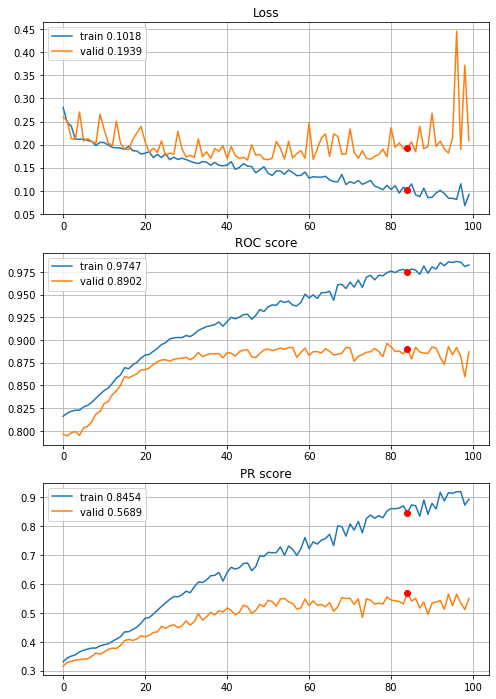


Fold 2------------------------------------------------------------


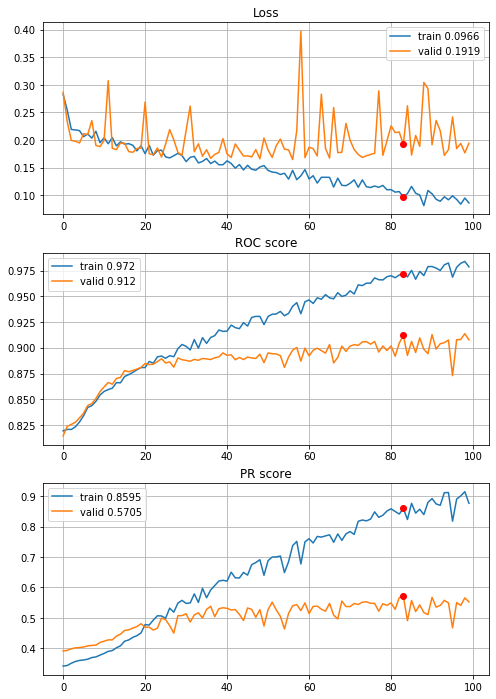


Fold 3------------------------------------------------------------


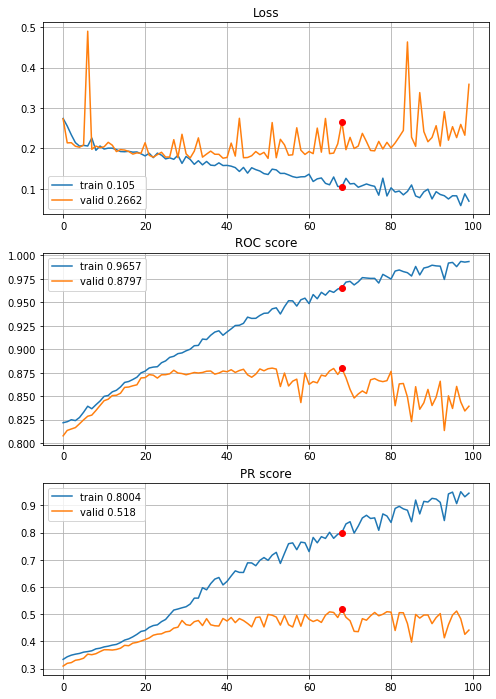


Fold 4------------------------------------------------------------


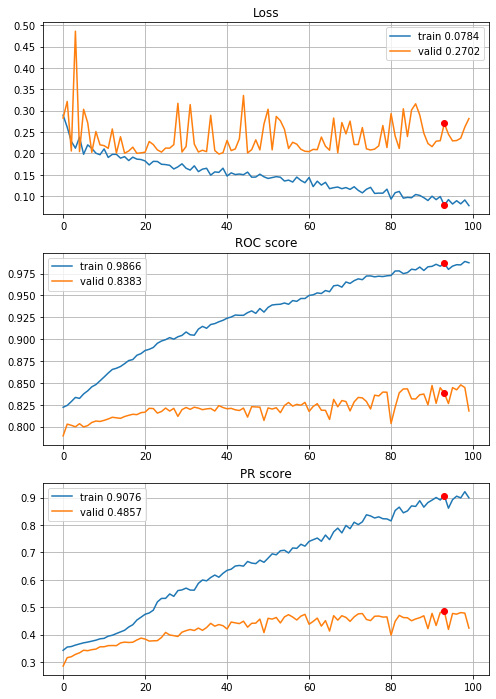


Fold 5------------------------------------------------------------


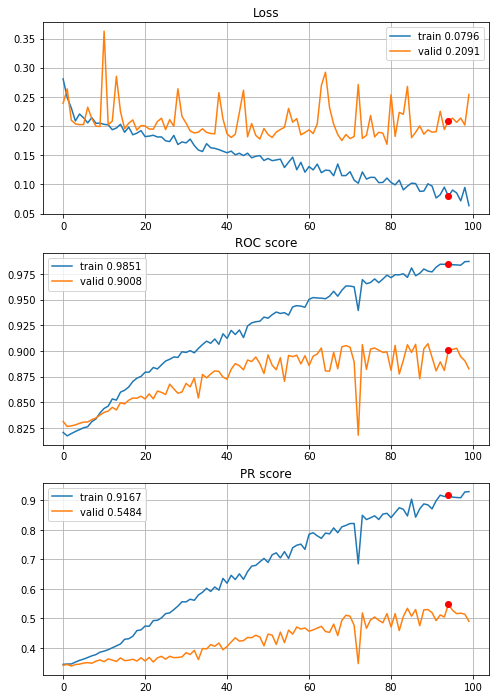


Fold 6------------------------------------------------------------


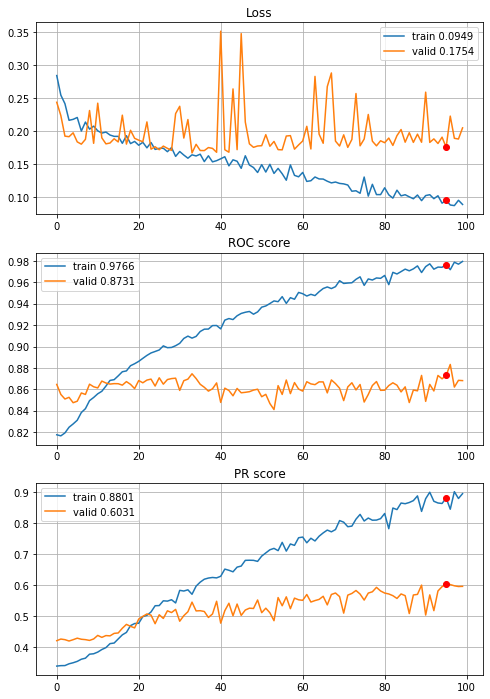

In [183]:
# first CNN with quantile clipping (Q_0.005, Q_0.995), power transform and normalization
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Another improvement PR +0.03 and bigger overfitting, learning curves are very ugly. The most complex preprocessing pipeline tends to be the best one. Lets find the best architecture :)

But first, lets create and save images drafts for folds and see some results.

In [45]:
# drafts computation

# CV sets
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
# drafts lists initialization
drafts_ini=[]
drafts_opti=[]

# CV loop
for fold in range(len(train_folds)):
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    # ----- Monte Carlo energy optimization -----
    # correlation matrix for non bankrupt observations
    corr_matrix_fold=X_train_fold[Y_train_fold==0].corr(method="spearman")
    # draft inicialization
    draft_fold_ini=image_draft_inicialization(features, random_state)
    # quasi optimization
    draft_fold_opti=MC_Energy_optimization(corr_matrix=corr_matrix_fold, draft=draft_fold_ini, alpha=3, n_eval=100,
                                           random_state=random_state)
    # transform draft dictionary to matrix
    draft_fold_ini=image_dict_to_matrix(draft_fold_ini)
    draft_fold_opti=image_dict_to_matrix(draft_fold_opti)
    
    drafts_ini.append(draft_fold_ini)
    drafts_opti.append(draft_fold_opti)
    
drafts=dict(zip(["initial_drafts", "optimized_drafts"], [drafts_ini, drafts_opti]))

# saving drafts
with open(r"data\5year_data\drafts_8x8.p", "wb") as fp:
    pickle.dump(drafts, fp)

initial image energy: 12619.1266
iteration: 100
current energy: 11350.2834
iteration: 200
current energy: 10180.917
iteration: 300
current energy: 9796.3327
iteration: 400
current energy: 9569.5541
iteration: 500
current energy: 9339.6135
iteration: 600
current energy: 9305.3557
iteration: 700
current energy: 9191.6272
iteration: 800
current energy: 9095.0385
iteration: 900
current energy: 9039.5115
iteration: 1000
current energy: 8973.58
iteration: 1100
current energy: 8911.8662
iteration: 1200
current energy: 8856.8039
iteration: 1300
current energy: 8834.0387
iteration: 1400
current energy: 8780.7984
iteration: 1500
current energy: 8746.0496
iteration: 1600
current energy: 8711.686
iteration: 1700
current energy: 8710.4458
iteration: 1800
current energy: 8694.1713
iteration: 1900
current energy: 8663.9926
iteration: 2000
current energy: 8639.5584
iteration: 2100
current energy: 8591.7181
iteration: 2200
current energy: 8591.412
iteration: 2300
current energy: 8587.5688
iteration: 24

In [44]:
# loading 8x8 drafts
with open(r"data\5year_data\drafts_8x8.p", "rb") as fp:
    drafts_8x8 = pickle.load(fp)

			 Normalization only

			----- FOLD 1 -----


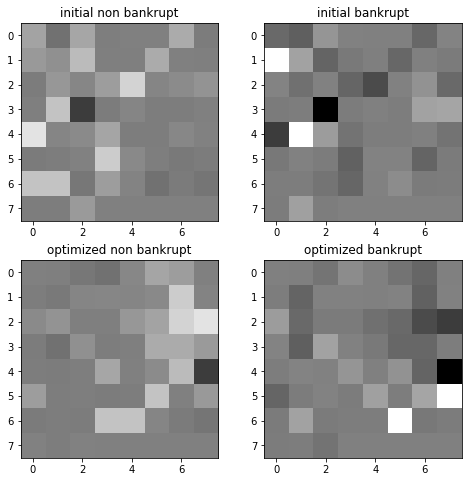


			----- FOLD 2 -----


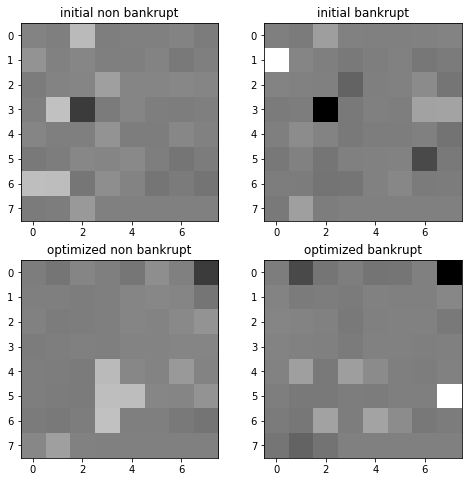


			----- FOLD 3 -----


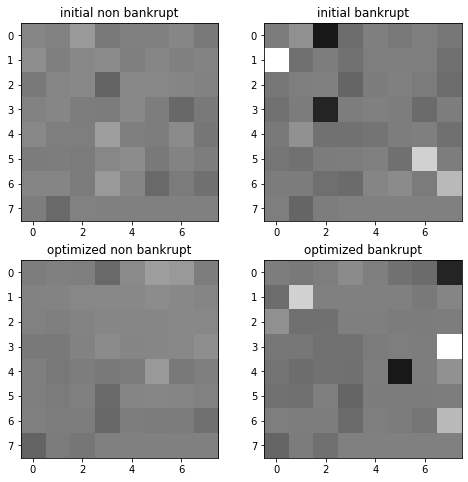


			----- FOLD 4 -----


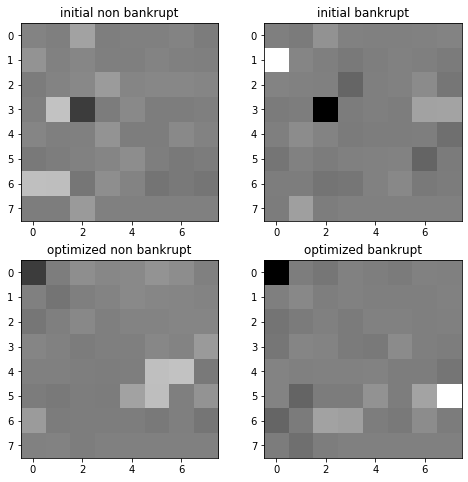


			----- FOLD 5 -----


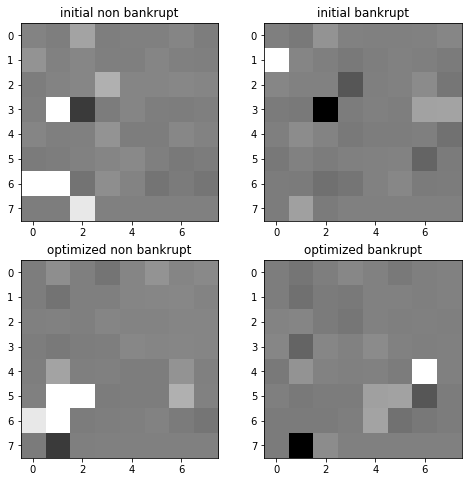


			----- FOLD 6 -----


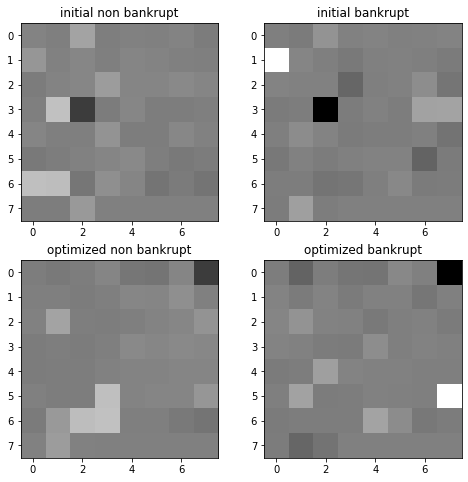

In [45]:
# printing images with normalization only
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t\t Normalization only")
for fold in range(len(train_folds)):
    print("\n\t\t\t----- FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=None, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

		 Normalization and quantile clipping

			-----FOLD 1 -----


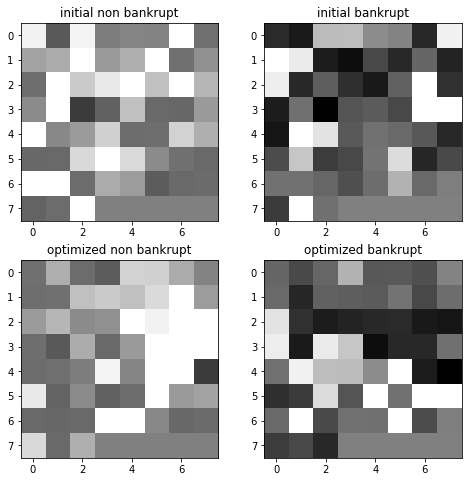


			-----FOLD 2 -----


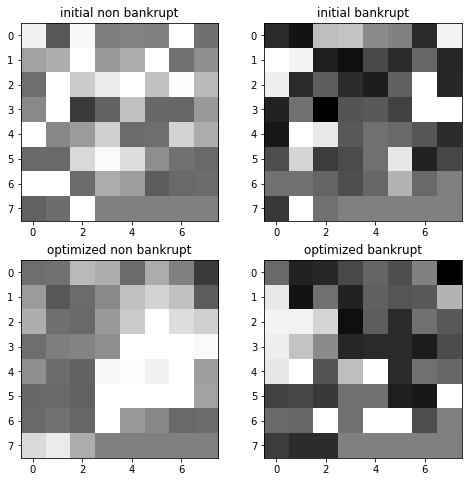


			-----FOLD 3 -----


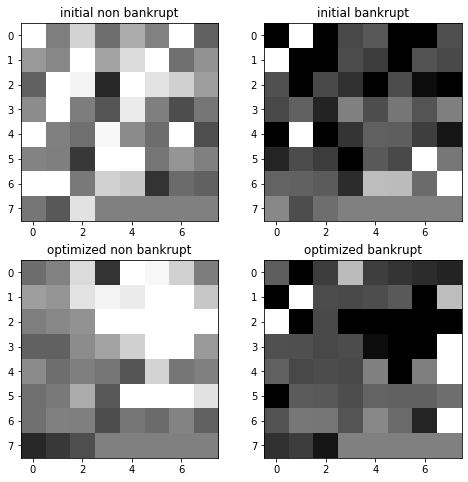


			-----FOLD 4 -----


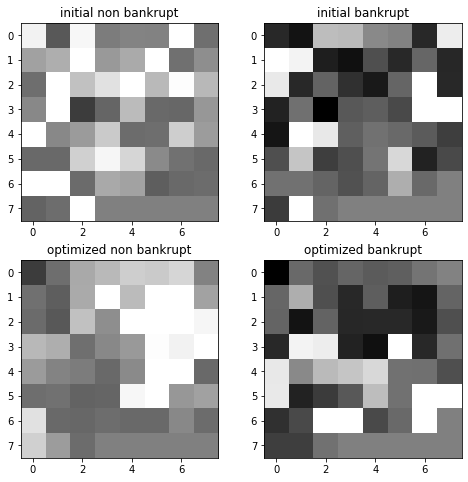


			-----FOLD 5 -----


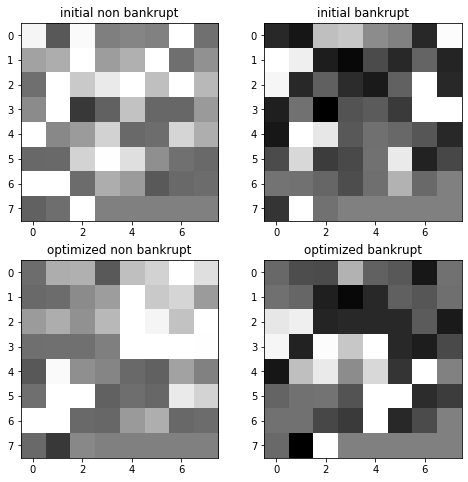


			-----FOLD 6 -----


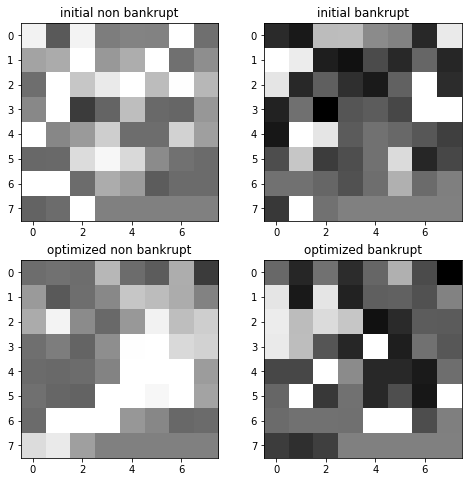

In [46]:
# printing images for normalization with quantile clipping
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
print("\t\t Normalization and quantile clipping")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

	 Normalization, quantile clipping and power transform

			-----FOLD 1 -----


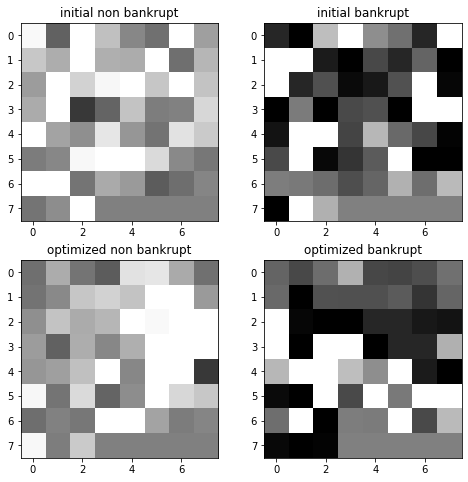


			-----FOLD 2 -----


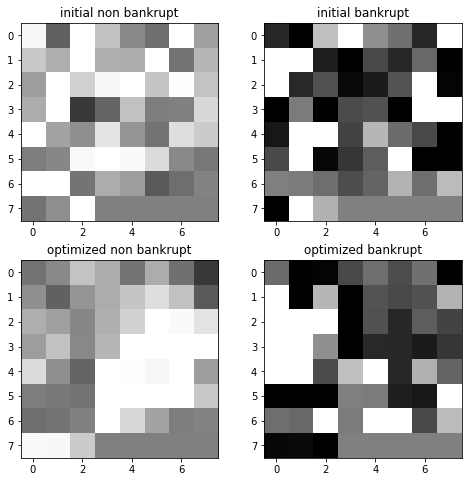


			-----FOLD 3 -----


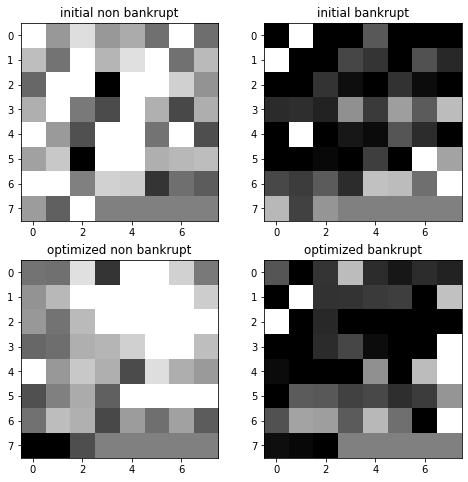


			-----FOLD 4 -----


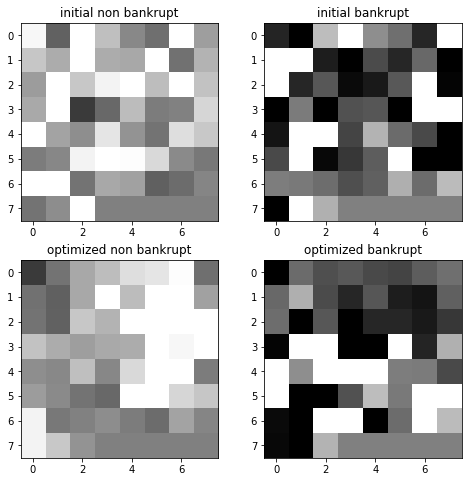


			-----FOLD 5 -----


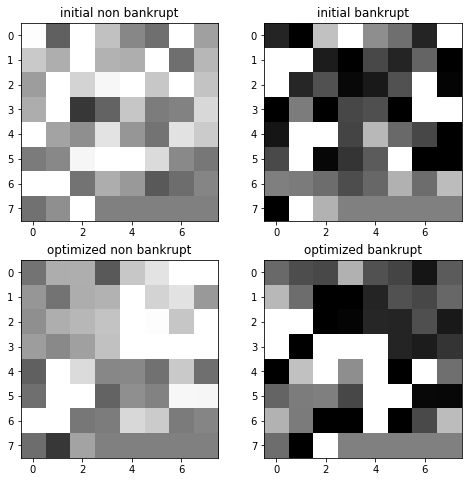


			-----FOLD 6 -----


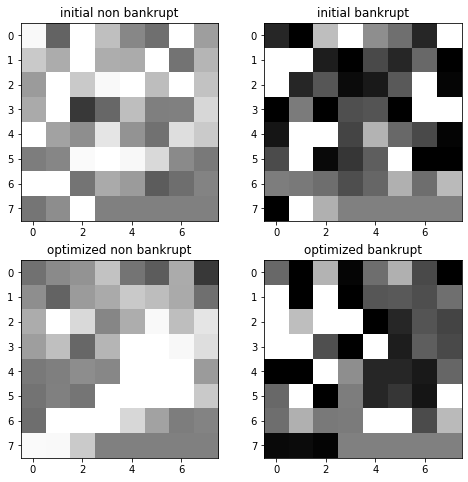

In [47]:
# printing images for normalization with quantile clipping and power transform
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
print("\t Normalization, quantile clipping and power transform")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=True)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

Differences between normalization only and the others is very easy to spot. Skewed data with outliers produces poor quality images in discriminant sense. When outliers are reduced difference between initial, optimized draft and bankrupt non bankrupt label is visible. When skewness is reduced images becomes more sharp, there is more black and white pixels. The quality of images can be observed in the very first CNNs. When outliers and skewness are present in data model performance is the worst. When outliers are reduced model gets better, and model without outliers and skewness in data obtained the best results. 

Lets start experiments with model architecture, first define inception module.

In [48]:
def inception_module(prev_layer, f1, f2_in, f2_out, f3_in, f3_out, f4_out, random_state=random_state):
    
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    
    conv1x1 = layers.Conv2D(filters=f1, kernel_size=(1,1), strides=(1,1), padding="same",
                             activation=activations.relu, use_bias=True)(prev_layer)
    conv3x3 = layers.Conv2D(filters=f2_in, kernel_size=(1,1), strides=(1,1), padding="valid",
                            activation=activations.relu, use_bias=True)(prev_layer)
    conv3x3 = layers.Conv2D(filters=f2_out, kernel_size=(3,3), strides=(1,1), padding="same",
                            activation=activations.relu, use_bias=True)(conv3x3)
    conv5x5 = layers.Conv2D(filters=f3_in, kernel_size=(1,1), strides=(1,1), padding="valid",
                            activation=activations.relu, use_bias=True)(prev_layer)
    conv5x5 = layers.Conv2D(filters=f3_out, kernel_size=(5,5), strides=(1,1), padding="same",
                            activation=activations.relu, use_bias=True)(conv5x5)
    max_pool = layers.MaxPooling2D(pool_size=(3,3), strides=(1,1), padding="same")(prev_layer)
    max_pool = layers.Conv2D(filters=f4_out, kernel_size=(1,1), strides=(1,1), padding="valid",
                             activation=activations.relu, use_bias=True)(max_pool)
    inception = layers.concatenate([conv1x1, conv3x3, conv5x5, max_pool], axis=-1)
    
    return inception

def define_deep_CNN_2inc_std(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu)(flat)                   # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/100,
cumulative time: 2.91s train loss: 0.32894725259057234, validation loss: 0.280087732005415
Epoch: 2/100,
cumulative time: 3.67s train loss: 0.25521113552717956, validation loss: 0.2504728831594396
Epoch: 3/100,
cumulative time: 4.45s train loss: 0.24325973079926486, validation loss: 0.2446796579250757
Epoch: 4/100,
cumulative time: 5.21s train loss: 0.2345356972693106, validation loss: 0.23851991527983676
Epoch: 5/100,
cumulative time: 5.97s train loss: 0.22696801062525396, validation loss: 0.23319403331604993
Epoch: 6/100,
cumulative time: 6.73s train loss: 0.2204154795136585, validation loss: 0.22624583601145223
Epoch: 7/100,
cumulative time: 7.49s train loss: 0.2137974687593078, validation loss: 0.2216395733052741
Epoch: 8/100,
cumulative time: 8.3s train loss: 0.20818363723180355, validation loss: 0.21788495192734741
Epoch: 9/100,
cumulative time: 9.06s train loss: 0.20443137682678467, valid

Epoch: 77/100,
cumulative time: 61.03s train loss: 0.15843387578516552, validation loss: 0.17795209959569347
Epoch: 78/100,
cumulative time: 61.8s train loss: 0.15649183937735076, validation loss: 0.17345330891910238
Epoch: 79/100,
cumulative time: 62.62s train loss: 0.15689713814184877, validation loss: 0.17305380925788147
Epoch: 80/100,
cumulative time: 63.39s train loss: 0.15945890251990905, validation loss: 0.1785444787282417
Epoch: 81/100,
cumulative time: 64.15s train loss: 0.15595479700243645, validation loss: 0.17408255858109528
Epoch: 82/100,
cumulative time: 64.9s train loss: 0.15950564739533066, validation loss: 0.17852722086524747
Epoch: 83/100,
cumulative time: 65.67s train loss: 0.15530139560195944, validation loss: 0.17211029214076823
Epoch: 84/100,
cumulative time: 66.43s train loss: 0.1548386953858531, validation loss: 0.17512391739458752
Epoch: 85/100,
cumulative time: 67.18s train loss: 0.15575603337871038, validation loss: 0.1748850874292004
Epoch: 86/100,
cumulativ

Epoch: 51/100,
cumulative time: 43.3s train loss: 0.1771925434550869, validation loss: 0.17150284501113913
Epoch: 52/100,
cumulative time: 44.11s train loss: 0.17395640877731117, validation loss: 0.17194321808712862
Epoch: 53/100,
cumulative time: 44.9s train loss: 0.17321606783283747, validation loss: 0.17021594953375713
Epoch: 54/100,
cumulative time: 45.69s train loss: 0.17242898055039588, validation loss: 0.17080618980369008
Epoch: 55/100,
cumulative time: 46.56s train loss: 0.17710343608800794, validation loss: 0.17029085753668255
Epoch: 56/100,
cumulative time: 47.45s train loss: 0.17205774246140076, validation loss: 0.1704863374874315
Epoch: 57/100,
cumulative time: 48.31s train loss: 0.17954104541656343, validation loss: 0.17257795723946817
Epoch: 58/100,
cumulative time: 49.17s train loss: 0.17707764676735074, validation loss: 0.1705847277380568
Epoch: 59/100,
cumulative time: 49.97s train loss: 0.1716462314693721, validation loss: 0.17609959671099532
Epoch: 60/100,
cumulative

Epoch: 25/100,
cumulative time: 23.61s train loss: 0.18382299242924482, validation loss: 0.18157647536666444
Epoch: 26/100,
cumulative time: 24.42s train loss: 0.18422634933237994, validation loss: 0.18082406903536236
Epoch: 27/100,
cumulative time: 25.28s train loss: 0.18576890017016914, validation loss: 0.1799242297920326
Epoch: 28/100,
cumulative time: 26.2s train loss: 0.18225969751415916, validation loss: 0.17951605970453652
Epoch: 29/100,
cumulative time: 27.05s train loss: 0.18247457895602776, validation loss: 0.17890352044325938
Epoch: 30/100,
cumulative time: 27.89s train loss: 0.18347825368173717, validation loss: 0.1802851971839434
Epoch: 31/100,
cumulative time: 28.71s train loss: 0.18157108627017654, validation loss: 0.1791385035739273
Epoch: 32/100,
cumulative time: 29.52s train loss: 0.18015187830136356, validation loss: 0.17957376385487725
Epoch: 33/100,
cumulative time: 30.34s train loss: 0.18062221906433681, validation loss: 0.17897493241873508
Epoch: 34/100,
cumulati

Train on 4433 samples, validate on 886 samples
Epoch: 1/100,
cumulative time: 3.72s train loss: 0.32604344791196793, validation loss: 0.271926606179091
Epoch: 2/100,
cumulative time: 4.62s train loss: 0.2573555975870061, validation loss: 0.24053313981733257
Epoch: 3/100,
cumulative time: 5.48s train loss: 0.24320833948028026, validation loss: 0.2333157828107106
Epoch: 4/100,
cumulative time: 6.33s train loss: 0.23289257873537952, validation loss: 0.22605199092666936
Epoch: 5/100,
cumulative time: 7.25s train loss: 0.22510160367953544, validation loss: 0.22024782318159367
Epoch: 6/100,
cumulative time: 8.14s train loss: 0.21492292897550133, validation loss: 0.2140314589437459
Epoch: 7/100,
cumulative time: 9.06s train loss: 0.2081613547036106, validation loss: 0.21087142512303172
Epoch: 8/100,
cumulative time: 9.92s train loss: 0.20529205197946981, validation loss: 0.20901799588790057
Epoch: 9/100,
cumulative time: 10.75s train loss: 0.2015399128306189, validation loss: 0.20804648444426

Epoch: 77/100,
cumulative time: 68.68s train loss: 0.16482351850251864, validation loss: 0.1959458510507041
Epoch: 78/100,
cumulative time: 69.54s train loss: 0.16687695466413902, validation loss: 0.1942947693925948
Epoch: 79/100,
cumulative time: 70.4s train loss: 0.16022369913637516, validation loss: 0.19718663377632675
Epoch: 80/100,
cumulative time: 71.26s train loss: 0.15858842741077006, validation loss: 0.19790666091253742
Epoch: 81/100,
cumulative time: 72.11s train loss: 0.15833884724007216, validation loss: 0.19832578694981862
Epoch: 82/100,
cumulative time: 72.95s train loss: 0.15805642042597287, validation loss: 0.20997511798991036
Epoch: 83/100,
cumulative time: 73.8s train loss: 0.16272899601419435, validation loss: 0.19551947289072902
Epoch: 84/100,
cumulative time: 74.66s train loss: 0.15886668813516344, validation loss: 0.19648025210097467
Epoch: 85/100,
cumulative time: 75.52s train loss: 0.15836618866241195, validation loss: 0.1949735575147461
Epoch: 86/100,
cumulativ

Epoch: 51/100,
cumulative time: 47.16s train loss: 0.1709691436476829, validation loss: 0.1814591465160486
Epoch: 52/100,
cumulative time: 48.1s train loss: 0.17059951512398905, validation loss: 0.18576678462141524
Epoch: 53/100,
cumulative time: 49.02s train loss: 0.16997953531047225, validation loss: 0.18214074944400357
Epoch: 54/100,
cumulative time: 49.98s train loss: 0.16996485650700746, validation loss: 0.18116936888167337
Epoch: 55/100,
cumulative time: 50.88s train loss: 0.1691595501214528, validation loss: 0.18062203967813445
Epoch: 56/100,
cumulative time: 51.77s train loss: 0.1704910986685145, validation loss: 0.18915271782579057
Epoch: 57/100,
cumulative time: 52.63s train loss: 0.1747844140432958, validation loss: 0.18332682358222943
Epoch: 58/100,
cumulative time: 53.47s train loss: 0.17008571233621386, validation loss: 0.18512449754952845
Epoch: 59/100,
cumulative time: 54.32s train loss: 0.16874289405405077, validation loss: 0.18139491164657387
Epoch: 60/100,
cumulative

Epoch: 25/100,
cumulative time: 24.9s train loss: 0.18847963313418534, validation loss: 0.17677649986797747
Epoch: 26/100,
cumulative time: 25.86s train loss: 0.1872580449817252, validation loss: 0.17573352901445824
Epoch: 27/100,
cumulative time: 26.75s train loss: 0.1879853942197681, validation loss: 0.174210983292782
Epoch: 28/100,
cumulative time: 27.66s train loss: 0.18684359635008987, validation loss: 0.17445655644747257
Epoch: 29/100,
cumulative time: 28.57s train loss: 0.18917296391199814, validation loss: 0.1740487100510242
Epoch: 30/100,
cumulative time: 29.51s train loss: 0.18493350537419453, validation loss: 0.17568896024679223
Epoch: 31/100,
cumulative time: 30.44s train loss: 0.18618576187945476, validation loss: 0.18070569805985917
Epoch: 32/100,
cumulative time: 31.39s train loss: 0.1848204914499776, validation loss: 0.17829785349675817
Epoch: 33/100,
cumulative time: 32.36s train loss: 0.18896239007027563, validation loss: 0.1755630045994679
Epoch: 34/100,
cumulative t

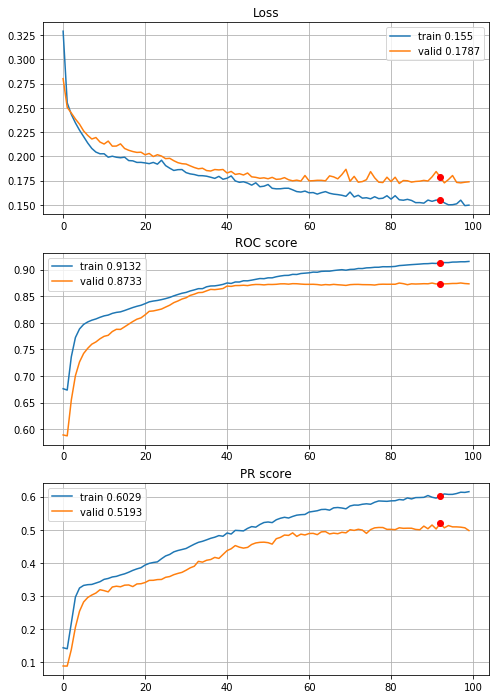


Fold 2------------------------------------------------------------


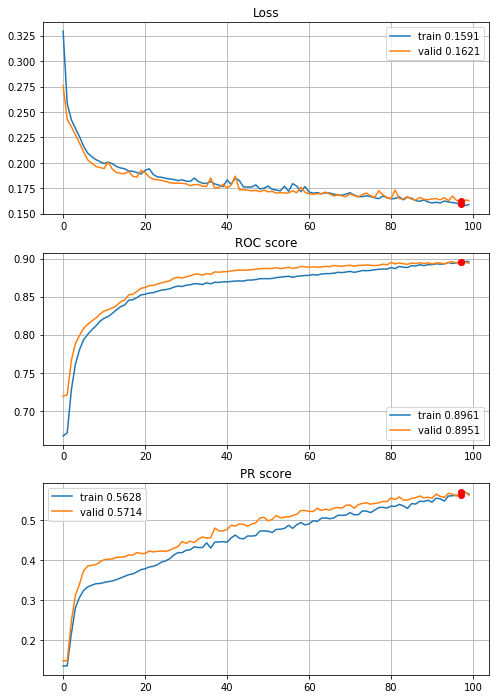


Fold 3------------------------------------------------------------


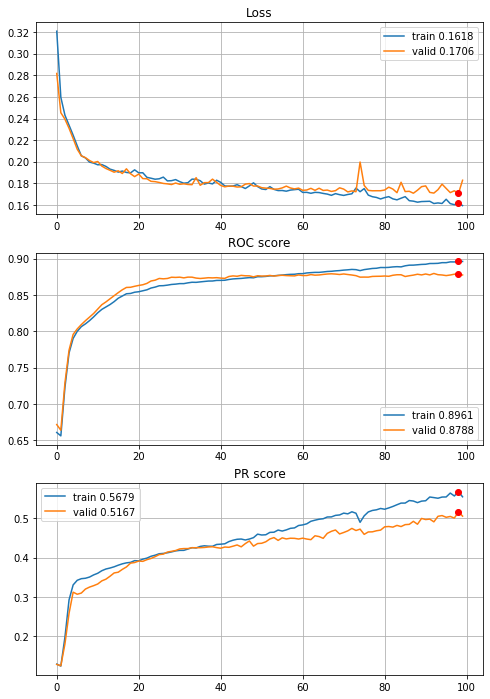


Fold 4------------------------------------------------------------


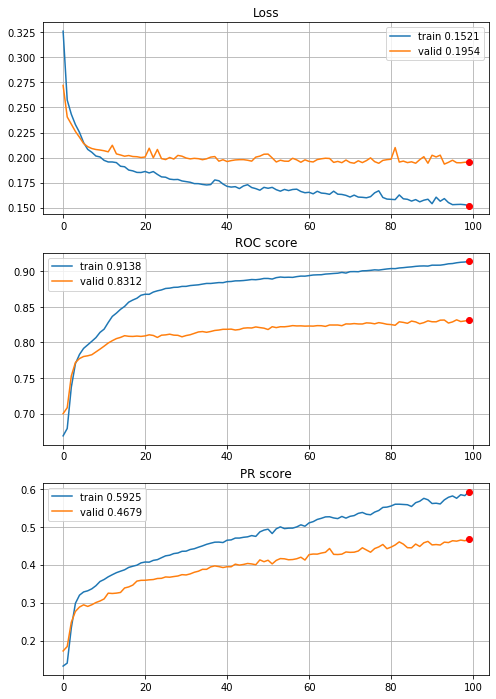


Fold 5------------------------------------------------------------


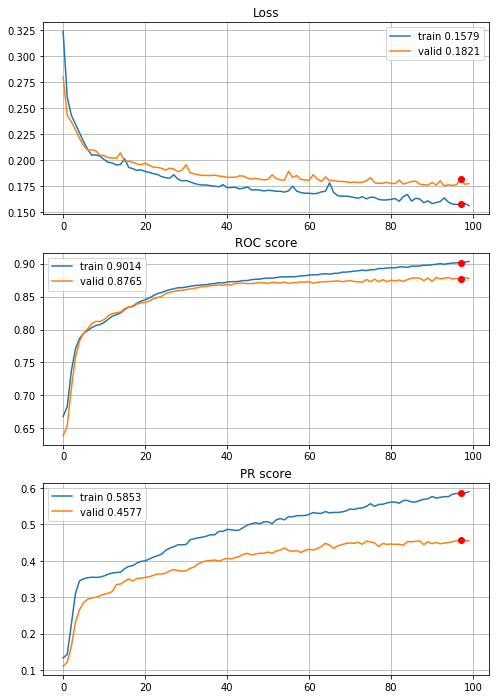


Fold 6------------------------------------------------------------


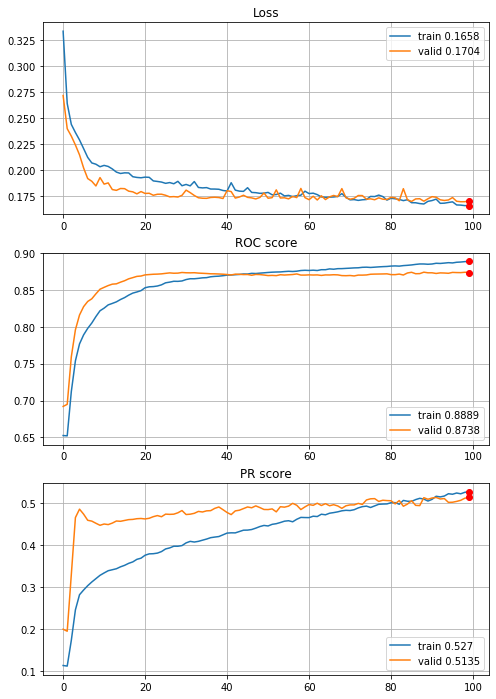

In [224]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Very nice learning curves, very small overfitting, results are worse but stable compared to the very first CNN when the results was all about luck and early stopping. In this model it is a potential for more epochs, 400 for example :)


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/400,
cumulative time: 3.76s train loss: 0.32894725259057234, validation loss: 0.280087732005415
Epoch: 2/400,
cumulative time: 4.62s train loss: 0.2552151936661143, validation loss: 0.25046950363655907
Epoch: 3/400,
cumulative time: 5.48s train loss: 0.24326739413831855, validation loss: 0.24468688063718286
Epoch: 4/400,
cumulative time: 6.33s train loss: 0.23454169840266129, validation loss: 0.23852760574056975
Epoch: 5/400,
cumulative time: 7.19s train loss: 0.22698178504751693, validation loss: 0.23321194777090895
Epoch: 6/400,
cumulative time: 8.1s train loss: 0.22043176366534042, validation loss: 0.22626397211898408
Epoch: 7/400,
cumulative time: 8.96s train loss: 0.21380846263565095, validation loss: 0.22163279625044333
Epoch: 8/400,
cumulative time: 9.82s train loss: 0.2082135850422434, validation loss: 0.2179050021537127
Epoch: 9/400,
cumulative time: 10.67s train loss: 0.20445670368358332, v

Epoch: 77/400,
cumulative time: 69.18s train loss: 0.1599476534658068, validation loss: 0.17783932355909768
Epoch: 78/400,
cumulative time: 70.04s train loss: 0.15864038668465313, validation loss: 0.1743436107976864
Epoch: 79/400,
cumulative time: 70.88s train loss: 0.15916743933724153, validation loss: 0.17392323321527398
Epoch: 80/400,
cumulative time: 71.74s train loss: 0.16135389518181018, validation loss: 0.17953429996900117
Epoch: 81/400,
cumulative time: 72.58s train loss: 0.1572018124109356, validation loss: 0.17452737292549925
Epoch: 82/400,
cumulative time: 73.44s train loss: 0.16121066644088455, validation loss: 0.18065007749982726
Epoch: 83/400,
cumulative time: 74.29s train loss: 0.15813846902968867, validation loss: 0.17302789286266185
Epoch: 84/400,
cumulative time: 75.17s train loss: 0.15727917006783967, validation loss: 0.17551752824122097
Epoch: 85/400,
cumulative time: 76.03s train loss: 0.1578046431032006, validation loss: 0.17476657202641618
Epoch: 86/400,
cumulati

Epoch: 152/400,
cumulative time: 133.01s train loss: 0.13720523878017488, validation loss: 0.173286064182489
Epoch: 153/400,
cumulative time: 133.85s train loss: 0.13739978989740895, validation loss: 0.1723733434984891
Epoch: 154/400,
cumulative time: 134.7s train loss: 0.13606543665489565, validation loss: 0.1726044640701008
Epoch: 155/400,
cumulative time: 135.57s train loss: 0.13781000399081178, validation loss: 0.17489213670321488
Epoch: 156/400,
cumulative time: 136.42s train loss: 0.13993119546598906, validation loss: 0.17828194956634333
Epoch: 157/400,
cumulative time: 137.26s train loss: 0.13562677473515702, validation loss: 0.17360557817351052
Epoch: 158/400,
cumulative time: 138.13s train loss: 0.13625168085219305, validation loss: 0.176972002210988
Epoch: 159/400,
cumulative time: 138.99s train loss: 0.1387144559456392, validation loss: 0.1789938487960897
Epoch: 160/400,
cumulative time: 139.86s train loss: 0.1348446433597147, validation loss: 0.17424844326335925
Epoch: 161/

Epoch: 227/400,
cumulative time: 197.14s train loss: 0.11388102464297188, validation loss: 0.17572319746151852
Epoch: 228/400,
cumulative time: 198.0s train loss: 0.11467198226331911, validation loss: 0.17876459545589218
Epoch: 229/400,
cumulative time: 198.85s train loss: 0.1150903071038129, validation loss: 0.17812478219777378
Epoch: 230/400,
cumulative time: 199.7s train loss: 0.11228410861982766, validation loss: 0.17743896233524786
Epoch: 231/400,
cumulative time: 200.56s train loss: 0.11378524675360117, validation loss: 0.1759590014664135
Epoch: 232/400,
cumulative time: 201.41s train loss: 0.11430634851382528, validation loss: 0.17929667805603958
Epoch: 233/400,
cumulative time: 202.29s train loss: 0.11452495450631375, validation loss: 0.179259268262475
Epoch: 234/400,
cumulative time: 203.16s train loss: 0.11199192835912378, validation loss: 0.18484106587651347
Epoch: 235/400,
cumulative time: 204.02s train loss: 0.11406448916851505, validation loss: 0.17661117726208259
Epoch: 

Epoch: 302/400,
cumulative time: 261.22s train loss: 0.09404879029073655, validation loss: 0.19402504498149523
Epoch: 303/400,
cumulative time: 262.07s train loss: 0.09572308716138939, validation loss: 0.20485418895521992
Epoch: 304/400,
cumulative time: 262.94s train loss: 0.09288540171687945, validation loss: 0.18955852277786917
Epoch: 305/400,
cumulative time: 263.8s train loss: 0.09986710765681461, validation loss: 0.19978371329748376
Epoch: 306/400,
cumulative time: 264.66s train loss: 0.0864527868140583, validation loss: 0.19397424608301014
Epoch: 307/400,
cumulative time: 265.53s train loss: 0.08881695822237685, validation loss: 0.20179124559530948
Epoch: 308/400,
cumulative time: 266.38s train loss: 0.09711449306848247, validation loss: 0.21121876692691274
Epoch: 309/400,
cumulative time: 267.22s train loss: 0.09359732426750046, validation loss: 0.19101209923406598
Epoch: 310/400,
cumulative time: 268.07s train loss: 0.08678022784681903, validation loss: 0.1932556250688054
Epoc

Epoch: 377/400,
cumulative time: 325.61s train loss: 0.06877024604397614, validation loss: 0.21552663792886487
Epoch: 378/400,
cumulative time: 326.48s train loss: 0.06943536376318346, validation loss: 0.21482099347412922
Epoch: 379/400,
cumulative time: 327.34s train loss: 0.06875059938407924, validation loss: 0.21760908249669036
Epoch: 380/400,
cumulative time: 328.2s train loss: 0.06883446923003192, validation loss: 0.22129296387935302
Epoch: 381/400,
cumulative time: 329.04s train loss: 0.0669302412204525, validation loss: 0.23453148999571666
Epoch: 382/400,
cumulative time: 329.89s train loss: 0.06539954378736955, validation loss: 0.21846681294003092
Epoch: 383/400,
cumulative time: 330.73s train loss: 0.06750465648934675, validation loss: 0.24284813310342013
Epoch: 384/400,
cumulative time: 331.58s train loss: 0.0673070058297191, validation loss: 0.2338689954903107
Epoch: 385/400,
cumulative time: 332.43s train loss: 0.07030841565458945, validation loss: 0.2212720881252977
Epoch:

Epoch: 50/400,
cumulative time: 44.95s train loss: 0.1756357526547857, validation loss: 0.17329632310278656
Epoch: 51/400,
cumulative time: 45.81s train loss: 0.1778271695773793, validation loss: 0.1719159935144319
Epoch: 52/400,
cumulative time: 46.66s train loss: 0.1745748728923903, validation loss: 0.17267215174644884
Epoch: 53/400,
cumulative time: 47.5s train loss: 0.1740288658450872, validation loss: 0.17065218625235315
Epoch: 54/400,
cumulative time: 48.36s train loss: 0.17338468811545346, validation loss: 0.1709591697779691
Epoch: 55/400,
cumulative time: 49.21s train loss: 0.17776378191039235, validation loss: 0.1705504221906791
Epoch: 56/400,
cumulative time: 50.16s train loss: 0.17311108246822218, validation loss: 0.17084890226030297
Epoch: 57/400,
cumulative time: 51.05s train loss: 0.1806333281826026, validation loss: 0.17278601417345285
Epoch: 58/400,
cumulative time: 51.92s train loss: 0.17796431323815984, validation loss: 0.17103497855356878
Epoch: 59/400,
cumulative ti

Epoch: 126/400,
cumulative time: 110.21s train loss: 0.1583621680319632, validation loss: 0.17225407520907574
Epoch: 127/400,
cumulative time: 111.07s train loss: 0.15834546157088306, validation loss: 0.16609340541593923
Epoch: 128/400,
cumulative time: 111.93s train loss: 0.1576240704418412, validation loss: 0.16448717635742305
Epoch: 129/400,
cumulative time: 112.79s train loss: 0.15535364587814798, validation loss: 0.17023046808621795
Epoch: 130/400,
cumulative time: 113.65s train loss: 0.16117811227883028, validation loss: 0.16896531992122582
Epoch: 131/400,
cumulative time: 114.49s train loss: 0.16015122143302907, validation loss: 0.17598265219635195
Epoch: 132/400,
cumulative time: 115.36s train loss: 0.15872229465253193, validation loss: 0.1656037706969959
Epoch: 133/400,
cumulative time: 116.2s train loss: 0.155993147981807, validation loss: 0.16347576131815303
Epoch: 134/400,
cumulative time: 117.06s train loss: 0.15452161163347186, validation loss: 0.16803634667342787
Epoch: 

Epoch: 201/400,
cumulative time: 174.5s train loss: 0.13705310351232114, validation loss: 0.16465447293730975
Epoch: 202/400,
cumulative time: 175.39s train loss: 0.138682469920615, validation loss: 0.1682189074350183
Epoch: 203/400,
cumulative time: 176.25s train loss: 0.13628544520909497, validation loss: 0.16337512226894985
Epoch: 204/400,
cumulative time: 177.09s train loss: 0.13694446474744093, validation loss: 0.16361497426584043
Epoch: 205/400,
cumulative time: 177.95s train loss: 0.13470760529141348, validation loss: 0.16398628971622387
Epoch: 206/400,
cumulative time: 178.81s train loss: 0.1359426232713816, validation loss: 0.16580583852334652
Epoch: 207/400,
cumulative time: 179.65s train loss: 0.13489978152935794, validation loss: 0.1646321743155547
Epoch: 208/400,
cumulative time: 180.5s train loss: 0.13633576048948273, validation loss: 0.16395913998532322
Epoch: 209/400,
cumulative time: 181.35s train loss: 0.1352445148066063, validation loss: 0.16682499852094468
Epoch: 21

Epoch: 276/400,
cumulative time: 238.76s train loss: 0.11883068001334848, validation loss: 0.1640709615580259
Epoch: 277/400,
cumulative time: 239.61s train loss: 0.11414541065733248, validation loss: 0.1652731250177779
Epoch: 278/400,
cumulative time: 240.48s train loss: 0.11522130478872827, validation loss: 0.16506989590882448
Epoch: 279/400,
cumulative time: 241.33s train loss: 0.11450082744515437, validation loss: 0.16392072469096844
Epoch: 280/400,
cumulative time: 242.18s train loss: 0.11914650846729963, validation loss: 0.1861751675605774
Epoch: 281/400,
cumulative time: 243.04s train loss: 0.12449965665002592, validation loss: 0.1689532449408072
Epoch: 282/400,
cumulative time: 243.88s train loss: 0.11688938791719047, validation loss: 0.16678607567993603
Epoch: 283/400,
cumulative time: 244.73s train loss: 0.11154164655288742, validation loss: 0.16285452431460512
Epoch: 284/400,
cumulative time: 245.59s train loss: 0.1123569933193255, validation loss: 0.1632395266915389
Epoch: 

Epoch: 351/400,
cumulative time: 303.19s train loss: 0.0905753821453974, validation loss: 0.17335073327332767
Epoch: 352/400,
cumulative time: 304.04s train loss: 0.09114273012841007, validation loss: 0.17553927630958857
Epoch: 353/400,
cumulative time: 304.91s train loss: 0.09173589578698581, validation loss: 0.1745261712064872
Epoch: 354/400,
cumulative time: 305.76s train loss: 0.09062644704967898, validation loss: 0.17537801878226517
Epoch: 355/400,
cumulative time: 306.62s train loss: 0.09034130224178037, validation loss: 0.17551878504581087
Epoch: 356/400,
cumulative time: 307.47s train loss: 0.08939826076628392, validation loss: 0.1771245910591848
Epoch: 357/400,
cumulative time: 308.32s train loss: 0.09151035174559331, validation loss: 0.18836986640596337
Epoch: 358/400,
cumulative time: 309.19s train loss: 0.09329299883083154, validation loss: 0.17649160207930653
Epoch: 359/400,
cumulative time: 310.03s train loss: 0.09128699440421664, validation loss: 0.17813344635783349
Epoc

Epoch: 24/400,
cumulative time: 23.16s train loss: 0.18480584011934295, validation loss: 0.18183295296036808
Epoch: 25/400,
cumulative time: 24.04s train loss: 0.18386358340751607, validation loss: 0.18166450089370786
Epoch: 26/400,
cumulative time: 24.91s train loss: 0.18431101821443666, validation loss: 0.1809636394933219
Epoch: 27/400,
cumulative time: 25.78s train loss: 0.18586758844258552, validation loss: 0.17995557205787238
Epoch: 28/400,
cumulative time: 26.65s train loss: 0.18235908165600972, validation loss: 0.1795126520256851
Epoch: 29/400,
cumulative time: 27.52s train loss: 0.18260582277571466, validation loss: 0.1789676276914431
Epoch: 30/400,
cumulative time: 28.4s train loss: 0.18350510366449288, validation loss: 0.18043207692186083
Epoch: 31/400,
cumulative time: 29.26s train loss: 0.18171761570236097, validation loss: 0.1791877590346632
Epoch: 32/400,
cumulative time: 30.15s train loss: 0.18030661389581348, validation loss: 0.1797284753373672
Epoch: 33/400,
cumulative

Epoch: 100/400,
cumulative time: 89.57s train loss: 0.1604703698771256, validation loss: 0.1845674696877145
Epoch: 101/400,
cumulative time: 90.43s train loss: 0.16336181086726784, validation loss: 0.171936227224994
Epoch: 102/400,
cumulative time: 91.3s train loss: 0.15954652758456417, validation loss: 0.17329312158746407
Epoch: 103/400,
cumulative time: 92.17s train loss: 0.1606494128394751, validation loss: 0.17683214508627018
Epoch: 104/400,
cumulative time: 93.06s train loss: 0.16233982121242405, validation loss: 0.18088025704715002
Epoch: 105/400,
cumulative time: 93.93s train loss: 0.16169848421501123, validation loss: 0.17336823291480205
Epoch: 106/400,
cumulative time: 94.81s train loss: 0.1593727086122662, validation loss: 0.1730285913860919
Epoch: 107/400,
cumulative time: 95.71s train loss: 0.16308118019669926, validation loss: 0.17671279800717699
Epoch: 108/400,
cumulative time: 96.58s train loss: 0.15967033995779412, validation loss: 0.1733913442630241
Epoch: 109/400,
cum

Epoch: 175/400,
cumulative time: 155.14s train loss: 0.13368464003414562, validation loss: 0.1818116218221228
Epoch: 176/400,
cumulative time: 156.04s train loss: 0.1321672940297247, validation loss: 0.194907073070124
Epoch: 177/400,
cumulative time: 156.9s train loss: 0.13752427646412854, validation loss: 0.17808540437576334
Epoch: 178/400,
cumulative time: 157.77s train loss: 0.13822060305665546, validation loss: 0.18521222055563125
Epoch: 179/400,
cumulative time: 158.65s train loss: 0.1415356093520023, validation loss: 0.1810725113416874
Epoch: 180/400,
cumulative time: 159.52s train loss: 0.13272109904766943, validation loss: 0.17826607279067916
Epoch: 181/400,
cumulative time: 160.39s train loss: 0.13022415266987541, validation loss: 0.1801462090304363
Epoch: 182/400,
cumulative time: 161.26s train loss: 0.12906535805643465, validation loss: 0.1829841958764172
Epoch: 183/400,
cumulative time: 162.14s train loss: 0.12824877565020582, validation loss: 0.18157693212841383
Epoch: 184

Epoch: 250/400,
cumulative time: 220.95s train loss: 0.10691432468929338, validation loss: 0.19655210085490377
Epoch: 251/400,
cumulative time: 221.82s train loss: 0.10550210075217571, validation loss: 0.19092729854005838
Epoch: 252/400,
cumulative time: 222.71s train loss: 0.1067944943622454, validation loss: 0.1980109069131004
Epoch: 253/400,
cumulative time: 223.57s train loss: 0.10248173361758463, validation loss: 0.19457706961919383
Epoch: 254/400,
cumulative time: 224.44s train loss: 0.10292898729066986, validation loss: 0.2002775128321825
Epoch: 255/400,
cumulative time: 225.31s train loss: 0.10246775225174717, validation loss: 0.20554312179967543
Epoch: 256/400,
cumulative time: 226.18s train loss: 0.10189909993633897, validation loss: 0.19640778871977613
Epoch: 257/400,
cumulative time: 227.05s train loss: 0.10016498162616246, validation loss: 0.18991921611945015
Epoch: 258/400,
cumulative time: 227.92s train loss: 0.09999450149908931, validation loss: 0.21792046095768522
Epoc

Epoch: 325/400,
cumulative time: 286.45s train loss: 0.08195282581232032, validation loss: 0.22183464020658641
Epoch: 326/400,
cumulative time: 287.34s train loss: 0.07566903758666306, validation loss: 0.2150992104004577
Epoch: 327/400,
cumulative time: 288.21s train loss: 0.0757400335757472, validation loss: 0.21682564195207704
Epoch: 328/400,
cumulative time: 289.08s train loss: 0.0762250975702321, validation loss: 0.22352271422055017
Epoch: 329/400,
cumulative time: 289.95s train loss: 0.07696844496686912, validation loss: 0.21732930807142678
Epoch: 330/400,
cumulative time: 290.81s train loss: 0.07398891340880671, validation loss: 0.21884470275921375
Epoch: 331/400,
cumulative time: 291.68s train loss: 0.07513100810396058, validation loss: 0.221069745442241
Epoch: 332/400,
cumulative time: 292.55s train loss: 0.07887590202815589, validation loss: 0.21124043160253608
Epoch: 333/400,
cumulative time: 293.42s train loss: 0.07761745695663542, validation loss: 0.21718685515434927
Epoch:

Epoch: 400/400,
cumulative time: 352.11s train loss: 0.05724790147320781, validation loss: 0.2601668125915151

Early stopping results:
best results in epoch: 373, 
best valid PR: 0.5631072478931489, 
valid ROC: 0.8505669599217986        
overfitting PR: 0.3477299700181371, 
overfitting ROC: 0.13689804846829112

----------
Fold: 4
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/400,
cumulative time: 3.76s train loss: 0.32604344791196793, validation loss: 0.271926606179091
Epoch: 2/400,
cumulative time: 4.61s train loss: 0.25734990098367233, validation loss: 0.24054344005159545
Epoch: 3/400,
cumulative time: 5.48s train loss: 0.2431980620892355, validation loss: 0.23330826996815124
Epoch: 4/400,
cumulative time: 6.36s train loss: 0.23288510640641516, validation loss: 0.22604718639538465
Epoch: 5/400,
cumulative time: 7.23s train loss: 0.22508762906266205, validation loss: 0.2202311310555542
Epoch: 6/400,
cumulative time: 8.1s train loss: 0.2149024730056235, validation 

Epoch: 74/400,
cumulative time: 67.18s train loss: 0.16040360285887298, validation loss: 0.19508337776090437
Epoch: 75/400,
cumulative time: 68.05s train loss: 0.15993363086025789, validation loss: 0.19707556321174244
Epoch: 76/400,
cumulative time: 68.91s train loss: 0.1610958399795233, validation loss: 0.19988744922873666
Epoch: 77/400,
cumulative time: 69.8s train loss: 0.16487371374468704, validation loss: 0.19634782776875637
Epoch: 78/400,
cumulative time: 70.67s train loss: 0.16714030040183078, validation loss: 0.19420043303385276
Epoch: 79/400,
cumulative time: 71.54s train loss: 0.16035363189716412, validation loss: 0.19712295257076454
Epoch: 80/400,
cumulative time: 72.42s train loss: 0.15863815545968538, validation loss: 0.1979632777904011
Epoch: 81/400,
cumulative time: 73.27s train loss: 0.1584114361409003, validation loss: 0.19834309910543885
Epoch: 82/400,
cumulative time: 74.14s train loss: 0.15825782596607818, validation loss: 0.2102589532564779
Epoch: 83/400,
cumulativ

Epoch: 149/400,
cumulative time: 132.35s train loss: 0.1303881154660982, validation loss: 0.19690161290879174
Epoch: 150/400,
cumulative time: 133.22s train loss: 0.1302447999801723, validation loss: 0.19477705354749753
Epoch: 151/400,
cumulative time: 134.09s train loss: 0.13224323340619146, validation loss: 0.20385977968943578
Epoch: 152/400,
cumulative time: 135.01s train loss: 0.13115593358057498, validation loss: 0.19517141415760694
Epoch: 153/400,
cumulative time: 135.91s train loss: 0.12929518202169737, validation loss: 0.1977690700483645
Epoch: 154/400,
cumulative time: 136.79s train loss: 0.1285718456196403, validation loss: 0.19823321087903956
Epoch: 155/400,
cumulative time: 137.66s train loss: 0.12927226541396217, validation loss: 0.1946019211754573
Epoch: 156/400,
cumulative time: 138.53s train loss: 0.12964306572423195, validation loss: 0.20470270686036576
Epoch: 157/400,
cumulative time: 139.39s train loss: 0.13099956222697035, validation loss: 0.19841886861733335
Epoch:

Epoch: 224/400,
cumulative time: 197.65s train loss: 0.09253973102572269, validation loss: 0.2129515382223689
Epoch: 225/400,
cumulative time: 198.52s train loss: 0.09254862440545376, validation loss: 0.2195160149451572
Epoch: 226/400,
cumulative time: 199.39s train loss: 0.09238433198212985, validation loss: 0.21466480541982716
Epoch: 227/400,
cumulative time: 200.29s train loss: 0.09637300614347422, validation loss: 0.21229949539724913
Epoch: 228/400,
cumulative time: 201.22s train loss: 0.09525252103355113, validation loss: 0.23186843854040917
Epoch: 229/400,
cumulative time: 202.15s train loss: 0.10178271136856928, validation loss: 0.2430756794074319
Epoch: 230/400,
cumulative time: 203.01s train loss: 0.10098712194182387, validation loss: 0.2113755171105232
Epoch: 231/400,
cumulative time: 203.89s train loss: 0.09109837617981442, validation loss: 0.23023625599476877
Epoch: 232/400,
cumulative time: 204.76s train loss: 0.08953992781428272, validation loss: 0.22729347353595106
Epoch

Epoch: 299/400,
cumulative time: 262.97s train loss: 0.06377151661409418, validation loss: 0.25424439872091564
Epoch: 300/400,
cumulative time: 263.85s train loss: 0.06479518830199732, validation loss: 0.269418068549703
Epoch: 301/400,
cumulative time: 264.7s train loss: 0.06562069707675952, validation loss: 0.28411861177760916
Epoch: 302/400,
cumulative time: 265.57s train loss: 0.07326891533265716, validation loss: 0.2669854109295335
Epoch: 303/400,
cumulative time: 266.44s train loss: 0.06649001973317488, validation loss: 0.26380986634549386
Epoch: 304/400,
cumulative time: 267.31s train loss: 0.0694287975003387, validation loss: 0.26653030316259196
Epoch: 305/400,
cumulative time: 268.18s train loss: 0.06891318259455269, validation loss: 0.25933070746555287
Epoch: 306/400,
cumulative time: 269.04s train loss: 0.06265312043066329, validation loss: 0.26584060836591783
Epoch: 307/400,
cumulative time: 269.91s train loss: 0.0660974746572092, validation loss: 0.2538621589776894
Epoch: 3

Epoch: 374/400,
cumulative time: 328.4s train loss: 0.04136585570181059, validation loss: 0.3116788900799999
Epoch: 375/400,
cumulative time: 329.26s train loss: 0.04488920808189708, validation loss: 0.29583372599518865
Epoch: 376/400,
cumulative time: 330.13s train loss: 0.04183374029833604, validation loss: 0.3108869839468067
Epoch: 377/400,
cumulative time: 330.99s train loss: 0.04268411194669079, validation loss: 0.3072261101236193
Epoch: 378/400,
cumulative time: 331.88s train loss: 0.04331747754969622, validation loss: 0.3115869076001725
Epoch: 379/400,
cumulative time: 332.74s train loss: 0.04059685792831946, validation loss: 0.30679491155572725
Epoch: 380/400,
cumulative time: 333.6s train loss: 0.03921383763849399, validation loss: 0.3023475616430321
Epoch: 381/400,
cumulative time: 334.48s train loss: 0.039457176747916115, validation loss: 0.30613840652238705
Epoch: 382/400,
cumulative time: 335.34s train loss: 0.041171410930915045, validation loss: 0.316680114304239
Epoch: 3

Epoch: 47/400,
cumulative time: 43.38s train loss: 0.17072343616205388, validation loss: 0.18246194417535855
Epoch: 48/400,
cumulative time: 44.28s train loss: 0.17103167266467073, validation loss: 0.18320390800724717
Epoch: 49/400,
cumulative time: 45.15s train loss: 0.17053837527640917, validation loss: 0.1819529824682068
Epoch: 50/400,
cumulative time: 46.04s train loss: 0.16998056546038492, validation loss: 0.18150491457491372
Epoch: 51/400,
cumulative time: 46.92s train loss: 0.1706807761846588, validation loss: 0.18194602853692143
Epoch: 52/400,
cumulative time: 47.8s train loss: 0.1698120631934718, validation loss: 0.18697321068487102
Epoch: 53/400,
cumulative time: 48.68s train loss: 0.16929418915836908, validation loss: 0.18206562596303885
Epoch: 54/400,
cumulative time: 49.58s train loss: 0.1691825855283847, validation loss: 0.1809775236632431
Epoch: 55/400,
cumulative time: 50.45s train loss: 0.16860255096826224, validation loss: 0.18108973862355235
Epoch: 56/400,
cumulative

Epoch: 123/400,
cumulative time: 110.16s train loss: 0.1475852053186411, validation loss: 0.17529735315599507
Epoch: 124/400,
cumulative time: 111.02s train loss: 0.15195214368878598, validation loss: 0.17936457219296062
Epoch: 125/400,
cumulative time: 111.89s train loss: 0.14784695955651786, validation loss: 0.17134213575391144
Epoch: 126/400,
cumulative time: 112.76s train loss: 0.14662673942679183, validation loss: 0.17195485259824628
Epoch: 127/400,
cumulative time: 113.63s train loss: 0.14538000228911632, validation loss: 0.17026112038583305
Epoch: 128/400,
cumulative time: 114.5s train loss: 0.14415912170819442, validation loss: 0.17059048424994167
Epoch: 129/400,
cumulative time: 115.37s train loss: 0.14438048427970313, validation loss: 0.17834461885704145
Epoch: 130/400,
cumulative time: 116.22s train loss: 0.1499370486418173, validation loss: 0.19094124375832
Epoch: 131/400,
cumulative time: 117.1s train loss: 0.14659346058080677, validation loss: 0.1764655741558118
Epoch: 13

Epoch: 198/400,
cumulative time: 175.45s train loss: 0.11773600103743265, validation loss: 0.17359186705563462
Epoch: 199/400,
cumulative time: 176.31s train loss: 0.11392128352431286, validation loss: 0.1745467894031555
Epoch: 200/400,
cumulative time: 177.2s train loss: 0.11280149364112436, validation loss: 0.1779337776299255
Epoch: 201/400,
cumulative time: 178.06s train loss: 0.11333418472468544, validation loss: 0.1742517600008381
Epoch: 202/400,
cumulative time: 178.95s train loss: 0.11295917606329557, validation loss: 0.17587632045116167
Epoch: 203/400,
cumulative time: 179.82s train loss: 0.11569758727323005, validation loss: 0.1771946807074493
Epoch: 204/400,
cumulative time: 180.7s train loss: 0.11362216259780814, validation loss: 0.17828502191512363
Epoch: 205/400,
cumulative time: 181.58s train loss: 0.11318762272347614, validation loss: 0.17820458050237015
Epoch: 206/400,
cumulative time: 182.45s train loss: 0.11171057747713524, validation loss: 0.1752206528428984
Epoch: 2

Epoch: 273/400,
cumulative time: 241.14s train loss: 0.08941160042755711, validation loss: 0.20306867031426784
Epoch: 274/400,
cumulative time: 242.01s train loss: 0.08336803518586952, validation loss: 0.22921959194722616
Epoch: 275/400,
cumulative time: 242.89s train loss: 0.08938718371861357, validation loss: 0.20419230074968617
Epoch: 276/400,
cumulative time: 243.76s train loss: 0.08413606914196868, validation loss: 0.20459597155821782
Epoch: 277/400,
cumulative time: 244.62s train loss: 0.08365836653319757, validation loss: 0.20285704795851395
Epoch: 278/400,
cumulative time: 245.49s train loss: 0.08501284182266648, validation loss: 0.21017435650524113
Epoch: 279/400,
cumulative time: 246.36s train loss: 0.08459627330504878, validation loss: 0.20371682558452572
Epoch: 280/400,
cumulative time: 247.23s train loss: 0.08100411932879314, validation loss: 0.20095456440346504
Epoch: 281/400,
cumulative time: 248.1s train loss: 0.08189458188241797, validation loss: 0.21499300463877735
Ep

Epoch: 348/400,
cumulative time: 306.43s train loss: 0.05820753883856993, validation loss: 0.2393389819168883
Epoch: 349/400,
cumulative time: 307.3s train loss: 0.058961123630602796, validation loss: 0.24385671886041524
Epoch: 350/400,
cumulative time: 308.27s train loss: 0.060338503504858955, validation loss: 0.2614294182231679
Epoch: 351/400,
cumulative time: 309.15s train loss: 0.05893477856164965, validation loss: 0.2440415818252628
Epoch: 352/400,
cumulative time: 310.06s train loss: 0.057833121635293736, validation loss: 0.26221650270387764
Epoch: 353/400,
cumulative time: 310.94s train loss: 0.062174665868726026, validation loss: 0.25316817187294194
Epoch: 354/400,
cumulative time: 311.86s train loss: 0.0800107283630746, validation loss: 0.24836464142153547
Epoch: 355/400,
cumulative time: 312.72s train loss: 0.06697878403979474, validation loss: 0.24352295054269968
Epoch: 356/400,
cumulative time: 313.6s train loss: 0.0555230373491048, validation loss: 0.24659386405019135
Epoc

Epoch: 21/400,
cumulative time: 21.12s train loss: 0.1927382983494203, validation loss: 0.17765698586979514
Epoch: 22/400,
cumulative time: 22.04s train loss: 0.19251427915600228, validation loss: 0.17747804680607926
Epoch: 23/400,
cumulative time: 22.94s train loss: 0.18914509355726075, validation loss: 0.175824494952542
Epoch: 24/400,
cumulative time: 23.84s train loss: 0.18849114084079738, validation loss: 0.17750676601923346
Epoch: 25/400,
cumulative time: 24.74s train loss: 0.18772803297396198, validation loss: 0.17701719553287626
Epoch: 26/400,
cumulative time: 25.66s train loss: 0.18611998855731515, validation loss: 0.17656337286494925
Epoch: 27/400,
cumulative time: 26.55s train loss: 0.1860322788569504, validation loss: 0.17437209377304963
Epoch: 28/400,
cumulative time: 27.45s train loss: 0.18506179703241973, validation loss: 0.17428735776491144
Epoch: 29/400,
cumulative time: 28.35s train loss: 0.18785625317014423, validation loss: 0.17669874587796341
Epoch: 30/400,
cumulati

Epoch: 97/400,
cumulative time: 91.31s train loss: 0.15658197980042157, validation loss: 0.16792401328312892
Epoch: 98/400,
cumulative time: 92.23s train loss: 0.1565438102306401, validation loss: 0.1687413919590935
Epoch: 99/400,
cumulative time: 93.2s train loss: 0.15598265826534047, validation loss: 0.16816279709204593
Epoch: 100/400,
cumulative time: 94.17s train loss: 0.15563003719693352, validation loss: 0.169481258124584
Epoch: 101/400,
cumulative time: 95.13s train loss: 0.15785270988161343, validation loss: 0.1675239473110397
Epoch: 102/400,
cumulative time: 96.07s train loss: 0.15708777707296168, validation loss: 0.1689400508764366
Epoch: 103/400,
cumulative time: 97.09s train loss: 0.1543575583772468, validation loss: 0.16919084407944174
Epoch: 104/400,
cumulative time: 98.08s train loss: 0.15393897813059745, validation loss: 0.16863805314622668
Epoch: 105/400,
cumulative time: 99.0s train loss: 0.1529916804624201, validation loss: 0.1680373289784244
Epoch: 106/400,
cumulati

Epoch: 172/400,
cumulative time: 162.26s train loss: 0.1274947273376266, validation loss: 0.1735118739895573
Epoch: 173/400,
cumulative time: 163.17s train loss: 0.12900470447626336, validation loss: 0.17350618386510802
Epoch: 174/400,
cumulative time: 164.06s train loss: 0.1275272681021728, validation loss: 0.17130822131649903
Epoch: 175/400,
cumulative time: 164.97s train loss: 0.12424312022189214, validation loss: 0.17330748327160528
Epoch: 176/400,
cumulative time: 165.87s train loss: 0.1261597338995814, validation loss: 0.17449663751012315
Epoch: 177/400,
cumulative time: 166.81s train loss: 0.12415021751391116, validation loss: 0.17243534070912656
Epoch: 178/400,
cumulative time: 167.79s train loss: 0.12550549720725543, validation loss: 0.17594933688102404
Epoch: 179/400,
cumulative time: 168.74s train loss: 0.13025151387431835, validation loss: 0.18384878340746963
Epoch: 180/400,
cumulative time: 169.68s train loss: 0.12789007927907284, validation loss: 0.17167231282450546
Epoch

Epoch: 247/400,
cumulative time: 234.29s train loss: 0.09859435900813862, validation loss: 0.1939159505254259
Epoch: 248/400,
cumulative time: 235.21s train loss: 0.09657166864132198, validation loss: 0.19256658051541373
Epoch: 249/400,
cumulative time: 236.11s train loss: 0.09571651630515361, validation loss: 0.1918669771865582
Epoch: 250/400,
cumulative time: 237.01s train loss: 0.09651013779036487, validation loss: 0.19359286714757268
Epoch: 251/400,
cumulative time: 237.94s train loss: 0.09496077774489622, validation loss: 0.19126146914054792
Epoch: 252/400,
cumulative time: 238.85s train loss: 0.09758332173556204, validation loss: 0.19519841539805952
Epoch: 253/400,
cumulative time: 239.75s train loss: 0.09935421061158153, validation loss: 0.1948992599550273
Epoch: 254/400,
cumulative time: 240.63s train loss: 0.09332404546011067, validation loss: 0.19892731695761798
Epoch: 255/400,
cumulative time: 241.54s train loss: 0.09692305523440824, validation loss: 0.19541634292957746
Epoc

Epoch: 322/400,
cumulative time: 305.34s train loss: 0.06773924639546425, validation loss: 0.22644812860957117
Epoch: 323/400,
cumulative time: 306.25s train loss: 0.06775815523917159, validation loss: 0.22638004930778227
Epoch: 324/400,
cumulative time: 307.15s train loss: 0.0682720311066716, validation loss: 0.22017973355326642
Epoch: 325/400,
cumulative time: 308.06s train loss: 0.06684162583518938, validation loss: 0.2244587006135665
Epoch: 326/400,
cumulative time: 308.97s train loss: 0.06624949878275381, validation loss: 0.22813176150112066
Epoch: 327/400,
cumulative time: 309.85s train loss: 0.06598369108112569, validation loss: 0.22339046260438708
Epoch: 328/400,
cumulative time: 310.77s train loss: 0.06865002656430712, validation loss: 0.22666580779961484
Epoch: 329/400,
cumulative time: 311.8s train loss: 0.06658339490006854, validation loss: 0.22879596693655707
Epoch: 330/400,
cumulative time: 312.73s train loss: 0.07021174543723548, validation loss: 0.22558637501558385
Epoc

Epoch: 397/400,
cumulative time: 373.33s train loss: 0.046632250694874415, validation loss: 0.2704925025827998
Epoch: 398/400,
cumulative time: 374.23s train loss: 0.04579541783215982, validation loss: 0.2849634091283613
Epoch: 399/400,
cumulative time: 375.13s train loss: 0.05026326477510811, validation loss: 0.2795140913458495
Epoch: 400/400,
cumulative time: 376.04s train loss: 0.046404450152808, validation loss: 0.27560784016855683

Early stopping results:
best results in epoch: 237, 
best valid PR: 0.5512094460055467, 
valid ROC: 0.8705613512170889        
overfitting PR: 0.2471159089511945, 
overfitting ROC: 0.0920207030922382

Cross validation time: 2149s
ROC: 		0.8713649717695197
PR: 		0.5442243866266884
overfittingROC: 0.09769461602859342
overfittingPR:  0.29398098189479227
early stopping: [207, 313, 373, 326, 229, 237]

Fold 1------------------------------------------------------------


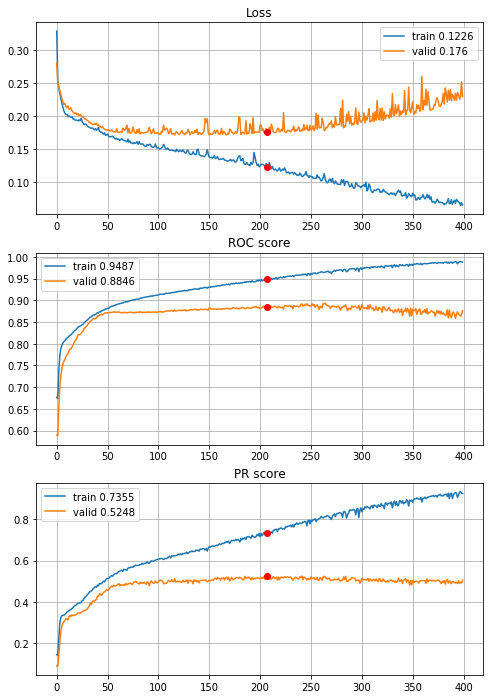


Fold 2------------------------------------------------------------


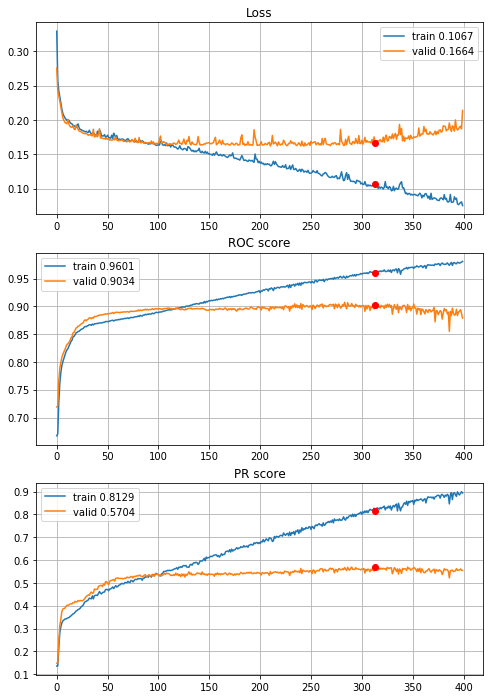


Fold 3------------------------------------------------------------


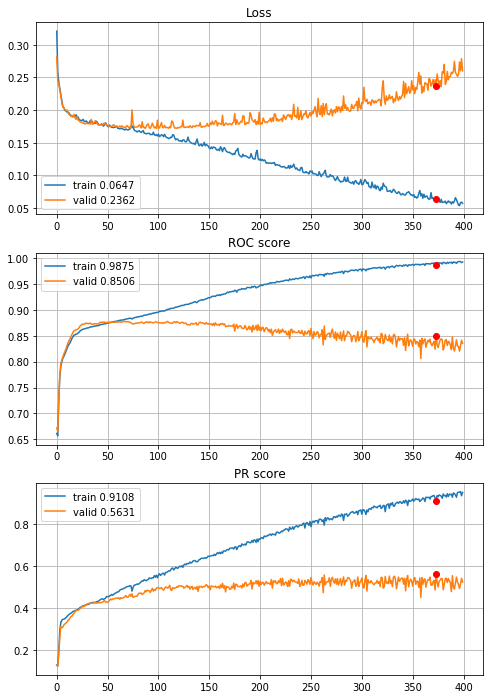


Fold 4------------------------------------------------------------


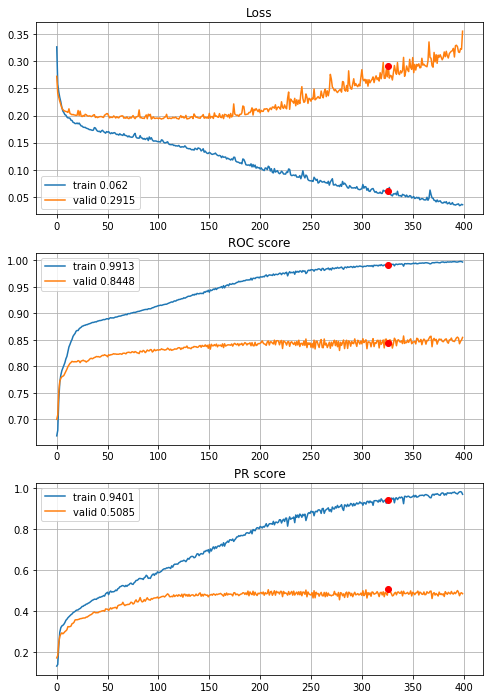


Fold 5------------------------------------------------------------


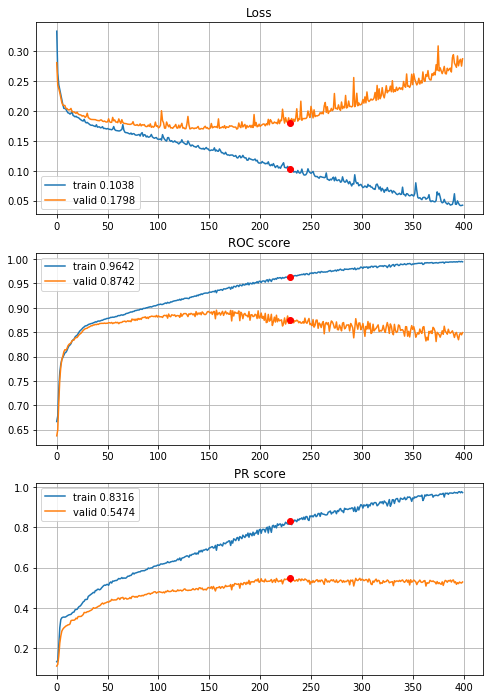


Fold 6------------------------------------------------------------


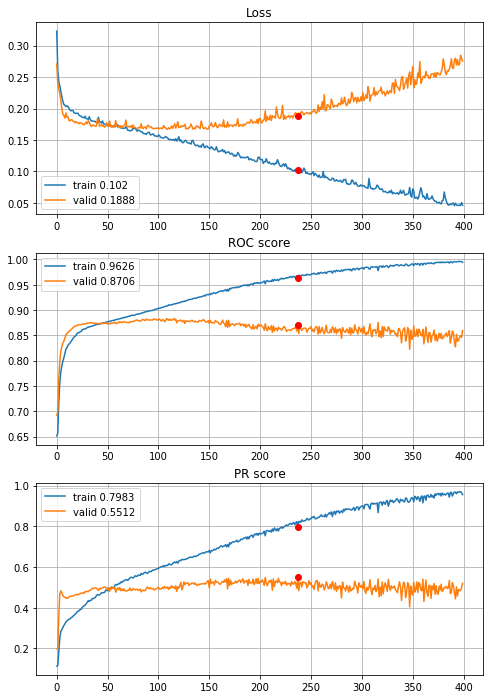

In [226]:
# The third best model
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Results are better, but by looking at learning curves it can be observed that results are not growing after approx 250-th epoch, so for computation power saving further experiments will be performed on 250 epochs. First lets add one more dense layer.

In [49]:
def define_deep_CNN_2inc_2dense_std(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu)(flat)                   # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu)(dense)                  # (128,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/250,
cumulative time: 3.87s train loss: 0.38242581645396645, validation loss: 0.2824156317259306
Epoch: 2/250,
cumulative time: 4.81s train loss: 0.25944335854171846, validation loss: 0.25215271004426304
Epoch: 3/250,
cumulative time: 5.74s train loss: 0.24555286958759873, validation loss: 0.24734229339956565
Epoch: 4/250,
cumulative time: 6.67s train loss: 0.23814268314047626, validation loss: 0.24172612507286845
Epoch: 5/250,
cumulative time: 7.61s train loss: 0.2305755302215849, validation loss: 0.23662101478224543
Epoch: 6/250,
cumulative time: 8.59s train loss: 0.22315999680612278, validation loss: 0.22860561460760562
Epoch: 7/250,
cumulative time: 9.52s train loss: 0.2149725009482152, validation loss: 0.2218133372075125
Epoch: 8/250,
cumulative time: 10.46s train loss: 0.20657158777494292, validation loss: 0.22003957088259726
Epoch: 9/250,
cumulative time: 11.4s train loss: 0.2041286208434871, 

Epoch: 77/250,
cumulative time: 74.82s train loss: 0.1525575544564087, validation loss: 0.1754516543738603
Epoch: 78/250,
cumulative time: 75.75s train loss: 0.1463704956460085, validation loss: 0.17729589848736094
Epoch: 79/250,
cumulative time: 76.68s train loss: 0.14798071855067238, validation loss: 0.17768603081162915
Epoch: 80/250,
cumulative time: 77.6s train loss: 0.15103021279206022, validation loss: 0.1842597726367103
Epoch: 81/250,
cumulative time: 78.53s train loss: 0.14616913048194097, validation loss: 0.18259631035158572
Epoch: 82/250,
cumulative time: 79.46s train loss: 0.147442415144819, validation loss: 0.18418584590968848
Epoch: 83/250,
cumulative time: 80.39s train loss: 0.14983037283260792, validation loss: 0.1836421273673938
Epoch: 84/250,
cumulative time: 81.31s train loss: 0.14778562926683939, validation loss: 0.18955563979796652
Epoch: 85/250,
cumulative time: 82.23s train loss: 0.15358900982846208, validation loss: 0.17605886106896965
Epoch: 86/250,
cumulative t

Epoch: 152/250,
cumulative time: 144.78s train loss: 0.10851917226230624, validation loss: 0.19510810792849326
Epoch: 153/250,
cumulative time: 145.71s train loss: 0.10219109640372681, validation loss: 0.20514317332287113
Epoch: 154/250,
cumulative time: 146.62s train loss: 0.10274644128453753, validation loss: 0.1987063985196149
Epoch: 155/250,
cumulative time: 147.56s train loss: 0.10174417232469209, validation loss: 0.21745807926980054
Epoch: 156/250,
cumulative time: 148.49s train loss: 0.10972028995598482, validation loss: 0.22245670888644328
Epoch: 157/250,
cumulative time: 149.42s train loss: 0.11738941578752621, validation loss: 0.22206576917795076
Epoch: 158/250,
cumulative time: 150.35s train loss: 0.1055064335539399, validation loss: 0.20876252328664097
Epoch: 159/250,
cumulative time: 151.29s train loss: 0.10359479458027583, validation loss: 0.20376550993360285
Epoch: 160/250,
cumulative time: 152.2s train loss: 0.11028685531367141, validation loss: 0.22269694162732181
Epoc

Epoch: 227/250,
cumulative time: 215.05s train loss: 0.06520995549481053, validation loss: 0.27839138818297876
Epoch: 228/250,
cumulative time: 215.96s train loss: 0.05405946946215382, validation loss: 0.27913657304533707
Epoch: 229/250,
cumulative time: 216.92s train loss: 0.05401985250608424, validation loss: 0.28412565696467945
Epoch: 230/250,
cumulative time: 217.88s train loss: 0.05143461331711672, validation loss: 0.29826623953988074
Epoch: 231/250,
cumulative time: 218.81s train loss: 0.051666399247150885, validation loss: 0.2913917117618789
Epoch: 232/250,
cumulative time: 219.73s train loss: 0.06428786505699588, validation loss: 0.30184245173396224
Epoch: 233/250,
cumulative time: 220.65s train loss: 0.05658960997358987, validation loss: 0.2831187359778696
Epoch: 234/250,
cumulative time: 221.58s train loss: 0.05739513658061086, validation loss: 0.29667144990289895
Epoch: 235/250,
cumulative time: 222.51s train loss: 0.051393442237514346, validation loss: 0.28776938408579605
E

Epoch: 50/250,
cumulative time: 48.6s train loss: 0.16913663827232506, validation loss: 0.1730991476451665
Epoch: 51/250,
cumulative time: 49.54s train loss: 0.16913545539851438, validation loss: 0.16661342797042822
Epoch: 52/250,
cumulative time: 50.47s train loss: 0.17017401057204723, validation loss: 0.17085865778342443
Epoch: 53/250,
cumulative time: 51.39s train loss: 0.16919464789438549, validation loss: 0.1644605678897834
Epoch: 54/250,
cumulative time: 52.34s train loss: 0.16606278944128472, validation loss: 0.163368813197938
Epoch: 55/250,
cumulative time: 53.25s train loss: 0.17085558771481907, validation loss: 0.1641062578898272
Epoch: 56/250,
cumulative time: 54.18s train loss: 0.16668239557301956, validation loss: 0.16611033951886744
Epoch: 57/250,
cumulative time: 55.1s train loss: 0.17245438543656028, validation loss: 0.17830301737234316
Epoch: 58/250,
cumulative time: 56.02s train loss: 0.1686606220833769, validation loss: 0.1647468165755944
Epoch: 59/250,
cumulative ti

Epoch: 126/250,
cumulative time: 119.32s train loss: 0.1300724302973289, validation loss: 0.1694722456989858
Epoch: 127/250,
cumulative time: 120.24s train loss: 0.12999194816413878, validation loss: 0.1596962352448144
Epoch: 128/250,
cumulative time: 121.16s train loss: 0.12372166385356377, validation loss: 0.15802655265726392
Epoch: 129/250,
cumulative time: 122.08s train loss: 0.12336881261063397, validation loss: 0.1614142154525071
Epoch: 130/250,
cumulative time: 123.03s train loss: 0.12540228020009797, validation loss: 0.15898515952681744
Epoch: 131/250,
cumulative time: 123.96s train loss: 0.12918725872365253, validation loss: 0.16935885113820418
Epoch: 132/250,
cumulative time: 124.89s train loss: 0.13119573093654877, validation loss: 0.15983107363492283
Epoch: 133/250,
cumulative time: 125.82s train loss: 0.12484373748033485, validation loss: 0.16230577687400036
Epoch: 134/250,
cumulative time: 126.75s train loss: 0.12120994325014443, validation loss: 0.1619823920417665
Epoch:

Epoch: 201/250,
cumulative time: 188.79s train loss: 0.07780702818783558, validation loss: 0.17807320714534472
Epoch: 202/250,
cumulative time: 189.72s train loss: 0.08020667508849706, validation loss: 0.1756390996756118
Epoch: 203/250,
cumulative time: 190.66s train loss: 0.07659701571130742, validation loss: 0.18057938207365076
Epoch: 204/250,
cumulative time: 191.58s train loss: 0.08117084746628946, validation loss: 0.1835625130670584
Epoch: 205/250,
cumulative time: 192.5s train loss: 0.07549602544903486, validation loss: 0.1806887200746891
Epoch: 206/250,
cumulative time: 193.44s train loss: 0.07346656318545502, validation loss: 0.18941253020502669
Epoch: 207/250,
cumulative time: 194.35s train loss: 0.07444633139525994, validation loss: 0.18940019708340977
Epoch: 208/250,
cumulative time: 195.27s train loss: 0.07965415136532232, validation loss: 0.1848624577281709
Epoch: 209/250,
cumulative time: 196.2s train loss: 0.0804885307155442, validation loss: 0.19888116568830935
Epoch: 2

Epoch: 24/250,
cumulative time: 24.49s train loss: 0.18410520069301128, validation loss: 0.1790096815066515
Epoch: 25/250,
cumulative time: 25.41s train loss: 0.1809980473834147, validation loss: 0.1782202594813795
Epoch: 26/250,
cumulative time: 26.35s train loss: 0.18040630085534998, validation loss: 0.18073247930847672
Epoch: 27/250,
cumulative time: 27.28s train loss: 0.1814135536618719, validation loss: 0.17909599586968492
Epoch: 28/250,
cumulative time: 28.2s train loss: 0.1806659663990409, validation loss: 0.17704440367732538
Epoch: 29/250,
cumulative time: 29.12s train loss: 0.17774295687191322, validation loss: 0.1780839822976404
Epoch: 30/250,
cumulative time: 30.05s train loss: 0.18296765271130452, validation loss: 0.17798360417835338
Epoch: 31/250,
cumulative time: 30.98s train loss: 0.18489239301653546, validation loss: 0.18040192511936454
Epoch: 32/250,
cumulative time: 31.89s train loss: 0.17896598576154518, validation loss: 0.18238673447353057
Epoch: 33/250,
cumulative 

Epoch: 100/250,
cumulative time: 95.18s train loss: 0.1449589811581513, validation loss: 0.16470183764732407
Epoch: 101/250,
cumulative time: 96.15s train loss: 0.1394537534020061, validation loss: 0.16841651158241436
Epoch: 102/250,
cumulative time: 97.09s train loss: 0.1398939651635472, validation loss: 0.1665285872431995
Epoch: 103/250,
cumulative time: 98.03s train loss: 0.1423083996191782, validation loss: 0.19194091041703637
Epoch: 104/250,
cumulative time: 98.96s train loss: 0.14286289625676746, validation loss: 0.17206713004539623
Epoch: 105/250,
cumulative time: 99.88s train loss: 0.13915650084924075, validation loss: 0.17223520938143252
Epoch: 106/250,
cumulative time: 100.81s train loss: 0.14071940542921585, validation loss: 0.1689228895451063
Epoch: 107/250,
cumulative time: 101.74s train loss: 0.14383947790099394, validation loss: 0.16543685151799556
Epoch: 108/250,
cumulative time: 102.65s train loss: 0.13673669138136538, validation loss: 0.17163507505965744
Epoch: 109/25

Epoch: 175/250,
cumulative time: 165.45s train loss: 0.08446185471194154, validation loss: 0.19922257783447878
Epoch: 176/250,
cumulative time: 166.38s train loss: 0.08442517911295813, validation loss: 0.23257551343088892
Epoch: 177/250,
cumulative time: 167.35s train loss: 0.0983414346896892, validation loss: 0.21369970510078526
Epoch: 178/250,
cumulative time: 168.31s train loss: 0.09922433579306955, validation loss: 0.2035828738598302
Epoch: 179/250,
cumulative time: 169.27s train loss: 0.08967352509902057, validation loss: 0.21558023715368657
Epoch: 180/250,
cumulative time: 170.26s train loss: 0.0870589283664815, validation loss: 0.20137139209026414
Epoch: 181/250,
cumulative time: 171.2s train loss: 0.08088124810217036, validation loss: 0.20975758289874205
Epoch: 182/250,
cumulative time: 172.16s train loss: 0.08424322380405255, validation loss: 0.20611388757908894
Epoch: 183/250,
cumulative time: 173.2s train loss: 0.08016269404898374, validation loss: 0.20963430530659374
Epoch:

Epoch: 250/250,
cumulative time: 238.96s train loss: 0.03418573808044343, validation loss: 0.3255912439126979

Early stopping results:
best results in epoch: 106, 
best valid PR: 0.574689574637153, 
valid ROC: 0.8767546432062562        
overfitting PR: 0.09109703299486926, 
overfitting ROC: 0.03989326914198177

----------
Fold: 4
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/250,
cumulative time: 4.03s train loss: 0.3959346564271072, validation loss: 0.2649934415623512
Epoch: 2/250,
cumulative time: 4.98s train loss: 0.2641849110586606, validation loss: 0.24020244732801854
Epoch: 3/250,
cumulative time: 5.93s train loss: 0.24611431465793243, validation loss: 0.23472576970171444
Epoch: 4/250,
cumulative time: 6.88s train loss: 0.23561766250876254, validation loss: 0.22722715115843184
Epoch: 5/250,
cumulative time: 7.84s train loss: 0.22737579908874916, validation loss: 0.2212592611261738
Epoch: 6/250,
cumulative time: 8.8s train loss: 0.2161158465543128, validation 

Epoch: 74/250,
cumulative time: 73.89s train loss: 0.1501521397707238, validation loss: 0.1928651422665835
Epoch: 75/250,
cumulative time: 74.85s train loss: 0.14734498722516143, validation loss: 0.1905033758275934
Epoch: 76/250,
cumulative time: 75.82s train loss: 0.14782368602345014, validation loss: 0.19711509246051176
Epoch: 77/250,
cumulative time: 76.77s train loss: 0.147768552562345, validation loss: 0.19302706413694215
Epoch: 78/250,
cumulative time: 77.73s train loss: 0.14864946731878623, validation loss: 0.19099607037771368
Epoch: 79/250,
cumulative time: 78.69s train loss: 0.1454058975189716, validation loss: 0.1992445018302237
Epoch: 80/250,
cumulative time: 79.64s train loss: 0.14555657640042383, validation loss: 0.19074056534681041
Epoch: 81/250,
cumulative time: 80.61s train loss: 0.14429060285862644, validation loss: 0.19056412140348963
Epoch: 82/250,
cumulative time: 81.56s train loss: 0.14225654538318316, validation loss: 0.21405509410270449
Epoch: 83/250,
cumulative 

Epoch: 149/250,
cumulative time: 145.94s train loss: 0.09330118488215335, validation loss: 0.2189253377591514
Epoch: 150/250,
cumulative time: 146.89s train loss: 0.09233321161079751, validation loss: 0.21935609205043613
Epoch: 151/250,
cumulative time: 147.84s train loss: 0.09254767240344228, validation loss: 0.22018938708386088
Epoch: 152/250,
cumulative time: 148.79s train loss: 0.09782223231517352, validation loss: 0.20795104576960105
Epoch: 153/250,
cumulative time: 149.76s train loss: 0.08786033513728246, validation loss: 0.22412682198509407
Epoch: 154/250,
cumulative time: 150.71s train loss: 0.08549055327028339, validation loss: 0.2195317137389366
Epoch: 155/250,
cumulative time: 151.67s train loss: 0.08736028442083243, validation loss: 0.24515977784419438
Epoch: 156/250,
cumulative time: 152.62s train loss: 0.08950001287750753, validation loss: 0.22637651369614742
Epoch: 157/250,
cumulative time: 153.59s train loss: 0.08636992619688667, validation loss: 0.217320501703441
Epoch

Epoch: 224/250,
cumulative time: 217.95s train loss: 0.05003050727420565, validation loss: 0.29938069867226663
Epoch: 225/250,
cumulative time: 218.92s train loss: 0.0478795091479768, validation loss: 0.2866809751594578
Epoch: 226/250,
cumulative time: 219.87s train loss: 0.04046026083999796, validation loss: 0.2935828684280473
Epoch: 227/250,
cumulative time: 220.87s train loss: 0.040475569971320915, validation loss: 0.2968930439943654
Epoch: 228/250,
cumulative time: 221.86s train loss: 0.03841912668360536, validation loss: 0.3120335438046983
Epoch: 229/250,
cumulative time: 222.83s train loss: 0.04303949900406789, validation loss: 0.3201304107702613
Epoch: 230/250,
cumulative time: 223.78s train loss: 0.04869960202460912, validation loss: 0.30177860604451956
Epoch: 231/250,
cumulative time: 224.73s train loss: 0.05301797798396286, validation loss: 0.30965783162795124
Epoch: 232/250,
cumulative time: 225.69s train loss: 0.04479765899844103, validation loss: 0.3082529958968238
Epoch: 

Epoch: 47/250,
cumulative time: 46.6s train loss: 0.16985453538867223, validation loss: 0.18272299257277366
Epoch: 48/250,
cumulative time: 47.53s train loss: 0.16796875313284057, validation loss: 0.18223920494788926
Epoch: 49/250,
cumulative time: 48.47s train loss: 0.16662928410934966, validation loss: 0.18323902546955823
Epoch: 50/250,
cumulative time: 49.4s train loss: 0.16741238494113528, validation loss: 0.18160800888091663
Epoch: 51/250,
cumulative time: 50.35s train loss: 0.16811677466295602, validation loss: 0.1821341084707402
Epoch: 52/250,
cumulative time: 51.29s train loss: 0.16605633491187607, validation loss: 0.19468803861878525
Epoch: 53/250,
cumulative time: 52.23s train loss: 0.1654917332722967, validation loss: 0.18114878233883774
Epoch: 54/250,
cumulative time: 53.18s train loss: 0.16249607277190795, validation loss: 0.1812962487037241
Epoch: 55/250,
cumulative time: 54.13s train loss: 0.1629989355560514, validation loss: 0.19265760440993254
Epoch: 56/250,
cumulative

Epoch: 123/250,
cumulative time: 118.64s train loss: 0.1213267718889483, validation loss: 0.17850269979332695
Epoch: 124/250,
cumulative time: 119.58s train loss: 0.12383098520309964, validation loss: 0.18256076188173573
Epoch: 125/250,
cumulative time: 120.51s train loss: 0.12163924436764983, validation loss: 0.18137821272587398
Epoch: 126/250,
cumulative time: 121.46s train loss: 0.12583659187937438, validation loss: 0.17719538355115844
Epoch: 127/250,
cumulative time: 122.4s train loss: 0.12606295117696198, validation loss: 0.20451834101574684
Epoch: 128/250,
cumulative time: 123.33s train loss: 0.12176045724151906, validation loss: 0.18786299585219698
Epoch: 129/250,
cumulative time: 124.27s train loss: 0.118405258930512, validation loss: 0.18409295827486713
Epoch: 130/250,
cumulative time: 125.23s train loss: 0.11805811822548855, validation loss: 0.18428814004156444
Epoch: 131/250,
cumulative time: 126.17s train loss: 0.12288846155536544, validation loss: 0.18970345075055117
Epoch

Epoch: 198/250,
cumulative time: 189.28s train loss: 0.08199989092980609, validation loss: 0.21192097189598644
Epoch: 199/250,
cumulative time: 190.23s train loss: 0.0795071393153938, validation loss: 0.2186641514839491
Epoch: 200/250,
cumulative time: 191.18s train loss: 0.07995168015296965, validation loss: 0.21924437441217712
Epoch: 201/250,
cumulative time: 192.13s train loss: 0.08409619597331977, validation loss: 0.23422408692589194
Epoch: 202/250,
cumulative time: 193.06s train loss: 0.07857083686548244, validation loss: 0.21939058689312257
Epoch: 203/250,
cumulative time: 194.0s train loss: 0.08244365113208559, validation loss: 0.24259520542406335
Epoch: 204/250,
cumulative time: 194.93s train loss: 0.08914364833017517, validation loss: 0.21307007504236078
Epoch: 205/250,
cumulative time: 195.87s train loss: 0.08515704459660536, validation loss: 0.23407772977249885
Epoch: 206/250,
cumulative time: 196.91s train loss: 0.07803725825860919, validation loss: 0.21601791595766828
Epoc

Epoch: 21/250,
cumulative time: 22.29s train loss: 0.18552055223824987, validation loss: 0.17925676669816132
Epoch: 22/250,
cumulative time: 23.24s train loss: 0.18382315813298422, validation loss: 0.1772011269901461
Epoch: 23/250,
cumulative time: 24.2s train loss: 0.1833902988024014, validation loss: 0.1788338164107256
Epoch: 24/250,
cumulative time: 25.16s train loss: 0.18480432719940154, validation loss: 0.17782769330333642
Epoch: 25/250,
cumulative time: 26.11s train loss: 0.18141694348444123, validation loss: 0.17736152604928673
Epoch: 26/250,
cumulative time: 27.07s train loss: 0.17996100574637708, validation loss: 0.178744281219575
Epoch: 27/250,
cumulative time: 28.02s train loss: 0.17997326988440293, validation loss: 0.18024944014527727
Epoch: 28/250,
cumulative time: 28.97s train loss: 0.17930757317388674, validation loss: 0.17894163462028548
Epoch: 29/250,
cumulative time: 29.93s train loss: 0.1814083653299851, validation loss: 0.17825229815785557
Epoch: 30/250,
cumulative 

Epoch: 97/250,
cumulative time: 94.92s train loss: 0.14688033962354632, validation loss: 0.17151735265556362
Epoch: 98/250,
cumulative time: 95.87s train loss: 0.14320334250780953, validation loss: 0.16884372872773465
Epoch: 99/250,
cumulative time: 96.82s train loss: 0.1389997161533234, validation loss: 0.16947632029013493
Epoch: 100/250,
cumulative time: 97.78s train loss: 0.1405041554231367, validation loss: 0.16722880482135455
Epoch: 101/250,
cumulative time: 98.77s train loss: 0.14940892162964087, validation loss: 0.1777382952499605
Epoch: 102/250,
cumulative time: 99.73s train loss: 0.14849803652870663, validation loss: 0.1670494407886307
Epoch: 103/250,
cumulative time: 100.71s train loss: 0.13803432741661037, validation loss: 0.17345336604333625
Epoch: 104/250,
cumulative time: 101.65s train loss: 0.13654512914892192, validation loss: 0.1690801797144569
Epoch: 105/250,
cumulative time: 102.6s train loss: 0.1355786867928833, validation loss: 0.16964671594294684
Epoch: 106/250,
c

Epoch: 172/250,
cumulative time: 166.67s train loss: 0.0963961744482257, validation loss: 0.18059649922239593
Epoch: 173/250,
cumulative time: 167.61s train loss: 0.09630564935530601, validation loss: 0.184944144456435
Epoch: 174/250,
cumulative time: 168.57s train loss: 0.09002759945955982, validation loss: 0.18623254231217215
Epoch: 175/250,
cumulative time: 169.54s train loss: 0.0970341989738178, validation loss: 0.18947402574542413
Epoch: 176/250,
cumulative time: 170.49s train loss: 0.09111507542678418, validation loss: 0.18668852295751764
Epoch: 177/250,
cumulative time: 171.43s train loss: 0.08725097761173267, validation loss: 0.18879408172371695
Epoch: 178/250,
cumulative time: 172.38s train loss: 0.08683124660080882, validation loss: 0.18330821092187954
Epoch: 179/250,
cumulative time: 173.32s train loss: 0.09454611651540583, validation loss: 0.18228765666215738
Epoch: 180/250,
cumulative time: 174.27s train loss: 0.09157937314859664, validation loss: 0.1864491359038493
Epoch:

Epoch: 247/250,
cumulative time: 238.58s train loss: 0.050571768396081705, validation loss: 0.2557958979033455
Epoch: 248/250,
cumulative time: 239.54s train loss: 0.04987186999870105, validation loss: 0.2548075542358459
Epoch: 249/250,
cumulative time: 240.48s train loss: 0.046765993031810324, validation loss: 0.24525819096554483
Epoch: 250/250,
cumulative time: 241.43s train loss: 0.0476919731014729, validation loss: 0.2930037590504769

Early stopping results:
best results in epoch: 154, 
best valid PR: 0.5784001220571316, 
valid ROC: 0.8771783407848981        
overfitting PR: 0.2034725429638482, 
overfitting ROC: 0.06983503977393701

Cross validation time: 1461s
ROC: 		0.8741997980866304
PR: 		0.5526769539808256
overfittingROC: 0.05751881107704837
overfittingPR:  0.15580371895725764
early stopping: [70, 97, 106, 107, 158, 154]

Fold 1------------------------------------------------------------


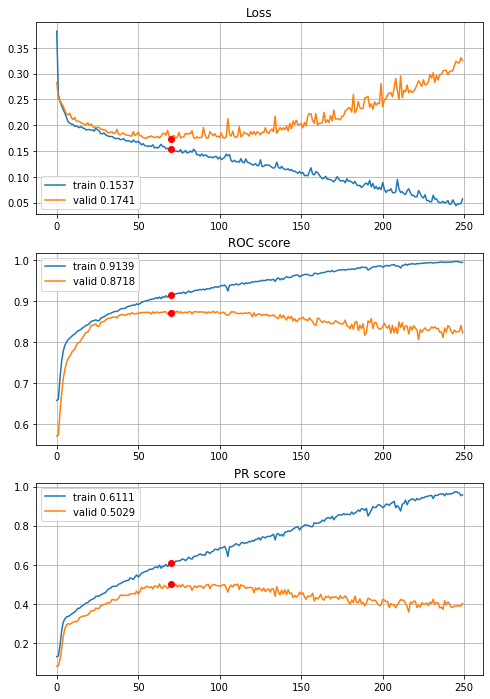


Fold 2------------------------------------------------------------


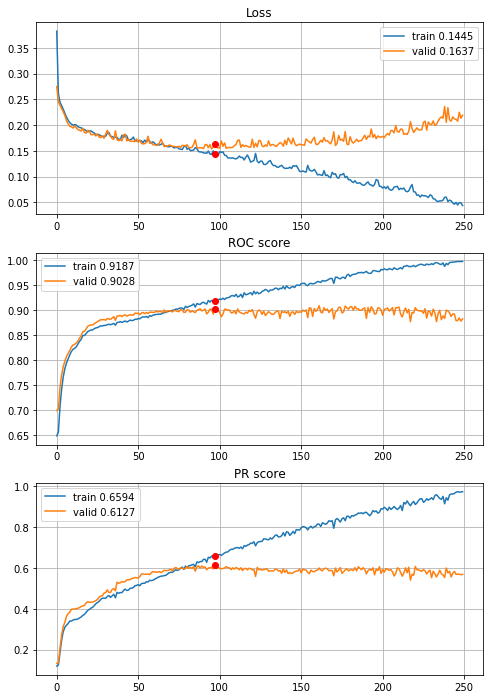


Fold 3------------------------------------------------------------


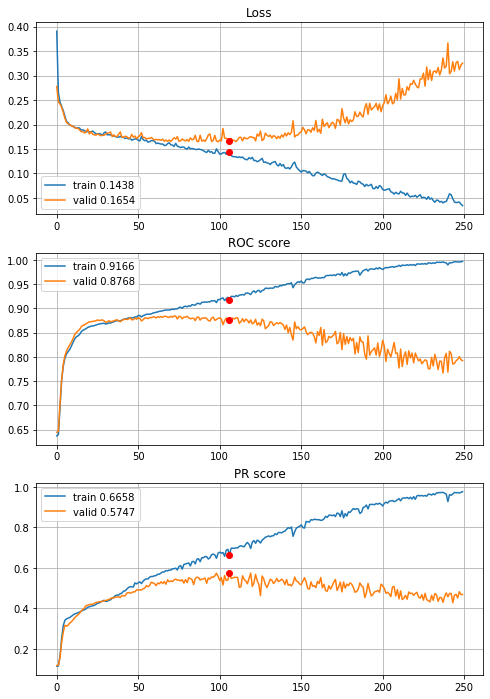


Fold 4------------------------------------------------------------


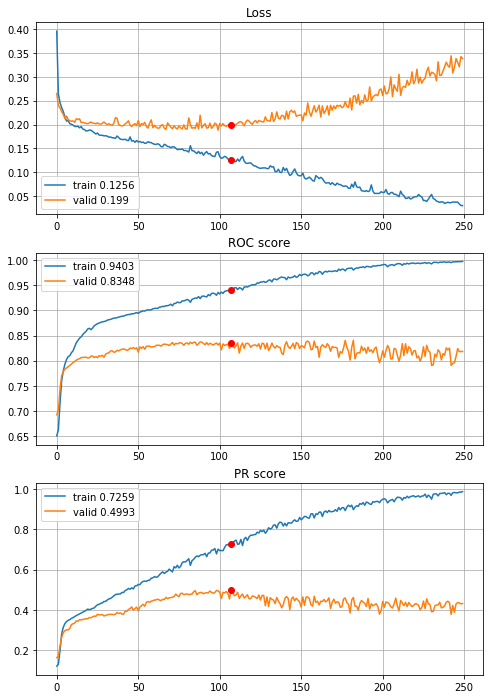


Fold 5------------------------------------------------------------


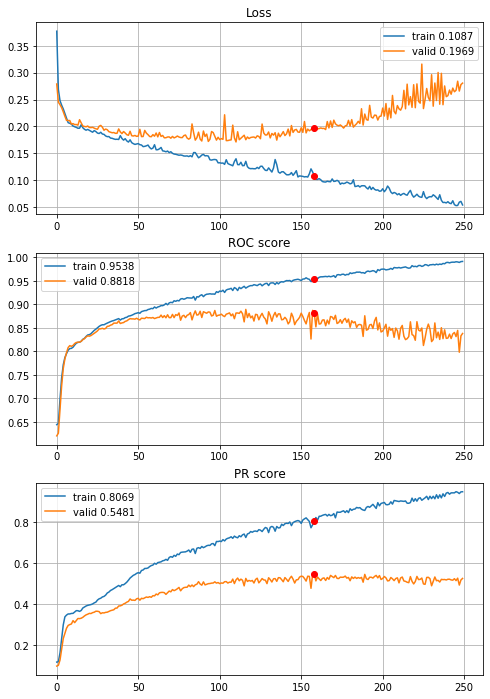


Fold 6------------------------------------------------------------


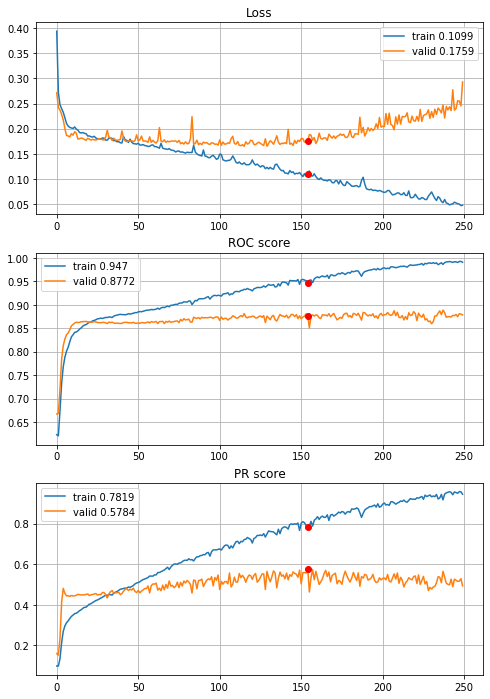

In [228]:
# the second best model
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_2dense_std, features=features,
                                        target=target, n_epochs=250, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Dropout on two dense layers

In [50]:
def define_deep_CNN_2inc_2dense_std_drop2(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu)(flat)                   # (256,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (128,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu)(dense)                  # (128,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (128,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/250,
cumulative time: 3.75s train loss: 0.37705743045206536, validation loss: 0.2905359668688683
Epoch: 2/250,
cumulative time: 4.8s train loss: 0.26323081771523726, validation loss: 0.25221159150393463
Epoch: 3/250,
cumulative time: 5.84s train loss: 0.24960669029894073, validation loss: 0.24487081465753385
Epoch: 4/250,
cumulative time: 6.88s train loss: 0.24132335983512634, validation loss: 0.23857539737641206
Epoch: 5/250,
cumulative time: 7.92s train loss: 0.2365987009506686, validation loss: 0.2338447166940674
Epoch: 6/250,
cumulative time: 8.95s train loss: 0.22519228326338292, validation loss: 0.22509140533887548
Epoch: 7/250,
cumulative time: 10.0s train loss: 0.21739764266146433, validation loss: 0.22143465490526654
Epoch: 8/250,
cumulative time: 11.05s train loss: 0.21295915172176455, validation loss: 0.21965982821237678
Epoch: 9/250,
cumulative time: 12.09s train loss: 0.20929021583298482

Epoch: 76/250,
cumulative time: 81.86s train loss: 0.16104952108437726, validation loss: 0.18101324337579755
Epoch: 77/250,
cumulative time: 82.91s train loss: 0.16547292326358468, validation loss: 0.17611440100624165
Epoch: 78/250,
cumulative time: 83.93s train loss: 0.1597201661593432, validation loss: 0.1741890479908183
Epoch: 79/250,
cumulative time: 84.96s train loss: 0.1589852441035023, validation loss: 0.17423601794605728
Epoch: 80/250,
cumulative time: 86.0s train loss: 0.16494054817981238, validation loss: 0.17706765654458
Epoch: 81/250,
cumulative time: 87.03s train loss: 0.16129483673250847, validation loss: 0.17817910796760034
Epoch: 82/250,
cumulative time: 88.07s train loss: 0.15309140488290185, validation loss: 0.17284654354699702
Epoch: 83/250,
cumulative time: 89.1s train loss: 0.15650010626050323, validation loss: 0.17262125309250131
Epoch: 84/250,
cumulative time: 90.13s train loss: 0.15600272932758938, validation loss: 0.17469743522474165
Epoch: 85/250,
cumulative t

Epoch: 151/250,
cumulative time: 159.64s train loss: 0.11844517811393157, validation loss: 0.18447686844372024
Epoch: 152/250,
cumulative time: 160.68s train loss: 0.11832358070148243, validation loss: 0.18726278025039556
Epoch: 153/250,
cumulative time: 161.7s train loss: 0.12249282657400795, validation loss: 0.18121017270386555
Epoch: 154/250,
cumulative time: 162.73s train loss: 0.11346247134938675, validation loss: 0.1860838380244297
Epoch: 155/250,
cumulative time: 163.76s train loss: 0.11644718897888699, validation loss: 0.19274496224109322
Epoch: 156/250,
cumulative time: 164.8s train loss: 0.1216680724610867, validation loss: 0.19893575000252234
Epoch: 157/250,
cumulative time: 165.85s train loss: 0.11712976577036109, validation loss: 0.19339479870565043
Epoch: 158/250,
cumulative time: 166.88s train loss: 0.11244555767827301, validation loss: 0.19946963440001078
Epoch: 159/250,
cumulative time: 167.91s train loss: 0.11636956784847304, validation loss: 0.19244594393211933
Epoch

Epoch: 226/250,
cumulative time: 237.18s train loss: 0.0763452628254218, validation loss: 0.25532702701806753
Epoch: 227/250,
cumulative time: 238.24s train loss: 0.07472806082809821, validation loss: 0.2459756676548632
Epoch: 228/250,
cumulative time: 239.28s train loss: 0.07221806438182504, validation loss: 0.2423026887479468
Epoch: 229/250,
cumulative time: 240.35s train loss: 0.07113137355222222, validation loss: 0.24209496229383023
Epoch: 230/250,
cumulative time: 241.43s train loss: 0.07039127074894815, validation loss: 0.24274404419180776
Epoch: 231/250,
cumulative time: 242.45s train loss: 0.07220421335575866, validation loss: 0.24826273123871245
Epoch: 232/250,
cumulative time: 243.49s train loss: 0.07975142823686884, validation loss: 0.243812315762379
Epoch: 233/250,
cumulative time: 244.52s train loss: 0.07198421184699781, validation loss: 0.23996282357978713
Epoch: 234/250,
cumulative time: 245.6s train loss: 0.07475061875529292, validation loss: 0.2549164135769228
Epoch: 2

Epoch: 49/250,
cumulative time: 55.02s train loss: 0.18027611689420167, validation loss: 0.17221241934054868
Epoch: 50/250,
cumulative time: 56.08s train loss: 0.18041568183565398, validation loss: 0.1704989724961585
Epoch: 51/250,
cumulative time: 57.13s train loss: 0.18131855188697468, validation loss: 0.17563335997343332
Epoch: 52/250,
cumulative time: 58.19s train loss: 0.17732407179213927, validation loss: 0.17743537209617244
Epoch: 53/250,
cumulative time: 59.25s train loss: 0.17799643995341197, validation loss: 0.17048266449399302
Epoch: 54/250,
cumulative time: 60.3s train loss: 0.17708711458591994, validation loss: 0.1706077830095302
Epoch: 55/250,
cumulative time: 61.36s train loss: 0.17940543852208538, validation loss: 0.17188704889078688
Epoch: 56/250,
cumulative time: 62.44s train loss: 0.17875756884148405, validation loss: 0.17122113190616534
Epoch: 57/250,
cumulative time: 63.49s train loss: 0.18037568911614185, validation loss: 0.1713889228450943
Epoch: 58/250,
cumulati

Epoch: 125/250,
cumulative time: 135.52s train loss: 0.14082203274559135, validation loss: 0.15790747030477514
Epoch: 126/250,
cumulative time: 136.6s train loss: 0.13888256000993698, validation loss: 0.16109240446512701
Epoch: 127/250,
cumulative time: 137.65s train loss: 0.1398458601167217, validation loss: 0.15992915401867305
Epoch: 128/250,
cumulative time: 138.69s train loss: 0.13836416988784872, validation loss: 0.15868852614281276
Epoch: 129/250,
cumulative time: 139.73s train loss: 0.13607170890061865, validation loss: 0.15960276420852915
Epoch: 130/250,
cumulative time: 140.78s train loss: 0.13981198966973848, validation loss: 0.15739707077570939
Epoch: 131/250,
cumulative time: 141.84s train loss: 0.1406781112015355, validation loss: 0.15855511314032983
Epoch: 132/250,
cumulative time: 142.88s train loss: 0.14324992915635612, validation loss: 0.15904920980787868
Epoch: 133/250,
cumulative time: 143.94s train loss: 0.13539030386760348, validation loss: 0.15698013052327522
Epoc

Epoch: 200/250,
cumulative time: 214.38s train loss: 0.09686580894427502, validation loss: 0.17038398330953505
Epoch: 201/250,
cumulative time: 215.43s train loss: 0.09592577844138664, validation loss: 0.16595611675078598
Epoch: 202/250,
cumulative time: 216.49s train loss: 0.0989093485957395, validation loss: 0.1664223119431714
Epoch: 203/250,
cumulative time: 217.54s train loss: 0.09564283346952299, validation loss: 0.1586945192823281
Epoch: 204/250,
cumulative time: 218.58s train loss: 0.09936243111422347, validation loss: 0.15936506684898927
Epoch: 205/250,
cumulative time: 219.63s train loss: 0.0955614906732356, validation loss: 0.16570438397575796
Epoch: 206/250,
cumulative time: 220.67s train loss: 0.09483888639567507, validation loss: 0.1611253598194649
Epoch: 207/250,
cumulative time: 221.74s train loss: 0.09006865508181953, validation loss: 0.1640582545634187
Epoch: 208/250,
cumulative time: 222.77s train loss: 0.09354208044990198, validation loss: 0.1770574669894398
Epoch: 2

Epoch: 23/250,
cumulative time: 28.83s train loss: 0.1878577788000664, validation loss: 0.17965287453964301
Epoch: 24/250,
cumulative time: 29.88s train loss: 0.18706795059494163, validation loss: 0.17760797305265705
Epoch: 25/250,
cumulative time: 30.96s train loss: 0.1867081151286725, validation loss: 0.17657963138623867
Epoch: 26/250,
cumulative time: 32.02s train loss: 0.18670935727763477, validation loss: 0.17754455030031646
Epoch: 27/250,
cumulative time: 33.09s train loss: 0.18667660639470018, validation loss: 0.1759497278203018
Epoch: 28/250,
cumulative time: 34.17s train loss: 0.18342175503473204, validation loss: 0.17646142800066625
Epoch: 29/250,
cumulative time: 35.24s train loss: 0.18394039240447194, validation loss: 0.1761408520961157
Epoch: 30/250,
cumulative time: 36.32s train loss: 0.1803355284727814, validation loss: 0.17947383305601766
Epoch: 31/250,
cumulative time: 37.39s train loss: 0.1814542449002124, validation loss: 0.1757847075061841
Epoch: 32/250,
cumulative 

Epoch: 99/250,
cumulative time: 111.31s train loss: 0.15149264313979915, validation loss: 0.16788651364967816
Epoch: 100/250,
cumulative time: 112.39s train loss: 0.1516126077655797, validation loss: 0.17745144745878866
Epoch: 101/250,
cumulative time: 113.45s train loss: 0.15157824924168603, validation loss: 0.16856584606404504
Epoch: 102/250,
cumulative time: 114.53s train loss: 0.1464116060601998, validation loss: 0.1692057986068618
Epoch: 103/250,
cumulative time: 115.66s train loss: 0.1495660636843004, validation loss: 0.17440994167878904
Epoch: 104/250,
cumulative time: 116.73s train loss: 0.14896335281324086, validation loss: 0.16824033748875072
Epoch: 105/250,
cumulative time: 117.82s train loss: 0.14383176184303062, validation loss: 0.17486774855899165
Epoch: 106/250,
cumulative time: 118.9s train loss: 0.1466327841807197, validation loss: 0.1684135186161506
Epoch: 107/250,
cumulative time: 120.01s train loss: 0.15106686911064904, validation loss: 0.1733478974160374
Epoch: 108

Epoch: 174/250,
cumulative time: 192.08s train loss: 0.09457501146054763, validation loss: 0.18949397472746612
Epoch: 175/250,
cumulative time: 193.15s train loss: 0.09391797680596044, validation loss: 0.19752045192471218
Epoch: 176/250,
cumulative time: 194.22s train loss: 0.08772922653220729, validation loss: 0.20947450223004
Epoch: 177/250,
cumulative time: 195.3s train loss: 0.09156740470436345, validation loss: 0.19106338464622433
Epoch: 178/250,
cumulative time: 196.36s train loss: 0.09690056341811208, validation loss: 0.1919451736778928
Epoch: 179/250,
cumulative time: 197.42s train loss: 0.0979974545262727, validation loss: 0.19726790719599438
Epoch: 180/250,
cumulative time: 198.49s train loss: 0.0904415953763179, validation loss: 0.20154823875212213
Epoch: 181/250,
cumulative time: 199.56s train loss: 0.09340665593494524, validation loss: 0.19622409657870232
Epoch: 182/250,
cumulative time: 200.63s train loss: 0.0895243929867172, validation loss: 0.20378730115989957
Epoch: 18

Epoch: 249/250,
cumulative time: 272.86s train loss: 0.049494399229360456, validation loss: 0.2722944408957558
Epoch: 250/250,
cumulative time: 273.93s train loss: 0.05388225335964012, validation loss: 0.2783272075545559

Early stopping results:
best results in epoch: 152, 
best valid PR: 0.5602971302359024, 
valid ROC: 0.8811339198435972        
overfitting PR: 0.24541877653282262, 
overfitting ROC: 0.08123741566128884

----------
Fold: 4
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/250,
cumulative time: 4.47s train loss: 0.3731313779758541, validation loss: 0.2835617064756949
Epoch: 2/250,
cumulative time: 5.59s train loss: 0.26605587385925944, validation loss: 0.2450908582918262
Epoch: 3/250,
cumulative time: 6.69s train loss: 0.25260428941440777, validation loss: 0.23263022414583115
Epoch: 4/250,
cumulative time: 7.79s train loss: 0.24358362811240444, validation loss: 0.22642491643504148
Epoch: 5/250,
cumulative time: 8.9s train loss: 0.234957885596302, valida

Epoch: 73/250,
cumulative time: 84.37s train loss: 0.15624459636431903, validation loss: 0.19732690301490421
Epoch: 74/250,
cumulative time: 85.47s train loss: 0.1593267846774388, validation loss: 0.19482715851700871
Epoch: 75/250,
cumulative time: 86.58s train loss: 0.15829305936675456, validation loss: 0.19623956935265802
Epoch: 76/250,
cumulative time: 87.66s train loss: 0.15804525291492136, validation loss: 0.20287764365059527
Epoch: 77/250,
cumulative time: 88.77s train loss: 0.16069958430265105, validation loss: 0.19919515833359538
Epoch: 78/250,
cumulative time: 89.85s train loss: 0.16363668901782366, validation loss: 0.19422110884910782
Epoch: 79/250,
cumulative time: 90.96s train loss: 0.1535689439679171, validation loss: 0.19522737652803382
Epoch: 80/250,
cumulative time: 92.05s train loss: 0.15474629715612773, validation loss: 0.1995137621802078
Epoch: 81/250,
cumulative time: 93.16s train loss: 0.15394507951911782, validation loss: 0.19798747905893735
Epoch: 82/250,
cumulat

Epoch: 148/250,
cumulative time: 167.67s train loss: 0.10853697801252103, validation loss: 0.21456188824591196
Epoch: 149/250,
cumulative time: 168.8s train loss: 0.10777734430116481, validation loss: 0.21521202590879954
Epoch: 150/250,
cumulative time: 169.92s train loss: 0.10400693145799712, validation loss: 0.21472362057215474
Epoch: 151/250,
cumulative time: 171.02s train loss: 0.11109072621764703, validation loss: 0.22515778243541718
Epoch: 152/250,
cumulative time: 172.12s train loss: 0.10839200952293479, validation loss: 0.21597329552367364
Epoch: 153/250,
cumulative time: 173.22s train loss: 0.10064008774497615, validation loss: 0.21882978703986442
Epoch: 154/250,
cumulative time: 174.36s train loss: 0.10166186447400904, validation loss: 0.2253085609954313
Epoch: 155/250,
cumulative time: 175.46s train loss: 0.10571553662483187, validation loss: 0.21778852282340047
Epoch: 156/250,
cumulative time: 176.55s train loss: 0.10338470297421232, validation loss: 0.2180776675452497
Epoc

Epoch: 223/250,
cumulative time: 250.32s train loss: 0.06329727039193223, validation loss: 0.27922828670414523
Epoch: 224/250,
cumulative time: 251.43s train loss: 0.06176908834659432, validation loss: 0.29013908148215534
Epoch: 225/250,
cumulative time: 252.51s train loss: 0.0596398738154689, validation loss: 0.305916438051594
Epoch: 226/250,
cumulative time: 253.61s train loss: 0.062438730210126345, validation loss: 0.28876528150610137
Epoch: 227/250,
cumulative time: 254.72s train loss: 0.056088998212909524, validation loss: 0.2914391751684938
Epoch: 228/250,
cumulative time: 255.82s train loss: 0.05978292055359119, validation loss: 0.2966813986309495
Epoch: 229/250,
cumulative time: 256.91s train loss: 0.05916374403804359, validation loss: 0.28999151743561635
Epoch: 230/250,
cumulative time: 258.02s train loss: 0.05710788522929982, validation loss: 0.3020464307029414
Epoch: 231/250,
cumulative time: 259.1s train loss: 0.05379472708696373, validation loss: 0.2912916728793633
Epoch: 

Epoch: 46/250,
cumulative time: 57.11s train loss: 0.17941235460991412, validation loss: 0.18198168338286957
Epoch: 47/250,
cumulative time: 58.27s train loss: 0.17487448195074096, validation loss: 0.1810057822858776
Epoch: 48/250,
cumulative time: 59.45s train loss: 0.17270024329215497, validation loss: 0.18165804960388632
Epoch: 49/250,
cumulative time: 60.61s train loss: 0.17581070691326953, validation loss: 0.18172537463109595
Epoch: 50/250,
cumulative time: 61.76s train loss: 0.16952830375235856, validation loss: 0.18075264331045862
Epoch: 51/250,
cumulative time: 62.91s train loss: 0.17124796280426874, validation loss: 0.18241068569451369
Epoch: 52/250,
cumulative time: 64.08s train loss: 0.1706125548232524, validation loss: 0.1837496375055399
Epoch: 53/250,
cumulative time: 65.26s train loss: 0.1732090795662665, validation loss: 0.18290324246775755
Epoch: 54/250,
cumulative time: 66.42s train loss: 0.17081919402899226, validation loss: 0.182267288961206
Epoch: 55/250,
cumulative

Epoch: 122/250,
cumulative time: 145.63s train loss: 0.1318861196460881, validation loss: 0.17743841849654307
Epoch: 123/250,
cumulative time: 146.8s train loss: 0.12913109479690954, validation loss: 0.17712833784503806
Epoch: 124/250,
cumulative time: 147.97s train loss: 0.13102245873343238, validation loss: 0.18038225288315768
Epoch: 125/250,
cumulative time: 149.12s train loss: 0.13133204663321527, validation loss: 0.17595852894653854
Epoch: 126/250,
cumulative time: 150.3s train loss: 0.13207524058218065, validation loss: 0.1732216789881209
Epoch: 127/250,
cumulative time: 151.46s train loss: 0.1314598805790638, validation loss: 0.17534171926114145
Epoch: 128/250,
cumulative time: 152.62s train loss: 0.12671193135946404, validation loss: 0.17732599542453112
Epoch: 129/250,
cumulative time: 153.78s train loss: 0.1260402478780215, validation loss: 0.19039255404176347
Epoch: 130/250,
cumulative time: 154.95s train loss: 0.12984507299830245, validation loss: 0.18510489572789815
Epoch: 

Epoch: 197/250,
cumulative time: 232.89s train loss: 0.09364881741625446, validation loss: 0.20219913061127975
Epoch: 198/250,
cumulative time: 234.07s train loss: 0.08804854224571493, validation loss: 0.20724259811384146
Epoch: 199/250,
cumulative time: 235.22s train loss: 0.08958144369141233, validation loss: 0.20842435925728042
Epoch: 200/250,
cumulative time: 236.39s train loss: 0.08443414172825307, validation loss: 0.2120995328133047
Epoch: 201/250,
cumulative time: 237.55s train loss: 0.0904837064403001, validation loss: 0.2062540134377189
Epoch: 202/250,
cumulative time: 238.7s train loss: 0.08670865895700137, validation loss: 0.2028527348964532
Epoch: 203/250,
cumulative time: 239.95s train loss: 0.0874024928322017, validation loss: 0.2151218431730572
Epoch: 204/250,
cumulative time: 241.15s train loss: 0.08888500958123112, validation loss: 0.21813331715947618
Epoch: 205/250,
cumulative time: 242.32s train loss: 0.09490212317267901, validation loss: 0.20633444603759601
Epoch: 2

Epoch: 20/250,
cumulative time: 29.44s train loss: 0.1932480855448478, validation loss: 0.17726162472912205
Epoch: 21/250,
cumulative time: 30.65s train loss: 0.19266957888317088, validation loss: 0.17951211847919912
Epoch: 22/250,
cumulative time: 31.89s train loss: 0.1930024067623578, validation loss: 0.1790074386526715
Epoch: 23/250,
cumulative time: 33.11s train loss: 0.18802472785999294, validation loss: 0.17691875183555397
Epoch: 24/250,
cumulative time: 34.35s train loss: 0.1898404446306762, validation loss: 0.17929019437552038
Epoch: 25/250,
cumulative time: 35.57s train loss: 0.19035623367970775, validation loss: 0.17919385080009229
Epoch: 26/250,
cumulative time: 36.79s train loss: 0.18669225624599656, validation loss: 0.17695172521249974
Epoch: 27/250,
cumulative time: 38.04s train loss: 0.18794461303576912, validation loss: 0.1762313214099165
Epoch: 28/250,
cumulative time: 39.26s train loss: 0.1839632346516884, validation loss: 0.1788228735092262
Epoch: 29/250,
cumulative 

Epoch: 96/250,
cumulative time: 123.35s train loss: 0.15183955718721784, validation loss: 0.1704513097589764
Epoch: 97/250,
cumulative time: 124.59s train loss: 0.144699508325526, validation loss: 0.1663732124034223
Epoch: 98/250,
cumulative time: 125.82s train loss: 0.1495027603359274, validation loss: 0.16701649876130623
Epoch: 99/250,
cumulative time: 127.06s train loss: 0.1456920689733658, validation loss: 0.16611033264320538
Epoch: 100/250,
cumulative time: 128.28s train loss: 0.14760255631661942, validation loss: 0.16621190440708575
Epoch: 101/250,
cumulative time: 129.51s train loss: 0.1442851598842833, validation loss: 0.1711809240601133
Epoch: 102/250,
cumulative time: 130.75s train loss: 0.14827524430792674, validation loss: 0.16689144566016056
Epoch: 103/250,
cumulative time: 131.96s train loss: 0.14545581268788244, validation loss: 0.16794464651402716
Epoch: 104/250,
cumulative time: 133.2s train loss: 0.14425508823844937, validation loss: 0.16763556884858194
Epoch: 105/250

Epoch: 171/250,
cumulative time: 215.94s train loss: 0.10287705204243076, validation loss: 0.18234518947369896
Epoch: 172/250,
cumulative time: 217.18s train loss: 0.1052733793310164, validation loss: 0.17662971414642464
Epoch: 173/250,
cumulative time: 218.43s train loss: 0.0974109764161509, validation loss: 0.1843635434154463
Epoch: 174/250,
cumulative time: 219.67s train loss: 0.0965172259682004, validation loss: 0.18283872286164735
Epoch: 175/250,
cumulative time: 220.88s train loss: 0.09811116403404488, validation loss: 0.18948454717615656
Epoch: 176/250,
cumulative time: 222.1s train loss: 0.09780700921763584, validation loss: 0.1856635716443137
Epoch: 177/250,
cumulative time: 223.33s train loss: 0.0953693608233414, validation loss: 0.18053215533562222
Epoch: 178/250,
cumulative time: 224.57s train loss: 0.10069249169352683, validation loss: 0.19315125515713918
Epoch: 179/250,
cumulative time: 225.8s train loss: 0.10345444381875699, validation loss: 0.18391585878136466
Epoch: 18

Epoch: 246/250,
cumulative time: 308.61s train loss: 0.05641881614073039, validation loss: 0.22125629754421675
Epoch: 247/250,
cumulative time: 309.87s train loss: 0.0560300382374776, validation loss: 0.22551316288604692
Epoch: 248/250,
cumulative time: 311.12s train loss: 0.05534556509408837, validation loss: 0.22134683064225028
Epoch: 249/250,
cumulative time: 312.34s train loss: 0.05646130557327676, validation loss: 0.22714301321495736
Epoch: 250/250,
cumulative time: 313.58s train loss: 0.06053839437873644, validation loss: 0.2347326147502486

Early stopping results:
best results in epoch: 151, 
best valid PR: 0.5730882540717349, 
valid ROC: 0.8769200198708396        
overfitting PR: 0.2093268452016387, 
overfitting ROC: 0.08028226269507954

Cross validation time: 1719s
ROC: 		0.8809047641940291
PR: 		0.5432284938185866
overfittingROC: 0.082759749080345
overfittingPR:  0.2709236092320254
early stopping: [114, 202, 152, 158, 225, 151]

Fold 1-----------------------------------------

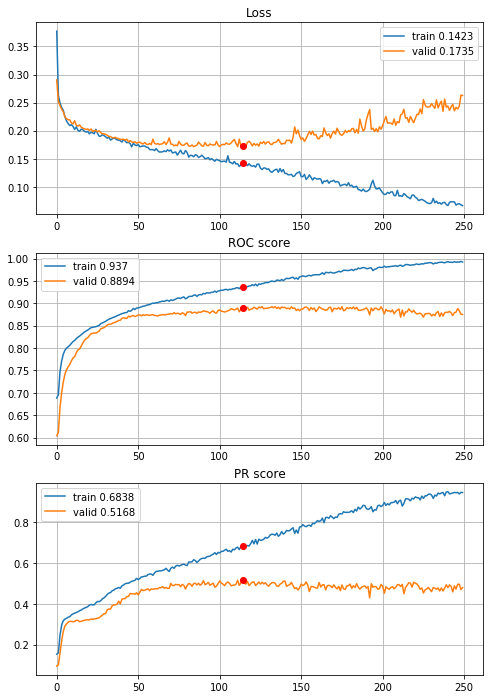


Fold 2------------------------------------------------------------


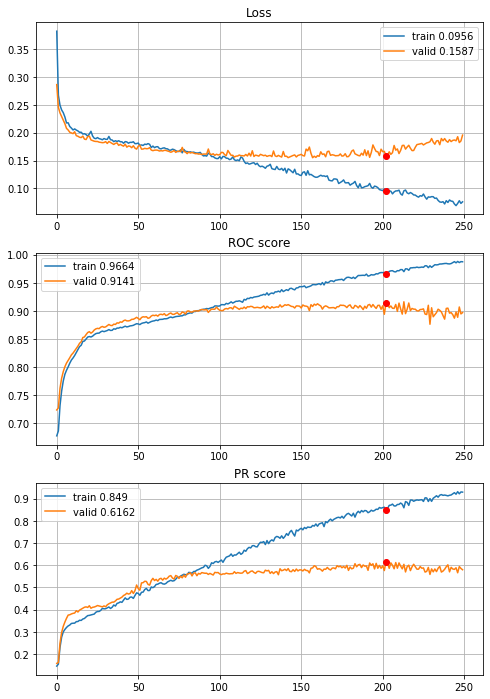


Fold 3------------------------------------------------------------


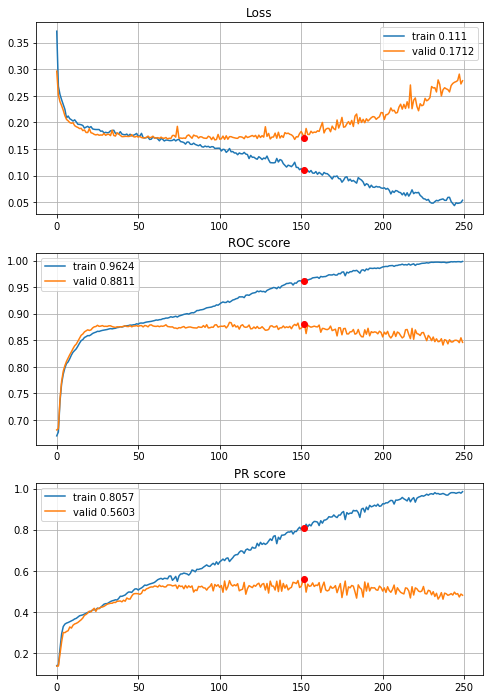


Fold 4------------------------------------------------------------


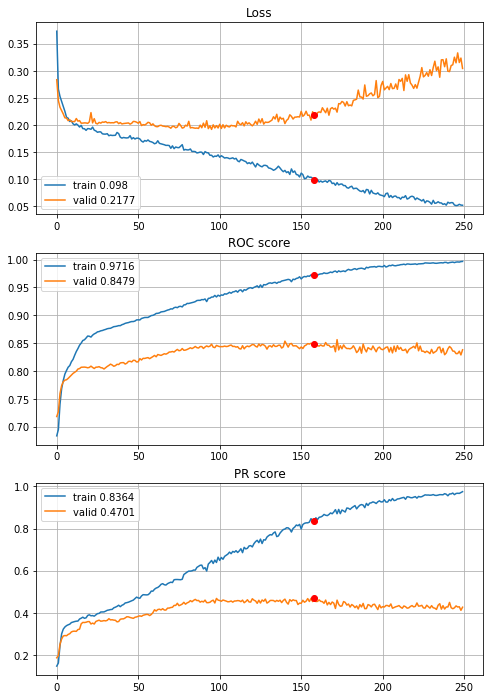


Fold 5------------------------------------------------------------


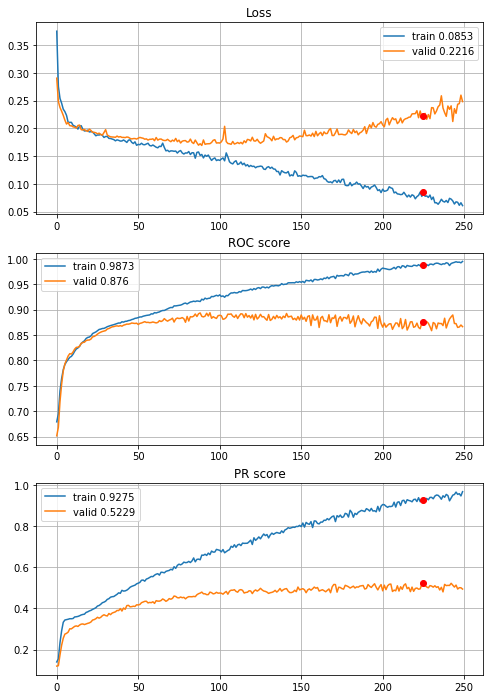


Fold 6------------------------------------------------------------


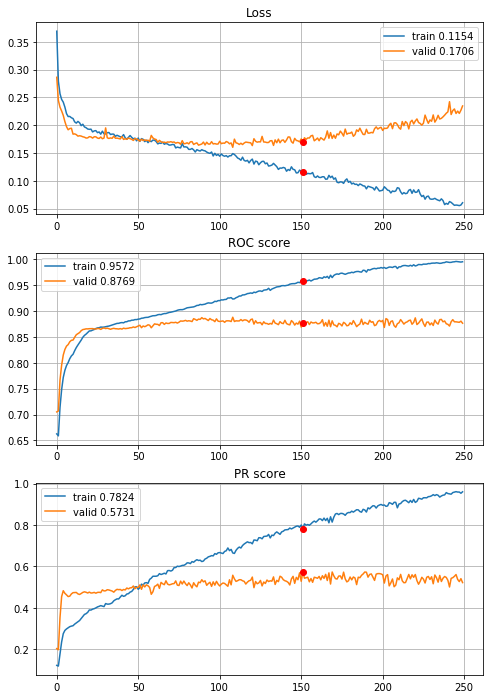

In [236]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_2dense_std_drop2, features=features,
                                        target=target, n_epochs=250, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Dropout didn't help lets apply one convolutional layer berfore first inception

In [51]:
def define_deep_CNN_1conv_2inc_2dense_std(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    conv = layers.Conv2D(filters=8, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)                            # (8,8,8)
    inception = inception_module(prev_layer=conv, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu)(flat)                   # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu)(dense)                  # (128,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/250,
cumulative time: 3.68s train loss: 0.4331147510773546, validation loss: 0.27971102695454336
Epoch: 2/250,
cumulative time: 4.59s train loss: 0.26043883077665786, validation loss: 0.24006485535837752
Epoch: 3/250,
cumulative time: 5.48s train loss: 0.22782998772116128, validation loss: 0.22652385063813799
Epoch: 4/250,
cumulative time: 6.39s train loss: 0.21249226675056163, validation loss: 0.21341370472846197
Epoch: 5/250,
cumulative time: 7.28s train loss: 0.20110641986750308, validation loss: 0.21051302458145976
Epoch: 6/250,
cumulative time: 8.23s train loss: 0.20189729228024017, validation loss: 0.21239852663360562
Epoch: 7/250,
cumulative time: 9.14s train loss: 0.2004880269700224, validation loss: 0.20819718166429807
Epoch: 8/250,
cumulative time: 10.04s train loss: 0.19853028546117704, validation loss: 0.20567272996620234
Epoch: 9/250,
cumulative time: 10.94s train loss: 0.195656392208909

Epoch: 77/250,
cumulative time: 74.62s train loss: 0.1081083540935809, validation loss: 0.19140054401442863
Epoch: 78/250,
cumulative time: 75.52s train loss: 0.10470578750252509, validation loss: 0.21184109158083175
Epoch: 79/250,
cumulative time: 76.45s train loss: 0.1049938322774501, validation loss: 0.20355249709515857
Epoch: 80/250,
cumulative time: 77.37s train loss: 0.10329630530173706, validation loss: 0.20609645249811342
Epoch: 81/250,
cumulative time: 78.35s train loss: 0.09953398680119416, validation loss: 0.21471149696975847
Epoch: 82/250,
cumulative time: 79.28s train loss: 0.09786565657637825, validation loss: 0.207976960023737
Epoch: 83/250,
cumulative time: 80.21s train loss: 0.09787862198528184, validation loss: 0.2190007015709947
Epoch: 84/250,
cumulative time: 81.14s train loss: 0.09421647409320093, validation loss: 0.22324823494895604
Epoch: 85/250,
cumulative time: 82.05s train loss: 0.1008231927428919, validation loss: 0.24329032946331794
Epoch: 86/250,
cumulative

Epoch: 152/250,
cumulative time: 142.72s train loss: 0.031327448982412555, validation loss: 0.3306562186564238
Epoch: 153/250,
cumulative time: 143.63s train loss: 0.028952912560290915, validation loss: 0.35105091655939785
Epoch: 154/250,
cumulative time: 144.52s train loss: 0.026596639061595453, validation loss: 0.35609751634022563
Epoch: 155/250,
cumulative time: 145.42s train loss: 0.025138672223963543, validation loss: 0.35241882760065113
Epoch: 156/250,
cumulative time: 146.31s train loss: 0.026915681620703385, validation loss: 0.42333556061532884
Epoch: 157/250,
cumulative time: 147.19s train loss: 0.042287844941793315, validation loss: 0.36223124046605226
Epoch: 158/250,
cumulative time: 148.08s train loss: 0.03409072233192515, validation loss: 0.350300368085386
Epoch: 159/250,
cumulative time: 148.96s train loss: 0.027813532988587897, validation loss: 0.3537114422848152
Epoch: 160/250,
cumulative time: 149.86s train loss: 0.027022337814581174, validation loss: 0.364946956430239

Epoch: 226/250,
cumulative time: 209.04s train loss: 0.01646320249516322, validation loss: 0.5675363296720597
Epoch: 227/250,
cumulative time: 209.94s train loss: 0.018956008709762044, validation loss: 0.577902062568213
Epoch: 228/250,
cumulative time: 210.82s train loss: 0.025980283044125644, validation loss: 0.6165656384916424
Epoch: 229/250,
cumulative time: 211.71s train loss: 0.02225284305794521, validation loss: 0.5321100653897816
Epoch: 230/250,
cumulative time: 212.6s train loss: 0.012228902458341032, validation loss: 0.5316955118598637
Epoch: 231/250,
cumulative time: 213.48s train loss: 0.012286988855465667, validation loss: 0.5479624312383615
Epoch: 232/250,
cumulative time: 214.37s train loss: 0.015781673297642424, validation loss: 0.5859666623956321
Epoch: 233/250,
cumulative time: 215.26s train loss: 0.016069711417771727, validation loss: 0.5504423039876084
Epoch: 234/250,
cumulative time: 216.15s train loss: 0.008937948296499684, validation loss: 0.5935926362116146
Epoch

Epoch: 49/250,
cumulative time: 48.56s train loss: 0.14662582489463505, validation loss: 0.17425672607464882
Epoch: 50/250,
cumulative time: 49.48s train loss: 0.14719736031407915, validation loss: 0.1831421167867966
Epoch: 51/250,
cumulative time: 50.37s train loss: 0.1464681284945956, validation loss: 0.1730387606978282
Epoch: 52/250,
cumulative time: 51.29s train loss: 0.14376707921739304, validation loss: 0.18546591336254067
Epoch: 53/250,
cumulative time: 52.31s train loss: 0.14316469707294277, validation loss: 0.1755469062921025
Epoch: 54/250,
cumulative time: 53.25s train loss: 0.14317210601636005, validation loss: 0.17607810582625422
Epoch: 55/250,
cumulative time: 54.22s train loss: 0.14361195724847514, validation loss: 0.17551643222469623
Epoch: 56/250,
cumulative time: 55.16s train loss: 0.14115324144718988, validation loss: 0.17500147216752793
Epoch: 57/250,
cumulative time: 56.12s train loss: 0.14556506800293814, validation loss: 0.1949736853765393
Epoch: 58/250,
cumulativ

Epoch: 125/250,
cumulative time: 117.98s train loss: 0.06043827208935784, validation loss: 0.20123808099358031
Epoch: 126/250,
cumulative time: 118.88s train loss: 0.06448844343168318, validation loss: 0.20513111549474744
Epoch: 127/250,
cumulative time: 119.78s train loss: 0.05887798007429722, validation loss: 0.20885747209140923
Epoch: 128/250,
cumulative time: 120.67s train loss: 0.060197714196739964, validation loss: 0.2240800361454554
Epoch: 129/250,
cumulative time: 121.57s train loss: 0.06292332151975308, validation loss: 0.20436470865732922
Epoch: 130/250,
cumulative time: 122.47s train loss: 0.05601545974666031, validation loss: 0.22307205742819333
Epoch: 131/250,
cumulative time: 123.37s train loss: 0.0631093729038585, validation loss: 0.21019677901819028
Epoch: 132/250,
cumulative time: 124.26s train loss: 0.058401351273463305, validation loss: 0.20854759352384586
Epoch: 133/250,
cumulative time: 125.17s train loss: 0.05483208253260177, validation loss: 0.21686888779298294
E

Epoch: 199/250,
cumulative time: 185.25s train loss: 0.01412613494094757, validation loss: 0.35528262878485706
Epoch: 200/250,
cumulative time: 186.16s train loss: 0.016815300624051035, validation loss: 0.3834572306413124
Epoch: 201/250,
cumulative time: 187.06s train loss: 0.017799220802909643, validation loss: 0.3433321464088616
Epoch: 202/250,
cumulative time: 188.0s train loss: 0.01401359595041907, validation loss: 0.37726235853375817
Epoch: 203/250,
cumulative time: 188.92s train loss: 0.0124655579973688, validation loss: 0.36311088816557824
Epoch: 204/250,
cumulative time: 189.82s train loss: 0.01474038124360171, validation loss: 0.3721054196693717
Epoch: 205/250,
cumulative time: 190.72s train loss: 0.0168098755023654, validation loss: 0.3536638355443281
Epoch: 206/250,
cumulative time: 191.64s train loss: 0.01531131603143141, validation loss: 0.37893119205751175
Epoch: 207/250,
cumulative time: 192.57s train loss: 0.010746568672960819, validation loss: 0.35247640064765257
Epoch

Epoch: 21/250,
cumulative time: 21.57s train loss: 0.19082021498077614, validation loss: 0.1861547088038424
Epoch: 22/250,
cumulative time: 22.48s train loss: 0.19008928296637018, validation loss: 0.18842044136704292
Epoch: 23/250,
cumulative time: 23.4s train loss: 0.18835389225101534, validation loss: 0.18495072909917476
Epoch: 24/250,
cumulative time: 24.31s train loss: 0.18385242223941353, validation loss: 0.18269771077116823
Epoch: 25/250,
cumulative time: 25.23s train loss: 0.1832863385536933, validation loss: 0.1850410066335016
Epoch: 26/250,
cumulative time: 26.13s train loss: 0.18252941596889968, validation loss: 0.18390300391155812
Epoch: 27/250,
cumulative time: 27.04s train loss: 0.18182000273751223, validation loss: 0.18161229105517185
Epoch: 28/250,
cumulative time: 27.94s train loss: 0.17979482681043313, validation loss: 0.1787669289071772
Epoch: 29/250,
cumulative time: 28.86s train loss: 0.17692586309562305, validation loss: 0.17745452000430903
Epoch: 30/250,
cumulativ

Epoch: 97/250,
cumulative time: 90.97s train loss: 0.09337909389556208, validation loss: 0.21337067533238227
Epoch: 98/250,
cumulative time: 91.89s train loss: 0.09461330981851163, validation loss: 0.23065517192628768
Epoch: 99/250,
cumulative time: 92.81s train loss: 0.10121297174963818, validation loss: 0.21665095064994852
Epoch: 100/250,
cumulative time: 93.72s train loss: 0.09445882139858598, validation loss: 0.21146619523189786
Epoch: 101/250,
cumulative time: 94.62s train loss: 0.0900600059294152, validation loss: 0.22708838526264521
Epoch: 102/250,
cumulative time: 95.53s train loss: 0.10092917469494879, validation loss: 0.23918685174243695
Epoch: 103/250,
cumulative time: 96.43s train loss: 0.10519537787265834, validation loss: 0.23027782464712826
Epoch: 104/250,
cumulative time: 97.34s train loss: 0.09275896787401355, validation loss: 0.20789603600037004
Epoch: 105/250,
cumulative time: 98.25s train loss: 0.08677876836011718, validation loss: 0.2284970963888265
Epoch: 106/250,

Epoch: 172/250,
cumulative time: 159.39s train loss: 0.042198639790887275, validation loss: 0.315082749694149
Epoch: 173/250,
cumulative time: 160.29s train loss: 0.03298096685621565, validation loss: 0.3075939274761561
Epoch: 174/250,
cumulative time: 161.19s train loss: 0.029280748040102663, validation loss: 0.3363567672695087
Epoch: 175/250,
cumulative time: 162.12s train loss: 0.03009753849438059, validation loss: 0.318995012237093
Epoch: 176/250,
cumulative time: 163.03s train loss: 0.030716831189839148, validation loss: 0.35009743236299296
Epoch: 177/250,
cumulative time: 163.93s train loss: 0.030241044546269042, validation loss: 0.32128322584787644
Epoch: 178/250,
cumulative time: 164.84s train loss: 0.03072486102575981, validation loss: 0.33069423586970115
Epoch: 179/250,
cumulative time: 165.75s train loss: 0.03967621177266813, validation loss: 0.33599522775364565
Epoch: 180/250,
cumulative time: 166.65s train loss: 0.0363325649878306, validation loss: 0.32447066847675954
Epoc

Epoch: 246/250,
cumulative time: 227.28s train loss: 0.014081305732390767, validation loss: 0.5073013379581885
Epoch: 247/250,
cumulative time: 228.18s train loss: 0.012031638196506454, validation loss: 0.4910142777871924
Epoch: 248/250,
cumulative time: 229.09s train loss: 0.010165880070784925, validation loss: 0.48530068402225834
Epoch: 249/250,
cumulative time: 230.0s train loss: 0.007684982603244376, validation loss: 0.4875294465693438
Epoch: 250/250,
cumulative time: 230.94s train loss: 0.008113028443462992, validation loss: 0.48648416360980895

Early stopping results:
best results in epoch: 47, 
best valid PR: 0.4681484075961909, 
valid ROC: 0.8848093841642228        
overfitting PR: 0.11510489968407644, 
overfitting ROC: 0.025835961803598706

----------
Fold: 4
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/250,
cumulative time: 3.42s train loss: 0.4323204247738528, validation loss: 0.2676182385559276
Epoch: 2/250,
cumulative time: 4.35s train loss: 0.2668356

Epoch: 70/250,
cumulative time: 67.99s train loss: 0.10533646117167254, validation loss: 0.2404381172651631
Epoch: 71/250,
cumulative time: 68.95s train loss: 0.1043229213376468, validation loss: 0.23252719449001294
Epoch: 72/250,
cumulative time: 69.88s train loss: 0.10312805658581561, validation loss: 0.24158846450713095
Epoch: 73/250,
cumulative time: 70.82s train loss: 0.10281629499553048, validation loss: 0.2462889678591261
Epoch: 74/250,
cumulative time: 71.78s train loss: 0.10425987997013103, validation loss: 0.24251588378480002
Epoch: 75/250,
cumulative time: 72.71s train loss: 0.09543977339831643, validation loss: 0.24584750508212613
Epoch: 76/250,
cumulative time: 73.64s train loss: 0.10353443506216857, validation loss: 0.2576924888732471
Epoch: 77/250,
cumulative time: 74.58s train loss: 0.1013208545186424, validation loss: 0.24307815676752653
Epoch: 78/250,
cumulative time: 75.51s train loss: 0.09935435493065546, validation loss: 0.2685288636194664
Epoch: 79/250,
cumulative

Epoch: 145/250,
cumulative time: 138.03s train loss: 0.02424816928674506, validation loss: 0.4254299170142103
Epoch: 146/250,
cumulative time: 138.96s train loss: 0.022273897165430472, validation loss: 0.4309077244041736
Epoch: 147/250,
cumulative time: 139.89s train loss: 0.03159552720641541, validation loss: 0.43695167884331526
Epoch: 148/250,
cumulative time: 140.8s train loss: 0.05052788098217294, validation loss: 0.48116028181048065
Epoch: 149/250,
cumulative time: 141.74s train loss: 0.06977098658445617, validation loss: 0.405154004861216
Epoch: 150/250,
cumulative time: 142.66s train loss: 0.05722822194816887, validation loss: 0.435550532007325
Epoch: 151/250,
cumulative time: 143.58s train loss: 0.04105139319202364, validation loss: 0.40241186398146656
Epoch: 152/250,
cumulative time: 144.52s train loss: 0.031897437662313115, validation loss: 0.4086521853173559
Epoch: 153/250,
cumulative time: 145.44s train loss: 0.024285626885471305, validation loss: 0.4223758469316814
Epoch: 

Epoch: 220/250,
cumulative time: 208.08s train loss: 0.008359503715617144, validation loss: 0.6076263973056328
Epoch: 221/250,
cumulative time: 209.01s train loss: 0.00523112751119143, validation loss: 0.628924946079943
Epoch: 222/250,
cumulative time: 209.95s train loss: 0.012936528204627122, validation loss: 0.628324612739662
Epoch: 223/250,
cumulative time: 210.87s train loss: 0.006110419835691514, validation loss: 0.6412924436629491
Epoch: 224/250,
cumulative time: 211.8s train loss: 0.005546047706411176, validation loss: 0.6202418741604007
Epoch: 225/250,
cumulative time: 212.72s train loss: 0.005006342632181841, validation loss: 0.636061785385248
Epoch: 226/250,
cumulative time: 213.66s train loss: 0.004251823175367419, validation loss: 0.6686167937638259
Epoch: 227/250,
cumulative time: 214.58s train loss: 0.004667876941460117, validation loss: 0.6388181974064415
Epoch: 228/250,
cumulative time: 215.51s train loss: 0.004384387143285255, validation loss: 0.6722653058796919
Epoch:

Epoch: 43/250,
cumulative time: 42.8s train loss: 0.15900066978313465, validation loss: 0.18563270979218235
Epoch: 44/250,
cumulative time: 43.74s train loss: 0.15638120201332908, validation loss: 0.18275211206542719
Epoch: 45/250,
cumulative time: 44.68s train loss: 0.15544418044037026, validation loss: 0.18153676333465102
Epoch: 46/250,
cumulative time: 45.62s train loss: 0.15988467516746904, validation loss: 0.19121165052224498
Epoch: 47/250,
cumulative time: 46.56s train loss: 0.15553888251986914, validation loss: 0.18103222226047086
Epoch: 48/250,
cumulative time: 47.5s train loss: 0.15131204058818506, validation loss: 0.18034882527307247
Epoch: 49/250,
cumulative time: 48.42s train loss: 0.15030986436018953, validation loss: 0.1802005692139167
Epoch: 50/250,
cumulative time: 49.38s train loss: 0.14863809800002797, validation loss: 0.1794197863098192
Epoch: 51/250,
cumulative time: 50.31s train loss: 0.14943125351386122, validation loss: 0.19080938442566056
Epoch: 52/250,
cumulati

Epoch: 119/250,
cumulative time: 114.74s train loss: 0.06016349857902045, validation loss: 0.2350630109318223
Epoch: 120/250,
cumulative time: 115.69s train loss: 0.05739439182704495, validation loss: 0.2347690936001375
Epoch: 121/250,
cumulative time: 116.62s train loss: 0.05564936220741705, validation loss: 0.24223734680605258
Epoch: 122/250,
cumulative time: 117.55s train loss: 0.054012656758083276, validation loss: 0.2293916620129118
Epoch: 123/250,
cumulative time: 118.5s train loss: 0.05689445725553277, validation loss: 0.24231447094450148
Epoch: 124/250,
cumulative time: 119.45s train loss: 0.05367804854140173, validation loss: 0.2415109542503314
Epoch: 125/250,
cumulative time: 120.39s train loss: 0.057389942544686615, validation loss: 0.23742095510523692
Epoch: 126/250,
cumulative time: 121.33s train loss: 0.05110904267833003, validation loss: 0.284595239108626
Epoch: 127/250,
cumulative time: 122.26s train loss: 0.0558099757124494, validation loss: 0.2663049793404865
Epoch: 1

Epoch: 194/250,
cumulative time: 185.38s train loss: 0.012081672999265835, validation loss: 0.3478591640566057
Epoch: 195/250,
cumulative time: 186.33s train loss: 0.012926654659712487, validation loss: 0.3833828481002532
Epoch: 196/250,
cumulative time: 187.28s train loss: 0.012476823832180049, validation loss: 0.35891127801641115
Epoch: 197/250,
cumulative time: 188.23s train loss: 0.011035327390785912, validation loss: 0.35039287893013277
Epoch: 198/250,
cumulative time: 189.18s train loss: 0.010785634556895312, validation loss: 0.36389919536915644
Epoch: 199/250,
cumulative time: 190.1s train loss: 0.009611205053749981, validation loss: 0.358721625455077
Epoch: 200/250,
cumulative time: 191.04s train loss: 0.00996801797229147, validation loss: 0.391299044372804
Epoch: 201/250,
cumulative time: 191.99s train loss: 0.010401405565614608, validation loss: 0.38382450486144415
Epoch: 202/250,
cumulative time: 192.93s train loss: 0.010287567309782282, validation loss: 0.3659885179243023
E

Epoch: 16/250,
cumulative time: 17.75s train loss: 0.18917287989002088, validation loss: 0.18429982584835983
Epoch: 17/250,
cumulative time: 18.7s train loss: 0.18944519630826787, validation loss: 0.1841348251222757
Epoch: 18/250,
cumulative time: 19.65s train loss: 0.18696964370956975, validation loss: 0.18270739798621183
Epoch: 19/250,
cumulative time: 20.6s train loss: 0.18670107759896665, validation loss: 0.1811427740762788
Epoch: 20/250,
cumulative time: 21.55s train loss: 0.1829286107367811, validation loss: 0.18326978879911368
Epoch: 21/250,
cumulative time: 22.5s train loss: 0.18178516438118686, validation loss: 0.18156880591039465
Epoch: 22/250,
cumulative time: 23.44s train loss: 0.1812521180530017, validation loss: 0.18083773516370805
Epoch: 23/250,
cumulative time: 24.39s train loss: 0.18052836277469836, validation loss: 0.18220548318282745
Epoch: 24/250,
cumulative time: 25.33s train loss: 0.18084703752896653, validation loss: 0.1785888449871244
Epoch: 25/250,
cumulative t

Epoch: 92/250,
cumulative time: 90.31s train loss: 0.09876869438552652, validation loss: 0.2196616425471166
Epoch: 93/250,
cumulative time: 91.27s train loss: 0.09686818451677573, validation loss: 0.20893764960039282
Epoch: 94/250,
cumulative time: 92.22s train loss: 0.09532715454899295, validation loss: 0.21790270635156006
Epoch: 95/250,
cumulative time: 93.17s train loss: 0.0933620266451635, validation loss: 0.21281102387146272
Epoch: 96/250,
cumulative time: 94.13s train loss: 0.09031589622610368, validation loss: 0.22637622556218176
Epoch: 97/250,
cumulative time: 95.09s train loss: 0.09608307882669465, validation loss: 0.22633389815789043
Epoch: 98/250,
cumulative time: 96.06s train loss: 0.09552328431163258, validation loss: 0.22766107784975195
Epoch: 99/250,
cumulative time: 97.0s train loss: 0.09241936885924687, validation loss: 0.232848451180598
Epoch: 100/250,
cumulative time: 97.96s train loss: 0.09014670955033596, validation loss: 0.21926973433849775
Epoch: 101/250,
cumulat

Epoch: 167/250,
cumulative time: 161.64s train loss: 0.041992083861633965, validation loss: 0.36182216946750406
Epoch: 168/250,
cumulative time: 162.58s train loss: 0.038594595013959884, validation loss: 0.41027579922439283
Epoch: 169/250,
cumulative time: 163.52s train loss: 0.03432947892179688, validation loss: 0.36685478559466034
Epoch: 170/250,
cumulative time: 164.47s train loss: 0.03029271838491156, validation loss: 0.39804917627747927
Epoch: 171/250,
cumulative time: 165.43s train loss: 0.02830286090804893, validation loss: 0.4008089188932027
Epoch: 172/250,
cumulative time: 166.36s train loss: 0.025381278853166826, validation loss: 0.4083084042938784
Epoch: 173/250,
cumulative time: 167.32s train loss: 0.02675159901385581, validation loss: 0.44284723594818376
Epoch: 174/250,
cumulative time: 168.26s train loss: 0.02882815770109069, validation loss: 0.4119027530097531
Epoch: 175/250,
cumulative time: 169.21s train loss: 0.028679941641156302, validation loss: 0.4092910580387503
E

Epoch: 241/250,
cumulative time: 232.43s train loss: 0.005617944255737307, validation loss: 0.5725697274940008
Epoch: 242/250,
cumulative time: 233.39s train loss: 0.00581354164392783, validation loss: 0.5614297589114773
Epoch: 243/250,
cumulative time: 234.36s train loss: 0.00730092286760651, validation loss: 0.5691803082924665
Epoch: 244/250,
cumulative time: 235.31s train loss: 0.006385677446471096, validation loss: 0.5806153805476548
Epoch: 245/250,
cumulative time: 236.27s train loss: 0.0066690946046889885, validation loss: 0.593994221622734
Epoch: 246/250,
cumulative time: 237.22s train loss: 0.011006961632629207, validation loss: 0.5712498262289146
Epoch: 247/250,
cumulative time: 238.19s train loss: 0.010114943081266823, validation loss: 0.6040347557573771
Epoch: 248/250,
cumulative time: 239.14s train loss: 0.008632246540655976, validation loss: 0.5601209298482598
Epoch: 249/250,
cumulative time: 240.09s train loss: 0.010657431129824153, validation loss: 0.587834040279044
Epoc

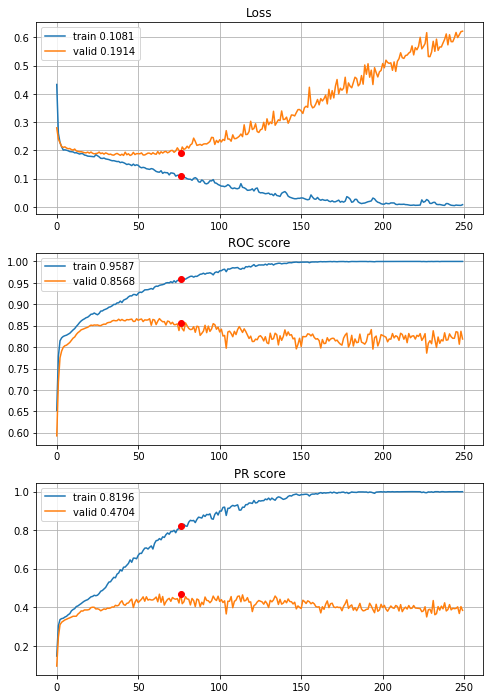


Fold 2------------------------------------------------------------


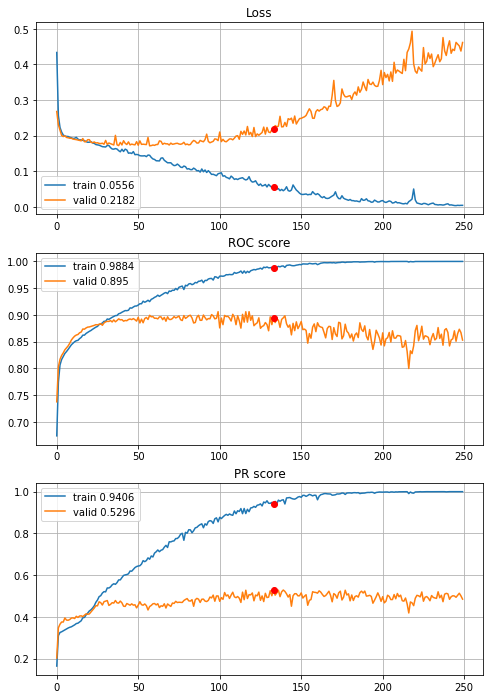


Fold 3------------------------------------------------------------


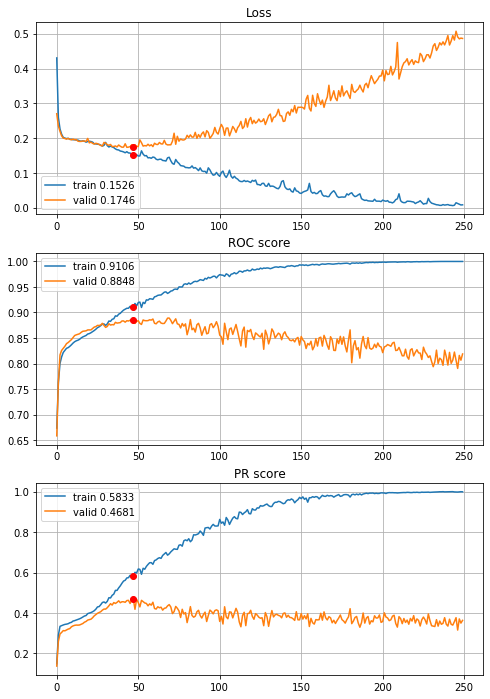


Fold 4------------------------------------------------------------


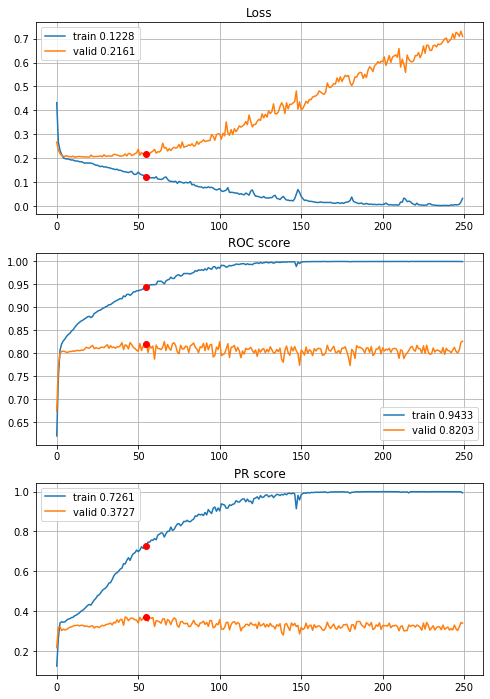


Fold 5------------------------------------------------------------


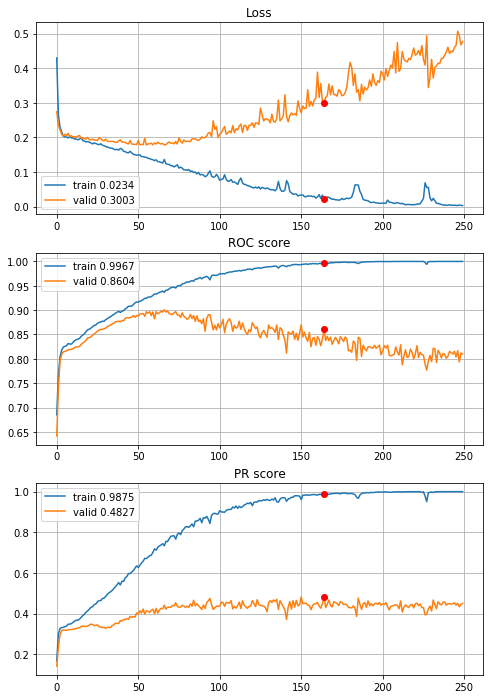


Fold 6------------------------------------------------------------


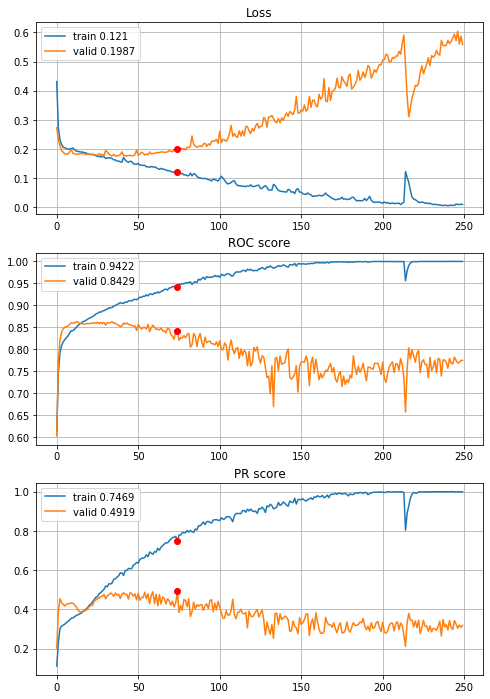

In [54]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_1conv_2inc_2dense_std,
                                        features=features, target=target, n_epochs=250, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Bad idea, its better to feed inception module with inputs rather than feature map. Lets try global average pooling instead average pooling followed by flatten layer

In [52]:
def define_deep_CNN_2inc_std_globalavg(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.GlobalAveragePooling2D()(inception)                                                   # (32,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu)(pool)                   # (256,)
    
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/250,
cumulative time: 3.04s train loss: 0.5763265435795707, validation loss: 0.42852327916372185
Epoch: 2/250,
cumulative time: 3.78s train loss: 0.3340418865426783, validation loss: 0.2532774656843037
Epoch: 3/250,
cumulative time: 4.49s train loss: 0.24087002483408373, validation loss: 0.2543044476659618
Epoch: 4/250,
cumulative time: 5.19s train loss: 0.2444649685295265, validation loss: 0.24574923125571302
Epoch: 5/250,
cumulative time: 5.9s train loss: 0.2380481979033039, validation loss: 0.24359386625123267
Epoch: 6/250,
cumulative time: 6.61s train loss: 0.2371643677569038, validation loss: 0.24270348222306778
Epoch: 7/250,
cumulative time: 7.31s train loss: 0.23600699425765753, validation loss: 0.24230330147630333
Epoch: 8/250,
cumulative time: 8.07s train loss: 0.23516157919722558, validation loss: 0.2413914229515037
Epoch: 9/250,
cumulative time: 8.79s train loss: 0.2345975553381529, valida

Epoch: 77/250,
cumulative time: 60.1s train loss: 0.19855807897792827, validation loss: 0.2083321089573885
Epoch: 78/250,
cumulative time: 60.82s train loss: 0.1974399426098012, validation loss: 0.20924499620848336
Epoch: 79/250,
cumulative time: 61.61s train loss: 0.1970764037409952, validation loss: 0.20832204885923608
Epoch: 80/250,
cumulative time: 62.38s train loss: 0.19714337167757082, validation loss: 0.2103475532510235
Epoch: 81/250,
cumulative time: 63.1s train loss: 0.1977683834139836, validation loss: 0.20874336224129128
Epoch: 82/250,
cumulative time: 63.89s train loss: 0.1982155478952809, validation loss: 0.2092094251375725
Epoch: 83/250,
cumulative time: 64.63s train loss: 0.19840569223280632, validation loss: 0.2106268870588623
Epoch: 84/250,
cumulative time: 65.37s train loss: 0.19780045360434356, validation loss: 0.20802204121059603
Epoch: 85/250,
cumulative time: 66.11s train loss: 0.19732607973719332, validation loss: 0.20787990771931214
Epoch: 86/250,
cumulative tim

Epoch: 153/250,
cumulative time: 119.54s train loss: 0.19507280060691953, validation loss: 0.20647789936054922
Epoch: 154/250,
cumulative time: 120.33s train loss: 0.19500602994262095, validation loss: 0.20631888266883816
Epoch: 155/250,
cumulative time: 121.1s train loss: 0.19528305886938685, validation loss: 0.20904485580617438
Epoch: 156/250,
cumulative time: 121.89s train loss: 0.19801990578912657, validation loss: 0.2080019213166823
Epoch: 157/250,
cumulative time: 122.67s train loss: 0.19635584858323477, validation loss: 0.20757013755895642
Epoch: 158/250,
cumulative time: 123.47s train loss: 0.19530686320541998, validation loss: 0.20602319583615966
Epoch: 159/250,
cumulative time: 124.23s train loss: 0.19494964893140732, validation loss: 0.20641828996151385
Epoch: 160/250,
cumulative time: 125.02s train loss: 0.1949427579176555, validation loss: 0.20623642335548206
Epoch: 161/250,
cumulative time: 125.79s train loss: 0.19481209236523306, validation loss: 0.2068284517647583
Epoch

Epoch: 228/250,
cumulative time: 174.8s train loss: 0.19329592318606936, validation loss: 0.20537137551802256
Epoch: 229/250,
cumulative time: 175.6s train loss: 0.19321411379380993, validation loss: 0.20528901832885915
Epoch: 230/250,
cumulative time: 176.34s train loss: 0.19356655500264375, validation loss: 0.20485842421130102
Epoch: 231/250,
cumulative time: 177.09s train loss: 0.1934144262574102, validation loss: 0.20576799870074938
Epoch: 232/250,
cumulative time: 177.82s train loss: 0.19338429242453206, validation loss: 0.20500300001466423
Epoch: 233/250,
cumulative time: 178.54s train loss: 0.1934698341407608, validation loss: 0.20475496039248103
Epoch: 234/250,
cumulative time: 179.27s train loss: 0.1930506807358579, validation loss: 0.20554798530685592
Epoch: 235/250,
cumulative time: 179.98s train loss: 0.19368126744317019, validation loss: 0.20540791017495794
Epoch: 236/250,
cumulative time: 180.71s train loss: 0.19394283240076007, validation loss: 0.20603999745818916
Epoch:

Epoch: 51/250,
cumulative time: 39.23s train loss: 0.20077236964357242, validation loss: 0.19948970920405232
Epoch: 52/250,
cumulative time: 39.95s train loss: 0.20137744792316795, validation loss: 0.19924818098612274
Epoch: 53/250,
cumulative time: 40.66s train loss: 0.19938376716704576, validation loss: 0.19862508121982905
Epoch: 54/250,
cumulative time: 41.38s train loss: 0.19910747546447097, validation loss: 0.19859163407677324
Epoch: 55/250,
cumulative time: 42.12s train loss: 0.20002805274854069, validation loss: 0.20038687599887978
Epoch: 56/250,
cumulative time: 42.86s train loss: 0.20146964206646065, validation loss: 0.20026658463639363
Epoch: 57/250,
cumulative time: 43.58s train loss: 0.20077081924364884, validation loss: 0.19889325147080986
Epoch: 58/250,
cumulative time: 44.34s train loss: 0.19908873009956055, validation loss: 0.19846165344841452
Epoch: 59/250,
cumulative time: 45.06s train loss: 0.199003763712055, validation loss: 0.1987857140743477
Epoch: 60/250,
cumulat

Epoch: 127/250,
cumulative time: 94.18s train loss: 0.19729394181244855, validation loss: 0.1979286501345801
Epoch: 128/250,
cumulative time: 94.91s train loss: 0.19662905873105413, validation loss: 0.19824811700298928
Epoch: 129/250,
cumulative time: 95.64s train loss: 0.1975686582753482, validation loss: 0.1977803971379021
Epoch: 130/250,
cumulative time: 96.38s train loss: 0.19724838140450876, validation loss: 0.1978140356945212
Epoch: 131/250,
cumulative time: 97.09s train loss: 0.1974485129830747, validation loss: 0.2008878339035804
Epoch: 132/250,
cumulative time: 97.81s train loss: 0.1978644082786697, validation loss: 0.1983308624455195
Epoch: 133/250,
cumulative time: 98.52s train loss: 0.19644456421990042, validation loss: 0.19850250621659107
Epoch: 134/250,
cumulative time: 99.23s train loss: 0.19736259468975695, validation loss: 0.19792418200375667
Epoch: 135/250,
cumulative time: 99.95s train loss: 0.19674609374214597, validation loss: 0.197817904922981
Epoch: 136/250,
cumu

Epoch: 202/250,
cumulative time: 148.7s train loss: 0.1948073463319441, validation loss: 0.19780915888213252
Epoch: 203/250,
cumulative time: 149.44s train loss: 0.19486401327599903, validation loss: 0.19857697573562888
Epoch: 204/250,
cumulative time: 150.16s train loss: 0.1951250628659011, validation loss: 0.19727018695606052
Epoch: 205/250,
cumulative time: 150.88s train loss: 0.19485577472926047, validation loss: 0.19748380553426712
Epoch: 206/250,
cumulative time: 151.61s train loss: 0.19666610410712687, validation loss: 0.20006082804186906
Epoch: 207/250,
cumulative time: 152.32s train loss: 0.19740413929527417, validation loss: 0.19830932825165376
Epoch: 208/250,
cumulative time: 153.03s train loss: 0.19523296941623144, validation loss: 0.19725870506537674
Epoch: 209/250,
cumulative time: 153.76s train loss: 0.1945517116666701, validation loss: 0.19620700580358774
Epoch: 210/250,
cumulative time: 154.52s train loss: 0.1942600485085365, validation loss: 0.19637865261536977
Epoch:

Epoch: 25/250,
cumulative time: 20.73s train loss: 0.20271642464431613, validation loss: 0.20366435206527775
Epoch: 26/250,
cumulative time: 21.48s train loss: 0.20276395322936536, validation loss: 0.20375183396032995
Epoch: 27/250,
cumulative time: 22.21s train loss: 0.20198016502097627, validation loss: 0.20298238147339934
Epoch: 28/250,
cumulative time: 22.95s train loss: 0.2017447527444212, validation loss: 0.2025846651972617
Epoch: 29/250,
cumulative time: 23.7s train loss: 0.20167921668436337, validation loss: 0.2023640335479745
Epoch: 30/250,
cumulative time: 24.45s train loss: 0.20159240512493393, validation loss: 0.2033538570398677
Epoch: 31/250,
cumulative time: 25.18s train loss: 0.20273894508661777, validation loss: 0.20299500057299483
Epoch: 32/250,
cumulative time: 25.94s train loss: 0.2010784842719455, validation loss: 0.20340029139327895
Epoch: 33/250,
cumulative time: 26.68s train loss: 0.2011979709611365, validation loss: 0.20141240023706516
Epoch: 34/250,
cumulative 

Epoch: 101/250,
cumulative time: 78.0s train loss: 0.2007259107480626, validation loss: 0.20024923822320703
Epoch: 102/250,
cumulative time: 78.75s train loss: 0.2001177308482491, validation loss: 0.19894119067350666
Epoch: 103/250,
cumulative time: 79.49s train loss: 0.19857606586297497, validation loss: 0.19652902839753647
Epoch: 104/250,
cumulative time: 80.26s train loss: 0.19692447623540563, validation loss: 0.19736242195194442
Epoch: 105/250,
cumulative time: 80.99s train loss: 0.19748811224737753, validation loss: 0.19738563765869335
Epoch: 106/250,
cumulative time: 81.73s train loss: 0.1993344679595869, validation loss: 0.198061891513317
Epoch: 107/250,
cumulative time: 82.48s train loss: 0.199645735148596, validation loss: 0.19642979244301526
Epoch: 108/250,
cumulative time: 83.21s train loss: 0.1979950790760857, validation loss: 0.1959759749245348
Epoch: 109/250,
cumulative time: 83.94s train loss: 0.19761220179498196, validation loss: 0.1969842800897837
Epoch: 110/250,
cumul

Epoch: 176/250,
cumulative time: 134.03s train loss: 0.19532637294072536, validation loss: 0.19182303909048556
Epoch: 177/250,
cumulative time: 134.77s train loss: 0.19445189917023, validation loss: 0.19235818435804417
Epoch: 178/250,
cumulative time: 135.51s train loss: 0.19671754834884342, validation loss: 0.19349975469012942
Epoch: 179/250,
cumulative time: 136.24s train loss: 0.19626143746858038, validation loss: 0.19395712441360533
Epoch: 180/250,
cumulative time: 136.97s train loss: 0.19568185331400767, validation loss: 0.19262300246933806
Epoch: 181/250,
cumulative time: 137.72s train loss: 0.19412188892948715, validation loss: 0.19178130046759545
Epoch: 182/250,
cumulative time: 138.46s train loss: 0.1938315587864671, validation loss: 0.19171468465008354
Epoch: 183/250,
cumulative time: 139.2s train loss: 0.19405052133092812, validation loss: 0.19163664311943354
Epoch: 184/250,
cumulative time: 139.93s train loss: 0.1939510071872051, validation loss: 0.1918669099233868
Epoch: 1

Train on 4433 samples, validate on 886 samples
Epoch: 1/250,
cumulative time: 3.33s train loss: 0.5765010170452003, validation loss: 0.42767254681942424
Epoch: 2/250,
cumulative time: 4.07s train loss: 0.336420062908383, validation loss: 0.24757854657302322
Epoch: 3/250,
cumulative time: 4.81s train loss: 0.24166397551717916, validation loss: 0.24562885452473943
Epoch: 4/250,
cumulative time: 5.54s train loss: 0.24691303365122458, validation loss: 0.23696109887977754
Epoch: 5/250,
cumulative time: 6.27s train loss: 0.24037187357748063, validation loss: 0.23697471319283642
Epoch: 6/250,
cumulative time: 7.02s train loss: 0.23909342071823414, validation loss: 0.23507764319937602
Epoch: 7/250,
cumulative time: 7.76s train loss: 0.2379554953218555, validation loss: 0.2343604024793978
Epoch: 8/250,
cumulative time: 8.5s train loss: 0.23707434621078824, validation loss: 0.23395240431310899
Epoch: 9/250,
cumulative time: 9.23s train loss: 0.2364206066283259, validation loss: 0.233016217030736

Epoch: 77/250,
cumulative time: 59.56s train loss: 0.1978257532088019, validation loss: 0.20717918502826993
Epoch: 78/250,
cumulative time: 60.31s train loss: 0.19629354294269316, validation loss: 0.20511312116753166
Epoch: 79/250,
cumulative time: 61.05s train loss: 0.1962962555624469, validation loss: 0.20596972060795563
Epoch: 80/250,
cumulative time: 61.78s train loss: 0.1960403907555854, validation loss: 0.2058725524567589
Epoch: 81/250,
cumulative time: 62.52s train loss: 0.19594366865612006, validation loss: 0.2063985860172836
Epoch: 82/250,
cumulative time: 63.26s train loss: 0.19631929735607093, validation loss: 0.20537246666159104
Epoch: 83/250,
cumulative time: 64.0s train loss: 0.19645200532283522, validation loss: 0.20499569803274512
Epoch: 84/250,
cumulative time: 64.74s train loss: 0.1977876766645529, validation loss: 0.20916184473522093
Epoch: 85/250,
cumulative time: 65.47s train loss: 0.19591454138356193, validation loss: 0.20537705517649382
Epoch: 86/250,
cumulative 

Epoch: 152/250,
cumulative time: 116.21s train loss: 0.1924725320822978, validation loss: 0.20595952380726085
Epoch: 153/250,
cumulative time: 116.97s train loss: 0.19221762944909537, validation loss: 0.20580703396829472
Epoch: 154/250,
cumulative time: 117.71s train loss: 0.1932013310658429, validation loss: 0.2063023185285973
Epoch: 155/250,
cumulative time: 118.46s train loss: 0.19271037353636744, validation loss: 0.2043741574136721
Epoch: 156/250,
cumulative time: 119.21s train loss: 0.19283268666417985, validation loss: 0.2045876461819117
Epoch: 157/250,
cumulative time: 119.95s train loss: 0.19149260198709633, validation loss: 0.20593888771722332
Epoch: 158/250,
cumulative time: 120.75s train loss: 0.19203579594554898, validation loss: 0.20587337023786711
Epoch: 159/250,
cumulative time: 121.5s train loss: 0.19173339450639015, validation loss: 0.20466738841738175
Epoch: 160/250,
cumulative time: 122.23s train loss: 0.19159615013270245, validation loss: 0.20468819619032383
Epoch: 

Epoch: 227/250,
cumulative time: 172.07s train loss: 0.18972001847458725, validation loss: 0.20962617568183967
Epoch: 228/250,
cumulative time: 172.81s train loss: 0.1899659698310136, validation loss: 0.20521712767351294
Epoch: 229/250,
cumulative time: 173.55s train loss: 0.18988445370266677, validation loss: 0.20650940928313857
Epoch: 230/250,
cumulative time: 174.29s train loss: 0.18929631147889125, validation loss: 0.20905272514637113
Epoch: 231/250,
cumulative time: 175.03s train loss: 0.19090675243789768, validation loss: 0.20529175046873416
Epoch: 232/250,
cumulative time: 175.79s train loss: 0.1890277915558373, validation loss: 0.20547406795869833
Epoch: 233/250,
cumulative time: 176.53s train loss: 0.1897651751712889, validation loss: 0.20526760352384424
Epoch: 234/250,
cumulative time: 177.28s train loss: 0.18943734238453222, validation loss: 0.20523999846681246
Epoch: 235/250,
cumulative time: 178.04s train loss: 0.18940119576083062, validation loss: 0.20562021720221027
Epoc

Epoch: 50/250,
cumulative time: 40.09s train loss: 0.19820202549235857, validation loss: 0.20491962878214318
Epoch: 51/250,
cumulative time: 40.85s train loss: 0.19828813882221522, validation loss: 0.2053423238998073
Epoch: 52/250,
cumulative time: 41.6s train loss: 0.20028297329847145, validation loss: 0.20538151018641065
Epoch: 53/250,
cumulative time: 42.34s train loss: 0.19998565446959374, validation loss: 0.20526283057763936
Epoch: 54/250,
cumulative time: 43.1s train loss: 0.1994161230331077, validation loss: 0.20501555983422842
Epoch: 55/250,
cumulative time: 43.86s train loss: 0.1982972876713127, validation loss: 0.20459721023826513
Epoch: 56/250,
cumulative time: 44.61s train loss: 0.19834406005994693, validation loss: 0.2045054368456115
Epoch: 57/250,
cumulative time: 45.37s train loss: 0.19804008842059137, validation loss: 0.20452265320324736
Epoch: 58/250,
cumulative time: 46.14s train loss: 0.1981310856388031, validation loss: 0.2046966451823577
Epoch: 59/250,
cumulative t

Epoch: 126/250,
cumulative time: 98.57s train loss: 0.1961385090464586, validation loss: 0.20185186762707497
Epoch: 127/250,
cumulative time: 99.32s train loss: 0.19556901829992437, validation loss: 0.20195740989449332
Epoch: 128/250,
cumulative time: 100.07s train loss: 0.19597360239310213, validation loss: 0.20240316817507517
Epoch: 129/250,
cumulative time: 100.81s train loss: 0.19568482537840226, validation loss: 0.20228588120259228
Epoch: 130/250,
cumulative time: 101.55s train loss: 0.1969708390828048, validation loss: 0.20257551870550583
Epoch: 131/250,
cumulative time: 102.29s train loss: 0.19614744591115965, validation loss: 0.20229823043061163
Epoch: 132/250,
cumulative time: 103.05s train loss: 0.19647435036196065, validation loss: 0.20234907652266138
Epoch: 133/250,
cumulative time: 103.79s train loss: 0.19584791652375894, validation loss: 0.2020001112742026
Epoch: 134/250,
cumulative time: 104.52s train loss: 0.19641583166325735, validation loss: 0.20325245814183496
Epoch:

Epoch: 201/250,
cumulative time: 157.47s train loss: 0.19474411515627008, validation loss: 0.20087526869827685
Epoch: 202/250,
cumulative time: 158.24s train loss: 0.19461447799848483, validation loss: 0.2009656907944324
Epoch: 203/250,
cumulative time: 159.0s train loss: 0.19457502951208958, validation loss: 0.20124048499167638
Epoch: 204/250,
cumulative time: 159.75s train loss: 0.19465193660001628, validation loss: 0.201213188183496
Epoch: 205/250,
cumulative time: 160.49s train loss: 0.19491845939435298, validation loss: 0.20091176699031288
Epoch: 206/250,
cumulative time: 161.25s train loss: 0.19429246662783348, validation loss: 0.2011209233552554
Epoch: 207/250,
cumulative time: 161.99s train loss: 0.19458627033564407, validation loss: 0.20078940608835114
Epoch: 208/250,
cumulative time: 162.73s train loss: 0.19484651689399804, validation loss: 0.20109703588566447
Epoch: 209/250,
cumulative time: 163.49s train loss: 0.19434498080732912, validation loss: 0.20060100774732723
Epoch:

Epoch: 24/250,
cumulative time: 20.71s train loss: 0.2101046217098318, validation loss: 0.18956130971757876
Epoch: 25/250,
cumulative time: 21.48s train loss: 0.20852927703930565, validation loss: 0.18669826606326395
Epoch: 26/250,
cumulative time: 22.26s train loss: 0.20717504585257185, validation loss: 0.18757021813979266
Epoch: 27/250,
cumulative time: 23.04s train loss: 0.2071894921703584, validation loss: 0.1855092766793533
Epoch: 28/250,
cumulative time: 23.82s train loss: 0.20650092571698164, validation loss: 0.1843656581021324
Epoch: 29/250,
cumulative time: 24.59s train loss: 0.20556699926444968, validation loss: 0.1837188485782787
Epoch: 30/250,
cumulative time: 25.36s train loss: 0.20468969785303934, validation loss: 0.18342908120316792
Epoch: 31/250,
cumulative time: 26.15s train loss: 0.20573239900069235, validation loss: 0.18798178121548473
Epoch: 32/250,
cumulative time: 27.02s train loss: 0.21023281453399606, validation loss: 0.1886877474074439
Epoch: 33/250,
cumulative

Epoch: 100/250,
cumulative time: 80.08s train loss: 0.20063880132500753, validation loss: 0.18096804211828563
Epoch: 101/250,
cumulative time: 80.85s train loss: 0.20104448102665035, validation loss: 0.18148733278564083
Epoch: 102/250,
cumulative time: 81.62s train loss: 0.20130633914239407, validation loss: 0.1828812123623174
Epoch: 103/250,
cumulative time: 82.39s train loss: 0.20273019486024368, validation loss: 0.1833492087254944
Epoch: 104/250,
cumulative time: 83.18s train loss: 0.20107149905715277, validation loss: 0.18194683720242089
Epoch: 105/250,
cumulative time: 83.95s train loss: 0.20076443096961066, validation loss: 0.1818348902275546
Epoch: 106/250,
cumulative time: 84.72s train loss: 0.2013805046553217, validation loss: 0.18661644536808436
Epoch: 107/250,
cumulative time: 85.48s train loss: 0.2018892697884056, validation loss: 0.18605645922586558
Epoch: 108/250,
cumulative time: 86.25s train loss: 0.20298179945100275, validation loss: 0.1835581617215417
Epoch: 109/250,


Epoch: 175/250,
cumulative time: 138.39s train loss: 0.19790983329823936, validation loss: 0.18039435292877948
Epoch: 176/250,
cumulative time: 139.18s train loss: 0.19736615388395554, validation loss: 0.1804709746660013
Epoch: 177/250,
cumulative time: 139.96s train loss: 0.19712454350167302, validation loss: 0.18150446898646602
Epoch: 178/250,
cumulative time: 140.73s train loss: 0.1985693693920691, validation loss: 0.18026778929389625
Epoch: 179/250,
cumulative time: 141.51s train loss: 0.19754238277102282, validation loss: 0.18054092088482987
Epoch: 180/250,
cumulative time: 142.28s train loss: 0.19781203278899864, validation loss: 0.18022278872892497
Epoch: 181/250,
cumulative time: 143.06s train loss: 0.19700761980083223, validation loss: 0.18076310846660262
Epoch: 182/250,
cumulative time: 143.83s train loss: 0.19705520805913493, validation loss: 0.18068611154303324
Epoch: 183/250,
cumulative time: 144.6s train loss: 0.19731820718432128, validation loss: 0.18279694363844853
Epoc

Epoch: 250/250,
cumulative time: 196.94s train loss: 0.19313493166299536, validation loss: 0.18219391026157827

Early stopping results:
best results in epoch: 16, 
best valid PR: 0.47858151740273464, 
valid ROC: 0.8052459016393443        
overfitting PR: -0.20071725975897503, 
overfitting ROC: -0.03500229675937572

Cross validation time: 1173s
ROC: 		0.8266959387636277
PR: 		0.3658932902221946
overfittingROC: 0.0048867009504895975
overfittingPR:  -0.023118285675017447
early stopping: [243, 248, 215, 238, 235, 16]

Fold 1------------------------------------------------------------


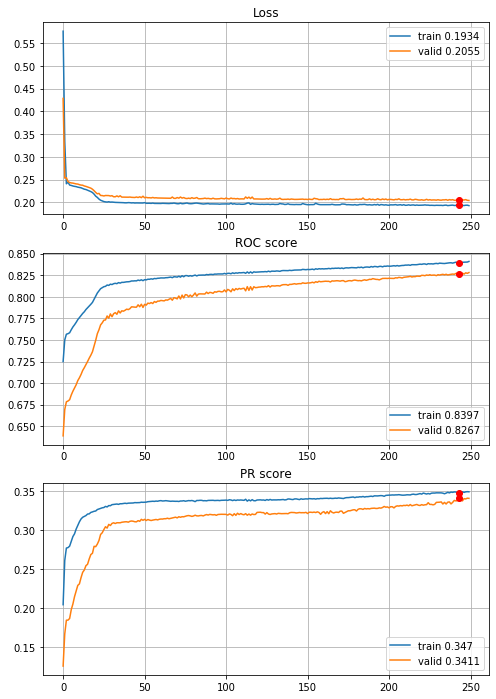


Fold 2------------------------------------------------------------


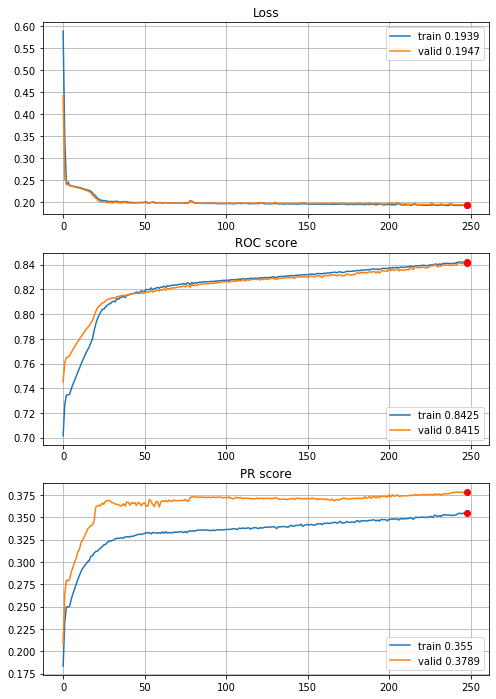


Fold 3------------------------------------------------------------


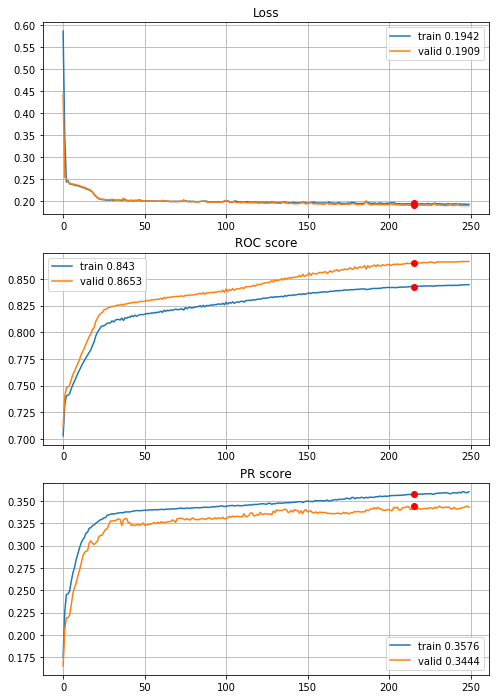


Fold 4------------------------------------------------------------


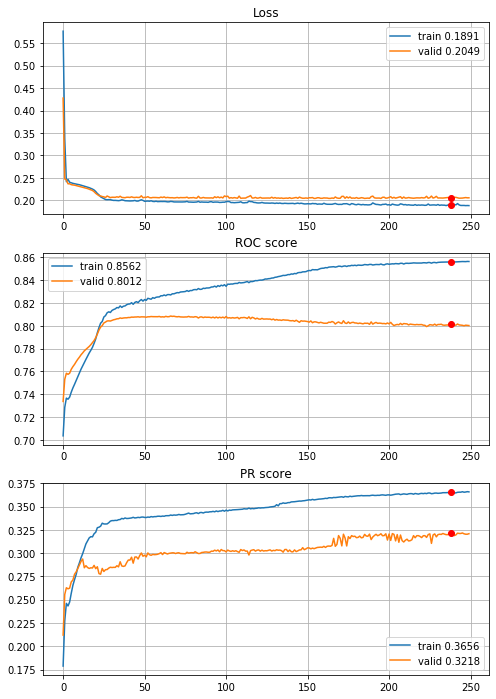


Fold 5------------------------------------------------------------


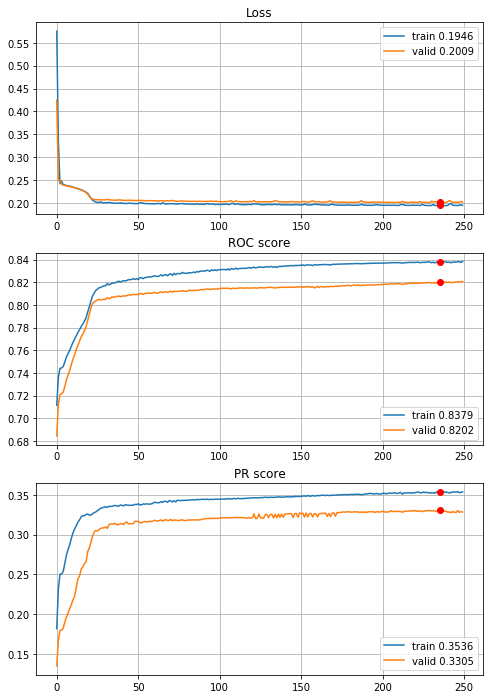


Fold 6------------------------------------------------------------


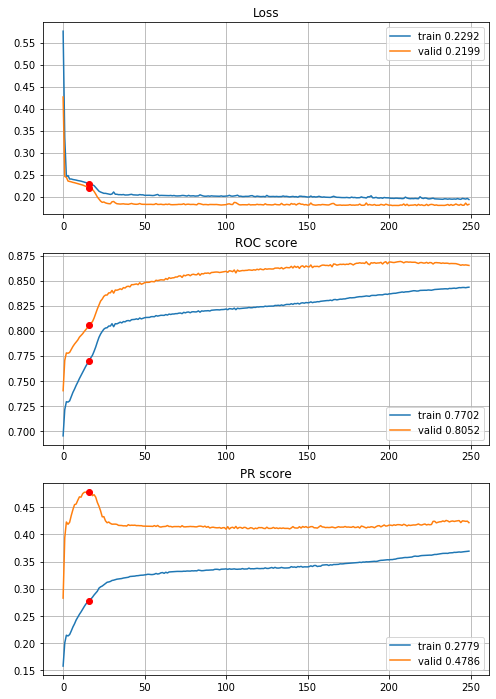

In [56]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_globalavg,
                                        features=features, target=target, n_epochs=250, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

lets enlarge dimension before global avg pooling

In [53]:
def define_deep_CNN_2inc_std_globalavg_64(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8, f4_out=8,
                                 random_state=random_state)                                             # (8,8,32)
    inception = inception_module(prev_layer=inception, f1=16, f2_in=8, f2_out=16, f3_in=8, f3_out=16,
                                 f4_out=16, random_state=random_state)                                  # (8,8,64)
    pool = layers.GlobalAveragePooling2D()(inception)                                                   # (64,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu)(pool)                   # (256,)
    
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/250,
cumulative time: 3.33s train loss: 0.5159897030556461, validation loss: 0.3150430819294767
Epoch: 2/250,
cumulative time: 4.5s train loss: 0.25446508279480445, validation loss: 0.26051605631426195
Epoch: 3/250,
cumulative time: 5.66s train loss: 0.24337106329869707, validation loss: 0.23850502152722475
Epoch: 4/250,
cumulative time: 6.81s train loss: 0.23148930610732482, validation loss: 0.23743758529525463
Epoch: 5/250,
cumulative time: 8.02s train loss: 0.22863489996628425, validation loss: 0.23521254459456903
Epoch: 6/250,
cumulative time: 9.18s train loss: 0.22650866127751149, validation loss: 0.23277508263321847
Epoch: 7/250,
cumulative time: 10.34s train loss: 0.22369977033660085, validation loss: 0.22985076454070133
Epoch: 8/250,
cumulative time: 11.5s train loss: 0.2201237563608678, validation loss: 0.22605734541088243
Epoch: 9/250,
cumulative time: 12.68s train loss: 0.2155928723379593,

Epoch: 77/250,
cumulative time: 92.21s train loss: 0.1879880606509503, validation loss: 0.19383482011759565
Epoch: 78/250,
cumulative time: 93.37s train loss: 0.18673627408698792, validation loss: 0.19131716615452168
Epoch: 79/250,
cumulative time: 94.53s train loss: 0.18406463840082019, validation loss: 0.18957340690436467
Epoch: 80/250,
cumulative time: 95.69s train loss: 0.1888399753309383, validation loss: 0.18947013545667976
Epoch: 81/250,
cumulative time: 96.84s train loss: 0.1858940627022448, validation loss: 0.19160700890969531
Epoch: 82/250,
cumulative time: 97.98s train loss: 0.183268687664279, validation loss: 0.1904552279390907
Epoch: 83/250,
cumulative time: 99.13s train loss: 0.1838974751975885, validation loss: 0.18912153789330496
Epoch: 84/250,
cumulative time: 100.28s train loss: 0.18364256764980644, validation loss: 0.19221619379695132
Epoch: 85/250,
cumulative time: 101.46s train loss: 0.18485948962532656, validation loss: 0.18858371446541225
Epoch: 86/250,
cumulativ

Epoch: 152/250,
cumulative time: 179.15s train loss: 0.16460430213932742, validation loss: 0.1739903790403783
Epoch: 153/250,
cumulative time: 180.43s train loss: 0.1634561114335964, validation loss: 0.17178656990727012
Epoch: 154/250,
cumulative time: 181.67s train loss: 0.1620331235996545, validation loss: 0.17055603309105052
Epoch: 155/250,
cumulative time: 182.89s train loss: 0.16150946298862945, validation loss: 0.18637366421529108
Epoch: 156/250,
cumulative time: 184.12s train loss: 0.17703511234076982, validation loss: 0.1755157486360264
Epoch: 157/250,
cumulative time: 185.26s train loss: 0.16387474741316013, validation loss: 0.17142718890944356
Epoch: 158/250,
cumulative time: 186.42s train loss: 0.1624941206688485, validation loss: 0.18099969092928705
Epoch: 159/250,
cumulative time: 187.58s train loss: 0.16436547935277976, validation loss: 0.1717187574441968
Epoch: 160/250,
cumulative time: 188.73s train loss: 0.16509476723653746, validation loss: 0.1728793156859302
Epoch: 1

Epoch: 227/250,
cumulative time: 266.85s train loss: 0.1489188925931331, validation loss: 0.17720307436642543
Epoch: 228/250,
cumulative time: 268.01s train loss: 0.14760904165408456, validation loss: 0.18138376473036533
Epoch: 229/250,
cumulative time: 269.15s train loss: 0.15086092630784542, validation loss: 0.16849208232582355
Epoch: 230/250,
cumulative time: 270.3s train loss: 0.14145656545992794, validation loss: 0.1681919276647127
Epoch: 231/250,
cumulative time: 271.48s train loss: 0.14431352339792552, validation loss: 0.16667282542690484
Epoch: 232/250,
cumulative time: 272.64s train loss: 0.1413968175494983, validation loss: 0.1705525713513911
Epoch: 233/250,
cumulative time: 273.78s train loss: 0.14356449886564743, validation loss: 0.16723312323297695
Epoch: 234/250,
cumulative time: 274.94s train loss: 0.14907033639936457, validation loss: 0.18715340295531435
Epoch: 235/250,
cumulative time: 276.09s train loss: 0.1505668068687946, validation loss: 0.1664787232875824
Epoch: 2

Epoch: 50/250,
cumulative time: 60.34s train loss: 0.18935812914253142, validation loss: 0.18836528069540237
Epoch: 51/250,
cumulative time: 61.48s train loss: 0.1914061651689535, validation loss: 0.18952850518662068
Epoch: 52/250,
cumulative time: 62.65s train loss: 0.18913073381509915, validation loss: 0.19118891066736138
Epoch: 53/250,
cumulative time: 63.8s train loss: 0.18910481850028255, validation loss: 0.1885420599072466
Epoch: 54/250,
cumulative time: 64.95s train loss: 0.18849102552267402, validation loss: 0.1896351901761843
Epoch: 55/250,
cumulative time: 66.09s train loss: 0.19160710582476015, validation loss: 0.1870781291599607
Epoch: 56/250,
cumulative time: 67.23s train loss: 0.1885575405069852, validation loss: 0.18743905092441512
Epoch: 57/250,
cumulative time: 68.37s train loss: 0.19521818163767726, validation loss: 0.18726188690310266
Epoch: 58/250,
cumulative time: 69.5s train loss: 0.1920024922272251, validation loss: 0.18997840689161316
Epoch: 59/250,
cumulative t

Epoch: 126/250,
cumulative time: 148.11s train loss: 0.17727884691248946, validation loss: 0.1819185461038398
Epoch: 127/250,
cumulative time: 149.32s train loss: 0.1783304955971693, validation loss: 0.17962433128977842
Epoch: 128/250,
cumulative time: 150.55s train loss: 0.17644776999681436, validation loss: 0.18065107710399111
Epoch: 129/250,
cumulative time: 151.85s train loss: 0.17587329340352265, validation loss: 0.19168548420357193
Epoch: 130/250,
cumulative time: 153.04s train loss: 0.1806622489157136, validation loss: 0.19348754180257188
Epoch: 131/250,
cumulative time: 154.24s train loss: 0.18529683488021043, validation loss: 0.19508673457309117
Epoch: 132/250,
cumulative time: 155.41s train loss: 0.18150157124368937, validation loss: 0.1811625530109599
Epoch: 133/250,
cumulative time: 156.62s train loss: 0.176494308360701, validation loss: 0.18000699433560033
Epoch: 134/250,
cumulative time: 157.86s train loss: 0.1755114573117897, validation loss: 0.18587518549758392
Epoch: 1

Epoch: 201/250,
cumulative time: 236.78s train loss: 0.1609135523021544, validation loss: 0.17156525759242702
Epoch: 202/250,
cumulative time: 237.93s train loss: 0.1603890362494904, validation loss: 0.17054482498190449
Epoch: 203/250,
cumulative time: 239.07s train loss: 0.16020668351128428, validation loss: 0.17209519741567442
Epoch: 204/250,
cumulative time: 240.25s train loss: 0.16045597749711804, validation loss: 0.1707490324772466
Epoch: 205/250,
cumulative time: 241.5s train loss: 0.15855524328533924, validation loss: 0.1708550392203831
Epoch: 206/250,
cumulative time: 242.73s train loss: 0.15991287158687836, validation loss: 0.17225610568128283
Epoch: 207/250,
cumulative time: 243.94s train loss: 0.15775053392060182, validation loss: 0.17165594493388592
Epoch: 208/250,
cumulative time: 245.17s train loss: 0.1602447924039424, validation loss: 0.17272299010697184
Epoch: 209/250,
cumulative time: 246.31s train loss: 0.16344490298658393, validation loss: 0.17216514323112528
Epoch: 

Epoch: 24/250,
cumulative time: 31.08s train loss: 0.19880058713230414, validation loss: 0.19839769242312486
Epoch: 25/250,
cumulative time: 32.32s train loss: 0.19832684410339227, validation loss: 0.19780811840477228
Epoch: 26/250,
cumulative time: 33.56s train loss: 0.1986709297147146, validation loss: 0.19694061889790898
Epoch: 27/250,
cumulative time: 34.82s train loss: 0.19872015728094086, validation loss: 0.1966364699360214
Epoch: 28/250,
cumulative time: 36.07s train loss: 0.19643511239183722, validation loss: 0.19581003315755183
Epoch: 29/250,
cumulative time: 37.22s train loss: 0.19631877269878284, validation loss: 0.19429810395571398
Epoch: 30/250,
cumulative time: 38.44s train loss: 0.19722118167146127, validation loss: 0.19438295195712849
Epoch: 31/250,
cumulative time: 39.59s train loss: 0.19612604218269514, validation loss: 0.19370113597109728
Epoch: 32/250,
cumulative time: 40.77s train loss: 0.19446709161012396, validation loss: 0.19357141477749878
Epoch: 33/250,
cumula

Epoch: 100/250,
cumulative time: 119.44s train loss: 0.17759038789352463, validation loss: 0.183422082676022
Epoch: 101/250,
cumulative time: 120.63s train loss: 0.17839294047320148, validation loss: 0.1783355395682366
Epoch: 102/250,
cumulative time: 121.79s train loss: 0.1803576354044977, validation loss: 0.17868417110021112
Epoch: 103/250,
cumulative time: 122.93s train loss: 0.17996535360113808, validation loss: 0.18908300491841562
Epoch: 104/250,
cumulative time: 124.07s train loss: 0.1821143895569207, validation loss: 0.19630161361199758
Epoch: 105/250,
cumulative time: 125.23s train loss: 0.18063557808310976, validation loss: 0.17832778288385376
Epoch: 106/250,
cumulative time: 126.37s train loss: 0.17829867801376845, validation loss: 0.17787757996373138
Epoch: 107/250,
cumulative time: 127.52s train loss: 0.18389010647923723, validation loss: 0.18037418602821925
Epoch: 108/250,
cumulative time: 128.67s train loss: 0.1794742159242826, validation loss: 0.17851395169199522
Epoch: 

Epoch: 175/250,
cumulative time: 206.49s train loss: 0.16742216101393695, validation loss: 0.179599490180494
Epoch: 176/250,
cumulative time: 207.64s train loss: 0.16458635842461233, validation loss: 0.18415684415092598
Epoch: 177/250,
cumulative time: 208.81s train loss: 0.16590213246764582, validation loss: 0.17857524411586925
Epoch: 178/250,
cumulative time: 209.96s train loss: 0.16870726605991596, validation loss: 0.19065286786943306
Epoch: 179/250,
cumulative time: 211.11s train loss: 0.17176308035043603, validation loss: 0.17844193259919777
Epoch: 180/250,
cumulative time: 212.26s train loss: 0.165508003952486, validation loss: 0.18496457138755007
Epoch: 181/250,
cumulative time: 213.42s train loss: 0.16721949630857375, validation loss: 0.18570002095339128
Epoch: 182/250,
cumulative time: 214.6s train loss: 0.16566062290624914, validation loss: 0.18065494683643607
Epoch: 183/250,
cumulative time: 215.77s train loss: 0.16443510517639373, validation loss: 0.17907624600167474
Epoch:

Epoch: 250/250,
cumulative time: 295.84s train loss: 0.1571053607214498, validation loss: 0.18287457759243256

Early stopping results:
best results in epoch: 240, 
best valid PR: 0.4413177702808026, 
valid ROC: 0.8728250244379276        
overfitting PR: 0.11155748071309418, 
overfitting ROC: 0.031953575897676

----------
Fold: 4
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/250,
cumulative time: 3.69s train loss: 0.5090137743167352, validation loss: 0.3072844391213583
Epoch: 2/250,
cumulative time: 5.06s train loss: 0.2562076996296758, validation loss: 0.24887755173458204
Epoch: 3/250,
cumulative time: 6.37s train loss: 0.24691071982661247, validation loss: 0.23089741903691474
Epoch: 4/250,
cumulative time: 7.66s train loss: 0.2341207836555246, validation loss: 0.23186244716359045
Epoch: 5/250,
cumulative time: 8.92s train loss: 0.2320528286333792, validation loss: 0.22754450714211433
Epoch: 6/250,
cumulative time: 10.15s train loss: 0.22937456572026235, validation

Epoch: 74/250,
cumulative time: 89.68s train loss: 0.186423910916618, validation loss: 0.20218542995221458
Epoch: 75/250,
cumulative time: 90.84s train loss: 0.18691533533345758, validation loss: 0.2026064742364948
Epoch: 76/250,
cumulative time: 91.99s train loss: 0.18841991296087193, validation loss: 0.2032729216407707
Epoch: 77/250,
cumulative time: 93.15s train loss: 0.19278029423856638, validation loss: 0.19964284152128894
Epoch: 78/250,
cumulative time: 94.34s train loss: 0.1886060128907385, validation loss: 0.2013933427850495
Epoch: 79/250,
cumulative time: 95.51s train loss: 0.18576828708854132, validation loss: 0.20274268961921502
Epoch: 80/250,
cumulative time: 96.68s train loss: 0.18584860881806065, validation loss: 0.20147487568263275
Epoch: 81/250,
cumulative time: 97.88s train loss: 0.18425895732518865, validation loss: 0.2017033449952274
Epoch: 82/250,
cumulative time: 99.03s train loss: 0.18410879093880528, validation loss: 0.20767647529159658
Epoch: 83/250,
cumulative 

Epoch: 149/250,
cumulative time: 177.79s train loss: 0.16827747865943266, validation loss: 0.2033581332415006
Epoch: 150/250,
cumulative time: 178.99s train loss: 0.16569863796274467, validation loss: 0.2004424378309508
Epoch: 151/250,
cumulative time: 180.18s train loss: 0.1697923004654119, validation loss: 0.20601973886145425
Epoch: 152/250,
cumulative time: 181.36s train loss: 0.1679575079428055, validation loss: 0.20278822588597678
Epoch: 153/250,
cumulative time: 182.52s train loss: 0.1663492855172837, validation loss: 0.202562404304541
Epoch: 154/250,
cumulative time: 183.68s train loss: 0.16619126580381618, validation loss: 0.20047679402220062
Epoch: 155/250,
cumulative time: 184.84s train loss: 0.16637878268520154, validation loss: 0.21624786933173445
Epoch: 156/250,
cumulative time: 186.01s train loss: 0.17060341513737742, validation loss: 0.20749803674543954
Epoch: 157/250,
cumulative time: 187.17s train loss: 0.16613202009618133, validation loss: 0.20229669477008536
Epoch: 1

Epoch: 224/250,
cumulative time: 266.28s train loss: 0.1469972991503686, validation loss: 0.20720668917450355
Epoch: 225/250,
cumulative time: 267.45s train loss: 0.14767993299196838, validation loss: 0.20318811909877957
Epoch: 226/250,
cumulative time: 268.61s train loss: 0.15232360881337081, validation loss: 0.20725253705381003
Epoch: 227/250,
cumulative time: 269.78s train loss: 0.14606519011175984, validation loss: 0.20250512824370684
Epoch: 228/250,
cumulative time: 270.94s train loss: 0.14570324016012673, validation loss: 0.21755929119699965
Epoch: 229/250,
cumulative time: 272.12s train loss: 0.1534981023484096, validation loss: 0.2055331566801997
Epoch: 230/250,
cumulative time: 273.28s train loss: 0.14827396611233692, validation loss: 0.20686876017003242
Epoch: 231/250,
cumulative time: 274.44s train loss: 0.14722639044123634, validation loss: 0.20389121969316668
Epoch: 232/250,
cumulative time: 275.75s train loss: 0.14633490447397832, validation loss: 0.20890550907390112
Epoc

Epoch: 47/250,
cumulative time: 60.63s train loss: 0.19288332098807165, validation loss: 0.19975183409708078
Epoch: 48/250,
cumulative time: 61.96s train loss: 0.19223806040835062, validation loss: 0.19919113942651123
Epoch: 49/250,
cumulative time: 63.34s train loss: 0.19218331275555287, validation loss: 0.19887541325312974
Epoch: 50/250,
cumulative time: 64.64s train loss: 0.19193312030276352, validation loss: 0.1983730657778798
Epoch: 51/250,
cumulative time: 65.84s train loss: 0.19292145300242264, validation loss: 0.19830202117865026
Epoch: 52/250,
cumulative time: 67.16s train loss: 0.19186785968410064, validation loss: 0.20444772498467706
Epoch: 53/250,
cumulative time: 68.5s train loss: 0.19244453301890665, validation loss: 0.20085185009389106
Epoch: 54/250,
cumulative time: 69.75s train loss: 0.19267093844185718, validation loss: 0.20071221729971755
Epoch: 55/250,
cumulative time: 71.03s train loss: 0.1906866258761965, validation loss: 0.19913734132360927
Epoch: 56/250,
cumulat

Epoch: 123/250,
cumulative time: 152.54s train loss: 0.17335415612204522, validation loss: 0.20143112866523302
Epoch: 124/250,
cumulative time: 153.71s train loss: 0.17389703264172987, validation loss: 0.19199153350384457
Epoch: 125/250,
cumulative time: 154.89s train loss: 0.17373427266316788, validation loss: 0.19524806431803693
Epoch: 126/250,
cumulative time: 156.07s train loss: 0.18068241203796667, validation loss: 0.20131405168812108
Epoch: 127/250,
cumulative time: 157.25s train loss: 0.17372359869887805, validation loss: 0.1923771020924803
Epoch: 128/250,
cumulative time: 158.43s train loss: 0.17125833546459177, validation loss: 0.19145809991903284
Epoch: 129/250,
cumulative time: 159.61s train loss: 0.17207012792930307, validation loss: 0.19813792942339895
Epoch: 130/250,
cumulative time: 160.8s train loss: 0.1748004961122704, validation loss: 0.19373267569471966
Epoch: 131/250,
cumulative time: 161.97s train loss: 0.17281100746540837, validation loss: 0.19131593830025762
Epoc

Epoch: 198/250,
cumulative time: 242.35s train loss: 0.15497081981080665, validation loss: 0.19601319313183865
Epoch: 199/250,
cumulative time: 243.55s train loss: 0.15362169575252893, validation loss: 0.19812252623098428
Epoch: 200/250,
cumulative time: 244.73s train loss: 0.1536204738673953, validation loss: 0.20148435675667317
Epoch: 201/250,
cumulative time: 245.91s train loss: 0.15438798214494845, validation loss: 0.2058384510316375
Epoch: 202/250,
cumulative time: 247.09s train loss: 0.1562483105686645, validation loss: 0.19839311251521918
Epoch: 203/250,
cumulative time: 248.27s train loss: 0.15754598516617083, validation loss: 0.19898184195463597
Epoch: 204/250,
cumulative time: 249.44s train loss: 0.15253973328553605, validation loss: 0.19890247557825214
Epoch: 205/250,
cumulative time: 250.68s train loss: 0.1582424846575918, validation loss: 0.1949638683962768
Epoch: 206/250,
cumulative time: 251.94s train loss: 0.15113280750869926, validation loss: 0.1971864922657508
Epoch: 

Epoch: 21/250,
cumulative time: 28.24s train loss: 0.20193711209923748, validation loss: 0.18300038703946442
Epoch: 22/250,
cumulative time: 29.4s train loss: 0.20193356202279583, validation loss: 0.18556636871252857
Epoch: 23/250,
cumulative time: 30.56s train loss: 0.19884934288611564, validation loss: 0.18058437657275533
Epoch: 24/250,
cumulative time: 31.72s train loss: 0.19929322059512702, validation loss: 0.18214173103697412
Epoch: 25/250,
cumulative time: 32.98s train loss: 0.19946039069217886, validation loss: 0.18074896622188474
Epoch: 26/250,
cumulative time: 34.24s train loss: 0.1985046262635406, validation loss: 0.18032326799886758
Epoch: 27/250,
cumulative time: 35.49s train loss: 0.19986229353098414, validation loss: 0.18275316718873266
Epoch: 28/250,
cumulative time: 36.78s train loss: 0.19803902196233386, validation loss: 0.18250957245751376
Epoch: 29/250,
cumulative time: 38.02s train loss: 0.196681662738498, validation loss: 0.17941193595427693
Epoch: 30/250,
cumulati

Epoch: 97/250,
cumulative time: 118.33s train loss: 0.18008350520257135, validation loss: 0.17435348070905654
Epoch: 98/250,
cumulative time: 119.5s train loss: 0.1785703325127738, validation loss: 0.1758516741996425
Epoch: 99/250,
cumulative time: 120.66s train loss: 0.17977677456599284, validation loss: 0.17448495089604138
Epoch: 100/250,
cumulative time: 121.84s train loss: 0.17742467360701702, validation loss: 0.17357300491015476
Epoch: 101/250,
cumulative time: 123.0s train loss: 0.1797451391402685, validation loss: 0.17489997632212886
Epoch: 102/250,
cumulative time: 124.16s train loss: 0.18140499757343562, validation loss: 0.17446440505389435
Epoch: 103/250,
cumulative time: 125.36s train loss: 0.17619519099717534, validation loss: 0.17422565010546562
Epoch: 104/250,
cumulative time: 126.56s train loss: 0.17541004132799604, validation loss: 0.17400349922158648
Epoch: 105/250,
cumulative time: 127.73s train loss: 0.1753692751123866, validation loss: 0.1732392560345863
Epoch: 106/

Epoch: 172/250,
cumulative time: 206.22s train loss: 0.16059996281134312, validation loss: 0.18750906720522026
Epoch: 173/250,
cumulative time: 207.41s train loss: 0.17021914973044916, validation loss: 0.17067360447437985
Epoch: 174/250,
cumulative time: 208.61s train loss: 0.15901725152673393, validation loss: 0.16822949149404098
Epoch: 175/250,
cumulative time: 209.77s train loss: 0.15693306537694218, validation loss: 0.17078266805773665
Epoch: 176/250,
cumulative time: 210.95s train loss: 0.1621954372766565, validation loss: 0.17293064111242445
Epoch: 177/250,
cumulative time: 212.13s train loss: 0.15953596377652413, validation loss: 0.1675161332161109
Epoch: 178/250,
cumulative time: 213.29s train loss: 0.15518996051598585, validation loss: 0.1747903772388032
Epoch: 179/250,
cumulative time: 214.47s train loss: 0.16146298772038817, validation loss: 0.17529848668699072
Epoch: 180/250,
cumulative time: 215.65s train loss: 0.16077953386113145, validation loss: 0.1665201237589188
Epoch

Epoch: 247/250,
cumulative time: 295.22s train loss: 0.1396800072419571, validation loss: 0.16768677340942365
Epoch: 248/250,
cumulative time: 296.41s train loss: 0.13962465815772168, validation loss: 0.1695802941010176
Epoch: 249/250,
cumulative time: 297.57s train loss: 0.14099013219494436, validation loss: 0.1714058718885848
Epoch: 250/250,
cumulative time: 298.73s train loss: 0.14952680738144902, validation loss: 0.17161821491562218

Early stopping results:
best results in epoch: 248, 
best valid PR: 0.5681472539172202, 
valid ROC: 0.8649379036264282        
overfitting PR: 0.08646279298380244, 
overfitting ROC: 0.05904202553531923

Cross validation time: 1814s
ROC: 		0.8664307805714468
PR: 		0.47388374560437607
overfittingROC: 0.05021475340959203
overfittingPR:  0.1483221694659559
early stopping: [204, 249, 240, 247, 248, 248]

Fold 1------------------------------------------------------------


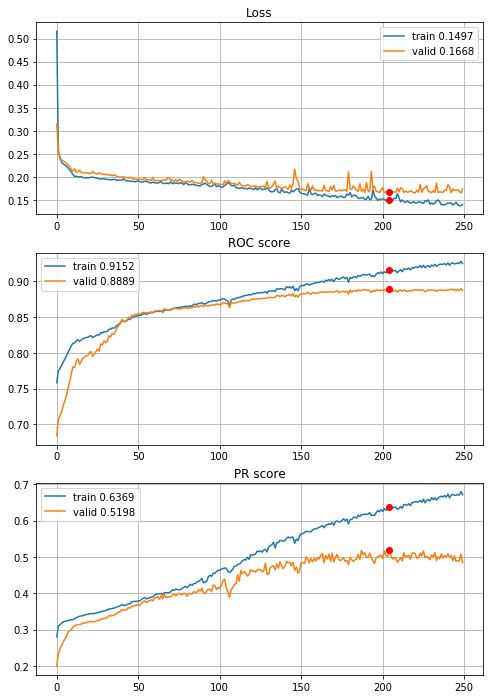


Fold 2------------------------------------------------------------


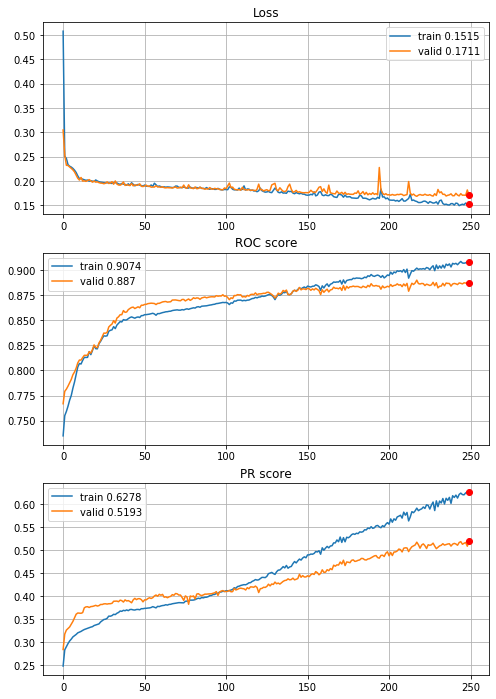


Fold 3------------------------------------------------------------


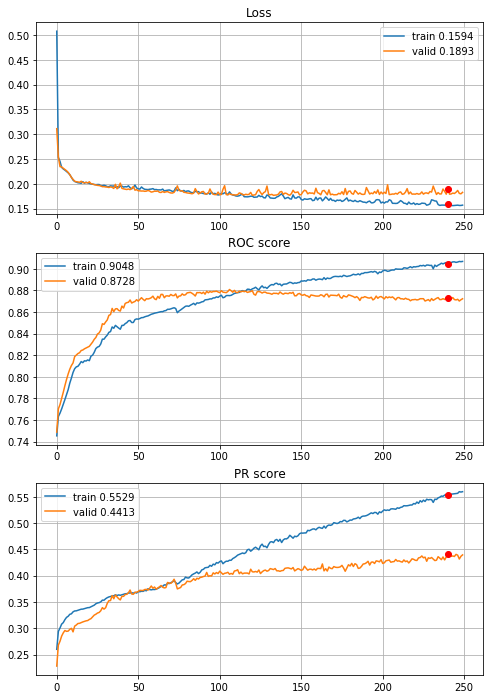


Fold 4------------------------------------------------------------


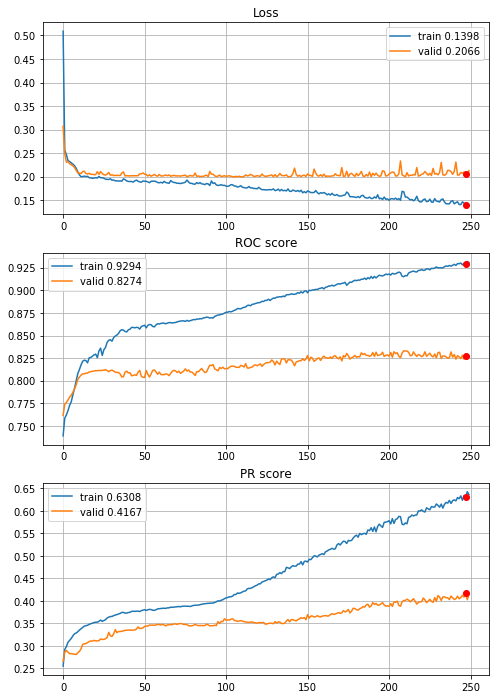


Fold 5------------------------------------------------------------


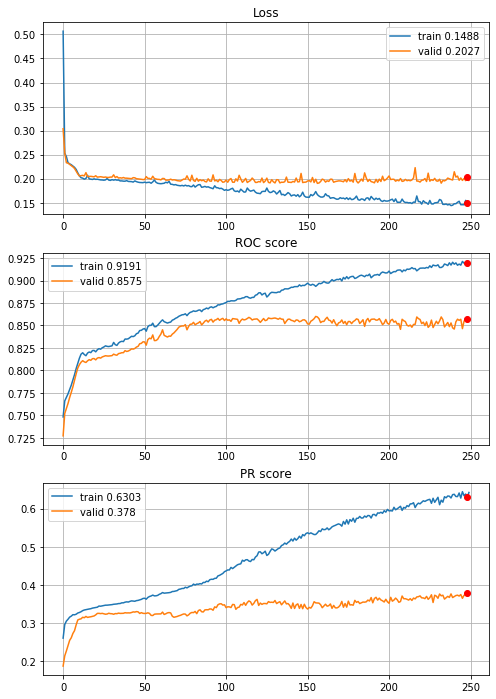


Fold 6------------------------------------------------------------


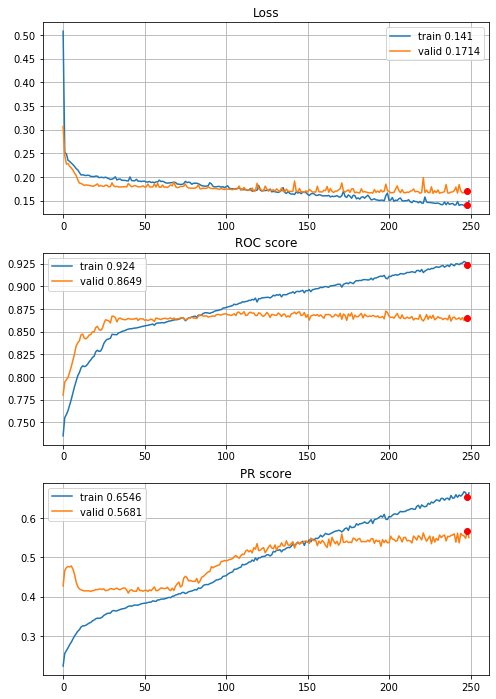

In [58]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_globalavg_64,
                                        features=features, target=target, n_epochs=250, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

the same model, 600 epochs


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/600,
cumulative time: 3.8s train loss: 0.5087282227668306, validation loss: 0.3098032299130987
Epoch: 2/600,
cumulative time: 5.02s train loss: 0.2528788141422108, validation loss: 0.2602526010628349
Epoch: 3/600,
cumulative time: 6.24s train loss: 0.2427934282980456, validation loss: 0.23829485790167748
Epoch: 4/600,
cumulative time: 7.47s train loss: 0.23144871896865782, validation loss: 0.23722731272491554
Epoch: 5/600,
cumulative time: 8.71s train loss: 0.22840176466247236, validation loss: 0.23515736799699746
Epoch: 6/600,
cumulative time: 9.95s train loss: 0.2263871797962309, validation loss: 0.23255379894473238
Epoch: 7/600,
cumulative time: 11.16s train loss: 0.2234913907097888, validation loss: 0.2295062884671578
Epoch: 8/600,
cumulative time: 12.38s train loss: 0.219548565493594, validation loss: 0.22528201778416165
Epoch: 9/600,
cumulative time: 13.59s train loss: 0.21441419503318704, vali

Epoch: 77/600,
cumulative time: 97.5s train loss: 0.1883037303530675, validation loss: 0.1928689054800397
Epoch: 78/600,
cumulative time: 98.77s train loss: 0.1867154784540945, validation loss: 0.19141752791109054
Epoch: 79/600,
cumulative time: 100.1s train loss: 0.18386738670700725, validation loss: 0.19020133019501623
Epoch: 80/600,
cumulative time: 101.42s train loss: 0.18836343830404298, validation loss: 0.19063484426818814
Epoch: 81/600,
cumulative time: 102.74s train loss: 0.18625041259459424, validation loss: 0.19362797454553904
Epoch: 82/600,
cumulative time: 104.0s train loss: 0.18326711109318242, validation loss: 0.1914586724362755
Epoch: 83/600,
cumulative time: 105.27s train loss: 0.1843747422838792, validation loss: 0.18947776601037689
Epoch: 84/600,
cumulative time: 106.56s train loss: 0.18381753300286371, validation loss: 0.19247717612760043
Epoch: 85/600,
cumulative time: 107.85s train loss: 0.18447572511321586, validation loss: 0.1892684490630968
Epoch: 86/600,
cumula

Epoch: 152/600,
cumulative time: 188.24s train loss: 0.16782643494703925, validation loss: 0.1782334014151787
Epoch: 153/600,
cumulative time: 189.51s train loss: 0.16654425904504444, validation loss: 0.17334655374120564
Epoch: 154/600,
cumulative time: 190.7s train loss: 0.1648212361959774, validation loss: 0.1724896810638058
Epoch: 155/600,
cumulative time: 191.89s train loss: 0.16533322522033422, validation loss: 0.1907286448435692
Epoch: 156/600,
cumulative time: 193.19s train loss: 0.18028713915402925, validation loss: 0.18190310166344434
Epoch: 157/600,
cumulative time: 194.44s train loss: 0.16563333558853352, validation loss: 0.17272134798892858
Epoch: 158/600,
cumulative time: 195.71s train loss: 0.1653284346046, validation loss: 0.18151584074421961
Epoch: 159/600,
cumulative time: 196.98s train loss: 0.16725997561555261, validation loss: 0.17269504362593374
Epoch: 160/600,
cumulative time: 198.21s train loss: 0.1672064407799218, validation loss: 0.17295131868480157
Epoch: 161/

Epoch: 227/600,
cumulative time: 278.51s train loss: 0.15407908022309577, validation loss: 0.17359751019429462
Epoch: 228/600,
cumulative time: 279.7s train loss: 0.15407385364080703, validation loss: 0.17744619746218943
Epoch: 229/600,
cumulative time: 280.87s train loss: 0.156263522259111, validation loss: 0.16507844191796348
Epoch: 230/600,
cumulative time: 282.07s train loss: 0.14846171699262592, validation loss: 0.16458141965016707
Epoch: 231/600,
cumulative time: 283.27s train loss: 0.1521744187887664, validation loss: 0.16353795999134005
Epoch: 232/600,
cumulative time: 284.46s train loss: 0.15052942117333196, validation loss: 0.16903963152491389
Epoch: 233/600,
cumulative time: 285.65s train loss: 0.15307756132422695, validation loss: 0.1643222451646809
Epoch: 234/600,
cumulative time: 286.84s train loss: 0.15776890844093225, validation loss: 0.17600718945298416
Epoch: 235/600,
cumulative time: 288.04s train loss: 0.15701008521168347, validation loss: 0.16425221064784212
Epoch:

Epoch: 302/600,
cumulative time: 368.29s train loss: 0.14728123839904256, validation loss: 0.18805957551134211
Epoch: 303/600,
cumulative time: 369.5s train loss: 0.14151304876196472, validation loss: 0.16291851858611575
Epoch: 304/600,
cumulative time: 370.67s train loss: 0.14000947168601227, validation loss: 0.17650503224221803
Epoch: 305/600,
cumulative time: 371.86s train loss: 0.1538939275509856, validation loss: 0.16724053426753843
Epoch: 306/600,
cumulative time: 373.06s train loss: 0.13841100260346376, validation loss: 0.16138315459518046
Epoch: 307/600,
cumulative time: 374.25s train loss: 0.13301334959464922, validation loss: 0.16709631866236818
Epoch: 308/600,
cumulative time: 375.5s train loss: 0.1417458784440364, validation loss: 0.16992024059292965
Epoch: 309/600,
cumulative time: 376.82s train loss: 0.14085710517026565, validation loss: 0.16335338727059734
Epoch: 310/600,
cumulative time: 378.13s train loss: 0.13608194473754306, validation loss: 0.16695955034509183
Epoch

Epoch: 377/600,
cumulative time: 459.47s train loss: 0.12131949740088804, validation loss: 0.1614438336355173
Epoch: 378/600,
cumulative time: 460.66s train loss: 0.1221417133403868, validation loss: 0.165104181867979
Epoch: 379/600,
cumulative time: 461.85s train loss: 0.12218963849401969, validation loss: 0.16787411831949314
Epoch: 380/600,
cumulative time: 463.03s train loss: 0.12481074506208462, validation loss: 0.1659285239665323
Epoch: 381/600,
cumulative time: 464.23s train loss: 0.12084412627218002, validation loss: 0.16396807245028194
Epoch: 382/600,
cumulative time: 465.4s train loss: 0.12097966840443629, validation loss: 0.16293934535281365
Epoch: 383/600,
cumulative time: 466.58s train loss: 0.12149525887000001, validation loss: 0.1725513143664417
Epoch: 384/600,
cumulative time: 467.77s train loss: 0.12528095194323507, validation loss: 0.1795671573150252
Epoch: 385/600,
cumulative time: 468.97s train loss: 0.13112108132361505, validation loss: 0.18871043504897206
Epoch: 38

Epoch: 452/600,
cumulative time: 548.85s train loss: 0.12808068708217424, validation loss: 0.17227875532870093
Epoch: 453/600,
cumulative time: 550.13s train loss: 0.12458495374446203, validation loss: 0.17188482335952385
Epoch: 454/600,
cumulative time: 551.35s train loss: 0.12109528067404075, validation loss: 0.16714706805271118
Epoch: 455/600,
cumulative time: 552.66s train loss: 0.11401687337872354, validation loss: 0.1866449995602669
Epoch: 456/600,
cumulative time: 554.06s train loss: 0.11167456760383901, validation loss: 0.16979619186988948
Epoch: 457/600,
cumulative time: 555.4s train loss: 0.12224936259016125, validation loss: 0.22227245433153134
Epoch: 458/600,
cumulative time: 556.65s train loss: 0.12541351976068119, validation loss: 0.1818463067191295
Epoch: 459/600,
cumulative time: 557.9s train loss: 0.1246434939480538, validation loss: 0.1813972326249657
Epoch: 460/600,
cumulative time: 559.09s train loss: 0.12667100149331217, validation loss: 0.1825301760414945
Epoch: 4

Epoch: 527/600,
cumulative time: 640.42s train loss: 0.10461985070379418, validation loss: 0.1770802083453573
Epoch: 528/600,
cumulative time: 641.62s train loss: 0.10919106805138962, validation loss: 0.1770496377815926
Epoch: 529/600,
cumulative time: 642.8s train loss: 0.10793467169452714, validation loss: 0.1803820835596545
Epoch: 530/600,
cumulative time: 643.99s train loss: 0.10093186077887079, validation loss: 0.18240980217663788
Epoch: 531/600,
cumulative time: 645.19s train loss: 0.09778014432961653, validation loss: 0.1805303768751452
Epoch: 532/600,
cumulative time: 646.38s train loss: 0.102672170649286, validation loss: 0.17930636082050364
Epoch: 533/600,
cumulative time: 647.55s train loss: 0.0973695360177906, validation loss: 0.18488762209353612
Epoch: 534/600,
cumulative time: 648.73s train loss: 0.09758425472364744, validation loss: 0.18447365928462287
Epoch: 535/600,
cumulative time: 649.93s train loss: 0.10568763406456377, validation loss: 0.18452647724845095
Epoch: 53

Train on 4432 samples, validate on 887 samples
Epoch: 1/600,
cumulative time: 3.2s train loss: 0.5234348020694531, validation loss: 0.31928509362923924
Epoch: 2/600,
cumulative time: 4.53s train loss: 0.2549140472032318, validation loss: 0.25275612838373107
Epoch: 3/600,
cumulative time: 5.8s train loss: 0.24722900226819816, validation loss: 0.23231745071986348
Epoch: 4/600,
cumulative time: 7.01s train loss: 0.2335056254593151, validation loss: 0.2319913647287728
Epoch: 5/600,
cumulative time: 8.23s train loss: 0.23042950502828785, validation loss: 0.22871024869676373
Epoch: 6/600,
cumulative time: 9.46s train loss: 0.2286151811171202, validation loss: 0.2260772317916726
Epoch: 7/600,
cumulative time: 10.71s train loss: 0.2258929659945332, validation loss: 0.222891198557286
Epoch: 8/600,
cumulative time: 12.0s train loss: 0.22229064572669754, validation loss: 0.21867164431860106
Epoch: 9/600,
cumulative time: 13.32s train loss: 0.21743802907153803, validation loss: 0.21220262160497427

Epoch: 77/600,
cumulative time: 95.27s train loss: 0.18511823972599709, validation loss: 0.18527207062437945
Epoch: 78/600,
cumulative time: 96.45s train loss: 0.18556191860311513, validation loss: 0.193281281004495
Epoch: 79/600,
cumulative time: 97.63s train loss: 0.18734560176622567, validation loss: 0.1859546632515403
Epoch: 80/600,
cumulative time: 98.81s train loss: 0.18556003915381344, validation loss: 0.1855537061492378
Epoch: 81/600,
cumulative time: 99.99s train loss: 0.18520095102515893, validation loss: 0.18466750728102924
Epoch: 82/600,
cumulative time: 101.17s train loss: 0.18624219712582737, validation loss: 0.18821694032449732
Epoch: 83/600,
cumulative time: 102.35s train loss: 0.18677770275125005, validation loss: 0.18445172057546919
Epoch: 84/600,
cumulative time: 103.53s train loss: 0.1851584745221351, validation loss: 0.185102920857465
Epoch: 85/600,
cumulative time: 104.71s train loss: 0.18688719538090892, validation loss: 0.18696332612865538
Epoch: 86/600,
cumulat

Epoch: 152/600,
cumulative time: 185.82s train loss: 0.17263643346081356, validation loss: 0.17532729413759346
Epoch: 153/600,
cumulative time: 187.04s train loss: 0.1735834912581887, validation loss: 0.18124510183208017
Epoch: 154/600,
cumulative time: 188.23s train loss: 0.17293637081146887, validation loss: 0.17474909246035064
Epoch: 155/600,
cumulative time: 189.41s train loss: 0.17558094796586768, validation loss: 0.17664052176435205
Epoch: 156/600,
cumulative time: 190.59s train loss: 0.17035515880420643, validation loss: 0.1808194745554596
Epoch: 157/600,
cumulative time: 191.79s train loss: 0.17424028076984607, validation loss: 0.18615910303364208
Epoch: 158/600,
cumulative time: 192.98s train loss: 0.17883904155222732, validation loss: 0.17893241241725483
Epoch: 159/600,
cumulative time: 194.18s train loss: 0.1759900228533934, validation loss: 0.18591519022673336
Epoch: 160/600,
cumulative time: 195.41s train loss: 0.1721209060293135, validation loss: 0.18034844365907496
Epoch

Epoch: 227/600,
cumulative time: 274.33s train loss: 0.15675217771922853, validation loss: 0.16690979975253645
Epoch: 228/600,
cumulative time: 275.52s train loss: 0.15524717253911904, validation loss: 0.16661741000756605
Epoch: 229/600,
cumulative time: 276.69s train loss: 0.15681323585594711, validation loss: 0.1690577805680648
Epoch: 230/600,
cumulative time: 277.87s train loss: 0.15820486912846782, validation loss: 0.16732663038819862
Epoch: 231/600,
cumulative time: 279.06s train loss: 0.15404808942551323, validation loss: 0.17657731549043665
Epoch: 232/600,
cumulative time: 280.23s train loss: 0.1594125036224185, validation loss: 0.16940179247127712
Epoch: 233/600,
cumulative time: 281.41s train loss: 0.16270159392715147, validation loss: 0.17514345011219232
Epoch: 234/600,
cumulative time: 282.68s train loss: 0.1566321692910274, validation loss: 0.1728866537770397
Epoch: 235/600,
cumulative time: 283.96s train loss: 0.1546342117604312, validation loss: 0.17248197064526052
Epoch:

Epoch: 302/600,
cumulative time: 363.55s train loss: 0.14020407590880613, validation loss: 0.1663409154505176
Epoch: 303/600,
cumulative time: 364.72s train loss: 0.14019782670743305, validation loss: 0.16871736265021758
Epoch: 304/600,
cumulative time: 365.89s train loss: 0.1418005208071281, validation loss: 0.17449173035589388
Epoch: 305/600,
cumulative time: 367.07s train loss: 0.14062867615882993, validation loss: 0.16863854634318304
Epoch: 306/600,
cumulative time: 368.22s train loss: 0.13882820713686814, validation loss: 0.1676964842480226
Epoch: 307/600,
cumulative time: 369.42s train loss: 0.1393406146478298, validation loss: 0.167392776373946
Epoch: 308/600,
cumulative time: 370.59s train loss: 0.1381241066468752, validation loss: 0.16797979787546458
Epoch: 309/600,
cumulative time: 371.75s train loss: 0.14065460757174217, validation loss: 0.17161241047747913
Epoch: 310/600,
cumulative time: 372.93s train loss: 0.1433174501875893, validation loss: 0.1667887562593989
Epoch: 311

Epoch: 377/600,
cumulative time: 452.2s train loss: 0.12670010861197642, validation loss: 0.1705434571157851
Epoch: 378/600,
cumulative time: 453.37s train loss: 0.12841197354416448, validation loss: 0.1731450471863268
Epoch: 379/600,
cumulative time: 454.54s train loss: 0.13322820087780482, validation loss: 0.16850746623760146
Epoch: 380/600,
cumulative time: 455.73s train loss: 0.13241347829922226, validation loss: 0.17133157227394144
Epoch: 381/600,
cumulative time: 456.91s train loss: 0.12961859017650895, validation loss: 0.18328294737564804
Epoch: 382/600,
cumulative time: 458.09s train loss: 0.13736375199718273, validation loss: 0.17843230540749722
Epoch: 383/600,
cumulative time: 459.26s train loss: 0.13103833610346602, validation loss: 0.16975029903173178
Epoch: 384/600,
cumulative time: 460.44s train loss: 0.1266295060596096, validation loss: 0.17143097691229528
Epoch: 385/600,
cumulative time: 461.64s train loss: 0.12355703648704269, validation loss: 0.17073164692121268
Epoch

Epoch: 452/600,
cumulative time: 540.91s train loss: 0.11209030707605479, validation loss: 0.18492936842739918
Epoch: 453/600,
cumulative time: 542.15s train loss: 0.12616621933890917, validation loss: 0.17554956998806256
Epoch: 454/600,
cumulative time: 543.38s train loss: 0.12152552860536837, validation loss: 0.17620727065383648
Epoch: 455/600,
cumulative time: 544.55s train loss: 0.11339420837683045, validation loss: 0.17354711770944153
Epoch: 456/600,
cumulative time: 545.75s train loss: 0.1120436850175369, validation loss: 0.17790917101344503
Epoch: 457/600,
cumulative time: 546.92s train loss: 0.11215636729925117, validation loss: 0.18481938208305312
Epoch: 458/600,
cumulative time: 548.1s train loss: 0.11351655310672112, validation loss: 0.17684952062979895
Epoch: 459/600,
cumulative time: 549.28s train loss: 0.1130588123749686, validation loss: 0.1888841990520075
Epoch: 460/600,
cumulative time: 550.46s train loss: 0.11898621976617657, validation loss: 0.17649429263767558
Epoch

Epoch: 527/600,
cumulative time: 629.36s train loss: 0.10047987946359582, validation loss: 0.18579500942179153
Epoch: 528/600,
cumulative time: 630.55s train loss: 0.09835104664975931, validation loss: 0.18858551327244136
Epoch: 529/600,
cumulative time: 631.91s train loss: 0.10080469417678266, validation loss: 0.19371750314112043
Epoch: 530/600,
cumulative time: 633.22s train loss: 0.09792450038776716, validation loss: 0.189787927867998
Epoch: 531/600,
cumulative time: 634.52s train loss: 0.10012270220209062, validation loss: 0.20079417021056845
Epoch: 532/600,
cumulative time: 635.8s train loss: 0.10306105543506275, validation loss: 0.206193145192328
Epoch: 533/600,
cumulative time: 637.05s train loss: 0.10527934101729616, validation loss: 0.19367217758865743
Epoch: 534/600,
cumulative time: 638.26s train loss: 0.09692771483333748, validation loss: 0.18665829699028708
Epoch: 535/600,
cumulative time: 639.45s train loss: 0.10612458058898522, validation loss: 0.18815749090715084
Epoch:

Train on 4432 samples, validate on 887 samples
Epoch: 1/600,
cumulative time: 3.2s train loss: 0.507718305106843, validation loss: 0.31121211259582804
Epoch: 2/600,
cumulative time: 4.38s train loss: 0.25340947555882404, validation loss: 0.2536703821569849
Epoch: 3/600,
cumulative time: 5.56s train loss: 0.24530533347480563, validation loss: 0.23472880257089887
Epoch: 4/600,
cumulative time: 6.73s train loss: 0.23324049686481807, validation loss: 0.23423090115139153
Epoch: 5/600,
cumulative time: 7.89s train loss: 0.2300167743802501, validation loss: 0.23146531116868355
Epoch: 6/600,
cumulative time: 9.08s train loss: 0.22771803056989337, validation loss: 0.22902090177191956
Epoch: 7/600,
cumulative time: 10.25s train loss: 0.22500469470363016, validation loss: 0.22649240461855355
Epoch: 8/600,
cumulative time: 11.42s train loss: 0.22224038194474977, validation loss: 0.22314684796897777
Epoch: 9/600,
cumulative time: 12.6s train loss: 0.21851985529737566, validation loss: 0.21864826275

Epoch: 77/600,
cumulative time: 93.14s train loss: 0.18564155900225526, validation loss: 0.1856470118615915
Epoch: 78/600,
cumulative time: 94.32s train loss: 0.18536472710568982, validation loss: 0.18628462094061807
Epoch: 79/600,
cumulative time: 95.51s train loss: 0.18661661522079676, validation loss: 0.1830513777196609
Epoch: 80/600,
cumulative time: 96.71s train loss: 0.1842584560830348, validation loss: 0.18269745360434123
Epoch: 81/600,
cumulative time: 97.9s train loss: 0.18560752313624435, validation loss: 0.181846757466656
Epoch: 82/600,
cumulative time: 99.07s train loss: 0.18582727977945487, validation loss: 0.18146959941712415
Epoch: 83/600,
cumulative time: 100.25s train loss: 0.18337900834393414, validation loss: 0.18086614747864552
Epoch: 84/600,
cumulative time: 101.41s train loss: 0.18205136548902584, validation loss: 0.18013714473975956
Epoch: 85/600,
cumulative time: 102.59s train loss: 0.1826361566042319, validation loss: 0.1812029407184315
Epoch: 86/600,
cumulativ

Epoch: 152/600,
cumulative time: 181.53s train loss: 0.16647725764473745, validation loss: 0.18294322796443135
Epoch: 153/600,
cumulative time: 182.72s train loss: 0.1691453764988412, validation loss: 0.18811066445328606
Epoch: 154/600,
cumulative time: 183.93s train loss: 0.16832269931931573, validation loss: 0.18635162625466017
Epoch: 155/600,
cumulative time: 185.09s train loss: 0.1680852549473355, validation loss: 0.18051356403104615
Epoch: 156/600,
cumulative time: 186.27s train loss: 0.16911431335396931, validation loss: 0.18256972315211978
Epoch: 157/600,
cumulative time: 187.44s train loss: 0.16940789622345448, validation loss: 0.18147769501472674
Epoch: 158/600,
cumulative time: 188.62s train loss: 0.1652451115307341, validation loss: 0.18219566835760398
Epoch: 159/600,
cumulative time: 189.8s train loss: 0.1660660438555619, validation loss: 0.1796509658806488
Epoch: 160/600,
cumulative time: 190.98s train loss: 0.17175306158227718, validation loss: 0.19437606728466683
Epoch: 

Epoch: 227/600,
cumulative time: 269.83s train loss: 0.15818913424192568, validation loss: 0.18299506169564292
Epoch: 228/600,
cumulative time: 271.02s train loss: 0.1546537077679746, validation loss: 0.18265016781840276
Epoch: 229/600,
cumulative time: 272.19s train loss: 0.15523951154686377, validation loss: 0.18067464427319024
Epoch: 230/600,
cumulative time: 273.35s train loss: 0.157290634894172, validation loss: 0.18574980119707352
Epoch: 231/600,
cumulative time: 274.53s train loss: 0.1649643389830897, validation loss: 0.18689645942733146
Epoch: 232/600,
cumulative time: 275.7s train loss: 0.16581905869235847, validation loss: 0.19745997552000819
Epoch: 233/600,
cumulative time: 276.88s train loss: 0.16319579456257047, validation loss: 0.18838282448597665
Epoch: 234/600,
cumulative time: 278.06s train loss: 0.1632447789964478, validation loss: 0.1791474153418955
Epoch: 235/600,
cumulative time: 279.23s train loss: 0.15592309994629788, validation loss: 0.18440525200146565
Epoch: 2

Epoch: 302/600,
cumulative time: 358.51s train loss: 0.1481540866855142, validation loss: 0.1830626457526423
Epoch: 303/600,
cumulative time: 359.69s train loss: 0.14723718286044762, validation loss: 0.18627819029158643
Epoch: 304/600,
cumulative time: 360.87s train loss: 0.14474765980945706, validation loss: 0.1837963466411782
Epoch: 305/600,
cumulative time: 362.04s train loss: 0.144395833418096, validation loss: 0.18759556907610264
Epoch: 306/600,
cumulative time: 363.22s train loss: 0.14641853452186077, validation loss: 0.18555196719884604
Epoch: 307/600,
cumulative time: 364.38s train loss: 0.1489257077562088, validation loss: 0.19094825654449163
Epoch: 308/600,
cumulative time: 365.56s train loss: 0.14365015891700014, validation loss: 0.1997568911401368
Epoch: 309/600,
cumulative time: 366.72s train loss: 0.14568360340159509, validation loss: 0.18648135751116235
Epoch: 310/600,
cumulative time: 367.9s train loss: 0.14457977306608796, validation loss: 0.1828173460289752
Epoch: 311

Epoch: 377/600,
cumulative time: 447.16s train loss: 0.13286590423529113, validation loss: 0.1915299717878677
Epoch: 378/600,
cumulative time: 448.34s train loss: 0.137574355603811, validation loss: 0.21721872314390767
Epoch: 379/600,
cumulative time: 449.53s train loss: 0.14872823302240687, validation loss: 0.19279612972072444
Epoch: 380/600,
cumulative time: 450.71s train loss: 0.1350917852372738, validation loss: 0.19515621421906967
Epoch: 381/600,
cumulative time: 451.9s train loss: 0.133027998169057, validation loss: 0.19199203638509
Epoch: 382/600,
cumulative time: 453.06s train loss: 0.13292992458635075, validation loss: 0.19674683074134044
Epoch: 383/600,
cumulative time: 454.25s train loss: 0.13342429725755853, validation loss: 0.18870122633294834
Epoch: 384/600,
cumulative time: 455.41s train loss: 0.1323152813683886, validation loss: 0.19061297935926122
Epoch: 385/600,
cumulative time: 456.59s train loss: 0.1306007654786056, validation loss: 0.19599331292116925
Epoch: 386/60

Epoch: 452/600,
cumulative time: 535.68s train loss: 0.1273904628698657, validation loss: 0.2318381882506804
Epoch: 453/600,
cumulative time: 536.9s train loss: 0.13389555820085727, validation loss: 0.19799146959988617
Epoch: 454/600,
cumulative time: 538.2s train loss: 0.1288567975950209, validation loss: 0.2086839328825541
Epoch: 455/600,
cumulative time: 539.42s train loss: 0.12505661028803794, validation loss: 0.19545784157521293
Epoch: 456/600,
cumulative time: 540.66s train loss: 0.12634026682145544, validation loss: 0.20171072454167596
Epoch: 457/600,
cumulative time: 541.91s train loss: 0.12129958388177066, validation loss: 0.1979436165114535
Epoch: 458/600,
cumulative time: 543.08s train loss: 0.12063563870272805, validation loss: 0.1980471334167102
Epoch: 459/600,
cumulative time: 544.26s train loss: 0.12396746122745615, validation loss: 0.22112608997501945
Epoch: 460/600,
cumulative time: 545.48s train loss: 0.12460093160869305, validation loss: 0.19845998791186087
Epoch: 46

Epoch: 527/600,
cumulative time: 624.1s train loss: 0.11482091548277691, validation loss: 0.22672006679360734
Epoch: 528/600,
cumulative time: 625.27s train loss: 0.11085549939343108, validation loss: 0.220042466831718
Epoch: 529/600,
cumulative time: 626.44s train loss: 0.10763156938531339, validation loss: 0.21908832266674774
Epoch: 530/600,
cumulative time: 627.6s train loss: 0.11294982467344307, validation loss: 0.21327834029544435
Epoch: 531/600,
cumulative time: 628.79s train loss: 0.11546513721992392, validation loss: 0.2344799909442495
Epoch: 532/600,
cumulative time: 629.95s train loss: 0.10707754774577244, validation loss: 0.2257939271351665
Epoch: 533/600,
cumulative time: 631.12s train loss: 0.10796508187300353, validation loss: 0.2180956533218586
Epoch: 534/600,
cumulative time: 632.3s train loss: 0.11815989650247975, validation loss: 0.22313755958969994
Epoch: 535/600,
cumulative time: 633.49s train loss: 0.10590982037371138, validation loss: 0.22564100962144815
Epoch: 53

Train on 4433 samples, validate on 886 samples
Epoch: 1/600,
cumulative time: 4.04s train loss: 0.5090137743167352, validation loss: 0.3072844391213583
Epoch: 2/600,
cumulative time: 5.25s train loss: 0.2562076996296758, validation loss: 0.24887755173458204
Epoch: 3/600,
cumulative time: 6.45s train loss: 0.24691071982661247, validation loss: 0.23089741903691474
Epoch: 4/600,
cumulative time: 7.65s train loss: 0.2341207836555246, validation loss: 0.23186244716359045
Epoch: 5/600,
cumulative time: 8.86s train loss: 0.2320528286333792, validation loss: 0.22754450714211433
Epoch: 6/600,
cumulative time: 10.05s train loss: 0.22937456572026235, validation loss: 0.2254613565604789
Epoch: 7/600,
cumulative time: 11.24s train loss: 0.22673161705326017, validation loss: 0.22317115390677483
Epoch: 8/600,
cumulative time: 12.44s train loss: 0.22334428553438176, validation loss: 0.21941249415648442
Epoch: 9/600,
cumulative time: 13.64s train loss: 0.21794547398755115, validation loss: 0.2138972201

Epoch: 77/600,
cumulative time: 95.85s train loss: 0.1928183286642614, validation loss: 0.1996808324185774
Epoch: 78/600,
cumulative time: 97.04s train loss: 0.18857221212931366, validation loss: 0.2013322331902674
Epoch: 79/600,
cumulative time: 98.23s train loss: 0.1858379241174052, validation loss: 0.20253770759762274
Epoch: 80/600,
cumulative time: 99.45s train loss: 0.18584150820802464, validation loss: 0.20148038988592393
Epoch: 81/600,
cumulative time: 100.65s train loss: 0.1842389102918473, validation loss: 0.20167160313366228
Epoch: 82/600,
cumulative time: 101.84s train loss: 0.18410642854844156, validation loss: 0.20779870450496674
Epoch: 83/600,
cumulative time: 103.04s train loss: 0.18748697703723147, validation loss: 0.20071180655913212
Epoch: 84/600,
cumulative time: 104.24s train loss: 0.18543233273194978, validation loss: 0.20164999641629427
Epoch: 85/600,
cumulative time: 105.44s train loss: 0.1873207627758871, validation loss: 0.20030681630827774
Epoch: 86/600,
cumul

Epoch: 152/600,
cumulative time: 186.31s train loss: 0.16721984911470522, validation loss: 0.20275242714123048
Epoch: 153/600,
cumulative time: 187.57s train loss: 0.16539220664521628, validation loss: 0.20297649334569548
Epoch: 154/600,
cumulative time: 188.79s train loss: 0.1654022386561875, validation loss: 0.200430651752459
Epoch: 155/600,
cumulative time: 189.99s train loss: 0.16511241613998387, validation loss: 0.21725736188431088
Epoch: 156/600,
cumulative time: 191.19s train loss: 0.17003000489804376, validation loss: 0.20597537581726874
Epoch: 157/600,
cumulative time: 192.39s train loss: 0.16427924999487795, validation loss: 0.2017381908729437
Epoch: 158/600,
cumulative time: 193.6s train loss: 0.16179529943888113, validation loss: 0.20104647658210306
Epoch: 159/600,
cumulative time: 194.8s train loss: 0.16436219395565013, validation loss: 0.20616384704952584
Epoch: 160/600,
cumulative time: 196.0s train loss: 0.16441211264396452, validation loss: 0.20112639150958567
Epoch: 1

Epoch: 227/600,
cumulative time: 276.86s train loss: 0.14385461479848968, validation loss: 0.2014651459643857
Epoch: 228/600,
cumulative time: 278.07s train loss: 0.1432080790013942, validation loss: 0.2139577647633262
Epoch: 229/600,
cumulative time: 279.29s train loss: 0.14973472381132924, validation loss: 0.20605184097456877
Epoch: 230/600,
cumulative time: 280.49s train loss: 0.1464151395192782, validation loss: 0.209686894213642
Epoch: 231/600,
cumulative time: 281.69s train loss: 0.14537154284814074, validation loss: 0.20491033277850657
Epoch: 232/600,
cumulative time: 282.91s train loss: 0.14295150649862207, validation loss: 0.20539305818269268
Epoch: 233/600,
cumulative time: 284.11s train loss: 0.14610783404175057, validation loss: 0.23319414671737507
Epoch: 234/600,
cumulative time: 285.32s train loss: 0.14605831474691003, validation loss: 0.20233102105810197
Epoch: 235/600,
cumulative time: 286.52s train loss: 0.14163133914116244, validation loss: 0.20927456919415002
Epoch: 

Epoch: 302/600,
cumulative time: 372.91s train loss: 0.1407597560209478, validation loss: 0.22149139770535797
Epoch: 303/600,
cumulative time: 374.19s train loss: 0.12556874815239316, validation loss: 0.22032105582965955
Epoch: 304/600,
cumulative time: 375.53s train loss: 0.12331610675686884, validation loss: 0.22605131956712926
Epoch: 305/600,
cumulative time: 376.86s train loss: 0.12959997773089796, validation loss: 0.21360424060046537
Epoch: 306/600,
cumulative time: 378.21s train loss: 0.12300073116607653, validation loss: 0.2167791063912028
Epoch: 307/600,
cumulative time: 379.54s train loss: 0.12149546952393371, validation loss: 0.21636888489093523
Epoch: 308/600,
cumulative time: 380.84s train loss: 0.12620781202389428, validation loss: 0.21892400587116354
Epoch: 309/600,
cumulative time: 382.17s train loss: 0.11965220698533412, validation loss: 0.21196496432844725
Epoch: 310/600,
cumulative time: 383.53s train loss: 0.122106558594751, validation loss: 0.24478205954382704
Epoch

Epoch: 377/600,
cumulative time: 465.88s train loss: 0.10941408604833898, validation loss: 0.2501776968181537
Epoch: 378/600,
cumulative time: 467.09s train loss: 0.11559060523267554, validation loss: 0.23019230046202313
Epoch: 379/600,
cumulative time: 468.29s train loss: 0.10647518514659102, validation loss: 0.22040875259425247
Epoch: 380/600,
cumulative time: 469.51s train loss: 0.10406812947321605, validation loss: 0.2234742115367347
Epoch: 381/600,
cumulative time: 470.71s train loss: 0.10373491311339528, validation loss: 0.22691233193766722
Epoch: 382/600,
cumulative time: 471.93s train loss: 0.1057733559042733, validation loss: 0.2263151990842604
Epoch: 383/600,
cumulative time: 473.13s train loss: 0.10254443107778322, validation loss: 0.2275195975470489
Epoch: 384/600,
cumulative time: 474.34s train loss: 0.10690666576681464, validation loss: 0.2336100190205176
Epoch: 385/600,
cumulative time: 475.54s train loss: 0.10452841534057643, validation loss: 0.2238981769531629
Epoch: 3

Epoch: 452/600,
cumulative time: 557.2s train loss: 0.09904764686178978, validation loss: 0.2482927195038268
Epoch: 453/600,
cumulative time: 558.44s train loss: 0.08946595013901312, validation loss: 0.23470252799395783
Epoch: 454/600,
cumulative time: 559.65s train loss: 0.08989454102306423, validation loss: 0.2590712200236374
Epoch: 455/600,
cumulative time: 560.85s train loss: 0.09925708713036424, validation loss: 0.24624181005674883
Epoch: 456/600,
cumulative time: 562.04s train loss: 0.09247463470051338, validation loss: 0.24566538860647189
Epoch: 457/600,
cumulative time: 563.26s train loss: 0.09396558271932355, validation loss: 0.2474595248430093
Epoch: 458/600,
cumulative time: 564.47s train loss: 0.08905133139447113, validation loss: 0.23837154922044035
Epoch: 459/600,
cumulative time: 565.68s train loss: 0.08750326738699332, validation loss: 0.24759923503576498
Epoch: 460/600,
cumulative time: 566.89s train loss: 0.08826146169592719, validation loss: 0.2427266448668917
Epoch:

Epoch: 527/600,
cumulative time: 648.45s train loss: 0.07348897087770312, validation loss: 0.25628830731318714
Epoch: 528/600,
cumulative time: 649.66s train loss: 0.07432179532973728, validation loss: 0.2664867852127041
Epoch: 529/600,
cumulative time: 650.86s train loss: 0.07947517783727061, validation loss: 0.28629288319540347
Epoch: 530/600,
cumulative time: 652.07s train loss: 0.07865451318992332, validation loss: 0.28703917075226054
Epoch: 531/600,
cumulative time: 653.29s train loss: 0.08642225931281972, validation loss: 0.2671860832527583
Epoch: 532/600,
cumulative time: 654.52s train loss: 0.07795680617838392, validation loss: 0.25863692682429845
Epoch: 533/600,
cumulative time: 655.75s train loss: 0.07368047641472168, validation loss: 0.2696466750673462
Epoch: 534/600,
cumulative time: 656.97s train loss: 0.07875511002660254, validation loss: 0.26185093234812434
Epoch: 535/600,
cumulative time: 658.19s train loss: 0.07360074462815733, validation loss: 0.2629151912090741
Epoch

Train on 4433 samples, validate on 886 samples
Epoch: 1/600,
cumulative time: 3.21s train loss: 0.5066748423135875, validation loss: 0.30395163229033856
Epoch: 2/600,
cumulative time: 4.41s train loss: 0.2530932451461579, validation loss: 0.2535779093041108
Epoch: 3/600,
cumulative time: 5.61s train loss: 0.24608536070675338, validation loss: 0.23332366939322943
Epoch: 4/600,
cumulative time: 6.81s train loss: 0.23351783518352331, validation loss: 0.23240103574288887
Epoch: 5/600,
cumulative time: 8.0s train loss: 0.23102788444622735, validation loss: 0.22993935486533035
Epoch: 6/600,
cumulative time: 9.19s train loss: 0.22915572668208298, validation loss: 0.22748042528704648
Epoch: 7/600,
cumulative time: 10.39s train loss: 0.22634155924261598, validation loss: 0.22477033189403284
Epoch: 8/600,
cumulative time: 11.58s train loss: 0.22371168517646903, validation loss: 0.22139187809710578
Epoch: 9/600,
cumulative time: 12.77s train loss: 0.21943745567651787, validation loss: 0.215887906

Epoch: 77/600,
cumulative time: 94.54s train loss: 0.1852149684952743, validation loss: 0.2051137226295256
Epoch: 78/600,
cumulative time: 95.73s train loss: 0.18563562146218454, validation loss: 0.19996890795688327
Epoch: 79/600,
cumulative time: 96.93s train loss: 0.18394012188174616, validation loss: 0.19536921459315323
Epoch: 80/600,
cumulative time: 98.2s train loss: 0.18362661942708527, validation loss: 0.20765124365653734
Epoch: 81/600,
cumulative time: 99.41s train loss: 0.1871097582526221, validation loss: 0.19688783347203015
Epoch: 82/600,
cumulative time: 100.61s train loss: 0.1826911907674173, validation loss: 0.194708851571815
Epoch: 83/600,
cumulative time: 101.82s train loss: 0.18498239826731183, validation loss: 0.20060727329878453
Epoch: 84/600,
cumulative time: 103.04s train loss: 0.18717547638701876, validation loss: 0.19536806989469593
Epoch: 85/600,
cumulative time: 104.24s train loss: 0.18803155986928735, validation loss: 0.1989403941224983
Epoch: 86/600,
cumulati

Epoch: 152/600,
cumulative time: 184.74s train loss: 0.16099866212570665, validation loss: 0.1952062440577802
Epoch: 153/600,
cumulative time: 185.92s train loss: 0.16648767304667872, validation loss: 0.19257270287444844
Epoch: 154/600,
cumulative time: 187.11s train loss: 0.16454462108710483, validation loss: 0.200610301665474
Epoch: 155/600,
cumulative time: 188.3s train loss: 0.16595236642108446, validation loss: 0.1918218395510861
Epoch: 156/600,
cumulative time: 189.5s train loss: 0.17295568596219577, validation loss: 0.19710555887921938
Epoch: 157/600,
cumulative time: 190.7s train loss: 0.16902360148995127, validation loss: 0.19082407394327375
Epoch: 158/600,
cumulative time: 191.88s train loss: 0.16557586939991556, validation loss: 0.19125548735025505
Epoch: 159/600,
cumulative time: 193.11s train loss: 0.16260503597865114, validation loss: 0.19341115397874173
Epoch: 160/600,
cumulative time: 194.36s train loss: 0.16184503237025452, validation loss: 0.2041967692143761
Epoch: 16

Epoch: 227/600,
cumulative time: 274.4s train loss: 0.146560115229188, validation loss: 0.19645543783297656
Epoch: 228/600,
cumulative time: 275.58s train loss: 0.1470311771605156, validation loss: 0.19595739134412857
Epoch: 229/600,
cumulative time: 276.78s train loss: 0.14925293012623214, validation loss: 0.20163721478550484
Epoch: 230/600,
cumulative time: 277.98s train loss: 0.14980065905796386, validation loss: 0.19476793107679682
Epoch: 231/600,
cumulative time: 279.18s train loss: 0.15059524846485714, validation loss: 0.19446792155840595
Epoch: 232/600,
cumulative time: 280.52s train loss: 0.15582955902588977, validation loss: 0.1970683022088983
Epoch: 233/600,
cumulative time: 281.79s train loss: 0.1539579720252958, validation loss: 0.19084687140805995
Epoch: 234/600,
cumulative time: 283.04s train loss: 0.1455951087528068, validation loss: 0.19653378319390472
Epoch: 235/600,
cumulative time: 284.3s train loss: 0.14561336026849472, validation loss: 0.1950535593264259
Epoch: 236

Epoch: 302/600,
cumulative time: 364.63s train loss: 0.13391982534084743, validation loss: 0.20985732632888898
Epoch: 303/600,
cumulative time: 365.82s train loss: 0.13421426028073735, validation loss: 0.20250291335259818
Epoch: 304/600,
cumulative time: 367.02s train loss: 0.13407791269442687, validation loss: 0.20178915688065857
Epoch: 305/600,
cumulative time: 368.21s train loss: 0.13008285574354492, validation loss: 0.20698254711875527
Epoch: 306/600,
cumulative time: 369.4s train loss: 0.13135841733549347, validation loss: 0.20578231263914173
Epoch: 307/600,
cumulative time: 370.6s train loss: 0.13969384172808202, validation loss: 0.20862353678885218
Epoch: 308/600,
cumulative time: 371.9s train loss: 0.1386933075068714, validation loss: 0.20644975401477944
Epoch: 309/600,
cumulative time: 373.23s train loss: 0.13235351807332163, validation loss: 0.20327014578653513
Epoch: 310/600,
cumulative time: 374.54s train loss: 0.12972720647547978, validation loss: 0.21478826769587686
Epoch

Epoch: 377/600,
cumulative time: 459.54s train loss: 0.13214693719488813, validation loss: 0.2330927708886278
Epoch: 378/600,
cumulative time: 460.81s train loss: 0.12915283087250237, validation loss: 0.21326063277355436
Epoch: 379/600,
cumulative time: 462.06s train loss: 0.11878344304010881, validation loss: 0.2097315781205287
Epoch: 380/600,
cumulative time: 463.37s train loss: 0.11447031339498129, validation loss: 0.21322279663979335
Epoch: 381/600,
cumulative time: 464.67s train loss: 0.11454236685402797, validation loss: 0.23336019395570992
Epoch: 382/600,
cumulative time: 465.94s train loss: 0.13198185911094956, validation loss: 0.2154746982636893
Epoch: 383/600,
cumulative time: 467.26s train loss: 0.1183880229123204, validation loss: 0.21881250088559318
Epoch: 384/600,
cumulative time: 468.54s train loss: 0.11568957064851207, validation loss: 0.21495479661508823
Epoch: 385/600,
cumulative time: 469.84s train loss: 0.11285254892870236, validation loss: 0.2252049897513594
Epoch:

Epoch: 452/600,
cumulative time: 553.83s train loss: 0.09901165335314983, validation loss: 0.23626256517174551
Epoch: 453/600,
cumulative time: 555.04s train loss: 0.09934408458177914, validation loss: 0.24550854214561713
Epoch: 454/600,
cumulative time: 556.28s train loss: 0.10144077184108588, validation loss: 0.23809826619603564
Epoch: 455/600,
cumulative time: 557.56s train loss: 0.10390925540143618, validation loss: 0.2643001306272253
Epoch: 456/600,
cumulative time: 558.84s train loss: 0.11505751722376098, validation loss: 0.23422691323552658
Epoch: 457/600,
cumulative time: 560.09s train loss: 0.0984630503891527, validation loss: 0.23678062163276542
Epoch: 458/600,
cumulative time: 561.32s train loss: 0.09839863687780569, validation loss: 0.2528895729013275
Epoch: 459/600,
cumulative time: 562.54s train loss: 0.10302970733702815, validation loss: 0.23763579506906377
Epoch: 460/600,
cumulative time: 563.75s train loss: 0.09788448904352522, validation loss: 0.24227837669930125
Epoc

Epoch: 527/600,
cumulative time: 648.03s train loss: 0.0963836908508525, validation loss: 0.2552122678902025
Epoch: 528/600,
cumulative time: 649.24s train loss: 0.08984332697240381, validation loss: 0.25565325890922114
Epoch: 529/600,
cumulative time: 650.41s train loss: 0.09638353572482318, validation loss: 0.2714104074185912
Epoch: 530/600,
cumulative time: 651.61s train loss: 0.0927852204562363, validation loss: 0.253316346328899
Epoch: 531/600,
cumulative time: 652.8s train loss: 0.08946640550344005, validation loss: 0.2672583783049616
Epoch: 532/600,
cumulative time: 653.99s train loss: 0.08942816209005175, validation loss: 0.2636410401583256
Epoch: 533/600,
cumulative time: 655.17s train loss: 0.08657266445182299, validation loss: 0.26204827972782385
Epoch: 534/600,
cumulative time: 656.39s train loss: 0.08360914601621901, validation loss: 0.26126977818141406
Epoch: 535/600,
cumulative time: 657.6s train loss: 0.08419876644493306, validation loss: 0.2569286328809794
Epoch: 536/6

Train on 4433 samples, validate on 886 samples
Epoch: 1/600,
cumulative time: 3.31s train loss: 0.5082823832941841, validation loss: 0.30668234340762446
Epoch: 2/600,
cumulative time: 4.51s train loss: 0.2516564251189035, validation loss: 0.24591482230556738
Epoch: 3/600,
cumulative time: 5.7s train loss: 0.24917881200188793, validation loss: 0.22738499683800992
Epoch: 4/600,
cumulative time: 6.9s train loss: 0.2356192474235618, validation loss: 0.22857596945547357
Epoch: 5/600,
cumulative time: 8.09s train loss: 0.23290590815516699, validation loss: 0.22280203572918006
Epoch: 6/600,
cumulative time: 9.29s train loss: 0.22978835977982, validation loss: 0.21934649782175406
Epoch: 7/600,
cumulative time: 10.48s train loss: 0.22643089453092471, validation loss: 0.21485024414805204
Epoch: 8/600,
cumulative time: 11.65s train loss: 0.22251637901849464, validation loss: 0.20807361740694627
Epoch: 9/600,
cumulative time: 12.84s train loss: 0.21792891669321782, validation loss: 0.2037036028726

Epoch: 77/600,
cumulative time: 94.12s train loss: 0.18806853454947445, validation loss: 0.17877581628127776
Epoch: 78/600,
cumulative time: 95.32s train loss: 0.18893120357354554, validation loss: 0.17617475566019053
Epoch: 79/600,
cumulative time: 96.52s train loss: 0.18780699938690315, validation loss: 0.1765176081697774
Epoch: 80/600,
cumulative time: 97.71s train loss: 0.1844012339685777, validation loss: 0.1759276610397593
Epoch: 81/600,
cumulative time: 98.89s train loss: 0.18681154751546383, validation loss: 0.17633844387316003
Epoch: 82/600,
cumulative time: 100.07s train loss: 0.18684425724331208, validation loss: 0.1762197896939099
Epoch: 83/600,
cumulative time: 101.28s train loss: 0.18682625708093553, validation loss: 0.17803539110360242
Epoch: 84/600,
cumulative time: 102.46s train loss: 0.1855857132715752, validation loss: 0.18398204957120307
Epoch: 85/600,
cumulative time: 103.64s train loss: 0.1839998549729848, validation loss: 0.17507928519028304
Epoch: 86/600,
cumula

Epoch: 152/600,
cumulative time: 184.13s train loss: 0.1609590945375872, validation loss: 0.17432078786412963
Epoch: 153/600,
cumulative time: 185.31s train loss: 0.1645758868561301, validation loss: 0.17117277655590737
Epoch: 154/600,
cumulative time: 186.5s train loss: 0.16539817243081678, validation loss: 0.16810370816872297
Epoch: 155/600,
cumulative time: 187.69s train loss: 0.1644325345139484, validation loss: 0.1687966985438801
Epoch: 156/600,
cumulative time: 188.87s train loss: 0.16146837311702095, validation loss: 0.16845032535745652
Epoch: 157/600,
cumulative time: 190.06s train loss: 0.1610954244613325, validation loss: 0.18013942705858374
Epoch: 158/600,
cumulative time: 191.26s train loss: 0.16253079294472658, validation loss: 0.16882188547545576
Epoch: 159/600,
cumulative time: 192.46s train loss: 0.1618191363168521, validation loss: 0.16837676273108068
Epoch: 160/600,
cumulative time: 193.65s train loss: 0.16031979835352078, validation loss: 0.16814931096933766
Epoch: 1

Epoch: 227/600,
cumulative time: 273.77s train loss: 0.14579992635293657, validation loss: 0.17905512388215378
Epoch: 228/600,
cumulative time: 274.96s train loss: 0.14510506712372515, validation loss: 0.16623714061676784
Epoch: 229/600,
cumulative time: 276.16s train loss: 0.14387061114965216, validation loss: 0.1699561333077756
Epoch: 230/600,
cumulative time: 277.37s train loss: 0.14377570337160644, validation loss: 0.16787191031345125
Epoch: 231/600,
cumulative time: 278.56s train loss: 0.14461916753677276, validation loss: 0.1722888948551419
Epoch: 232/600,
cumulative time: 279.74s train loss: 0.14249198897049492, validation loss: 0.16702754634094022
Epoch: 233/600,
cumulative time: 280.93s train loss: 0.1412915382345186, validation loss: 0.1670444909794336
Epoch: 234/600,
cumulative time: 282.1s train loss: 0.14228180859438755, validation loss: 0.16851554706726332
Epoch: 235/600,
cumulative time: 283.29s train loss: 0.1485052740711029, validation loss: 0.17222003487378157
Epoch: 

Epoch: 302/600,
cumulative time: 363.06s train loss: 0.12850177110236466, validation loss: 0.17638771444491824
Epoch: 303/600,
cumulative time: 364.24s train loss: 0.13364143262201525, validation loss: 0.1789807750261126
Epoch: 304/600,
cumulative time: 365.41s train loss: 0.13294647349653518, validation loss: 0.17208080407459095
Epoch: 305/600,
cumulative time: 366.59s train loss: 0.12661061784516817, validation loss: 0.1699221870161879
Epoch: 306/600,
cumulative time: 367.78s train loss: 0.12630690307520917, validation loss: 0.17154530114567845
Epoch: 307/600,
cumulative time: 368.96s train loss: 0.12586686616486575, validation loss: 0.20505994154691157
Epoch: 308/600,
cumulative time: 370.14s train loss: 0.14584065051553965, validation loss: 0.17439437309452427
Epoch: 309/600,
cumulative time: 371.34s train loss: 0.1325158456022358, validation loss: 0.16912217350764952
Epoch: 310/600,
cumulative time: 372.53s train loss: 0.12817949954627897, validation loss: 0.17684238916998793
Epoc

Epoch: 377/600,
cumulative time: 452.53s train loss: 0.11711933076744717, validation loss: 0.18044392741022475
Epoch: 378/600,
cumulative time: 453.72s train loss: 0.1165939694753275, validation loss: 0.184417826596555
Epoch: 379/600,
cumulative time: 454.9s train loss: 0.11349025049187812, validation loss: 0.17206269209998457
Epoch: 380/600,
cumulative time: 456.08s train loss: 0.11799643389391572, validation loss: 0.193848447155199
Epoch: 381/600,
cumulative time: 457.28s train loss: 0.118588136212836, validation loss: 0.17754378295913506
Epoch: 382/600,
cumulative time: 458.48s train loss: 0.11992636028515037, validation loss: 0.1878572443403455
Epoch: 383/600,
cumulative time: 459.66s train loss: 0.11420239897908299, validation loss: 0.17642853996016372
Epoch: 384/600,
cumulative time: 460.85s train loss: 0.11691829301677384, validation loss: 0.1724264167972397
Epoch: 385/600,
cumulative time: 462.03s train loss: 0.13984536495208472, validation loss: 0.18052347885701242
Epoch: 386/

Epoch: 452/600,
cumulative time: 541.87s train loss: 0.10095200183098187, validation loss: 0.18049488416778314
Epoch: 453/600,
cumulative time: 543.08s train loss: 0.1004580683147372, validation loss: 0.18236281637009863
Epoch: 454/600,
cumulative time: 544.26s train loss: 0.09948810025084888, validation loss: 0.18090431028913967
Epoch: 455/600,
cumulative time: 545.46s train loss: 0.09883256807012374, validation loss: 0.20021596900765568
Epoch: 456/600,
cumulative time: 546.64s train loss: 0.1024526054249266, validation loss: 0.18059237287894866
Epoch: 457/600,
cumulative time: 547.83s train loss: 0.0980366612197367, validation loss: 0.17871719867865604
Epoch: 458/600,
cumulative time: 549.0s train loss: 0.10027603701701585, validation loss: 0.1988981418631147
Epoch: 459/600,
cumulative time: 550.19s train loss: 0.10672180885867127, validation loss: 0.18516668320778532
Epoch: 460/600,
cumulative time: 551.38s train loss: 0.10019790139675355, validation loss: 0.18080487776690626
Epoch:

Epoch: 527/600,
cumulative time: 631.65s train loss: 0.09163758107926381, validation loss: 0.18510315498299307
Epoch: 528/600,
cumulative time: 632.83s train loss: 0.08362466596888818, validation loss: 0.19325382839341734
Epoch: 529/600,
cumulative time: 634.02s train loss: 0.08794860528038717, validation loss: 0.19337251974147815
Epoch: 530/600,
cumulative time: 635.2s train loss: 0.09290487662599771, validation loss: 0.2249770433921577
Epoch: 531/600,
cumulative time: 636.43s train loss: 0.08709589460771804, validation loss: 0.2016168294251638
Epoch: 532/600,
cumulative time: 637.65s train loss: 0.086042065755753, validation loss: 0.18853986125363723
Epoch: 533/600,
cumulative time: 638.84s train loss: 0.08385969323042873, validation loss: 0.20588639785554555
Epoch: 534/600,
cumulative time: 640.04s train loss: 0.0862858249557333, validation loss: 0.19040031031480492
Epoch: 535/600,
cumulative time: 641.22s train loss: 0.08519681672862495, validation loss: 0.19105762603186055
Epoch: 

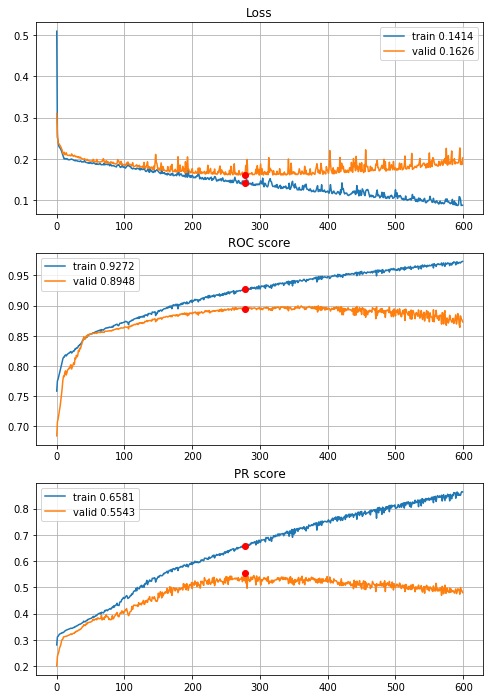


Fold 2------------------------------------------------------------


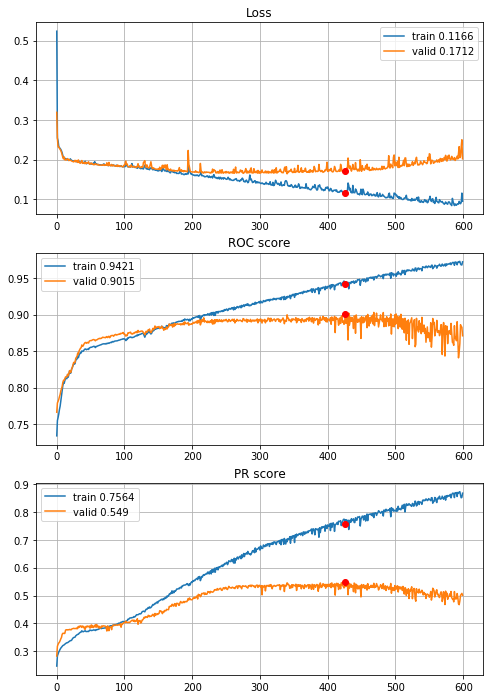


Fold 3------------------------------------------------------------


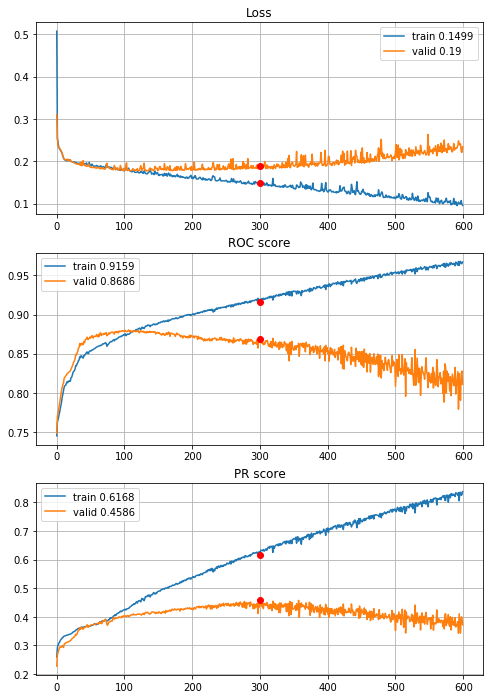


Fold 4------------------------------------------------------------


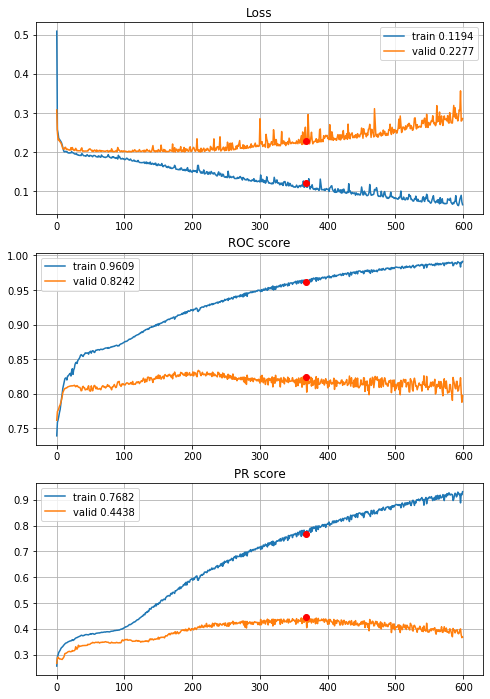


Fold 5------------------------------------------------------------


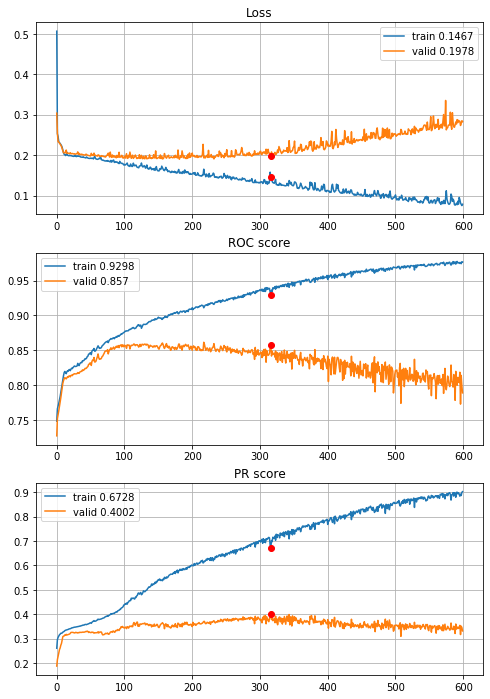


Fold 6------------------------------------------------------------


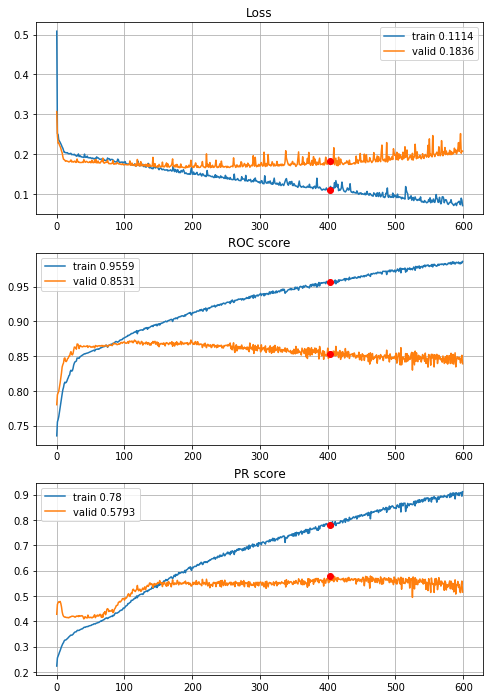

In [59]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_globalavg_64,
                                        features=features, target=target, n_epochs=600, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Global average pooling idea is a dead end. 3 inceptions try:

In [54]:
def define_deep_CNN_3inc_2dense_std(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    inception = inception_module(prev_layer=inception, f1=12, f2_in=6, f2_out=12, f3_in=6, f3_out=12,
                                 f4_out=12, random_state=random_state)                                  # (8,8,48)

    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,48)
    flat = layers.Flatten()(pool)                                                                       # (768,)
    dense = layers.Dense(units=384, use_bias=True, activation=activations.relu)(flat)                   # (384,)
    dense = layers.Dense(units=192, use_bias=True, activation=activations.relu)(dense)                  # (192,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/250,
cumulative time: 5.5s train loss: 0.3535312423650646, validation loss: 0.2694563667763449
Epoch: 2/250,
cumulative time: 7.34s train loss: 0.25406605360310003, validation loss: 0.25016175635503407
Epoch: 3/250,
cumulative time: 9.13s train loss: 0.23921498328124574, validation loss: 0.23920827484117418
Epoch: 4/250,
cumulative time: 10.94s train loss: 0.22470798717966364, validation loss: 0.2242518421997481
Epoch: 5/250,
cumulative time: 12.73s train loss: 0.20905320956926485, validation loss: 0.21553554069229822
Epoch: 6/250,
cumulative time: 14.63s train loss: 0.2046484325403879, validation loss: 0.22304015335329758
Epoch: 7/250,
cumulative time: 16.47s train loss: 0.2200304671436118, validation loss: 0.21405967226695047
Epoch: 8/250,
cumulative time: 18.33s train loss: 0.2043233148699848, validation loss: 0.2161749433873068
Epoch: 9/250,
cumulative time: 20.19s train loss: 0.20248534931172532

Epoch: 76/250,
cumulative time: 140.65s train loss: 0.1076246200075595, validation loss: 0.1941073718139526
Epoch: 77/250,
cumulative time: 142.48s train loss: 0.11031671576807107, validation loss: 0.191934825048237
Epoch: 78/250,
cumulative time: 144.25s train loss: 0.10622378575887921, validation loss: 0.19416658088077687
Epoch: 79/250,
cumulative time: 146.03s train loss: 0.10785311715347887, validation loss: 0.19296932339735473
Epoch: 80/250,
cumulative time: 147.82s train loss: 0.10281427526873425, validation loss: 0.20205556415651402
Epoch: 81/250,
cumulative time: 149.59s train loss: 0.10009414807217538, validation loss: 0.21414254546971842
Epoch: 82/250,
cumulative time: 151.39s train loss: 0.10156598108877775, validation loss: 0.2041803101306569
Epoch: 83/250,
cumulative time: 153.17s train loss: 0.09962176344952536, validation loss: 0.19958237389768257
Epoch: 84/250,
cumulative time: 154.95s train loss: 0.1007680126637328, validation loss: 0.2216539298937044
Epoch: 85/250,
cu

Epoch: 151/250,
cumulative time: 274.73s train loss: 0.022400808244286315, validation loss: 0.42293157350385335
Epoch: 152/250,
cumulative time: 276.53s train loss: 0.023336023426806345, validation loss: 0.4250749686256202
Epoch: 153/250,
cumulative time: 278.31s train loss: 0.0171384022408081, validation loss: 0.4306286430950229
Epoch: 154/250,
cumulative time: 280.12s train loss: 0.018490067232208536, validation loss: 0.45548322605307234
Epoch: 155/250,
cumulative time: 281.9s train loss: 0.01555814113255064, validation loss: 0.4638363359477098
Epoch: 156/250,
cumulative time: 283.69s train loss: 0.01679322433625163, validation loss: 0.4643057523612374
Epoch: 157/250,
cumulative time: 285.46s train loss: 0.016330656105491066, validation loss: 0.4456127992880519
Epoch: 158/250,
cumulative time: 287.25s train loss: 0.030577439631567428, validation loss: 0.44137018999628713
Epoch: 159/250,
cumulative time: 289.03s train loss: 0.0293326721499785, validation loss: 0.4750583967469053
Epoch

Epoch: 226/250,
cumulative time: 408.75s train loss: 0.008291143269161694, validation loss: 0.6735926978752067
Epoch: 227/250,
cumulative time: 410.54s train loss: 0.011582808532825223, validation loss: 0.6384938379419965
Epoch: 228/250,
cumulative time: 412.3s train loss: 0.006483983049972533, validation loss: 0.6425351941330188
Epoch: 229/250,
cumulative time: 414.08s train loss: 0.007255274906552317, validation loss: 0.655581130787915
Epoch: 230/250,
cumulative time: 415.87s train loss: 0.004079814210709769, validation loss: 0.6680277669980803
Epoch: 231/250,
cumulative time: 417.66s train loss: 0.0038936206429401607, validation loss: 0.6596446967313093
Epoch: 232/250,
cumulative time: 419.44s train loss: 0.009581586288347915, validation loss: 0.6614153449000474
Epoch: 233/250,
cumulative time: 421.23s train loss: 0.015474075459452162, validation loss: 0.6387011080207524
Epoch: 234/250,
cumulative time: 423.03s train loss: 0.008972385463566226, validation loss: 0.6068389824976915
Ep

Epoch: 49/250,
cumulative time: 91.78s train loss: 0.1517029146324265, validation loss: 0.16693497833028317
Epoch: 50/250,
cumulative time: 93.57s train loss: 0.15147370857183254, validation loss: 0.159542139682587
Epoch: 51/250,
cumulative time: 95.39s train loss: 0.14731326260156796, validation loss: 0.16483049680979706
Epoch: 52/250,
cumulative time: 97.2s train loss: 0.14883815943993065, validation loss: 0.17212604661603387
Epoch: 53/250,
cumulative time: 99.0s train loss: 0.14989599831980596, validation loss: 0.17339538919750974
Epoch: 54/250,
cumulative time: 100.8s train loss: 0.14925597004242752, validation loss: 0.16692720143609546
Epoch: 55/250,
cumulative time: 102.59s train loss: 0.15513954792064127, validation loss: 0.16210888065775728
Epoch: 56/250,
cumulative time: 104.39s train loss: 0.1497292205260979, validation loss: 0.17314941472171258
Epoch: 57/250,
cumulative time: 106.2s train loss: 0.15101545677933884, validation loss: 0.17481726169451786
Epoch: 58/250,
cumulati

Epoch: 124/250,
cumulative time: 227.25s train loss: 0.04781569861714469, validation loss: 0.26659560413546063
Epoch: 125/250,
cumulative time: 229.04s train loss: 0.054158715477435164, validation loss: 0.2841217870978384
Epoch: 126/250,
cumulative time: 230.86s train loss: 0.05456844443330938, validation loss: 0.2550149664635588
Epoch: 127/250,
cumulative time: 232.69s train loss: 0.05125390942669087, validation loss: 0.2707102965004952
Epoch: 128/250,
cumulative time: 234.49s train loss: 0.04493613378649127, validation loss: 0.26285008056322373
Epoch: 129/250,
cumulative time: 236.29s train loss: 0.04026180038914515, validation loss: 0.2766752406669174
Epoch: 130/250,
cumulative time: 238.08s train loss: 0.03954030983301303, validation loss: 0.2755838832497731
Epoch: 131/250,
cumulative time: 239.89s train loss: 0.04127016100891284, validation loss: 0.28361380100250244
Epoch: 132/250,
cumulative time: 241.7s train loss: 0.035815259289594926, validation loss: 0.28756687438205775
Epoch

Epoch: 198/250,
cumulative time: 360.93s train loss: 0.0060332401673528465, validation loss: 0.5571464989607336
Epoch: 199/250,
cumulative time: 362.73s train loss: 0.008765191211603037, validation loss: 0.5271732147274856
Epoch: 200/250,
cumulative time: 364.52s train loss: 0.011334227534206013, validation loss: 0.5349996539490064
Epoch: 201/250,
cumulative time: 366.33s train loss: 0.05379043322809659, validation loss: 0.6387654681350897
Epoch: 202/250,
cumulative time: 368.12s train loss: 0.0824971379155784, validation loss: 0.34873752358129084
Epoch: 203/250,
cumulative time: 369.9s train loss: 0.04603163570788477, validation loss: 0.3576778496669137
Epoch: 204/250,
cumulative time: 371.7s train loss: 0.024743142709453735, validation loss: 0.3936593400182154
Epoch: 205/250,
cumulative time: 373.5s train loss: 0.017583930676438198, validation loss: 0.4293661062787324
Epoch: 206/250,
cumulative time: 375.28s train loss: 0.01616001000610224, validation loss: 0.4192345990067539
Epoch: 

Epoch: 20/250,
cumulative time: 39.52s train loss: 0.18384225825217657, validation loss: 0.1854577431919341
Epoch: 21/250,
cumulative time: 41.36s train loss: 0.18273356890420192, validation loss: 0.17932129631988628
Epoch: 22/250,
cumulative time: 43.19s train loss: 0.18391272958220128, validation loss: 0.18436849797659016
Epoch: 23/250,
cumulative time: 45.01s train loss: 0.18378391557638718, validation loss: 0.18084402568848318
Epoch: 24/250,
cumulative time: 46.82s train loss: 0.18233775669903854, validation loss: 0.1772954022131751
Epoch: 25/250,
cumulative time: 48.65s train loss: 0.17710696937455814, validation loss: 0.17663550815359177
Epoch: 26/250,
cumulative time: 50.47s train loss: 0.17596896764038916, validation loss: 0.17651963328024983
Epoch: 27/250,
cumulative time: 52.32s train loss: 0.17395019913865556, validation loss: 0.17523431447003848
Epoch: 28/250,
cumulative time: 54.13s train loss: 0.17197359920166674, validation loss: 0.17645741142374552
Epoch: 29/250,
cumula

Epoch: 96/250,
cumulative time: 178.96s train loss: 0.10490791423125226, validation loss: 0.2350878960451924
Epoch: 97/250,
cumulative time: 180.86s train loss: 0.08211835874547166, validation loss: 0.21989660754615048
Epoch: 98/250,
cumulative time: 182.72s train loss: 0.07569511384713305, validation loss: 0.23194490974556903
Epoch: 99/250,
cumulative time: 184.62s train loss: 0.08307354821275503, validation loss: 0.24764247616624885
Epoch: 100/250,
cumulative time: 186.46s train loss: 0.07253878388305057, validation loss: 0.24829953416694783
Epoch: 101/250,
cumulative time: 188.29s train loss: 0.07875462978345339, validation loss: 0.2924811557825684
Epoch: 102/250,
cumulative time: 190.09s train loss: 0.08043859889377783, validation loss: 0.2500100327653573
Epoch: 103/250,
cumulative time: 191.92s train loss: 0.07386878913853466, validation loss: 0.2831337191374487
Epoch: 104/250,
cumulative time: 193.75s train loss: 0.06778002223033552, validation loss: 0.24913235487502483
Epoch: 10

Epoch: 171/250,
cumulative time: 316.73s train loss: 0.011537653701682492, validation loss: 0.5046202986256515
Epoch: 172/250,
cumulative time: 318.55s train loss: 0.011356215807819396, validation loss: 0.5307411436566909
Epoch: 173/250,
cumulative time: 320.36s train loss: 0.012094398941348781, validation loss: 0.5472394545828208
Epoch: 174/250,
cumulative time: 322.19s train loss: 0.011033649659935816, validation loss: 0.5230830747554375
Epoch: 175/250,
cumulative time: 324.04s train loss: 0.021666541655668954, validation loss: 0.5248743416290004
Epoch: 176/250,
cumulative time: 325.86s train loss: 0.021828022141838346, validation loss: 0.4826230057331459
Epoch: 177/250,
cumulative time: 327.68s train loss: 0.01657214066785313, validation loss: 0.536356575325081
Epoch: 178/250,
cumulative time: 329.51s train loss: 0.014262884265313677, validation loss: 0.5260137611876211
Epoch: 179/250,
cumulative time: 331.33s train loss: 0.00821039410743405, validation loss: 0.5205361561549422
Epoc

Epoch: 245/250,
cumulative time: 452.19s train loss: 0.0034621445215355508, validation loss: 0.7203275802573599
Epoch: 246/250,
cumulative time: 454.03s train loss: 0.0026951917459206304, validation loss: 0.7346946493614351
Epoch: 247/250,
cumulative time: 455.84s train loss: 0.003388888521121213, validation loss: 0.7507929039243377
Epoch: 248/250,
cumulative time: 457.66s train loss: 0.00277006249394118, validation loss: 0.7407213940023704
Epoch: 249/250,
cumulative time: 459.48s train loss: 0.002239047761731558, validation loss: 0.7345046031770739
Epoch: 250/250,
cumulative time: 461.31s train loss: 0.004918497850201097, validation loss: 0.7067993424387634

Early stopping results:
best results in epoch: 74, 
best valid PR: 0.5311751117088509, 
valid ROC: 0.8845161290322581        
overfitting PR: 0.21090114021163686, 
overfitting ROC: 0.06257932057784954

----------
Fold: 4
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/250,
cumulative time: 4.83s train loss: 0.34

Epoch: 68/250,
cumulative time: 130.05s train loss: 0.11534878716104702, validation loss: 0.2011463396234383
Epoch: 69/250,
cumulative time: 131.92s train loss: 0.11330009751507587, validation loss: 0.22916053840995643
Epoch: 70/250,
cumulative time: 133.79s train loss: 0.1103905393863246, validation loss: 0.19838444121669702
Epoch: 71/250,
cumulative time: 135.65s train loss: 0.10388622913125566, validation loss: 0.21831648438563464
Epoch: 72/250,
cumulative time: 137.51s train loss: 0.1034969677234742, validation loss: 0.20999012907660033
Epoch: 73/250,
cumulative time: 139.36s train loss: 0.10298005217371582, validation loss: 0.2261496692492246
Epoch: 74/250,
cumulative time: 141.23s train loss: 0.10248998534241084, validation loss: 0.21542486127962107
Epoch: 75/250,
cumulative time: 143.1s train loss: 0.10134257867633154, validation loss: 0.22363622483227646
Epoch: 76/250,
cumulative time: 144.96s train loss: 0.10705747208462432, validation loss: 0.23772709542553258
Epoch: 77/250,


Epoch: 143/250,
cumulative time: 270.03s train loss: 0.010415844835770398, validation loss: 0.4563581569469271
Epoch: 144/250,
cumulative time: 271.9s train loss: 0.009430096392281742, validation loss: 0.44339147970315834
Epoch: 145/250,
cumulative time: 273.77s train loss: 0.008792658663673519, validation loss: 0.48610597667252775
Epoch: 146/250,
cumulative time: 275.61s train loss: 0.008645183725054394, validation loss: 0.49942903546931783
Epoch: 147/250,
cumulative time: 277.47s train loss: 0.014108154099176625, validation loss: 0.4750483401338349
Epoch: 148/250,
cumulative time: 279.32s train loss: 0.00897444575056921, validation loss: 0.46649130230294394
Epoch: 149/250,
cumulative time: 281.15s train loss: 0.011297189067740783, validation loss: 0.5096570069041801
Epoch: 150/250,
cumulative time: 283.08s train loss: 0.013531612289681638, validation loss: 0.4625599522219285
Epoch: 151/250,
cumulative time: 284.93s train loss: 0.01484739296571069, validation loss: 0.4892278189852867


Epoch: 217/250,
cumulative time: 408.2s train loss: 0.014146272741758576, validation loss: 0.47922479722892725
Epoch: 218/250,
cumulative time: 410.04s train loss: 0.00965558679447926, validation loss: 0.5281463644170868
Epoch: 219/250,
cumulative time: 411.91s train loss: 0.00498072091117018, validation loss: 0.5201795138839136
Epoch: 220/250,
cumulative time: 413.75s train loss: 0.0035263782145939526, validation loss: 0.5339638966200853
Epoch: 221/250,
cumulative time: 415.6s train loss: 0.0027988047566495544, validation loss: 0.5378176167640945
Epoch: 222/250,
cumulative time: 417.46s train loss: 0.0053770749603286585, validation loss: 0.5491007878602762
Epoch: 223/250,
cumulative time: 419.31s train loss: 0.005700333278181656, validation loss: 0.5478003571318719
Epoch: 224/250,
cumulative time: 421.18s train loss: 0.01057044849230492, validation loss: 0.615546817838742
Epoch: 225/250,
cumulative time: 423.03s train loss: 0.008153816390063672, validation loss: 0.6093749564065352
Epo

Epoch: 40/250,
cumulative time: 80.57s train loss: 0.16270315267453203, validation loss: 0.20607007915494674
Epoch: 41/250,
cumulative time: 82.52s train loss: 0.16857269993222057, validation loss: 0.17542655951013414
Epoch: 42/250,
cumulative time: 84.56s train loss: 0.15296318793294125, validation loss: 0.18007560121421082
Epoch: 43/250,
cumulative time: 86.58s train loss: 0.15096593951563145, validation loss: 0.18824669607740493
Epoch: 44/250,
cumulative time: 88.61s train loss: 0.1494596549741522, validation loss: 0.17841995048334583
Epoch: 45/250,
cumulative time: 90.63s train loss: 0.14739392622515388, validation loss: 0.1782780157793187
Epoch: 46/250,
cumulative time: 92.65s train loss: 0.14539534163621595, validation loss: 0.18282628658124608
Epoch: 47/250,
cumulative time: 94.54s train loss: 0.14877291058353825, validation loss: 0.19489654817914856
Epoch: 48/250,
cumulative time: 96.42s train loss: 0.14872450471099172, validation loss: 0.175888096270389
Epoch: 49/250,
cumulati

Epoch: 115/250,
cumulative time: 223.87s train loss: 0.08683580127367176, validation loss: 0.22575581554769125
Epoch: 116/250,
cumulative time: 225.75s train loss: 0.06794819413767714, validation loss: 0.2314795040048272
Epoch: 117/250,
cumulative time: 227.64s train loss: 0.05316204112548337, validation loss: 0.2680832296273509
Epoch: 118/250,
cumulative time: 229.53s train loss: 0.04629307490547234, validation loss: 0.26026687631488654
Epoch: 119/250,
cumulative time: 231.48s train loss: 0.0456701974152759, validation loss: 0.26589866140626084
Epoch: 120/250,
cumulative time: 233.45s train loss: 0.041556762086011986, validation loss: 0.29554194750150764
Epoch: 121/250,
cumulative time: 235.4s train loss: 0.042012428359783804, validation loss: 0.28377590908692063
Epoch: 122/250,
cumulative time: 237.31s train loss: 0.03938827120539111, validation loss: 0.2930556645377226
Epoch: 123/250,
cumulative time: 239.37s train loss: 0.03902823668964478, validation loss: 0.2875735845845655
Epoch

Epoch: 189/250,
cumulative time: 365.02s train loss: 0.006595321966765018, validation loss: 0.5103428502384212
Epoch: 190/250,
cumulative time: 366.89s train loss: 0.005736196292467632, validation loss: 0.5358608774756739
Epoch: 191/250,
cumulative time: 368.77s train loss: 0.016115635298797556, validation loss: 0.5251075578327911
Epoch: 192/250,
cumulative time: 370.64s train loss: 0.03533179872767391, validation loss: 0.5203105966070705
Epoch: 193/250,
cumulative time: 372.51s train loss: 0.014806780324626555, validation loss: 0.5244961430068479
Epoch: 194/250,
cumulative time: 374.42s train loss: 0.014989161957622569, validation loss: 0.6031213046196621
Epoch: 195/250,
cumulative time: 376.29s train loss: 0.015965336314390965, validation loss: 0.48995050565921966
Epoch: 196/250,
cumulative time: 378.29s train loss: 0.012200454583808784, validation loss: 0.5384215215393436
Epoch: 197/250,
cumulative time: 380.31s train loss: 0.03188173736878598, validation loss: 0.5141306752275936
Ep

Epoch: 11/250,
cumulative time: 25.02s train loss: 0.1989012399329952, validation loss: 0.18486851151048733
Epoch: 12/250,
cumulative time: 26.96s train loss: 0.2006917493239284, validation loss: 0.18099700741923958
Epoch: 13/250,
cumulative time: 28.87s train loss: 0.19582833559121016, validation loss: 0.17960448633736467
Epoch: 14/250,
cumulative time: 30.78s train loss: 0.19098108554434998, validation loss: 0.178620641105062
Epoch: 15/250,
cumulative time: 32.69s train loss: 0.19031434402814332, validation loss: 0.17881329801631565
Epoch: 16/250,
cumulative time: 34.59s train loss: 0.1885589904261313, validation loss: 0.1775032365967942
Epoch: 17/250,
cumulative time: 36.51s train loss: 0.18587099850016417, validation loss: 0.18148824162192592
Epoch: 18/250,
cumulative time: 38.41s train loss: 0.18373603312083944, validation loss: 0.17698879324690214
Epoch: 19/250,
cumulative time: 40.31s train loss: 0.18637747576213598, validation loss: 0.17900947829536068
Epoch: 20/250,
cumulative

Epoch: 87/250,
cumulative time: 171.61s train loss: 0.08075266405301387, validation loss: 0.21355447516215306
Epoch: 88/250,
cumulative time: 173.53s train loss: 0.07478975006306707, validation loss: 0.21449183452344642
Epoch: 89/250,
cumulative time: 175.43s train loss: 0.07284743950937339, validation loss: 0.20373495824584573
Epoch: 90/250,
cumulative time: 177.34s train loss: 0.07763745543813157, validation loss: 0.21247406704162097
Epoch: 91/250,
cumulative time: 179.25s train loss: 0.07580096536300641, validation loss: 0.22669015067963783
Epoch: 92/250,
cumulative time: 181.14s train loss: 0.08406056492038352, validation loss: 0.21531715854565123
Epoch: 93/250,
cumulative time: 183.05s train loss: 0.07574345145400588, validation loss: 0.2239807425382175
Epoch: 94/250,
cumulative time: 184.95s train loss: 0.07207207205923206, validation loss: 0.20622461829040176
Epoch: 95/250,
cumulative time: 186.85s train loss: 0.07031249548225567, validation loss: 0.2095707813382956
Epoch: 96/25

Epoch: 162/250,
cumulative time: 316.02s train loss: 0.009118723777599067, validation loss: 0.38341865178962864
Epoch: 163/250,
cumulative time: 317.97s train loss: 0.007841917779338655, validation loss: 0.34919742012131566
Epoch: 164/250,
cumulative time: 319.96s train loss: 0.007923951803080732, validation loss: 0.3462044075299601
Epoch: 165/250,
cumulative time: 322.0s train loss: 0.012854594934144314, validation loss: 0.3792430330614473
Epoch: 166/250,
cumulative time: 324.06s train loss: 0.014308996274105123, validation loss: 0.34644404356420444
Epoch: 167/250,
cumulative time: 326.14s train loss: 0.008756325801823119, validation loss: 0.36845065629778273
Epoch: 168/250,
cumulative time: 328.08s train loss: 0.006565360995110384, validation loss: 0.38849135412588615
Epoch: 169/250,
cumulative time: 330.11s train loss: 0.007705349563382534, validation loss: 0.4027140843545341
Epoch: 170/250,
cumulative time: 332.14s train loss: 0.008622478937006227, validation loss: 0.38682018452519

Epoch: 236/250,
cumulative time: 460.63s train loss: 0.004573180992319086, validation loss: 0.47633164535795863
Epoch: 237/250,
cumulative time: 462.55s train loss: 0.005024467343288019, validation loss: 0.49123897657437465
Epoch: 238/250,
cumulative time: 464.57s train loss: 0.004061277075236827, validation loss: 0.48261561182497853
Epoch: 239/250,
cumulative time: 466.57s train loss: 0.003634184891602351, validation loss: 0.504541307889581
Epoch: 240/250,
cumulative time: 468.56s train loss: 0.003996393840369543, validation loss: 0.49565662285544265
Epoch: 241/250,
cumulative time: 470.52s train loss: 0.0026498683120990446, validation loss: 0.47105124202592646
Epoch: 242/250,
cumulative time: 472.54s train loss: 0.002710787206969608, validation loss: 0.4790137190851078
Epoch: 243/250,
cumulative time: 474.58s train loss: 0.002911974658371602, validation loss: 0.5058912648304321
Epoch: 244/250,
cumulative time: 476.58s train loss: 0.002692492565799491, validation loss: 0.4897453819252

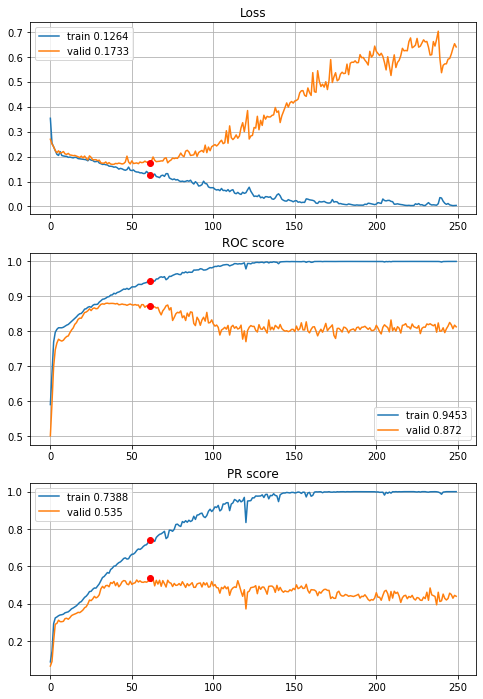


Fold 2------------------------------------------------------------


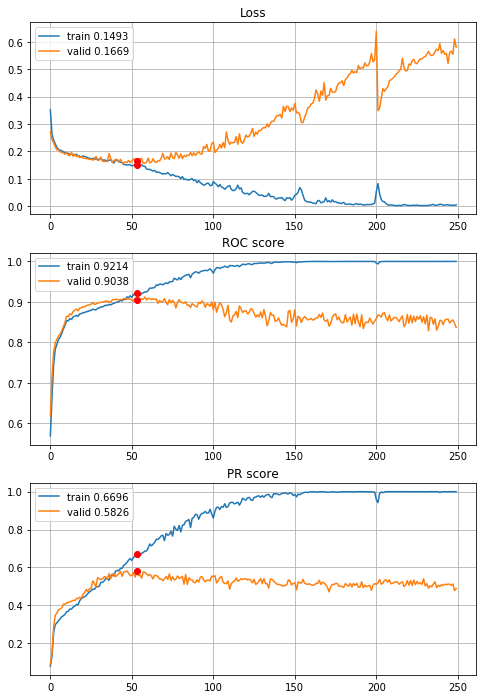


Fold 3------------------------------------------------------------


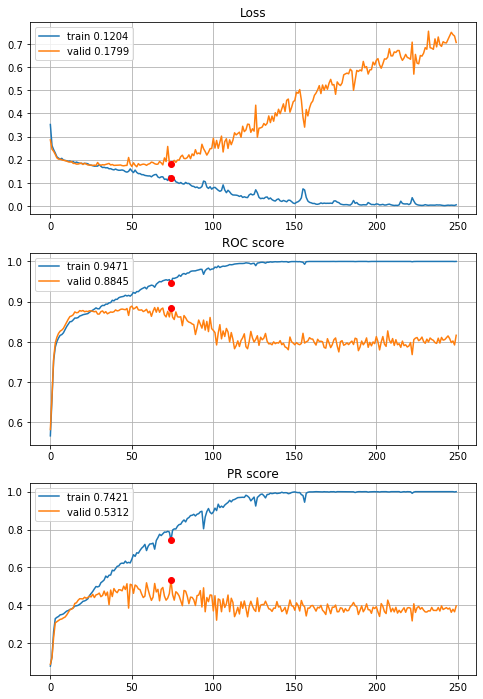


Fold 4------------------------------------------------------------


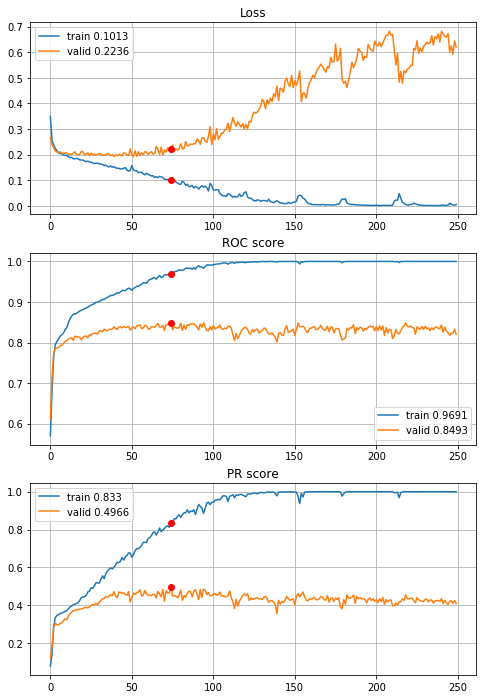


Fold 5------------------------------------------------------------


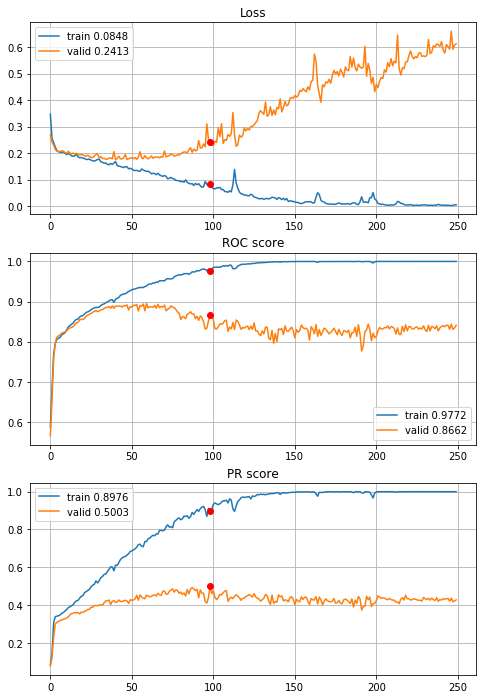


Fold 6------------------------------------------------------------


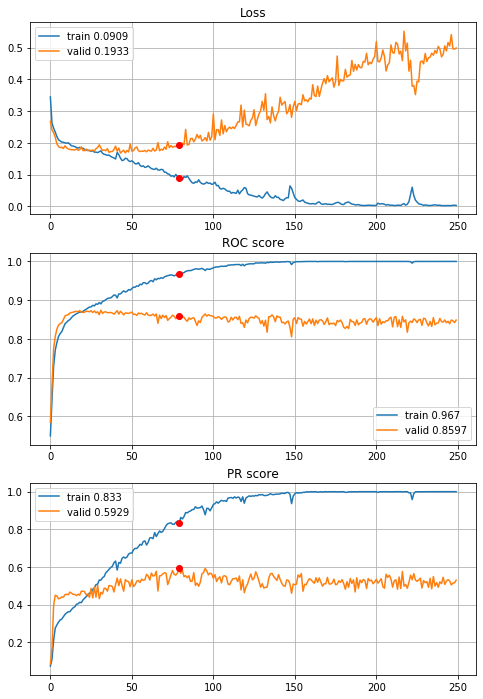

In [61]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_3inc_2dense_std,
                                        features=features, target=target, n_epochs=250, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Looks worse than 2 inceptions 2 denses and 2 inceptions 2 dense, maybe som L1 regularization can help

In [55]:
def define_deep_CNN_3inc_2dense_std_L1(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    inception = inception_module(prev_layer=inception, f1=12, f2_in=6, f2_out=12, f3_in=6, f3_out=12,
                                 f4_out=12, random_state=random_state)                                  # (8,8,48)

    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,48)
    flat = layers.Flatten()(pool)                                                                       # (768,)
    dense = layers.Dense(units=384, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.001))(flat)                             # (384,)
    dense = layers.Dense(units=192, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.001))(dense)                            # (192,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/250,
cumulative time: 4.95s train loss: 13.194921691495159, validation loss: 11.075174802588771
Epoch: 2/250,
cumulative time: 6.88s train loss: 9.647863525345867, validation loss: 7.882699640654657
Epoch: 3/250,
cumulative time: 8.82s train loss: 6.7106001316855535, validation loss: 5.279148906032558
Epoch: 4/250,
cumulative time: 10.74s train loss: 4.364458349422427, validation loss: 3.280056010507543
Epoch: 5/250,
cumulative time: 12.65s train loss: 2.6355653277157876, validation loss: 1.9173016575035946
Epoch: 6/250,
cumulative time: 14.57s train loss: 1.545359583430342, validation loss: 1.1935221444660002
Epoch: 7/250,
cumulative time: 16.49s train loss: 1.0173911597270398, validation loss: 0.804785605079023
Epoch: 8/250,
cumulative time: 18.49s train loss: 0.6910318383671317, validation loss: 0.581706772527942
Epoch: 9/250,
cumulative time: 20.5s train loss: 0.5253491232353212, validation loss:

Epoch: 77/250,
cumulative time: 151.01s train loss: 0.2428946417457145, validation loss: 0.24941653826325427
Epoch: 78/250,
cumulative time: 152.91s train loss: 0.24209980053376634, validation loss: 0.24916218965405676
Epoch: 79/250,
cumulative time: 154.85s train loss: 0.24030554289206701, validation loss: 0.2491370512775262
Epoch: 80/250,
cumulative time: 156.76s train loss: 0.24299356432140734, validation loss: 0.2505825470036826
Epoch: 81/250,
cumulative time: 158.66s train loss: 0.24297279832945187, validation loss: 0.2577523159402871
Epoch: 82/250,
cumulative time: 160.56s train loss: 0.24079279116748256, validation loss: 0.2521074163940606
Epoch: 83/250,
cumulative time: 162.44s train loss: 0.24090756242590475, validation loss: 0.24909676273753437
Epoch: 84/250,
cumulative time: 164.36s train loss: 0.23932872632592378, validation loss: 0.25499459566903354
Epoch: 85/250,
cumulative time: 166.24s train loss: 0.2429091164687588, validation loss: 0.2500082562512717
Epoch: 86/250,
cu

Epoch: 152/250,
cumulative time: 294.78s train loss: 0.2367225900319294, validation loss: 0.24801547437267885
Epoch: 153/250,
cumulative time: 296.66s train loss: 0.23608797474592816, validation loss: 0.24596019144660322
Epoch: 154/250,
cumulative time: 298.57s train loss: 0.23501138089876958, validation loss: 0.2439085847226716
Epoch: 155/250,
cumulative time: 300.46s train loss: 0.23472351561357613, validation loss: 0.24548245474208974
Epoch: 156/250,
cumulative time: 302.35s train loss: 0.2369163879445529, validation loss: 0.24344861840045975
Epoch: 157/250,
cumulative time: 304.26s train loss: 0.23562800750432247, validation loss: 0.24312055386443282
Epoch: 158/250,
cumulative time: 306.16s train loss: 0.2360297381299605, validation loss: 0.24311093519008145
Epoch: 159/250,
cumulative time: 308.06s train loss: 0.23553080359198125, validation loss: 0.24330574976282432
Epoch: 160/250,
cumulative time: 309.98s train loss: 0.23583645851011742, validation loss: 0.24284537344868584
Epoch

Epoch: 227/250,
cumulative time: 438.38s train loss: 0.22970914010240928, validation loss: 0.2367536390143559
Epoch: 228/250,
cumulative time: 440.29s train loss: 0.23151238986193487, validation loss: 0.23674688075817155
Epoch: 229/250,
cumulative time: 442.22s train loss: 0.22764416605852786, validation loss: 0.23643410970218556
Epoch: 230/250,
cumulative time: 444.13s train loss: 0.22680212007263936, validation loss: 0.235296586102133
Epoch: 231/250,
cumulative time: 446.06s train loss: 0.2264189340496967, validation loss: 0.23546632924437388
Epoch: 232/250,
cumulative time: 447.98s train loss: 0.22657955567678606, validation loss: 0.23506215332325847
Epoch: 233/250,
cumulative time: 449.87s train loss: 0.22595502387745717, validation loss: 0.23507787218357287
Epoch: 234/250,
cumulative time: 451.77s train loss: 0.22700060306903688, validation loss: 0.23638402343871495
Epoch: 235/250,
cumulative time: 453.67s train loss: 0.22714181668007416, validation loss: 0.23585780732661252
Epoch

Epoch: 50/250,
cumulative time: 99.97s train loss: 0.24224875117601685, validation loss: 0.23962506265489736
Epoch: 51/250,
cumulative time: 101.87s train loss: 0.24401363097669201, validation loss: 0.24225913418253217
Epoch: 52/250,
cumulative time: 103.77s train loss: 0.24268186214087456, validation loss: 0.24330687247376298
Epoch: 53/250,
cumulative time: 105.68s train loss: 0.2441124483835396, validation loss: 0.23934619404215957
Epoch: 54/250,
cumulative time: 107.6s train loss: 0.2434867782928453, validation loss: 0.23906183632546374
Epoch: 55/250,
cumulative time: 109.5s train loss: 0.2444678037645907, validation loss: 0.24511389874484654
Epoch: 56/250,
cumulative time: 111.39s train loss: 0.2442509535471455, validation loss: 0.23943669632026818
Epoch: 57/250,
cumulative time: 113.29s train loss: 0.24819868057966232, validation loss: 0.2402290393931218
Epoch: 58/250,
cumulative time: 115.2s train loss: 0.24532760845813295, validation loss: 0.24333430774585504
Epoch: 59/250,
cumu

Epoch: 125/250,
cumulative time: 243.04s train loss: 0.23533896791214118, validation loss: 0.2331899199235802
Epoch: 126/250,
cumulative time: 244.93s train loss: 0.23674476989259144, validation loss: 0.23434326481053094
Epoch: 127/250,
cumulative time: 246.84s train loss: 0.2364879599452987, validation loss: 0.23316076528931953
Epoch: 128/250,
cumulative time: 248.74s train loss: 0.23731686266993143, validation loss: 0.23739525776570652
Epoch: 129/250,
cumulative time: 250.63s train loss: 0.2374039776354275, validation loss: 0.24109222309027611
Epoch: 130/250,
cumulative time: 252.69s train loss: 0.24446858006398386, validation loss: 0.23425348061047654
Epoch: 131/250,
cumulative time: 254.66s train loss: 0.23787030887652175, validation loss: 0.23768252740785262
Epoch: 132/250,
cumulative time: 256.65s train loss: 0.2369441430652615, validation loss: 0.23336790429833507
Epoch: 133/250,
cumulative time: 258.58s train loss: 0.2356371034528482, validation loss: 0.2327254314601354
Epoch: 

Epoch: 200/250,
cumulative time: 386.52s train loss: 0.23475206775812682, validation loss: 0.2326666038428783
Epoch: 201/250,
cumulative time: 388.42s train loss: 0.23290000795403543, validation loss: 0.22963049359359225
Epoch: 202/250,
cumulative time: 390.32s train loss: 0.23222752069442495, validation loss: 0.22955967039037853
Epoch: 203/250,
cumulative time: 392.23s train loss: 0.23120689954918, validation loss: 0.2310733592563982
Epoch: 204/250,
cumulative time: 394.12s train loss: 0.23220057734405952, validation loss: 0.22895995187315893
Epoch: 205/250,
cumulative time: 396.03s train loss: 0.230996056745629, validation loss: 0.22850198477607434
Epoch: 206/250,
cumulative time: 397.94s train loss: 0.23198576097373283, validation loss: 0.2423589066460544
Epoch: 207/250,
cumulative time: 399.83s train loss: 0.2361711527721869, validation loss: 0.23020881484971376
Epoch: 208/250,
cumulative time: 401.71s train loss: 0.2328822910785675, validation loss: 0.22941361997683932
Epoch: 209/

Epoch: 23/250,
cumulative time: 49.45s train loss: 0.25314836867072954, validation loss: 0.2521828123218177
Epoch: 24/250,
cumulative time: 51.42s train loss: 0.25161911492044314, validation loss: 0.25020311199960205
Epoch: 25/250,
cumulative time: 53.37s train loss: 0.25050904634089244, validation loss: 0.24897656595626302
Epoch: 26/250,
cumulative time: 55.38s train loss: 0.2507889536865029, validation loss: 0.24886558214129026
Epoch: 27/250,
cumulative time: 57.34s train loss: 0.25019676329749585, validation loss: 0.24836278621951516
Epoch: 28/250,
cumulative time: 59.31s train loss: 0.24849393997435534, validation loss: 0.24775339256480688
Epoch: 29/250,
cumulative time: 61.29s train loss: 0.24798273373166577, validation loss: 0.24670106364076005
Epoch: 30/250,
cumulative time: 63.28s train loss: 0.24851847696202112, validation loss: 0.24709570674979567
Epoch: 31/250,
cumulative time: 65.25s train loss: 0.2490281017382868, validation loss: 0.24670025662612485
Epoch: 32/250,
cumulat

Epoch: 99/250,
cumulative time: 199.37s train loss: 0.234964569512795, validation loss: 0.22886180865925893
Epoch: 100/250,
cumulative time: 201.33s train loss: 0.2348279196513474, validation loss: 0.23652947427791027
Epoch: 101/250,
cumulative time: 203.3s train loss: 0.23535127890723276, validation loss: 0.2285842249398839
Epoch: 102/250,
cumulative time: 205.26s train loss: 0.2338829276552054, validation loss: 0.2289400453497619
Epoch: 103/250,
cumulative time: 207.23s train loss: 0.2331636722202981, validation loss: 0.22842009804025712
Epoch: 104/250,
cumulative time: 209.19s train loss: 0.23444649247647623, validation loss: 0.23370971612153488
Epoch: 105/250,
cumulative time: 211.16s train loss: 0.2351263087269739, validation loss: 0.23032727528451663
Epoch: 106/250,
cumulative time: 213.13s train loss: 0.2341557426936252, validation loss: 0.2270358754689422
Epoch: 107/250,
cumulative time: 215.12s train loss: 0.2369060074096875, validation loss: 0.2365240949923183
Epoch: 108/250,

Epoch: 174/250,
cumulative time: 347.44s train loss: 0.22729296352889133, validation loss: 0.22323616831789156
Epoch: 175/250,
cumulative time: 349.38s train loss: 0.22730889092014583, validation loss: 0.22396778264067219
Epoch: 176/250,
cumulative time: 351.36s train loss: 0.22684128327624678, validation loss: 0.22887704073710802
Epoch: 177/250,
cumulative time: 353.31s train loss: 0.23066689692007292, validation loss: 0.22383791062111516
Epoch: 178/250,
cumulative time: 355.27s train loss: 0.22842326152410747, validation loss: 0.2252675665137195
Epoch: 179/250,
cumulative time: 357.23s train loss: 0.23135322009613368, validation loss: 0.22777283818302455
Epoch: 180/250,
cumulative time: 359.19s train loss: 0.2285189595450025, validation loss: 0.22513105865597322
Epoch: 181/250,
cumulative time: 361.15s train loss: 0.22723510818360945, validation loss: 0.22377420214278856
Epoch: 182/250,
cumulative time: 363.12s train loss: 0.22648629274501697, validation loss: 0.22368702275642816
Epo

Epoch: 249/250,
cumulative time: 495.74s train loss: 0.2220608302953549, validation loss: 0.22113505991967447
Epoch: 250/250,
cumulative time: 497.69s train loss: 0.222504273077157, validation loss: 0.22021158719949818

Early stopping results:
best results in epoch: 161, 
best valid PR: 0.48559481784312747, 
valid ROC: 0.881466275659824        
overfitting PR: -0.07972286323165279, 
overfitting ROC: -0.015374083378706604

----------
Fold: 4
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/250,
cumulative time: 5.02s train loss: 13.19024522089942, validation loss: 11.063079282876869
Epoch: 2/250,
cumulative time: 7.01s train loss: 9.64407613200526, validation loss: 7.8705313749291825
Epoch: 3/250,
cumulative time: 8.96s train loss: 6.70682339665047, validation loss: 5.266227165678554
Epoch: 4/250,
cumulative time: 10.93s train loss: 4.362881084556588, validation loss: 3.2676775563113036
Epoch: 5/250,
cumulative time: 12.9s train loss: 2.6355932092871, validation loss: 

Epoch: 73/250,
cumulative time: 146.76s train loss: 0.23488187375454286, validation loss: 0.2559815625708475
Epoch: 74/250,
cumulative time: 148.72s train loss: 0.23699130282266506, validation loss: 0.25639752922558623
Epoch: 75/250,
cumulative time: 150.68s train loss: 0.2372553747339763, validation loss: 0.2562287153831723
Epoch: 76/250,
cumulative time: 152.63s train loss: 0.2368284599313934, validation loss: 0.25796756346796224
Epoch: 77/250,
cumulative time: 154.58s train loss: 0.2405733111787805, validation loss: 0.25546403757336444
Epoch: 78/250,
cumulative time: 156.54s train loss: 0.23842633955773934, validation loss: 0.25624892085319717
Epoch: 79/250,
cumulative time: 158.48s train loss: 0.23513198468961055, validation loss: 0.2580788758148189
Epoch: 80/250,
cumulative time: 160.47s train loss: 0.23505160613533824, validation loss: 0.25634214245035203
Epoch: 81/250,
cumulative time: 162.42s train loss: 0.23400427496193926, validation loss: 0.2568943352852664
Epoch: 82/250,
cu

Epoch: 148/250,
cumulative time: 294.02s train loss: 0.22738830216469302, validation loss: 0.25504814868721415
Epoch: 149/250,
cumulative time: 295.98s train loss: 0.22826828033626148, validation loss: 0.25444361399312587
Epoch: 150/250,
cumulative time: 297.92s train loss: 0.22647911844997354, validation loss: 0.2534997188076209
Epoch: 151/250,
cumulative time: 299.89s train loss: 0.22763454554421408, validation loss: 0.2534419352663828
Epoch: 152/250,
cumulative time: 301.86s train loss: 0.2277131121636728, validation loss: 0.2550275053315991
Epoch: 153/250,
cumulative time: 303.82s train loss: 0.22611997907650597, validation loss: 0.25310954391014495
Epoch: 154/250,
cumulative time: 305.76s train loss: 0.22660313003116447, validation loss: 0.2540632680764855
Epoch: 155/250,
cumulative time: 307.7s train loss: 0.22652561299396964, validation loss: 0.25361336441395244
Epoch: 156/250,
cumulative time: 309.65s train loss: 0.22723312593598197, validation loss: 0.2532892274600927
Epoch: 1

Epoch: 223/250,
cumulative time: 440.64s train loss: 0.21867760220244645, validation loss: 0.2503224283994993
Epoch: 224/250,
cumulative time: 442.6s train loss: 0.21788552106973041, validation loss: 0.25752135482248817
Epoch: 225/250,
cumulative time: 444.55s train loss: 0.22173762342649095, validation loss: 0.2575489791198455
Epoch: 226/250,
cumulative time: 446.5s train loss: 0.2194938089235518, validation loss: 0.2497903105905847
Epoch: 227/250,
cumulative time: 448.44s train loss: 0.21843189294198928, validation loss: 0.24935077409981066
Epoch: 228/250,
cumulative time: 450.38s train loss: 0.21880800227077665, validation loss: 0.2483092560926894
Epoch: 229/250,
cumulative time: 452.33s train loss: 0.21828589505544774, validation loss: 0.24942430796660903
Epoch: 230/250,
cumulative time: 454.27s train loss: 0.21745170608831801, validation loss: 0.25314804077417535
Epoch: 231/250,
cumulative time: 456.22s train loss: 0.21932241147833217, validation loss: 0.2516886264287591
Epoch: 23

Epoch: 47/250,
cumulative time: 97.99s train loss: 0.24362359422339078, validation loss: 0.24999871829831574
Epoch: 48/250,
cumulative time: 100.01s train loss: 0.24294804086030108, validation loss: 0.24935203763755126
Epoch: 49/250,
cumulative time: 102.05s train loss: 0.24297398506263942, validation loss: 0.24923614437773858
Epoch: 50/250,
cumulative time: 104.06s train loss: 0.2425625768023529, validation loss: 0.24888230507045514
Epoch: 51/250,
cumulative time: 106.08s train loss: 0.24309946123671106, validation loss: 0.24906027236318481
Epoch: 52/250,
cumulative time: 108.09s train loss: 0.24311000618645817, validation loss: 0.25392517948661913
Epoch: 53/250,
cumulative time: 110.13s train loss: 0.24340339969383953, validation loss: 0.2506203943733168
Epoch: 54/250,
cumulative time: 112.13s train loss: 0.2440162629205057, validation loss: 0.25042879046624184
Epoch: 55/250,
cumulative time: 114.13s train loss: 0.24191240342104917, validation loss: 0.24914688830585566
Epoch: 56/250,

Epoch: 122/250,
cumulative time: 249.58s train loss: 0.22969755315898963, validation loss: 0.23979165013164752
Epoch: 123/250,
cumulative time: 251.58s train loss: 0.23235995953908065, validation loss: 0.2441506266728481
Epoch: 124/250,
cumulative time: 253.61s train loss: 0.23578726073877015, validation loss: 0.2516012596761131
Epoch: 125/250,
cumulative time: 255.62s train loss: 0.23178980896993548, validation loss: 0.24003288072468734
Epoch: 126/250,
cumulative time: 257.65s train loss: 0.23183648841203053, validation loss: 0.2403368402280872
Epoch: 127/250,
cumulative time: 259.66s train loss: 0.22868679529074862, validation loss: 0.23961155866661674
Epoch: 128/250,
cumulative time: 261.66s train loss: 0.22830671551008136, validation loss: 0.2391656129946827
Epoch: 129/250,
cumulative time: 263.75s train loss: 0.22910557509463608, validation loss: 0.2410562931818564
Epoch: 130/250,
cumulative time: 265.76s train loss: 0.23164229674490425, validation loss: 0.24784632060786133
Epoch:

Epoch: 197/250,
cumulative time: 400.89s train loss: 0.22295139352489535, validation loss: 0.2389406072097761
Epoch: 198/250,
cumulative time: 402.91s train loss: 0.22247775938692144, validation loss: 0.23805780170598903
Epoch: 199/250,
cumulative time: 404.91s train loss: 0.22189047370595907, validation loss: 0.23907943238119508
Epoch: 200/250,
cumulative time: 406.88s train loss: 0.22219609794728568, validation loss: 0.23742740101792742
Epoch: 201/250,
cumulative time: 408.9s train loss: 0.22177908794621218, validation loss: 0.23802725287915352
Epoch: 202/250,
cumulative time: 410.9s train loss: 0.2219205001272898, validation loss: 0.23754344150659462
Epoch: 203/250,
cumulative time: 412.91s train loss: 0.22238851249043193, validation loss: 0.23798482416042085
Epoch: 204/250,
cumulative time: 414.91s train loss: 0.22116013821537975, validation loss: 0.23859925632013962
Epoch: 205/250,
cumulative time: 416.93s train loss: 0.2224932737982948, validation loss: 0.23730863247310605
Epoch:

Epoch: 20/250,
cumulative time: 44.09s train loss: 0.25920326152962214, validation loss: 0.23900167284108714
Epoch: 21/250,
cumulative time: 46.1s train loss: 0.25770970331259135, validation loss: 0.23768233590282112
Epoch: 22/250,
cumulative time: 48.1s train loss: 0.2579033046846543, validation loss: 0.23594282369043165
Epoch: 23/250,
cumulative time: 50.12s train loss: 0.25545325369725186, validation loss: 0.236099076425787
Epoch: 24/250,
cumulative time: 52.21s train loss: 0.2559862076402544, validation loss: 0.2375604525780301
Epoch: 25/250,
cumulative time: 54.28s train loss: 0.25445493727673696, validation loss: 0.23517018842508777
Epoch: 26/250,
cumulative time: 56.33s train loss: 0.2527211368077231, validation loss: 0.23386086069434275
Epoch: 27/250,
cumulative time: 58.39s train loss: 0.2537375465758143, validation loss: 0.23419754963965234
Epoch: 28/250,
cumulative time: 60.41s train loss: 0.25170935881667605, validation loss: 0.2360608099411088
Epoch: 29/250,
cumulative tim

Epoch: 96/250,
cumulative time: 197.14s train loss: 0.24131344038276298, validation loss: 0.23641335937293334
Epoch: 97/250,
cumulative time: 199.14s train loss: 0.2375902954548658, validation loss: 0.23283432208792082
Epoch: 98/250,
cumulative time: 201.15s train loss: 0.23769471677221457, validation loss: 0.23065548903113295
Epoch: 99/250,
cumulative time: 203.15s train loss: 0.23741530849706124, validation loss: 0.23231605751519815
Epoch: 100/250,
cumulative time: 205.16s train loss: 0.23735289840364251, validation loss: 0.23273357062791863
Epoch: 101/250,
cumulative time: 207.15s train loss: 0.24196354779625973, validation loss: 0.23102253715825136
Epoch: 102/250,
cumulative time: 209.17s train loss: 0.2367665723433431, validation loss: 0.2335656001726607
Epoch: 103/250,
cumulative time: 211.19s train loss: 0.2383996269623851, validation loss: 0.23207263685510604
Epoch: 104/250,
cumulative time: 213.17s train loss: 0.2361844375665694, validation loss: 0.23228982050585692
Epoch: 105

Epoch: 171/250,
cumulative time: 347.95s train loss: 0.2323823073009538, validation loss: 0.2281836310641222
Epoch: 172/250,
cumulative time: 349.99s train loss: 0.23172161778396874, validation loss: 0.228296179702804
Epoch: 173/250,
cumulative time: 351.97s train loss: 0.23133318014266446, validation loss: 0.22979232611693862
Epoch: 174/250,
cumulative time: 354.0s train loss: 0.23060286705929028, validation loss: 0.22829123335821097
Epoch: 175/250,
cumulative time: 356.0s train loss: 0.2305293754163349, validation loss: 0.2293555320116521
Epoch: 176/250,
cumulative time: 357.99s train loss: 0.23329249201537847, validation loss: 0.22913190702283356
Epoch: 177/250,
cumulative time: 360.0s train loss: 0.23088041759360167, validation loss: 0.22905207662496288
Epoch: 178/250,
cumulative time: 362.0s train loss: 0.2312590010496125, validation loss: 0.233367957427055
Epoch: 179/250,
cumulative time: 364.0s train loss: 0.23166693836121158, validation loss: 0.2286629678164325
Epoch: 180/250,


Epoch: 246/250,
cumulative time: 498.82s train loss: 0.22685116225928775, validation loss: 0.2289078443502465
Epoch: 247/250,
cumulative time: 500.85s train loss: 0.23066309674945717, validation loss: 0.22672628498642494
Epoch: 248/250,
cumulative time: 502.87s train loss: 0.2298495302868836, validation loss: 0.23258893545002216
Epoch: 249/250,
cumulative time: 504.88s train loss: 0.22997924378244705, validation loss: 0.22941051665735568
Epoch: 250/250,
cumulative time: 506.86s train loss: 0.22705195407189233, validation loss: 0.2266300000738075

Early stopping results:
best results in epoch: 238, 
best valid PR: 0.5130942542153228, 
valid ROC: 0.854942871336314        
overfitting PR: -0.06699728911434866, 
overfitting ROC: 0.014142134566873854

Cross validation time: 2998s
ROC: 		0.8561975652879936
PR: 		0.4406746564080734
overfittingROC: 0.01438668621215955
overfittingPR:  -0.0014360919713356513
early stopping: [241, 237, 161, 242, 142, 238]

Fold 1----------------------------------

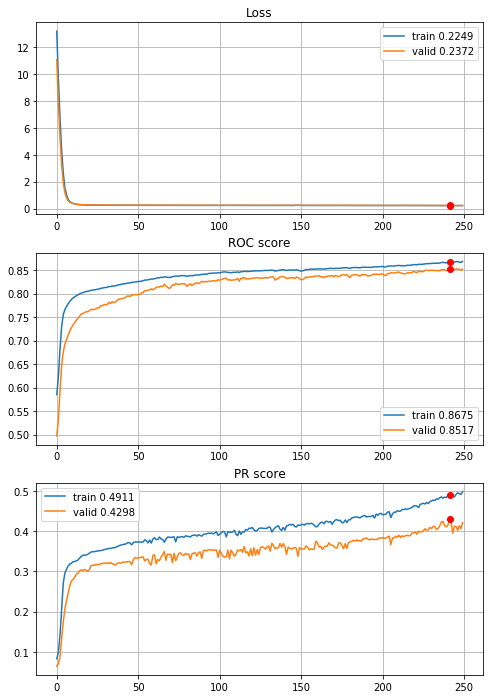


Fold 2------------------------------------------------------------


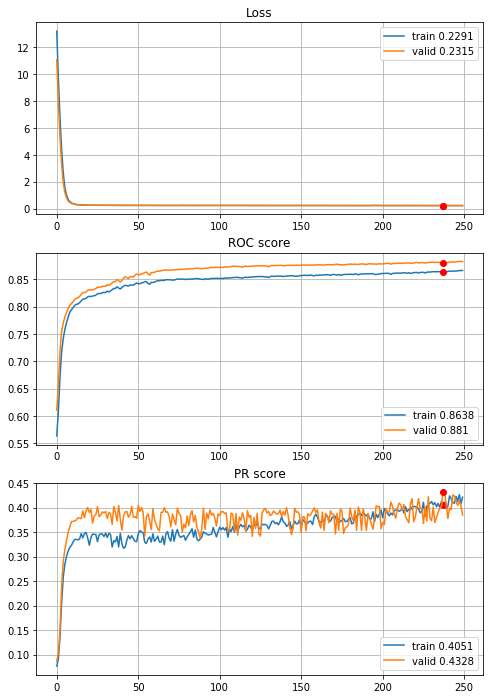


Fold 3------------------------------------------------------------


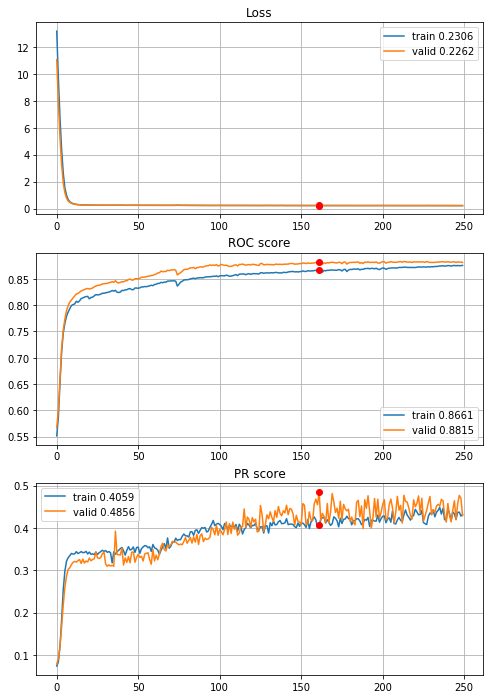


Fold 4------------------------------------------------------------


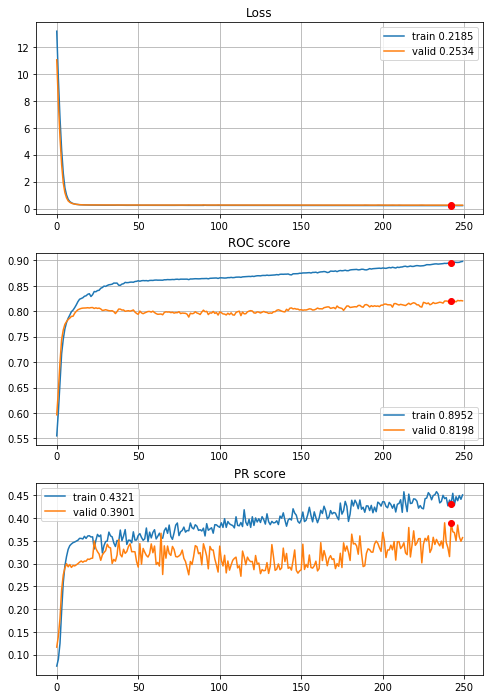


Fold 5------------------------------------------------------------


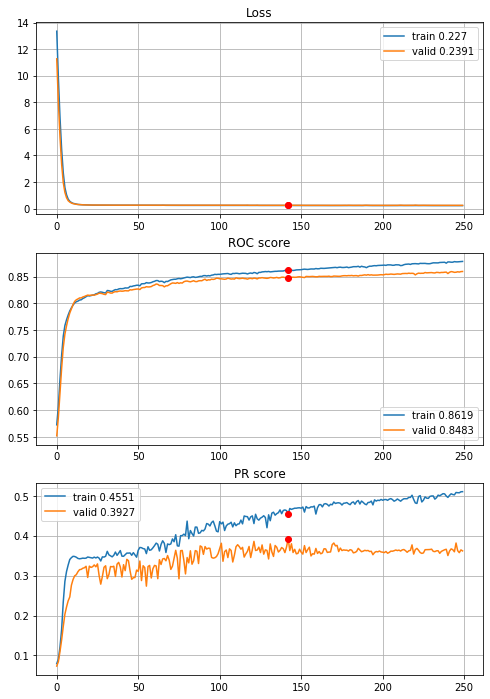


Fold 6------------------------------------------------------------


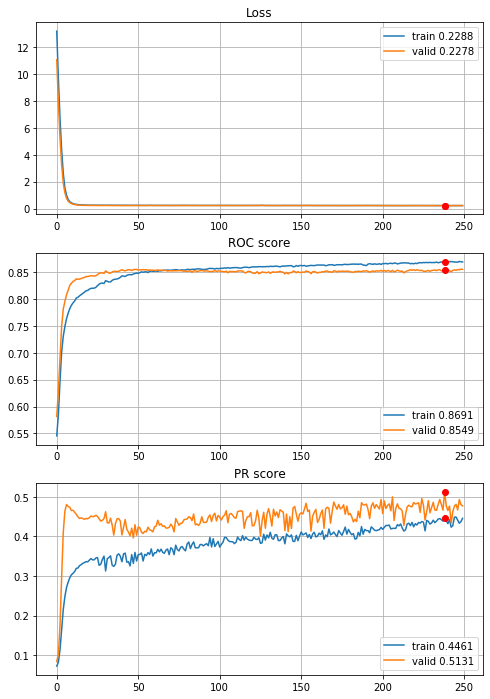

In [63]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_3inc_2dense_std_L1,
                                        features=features, target=target, n_epochs=250, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Too big regularization effect, lets try lower coefficient

In [56]:
def define_deep_CNN_3inc_2dense_std_L1_0005(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    inception = inception_module(prev_layer=inception, f1=12, f2_in=6, f2_out=12, f3_in=6, f3_out=12,
                                 f4_out=12, random_state=random_state)                                  # (8,8,48)

    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,48)
    flat = layers.Flatten()(pool)                                                                       # (768,)
    dense = layers.Dense(units=384, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.0005))(flat)                            # (384,)
    dense = layers.Dense(units=192, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.0005))(dense)                           # (192,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/250,
cumulative time: 5.76s train loss: 6.909443149712972, validation loss: 5.892184101607915
Epoch: 2/250,
cumulative time: 8.03s train loss: 5.1877070187661625, validation loss: 4.327745756947067
Epoch: 3/250,
cumulative time: 10.24s train loss: 3.7453505535633553, validation loss: 3.0397267148083467
Epoch: 4/250,
cumulative time: 12.41s train loss: 2.578294167234579, validation loss: 2.035880954047873
Epoch: 5/250,
cumulative time: 14.54s train loss: 1.7010488001232973, validation loss: 1.332872287799702
Epoch: 6/250,
cumulative time: 16.7s train loss: 1.129095924917326, validation loss: 0.9344850880720704
Epoch: 7/250,
cumulative time: 18.84s train loss: 0.8302708499752227, validation loss: 0.7062348436476009
Epoch: 8/250,
cumulative time: 20.99s train loss: 0.6314568870334418, validation loss: 0.5659218820267626
Epoch: 9/250,
cumulative time: 23.14s train loss: 0.5207990772403535, validation los

Epoch: 77/250,
cumulative time: 168.74s train loss: 0.21955312362162646, validation loss: 0.22459511423594788
Epoch: 78/250,
cumulative time: 170.91s train loss: 0.21826514765781616, validation loss: 0.22408811136525808
Epoch: 79/250,
cumulative time: 173.02s train loss: 0.21570712451685206, validation loss: 0.22396846612854499
Epoch: 80/250,
cumulative time: 175.13s train loss: 0.218499962153041, validation loss: 0.2255584466047459
Epoch: 81/250,
cumulative time: 177.25s train loss: 0.2185986643650364, validation loss: 0.23296789052185374
Epoch: 82/250,
cumulative time: 179.39s train loss: 0.21606932282582303, validation loss: 0.22680592909875286
Epoch: 83/250,
cumulative time: 181.49s train loss: 0.21654708553710783, validation loss: 0.2232360210870272
Epoch: 84/250,
cumulative time: 183.63s train loss: 0.21483906995276467, validation loss: 0.22844463603606757
Epoch: 85/250,
cumulative time: 185.75s train loss: 0.21750768459660913, validation loss: 0.22462718660828762
Epoch: 86/250,


Epoch: 152/250,
cumulative time: 328.72s train loss: 0.21221991503335508, validation loss: 0.22243886801341745
Epoch: 153/250,
cumulative time: 330.86s train loss: 0.21072206554752826, validation loss: 0.22063745497783652
Epoch: 154/250,
cumulative time: 333.0s train loss: 0.20973786864335572, validation loss: 0.21915831011137268
Epoch: 155/250,
cumulative time: 335.13s train loss: 0.2095054514733032, validation loss: 0.22129646882734008
Epoch: 156/250,
cumulative time: 337.26s train loss: 0.21194182779465126, validation loss: 0.21912730884189133
Epoch: 157/250,
cumulative time: 339.38s train loss: 0.21025361222910968, validation loss: 0.2188000291115536
Epoch: 158/250,
cumulative time: 341.49s train loss: 0.21038480739811913, validation loss: 0.21958772910353566
Epoch: 159/250,
cumulative time: 343.6s train loss: 0.21073528701298289, validation loss: 0.21966855619375708
Epoch: 160/250,
cumulative time: 345.73s train loss: 0.21078954127344846, validation loss: 0.21895725230487922
Epoch

Epoch: 227/250,
cumulative time: 488.38s train loss: 0.2043797262080202, validation loss: 0.21337026792757943
Epoch: 228/250,
cumulative time: 490.51s train loss: 0.204910775908817, validation loss: 0.21334387602236252
Epoch: 229/250,
cumulative time: 492.62s train loss: 0.20156924396296055, validation loss: 0.21304677499052907
Epoch: 230/250,
cumulative time: 494.74s train loss: 0.2010633181578846, validation loss: 0.21243118708942763
Epoch: 231/250,
cumulative time: 496.85s train loss: 0.20088119582955588, validation loss: 0.21268586844642642
Epoch: 232/250,
cumulative time: 498.97s train loss: 0.20109960731347545, validation loss: 0.21222792285270864
Epoch: 233/250,
cumulative time: 501.09s train loss: 0.20050749937845697, validation loss: 0.21248927882115495
Epoch: 234/250,
cumulative time: 503.2s train loss: 0.20110298077901995, validation loss: 0.2151627817444226
Epoch: 235/250,
cumulative time: 505.31s train loss: 0.2024224236177193, validation loss: 0.21313683540804948
Epoch: 2

Epoch: 50/250,
cumulative time: 115.84s train loss: 0.21921168006149655, validation loss: 0.21752342942938327
Epoch: 51/250,
cumulative time: 118.09s train loss: 0.22134046599484092, validation loss: 0.21749873654213403
Epoch: 52/250,
cumulative time: 120.35s train loss: 0.2188398876372012, validation loss: 0.21922864893445032
Epoch: 53/250,
cumulative time: 122.63s train loss: 0.21940688703491584, validation loss: 0.2166820726238754
Epoch: 54/250,
cumulative time: 124.9s train loss: 0.21937250820012083, validation loss: 0.2179362958521827
Epoch: 55/250,
cumulative time: 127.14s train loss: 0.22115908837490564, validation loss: 0.21736157481404275
Epoch: 56/250,
cumulative time: 129.38s train loss: 0.2191620822323466, validation loss: 0.21595478800399462
Epoch: 57/250,
cumulative time: 131.61s train loss: 0.22323691095847514, validation loss: 0.21571257727256354
Epoch: 58/250,
cumulative time: 133.87s train loss: 0.22148885602124763, validation loss: 0.21783470338065566
Epoch: 59/250,


Epoch: 125/250,
cumulative time: 284.63s train loss: 0.2090570107640342, validation loss: 0.2075094705302659
Epoch: 126/250,
cumulative time: 286.89s train loss: 0.21043369232505452, validation loss: 0.20922843493697607
Epoch: 127/250,
cumulative time: 289.13s train loss: 0.21034902241417217, validation loss: 0.20721450555553028
Epoch: 128/250,
cumulative time: 291.42s train loss: 0.2104300193300316, validation loss: 0.2093016036031211
Epoch: 129/250,
cumulative time: 293.71s train loss: 0.20928401500659083, validation loss: 0.21546830341068707
Epoch: 130/250,
cumulative time: 295.96s train loss: 0.21527872452451866, validation loss: 0.21216766470717738
Epoch: 131/250,
cumulative time: 298.19s train loss: 0.2131472822641853, validation loss: 0.21726819093359095
Epoch: 132/250,
cumulative time: 300.45s train loss: 0.21165941190310764, validation loss: 0.20764495440776615
Epoch: 133/250,
cumulative time: 302.74s train loss: 0.20965203607206095, validation loss: 0.20700512458533551
Epoch:

Epoch: 200/250,
cumulative time: 454.85s train loss: 0.20325631145320644, validation loss: 0.2000188594337515
Epoch: 201/250,
cumulative time: 457.14s train loss: 0.20070954013467912, validation loss: 0.19933680229082182
Epoch: 202/250,
cumulative time: 459.46s train loss: 0.20095622955757572, validation loss: 0.20063266762886134
Epoch: 203/250,
cumulative time: 461.76s train loss: 0.19925390390363196, validation loss: 0.19987488443109605
Epoch: 204/250,
cumulative time: 464.04s train loss: 0.20037849168780694, validation loss: 0.19896771406845148
Epoch: 205/250,
cumulative time: 466.3s train loss: 0.19983310370776627, validation loss: 0.1993988263331513
Epoch: 206/250,
cumulative time: 468.54s train loss: 0.20083576307669013, validation loss: 0.21163038632243436
Epoch: 207/250,
cumulative time: 470.78s train loss: 0.20399729817406365, validation loss: 0.2001779782328557
Epoch: 208/250,
cumulative time: 473.02s train loss: 0.20040954120241994, validation loss: 0.19959588434542985
Epoch

Epoch: 23/250,
cumulative time: 56.17s train loss: 0.245087406587945, validation loss: 0.2396273358463569
Epoch: 24/250,
cumulative time: 58.51s train loss: 0.2382939807559609, validation loss: 0.23555973718171727
Epoch: 25/250,
cumulative time: 60.79s train loss: 0.2359495096258308, validation loss: 0.23507038545044057
Epoch: 26/250,
cumulative time: 63.07s train loss: 0.2354372183351848, validation loss: 0.23384783948690807
Epoch: 27/250,
cumulative time: 65.34s train loss: 0.23419701667092338, validation loss: 0.23133655577864426
Epoch: 28/250,
cumulative time: 67.63s train loss: 0.23113691210343304, validation loss: 0.22860143321073847
Epoch: 29/250,
cumulative time: 69.9s train loss: 0.22965887786706216, validation loss: 0.2280137415097558
Epoch: 30/250,
cumulative time: 72.2s train loss: 0.23064559846040575, validation loss: 0.2262746264828367
Epoch: 31/250,
cumulative time: 74.5s train loss: 0.22986184252217573, validation loss: 0.22583871932013597
Epoch: 32/250,
cumulative time

Epoch: 99/250,
cumulative time: 233.55s train loss: 0.20882907524597344, validation loss: 0.20362513825683745
Epoch: 100/250,
cumulative time: 235.83s train loss: 0.2088127408970134, validation loss: 0.21422248742760505
Epoch: 101/250,
cumulative time: 238.24s train loss: 0.21133695702851896, validation loss: 0.203414128154617
Epoch: 102/250,
cumulative time: 240.57s train loss: 0.20832613078265413, validation loss: 0.20419831301811178
Epoch: 103/250,
cumulative time: 242.91s train loss: 0.2084659845820403, validation loss: 0.20379595673541206
Epoch: 104/250,
cumulative time: 245.23s train loss: 0.20967161364934075, validation loss: 0.20637203877310875
Epoch: 105/250,
cumulative time: 247.52s train loss: 0.2095671507869494, validation loss: 0.20866232703879828
Epoch: 106/250,
cumulative time: 249.82s train loss: 0.2093890036728623, validation loss: 0.203598090700528
Epoch: 107/250,
cumulative time: 252.12s train loss: 0.21305995663822988, validation loss: 0.21583179099718372
Epoch: 108

Epoch: 174/250,
cumulative time: 406.07s train loss: 0.20273144550567715, validation loss: 0.20369788339065456
Epoch: 175/250,
cumulative time: 408.36s train loss: 0.20246607516404738, validation loss: 0.2040873243312825
Epoch: 176/250,
cumulative time: 410.66s train loss: 0.2025339810466831, validation loss: 0.20893618074721387
Epoch: 177/250,
cumulative time: 412.96s train loss: 0.20639020223372248, validation loss: 0.20483661759665747
Epoch: 178/250,
cumulative time: 415.25s train loss: 0.20448506148767384, validation loss: 0.2060571808825754
Epoch: 179/250,
cumulative time: 417.55s train loss: 0.20663957032862554, validation loss: 0.2083812719872463
Epoch: 180/250,
cumulative time: 419.85s train loss: 0.20405643113925784, validation loss: 0.20611711375608519
Epoch: 181/250,
cumulative time: 422.16s train loss: 0.20322924063604877, validation loss: 0.20515594111488797
Epoch: 182/250,
cumulative time: 424.44s train loss: 0.20266491145110732, validation loss: 0.20594782846756154
Epoch

Epoch: 249/250,
cumulative time: 578.55s train loss: 0.19550010679619192, validation loss: 0.20351027142101102
Epoch: 250/250,
cumulative time: 580.84s train loss: 0.19610888225157552, validation loss: 0.20331976311585814

Early stopping results:
best results in epoch: 148, 
best valid PR: 0.4766877241997556, 
valid ROC: 0.8804594330400782        
overfitting PR: -0.06537017531284789, 
overfitting ROC: -0.01172979134626706

----------
Fold: 4
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/250,
cumulative time: 6.47s train loss: 6.824994909126011, validation loss: 5.78642009666219
Epoch: 2/250,
cumulative time: 8.8s train loss: 5.1013028713641955, validation loss: 4.245933020357085
Epoch: 3/250,
cumulative time: 11.14s train loss: 3.68178603129061, validation loss: 2.977675739852354
Epoch: 4/250,
cumulative time: 13.55s train loss: 2.535693519088019, validation loss: 1.989454699692823
Epoch: 5/250,
cumulative time: 15.92s train loss: 1.6722707604813356, validation lo

Epoch: 73/250,
cumulative time: 174.53s train loss: 0.21074683981059555, validation loss: 0.23282148916080897
Epoch: 74/250,
cumulative time: 176.85s train loss: 0.21231998254127166, validation loss: 0.23319494532543164
Epoch: 75/250,
cumulative time: 179.15s train loss: 0.21254701396089468, validation loss: 0.2325149333907573
Epoch: 76/250,
cumulative time: 181.46s train loss: 0.21206512926879598, validation loss: 0.23383116695197387
Epoch: 77/250,
cumulative time: 183.78s train loss: 0.21531682753439227, validation loss: 0.2318005360007017
Epoch: 78/250,
cumulative time: 186.1s train loss: 0.21326596322310795, validation loss: 0.23290434163526272
Epoch: 79/250,
cumulative time: 188.42s train loss: 0.2104655184757621, validation loss: 0.23607855365857583
Epoch: 80/250,
cumulative time: 190.75s train loss: 0.2108336400056622, validation loss: 0.23375626769480265
Epoch: 81/250,
cumulative time: 193.1s train loss: 0.2098079622027139, validation loss: 0.23441919354768154
Epoch: 82/250,
cu

Epoch: 148/250,
cumulative time: 349.25s train loss: 0.20227130712719016, validation loss: 0.23198351549913868
Epoch: 149/250,
cumulative time: 351.56s train loss: 0.20287404485851923, validation loss: 0.2309178235366705
Epoch: 150/250,
cumulative time: 353.89s train loss: 0.20103421562914114, validation loss: 0.23093749007575937
Epoch: 151/250,
cumulative time: 356.21s train loss: 0.20207856891320894, validation loss: 0.23103425196008273
Epoch: 152/250,
cumulative time: 358.57s train loss: 0.20186110048605468, validation loss: 0.23119407902318254
Epoch: 153/250,
cumulative time: 360.92s train loss: 0.20045395702890045, validation loss: 0.23056198384099835
Epoch: 154/250,
cumulative time: 363.25s train loss: 0.20143762012381008, validation loss: 0.23061683319895854
Epoch: 155/250,
cumulative time: 365.58s train loss: 0.2013487471378928, validation loss: 0.23034420239467923
Epoch: 156/250,
cumulative time: 367.89s train loss: 0.20108549261561048, validation loss: 0.2304913934412713
Epoc

Epoch: 223/250,
cumulative time: 524.22s train loss: 0.1924178467165555, validation loss: 0.22702406763895908
Epoch: 224/250,
cumulative time: 526.54s train loss: 0.19194427920858773, validation loss: 0.23611089654485473
Epoch: 225/250,
cumulative time: 528.85s train loss: 0.19621087216091243, validation loss: 0.23384760390824175
Epoch: 226/250,
cumulative time: 531.16s train loss: 0.19333383769045664, validation loss: 0.22838948663685715
Epoch: 227/250,
cumulative time: 533.49s train loss: 0.19227311262193233, validation loss: 0.22671637295600253
Epoch: 228/250,
cumulative time: 535.8s train loss: 0.1931420939382247, validation loss: 0.22523381401265447
Epoch: 229/250,
cumulative time: 538.11s train loss: 0.19138401158165777, validation loss: 0.22823159393284714
Epoch: 230/250,
cumulative time: 540.44s train loss: 0.19102871564557045, validation loss: 0.22917397078084623
Epoch: 231/250,
cumulative time: 542.76s train loss: 0.19370586338173368, validation loss: 0.22891403162856133
Epoc

Epoch: 46/250,
cumulative time: 112.34s train loss: 0.22317488215899, validation loss: 0.22762538472497437
Epoch: 47/250,
cumulative time: 114.69s train loss: 0.22081851045595396, validation loss: 0.22734741937226152
Epoch: 48/250,
cumulative time: 117.06s train loss: 0.22018828432769183, validation loss: 0.2264872257246659
Epoch: 49/250,
cumulative time: 119.41s train loss: 0.21994282563733591, validation loss: 0.22624785626311333
Epoch: 50/250,
cumulative time: 121.78s train loss: 0.2198022938516859, validation loss: 0.2258258152156059
Epoch: 51/250,
cumulative time: 124.14s train loss: 0.22026585015249178, validation loss: 0.2257513983793237
Epoch: 52/250,
cumulative time: 126.52s train loss: 0.22004918576954127, validation loss: 0.2335375974261734
Epoch: 53/250,
cumulative time: 128.92s train loss: 0.22026765648382338, validation loss: 0.2264997048248825
Epoch: 54/250,
cumulative time: 131.28s train loss: 0.21959015397960435, validation loss: 0.22537396155280937
Epoch: 55/250,
cumu

Epoch: 121/250,
cumulative time: 290.29s train loss: 0.20497617487871914, validation loss: 0.2232173060994116
Epoch: 122/250,
cumulative time: 292.65s train loss: 0.20427909067890967, validation loss: 0.21608859815258474
Epoch: 123/250,
cumulative time: 295.02s train loss: 0.20732412871646472, validation loss: 0.2222252413462301
Epoch: 124/250,
cumulative time: 297.41s train loss: 0.2115629365461394, validation loss: 0.23058416904633525
Epoch: 125/250,
cumulative time: 299.8s train loss: 0.20762498979304408, validation loss: 0.21605811501867883
Epoch: 126/250,
cumulative time: 302.15s train loss: 0.20866471604974982, validation loss: 0.21604089008362515
Epoch: 127/250,
cumulative time: 304.53s train loss: 0.20462359374394515, validation loss: 0.21546565359521397
Epoch: 128/250,
cumulative time: 306.9s train loss: 0.20396074634520162, validation loss: 0.21580293377688992
Epoch: 129/250,
cumulative time: 309.27s train loss: 0.2040448192277612, validation loss: 0.21796449561420467
Epoch: 

Epoch: 196/250,
cumulative time: 469.07s train loss: 0.19562357788480703, validation loss: 0.2136629005519854
Epoch: 197/250,
cumulative time: 471.43s train loss: 0.195642601470901, validation loss: 0.21353355356183062
Epoch: 198/250,
cumulative time: 473.81s train loss: 0.19545244072082213, validation loss: 0.21322019731218067
Epoch: 199/250,
cumulative time: 476.18s train loss: 0.19416487868392063, validation loss: 0.21310290973423296
Epoch: 200/250,
cumulative time: 478.56s train loss: 0.19459602754405947, validation loss: 0.21171343649483157
Epoch: 201/250,
cumulative time: 480.94s train loss: 0.19281189680812108, validation loss: 0.21252325897023047
Epoch: 202/250,
cumulative time: 483.31s train loss: 0.19327496393873006, validation loss: 0.21175455781326338
Epoch: 203/250,
cumulative time: 485.68s train loss: 0.19445645563790148, validation loss: 0.21210938904005572
Epoch: 204/250,
cumulative time: 488.05s train loss: 0.19299052789817403, validation loss: 0.2121272808609375
Epoch

Epoch: 19/250,
cumulative time: 65.27s train loss: 0.2609246027051475, validation loss: 0.23738363883027105
Epoch: 20/250,
cumulative time: 68.53s train loss: 0.2539234058181454, validation loss: 0.23542023670458093
Epoch: 21/250,
cumulative time: 71.81s train loss: 0.24985845796066403, validation loss: 0.22888959015868857
Epoch: 22/250,
cumulative time: 75.08s train loss: 0.24522214026744765, validation loss: 0.22486224827728746
Epoch: 23/250,
cumulative time: 78.37s train loss: 0.24164695330191058, validation loss: 0.22182674272065775
Epoch: 24/250,
cumulative time: 81.66s train loss: 0.24145593968977005, validation loss: 0.2198557460482987
Epoch: 25/250,
cumulative time: 84.93s train loss: 0.23626715128708983, validation loss: 0.2181020099207187
Epoch: 26/250,
cumulative time: 88.23s train loss: 0.23387372219452277, validation loss: 0.21622986724898724
Epoch: 27/250,
cumulative time: 91.49s train loss: 0.23371490677820758, validation loss: 0.2149809060731806
Epoch: 28/250,
cumulativ

Epoch: 95/250,
cumulative time: 314.88s train loss: 0.2150072887381877, validation loss: 0.2104672965831197
Epoch: 96/250,
cumulative time: 318.16s train loss: 0.21671455318371652, validation loss: 0.2152894799246476
Epoch: 97/250,
cumulative time: 321.44s train loss: 0.21268944600594922, validation loss: 0.21058090744249977
Epoch: 98/250,
cumulative time: 324.71s train loss: 0.21275988901855444, validation loss: 0.20876899590341555
Epoch: 99/250,
cumulative time: 328.02s train loss: 0.21239432441766068, validation loss: 0.2093658533712542
Epoch: 100/250,
cumulative time: 331.29s train loss: 0.21266667202481454, validation loss: 0.2096942403179259
Epoch: 101/250,
cumulative time: 334.57s train loss: 0.21672986797398486, validation loss: 0.20833092335922723
Epoch: 102/250,
cumulative time: 337.86s train loss: 0.211674710942826, validation loss: 0.21110567420250137
Epoch: 103/250,
cumulative time: 341.13s train loss: 0.2133423956487132, validation loss: 0.2097888702598167
Epoch: 104/250,

Epoch: 170/250,
cumulative time: 561.43s train loss: 0.20723782859267, validation loss: 0.20880597261354564
Epoch: 171/250,
cumulative time: 564.7s train loss: 0.2073289846630417, validation loss: 0.20422978453657697
Epoch: 172/250,
cumulative time: 567.97s train loss: 0.2069030941883974, validation loss: 0.20544020626399642
Epoch: 173/250,
cumulative time: 571.27s train loss: 0.206048433466176, validation loss: 0.20600469074050137
Epoch: 174/250,
cumulative time: 574.56s train loss: 0.20564132120091355, validation loss: 0.2052468527655031
Epoch: 175/250,
cumulative time: 577.83s train loss: 0.20561282065445538, validation loss: 0.20640384289803945
Epoch: 176/250,
cumulative time: 581.09s train loss: 0.20894215811449868, validation loss: 0.20519163518404046
Epoch: 177/250,
cumulative time: 584.36s train loss: 0.20573327121443116, validation loss: 0.2055749098011387
Epoch: 178/250,
cumulative time: 587.62s train loss: 0.20672756943077744, validation loss: 0.2110082475514767
Epoch: 179/2

Epoch: 245/250,
cumulative time: 807.83s train loss: 0.19878698244418622, validation loss: 0.20207273785201474
Epoch: 246/250,
cumulative time: 811.1s train loss: 0.198188333184085, validation loss: 0.2057553560685358
Epoch: 247/250,
cumulative time: 814.41s train loss: 0.20319092925154758, validation loss: 0.2048064442708853
Epoch: 248/250,
cumulative time: 817.69s train loss: 0.20229956544658387, validation loss: 0.20279285409246017
Epoch: 249/250,
cumulative time: 820.98s train loss: 0.2007112368964837, validation loss: 0.2051721275121848
Epoch: 250/250,
cumulative time: 824.26s train loss: 0.19906524769640818, validation loss: 0.20263746781085468

Early stopping results:
best results in epoch: 235, 
best valid PR: 0.4943937844323279, 
valid ROC: 0.8620963735717834        
overfitting PR: -0.009581418245591278, 
overfitting ROC: 0.013752111276701506

Cross validation time: 3723s
ROC: 		0.8638457285707418
PR: 		0.4628466717661123
overfittingROC: 0.018678369596086708
overfittingPR:  0

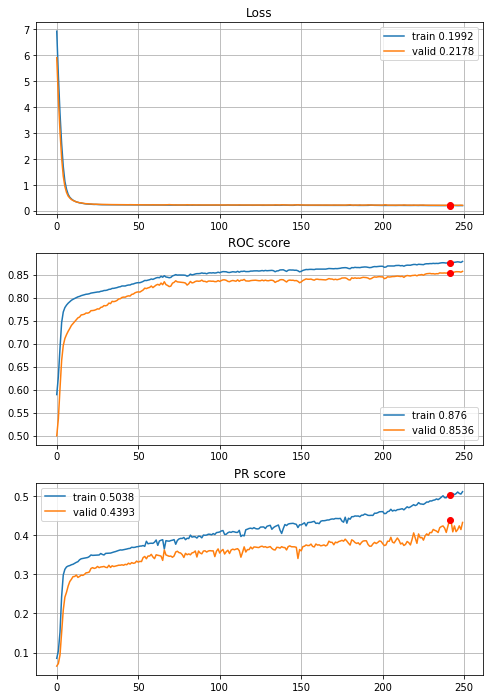


Fold 2------------------------------------------------------------


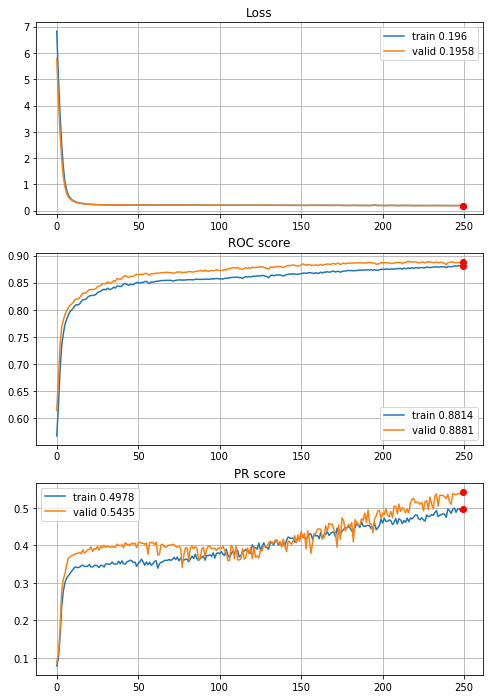


Fold 3------------------------------------------------------------


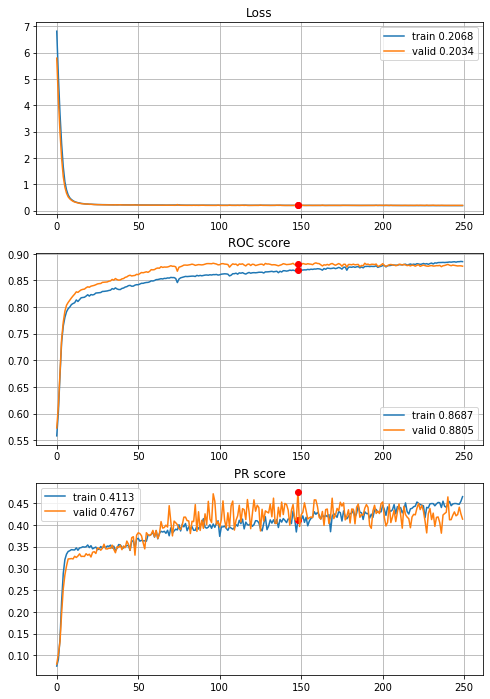


Fold 4------------------------------------------------------------


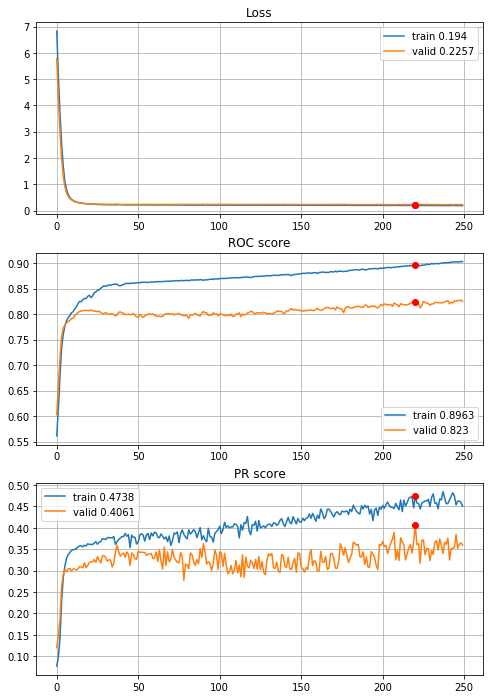


Fold 5------------------------------------------------------------


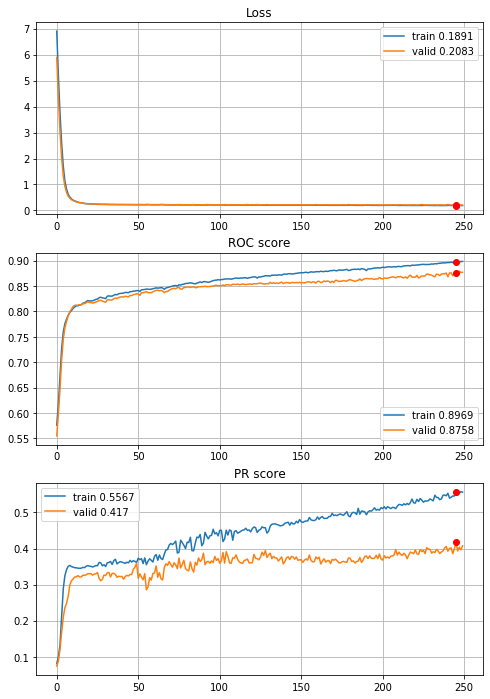


Fold 6------------------------------------------------------------


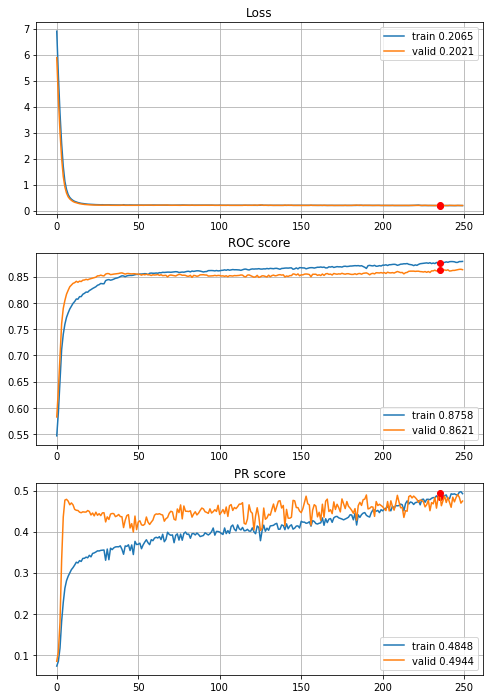

In [68]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_3inc_2dense_std_L1_0005,
                                        features=features, target=target, n_epochs=250, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Two things to check:
 - dropout,
 - more epochs.

In [57]:
def define_deep_CNN_3inc_2dense_std_L1_0005_drop(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    inception = inception_module(prev_layer=inception, f1=12, f2_in=6, f2_out=12, f3_in=6, f3_out=12,
                                 f4_out=12, random_state=random_state)                                  # (8,8,48)

    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,48)
    flat = layers.Flatten()(pool)                                                                       # (768,)
    dense = layers.Dense(units=384, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.0005))(flat)                            # (384,)
    dense = layers.Dropout(rate=0.3)(dense)
    dense = layers.Dense(units=192, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.0005))(dense)                           # (192,)
    dense = layers.Dropout(rate=0.3)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/250,
cumulative time: 7.04s train loss: 6.890626355844284, validation loss: 5.846337433463423
Epoch: 2/250,
cumulative time: 10.48s train loss: 5.153612196015106, validation loss: 4.303471875432647
Epoch: 3/250,
cumulative time: 13.89s train loss: 3.7316421849202595, validation loss: 3.0322995927718206
Epoch: 4/250,
cumulative time: 17.31s train loss: 2.5789840788402283, validation loss: 2.035902654976829
Epoch: 5/250,
cumulative time: 20.73s train loss: 1.7057969323779703, validation loss: 1.3349095814123229
Epoch: 6/250,
cumulative time: 24.16s train loss: 1.1328114983945117, validation loss: 0.9333618297383374
Epoch: 7/250,
cumulative time: 27.59s train loss: 0.8293508505616808, validation loss: 0.7015491007683377
Epoch: 8/250,
cumulative time: 31.0s train loss: 0.6249598238603733, validation loss: 0.5572570167910287
Epoch: 9/250,
cumulative time: 34.39s train loss: 0.5119096889876716, validation 

Epoch: 76/250,
cumulative time: 261.25s train loss: 0.23107424132956278, validation loss: 0.2357525285060403
Epoch: 77/250,
cumulative time: 264.63s train loss: 0.2324598358896988, validation loss: 0.23576240893348363
Epoch: 78/250,
cumulative time: 267.98s train loss: 0.2322543222080607, validation loss: 0.23511042713850167
Epoch: 79/250,
cumulative time: 271.38s train loss: 0.2283749689922974, validation loss: 0.23465267394951797
Epoch: 80/250,
cumulative time: 274.75s train loss: 0.22997318742803502, validation loss: 0.23592514364130737
Epoch: 81/250,
cumulative time: 278.11s train loss: 0.2318676293824231, validation loss: 0.2412212429549272
Epoch: 82/250,
cumulative time: 281.48s train loss: 0.2263360727201838, validation loss: 0.23625308617932686
Epoch: 83/250,
cumulative time: 284.87s train loss: 0.22929966738212196, validation loss: 0.23493228644435005
Epoch: 84/250,
cumulative time: 288.25s train loss: 0.23067220367679528, validation loss: 0.2352949784398751
Epoch: 85/250,
cum

Epoch: 151/250,
cumulative time: 515.19s train loss: 0.23213611346155083, validation loss: 0.23494905540814126
Epoch: 152/250,
cumulative time: 518.6s train loss: 0.22804941148883814, validation loss: 0.23477473211597563
Epoch: 153/250,
cumulative time: 521.98s train loss: 0.2229832055363199, validation loss: 0.23196583453738032
Epoch: 154/250,
cumulative time: 525.36s train loss: 0.2240254090971142, validation loss: 0.22985316401404216
Epoch: 155/250,
cumulative time: 528.75s train loss: 0.22326978858197208, validation loss: 0.23656484896260427
Epoch: 156/250,
cumulative time: 532.14s train loss: 0.23012784706421924, validation loss: 0.233242282889607
Epoch: 157/250,
cumulative time: 535.51s train loss: 0.22638978770789472, validation loss: 0.23015548757528373
Epoch: 158/250,
cumulative time: 538.97s train loss: 0.22494621405425055, validation loss: 0.23015436805625106
Epoch: 159/250,
cumulative time: 542.36s train loss: 0.22550505483758362, validation loss: 0.23003276648354773
Epoch:

Epoch: 226/250,
cumulative time: 769.73s train loss: 0.220405205156291, validation loss: 0.22846521464047329
Epoch: 227/250,
cumulative time: 773.09s train loss: 0.2189649169060943, validation loss: 0.22482063696040375
Epoch: 228/250,
cumulative time: 776.51s train loss: 0.22124576450927377, validation loss: 0.22525425275458022
Epoch: 229/250,
cumulative time: 780.0s train loss: 0.2174676336912902, validation loss: 0.22684748087754514
Epoch: 230/250,
cumulative time: 783.38s train loss: 0.2171153256985685, validation loss: 0.22427446600952708
Epoch: 231/250,
cumulative time: 786.77s train loss: 0.21803562630922785, validation loss: 0.2248850015434095
Epoch: 232/250,
cumulative time: 790.14s train loss: 0.21752339409872729, validation loss: 0.22415402896173106
Epoch: 233/250,
cumulative time: 793.53s train loss: 0.22078269762440925, validation loss: 0.2244459607353877
Epoch: 234/250,
cumulative time: 796.93s train loss: 0.21623413280889875, validation loss: 0.22874499929663564
Epoch: 23

Epoch: 49/250,
cumulative time: 173.9s train loss: 0.23266844989375518, validation loss: 0.2267118571105643
Epoch: 50/250,
cumulative time: 177.35s train loss: 0.23239420209120326, validation loss: 0.22878443640410026
Epoch: 51/250,
cumulative time: 180.8s train loss: 0.23479761634465804, validation loss: 0.22813876912316985
Epoch: 52/250,
cumulative time: 184.23s train loss: 0.23311143071938722, validation loss: 0.23150548689999736
Epoch: 53/250,
cumulative time: 187.66s train loss: 0.2333767972819319, validation loss: 0.22769774168964976
Epoch: 54/250,
cumulative time: 191.1s train loss: 0.23447847681032621, validation loss: 0.22774360534706675
Epoch: 55/250,
cumulative time: 194.52s train loss: 0.23257186474271846, validation loss: 0.22726808569006612
Epoch: 56/250,
cumulative time: 197.93s train loss: 0.23332077603693044, validation loss: 0.22562426409296682
Epoch: 57/250,
cumulative time: 201.38s train loss: 0.23668774472220064, validation loss: 0.2265829450819377
Epoch: 58/250,
c

Epoch: 124/250,
cumulative time: 431.78s train loss: 0.2213164963742671, validation loss: 0.21594765748757253
Epoch: 125/250,
cumulative time: 435.25s train loss: 0.21892334095165403, validation loss: 0.21503207035438318
Epoch: 126/250,
cumulative time: 438.68s train loss: 0.22345557465934152, validation loss: 0.21930631277862234
Epoch: 127/250,
cumulative time: 442.1s train loss: 0.21891213447151417, validation loss: 0.21482277380170253
Epoch: 128/250,
cumulative time: 445.52s train loss: 0.22264645784582257, validation loss: 0.2167988905710459
Epoch: 129/250,
cumulative time: 448.95s train loss: 0.2205887212744151, validation loss: 0.22645580955059713
Epoch: 130/250,
cumulative time: 452.39s train loss: 0.22845426932757296, validation loss: 0.21969380302789382
Epoch: 131/250,
cumulative time: 455.82s train loss: 0.22321804294813197, validation loss: 0.22696066653647848
Epoch: 132/250,
cumulative time: 459.23s train loss: 0.22461466892666118, validation loss: 0.21622034221921188
Epoch

Epoch: 199/250,
cumulative time: 690.35s train loss: 0.21810576764846537, validation loss: 0.21729484922856326
Epoch: 200/250,
cumulative time: 693.8s train loss: 0.21852187935383957, validation loss: 0.20986974980207548
Epoch: 201/250,
cumulative time: 697.26s train loss: 0.21515286805962183, validation loss: 0.2111531452873245
Epoch: 202/250,
cumulative time: 700.72s train loss: 0.21458553239730077, validation loss: 0.2107207302545883
Epoch: 203/250,
cumulative time: 704.15s train loss: 0.21471931013389614, validation loss: 0.21040092213782813
Epoch: 204/250,
cumulative time: 707.59s train loss: 0.21567532762427838, validation loss: 0.21029691073913317
Epoch: 205/250,
cumulative time: 711.25s train loss: 0.21200794374254206, validation loss: 0.210459426683799
Epoch: 206/250,
cumulative time: 715.13s train loss: 0.21651060957232968, validation loss: 0.22823982990715388
Epoch: 207/250,
cumulative time: 719.13s train loss: 0.21957040771115774, validation loss: 0.21244994566902906
Epoch:

Epoch: 22/250,
cumulative time: 83.85s train loss: 0.2518429252779656, validation loss: 0.24965659311417124
Epoch: 23/250,
cumulative time: 87.57s train loss: 0.25380976824257995, validation loss: 0.24224557886330628
Epoch: 24/250,
cumulative time: 91.64s train loss: 0.2492747785664745, validation loss: 0.240403234404265
Epoch: 25/250,
cumulative time: 95.2s train loss: 0.24569119223215305, validation loss: 0.23885758200990037
Epoch: 26/250,
cumulative time: 99.37s train loss: 0.24289494955959304, validation loss: 0.2389552910405861
Epoch: 27/250,
cumulative time: 103.33s train loss: 0.2437445049574229, validation loss: 0.23709745794165094
Epoch: 28/250,
cumulative time: 107.01s train loss: 0.24044771230231554, validation loss: 0.23488685018314717
Epoch: 29/250,
cumulative time: 110.68s train loss: 0.24108863946063855, validation loss: 0.2349669207412468
Epoch: 30/250,
cumulative time: 114.4s train loss: 0.2416700990164538, validation loss: 0.2329498393022221
Epoch: 31/250,
cumulative 

Epoch: 97/250,
cumulative time: 357.57s train loss: 0.2276621522980369, validation loss: 0.22019074312930983
Epoch: 98/250,
cumulative time: 361.15s train loss: 0.2305332086980343, validation loss: 0.2224246985882756
Epoch: 99/250,
cumulative time: 364.71s train loss: 0.23132521145395424, validation loss: 0.22037872789677532
Epoch: 100/250,
cumulative time: 368.35s train loss: 0.23128196699309436, validation loss: 0.23110907392948027
Epoch: 101/250,
cumulative time: 371.96s train loss: 0.23038043613656548, validation loss: 0.22022026298481556
Epoch: 102/250,
cumulative time: 375.56s train loss: 0.22727892326614701, validation loss: 0.22021129646725962
Epoch: 103/250,
cumulative time: 379.12s train loss: 0.22676312755322628, validation loss: 0.21980475112711834
Epoch: 104/250,
cumulative time: 382.7s train loss: 0.22740656609515852, validation loss: 0.22355176269873692
Epoch: 105/250,
cumulative time: 386.51s train loss: 0.22872189041025373, validation loss: 0.2218463990035159
Epoch: 10

Epoch: 172/250,
cumulative time: 628.1s train loss: 0.2146913586823196, validation loss: 0.20960842501351098
Epoch: 173/250,
cumulative time: 631.73s train loss: 0.2174170718255994, validation loss: 0.21104649387997193
Epoch: 174/250,
cumulative time: 635.3s train loss: 0.215638137345172, validation loss: 0.210824188445574
Epoch: 175/250,
cumulative time: 638.88s train loss: 0.21790633516702196, validation loss: 0.21173030455526398
Epoch: 176/250,
cumulative time: 642.45s train loss: 0.213761053407827, validation loss: 0.22327786458922885
Epoch: 177/250,
cumulative time: 646.07s train loss: 0.21858190823117749, validation loss: 0.2103205157240187
Epoch: 178/250,
cumulative time: 649.63s train loss: 0.22044917750794318, validation loss: 0.2204111530587262
Epoch: 179/250,
cumulative time: 653.19s train loss: 0.22579094280727505, validation loss: 0.21073306250263094
Epoch: 180/250,
cumulative time: 656.75s train loss: 0.21567291371685718, validation loss: 0.21044847219678434
Epoch: 181/25

Epoch: 247/250,
cumulative time: 898.43s train loss: 0.21464339893862658, validation loss: 0.213407415900854
Epoch: 248/250,
cumulative time: 902.04s train loss: 0.20979345593910786, validation loss: 0.21086324049157784
Epoch: 249/250,
cumulative time: 905.72s train loss: 0.20866316963081324, validation loss: 0.20916270116069002
Epoch: 250/250,
cumulative time: 909.33s train loss: 0.20640883547008468, validation loss: 0.20869100238317298

Early stopping results:
best results in epoch: 189, 
best valid PR: 0.4631250599659788, 
valid ROC: 0.871427174975562        
overfitting PR: -0.02696624396724162, 
overfitting ROC: -0.003671573356768265

----------
Fold: 4
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/250,
cumulative time: 8.75s train loss: 6.900767676372602, validation loss: 5.8597442926187275
Epoch: 2/250,
cumulative time: 12.59s train loss: 5.168004987042456, validation loss: 4.30694861013787
Epoch: 3/250,
cumulative time: 16.35s train loss: 3.738579047982052,

Epoch: 70/250,
cumulative time: 269.9s train loss: 0.22490493993901142, validation loss: 0.24249575736156706
Epoch: 71/250,
cumulative time: 273.68s train loss: 0.2229783603105969, validation loss: 0.2391382520745086
Epoch: 72/250,
cumulative time: 277.44s train loss: 0.2233548390927176, validation loss: 0.24316391412748978
Epoch: 73/250,
cumulative time: 281.21s train loss: 0.22121593335291723, validation loss: 0.24001349808131062
Epoch: 74/250,
cumulative time: 284.96s train loss: 0.22293903644201102, validation loss: 0.24679181147913362
Epoch: 75/250,
cumulative time: 288.8s train loss: 0.22352858376831064, validation loss: 0.24731946300975893
Epoch: 76/250,
cumulative time: 292.69s train loss: 0.22501865567161727, validation loss: 0.2501006976745468
Epoch: 77/250,
cumulative time: 296.52s train loss: 0.22210438112534386, validation loss: 0.2452376326777327
Epoch: 78/250,
cumulative time: 300.31s train loss: 0.23018524279288935, validation loss: 0.24507525580058517
Epoch: 79/250,
cu

Epoch: 145/250,
cumulative time: 553.15s train loss: 0.2231047212028783, validation loss: 0.23787978281420455
Epoch: 146/250,
cumulative time: 556.95s train loss: 0.21584143162701433, validation loss: 0.23696076466321406
Epoch: 147/250,
cumulative time: 560.72s train loss: 0.21800773997366524, validation loss: 0.23512990244624307
Epoch: 148/250,
cumulative time: 564.52s train loss: 0.2166605973093122, validation loss: 0.23574902160980363
Epoch: 149/250,
cumulative time: 568.35s train loss: 0.21499260459007002, validation loss: 0.23496106273702788
Epoch: 150/250,
cumulative time: 572.16s train loss: 0.21271171315768328, validation loss: 0.2352929558293814
Epoch: 151/250,
cumulative time: 575.98s train loss: 0.21159847278695007, validation loss: 0.24026012296197646
Epoch: 152/250,
cumulative time: 579.83s train loss: 0.21809397289937435, validation loss: 0.23733916454874904
Epoch: 153/250,
cumulative time: 583.62s train loss: 0.2115020876577657, validation loss: 0.23842648149343967
Epoch

Epoch: 220/250,
cumulative time: 838.01s train loss: 0.2152800795162286, validation loss: 0.2352739025924868
Epoch: 221/250,
cumulative time: 841.83s train loss: 0.20937479197131897, validation loss: 0.23263480145963536
Epoch: 222/250,
cumulative time: 845.66s train loss: 0.20964118041990573, validation loss: 0.2336896424839782
Epoch: 223/250,
cumulative time: 849.51s train loss: 0.2102669052512442, validation loss: 0.23369976033879186
Epoch: 224/250,
cumulative time: 853.35s train loss: 0.20716763318875775, validation loss: 0.23880543955023617
Epoch: 225/250,
cumulative time: 857.18s train loss: 0.21204017939038883, validation loss: 0.23826235828765627
Epoch: 226/250,
cumulative time: 860.99s train loss: 0.21135961214790971, validation loss: 0.23437814871963475
Epoch: 227/250,
cumulative time: 864.8s train loss: 0.21053576348410377, validation loss: 0.23307388957009628
Epoch: 228/250,
cumulative time: 868.62s train loss: 0.20982021340096532, validation loss: 0.23224056836713786
Epoch:

Epoch: 43/250,
cumulative time: 172.18s train loss: 0.2348635020614773, validation loss: 0.23619047950944835
Epoch: 44/250,
cumulative time: 176.08s train loss: 0.23622938183684825, validation loss: 0.24007251942803576
Epoch: 45/250,
cumulative time: 179.99s train loss: 0.23672596257479983, validation loss: 0.24094565895556327
Epoch: 46/250,
cumulative time: 183.86s train loss: 0.23571995270795432, validation loss: 0.23513508034748096
Epoch: 47/250,
cumulative time: 187.73s train loss: 0.23503433044234276, validation loss: 0.23523052692682425
Epoch: 48/250,
cumulative time: 191.56s train loss: 0.23547789139159236, validation loss: 0.23419505653747316
Epoch: 49/250,
cumulative time: 195.38s train loss: 0.2352941746323689, validation loss: 0.2342553245698356
Epoch: 50/250,
cumulative time: 199.21s train loss: 0.23744975832120147, validation loss: 0.23394519541387365
Epoch: 51/250,
cumulative time: 203.05s train loss: 0.23641266676660533, validation loss: 0.23437500908197184
Epoch: 52/250

Epoch: 118/250,
cumulative time: 460.83s train loss: 0.23177203228800125, validation loss: 0.2356666941405957
Epoch: 119/250,
cumulative time: 464.66s train loss: 0.2294402002965573, validation loss: 0.22765460052016626
Epoch: 120/250,
cumulative time: 468.52s train loss: 0.22708047712303675, validation loss: 0.22614257673377647
Epoch: 121/250,
cumulative time: 472.38s train loss: 0.2270904335727171, validation loss: 0.23061537073239785
Epoch: 122/250,
cumulative time: 476.25s train loss: 0.22621200601604974, validation loss: 0.227418601983826
Epoch: 123/250,
cumulative time: 480.11s train loss: 0.2318779934939697, validation loss: 0.22676349288319358
Epoch: 124/250,
cumulative time: 484.01s train loss: 0.23272487379319776, validation loss: 0.23152003566782847
Epoch: 125/250,
cumulative time: 487.89s train loss: 0.2272636370064038, validation loss: 0.2261140605867851
Epoch: 126/250,
cumulative time: 491.72s train loss: 0.22837567090073854, validation loss: 0.22586031786206076
Epoch: 12

Epoch: 193/250,
cumulative time: 749.87s train loss: 0.21649993153718802, validation loss: 0.22092387594837637
Epoch: 194/250,
cumulative time: 753.74s train loss: 0.21735265145795543, validation loss: 0.22193421181249295
Epoch: 195/250,
cumulative time: 757.6s train loss: 0.21626703426688942, validation loss: 0.22030108046989139
Epoch: 196/250,
cumulative time: 761.48s train loss: 0.21753698312117556, validation loss: 0.22018364024754303
Epoch: 197/250,
cumulative time: 765.45s train loss: 0.21432560963311206, validation loss: 0.22647552706856222
Epoch: 198/250,
cumulative time: 769.34s train loss: 0.2165827547289732, validation loss: 0.22077235636673448
Epoch: 199/250,
cumulative time: 773.26s train loss: 0.21634548266867656, validation loss: 0.22115914331871014
Epoch: 200/250,
cumulative time: 777.42s train loss: 0.21381959033394246, validation loss: 0.21975331687900337
Epoch: 201/250,
cumulative time: 781.28s train loss: 0.21554105995929243, validation loss: 0.22083434724915377
Epo

Epoch: 16/250,
cumulative time: 70.33s train loss: 0.2875613811226911, validation loss: 0.2579890848484319
Epoch: 17/250,
cumulative time: 74.33s train loss: 0.2784513348708055, validation loss: 0.2517470049737
Epoch: 18/250,
cumulative time: 78.34s train loss: 0.2750911662023546, validation loss: 0.24548314424319945
Epoch: 19/250,
cumulative time: 82.32s train loss: 0.26442245910137036, validation loss: 0.2416519243816759
Epoch: 20/250,
cumulative time: 86.33s train loss: 0.2628393947150404, validation loss: 0.23769884063750843
Epoch: 21/250,
cumulative time: 90.37s train loss: 0.25974837025535474, validation loss: 0.23326681483679915
Epoch: 22/250,
cumulative time: 94.38s train loss: 0.25372971542231687, validation loss: 0.2296975292013138
Epoch: 23/250,
cumulative time: 98.45s train loss: 0.2513824764436614, validation loss: 0.22755691829572683
Epoch: 24/250,
cumulative time: 102.46s train loss: 0.25091792661558016, validation loss: 0.22683910833793622
Epoch: 25/250,
cumulative time

Epoch: 92/250,
cumulative time: 377.05s train loss: 0.2318711858852007, validation loss: 0.2159472325854592
Epoch: 93/250,
cumulative time: 381.06s train loss: 0.2305486994189816, validation loss: 0.2161296054081777
Epoch: 94/250,
cumulative time: 385.12s train loss: 0.22919134245737932, validation loss: 0.21699721916130918
Epoch: 95/250,
cumulative time: 389.17s train loss: 0.22982212389843903, validation loss: 0.22088790252703847
Epoch: 96/250,
cumulative time: 393.25s train loss: 0.22960883818655878, validation loss: 0.22335431090730576
Epoch: 97/250,
cumulative time: 397.33s train loss: 0.2278234673600527, validation loss: 0.21650106582630838
Epoch: 98/250,
cumulative time: 401.44s train loss: 0.22617959673668767, validation loss: 0.21538177677524817
Epoch: 99/250,
cumulative time: 405.53s train loss: 0.22609344865650294, validation loss: 0.21574917657649814
Epoch: 100/250,
cumulative time: 409.63s train loss: 0.2311718299524418, validation loss: 0.21876163313135874
Epoch: 101/250,

Epoch: 167/250,
cumulative time: 681.61s train loss: 0.22509102031215436, validation loss: 0.21148213949348801
Epoch: 168/250,
cumulative time: 685.64s train loss: 0.223374365664432, validation loss: 0.2146783434106857
Epoch: 169/250,
cumulative time: 689.61s train loss: 0.2199846867471093, validation loss: 0.2156113621612704
Epoch: 170/250,
cumulative time: 693.68s train loss: 0.2206020246650843, validation loss: 0.21359756296294538
Epoch: 171/250,
cumulative time: 697.83s train loss: 0.22421095459584375, validation loss: 0.21110885073987948
Epoch: 172/250,
cumulative time: 702.12s train loss: 0.21863357847803958, validation loss: 0.21226830830961532
Epoch: 173/250,
cumulative time: 706.31s train loss: 0.21974172967364441, validation loss: 0.21293727347194208
Epoch: 174/250,
cumulative time: 710.43s train loss: 0.21931498834706578, validation loss: 0.21243748855913736
Epoch: 175/250,
cumulative time: 714.49s train loss: 0.2203307928382584, validation loss: 0.2130881658256996
Epoch: 17

Epoch: 242/250,
cumulative time: 985.76s train loss: 0.21243626183832093, validation loss: 0.21749848312368242
Epoch: 243/250,
cumulative time: 989.82s train loss: 0.21362163794046057, validation loss: 0.21669378863231323
Epoch: 244/250,
cumulative time: 993.86s train loss: 0.2075758093088603, validation loss: 0.21371777863588612
Epoch: 245/250,
cumulative time: 997.93s train loss: 0.21036561718179064, validation loss: 0.20825617610735495
Epoch: 246/250,
cumulative time: 1001.99s train loss: 0.20861489918211526, validation loss: 0.21039422582961098
Epoch: 247/250,
cumulative time: 1005.98s train loss: 0.20782321285117755, validation loss: 0.20876584567011883
Epoch: 248/250,
cumulative time: 1010.04s train loss: 0.2089564180518014, validation loss: 0.21085144828323854
Epoch: 249/250,
cumulative time: 1014.11s train loss: 0.20812096880543401, validation loss: 0.21205102088892702
Epoch: 250/250,
cumulative time: 1018.13s train loss: 0.20387128279530758, validation loss: 0.2104074429241313

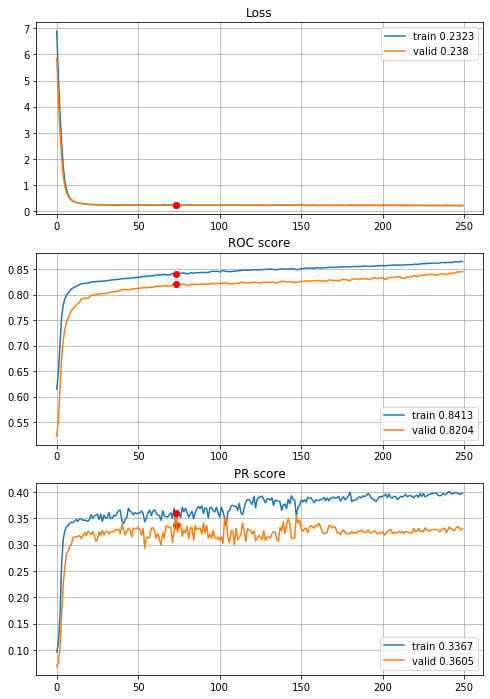


Fold 2------------------------------------------------------------


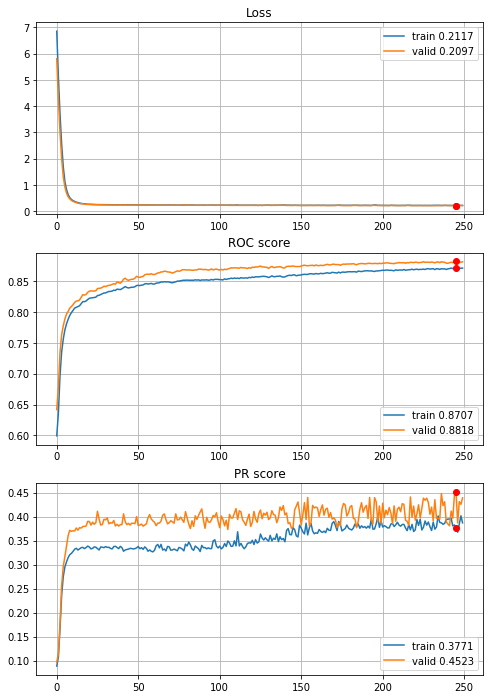


Fold 3------------------------------------------------------------


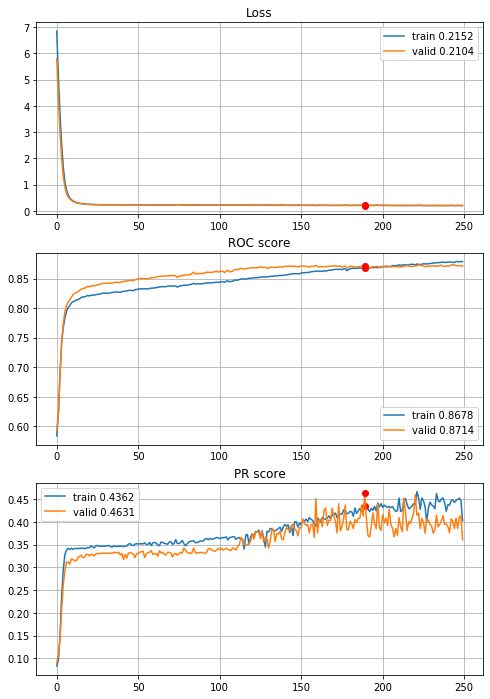


Fold 4------------------------------------------------------------


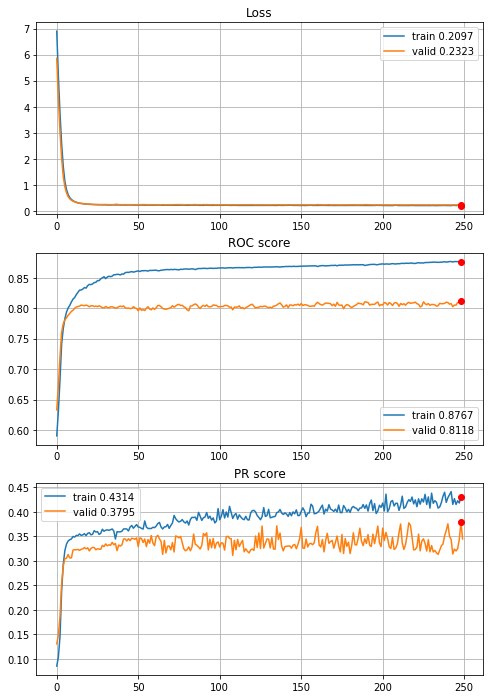


Fold 5------------------------------------------------------------


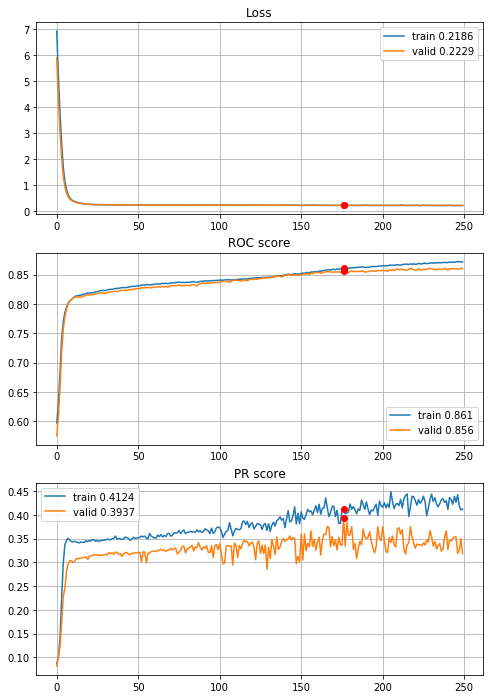


Fold 6------------------------------------------------------------


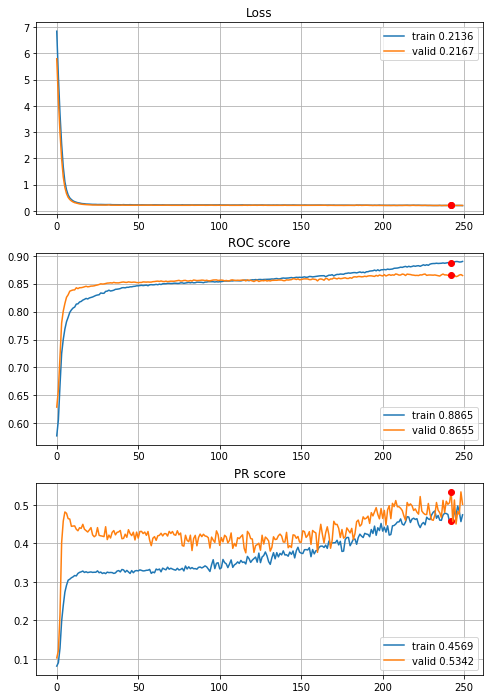

In [70]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_3inc_2dense_std_L1_0005_drop,
                                        features=features, target=target, n_epochs=250, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Dropout worsen results again. More epochs without dropout


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/500,
cumulative time: 7.95s train loss: 6.909443149712972, validation loss: 5.892184101607915
Epoch: 2/500,
cumulative time: 11.99s train loss: 5.1877070187661625, validation loss: 4.327745756947067
Epoch: 3/500,
cumulative time: 16.01s train loss: 3.7453505535633553, validation loss: 3.0397267148083467
Epoch: 4/500,
cumulative time: 19.98s train loss: 2.578294167234579, validation loss: 2.035880954047873
Epoch: 5/500,
cumulative time: 23.94s train loss: 1.7010488001232973, validation loss: 1.332872287799702
Epoch: 6/500,
cumulative time: 27.88s train loss: 1.129095924917326, validation loss: 0.9344850880720704
Epoch: 7/500,
cumulative time: 31.74s train loss: 0.8302708499752227, validation loss: 0.7062348436476009
Epoch: 8/500,
cumulative time: 35.61s train loss: 0.6314568870334418, validation loss: 0.5659218820267626
Epoch: 9/500,
cumulative time: 39.52s train loss: 0.5207894385291351, validation l

Epoch: 76/500,
cumulative time: 304.62s train loss: 0.21714286486002943, validation loss: 0.22458217665133107
Epoch: 77/500,
cumulative time: 308.48s train loss: 0.2193316266492063, validation loss: 0.22484943472277352
Epoch: 78/500,
cumulative time: 312.34s train loss: 0.2181894979927191, validation loss: 0.22415778481032964
Epoch: 79/500,
cumulative time: 316.22s train loss: 0.215640398401377, validation loss: 0.22425594972919047
Epoch: 80/500,
cumulative time: 320.04s train loss: 0.21866763424841076, validation loss: 0.22553001418121774
Epoch: 81/500,
cumulative time: 323.9s train loss: 0.2184000314895857, validation loss: 0.2321059096524788
Epoch: 82/500,
cumulative time: 327.74s train loss: 0.21587103201136906, validation loss: 0.22637447343536535
Epoch: 83/500,
cumulative time: 331.6s train loss: 0.21653657602247134, validation loss: 0.22328275332926628
Epoch: 84/500,
cumulative time: 335.44s train loss: 0.21492070526503268, validation loss: 0.22828717101386328
Epoch: 85/500,
cum

Epoch: 151/500,
cumulative time: 600.49s train loss: 0.2135932991745132, validation loss: 0.2247684765628118
Epoch: 152/500,
cumulative time: 604.4s train loss: 0.21199341706043975, validation loss: 0.2229794959675231
Epoch: 153/500,
cumulative time: 608.32s train loss: 0.21076886504485073, validation loss: 0.2209289678054302
Epoch: 154/500,
cumulative time: 612.24s train loss: 0.20967847681083188, validation loss: 0.21923895289422157
Epoch: 155/500,
cumulative time: 616.24s train loss: 0.20939148164989715, validation loss: 0.2213619335931479
Epoch: 156/500,
cumulative time: 620.28s train loss: 0.211902335373557, validation loss: 0.21922378645203966
Epoch: 157/500,
cumulative time: 624.16s train loss: 0.21005043041108962, validation loss: 0.2188821011291147
Epoch: 158/500,
cumulative time: 628.03s train loss: 0.21019324842531112, validation loss: 0.21983318842250305
Epoch: 159/500,
cumulative time: 631.93s train loss: 0.21065223356876994, validation loss: 0.2192283059557503
Epoch: 160/

Epoch: 226/500,
cumulative time: 894.75s train loss: 0.20214305011158815, validation loss: 0.22005900490310845
Epoch: 227/500,
cumulative time: 898.63s train loss: 0.2042359725474666, validation loss: 0.2124540903085786
Epoch: 228/500,
cumulative time: 902.51s train loss: 0.20473797893696313, validation loss: 0.2129973181373237
Epoch: 229/500,
cumulative time: 906.36s train loss: 0.20074426604683648, validation loss: 0.21225108075235985
Epoch: 230/500,
cumulative time: 910.24s train loss: 0.20022098560034152, validation loss: 0.2117054314933205
Epoch: 231/500,
cumulative time: 914.16s train loss: 0.19990838060848118, validation loss: 0.21186613670330842
Epoch: 232/500,
cumulative time: 918.05s train loss: 0.2002620166133995, validation loss: 0.21149993566071704
Epoch: 233/500,
cumulative time: 921.91s train loss: 0.19980147365978262, validation loss: 0.21171744315640365
Epoch: 234/500,
cumulative time: 925.81s train loss: 0.20015781805833754, validation loss: 0.2148117174760868
Epoch: 

Epoch: 300/500,
cumulative time: 1182.56s train loss: 0.18949819951980554, validation loss: 0.20429407470054262
Epoch: 301/500,
cumulative time: 1186.46s train loss: 0.1922619598362904, validation loss: 0.2051977178222566
Epoch: 302/500,
cumulative time: 1190.39s train loss: 0.1898721716323, validation loss: 0.20342010483061718
Epoch: 303/500,
cumulative time: 1194.38s train loss: 0.19366260496933108, validation loss: 0.21954634271587298
Epoch: 304/500,
cumulative time: 1198.27s train loss: 0.1916971242573072, validation loss: 0.2091800271624777
Epoch: 305/500,
cumulative time: 1202.18s train loss: 0.1930291051656976, validation loss: 0.21094354278205346
Epoch: 306/500,
cumulative time: 1206.09s train loss: 0.1899686607965924, validation loss: 0.21269869906859307
Epoch: 307/500,
cumulative time: 1209.99s train loss: 0.1923216346463034, validation loss: 0.20359520982056353
Epoch: 308/500,
cumulative time: 1213.89s train loss: 0.19263315625112196, validation loss: 0.2035724632399999
Epoc

Epoch: 374/500,
cumulative time: 1470.43s train loss: 0.177358169219581, validation loss: 0.2028740850248896
Epoch: 375/500,
cumulative time: 1474.3s train loss: 0.1801049369740357, validation loss: 0.20802430707747127
Epoch: 376/500,
cumulative time: 1478.17s train loss: 0.18132262167248486, validation loss: 0.21180647719134876
Epoch: 377/500,
cumulative time: 1482.07s train loss: 0.17916489433537536, validation loss: 0.20237694074228624
Epoch: 378/500,
cumulative time: 1486.02s train loss: 0.17812418630716495, validation loss: 0.20648881893819188
Epoch: 379/500,
cumulative time: 1489.87s train loss: 0.17783849024035656, validation loss: 0.22043928409912944
Epoch: 380/500,
cumulative time: 1493.79s train loss: 0.18627238492162004, validation loss: 0.20438616592626024
Epoch: 381/500,
cumulative time: 1497.66s train loss: 0.18042823284972015, validation loss: 0.20593999173353597
Epoch: 382/500,
cumulative time: 1501.8s train loss: 0.17643148084893984, validation loss: 0.2042186383363762

Epoch: 448/500,
cumulative time: 1757.3s train loss: 0.16899995710230045, validation loss: 0.2075429275682303
Epoch: 449/500,
cumulative time: 1761.13s train loss: 0.16841745381966394, validation loss: 0.20764960625797946
Epoch: 450/500,
cumulative time: 1765.02s train loss: 0.16785264071009864, validation loss: 0.2077662884147487
Epoch: 451/500,
cumulative time: 1768.88s train loss: 0.16902108297478205, validation loss: 0.21412578559445958
Epoch: 452/500,
cumulative time: 1772.75s train loss: 0.17322941331213024, validation loss: 0.21672864977308165
Epoch: 453/500,
cumulative time: 1776.62s train loss: 0.17210167785938357, validation loss: 0.22131523666346892
Epoch: 454/500,
cumulative time: 1780.5s train loss: 0.1786463576896849, validation loss: 0.21072038749428182
Epoch: 455/500,
cumulative time: 1784.37s train loss: 0.17086161818314977, validation loss: 0.20699168168839904
Epoch: 456/500,
cumulative time: 1788.24s train loss: 0.16770487213473673, validation loss: 0.207211340595931

Epoch: 20/500,
cumulative time: 83.27s train loss: 0.25087497985185486, validation loss: 0.2472301010617812
Epoch: 21/500,
cumulative time: 87.23s train loss: 0.24762553339723214, validation loss: 0.24679031465811552
Epoch: 22/500,
cumulative time: 91.2s train loss: 0.2483250360182799, validation loss: 0.24110027855386057
Epoch: 23/500,
cumulative time: 95.15s train loss: 0.24153219652950547, validation loss: 0.23561030291986843
Epoch: 24/500,
cumulative time: 99.09s train loss: 0.2374477037615294, validation loss: 0.23163479467457015
Epoch: 25/500,
cumulative time: 103.02s train loss: 0.23505118475816741, validation loss: 0.22977920558635384
Epoch: 26/500,
cumulative time: 106.98s train loss: 0.23309122012517944, validation loss: 0.22852353509746517
Epoch: 27/500,
cumulative time: 110.92s train loss: 0.231413812265607, validation loss: 0.22659560379476665
Epoch: 28/500,
cumulative time: 114.85s train loss: 0.23113333685357218, validation loss: 0.22547292921024353
Epoch: 29/500,
cumula

Epoch: 96/500,
cumulative time: 382.66s train loss: 0.2143897218730583, validation loss: 0.21079446158656406
Epoch: 97/500,
cumulative time: 386.55s train loss: 0.21386981579317083, validation loss: 0.2131950027039516
Epoch: 98/500,
cumulative time: 390.46s train loss: 0.21399403248479865, validation loss: 0.2123211581079371
Epoch: 99/500,
cumulative time: 394.39s train loss: 0.2121768958651417, validation loss: 0.2099782020323978
Epoch: 100/500,
cumulative time: 398.31s train loss: 0.21279413886502763, validation loss: 0.2119091497870685
Epoch: 101/500,
cumulative time: 402.28s train loss: 0.21255341076060108, validation loss: 0.21309149744075206
Epoch: 102/500,
cumulative time: 406.19s train loss: 0.21396650521871416, validation loss: 0.21249479508991306
Epoch: 103/500,
cumulative time: 410.13s train loss: 0.21723388275972128, validation loss: 0.2156985799919524
Epoch: 104/500,
cumulative time: 414.06s train loss: 0.21648454379680354, validation loss: 0.21089646124450034
Epoch: 105/5

Epoch: 171/500,
cumulative time: 675.75s train loss: 0.20426852872010173, validation loss: 0.2009573339105593
Epoch: 172/500,
cumulative time: 679.68s train loss: 0.20575760950465494, validation loss: 0.20200828917265745
Epoch: 173/500,
cumulative time: 683.61s train loss: 0.20747818159685882, validation loss: 0.20666264017714187
Epoch: 174/500,
cumulative time: 687.56s train loss: 0.21083998433331075, validation loss: 0.21292220938031003
Epoch: 175/500,
cumulative time: 691.5s train loss: 0.20697069387304654, validation loss: 0.2023108121104278
Epoch: 176/500,
cumulative time: 695.41s train loss: 0.20456934123155443, validation loss: 0.20113944689813568
Epoch: 177/500,
cumulative time: 699.38s train loss: 0.20347798725973398, validation loss: 0.2015544740061077
Epoch: 178/500,
cumulative time: 703.31s train loss: 0.20258351126248655, validation loss: 0.20129192480239955
Epoch: 179/500,
cumulative time: 707.28s train loss: 0.20312224885966587, validation loss: 0.2004913364651507
Epoch:

Epoch: 246/500,
cumulative time: 970.98s train loss: 0.19676599779337753, validation loss: 0.19726302609973184
Epoch: 247/500,
cumulative time: 974.89s train loss: 0.19661912763834216, validation loss: 0.19617460911679832
Epoch: 248/500,
cumulative time: 978.82s train loss: 0.20167296328699547, validation loss: 0.19657891624205007
Epoch: 249/500,
cumulative time: 982.73s train loss: 0.1974363662571468, validation loss: 0.19828672313972417
Epoch: 250/500,
cumulative time: 986.66s train loss: 0.1959923497579373, validation loss: 0.19578324258327484
Epoch: 251/500,
cumulative time: 990.58s train loss: 0.19596268772567868, validation loss: 0.1960196455913305
Epoch: 252/500,
cumulative time: 994.51s train loss: 0.19529195378672345, validation loss: 0.19648873690083168
Epoch: 253/500,
cumulative time: 998.42s train loss: 0.196602191503701, validation loss: 0.1960312224160187
Epoch: 254/500,
cumulative time: 1002.38s train loss: 0.19531746678027434, validation loss: 0.19882042158348853
Epoch:

Epoch: 320/500,
cumulative time: 1263.87s train loss: 0.19084310408560592, validation loss: 0.20129679951485008
Epoch: 321/500,
cumulative time: 1267.85s train loss: 0.19274502424422368, validation loss: 0.19606986949314797
Epoch: 322/500,
cumulative time: 1271.91s train loss: 0.19007357019621757, validation loss: 0.1943939345161165
Epoch: 323/500,
cumulative time: 1275.88s train loss: 0.19381528572996384, validation loss: 0.19450211995349528
Epoch: 324/500,
cumulative time: 1279.85s train loss: 0.19019236086803867, validation loss: 0.19294090117112625
Epoch: 325/500,
cumulative time: 1283.79s train loss: 0.1903089424561615, validation loss: 0.1919804913450658
Epoch: 326/500,
cumulative time: 1287.7s train loss: 0.18871522144774236, validation loss: 0.1904767330698123
Epoch: 327/500,
cumulative time: 1291.63s train loss: 0.18839258750369403, validation loss: 0.1902950904515846
Epoch: 328/500,
cumulative time: 1295.6s train loss: 0.1888227195811831, validation loss: 0.19161079986925997


Epoch: 394/500,
cumulative time: 1555.8s train loss: 0.1810597507081361, validation loss: 0.19150599059486068
Epoch: 395/500,
cumulative time: 1559.72s train loss: 0.18310457135177477, validation loss: 0.18675227849634013
Epoch: 396/500,
cumulative time: 1563.68s train loss: 0.1822421804325998, validation loss: 0.1872640904942118
Epoch: 397/500,
cumulative time: 1567.61s train loss: 0.180976114535052, validation loss: 0.18674056814918388
Epoch: 398/500,
cumulative time: 1571.57s train loss: 0.18089968699706374, validation loss: 0.1868648842195513
Epoch: 399/500,
cumulative time: 1575.52s train loss: 0.1817819325569412, validation loss: 0.1886339675479704
Epoch: 400/500,
cumulative time: 1579.45s train loss: 0.18293255137864647, validation loss: 0.18794324653057262
Epoch: 401/500,
cumulative time: 1583.37s train loss: 0.1849016424281933, validation loss: 0.18700953022804712
Epoch: 402/500,
cumulative time: 1587.3s train loss: 0.1813005543841782, validation loss: 0.1913488192952069
Epoch

Epoch: 468/500,
cumulative time: 1846.83s train loss: 0.17672595023328863, validation loss: 0.19051366525344138
Epoch: 469/500,
cumulative time: 1850.76s train loss: 0.1825296438100751, validation loss: 0.1959153756314496
Epoch: 470/500,
cumulative time: 1854.68s train loss: 0.18155340647950285, validation loss: 0.18879985113826653
Epoch: 471/500,
cumulative time: 1858.62s train loss: 0.17482987031448188, validation loss: 0.1908642113746355
Epoch: 472/500,
cumulative time: 1862.59s train loss: 0.17410909648083608, validation loss: 0.18863617407899294
Epoch: 473/500,
cumulative time: 1866.54s train loss: 0.1715792542262951, validation loss: 0.18718959453275266
Epoch: 474/500,
cumulative time: 1870.57s train loss: 0.16986621996986306, validation loss: 0.1868115172982888
Epoch: 475/500,
cumulative time: 1874.53s train loss: 0.16846513438848812, validation loss: 0.18853455807135902
Epoch: 476/500,
cumulative time: 1878.48s train loss: 0.16954209893901534, validation loss: 0.190790334038159

Epoch: 41/500,
cumulative time: 170.41s train loss: 0.22612806416994183, validation loss: 0.22095689681498282
Epoch: 42/500,
cumulative time: 174.46s train loss: 0.2240309617431693, validation loss: 0.21996499665224298
Epoch: 43/500,
cumulative time: 178.51s train loss: 0.22453274957109445, validation loss: 0.21876648543854038
Epoch: 44/500,
cumulative time: 182.57s train loss: 0.22326970921446054, validation loss: 0.2187453282591724
Epoch: 45/500,
cumulative time: 186.63s train loss: 0.22495251245097347, validation loss: 0.22017555716610276
Epoch: 46/500,
cumulative time: 190.67s train loss: 0.2223933991448221, validation loss: 0.2187124134420408
Epoch: 47/500,
cumulative time: 194.77s train loss: 0.22040414837750502, validation loss: 0.22016132380204378
Epoch: 48/500,
cumulative time: 198.81s train loss: 0.22255454690528476, validation loss: 0.2230228812779219
Epoch: 49/500,
cumulative time: 202.85s train loss: 0.2278493951589192, validation loss: 0.217914423803466
Epoch: 50/500,
cum

Epoch: 116/500,
cumulative time: 474.96s train loss: 0.21350204483320137, validation loss: 0.20435274053856378
Epoch: 117/500,
cumulative time: 478.97s train loss: 0.20998763188800443, validation loss: 0.2089876740868492
Epoch: 118/500,
cumulative time: 483.0s train loss: 0.20890663313386887, validation loss: 0.2031589321447736
Epoch: 119/500,
cumulative time: 487.03s train loss: 0.20659008468854298, validation loss: 0.20428594825904828
Epoch: 120/500,
cumulative time: 491.14s train loss: 0.20711460810773316, validation loss: 0.20692729108295957
Epoch: 121/500,
cumulative time: 495.25s train loss: 0.207931048690681, validation loss: 0.20255236967709314
Epoch: 122/500,
cumulative time: 499.29s train loss: 0.20641287444461984, validation loss: 0.20367152600842103
Epoch: 123/500,
cumulative time: 503.33s train loss: 0.20711358904919255, validation loss: 0.2051942492451985
Epoch: 124/500,
cumulative time: 507.42s train loss: 0.2060590143103677, validation loss: 0.20399635296058763
Epoch: 1

Epoch: 191/500,
cumulative time: 778.56s train loss: 0.1994940751578511, validation loss: 0.20124165801144506
Epoch: 192/500,
cumulative time: 782.61s train loss: 0.20108628997222827, validation loss: 0.20111287295347943
Epoch: 193/500,
cumulative time: 786.65s train loss: 0.2019405382473546, validation loss: 0.20202281328575453
Epoch: 194/500,
cumulative time: 790.68s train loss: 0.20146976000484793, validation loss: 0.2020741813850779
Epoch: 195/500,
cumulative time: 794.74s train loss: 0.1998262883631331, validation loss: 0.2013241727463691
Epoch: 196/500,
cumulative time: 798.77s train loss: 0.20145856388020816, validation loss: 0.20160540425992468
Epoch: 197/500,
cumulative time: 802.8s train loss: 0.20822097351001273, validation loss: 0.2030853449189542
Epoch: 198/500,
cumulative time: 806.84s train loss: 0.20106969251287327, validation loss: 0.20340933392859634
Epoch: 199/500,
cumulative time: 810.9s train loss: 0.19994131199988646, validation loss: 0.20759405479624682
Epoch: 20

Epoch: 266/500,
cumulative time: 1081.89s train loss: 0.19073206939421836, validation loss: 0.2080183632613035
Epoch: 267/500,
cumulative time: 1085.95s train loss: 0.19294166769361668, validation loss: 0.2008151726160942
Epoch: 268/500,
cumulative time: 1090.01s train loss: 0.19153526923636022, validation loss: 0.2028434201823012
Epoch: 269/500,
cumulative time: 1094.11s train loss: 0.19063291192014403, validation loss: 0.20350141043794734
Epoch: 270/500,
cumulative time: 1098.17s train loss: 0.19176639130318854, validation loss: 0.20290719498507467
Epoch: 271/500,
cumulative time: 1102.22s train loss: 0.19046467420937568, validation loss: 0.20083980085884706
Epoch: 272/500,
cumulative time: 1106.3s train loss: 0.19011400609751256, validation loss: 0.2013898739148154
Epoch: 273/500,
cumulative time: 1110.33s train loss: 0.1909242434904571, validation loss: 0.20161972073113635
Epoch: 274/500,
cumulative time: 1114.39s train loss: 0.190118497119887, validation loss: 0.2020795934801037
E

Epoch: 340/500,
cumulative time: 1381.61s train loss: 0.17750977326036577, validation loss: 0.21982816849512876
Epoch: 341/500,
cumulative time: 1385.67s train loss: 0.18390015315681374, validation loss: 0.22401727329448218
Epoch: 342/500,
cumulative time: 1389.77s train loss: 0.1838760028798335, validation loss: 0.22540814682354116
Epoch: 343/500,
cumulative time: 1393.83s train loss: 0.1799565684386539, validation loss: 0.20841108089504004
Epoch: 344/500,
cumulative time: 1397.86s train loss: 0.1776919170931681, validation loss: 0.21667777527682272
Epoch: 345/500,
cumulative time: 1401.96s train loss: 0.17812960097290548, validation loss: 0.21070141974404
Epoch: 346/500,
cumulative time: 1406.1s train loss: 0.178354701619017, validation loss: 0.21049098129538565
Epoch: 347/500,
cumulative time: 1410.14s train loss: 0.17978235240017035, validation loss: 0.2242921026173681
Epoch: 348/500,
cumulative time: 1414.22s train loss: 0.18235691399431186, validation loss: 0.21307279634905776
Ep

Epoch: 414/500,
cumulative time: 1681.3s train loss: 0.16844556196878532, validation loss: 0.21791040833531264
Epoch: 415/500,
cumulative time: 1685.35s train loss: 0.16648207343307858, validation loss: 0.23264472682150805
Epoch: 416/500,
cumulative time: 1689.37s train loss: 0.1643386784443356, validation loss: 0.22069328796567886
Epoch: 417/500,
cumulative time: 1693.53s train loss: 0.16350368760687564, validation loss: 0.21849408142663446
Epoch: 418/500,
cumulative time: 1697.57s train loss: 0.16493253950500317, validation loss: 0.221402702330199
Epoch: 419/500,
cumulative time: 1701.63s train loss: 0.1636228248651815, validation loss: 0.22536417532800418
Epoch: 420/500,
cumulative time: 1705.66s train loss: 0.16452736151320624, validation loss: 0.2146742487538358
Epoch: 421/500,
cumulative time: 1709.7s train loss: 0.1715409240621522, validation loss: 0.22529467394346583
Epoch: 422/500,
cumulative time: 1713.76s train loss: 0.1620091671319107, validation loss: 0.22278320522225023
E

Epoch: 488/500,
cumulative time: 1980.8s train loss: 0.15859909622597135, validation loss: 0.24235229155525415
Epoch: 489/500,
cumulative time: 1984.84s train loss: 0.15256925745588132, validation loss: 0.242514431442994
Epoch: 490/500,
cumulative time: 1988.88s train loss: 0.15341553609441658, validation loss: 0.2447866916051712
Epoch: 491/500,
cumulative time: 1992.93s train loss: 0.151690085603442, validation loss: 0.23973500239741574
Epoch: 492/500,
cumulative time: 1996.98s train loss: 0.15266473262843133, validation loss: 0.24120974250079008
Epoch: 493/500,
cumulative time: 2001.0s train loss: 0.1543525606662788, validation loss: 0.24789994995381678
Epoch: 494/500,
cumulative time: 2005.04s train loss: 0.1490588551891517, validation loss: 0.24877597455443498
Epoch: 495/500,
cumulative time: 2009.09s train loss: 0.1478945779604064, validation loss: 0.24379907909616946
Epoch: 496/500,
cumulative time: 2013.13s train loss: 0.14597301680043287, validation loss: 0.24444484987885196
Ep

Epoch: 61/500,
cumulative time: 250.93s train loss: 0.21295954926057512, validation loss: 0.2330978162267138
Epoch: 62/500,
cumulative time: 254.91s train loss: 0.21175015977750425, validation loss: 0.232807374969293
Epoch: 63/500,
cumulative time: 259.0s train loss: 0.21445879965395362, validation loss: 0.23652332217241248
Epoch: 64/500,
cumulative time: 263.01s train loss: 0.21277273575567968, validation loss: 0.23593386193699545
Epoch: 65/500,
cumulative time: 267.0s train loss: 0.21190635913748948, validation loss: 0.2364319698468826
Epoch: 66/500,
cumulative time: 271.01s train loss: 0.21216838284671483, validation loss: 0.2363455860663214
Epoch: 67/500,
cumulative time: 274.98s train loss: 0.2172181778061129, validation loss: 0.23247693092236402
Epoch: 68/500,
cumulative time: 278.99s train loss: 0.21408767580058272, validation loss: 0.23363578847649405
Epoch: 69/500,
cumulative time: 282.97s train loss: 0.21287179307181436, validation loss: 0.2326277621914517
Epoch: 70/500,
cumu

Epoch: 136/500,
cumulative time: 550.85s train loss: 0.2036210657386271, validation loss: 0.2308429190657747
Epoch: 137/500,
cumulative time: 554.84s train loss: 0.20460703050662668, validation loss: 0.2316000003106976
Epoch: 138/500,
cumulative time: 558.85s train loss: 0.2046093921171417, validation loss: 0.2303861760057122
Epoch: 139/500,
cumulative time: 562.85s train loss: 0.20279036519114924, validation loss: 0.2312133325007376
Epoch: 140/500,
cumulative time: 566.86s train loss: 0.20342867613551366, validation loss: 0.23930452525212048
Epoch: 141/500,
cumulative time: 570.85s train loss: 0.20520351741764634, validation loss: 0.23234833824042542
Epoch: 142/500,
cumulative time: 574.86s train loss: 0.20240392911899394, validation loss: 0.2300926812211762
Epoch: 143/500,
cumulative time: 578.85s train loss: 0.20324168376962407, validation loss: 0.23093602337094515
Epoch: 144/500,
cumulative time: 582.88s train loss: 0.20494458405731655, validation loss: 0.2321609991264128
Epoch: 14

Epoch: 211/500,
cumulative time: 851.01s train loss: 0.194523822184263, validation loss: 0.2330281136401889
Epoch: 212/500,
cumulative time: 855.0s train loss: 0.19422403678462705, validation loss: 0.2269244342369635
Epoch: 213/500,
cumulative time: 859.14s train loss: 0.19328276605294678, validation loss: 0.2276605876250945
Epoch: 214/500,
cumulative time: 863.12s train loss: 0.19369728436003197, validation loss: 0.22854319732829625
Epoch: 215/500,
cumulative time: 867.11s train loss: 0.19330399827483327, validation loss: 0.22752086027750312
Epoch: 216/500,
cumulative time: 871.11s train loss: 0.19295950149060534, validation loss: 0.22804787025091072
Epoch: 217/500,
cumulative time: 875.1s train loss: 0.19332158495603768, validation loss: 0.22859143531349388
Epoch: 218/500,
cumulative time: 879.09s train loss: 0.1933659480659036, validation loss: 0.2263584613598227
Epoch: 219/500,
cumulative time: 883.08s train loss: 0.19566345986288933, validation loss: 0.2295978308800381
Epoch: 220/

Epoch: 286/500,
cumulative time: 1151.19s train loss: 0.18209817074449342, validation loss: 0.2282285616306365
Epoch: 287/500,
cumulative time: 1155.19s train loss: 0.18395880104025572, validation loss: 0.2292541480427671
Epoch: 288/500,
cumulative time: 1159.2s train loss: 0.18497679409790113, validation loss: 0.22904898633268025
Epoch: 289/500,
cumulative time: 1163.2s train loss: 0.1874498444965024, validation loss: 0.23061537103513025
Epoch: 290/500,
cumulative time: 1167.18s train loss: 0.18420243657874974, validation loss: 0.22900718736460193
Epoch: 291/500,
cumulative time: 1171.17s train loss: 0.18365746207775607, validation loss: 0.23023650665719136
Epoch: 292/500,
cumulative time: 1175.16s train loss: 0.18161002713107052, validation loss: 0.22666421418265348
Epoch: 293/500,
cumulative time: 1179.15s train loss: 0.1812867605501982, validation loss: 0.22718955687421707
Epoch: 294/500,
cumulative time: 1183.14s train loss: 0.1825042296929578, validation loss: 0.22943403163155368

Epoch: 360/500,
cumulative time: 1447.28s train loss: 0.1697140419097294, validation loss: 0.23700944867413953
Epoch: 361/500,
cumulative time: 1451.29s train loss: 0.16871114960244943, validation loss: 0.23866415148260361
Epoch: 362/500,
cumulative time: 1455.28s train loss: 0.16759336883479092, validation loss: 0.24093663571381407
Epoch: 363/500,
cumulative time: 1459.42s train loss: 0.16904585803977637, validation loss: 0.24021209120481332
Epoch: 364/500,
cumulative time: 1463.44s train loss: 0.1696244344542157, validation loss: 0.2410038724104384
Epoch: 365/500,
cumulative time: 1467.49s train loss: 0.17000227769596862, validation loss: 0.24568539968866257
Epoch: 366/500,
cumulative time: 1471.49s train loss: 0.17134811870540315, validation loss: 0.23983172503873942
Epoch: 367/500,
cumulative time: 1475.46s train loss: 0.16849350055291856, validation loss: 0.24737297287778445
Epoch: 368/500,
cumulative time: 1479.47s train loss: 0.17442284728142632, validation loss: 0.2395747826344

Epoch: 434/500,
cumulative time: 1743.89s train loss: 0.15412478014144407, validation loss: 0.25810615129718395
Epoch: 435/500,
cumulative time: 1747.9s train loss: 0.1536800189445015, validation loss: 0.2552364888027075
Epoch: 436/500,
cumulative time: 1751.9s train loss: 0.15248261005889743, validation loss: 0.25841169331735736
Epoch: 437/500,
cumulative time: 1755.98s train loss: 0.15392635021162926, validation loss: 0.25988589990757927
Epoch: 438/500,
cumulative time: 1760.0s train loss: 0.1542400108781002, validation loss: 0.26056213626474073
Epoch: 439/500,
cumulative time: 1763.99s train loss: 0.154772187520332, validation loss: 0.2633328863648744
Epoch: 440/500,
cumulative time: 1768.0s train loss: 0.16024514335946521, validation loss: 0.27229834430373817
Epoch: 441/500,
cumulative time: 1772.02s train loss: 0.16139895422058506, validation loss: 0.25719040971980944
Epoch: 442/500,
cumulative time: 1776.06s train loss: 0.15580970780012598, validation loss: 0.27897154383411793
Ep

Epoch: 6/500,
cumulative time: 27.16s train loss: 1.110952570587363, validation loss: 0.912617386194707
Epoch: 7/500,
cumulative time: 31.15s train loss: 0.8120247413497356, validation loss: 0.6836058307716594
Epoch: 8/500,
cumulative time: 35.11s train loss: 0.6168560226507336, validation loss: 0.544778683922899
Epoch: 9/500,
cumulative time: 39.13s train loss: 0.509276645597152, validation loss: 0.46558415472642023
Epoch: 10/500,
cumulative time: 43.14s train loss: 0.4390200714198564, validation loss: 0.40923807556419284
Epoch: 11/500,
cumulative time: 47.1s train loss: 0.3903622060254495, validation loss: 0.37225715631017836
Epoch: 12/500,
cumulative time: 51.05s train loss: 0.3652981106043131, validation loss: 0.34799749257871315
Epoch: 13/500,
cumulative time: 55.06s train loss: 0.33639583945570156, validation loss: 0.32319161046977507
Epoch: 14/500,
cumulative time: 59.01s train loss: 0.3120745213728792, validation loss: 0.3077691056792946
Epoch: 15/500,
cumulative time: 62.97s t

Epoch: 82/500,
cumulative time: 328.31s train loss: 0.2126652405771853, validation loss: 0.220457193611976
Epoch: 83/500,
cumulative time: 332.27s train loss: 0.21295867602496552, validation loss: 0.2214242200751875
Epoch: 84/500,
cumulative time: 336.21s train loss: 0.21491173090580865, validation loss: 0.21916058884920978
Epoch: 85/500,
cumulative time: 340.17s train loss: 0.2172739999291054, validation loss: 0.22346761516604413
Epoch: 86/500,
cumulative time: 344.13s train loss: 0.211381238142981, validation loss: 0.21997472835582751
Epoch: 87/500,
cumulative time: 348.07s train loss: 0.21263378495197116, validation loss: 0.22258903284643358
Epoch: 88/500,
cumulative time: 352.01s train loss: 0.21340056439030125, validation loss: 0.21811297034706004
Epoch: 89/500,
cumulative time: 355.96s train loss: 0.2108300097997641, validation loss: 0.21737498024785493
Epoch: 90/500,
cumulative time: 359.91s train loss: 0.2112719500620156, validation loss: 0.2201529680068014
Epoch: 91/500,
cumul

Epoch: 157/500,
cumulative time: 625.48s train loss: 0.19934227743295094, validation loss: 0.21206073762331806
Epoch: 158/500,
cumulative time: 629.5s train loss: 0.2008148649127172, validation loss: 0.21227849478377175
Epoch: 159/500,
cumulative time: 633.46s train loss: 0.19950842758535184, validation loss: 0.21268981627901307
Epoch: 160/500,
cumulative time: 637.4s train loss: 0.19943070548155656, validation loss: 0.22533815433155602
Epoch: 161/500,
cumulative time: 641.48s train loss: 0.20440774183899346, validation loss: 0.2146158399350487
Epoch: 162/500,
cumulative time: 645.45s train loss: 0.19991873143866454, validation loss: 0.21177563690170478
Epoch: 163/500,
cumulative time: 649.4s train loss: 0.19818006821620446, validation loss: 0.21185027015801208
Epoch: 164/500,
cumulative time: 653.35s train loss: 0.1997196324053667, validation loss: 0.21430633057320897
Epoch: 165/500,
cumulative time: 657.32s train loss: 0.1973372827379208, validation loss: 0.21279454385992097
Epoch: 1

Epoch: 232/500,
cumulative time: 922.82s train loss: 0.18490096727693267, validation loss: 0.21557790488341053
Epoch: 233/500,
cumulative time: 926.78s train loss: 0.18538138220965283, validation loss: 0.21489085236871217
Epoch: 234/500,
cumulative time: 930.73s train loss: 0.186307042248895, validation loss: 0.21273095502137598
Epoch: 235/500,
cumulative time: 934.71s train loss: 0.18612225373214022, validation loss: 0.21244323916279167
Epoch: 236/500,
cumulative time: 938.68s train loss: 0.18309856351559947, validation loss: 0.21217117315624962
Epoch: 237/500,
cumulative time: 942.65s train loss: 0.1822271628732636, validation loss: 0.21585862220813673
Epoch: 238/500,
cumulative time: 946.59s train loss: 0.18291969413470124, validation loss: 0.21170196118796114
Epoch: 239/500,
cumulative time: 950.53s train loss: 0.18206037518108453, validation loss: 0.21342876344986478
Epoch: 240/500,
cumulative time: 954.49s train loss: 0.18495705203583243, validation loss: 0.21987389868995674
Epoc

Epoch: 306/500,
cumulative time: 1216.66s train loss: 0.1659920365929254, validation loss: 0.22474475692680135
Epoch: 307/500,
cumulative time: 1220.6s train loss: 0.16810579174075307, validation loss: 0.21366636249873763
Epoch: 308/500,
cumulative time: 1224.56s train loss: 0.16421691308958977, validation loss: 0.21465770002143378
Epoch: 309/500,
cumulative time: 1228.5s train loss: 0.1650968163519822, validation loss: 0.21459342838679157
Epoch: 310/500,
cumulative time: 1232.48s train loss: 0.16411609671372956, validation loss: 0.2147876532500269
Epoch: 311/500,
cumulative time: 1236.44s train loss: 0.1638418483379165, validation loss: 0.2156383111972034
Epoch: 312/500,
cumulative time: 1240.47s train loss: 0.16410976145798858, validation loss: 0.21636692577506295
Epoch: 313/500,
cumulative time: 1244.43s train loss: 0.16415709614780616, validation loss: 0.21659227216755025
Epoch: 314/500,
cumulative time: 1248.39s train loss: 0.16549820779826338, validation loss: 0.24661596196768784

Epoch: 380/500,
cumulative time: 1510.09s train loss: 0.14937399576499827, validation loss: 0.22389070161578348
Epoch: 381/500,
cumulative time: 1514.05s train loss: 0.15016004613424408, validation loss: 0.2193907205662932
Epoch: 382/500,
cumulative time: 1518.02s train loss: 0.15239689588889618, validation loss: 0.22009522540171045
Epoch: 383/500,
cumulative time: 1522.0s train loss: 0.1498240920684151, validation loss: 0.21934843382905353
Epoch: 384/500,
cumulative time: 1525.96s train loss: 0.14815034213949213, validation loss: 0.21956279752755004
Epoch: 385/500,
cumulative time: 1529.9s train loss: 0.14861126269951055, validation loss: 0.23054290382910528
Epoch: 386/500,
cumulative time: 1533.85s train loss: 0.15037279739259948, validation loss: 0.22205806646336282
Epoch: 387/500,
cumulative time: 1537.81s train loss: 0.1464200558738786, validation loss: 0.22093386124003822
Epoch: 388/500,
cumulative time: 1541.76s train loss: 0.14790898193066368, validation loss: 0.223177266242003

Epoch: 454/500,
cumulative time: 1803.46s train loss: 0.13848862468443363, validation loss: 0.23772266749334658
Epoch: 455/500,
cumulative time: 1807.42s train loss: 0.13586834572909406, validation loss: 0.22352596582596782
Epoch: 456/500,
cumulative time: 1811.38s train loss: 0.14302174419924338, validation loss: 0.2238858808378603
Epoch: 457/500,
cumulative time: 1815.32s train loss: 0.136290287275011, validation loss: 0.22912775625897314
Epoch: 458/500,
cumulative time: 1819.28s train loss: 0.13280224173205607, validation loss: 0.23316883913012176
Epoch: 459/500,
cumulative time: 1823.24s train loss: 0.13051599921638046, validation loss: 0.23121348107506945
Epoch: 460/500,
cumulative time: 1827.2s train loss: 0.13163348178938283, validation loss: 0.23352043838587086
Epoch: 461/500,
cumulative time: 1831.14s train loss: 0.12967126214145241, validation loss: 0.2322180634427555
Epoch: 462/500,
cumulative time: 1835.08s train loss: 0.13176619682184545, validation loss: 0.234280594046444

Epoch: 27/500,
cumulative time: 112.64s train loss: 0.2329380726864019, validation loss: 0.21435335265056274
Epoch: 28/500,
cumulative time: 116.64s train loss: 0.23009910103216843, validation loss: 0.21306595468628756
Epoch: 29/500,
cumulative time: 120.61s train loss: 0.2325799010850333, validation loss: 0.21391834281637223
Epoch: 30/500,
cumulative time: 124.59s train loss: 0.22828959192120138, validation loss: 0.2155471479448723
Epoch: 31/500,
cumulative time: 128.6s train loss: 0.22922812498721049, validation loss: 0.2156138385795309
Epoch: 32/500,
cumulative time: 132.59s train loss: 0.22787865056508608, validation loss: 0.21663628404215818
Epoch: 33/500,
cumulative time: 136.58s train loss: 0.23058810242876737, validation loss: 0.21732155941679032
Epoch: 34/500,
cumulative time: 140.58s train loss: 0.22671399160483446, validation loss: 0.21110523742693002
Epoch: 35/500,
cumulative time: 144.57s train loss: 0.2250288787119119, validation loss: 0.20934343657563556
Epoch: 36/500,
c

Epoch: 102/500,
cumulative time: 412.57s train loss: 0.21207542819643893, validation loss: 0.21089433301786806
Epoch: 103/500,
cumulative time: 416.56s train loss: 0.21363672681662074, validation loss: 0.20981771877334027
Epoch: 104/500,
cumulative time: 420.55s train loss: 0.2117266662598678, validation loss: 0.21012885168901146
Epoch: 105/500,
cumulative time: 424.53s train loss: 0.21138710514662257, validation loss: 0.20877720560231006
Epoch: 106/500,
cumulative time: 428.56s train loss: 0.21177073078179182, validation loss: 0.21453424195000065
Epoch: 107/500,
cumulative time: 432.57s train loss: 0.21096651532392913, validation loss: 0.20877765246896118
Epoch: 108/500,
cumulative time: 436.58s train loss: 0.2118067424479656, validation loss: 0.20869591744704924
Epoch: 109/500,
cumulative time: 440.57s train loss: 0.21200471440825536, validation loss: 0.20961528811309463
Epoch: 110/500,
cumulative time: 444.56s train loss: 0.21271699523444426, validation loss: 0.20879445563051555
Epo

Epoch: 177/500,
cumulative time: 712.64s train loss: 0.20417810923058752, validation loss: 0.2042097724452783
Epoch: 178/500,
cumulative time: 716.64s train loss: 0.20497989813199893, validation loss: 0.20962282863884962
Epoch: 179/500,
cumulative time: 720.6s train loss: 0.20514055926200636, validation loss: 0.20438376277617892
Epoch: 180/500,
cumulative time: 724.61s train loss: 0.20447989808848877, validation loss: 0.20418668499649512
Epoch: 181/500,
cumulative time: 728.62s train loss: 0.20361230200874653, validation loss: 0.2045167217001689
Epoch: 182/500,
cumulative time: 732.61s train loss: 0.20335805250389324, validation loss: 0.205241340513154
Epoch: 183/500,
cumulative time: 736.6s train loss: 0.20475928318667244, validation loss: 0.20770139780324415
Epoch: 184/500,
cumulative time: 740.59s train loss: 0.20418230753611313, validation loss: 0.2127639086870792
Epoch: 185/500,
cumulative time: 744.57s train loss: 0.20780635760084867, validation loss: 0.21596311614691
Epoch: 186/

Epoch: 252/500,
cumulative time: 1012.79s train loss: 0.1931645567143391, validation loss: 0.20146397819099254
Epoch: 253/500,
cumulative time: 1016.77s train loss: 0.19094804210343372, validation loss: 0.20372195750407657
Epoch: 254/500,
cumulative time: 1020.78s train loss: 0.19213148017056553, validation loss: 0.19968095277152265
Epoch: 255/500,
cumulative time: 1024.78s train loss: 0.1896308033602947, validation loss: 0.20197620614522196
Epoch: 256/500,
cumulative time: 1028.77s train loss: 0.19052584755879182, validation loss: 0.20153698466432282
Epoch: 257/500,
cumulative time: 1032.75s train loss: 0.18984009473070507, validation loss: 0.19685693979936045
Epoch: 258/500,
cumulative time: 1036.77s train loss: 0.18823990106797772, validation loss: 0.20318301563607383
Epoch: 259/500,
cumulative time: 1040.77s train loss: 0.18880508875042812, validation loss: 0.19687897155301026
Epoch: 260/500,
cumulative time: 1044.76s train loss: 0.18852996530703328, validation loss: 0.207370579780

Epoch: 326/500,
cumulative time: 1308.94s train loss: 0.17473618528212592, validation loss: 0.19918488403340764
Epoch: 327/500,
cumulative time: 1312.9s train loss: 0.17814582517379404, validation loss: 0.1998425716740283
Epoch: 328/500,
cumulative time: 1316.91s train loss: 0.17683631328274696, validation loss: 0.20564380442853974
Epoch: 329/500,
cumulative time: 1320.89s train loss: 0.17543656530080143, validation loss: 0.20250043552158647
Epoch: 330/500,
cumulative time: 1324.9s train loss: 0.17692491568132526, validation loss: 0.20134290124438955
Epoch: 331/500,
cumulative time: 1328.89s train loss: 0.1744396163349412, validation loss: 0.20407373049458316
Epoch: 332/500,
cumulative time: 1332.88s train loss: 0.1742190715894456, validation loss: 0.20375208973750034
Epoch: 333/500,
cumulative time: 1336.87s train loss: 0.1753568118927631, validation loss: 0.2026321545882365
Epoch: 334/500,
cumulative time: 1340.88s train loss: 0.17790880152893046, validation loss: 0.20521586712945933

Epoch: 400/500,
cumulative time: 1605.39s train loss: 0.16594898097675917, validation loss: 0.20475608685619406
Epoch: 401/500,
cumulative time: 1609.38s train loss: 0.16341837676577717, validation loss: 0.2030489612244591
Epoch: 402/500,
cumulative time: 1613.36s train loss: 0.1635731281954253, validation loss: 0.2083427135077879
Epoch: 403/500,
cumulative time: 1617.37s train loss: 0.1627891397411657, validation loss: 0.2066826321537823
Epoch: 404/500,
cumulative time: 1621.43s train loss: 0.16239914222425675, validation loss: 0.20742340496915726
Epoch: 405/500,
cumulative time: 1625.45s train loss: 0.16331945547946225, validation loss: 0.2046726192631517
Epoch: 406/500,
cumulative time: 1629.43s train loss: 0.16240982598707687, validation loss: 0.2074140779522687
Epoch: 407/500,
cumulative time: 1633.42s train loss: 0.16138908051386283, validation loss: 0.20468785649094032
Epoch: 408/500,
cumulative time: 1637.43s train loss: 0.16385530499741854, validation loss: 0.21781344752144868

Epoch: 474/500,
cumulative time: 1901.62s train loss: 0.15354283293509574, validation loss: 0.21367542607116916
Epoch: 475/500,
cumulative time: 1905.64s train loss: 0.14931276190867146, validation loss: 0.21681049667954713
Epoch: 476/500,
cumulative time: 1909.62s train loss: 0.14996986556693176, validation loss: 0.2096096165562322
Epoch: 477/500,
cumulative time: 1913.63s train loss: 0.15022589277056736, validation loss: 0.2190654644107711
Epoch: 478/500,
cumulative time: 1917.67s train loss: 0.1500503196505615, validation loss: 0.21447288038095555
Epoch: 479/500,
cumulative time: 1921.7s train loss: 0.1527855438221235, validation loss: 0.21819074250101775
Epoch: 480/500,
cumulative time: 1925.71s train loss: 0.16521250240936683, validation loss: 0.23360065507027689
Epoch: 481/500,
cumulative time: 1929.7s train loss: 0.16038855014819742, validation loss: 0.21284440371710345
Epoch: 482/500,
cumulative time: 1933.71s train loss: 0.1505084619053782, validation loss: 0.21207443915694346

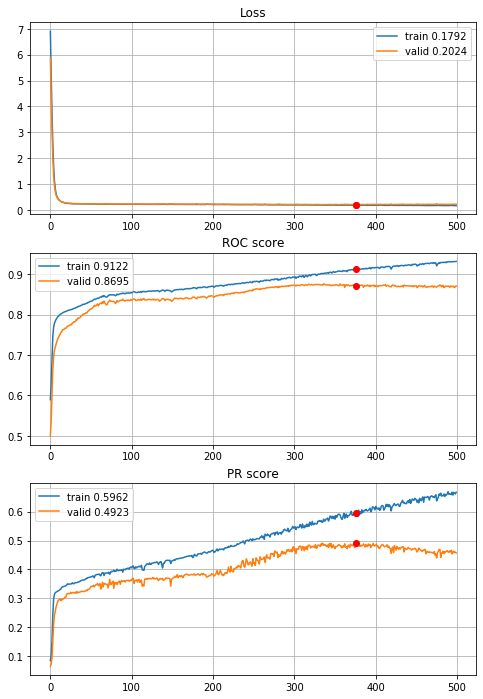


Fold 2------------------------------------------------------------


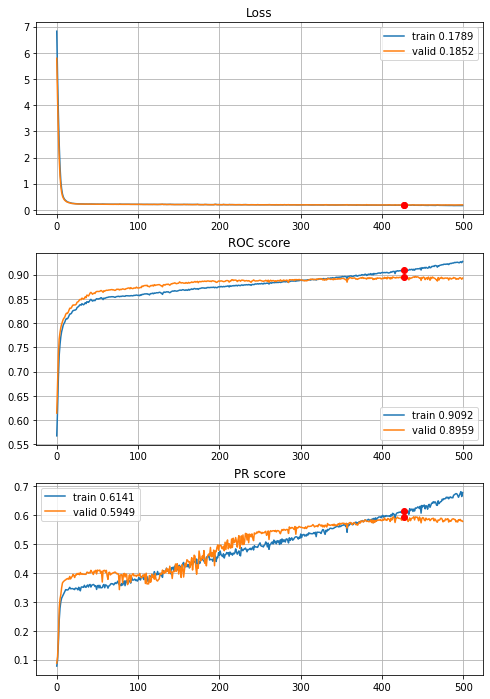


Fold 3------------------------------------------------------------


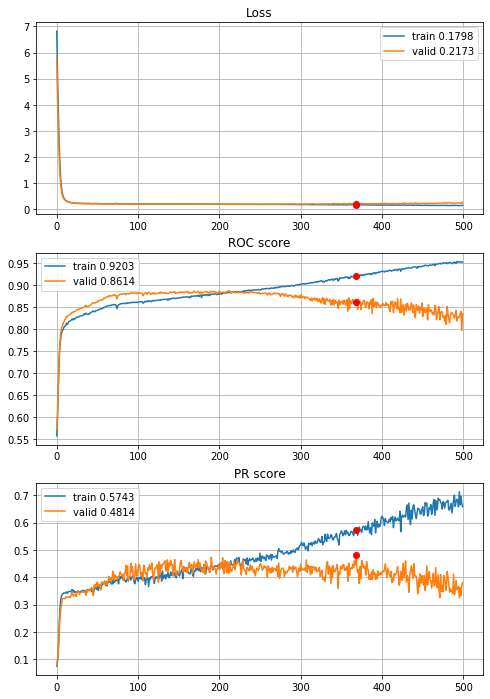


Fold 4------------------------------------------------------------


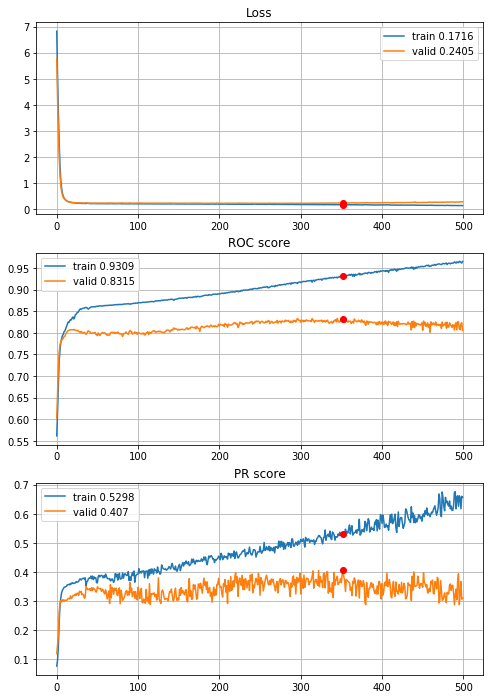


Fold 5------------------------------------------------------------


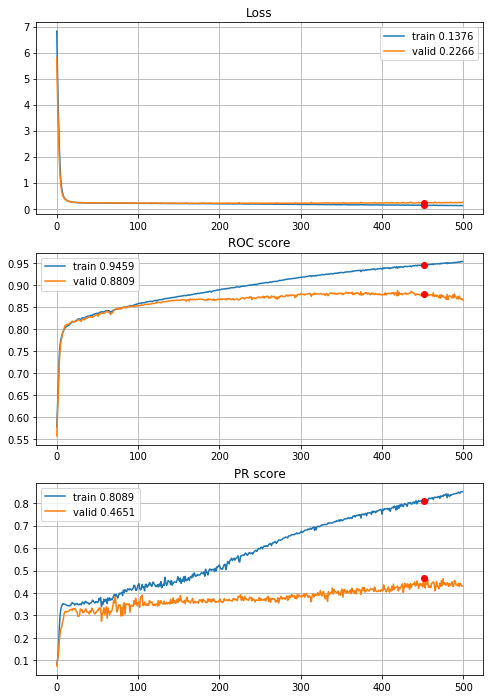


Fold 6------------------------------------------------------------


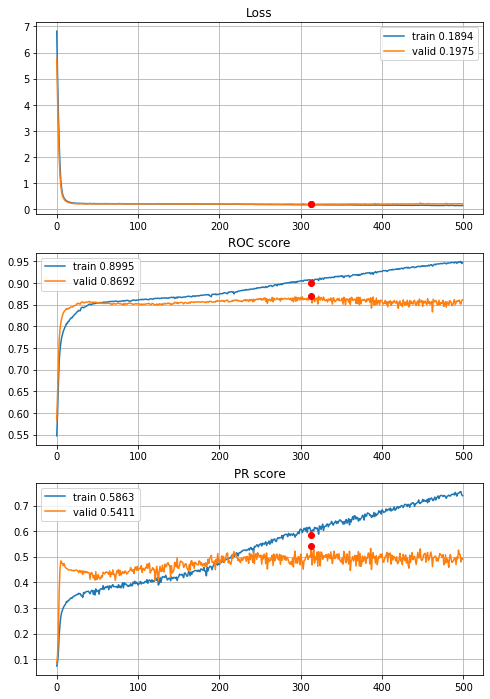

In [88]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_3inc_2dense_std_L1_0005,
                                        features=features, target=target, n_epochs=500, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\5year\define_deep_CNN_3inc_2dense_std_L1_0005_500ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Two inception layers in architecture is enough. When only 1 dense layer applied model gains approx 0.54 PR-AUC, when 2 results grows to 0.55 PR-AUC, but with lower overfitting. On the other hand, 2 dense layers model achive best results much earlier, and starts getting worse afters some number of epochs. To sum up, things to try:
 - 2 inceptions, 2 dense layers with some regularization,
 - 2 inceptions, 1 dense layer with some regularization.

In [58]:
def define_deep_CNN_2inc_std_L1_00005(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.00005))(flat)                           # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model

def define_deep_CNN_2inc_2dense_std_L1_000025(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu, 
                         kernel_regularizer=regularizers.l1(l=0.000025))(flat)                          # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.000025))(dense)                         # (128,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/300,
cumulative time: 3.27s train loss: 0.60664850244776, validation loss: 0.5234787187285999
Epoch: 2/300,
cumulative time: 4.03s train loss: 0.48058726490619813, validation loss: 0.45107100781351495
Epoch: 3/300,
cumulative time: 4.78s train loss: 0.42711187211884055, validation loss: 0.4084108064650414
Epoch: 4/300,
cumulative time: 5.54s train loss: 0.3847195244384156, validation loss: 0.37151643459127615
Epoch: 5/300,
cumulative time: 6.3s train loss: 0.3491707312393705, validation loss: 0.3417249132103151
Epoch: 6/300,
cumulative time: 7.05s train loss: 0.32144942115790576, validation loss: 0.31773123941400006
Epoch: 7/300,
cumulative time: 7.86s train loss: 0.3011666177519822, validation loss: 0.3027155830733806
Epoch: 8/300,
cumulative time: 8.61s train loss: 0.2877920871392054, validation loss: 0.2950781112055902
Epoch: 9/300,
cumulative time: 9.37s train loss: 0.2806425622264293, validation

Epoch: 77/300,
cumulative time: 60.4s train loss: 0.1918555658162716, validation loss: 0.20371524667054447
Epoch: 78/300,
cumulative time: 61.13s train loss: 0.1918208335361541, validation loss: 0.19930764550622448
Epoch: 79/300,
cumulative time: 61.89s train loss: 0.18983124844084362, validation loss: 0.1966808478283909
Epoch: 80/300,
cumulative time: 62.63s train loss: 0.19570106099147874, validation loss: 0.1970943179918115
Epoch: 81/300,
cumulative time: 63.37s train loss: 0.1919371782119524, validation loss: 0.19903365857773192
Epoch: 82/300,
cumulative time: 64.11s train loss: 0.18897885561581124, validation loss: 0.19730902857146107
Epoch: 83/300,
cumulative time: 64.86s train loss: 0.18836465065068286, validation loss: 0.1960082624145398
Epoch: 84/300,
cumulative time: 65.59s train loss: 0.18842285462665215, validation loss: 0.20025503865559716
Epoch: 85/300,
cumulative time: 66.33s train loss: 0.19089392368221111, validation loss: 0.19691146641398496
Epoch: 86/300,
cumulative 

Epoch: 152/300,
cumulative time: 116.66s train loss: 0.1757202368659986, validation loss: 0.1928645438580798
Epoch: 153/300,
cumulative time: 117.41s train loss: 0.17566065606577086, validation loss: 0.19238008506671686
Epoch: 154/300,
cumulative time: 118.15s train loss: 0.17372952334394523, validation loss: 0.18751091771289757
Epoch: 155/300,
cumulative time: 118.89s train loss: 0.17312636739483594, validation loss: 0.18992141908897756
Epoch: 156/300,
cumulative time: 119.61s train loss: 0.17589403512729634, validation loss: 0.1875657739103042
Epoch: 157/300,
cumulative time: 120.35s train loss: 0.17323721403975564, validation loss: 0.18768236756727957
Epoch: 158/300,
cumulative time: 121.11s train loss: 0.17321651761793272, validation loss: 0.18896974162896832
Epoch: 159/300,
cumulative time: 121.85s train loss: 0.17382245498712742, validation loss: 0.18783731032855885
Epoch: 160/300,
cumulative time: 122.58s train loss: 0.17307234686607703, validation loss: 0.18721176354632438
Epoc

Epoch: 227/300,
cumulative time: 172.28s train loss: 0.163976653159633, validation loss: 0.18734677549212198
Epoch: 228/300,
cumulative time: 173.05s train loss: 0.1647220287095446, validation loss: 0.1866373617827825
Epoch: 229/300,
cumulative time: 173.77s train loss: 0.1626040752748505, validation loss: 0.18719694970895903
Epoch: 230/300,
cumulative time: 174.51s train loss: 0.16206054585155383, validation loss: 0.18660035757967422
Epoch: 231/300,
cumulative time: 175.25s train loss: 0.1630583504678863, validation loss: 0.18639858441664642
Epoch: 232/300,
cumulative time: 176.0s train loss: 0.16246036979426975, validation loss: 0.18616630432637998
Epoch: 233/300,
cumulative time: 176.75s train loss: 0.16234591997326067, validation loss: 0.18632659097669357
Epoch: 234/300,
cumulative time: 177.49s train loss: 0.16237287453311874, validation loss: 0.18875370813867554
Epoch: 235/300,
cumulative time: 178.24s train loss: 0.16250525282473985, validation loss: 0.18666889959486388
Epoch: 2

Train on 4432 samples, validate on 887 samples
Epoch: 1/300,
cumulative time: 2.97s train loss: 0.6113725962379564, validation loss: 0.5198406995081982
Epoch: 2/300,
cumulative time: 3.74s train loss: 0.4863180624933019, validation loss: 0.44372666604489325
Epoch: 3/300,
cumulative time: 4.52s train loss: 0.4273988127385666, validation loss: 0.4002612419300445
Epoch: 4/300,
cumulative time: 5.3s train loss: 0.3844730370150146, validation loss: 0.3613409597548449
Epoch: 5/300,
cumulative time: 6.06s train loss: 0.3483175508920036, validation loss: 0.3289143897366228
Epoch: 6/300,
cumulative time: 6.84s train loss: 0.3179894431564782, validation loss: 0.30355035069292535
Epoch: 7/300,
cumulative time: 7.6s train loss: 0.29735455713117165, validation loss: 0.285989303868411
Epoch: 8/300,
cumulative time: 8.38s train loss: 0.28666823560419064, validation loss: 0.27788121223852896
Epoch: 9/300,
cumulative time: 9.13s train loss: 0.2788342946084613, validation loss: 0.2710104274239051
Epoch:

Epoch: 77/300,
cumulative time: 61.68s train loss: 0.19049915735566122, validation loss: 0.1859544420020556
Epoch: 78/300,
cumulative time: 62.48s train loss: 0.18880878485039898, validation loss: 0.19002942273890958
Epoch: 79/300,
cumulative time: 63.29s train loss: 0.191460035277349, validation loss: 0.1866870111583185
Epoch: 80/300,
cumulative time: 64.08s train loss: 0.19121633919917505, validation loss: 0.18463818875079493
Epoch: 81/300,
cumulative time: 64.85s train loss: 0.1891590003193178, validation loss: 0.18314301833224808
Epoch: 82/300,
cumulative time: 65.63s train loss: 0.18923769003647758, validation loss: 0.18645112280310747
Epoch: 83/300,
cumulative time: 66.41s train loss: 0.18994277450743566, validation loss: 0.1830853105700137
Epoch: 84/300,
cumulative time: 67.22s train loss: 0.18815568142943756, validation loss: 0.18286251047418245
Epoch: 85/300,
cumulative time: 67.97s train loss: 0.1909092378194044, validation loss: 0.1891124636909201
Epoch: 86/300,
cumulative t

Epoch: 152/300,
cumulative time: 119.45s train loss: 0.1786658126686024, validation loss: 0.17617757683945348
Epoch: 153/300,
cumulative time: 120.21s train loss: 0.17884260544465982, validation loss: 0.17468700750301494
Epoch: 154/300,
cumulative time: 120.98s train loss: 0.17714114282750912, validation loss: 0.17575891067304364
Epoch: 155/300,
cumulative time: 121.73s train loss: 0.17910587016345147, validation loss: 0.17543845891683724
Epoch: 156/300,
cumulative time: 122.49s train loss: 0.17659309821115934, validation loss: 0.178332659914636
Epoch: 157/300,
cumulative time: 123.26s train loss: 0.1817825410299891, validation loss: 0.1850463238449215
Epoch: 158/300,
cumulative time: 124.0s train loss: 0.18332514384700935, validation loss: 0.17444744462561043
Epoch: 159/300,
cumulative time: 124.76s train loss: 0.17752495974248497, validation loss: 0.17525585064624585
Epoch: 160/300,
cumulative time: 125.52s train loss: 0.17726682480895348, validation loss: 0.17568772923717907
Epoch: 

Epoch: 227/300,
cumulative time: 176.78s train loss: 0.16864462727378207, validation loss: 0.1700397808663337
Epoch: 228/300,
cumulative time: 177.55s train loss: 0.16806816756187362, validation loss: 0.16964642970645308
Epoch: 229/300,
cumulative time: 178.31s train loss: 0.1697112827928273, validation loss: 0.16979935150404524
Epoch: 230/300,
cumulative time: 179.06s train loss: 0.17015267917314805, validation loss: 0.17039448914896138
Epoch: 231/300,
cumulative time: 179.85s train loss: 0.1676020329273457, validation loss: 0.17509103757082542
Epoch: 232/300,
cumulative time: 180.6s train loss: 0.16974898240115452, validation loss: 0.1699274029108153
Epoch: 233/300,
cumulative time: 181.36s train loss: 0.17193386487205536, validation loss: 0.16937930920615943
Epoch: 234/300,
cumulative time: 182.13s train loss: 0.16938957263335638, validation loss: 0.16912724170098847
Epoch: 235/300,
cumulative time: 182.88s train loss: 0.16931577986408872, validation loss: 0.16981448962226123
Epoch:

Train on 4432 samples, validate on 887 samples
Epoch: 1/300,
cumulative time: 3.02s train loss: 0.5899522549301278, validation loss: 0.5212038648908006
Epoch: 2/300,
cumulative time: 3.8s train loss: 0.48110097371014876, validation loss: 0.44536404390614626
Epoch: 3/300,
cumulative time: 4.57s train loss: 0.42493849733192135, validation loss: 0.4008489446683021
Epoch: 4/300,
cumulative time: 5.34s train loss: 0.3822794768300297, validation loss: 0.3627636679936423
Epoch: 5/300,
cumulative time: 6.09s train loss: 0.3458214182715984, validation loss: 0.33044300854138886
Epoch: 6/300,
cumulative time: 6.86s train loss: 0.3164109929938824, validation loss: 0.30559922202060835
Epoch: 7/300,
cumulative time: 7.61s train loss: 0.2943654793452485, validation loss: 0.2897127133278594
Epoch: 8/300,
cumulative time: 8.38s train loss: 0.2845515031972732, validation loss: 0.2822983179245619
Epoch: 9/300,
cumulative time: 9.13s train loss: 0.27557090932120054, validation loss: 0.27583831158942274
Ep

Epoch: 77/300,
cumulative time: 60.84s train loss: 0.1921467677041189, validation loss: 0.19166401756051696
Epoch: 78/300,
cumulative time: 61.61s train loss: 0.1918944210143565, validation loss: 0.19257311501121305
Epoch: 79/300,
cumulative time: 62.38s train loss: 0.19326551153664123, validation loss: 0.18840883976308442
Epoch: 80/300,
cumulative time: 63.15s train loss: 0.19028614456042486, validation loss: 0.18845821629785497
Epoch: 81/300,
cumulative time: 63.91s train loss: 0.19015994502587868, validation loss: 0.18847298003909552
Epoch: 82/300,
cumulative time: 64.68s train loss: 0.19031541031324692, validation loss: 0.18986940392310886
Epoch: 83/300,
cumulative time: 65.43s train loss: 0.1886419543814896, validation loss: 0.18808476169926472
Epoch: 84/300,
cumulative time: 66.2s train loss: 0.18805593460300662, validation loss: 0.1867261345014228
Epoch: 85/300,
cumulative time: 66.95s train loss: 0.18915232759816336, validation loss: 0.19011777671308097
Epoch: 86/300,
cumulativ

Epoch: 152/300,
cumulative time: 118.4s train loss: 0.17536580613024183, validation loss: 0.18464483518947206
Epoch: 153/300,
cumulative time: 119.17s train loss: 0.17735794547689734, validation loss: 0.17991731441007525
Epoch: 154/300,
cumulative time: 119.93s train loss: 0.17564788414333488, validation loss: 0.18196824140922327
Epoch: 155/300,
cumulative time: 120.68s train loss: 0.1784540604840332, validation loss: 0.1799761848996699
Epoch: 156/300,
cumulative time: 121.45s train loss: 0.1803547571335889, validation loss: 0.18014898348553474
Epoch: 157/300,
cumulative time: 122.23s train loss: 0.17629237481752671, validation loss: 0.18041500766691254
Epoch: 158/300,
cumulative time: 122.98s train loss: 0.1767351098950374, validation loss: 0.18361997721966655
Epoch: 159/300,
cumulative time: 123.74s train loss: 0.17764432605907374, validation loss: 0.17970358021767324
Epoch: 160/300,
cumulative time: 124.49s train loss: 0.17702563082133604, validation loss: 0.17898164657621804
Epoch:

Epoch: 227/300,
cumulative time: 175.57s train loss: 0.1650759372759328, validation loss: 0.177625238055441
Epoch: 228/300,
cumulative time: 176.34s train loss: 0.1648498854098929, validation loss: 0.1862499678954734
Epoch: 229/300,
cumulative time: 177.09s train loss: 0.16581804629092506, validation loss: 0.17697212642653012
Epoch: 230/300,
cumulative time: 177.86s train loss: 0.16776758128447652, validation loss: 0.18144750480856137
Epoch: 231/300,
cumulative time: 178.62s train loss: 0.17201257279875692, validation loss: 0.1775392907783977
Epoch: 232/300,
cumulative time: 179.37s train loss: 0.16576812213239686, validation loss: 0.17959915388799708
Epoch: 233/300,
cumulative time: 180.14s train loss: 0.16720044473018025, validation loss: 0.18058942438112707
Epoch: 234/300,
cumulative time: 180.92s train loss: 0.16562684965639338, validation loss: 0.17706510619488214
Epoch: 235/300,
cumulative time: 181.67s train loss: 0.1636037208570255, validation loss: 0.17928108238649745
Epoch: 2

Train on 4433 samples, validate on 886 samples
Epoch: 1/300,
cumulative time: 2.88s train loss: 0.5953905370120885, validation loss: 0.5131942029058529
Epoch: 2/300,
cumulative time: 3.65s train loss: 0.48070617357280276, validation loss: 0.4405351887976343
Epoch: 3/300,
cumulative time: 4.45s train loss: 0.42618633864857985, validation loss: 0.39564805799090297
Epoch: 4/300,
cumulative time: 5.23s train loss: 0.3817837793886756, validation loss: 0.3580898243605956
Epoch: 5/300,
cumulative time: 6.02s train loss: 0.3465451287505268, validation loss: 0.3286849160764879
Epoch: 6/300,
cumulative time: 6.79s train loss: 0.3162160151340395, validation loss: 0.3058828144391019
Epoch: 7/300,
cumulative time: 7.64s train loss: 0.29619516745233226, validation loss: 0.29425359054828065
Epoch: 8/300,
cumulative time: 8.49s train loss: 0.2866226646207994, validation loss: 0.2856894730848868
Epoch: 9/300,
cumulative time: 9.27s train loss: 0.27710790358048487, validation loss: 0.2815079142089353
Ep

Epoch: 77/300,
cumulative time: 64.95s train loss: 0.18729612588573197, validation loss: 0.22056207508185108
Epoch: 78/300,
cumulative time: 65.76s train loss: 0.19182791837700974, validation loss: 0.21659158674777226
Epoch: 79/300,
cumulative time: 66.53s train loss: 0.18649712683262795, validation loss: 0.21117642673224413
Epoch: 80/300,
cumulative time: 67.31s train loss: 0.18385602276668897, validation loss: 0.21397794863844025
Epoch: 81/300,
cumulative time: 68.08s train loss: 0.18309119871500085, validation loss: 0.21477020321661947
Epoch: 82/300,
cumulative time: 68.85s train loss: 0.18263941041884885, validation loss: 0.22487735270646572
Epoch: 83/300,
cumulative time: 69.62s train loss: 0.18889925677473002, validation loss: 0.21152223404454862
Epoch: 84/300,
cumulative time: 70.4s train loss: 0.18627214806896825, validation loss: 0.21197129836469955
Epoch: 85/300,
cumulative time: 71.18s train loss: 0.19008059303189895, validation loss: 0.21276215919657163
Epoch: 86/300,
cumul

Epoch: 152/300,
cumulative time: 123.4s train loss: 0.1690600287852426, validation loss: 0.2098797561756375
Epoch: 153/300,
cumulative time: 124.2s train loss: 0.16762840380766525, validation loss: 0.20937386360313767
Epoch: 154/300,
cumulative time: 124.95s train loss: 0.1688236846071104, validation loss: 0.20916341860730275
Epoch: 155/300,
cumulative time: 125.74s train loss: 0.16872498938616742, validation loss: 0.20948830297380752
Epoch: 156/300,
cumulative time: 126.51s train loss: 0.16766632261070258, validation loss: 0.21273241435970194
Epoch: 157/300,
cumulative time: 127.28s train loss: 0.17352164509150936, validation loss: 0.2164707575035418
Epoch: 158/300,
cumulative time: 128.06s train loss: 0.17166942838699586, validation loss: 0.21705865254520562
Epoch: 159/300,
cumulative time: 128.82s train loss: 0.16718356496871473, validation loss: 0.2128903522381126
Epoch: 160/300,
cumulative time: 129.59s train loss: 0.1676786950955992, validation loss: 0.20907832436583113
Epoch: 16

Epoch: 227/300,
cumulative time: 181.24s train loss: 0.15561736834767223, validation loss: 0.20718487639728572
Epoch: 228/300,
cumulative time: 182.02s train loss: 0.1573049057432203, validation loss: 0.2087024075923063
Epoch: 229/300,
cumulative time: 182.78s train loss: 0.15621750832894787, validation loss: 0.20762452479813492
Epoch: 230/300,
cumulative time: 183.55s train loss: 0.15451308187730098, validation loss: 0.20997380382858605
Epoch: 231/300,
cumulative time: 184.35s train loss: 0.15766022506804653, validation loss: 0.21096834099723308
Epoch: 232/300,
cumulative time: 185.11s train loss: 0.15993643725345938, validation loss: 0.20743142791580133
Epoch: 233/300,
cumulative time: 185.88s train loss: 0.153835057677815, validation loss: 0.21393327818632665
Epoch: 234/300,
cumulative time: 186.65s train loss: 0.15596861389402394, validation loss: 0.21653380707478145
Epoch: 235/300,
cumulative time: 187.43s train loss: 0.1535751668851047, validation loss: 0.21233647288102867
Epoch:

Train on 4433 samples, validate on 886 samples
Epoch: 1/300,
cumulative time: 3.51s train loss: 0.593387878172397, validation loss: 0.5199886295381033
Epoch: 2/300,
cumulative time: 4.3s train loss: 0.4828365323252046, validation loss: 0.44361719415096346
Epoch: 3/300,
cumulative time: 5.13s train loss: 0.42626070010858386, validation loss: 0.3996336563715278
Epoch: 4/300,
cumulative time: 5.92s train loss: 0.38369724260020843, validation loss: 0.36091506931905554
Epoch: 5/300,
cumulative time: 6.74s train loss: 0.3472068183529116, validation loss: 0.32895588424081995
Epoch: 6/300,
cumulative time: 7.53s train loss: 0.3187020372892647, validation loss: 0.3073398641754219
Epoch: 7/300,
cumulative time: 8.32s train loss: 0.2995939973835049, validation loss: 0.29361978119436827
Epoch: 8/300,
cumulative time: 9.1s train loss: 0.2867262999481147, validation loss: 0.28600264120317204
Epoch: 9/300,
cumulative time: 9.87s train loss: 0.2821845614409947, validation loss: 0.28442032678939955
Epo

Epoch: 77/300,
cumulative time: 64.88s train loss: 0.19044914167351684, validation loss: 0.19946716443276027
Epoch: 78/300,
cumulative time: 65.75s train loss: 0.187894111975251, validation loss: 0.19853192958013738
Epoch: 79/300,
cumulative time: 66.52s train loss: 0.18737581157466507, validation loss: 0.19698165562298173
Epoch: 80/300,
cumulative time: 67.31s train loss: 0.18779434283202426, validation loss: 0.20240847265209086
Epoch: 81/300,
cumulative time: 68.11s train loss: 0.18893222678885513, validation loss: 0.19708635952348902
Epoch: 82/300,
cumulative time: 68.93s train loss: 0.18648200573728663, validation loss: 0.19614589301780977
Epoch: 83/300,
cumulative time: 69.78s train loss: 0.1877717537506692, validation loss: 0.20108899228594374
Epoch: 84/300,
cumulative time: 70.59s train loss: 0.19175585406562853, validation loss: 0.19611910567461233
Epoch: 85/300,
cumulative time: 71.55s train loss: 0.1943934489602083, validation loss: 0.20190737418342658
Epoch: 86/300,
cumulati

Epoch: 152/300,
cumulative time: 125.11s train loss: 0.1758475889544871, validation loss: 0.18653149129171134
Epoch: 153/300,
cumulative time: 125.91s train loss: 0.17775315067487352, validation loss: 0.1915757057696379
Epoch: 154/300,
cumulative time: 126.71s train loss: 0.17580457912418068, validation loss: 0.1858442025448345
Epoch: 155/300,
cumulative time: 127.51s train loss: 0.1766207113260344, validation loss: 0.18916661536182292
Epoch: 156/300,
cumulative time: 128.29s train loss: 0.17841932275697014, validation loss: 0.18722406557801077
Epoch: 157/300,
cumulative time: 129.08s train loss: 0.17537119020572398, validation loss: 0.18575739672167846
Epoch: 158/300,
cumulative time: 129.86s train loss: 0.1790402529539762, validation loss: 0.18661742215097354
Epoch: 159/300,
cumulative time: 130.66s train loss: 0.175983496929651, validation loss: 0.18589128146860454
Epoch: 160/300,
cumulative time: 131.47s train loss: 0.1760742401205442, validation loss: 0.20088456083366618
Epoch: 16

Epoch: 227/300,
cumulative time: 185.73s train loss: 0.1707523909804785, validation loss: 0.18727687071865892
Epoch: 228/300,
cumulative time: 186.56s train loss: 0.164975716043562, validation loss: 0.1844132583310857
Epoch: 229/300,
cumulative time: 187.46s train loss: 0.16283300984209664, validation loss: 0.18391433422102615
Epoch: 230/300,
cumulative time: 188.29s train loss: 0.16493244792366038, validation loss: 0.18352797328080334
Epoch: 231/300,
cumulative time: 189.11s train loss: 0.16259220011570963, validation loss: 0.1864366551890599
Epoch: 232/300,
cumulative time: 189.96s train loss: 0.16513794062572168, validation loss: 0.19168630773811254
Epoch: 233/300,
cumulative time: 190.78s train loss: 0.16520966501045573, validation loss: 0.19090297229537576
Epoch: 234/300,
cumulative time: 191.57s train loss: 0.16772208473912592, validation loss: 0.18556528190323246
Epoch: 235/300,
cumulative time: 192.4s train loss: 0.16757698860309367, validation loss: 0.18569161277054125
Epoch: 

Train on 4433 samples, validate on 886 samples
Epoch: 1/300,
cumulative time: 3.05s train loss: 0.5927629536843424, validation loss: 0.5124051515727764
Epoch: 2/300,
cumulative time: 3.91s train loss: 0.4851321084905956, validation loss: 0.4404306705057217
Epoch: 3/300,
cumulative time: 4.74s train loss: 0.426954273200858, validation loss: 0.3950208461849738
Epoch: 4/300,
cumulative time: 5.56s train loss: 0.38520232780157726, validation loss: 0.3557600294225103
Epoch: 5/300,
cumulative time: 6.38s train loss: 0.3500019494967673, validation loss: 0.32275495848052926
Epoch: 6/300,
cumulative time: 7.16s train loss: 0.32082033068607224, validation loss: 0.29332379771409134
Epoch: 7/300,
cumulative time: 8.0s train loss: 0.2986084226692823, validation loss: 0.2738999326126839
Epoch: 8/300,
cumulative time: 8.96s train loss: 0.28594734384086906, validation loss: 0.26672411923618405
Epoch: 9/300,
cumulative time: 9.77s train loss: 0.2795299254500675, validation loss: 0.2576741468892948
Epoc

Epoch: 77/300,
cumulative time: 63.89s train loss: 0.19354555247775487, validation loss: 0.18924846232744694
Epoch: 78/300,
cumulative time: 64.67s train loss: 0.19267774441361615, validation loss: 0.18635573041358328
Epoch: 79/300,
cumulative time: 65.44s train loss: 0.19229865603580878, validation loss: 0.18650712288125643
Epoch: 80/300,
cumulative time: 66.23s train loss: 0.18990423969845457, validation loss: 0.18583236167177927
Epoch: 81/300,
cumulative time: 67.06s train loss: 0.19203374211308974, validation loss: 0.18685316719938885
Epoch: 82/300,
cumulative time: 67.96s train loss: 0.19339386890408097, validation loss: 0.18593781967868117
Epoch: 83/300,
cumulative time: 68.81s train loss: 0.19450186448457035, validation loss: 0.18823694493243173
Epoch: 84/300,
cumulative time: 69.61s train loss: 0.19226136265128024, validation loss: 0.19590197644841859
Epoch: 85/300,
cumulative time: 70.4s train loss: 0.18933339491268059, validation loss: 0.18562407784887147
Epoch: 86/300,
cumul

Epoch: 152/300,
cumulative time: 124.42s train loss: 0.17622629085674582, validation loss: 0.1872602632567791
Epoch: 153/300,
cumulative time: 125.19s train loss: 0.17960013301961986, validation loss: 0.18109239385574719
Epoch: 154/300,
cumulative time: 125.98s train loss: 0.18111705537334996, validation loss: 0.1842461350136363
Epoch: 155/300,
cumulative time: 126.74s train loss: 0.17741831577431932, validation loss: 0.18257075430442732
Epoch: 156/300,
cumulative time: 127.52s train loss: 0.1785098286990573, validation loss: 0.18367880767812578
Epoch: 157/300,
cumulative time: 128.36s train loss: 0.17686598587461017, validation loss: 0.18876318966562
Epoch: 158/300,
cumulative time: 129.2s train loss: 0.17923840447779624, validation loss: 0.1872255544159267
Epoch: 159/300,
cumulative time: 130.09s train loss: 0.17730501784230634, validation loss: 0.18553570901836283
Epoch: 160/300,
cumulative time: 130.88s train loss: 0.17658933966733412, validation loss: 0.18350237671866104
Epoch: 16

Epoch: 227/300,
cumulative time: 185.86s train loss: 0.16799649034185385, validation loss: 0.18545826445449287
Epoch: 228/300,
cumulative time: 186.64s train loss: 0.16673777945391782, validation loss: 0.18120144526253434
Epoch: 229/300,
cumulative time: 187.44s train loss: 0.1654551967444012, validation loss: 0.17927488899930605
Epoch: 230/300,
cumulative time: 188.25s train loss: 0.1650984195461667, validation loss: 0.1804945372364591
Epoch: 231/300,
cumulative time: 189.1s train loss: 0.16517375629775927, validation loss: 0.181151093902491
Epoch: 232/300,
cumulative time: 189.89s train loss: 0.16641412226295407, validation loss: 0.17915576645940476
Epoch: 233/300,
cumulative time: 190.69s train loss: 0.16557412524471266, validation loss: 0.1813665652651819
Epoch: 234/300,
cumulative time: 191.48s train loss: 0.16518828464588353, validation loss: 0.17997719468569917
Epoch: 235/300,
cumulative time: 192.28s train loss: 0.1709650629749423, validation loss: 0.18384383995565282
Epoch: 23

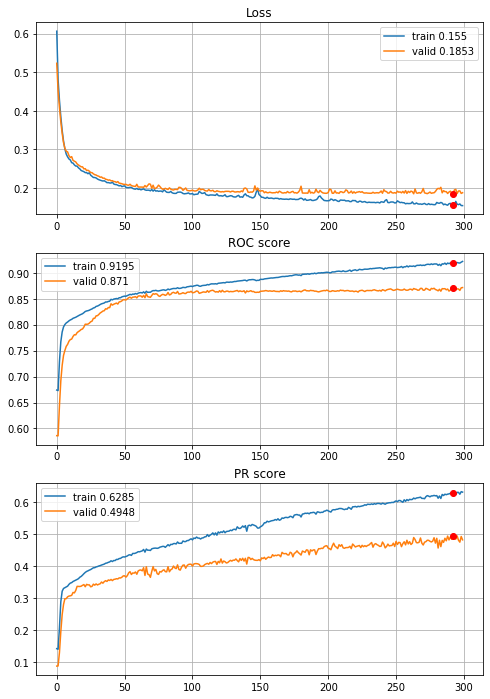


Fold 2------------------------------------------------------------


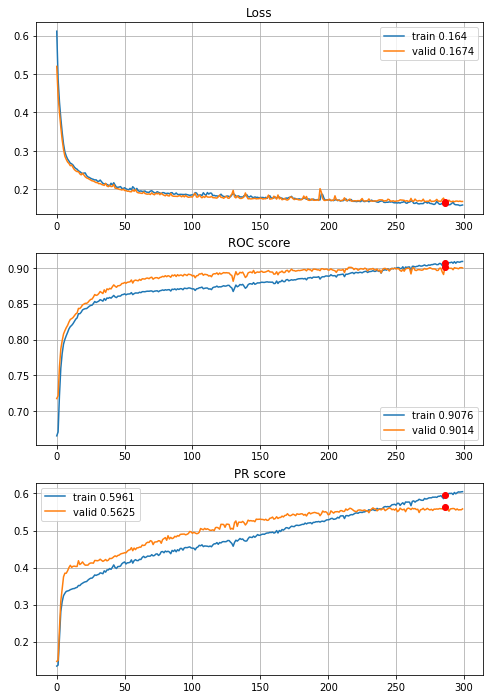


Fold 3------------------------------------------------------------


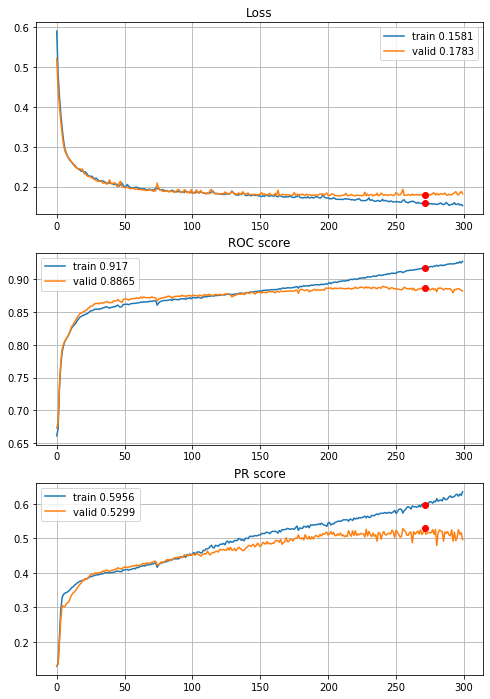


Fold 4------------------------------------------------------------


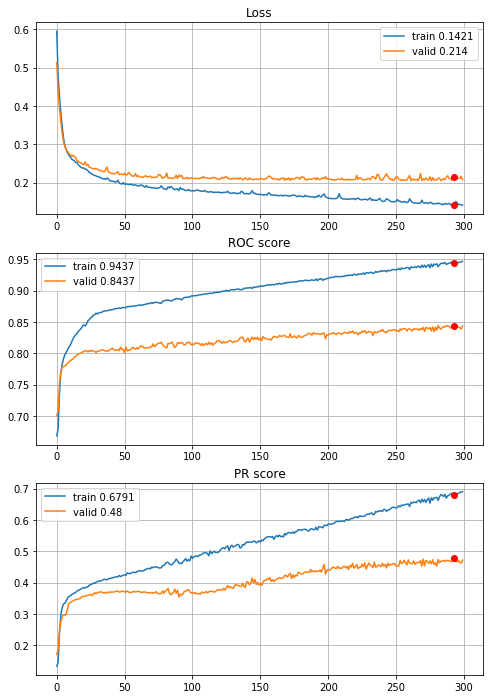


Fold 5------------------------------------------------------------


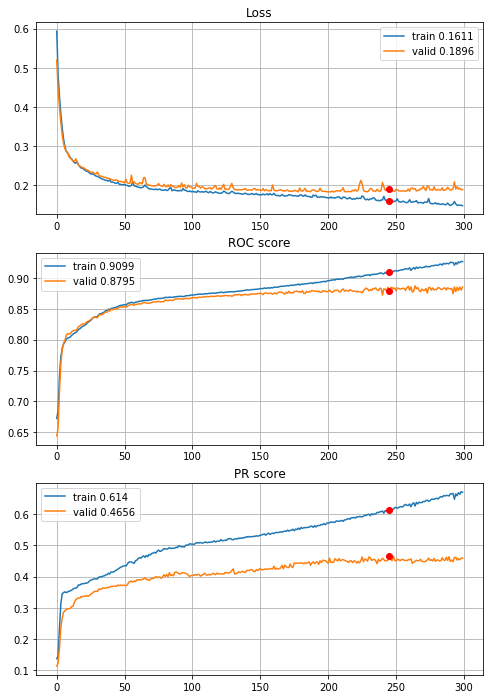


Fold 6------------------------------------------------------------


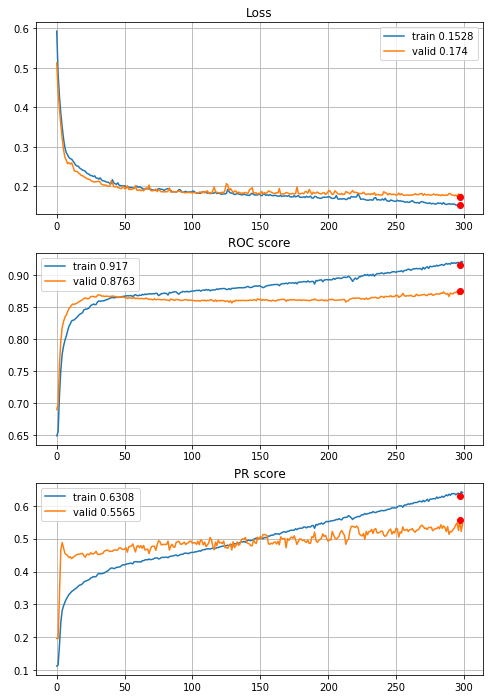

In [58]:
# model with one dense layer
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L1_00005,
                                        features=features, target=target, n_epochs=300, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\5year\define_deep_CNN_3inc_2dense_std_L1_0005_500ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Pretty good results, a bit worse than with no regularization, but there is a potential for more epochs, espacielly for folds: 1st, 4th, 5th, 6th. Lets try 450 epochs.


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/450,
cumulative time: 2.79s train loss: 0.6113245117911793, validation loss: 0.5252390915807231
Epoch: 2/450,
cumulative time: 3.59s train loss: 0.48335938376209797, validation loss: 0.45176597018521425
Epoch: 3/450,
cumulative time: 4.39s train loss: 0.42832685588768243, validation loss: 0.4091010440766744
Epoch: 4/450,
cumulative time: 5.17s train loss: 0.38544867874967065, validation loss: 0.37220041351361366
Epoch: 5/450,
cumulative time: 5.95s train loss: 0.34988766134000426, validation loss: 0.3420802716337976
Epoch: 6/450,
cumulative time: 6.75s train loss: 0.3219170628471925, validation loss: 0.3182488141965705
Epoch: 7/450,
cumulative time: 7.59s train loss: 0.3019000795276479, validation loss: 0.3031660821687812
Epoch: 8/450,
cumulative time: 8.41s train loss: 0.2882385479844434, validation loss: 0.2952365844669041
Epoch: 9/450,
cumulative time: 9.21s train loss: 0.2809157059376636, validat

Epoch: 77/450,
cumulative time: 63.61s train loss: 0.19175080944269574, validation loss: 0.2038148763382717
Epoch: 78/450,
cumulative time: 64.4s train loss: 0.1917230218769949, validation loss: 0.19975644711241244
Epoch: 79/450,
cumulative time: 65.19s train loss: 0.18984698722078483, validation loss: 0.19724960069108036
Epoch: 80/450,
cumulative time: 65.97s train loss: 0.1959180130223182, validation loss: 0.19751257493907193
Epoch: 81/450,
cumulative time: 66.76s train loss: 0.19215300644912658, validation loss: 0.19981912667143842
Epoch: 82/450,
cumulative time: 67.54s train loss: 0.18876648303592033, validation loss: 0.19779974662330266
Epoch: 83/450,
cumulative time: 68.33s train loss: 0.1884482752343485, validation loss: 0.19633232179730964
Epoch: 84/450,
cumulative time: 69.13s train loss: 0.1882611033691611, validation loss: 0.2000015145493199
Epoch: 85/450,
cumulative time: 69.91s train loss: 0.1904239549573901, validation loss: 0.1970387215914022
Epoch: 86/450,
cumulative ti

Epoch: 152/450,
cumulative time: 122.7s train loss: 0.17548218844895544, validation loss: 0.19304467495761837
Epoch: 153/450,
cumulative time: 123.48s train loss: 0.1756497773910042, validation loss: 0.19197315357314693
Epoch: 154/450,
cumulative time: 124.28s train loss: 0.17353067887335047, validation loss: 0.18708887637467905
Epoch: 155/450,
cumulative time: 125.05s train loss: 0.17286336346317607, validation loss: 0.18976741246333118
Epoch: 156/450,
cumulative time: 125.83s train loss: 0.1758742861496789, validation loss: 0.18719686574503158
Epoch: 157/450,
cumulative time: 126.62s train loss: 0.17320917189013657, validation loss: 0.18715602016704327
Epoch: 158/450,
cumulative time: 127.41s train loss: 0.17311237718143402, validation loss: 0.18827340062266676
Epoch: 159/450,
cumulative time: 128.22s train loss: 0.17343264798018476, validation loss: 0.1872723226213939
Epoch: 160/450,
cumulative time: 129.03s train loss: 0.17286894352777124, validation loss: 0.18675133291938528
Epoch

Epoch: 227/450,
cumulative time: 185.67s train loss: 0.16366113807723626, validation loss: 0.18540169456564184
Epoch: 228/450,
cumulative time: 186.7s train loss: 0.16441642909246876, validation loss: 0.18462060376783368
Epoch: 229/450,
cumulative time: 187.5s train loss: 0.16228091791742869, validation loss: 0.18532637527722787
Epoch: 230/450,
cumulative time: 188.47s train loss: 0.16168980955042025, validation loss: 0.1846621674070767
Epoch: 231/450,
cumulative time: 189.41s train loss: 0.1626306474881267, validation loss: 0.18463772029658987
Epoch: 232/450,
cumulative time: 190.23s train loss: 0.16213498101485657, validation loss: 0.18432691068364374
Epoch: 233/450,
cumulative time: 191.05s train loss: 0.1619071622046269, validation loss: 0.18479491612352136
Epoch: 234/450,
cumulative time: 191.88s train loss: 0.16182163047405895, validation loss: 0.18691212006056054
Epoch: 235/450,
cumulative time: 192.7s train loss: 0.16215764124296095, validation loss: 0.18510270730215372
Epoch: 

Epoch: 302/450,
cumulative time: 246.98s train loss: 0.15499467884832557, validation loss: 0.18982259910700688
Epoch: 303/450,
cumulative time: 247.78s train loss: 0.15488123068323742, validation loss: 0.19257189136884661
Epoch: 304/450,
cumulative time: 248.62s train loss: 0.1547211234151833, validation loss: 0.18800236595523667
Epoch: 305/450,
cumulative time: 249.46s train loss: 0.15734461413541748, validation loss: 0.19142344138735176
Epoch: 306/450,
cumulative time: 250.28s train loss: 0.15564593824386488, validation loss: 0.19323007428121944
Epoch: 307/450,
cumulative time: 251.13s train loss: 0.1556941149789934, validation loss: 0.18545915787827472
Epoch: 308/450,
cumulative time: 251.95s train loss: 0.15521840905831177, validation loss: 0.18474118537537274
Epoch: 309/450,
cumulative time: 252.76s train loss: 0.15274443303903948, validation loss: 0.1878811631187914
Epoch: 310/450,
cumulative time: 253.57s train loss: 0.15312992691966815, validation loss: 0.18896229051078722
Epoc

Epoch: 377/450,
cumulative time: 308.47s train loss: 0.143594134437586, validation loss: 0.18860147970706526
Epoch: 378/450,
cumulative time: 309.29s train loss: 0.14516068948600913, validation loss: 0.18583419658621644
Epoch: 379/450,
cumulative time: 310.11s train loss: 0.14638976608520704, validation loss: 0.19382807481382988
Epoch: 380/450,
cumulative time: 310.91s train loss: 0.1487201798693798, validation loss: 0.1897856805645761
Epoch: 381/450,
cumulative time: 311.71s train loss: 0.14543063210706741, validation loss: 0.18559243346080437
Epoch: 382/450,
cumulative time: 312.52s train loss: 0.14539394539441336, validation loss: 0.18760966816171584
Epoch: 383/450,
cumulative time: 313.32s train loss: 0.14287764709510098, validation loss: 0.1906360362098881
Epoch: 384/450,
cumulative time: 314.12s train loss: 0.14247917025501333, validation loss: 0.1902815983656966
Epoch: 385/450,
cumulative time: 314.93s train loss: 0.14314544277891034, validation loss: 0.18873125452468467
Epoch: 

Train on 4432 samples, validate on 887 samples
Epoch: 1/450,
cumulative time: 3.11s train loss: 0.5987032009187804, validation loss: 0.5164845573727416
Epoch: 2/450,
cumulative time: 3.94s train loss: 0.4810289972956, validation loss: 0.44227727007839024
Epoch: 3/450,
cumulative time: 4.71s train loss: 0.42488680953422175, validation loss: 0.39744623769767656
Epoch: 4/450,
cumulative time: 5.52s train loss: 0.3820085995006863, validation loss: 0.35880039368568173
Epoch: 5/450,
cumulative time: 6.33s train loss: 0.3457270387681167, validation loss: 0.32655614490170354
Epoch: 6/450,
cumulative time: 7.14s train loss: 0.31559378318892056, validation loss: 0.3007818381842793
Epoch: 7/450,
cumulative time: 7.96s train loss: 0.29537451318347496, validation loss: 0.2841066570601845
Epoch: 8/450,
cumulative time: 8.78s train loss: 0.2849571402672181, validation loss: 0.2762922980269289
Epoch: 9/450,
cumulative time: 9.57s train loss: 0.27738804220884283, validation loss: 0.2696102459105456
Epo

Epoch: 77/450,
cumulative time: 65.37s train loss: 0.19045892363878147, validation loss: 0.18582202579821916
Epoch: 78/450,
cumulative time: 66.16s train loss: 0.188771300004385, validation loss: 0.18984286216630472
Epoch: 79/450,
cumulative time: 66.93s train loss: 0.19143768724067547, validation loss: 0.18683658607446893
Epoch: 80/450,
cumulative time: 67.72s train loss: 0.1912055661370608, validation loss: 0.18445278677287205
Epoch: 81/450,
cumulative time: 68.5s train loss: 0.18899709491953523, validation loss: 0.1831950186473541
Epoch: 82/450,
cumulative time: 69.27s train loss: 0.18929683220730792, validation loss: 0.1868862915939516
Epoch: 83/450,
cumulative time: 70.06s train loss: 0.1901913750983963, validation loss: 0.18307206563844755
Epoch: 84/450,
cumulative time: 70.84s train loss: 0.1881407708709636, validation loss: 0.18299936987837648
Epoch: 85/450,
cumulative time: 71.61s train loss: 0.19076105943521224, validation loss: 0.18889839377720433
Epoch: 86/450,
cumulative t

Epoch: 152/450,
cumulative time: 124.05s train loss: 0.17825314628518446, validation loss: 0.17616015924676295
Epoch: 153/450,
cumulative time: 124.82s train loss: 0.178466386763574, validation loss: 0.17476161827229325
Epoch: 154/450,
cumulative time: 125.59s train loss: 0.17687502230386443, validation loss: 0.17563614778413847
Epoch: 155/450,
cumulative time: 126.37s train loss: 0.17877962684346235, validation loss: 0.17541448232689463
Epoch: 156/450,
cumulative time: 127.16s train loss: 0.1762380134549651, validation loss: 0.1780083979802309
Epoch: 157/450,
cumulative time: 127.93s train loss: 0.1809599459682346, validation loss: 0.18564117415109913
Epoch: 158/450,
cumulative time: 128.72s train loss: 0.18317261628053463, validation loss: 0.1747174217977814
Epoch: 159/450,
cumulative time: 129.49s train loss: 0.17722573647752995, validation loss: 0.1753598296386951
Epoch: 160/450,
cumulative time: 130.28s train loss: 0.17702059025476125, validation loss: 0.1758114132765584
Epoch: 16

Epoch: 227/450,
cumulative time: 186.07s train loss: 0.16816845133443387, validation loss: 0.1703257324024951
Epoch: 228/450,
cumulative time: 186.93s train loss: 0.16734773131753133, validation loss: 0.1699845682338233
Epoch: 229/450,
cumulative time: 187.76s train loss: 0.1688811365003943, validation loss: 0.17033019845017988
Epoch: 230/450,
cumulative time: 188.62s train loss: 0.1694122171937236, validation loss: 0.17085143849841636
Epoch: 231/450,
cumulative time: 189.43s train loss: 0.16687733867619228, validation loss: 0.17579128824199602
Epoch: 232/450,
cumulative time: 190.23s train loss: 0.1693129747171318, validation loss: 0.1705377278796984
Epoch: 233/450,
cumulative time: 191.06s train loss: 0.1715009403734431, validation loss: 0.17004789435540946
Epoch: 234/450,
cumulative time: 191.84s train loss: 0.16894339075789447, validation loss: 0.16965535721555772
Epoch: 235/450,
cumulative time: 192.64s train loss: 0.16903346732917784, validation loss: 0.17022689508343494
Epoch: 2

Epoch: 302/450,
cumulative time: 248.51s train loss: 0.15690054209223722, validation loss: 0.1693899104331768
Epoch: 303/450,
cumulative time: 249.31s train loss: 0.15784771963012562, validation loss: 0.16845623357588974
Epoch: 304/450,
cumulative time: 250.15s train loss: 0.15813359690473722, validation loss: 0.1720257936194623
Epoch: 305/450,
cumulative time: 250.95s train loss: 0.1567962951084014, validation loss: 0.16962707966666882
Epoch: 306/450,
cumulative time: 251.79s train loss: 0.1575524959450971, validation loss: 0.17116903936177524
Epoch: 307/450,
cumulative time: 252.66s train loss: 0.1583358406253993, validation loss: 0.17102556641233546
Epoch: 308/450,
cumulative time: 253.46s train loss: 0.15939698831618693, validation loss: 0.17598030051760366
Epoch: 309/450,
cumulative time: 254.26s train loss: 0.15919111917528328, validation loss: 0.1747756654978336
Epoch: 310/450,
cumulative time: 255.11s train loss: 0.15998028036180062, validation loss: 0.16977690674339369
Epoch: 

Epoch: 377/450,
cumulative time: 310.69s train loss: 0.14968097499413718, validation loss: 0.16969938134394477
Epoch: 378/450,
cumulative time: 311.51s train loss: 0.14889322376611647, validation loss: 0.17050527709850194
Epoch: 379/450,
cumulative time: 312.33s train loss: 0.1532357885008039, validation loss: 0.17678532983767542
Epoch: 380/450,
cumulative time: 313.16s train loss: 0.1510476634975536, validation loss: 0.17097178333372784
Epoch: 381/450,
cumulative time: 313.98s train loss: 0.15217361507083318, validation loss: 0.17265422151685433
Epoch: 382/450,
cumulative time: 314.78s train loss: 0.15366002195430684, validation loss: 0.1844850886600531
Epoch: 383/450,
cumulative time: 315.6s train loss: 0.15073275088672172, validation loss: 0.17513463791489198
Epoch: 384/450,
cumulative time: 316.46s train loss: 0.1495460940168545, validation loss: 0.17553340785600152
Epoch: 385/450,
cumulative time: 317.27s train loss: 0.14856704768963455, validation loss: 0.17223893813242908
Epoch:

Train on 4432 samples, validate on 887 samples
Epoch: 1/450,
cumulative time: 3.21s train loss: 0.6030419257466113, validation loss: 0.523941034999211
Epoch: 2/450,
cumulative time: 4.04s train loss: 0.48612332720618817, validation loss: 0.4464901503608084
Epoch: 3/450,
cumulative time: 4.86s train loss: 0.4272724754220742, validation loss: 0.40268157813971045
Epoch: 4/450,
cumulative time: 5.71s train loss: 0.38384107984467963, validation loss: 0.3642490703398372
Epoch: 5/450,
cumulative time: 6.53s train loss: 0.34702143405264896, validation loss: 0.33125412390224024
Epoch: 6/450,
cumulative time: 7.37s train loss: 0.31668929227153747, validation loss: 0.30484610228151454
Epoch: 7/450,
cumulative time: 8.19s train loss: 0.2935842631606634, validation loss: 0.28868897459149495
Epoch: 8/450,
cumulative time: 9.0s train loss: 0.2842852666516812, validation loss: 0.28096382412324494
Epoch: 9/450,
cumulative time: 9.8s train loss: 0.2753047560701409, validation loss: 0.27468215730440254
E

Epoch: 77/450,
cumulative time: 63.45s train loss: 0.19298299637350796, validation loss: 0.19352438615838732
Epoch: 78/450,
cumulative time: 64.26s train loss: 0.19263790172628978, validation loss: 0.19506278336720106
Epoch: 79/450,
cumulative time: 65.04s train loss: 0.19419011769527134, validation loss: 0.1900525704748601
Epoch: 80/450,
cumulative time: 65.83s train loss: 0.1914018867571001, validation loss: 0.18965311000688503
Epoch: 81/450,
cumulative time: 66.63s train loss: 0.19149942727698963, validation loss: 0.18973641863603066
Epoch: 82/450,
cumulative time: 67.43s train loss: 0.1914435013631083, validation loss: 0.19071076625565397
Epoch: 83/450,
cumulative time: 68.23s train loss: 0.18962190321744135, validation loss: 0.18886809993489082
Epoch: 84/450,
cumulative time: 69.02s train loss: 0.18896574078847247, validation loss: 0.1877624330351291
Epoch: 85/450,
cumulative time: 69.81s train loss: 0.19003724392221077, validation loss: 0.1907582493685816
Epoch: 86/450,
cumulativ

Epoch: 152/450,
cumulative time: 122.56s train loss: 0.17759667362829515, validation loss: 0.18606322733296884
Epoch: 153/450,
cumulative time: 123.36s train loss: 0.17969434867723968, validation loss: 0.18137450065997165
Epoch: 154/450,
cumulative time: 124.17s train loss: 0.17809250680494396, validation loss: 0.18338494859593832
Epoch: 155/450,
cumulative time: 125.01s train loss: 0.18104696592201716, validation loss: 0.18163874044829587
Epoch: 156/450,
cumulative time: 125.83s train loss: 0.18322326428515817, validation loss: 0.18146223530358097
Epoch: 157/450,
cumulative time: 126.65s train loss: 0.17888295792365977, validation loss: 0.18160145167836744
Epoch: 158/450,
cumulative time: 127.47s train loss: 0.17937552089053155, validation loss: 0.18521820272506964
Epoch: 159/450,
cumulative time: 128.39s train loss: 0.1800568185827362, validation loss: 0.18129036510877705
Epoch: 160/450,
cumulative time: 129.32s train loss: 0.1795759515245092, validation loss: 0.18061685713329337
Epo

Epoch: 227/450,
cumulative time: 185.06s train loss: 0.16712762057337413, validation loss: 0.17899405201970522
Epoch: 228/450,
cumulative time: 185.92s train loss: 0.16685801164822028, validation loss: 0.18714165968112773
Epoch: 229/450,
cumulative time: 186.75s train loss: 0.16738659351566532, validation loss: 0.1776098837107924
Epoch: 230/450,
cumulative time: 187.55s train loss: 0.17001927503811645, validation loss: 0.18151220523047742
Epoch: 231/450,
cumulative time: 188.46s train loss: 0.174153693887785, validation loss: 0.17887543521510707
Epoch: 232/450,
cumulative time: 189.3s train loss: 0.16812187563022768, validation loss: 0.18020431675529264
Epoch: 233/450,
cumulative time: 190.13s train loss: 0.16940768465856998, validation loss: 0.18207640021938618
Epoch: 234/450,
cumulative time: 190.99s train loss: 0.16813010616826451, validation loss: 0.17823550501563235
Epoch: 235/450,
cumulative time: 191.82s train loss: 0.16533469454476118, validation loss: 0.18035371273991221
Epoch

Epoch: 302/450,
cumulative time: 246.93s train loss: 0.15127867910782353, validation loss: 0.18620131834249487
Epoch: 303/450,
cumulative time: 247.77s train loss: 0.15352185576185853, validation loss: 0.18281554836431244
Epoch: 304/450,
cumulative time: 248.64s train loss: 0.15065303648610193, validation loss: 0.18588177401156677
Epoch: 305/450,
cumulative time: 249.56s train loss: 0.15183881022681614, validation loss: 0.1829809472888809
Epoch: 306/450,
cumulative time: 250.7s train loss: 0.15268129724269525, validation loss: 0.18710095355583287
Epoch: 307/450,
cumulative time: 251.56s train loss: 0.15335164462226286, validation loss: 0.18737290814737323
Epoch: 308/450,
cumulative time: 252.37s train loss: 0.15664713757132795, validation loss: 0.18879841180705165
Epoch: 309/450,
cumulative time: 253.18s train loss: 0.1565198032219057, validation loss: 0.18368760297303807
Epoch: 310/450,
cumulative time: 253.97s train loss: 0.15096035471273458, validation loss: 0.18561517994057097
Epoc

Epoch: 377/450,
cumulative time: 307.35s train loss: 0.13190434716762942, validation loss: 0.1928570336896376
Epoch: 378/450,
cumulative time: 308.2s train loss: 0.13354477973231232, validation loss: 0.19300724114076126
Epoch: 379/450,
cumulative time: 309.09s train loss: 0.13430865143597234, validation loss: 0.19564560250606988
Epoch: 380/450,
cumulative time: 309.98s train loss: 0.13177497350755366, validation loss: 0.19683248184310542
Epoch: 381/450,
cumulative time: 311.12s train loss: 0.1319573778652381, validation loss: 0.2003779045758683
Epoch: 382/450,
cumulative time: 312.01s train loss: 0.13233846791478593, validation loss: 0.1943321664142501
Epoch: 383/450,
cumulative time: 312.85s train loss: 0.1320629889979313, validation loss: 0.1921219013152558
Epoch: 384/450,
cumulative time: 313.7s train loss: 0.13299503863960613, validation loss: 0.19857582932058826
Epoch: 385/450,
cumulative time: 314.58s train loss: 0.13297464799754563, validation loss: 0.19798061004687592
Epoch: 38

Train on 4433 samples, validate on 886 samples
Epoch: 1/450,
cumulative time: 3.38s train loss: 0.6079361859735075, validation loss: 0.5161373307150589
Epoch: 2/450,
cumulative time: 4.27s train loss: 0.4857552167042475, validation loss: 0.44164717775973455
Epoch: 3/450,
cumulative time: 5.12s train loss: 0.4290206991413391, validation loss: 0.3981317410888844
Epoch: 4/450,
cumulative time: 5.96s train loss: 0.38426765096986265, validation loss: 0.36029135400500845
Epoch: 5/450,
cumulative time: 6.76s train loss: 0.34928634259223723, validation loss: 0.331016226425666
Epoch: 6/450,
cumulative time: 7.58s train loss: 0.31896298057522593, validation loss: 0.3082269220938801
Epoch: 7/450,
cumulative time: 8.43s train loss: 0.29882615580801875, validation loss: 0.29510315539605464
Epoch: 8/450,
cumulative time: 9.3s train loss: 0.28833788133840005, validation loss: 0.2870156636491048
Epoch: 9/450,
cumulative time: 10.18s train loss: 0.27872518440441707, validation loss: 0.2828917329790361


Epoch: 77/450,
cumulative time: 64.77s train loss: 0.18574854385501882, validation loss: 0.21882415732734628
Epoch: 78/450,
cumulative time: 65.56s train loss: 0.19093990862914087, validation loss: 0.21475147074151524
Epoch: 79/450,
cumulative time: 66.4s train loss: 0.1854904650290556, validation loss: 0.20859183505614778
Epoch: 80/450,
cumulative time: 67.24s train loss: 0.182564069045308, validation loss: 0.21192852486740654
Epoch: 81/450,
cumulative time: 68.06s train loss: 0.18186804550363117, validation loss: 0.21270526824498015
Epoch: 82/450,
cumulative time: 68.87s train loss: 0.18122548452489617, validation loss: 0.2232171293709671
Epoch: 83/450,
cumulative time: 69.68s train loss: 0.18777981040482056, validation loss: 0.20909250438482443
Epoch: 84/450,
cumulative time: 70.5s train loss: 0.18538640243203597, validation loss: 0.20920388535102388
Epoch: 85/450,
cumulative time: 71.34s train loss: 0.18898868289188528, validation loss: 0.20978263023879135
Epoch: 86/450,
cumulative

Epoch: 152/450,
cumulative time: 125.81s train loss: 0.16978791690883857, validation loss: 0.20809331997119007
Epoch: 153/450,
cumulative time: 126.58s train loss: 0.16867242746782873, validation loss: 0.20747235773917513
Epoch: 154/450,
cumulative time: 127.36s train loss: 0.1694044284530937, validation loss: 0.20727892287294158
Epoch: 155/450,
cumulative time: 128.13s train loss: 0.1693033959952698, validation loss: 0.2075981445963711
Epoch: 156/450,
cumulative time: 128.92s train loss: 0.16812510675160955, validation loss: 0.21225072073479
Epoch: 157/450,
cumulative time: 129.69s train loss: 0.17389729111284158, validation loss: 0.21574385588648087
Epoch: 158/450,
cumulative time: 130.49s train loss: 0.17278881389677134, validation loss: 0.21575633135390873
Epoch: 159/450,
cumulative time: 131.3s train loss: 0.16811198653632675, validation loss: 0.21123758960792766
Epoch: 160/450,
cumulative time: 132.06s train loss: 0.16871506822128046, validation loss: 0.20676051645327367
Epoch: 1

Epoch: 227/450,
cumulative time: 184.88s train loss: 0.15793992382340416, validation loss: 0.20497198954527318
Epoch: 228/450,
cumulative time: 185.67s train loss: 0.1596494466200817, validation loss: 0.20624738719743207
Epoch: 229/450,
cumulative time: 186.5s train loss: 0.15858948000150208, validation loss: 0.20517726461182328
Epoch: 230/450,
cumulative time: 187.29s train loss: 0.15651957964671268, validation loss: 0.20811558788974452
Epoch: 231/450,
cumulative time: 188.11s train loss: 0.16052532562775507, validation loss: 0.20856664634181468
Epoch: 232/450,
cumulative time: 188.9s train loss: 0.16238407055518977, validation loss: 0.2050817532813845
Epoch: 233/450,
cumulative time: 189.7s train loss: 0.15598869581887287, validation loss: 0.2093958544206404
Epoch: 234/450,
cumulative time: 190.49s train loss: 0.15801751387057444, validation loss: 0.21237803803878766
Epoch: 235/450,
cumulative time: 191.3s train loss: 0.15562944303119852, validation loss: 0.2098409598083582
Epoch: 23

Epoch: 302/450,
cumulative time: 245.2s train loss: 0.15044355205225132, validation loss: 0.2176910775375151
Epoch: 303/450,
cumulative time: 246.03s train loss: 0.14544889540280226, validation loss: 0.20670645890870967
Epoch: 304/450,
cumulative time: 246.84s train loss: 0.14450326858740908, validation loss: 0.2151051989460099
Epoch: 305/450,
cumulative time: 247.65s train loss: 0.1444437089284763, validation loss: 0.2053417365316882
Epoch: 306/450,
cumulative time: 248.47s train loss: 0.14258737900094148, validation loss: 0.20616592779654683
Epoch: 307/450,
cumulative time: 249.26s train loss: 0.14186841197700123, validation loss: 0.21344126320315807
Epoch: 308/450,
cumulative time: 250.04s train loss: 0.14618455915601103, validation loss: 0.22026409117954848
Epoch: 309/450,
cumulative time: 250.83s train loss: 0.1497260621223013, validation loss: 0.2136238018223179
Epoch: 310/450,
cumulative time: 251.63s train loss: 0.1439808393416167, validation loss: 0.21323132107946727
Epoch: 31

Epoch: 377/450,
cumulative time: 305.63s train loss: 0.12714262832247752, validation loss: 0.22368697566453274
Epoch: 378/450,
cumulative time: 306.44s train loss: 0.13363060768640744, validation loss: 0.23022998226953684
Epoch: 379/450,
cumulative time: 307.26s train loss: 0.12832840845516566, validation loss: 0.21235944122143308
Epoch: 380/450,
cumulative time: 308.04s train loss: 0.12559311951750318, validation loss: 0.21790770486703576
Epoch: 381/450,
cumulative time: 308.87s train loss: 0.12512404844921168, validation loss: 0.21293523487199778
Epoch: 382/450,
cumulative time: 309.66s train loss: 0.1246331693432736, validation loss: 0.21724517946184085
Epoch: 383/450,
cumulative time: 310.5s train loss: 0.12544659781800202, validation loss: 0.2130684701906639
Epoch: 384/450,
cumulative time: 311.32s train loss: 0.12696065896390496, validation loss: 0.22334235058950247
Epoch: 385/450,
cumulative time: 312.12s train loss: 0.12728659164420159, validation loss: 0.22068300557324902
Epoc

Train on 4433 samples, validate on 886 samples
Epoch: 1/450,
cumulative time: 3.35s train loss: 0.5934354101135207, validation loss: 0.5201339348309735
Epoch: 2/450,
cumulative time: 4.13s train loss: 0.48280520423550977, validation loss: 0.44355229350567943
Epoch: 3/450,
cumulative time: 4.93s train loss: 0.42621253115206303, validation loss: 0.39960570105311566
Epoch: 4/450,
cumulative time: 5.71s train loss: 0.38366149373633207, validation loss: 0.3608888516845875
Epoch: 5/450,
cumulative time: 6.49s train loss: 0.3471976896723156, validation loss: 0.32897928027482387
Epoch: 6/450,
cumulative time: 7.26s train loss: 0.3187313416849645, validation loss: 0.30750255229510787
Epoch: 7/450,
cumulative time: 8.05s train loss: 0.29966974370694177, validation loss: 0.29374463328120404
Epoch: 8/450,
cumulative time: 8.82s train loss: 0.28685933985479956, validation loss: 0.28637597852851143
Epoch: 9/450,
cumulative time: 9.58s train loss: 0.28235815399230374, validation loss: 0.2844710227598

Epoch: 77/450,
cumulative time: 63.46s train loss: 0.19014516899716416, validation loss: 0.1991643815829038
Epoch: 78/450,
cumulative time: 64.23s train loss: 0.18818262172705322, validation loss: 0.19843375625648024
Epoch: 79/450,
cumulative time: 64.99s train loss: 0.1879284090330766, validation loss: 0.1969849528160375
Epoch: 80/450,
cumulative time: 65.79s train loss: 0.1882725684369307, validation loss: 0.20008514676890576
Epoch: 81/450,
cumulative time: 66.59s train loss: 0.18938418284996406, validation loss: 0.19735078846627918
Epoch: 82/450,
cumulative time: 67.42s train loss: 0.18743844817380134, validation loss: 0.19675261754349177
Epoch: 83/450,
cumulative time: 68.23s train loss: 0.18769119862116623, validation loss: 0.19961941178307846
Epoch: 84/450,
cumulative time: 69.05s train loss: 0.19097878768646823, validation loss: 0.19554160676610657
Epoch: 85/450,
cumulative time: 69.86s train loss: 0.19362785406839275, validation loss: 0.20029450764639922
Epoch: 86/450,
cumulati

Epoch: 152/450,
cumulative time: 123.75s train loss: 0.17510053862332492, validation loss: 0.18693628062916662
Epoch: 153/450,
cumulative time: 124.56s train loss: 0.17730827391914017, validation loss: 0.1931814682537492
Epoch: 154/450,
cumulative time: 125.33s train loss: 0.17539071286474908, validation loss: 0.18637094298550022
Epoch: 155/450,
cumulative time: 126.16s train loss: 0.1761032827593472, validation loss: 0.18978660562103006
Epoch: 156/450,
cumulative time: 126.93s train loss: 0.1776411040235851, validation loss: 0.18815840555367566
Epoch: 157/450,
cumulative time: 127.72s train loss: 0.17459305210936937, validation loss: 0.18638099343190076
Epoch: 158/450,
cumulative time: 128.51s train loss: 0.17805524839488748, validation loss: 0.1870534862339093
Epoch: 159/450,
cumulative time: 129.34s train loss: 0.1749959188781741, validation loss: 0.1864234250434096
Epoch: 160/450,
cumulative time: 130.14s train loss: 0.17532010981844587, validation loss: 0.2025049009925894
Epoch: 1

Epoch: 227/450,
cumulative time: 185.31s train loss: 0.16803936479781675, validation loss: 0.18667428269477784
Epoch: 228/450,
cumulative time: 186.12s train loss: 0.16302776089605778, validation loss: 0.18609600724404338
Epoch: 229/450,
cumulative time: 186.94s train loss: 0.1607149523024685, validation loss: 0.18575171564556406
Epoch: 230/450,
cumulative time: 187.8s train loss: 0.1625698002182601, validation loss: 0.1858381033616464
Epoch: 231/450,
cumulative time: 188.58s train loss: 0.1601741577738326, validation loss: 0.1876028249414457
Epoch: 232/450,
cumulative time: 189.36s train loss: 0.16254387111036445, validation loss: 0.19234699475038672
Epoch: 233/450,
cumulative time: 190.13s train loss: 0.16288010821422066, validation loss: 0.19166363462906658
Epoch: 234/450,
cumulative time: 190.89s train loss: 0.16434478982627568, validation loss: 0.1871343696359587
Epoch: 235/450,
cumulative time: 191.7s train loss: 0.1652491719821439, validation loss: 0.18731904524309104
Epoch: 236

Epoch: 302/450,
cumulative time: 246.99s train loss: 0.14294816656956252, validation loss: 0.1918520835600373
Epoch: 303/450,
cumulative time: 247.78s train loss: 0.1448000673076086, validation loss: 0.20064857097565456
Epoch: 304/450,
cumulative time: 248.58s train loss: 0.15078990947990473, validation loss: 0.19049385997296456
Epoch: 305/450,
cumulative time: 249.35s train loss: 0.14622058689143838, validation loss: 0.19146728434896362
Epoch: 306/450,
cumulative time: 250.14s train loss: 0.14289454583010555, validation loss: 0.19902335023234174
Epoch: 307/450,
cumulative time: 250.94s train loss: 0.14422175060968595, validation loss: 0.19162878037575407
Epoch: 308/450,
cumulative time: 251.73s train loss: 0.14424890520447348, validation loss: 0.19306705400986812
Epoch: 309/450,
cumulative time: 252.51s train loss: 0.14325851559329728, validation loss: 0.19690798599752293
Epoch: 310/450,
cumulative time: 253.29s train loss: 0.14475281094552808, validation loss: 0.19265981711464059
Epo

Epoch: 377/450,
cumulative time: 306.34s train loss: 0.13323545783670768, validation loss: 0.20027636687857842
Epoch: 378/450,
cumulative time: 307.12s train loss: 0.13059557268104838, validation loss: 0.2016042775682617
Epoch: 379/450,
cumulative time: 307.92s train loss: 0.1285807851196922, validation loss: 0.20019315395075366
Epoch: 380/450,
cumulative time: 308.71s train loss: 0.12947922495937284, validation loss: 0.20301993594885412
Epoch: 381/450,
cumulative time: 309.51s train loss: 0.1300211197150606, validation loss: 0.20300708058590813
Epoch: 382/450,
cumulative time: 310.28s train loss: 0.13552820773620033, validation loss: 0.20858806432235322
Epoch: 383/450,
cumulative time: 311.08s train loss: 0.13124868134572387, validation loss: 0.20792159565953583
Epoch: 384/450,
cumulative time: 311.85s train loss: 0.12911392318934856, validation loss: 0.20567703956809594
Epoch: 385/450,
cumulative time: 312.67s train loss: 0.12833111226800709, validation loss: 0.20425240988117846
Epoc

Train on 4433 samples, validate on 886 samples
Epoch: 1/450,
cumulative time: 3.16s train loss: 0.5927629536843424, validation loss: 0.5124051515727764
Epoch: 2/450,
cumulative time: 3.95s train loss: 0.4851321084905956, validation loss: 0.4404306705057217
Epoch: 3/450,
cumulative time: 4.76s train loss: 0.426954273200858, validation loss: 0.3950208461849738
Epoch: 4/450,
cumulative time: 5.58s train loss: 0.38520232780157726, validation loss: 0.3557600294225103
Epoch: 5/450,
cumulative time: 6.41s train loss: 0.3500019494967673, validation loss: 0.32275495848052926
Epoch: 6/450,
cumulative time: 7.26s train loss: 0.32082033068607224, validation loss: 0.29332379771409134
Epoch: 7/450,
cumulative time: 8.04s train loss: 0.2986084226692823, validation loss: 0.2738999326126839
Epoch: 8/450,
cumulative time: 8.81s train loss: 0.28594815107841887, validation loss: 0.26673051509711865
Epoch: 9/450,
cumulative time: 9.61s train loss: 0.2795393540833407, validation loss: 0.25768078564252056
Ep

Epoch: 77/450,
cumulative time: 64.02s train loss: 0.1936764177678671, validation loss: 0.18898233192768915
Epoch: 78/450,
cumulative time: 64.82s train loss: 0.19295010222435105, validation loss: 0.1863494672503482
Epoch: 79/450,
cumulative time: 65.64s train loss: 0.19257506170513236, validation loss: 0.1864218457557816
Epoch: 80/450,
cumulative time: 66.47s train loss: 0.189880515389294, validation loss: 0.18575118357656234
Epoch: 81/450,
cumulative time: 67.29s train loss: 0.1922771284294107, validation loss: 0.1867408328616054
Epoch: 82/450,
cumulative time: 68.12s train loss: 0.19346690027998287, validation loss: 0.18593562961162885
Epoch: 83/450,
cumulative time: 68.94s train loss: 0.1945245401761937, validation loss: 0.1879000485481581
Epoch: 84/450,
cumulative time: 69.76s train loss: 0.19214303481936482, validation loss: 0.19685879901354253
Epoch: 85/450,
cumulative time: 70.58s train loss: 0.1895783081627204, validation loss: 0.1858444717075701
Epoch: 86/450,
cumulative time

Epoch: 152/450,
cumulative time: 124.69s train loss: 0.17635188585354408, validation loss: 0.18733681550009795
Epoch: 153/450,
cumulative time: 125.52s train loss: 0.1796956051493132, validation loss: 0.18119741407796977
Epoch: 154/450,
cumulative time: 126.32s train loss: 0.1811905448801249, validation loss: 0.1842868690700617
Epoch: 155/450,
cumulative time: 127.13s train loss: 0.17747015918643055, validation loss: 0.1824706615228416
Epoch: 156/450,
cumulative time: 127.99s train loss: 0.17850998403349447, validation loss: 0.18361992626104076
Epoch: 157/450,
cumulative time: 128.78s train loss: 0.17700191529561402, validation loss: 0.1892228512005128
Epoch: 158/450,
cumulative time: 129.57s train loss: 0.17956979413105675, validation loss: 0.18780368768334657
Epoch: 159/450,
cumulative time: 130.42s train loss: 0.17739301184459114, validation loss: 0.18585765560243792
Epoch: 160/450,
cumulative time: 131.2s train loss: 0.1767708311433478, validation loss: 0.183534600597472
Epoch: 161

Epoch: 227/450,
cumulative time: 185.77s train loss: 0.16804703491255255, validation loss: 0.18580028663639558
Epoch: 228/450,
cumulative time: 186.57s train loss: 0.16684607932200798, validation loss: 0.18133586429849974
Epoch: 229/450,
cumulative time: 187.38s train loss: 0.1655818465336596, validation loss: 0.1794722458646206
Epoch: 230/450,
cumulative time: 188.18s train loss: 0.1652203211088146, validation loss: 0.1806780659923704
Epoch: 231/450,
cumulative time: 188.97s train loss: 0.1652124088745797, validation loss: 0.18105518891902864
Epoch: 232/450,
cumulative time: 189.8s train loss: 0.16636941580451856, validation loss: 0.17929264311058526
Epoch: 233/450,
cumulative time: 190.57s train loss: 0.1654864249025326, validation loss: 0.18176944631217026
Epoch: 234/450,
cumulative time: 191.34s train loss: 0.16518889400354228, validation loss: 0.18012241739989943
Epoch: 235/450,
cumulative time: 192.2s train loss: 0.17088566337284158, validation loss: 0.18430548936599533
Epoch: 23

Epoch: 302/450,
cumulative time: 248.62s train loss: 0.15396508988612342, validation loss: 0.1772053742247295
Epoch: 303/450,
cumulative time: 249.48s train loss: 0.15310678401986713, validation loss: 0.17761487219457434
Epoch: 304/450,
cumulative time: 250.27s train loss: 0.1543686888320382, validation loss: 0.18787350574546152
Epoch: 305/450,
cumulative time: 251.07s train loss: 0.15226173983412458, validation loss: 0.1790119711620813
Epoch: 306/450,
cumulative time: 251.88s train loss: 0.15144102239404392, validation loss: 0.17747301216453784
Epoch: 307/450,
cumulative time: 252.66s train loss: 0.15286663121518823, validation loss: 0.18300698727840226
Epoch: 308/450,
cumulative time: 253.48s train loss: 0.15503285251290594, validation loss: 0.18162808767425287
Epoch: 309/450,
cumulative time: 254.25s train loss: 0.15130272605988987, validation loss: 0.17397159317815278
Epoch: 310/450,
cumulative time: 255.06s train loss: 0.15162281971697933, validation loss: 0.18111238906130564
Epoc

Epoch: 377/450,
cumulative time: 308.94s train loss: 0.13938238665868272, validation loss: 0.1797499626740376
Epoch: 378/450,
cumulative time: 309.76s train loss: 0.13847770710145274, validation loss: 0.17563817005932467
Epoch: 379/450,
cumulative time: 310.55s train loss: 0.14020654603001928, validation loss: 0.17513062154062714
Epoch: 380/450,
cumulative time: 311.35s train loss: 0.14414130810109535, validation loss: 0.1808636642942041
Epoch: 381/450,
cumulative time: 312.17s train loss: 0.1388617827530346, validation loss: 0.17413029730589072
Epoch: 382/450,
cumulative time: 313.03s train loss: 0.14086471530618286, validation loss: 0.17985801180114058
Epoch: 383/450,
cumulative time: 313.88s train loss: 0.13860110136851106, validation loss: 0.176979515003566
Epoch: 384/450,
cumulative time: 314.69s train loss: 0.13790970137849123, validation loss: 0.17849172978045977
Epoch: 385/450,
cumulative time: 315.49s train loss: 0.1397159302650457, validation loss: 0.18014773427094616
Epoch: 

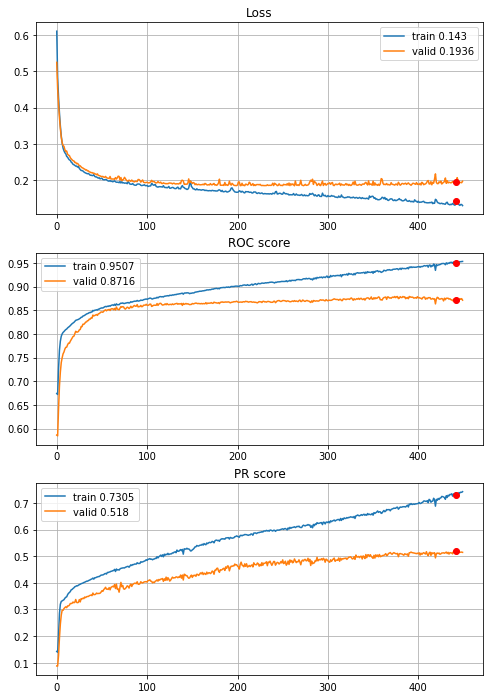


Fold 2------------------------------------------------------------


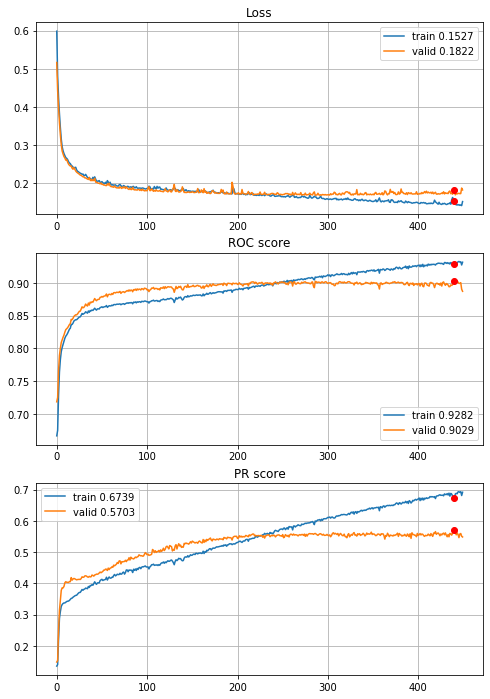


Fold 3------------------------------------------------------------


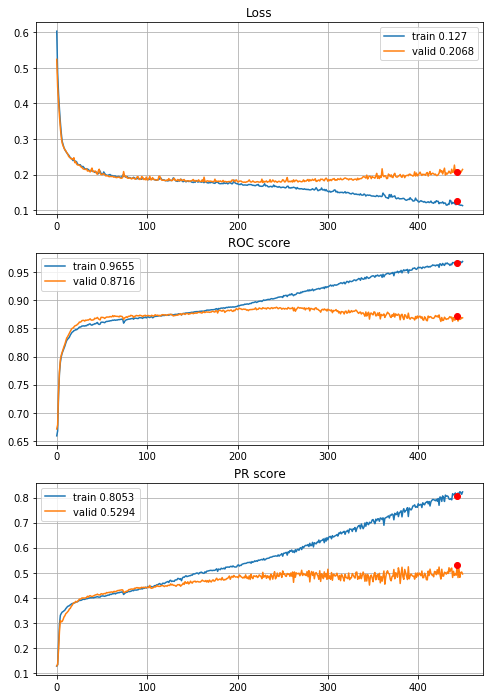


Fold 4------------------------------------------------------------


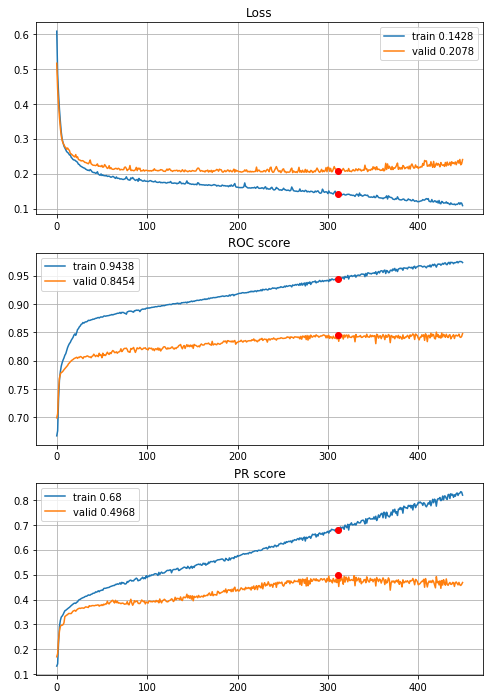


Fold 5------------------------------------------------------------


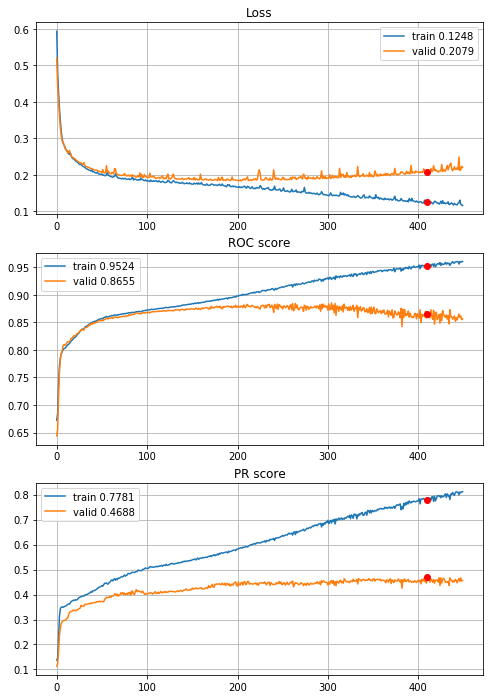


Fold 6------------------------------------------------------------


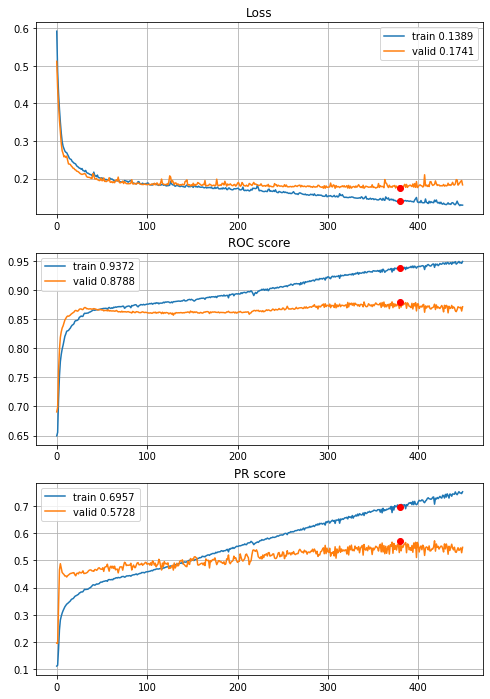

In [59]:
# model with one dense layer, 450 epochs
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L1_00005,
                                        features=features, target=target, n_epochs=450, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\5year\define_deep_CNN_3inc_2dense_std_L1_0005_500ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Lets try lower regularization coef

In [59]:
def define_deep_CNN_2inc_std_L1_000025(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.000025))(flat)                          # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/450,
cumulative time: 2.87s train loss: 0.4760025075438436, validation loss: 0.4041535765974202
Epoch: 2/450,
cumulative time: 3.68s train loss: 0.37259876584156754, validation loss: 0.35356159231036466
Epoch: 3/450,
cumulative time: 4.5s train loss: 0.3389638391077949, validation loss: 0.33072161997050015
Epoch: 4/450,
cumulative time: 5.4s train loss: 0.3142901339201721, validation loss: 0.30979941125114985
Epoch: 5/450,
cumulative time: 6.28s train loss: 0.29316103543803795, validation loss: 0.29277655919079315
Epoch: 6/450,
cumulative time: 7.15s train loss: 0.2763779642336097, validation loss: 0.27752862889172664
Epoch: 7/450,
cumulative time: 7.96s train loss: 0.26327481173274747, validation loss: 0.2679461099652588
Epoch: 8/450,
cumulative time: 8.86s train loss: 0.254008031393055, validation loss: 0.2634475964301065
Epoch: 9/450,
cumulative time: 9.69s train loss: 0.2497712413676164, validati

Epoch: 77/450,
cumulative time: 65.35s train loss: 0.18956126702364387, validation loss: 0.20212272206046267
Epoch: 78/450,
cumulative time: 66.15s train loss: 0.18966757557909628, validation loss: 0.19716419622285256
Epoch: 79/450,
cumulative time: 66.95s train loss: 0.187509804110073, validation loss: 0.19417355932807706
Epoch: 80/450,
cumulative time: 67.81s train loss: 0.19466452275668455, validation loss: 0.1940632123151519
Epoch: 81/450,
cumulative time: 68.65s train loss: 0.1900903918521499, validation loss: 0.19686198360554394
Epoch: 82/450,
cumulative time: 69.45s train loss: 0.18592744564724958, validation loss: 0.1945493198435632
Epoch: 83/450,
cumulative time: 70.29s train loss: 0.18555686321607134, validation loss: 0.1928916935553814
Epoch: 84/450,
cumulative time: 71.1s train loss: 0.18515222919062588, validation loss: 0.19620685153373066
Epoch: 85/450,
cumulative time: 71.9s train loss: 0.1870691272621766, validation loss: 0.1932781499294982
Epoch: 86/450,
cumulative tim

Epoch: 152/450,
cumulative time: 126.56s train loss: 0.16782011508618883, validation loss: 0.18445586212390977
Epoch: 153/450,
cumulative time: 127.38s train loss: 0.16843243767019858, validation loss: 0.18614270631328914
Epoch: 154/450,
cumulative time: 128.2s train loss: 0.1667390362315875, validation loss: 0.18252883241706125
Epoch: 155/450,
cumulative time: 129.02s train loss: 0.16689923313859892, validation loss: 0.1851861802136616
Epoch: 156/450,
cumulative time: 129.81s train loss: 0.16882274752072587, validation loss: 0.18401946567561742
Epoch: 157/450,
cumulative time: 130.62s train loss: 0.16615739349773428, validation loss: 0.18401923530400136
Epoch: 158/450,
cumulative time: 131.44s train loss: 0.166099915354906, validation loss: 0.18491378512229295
Epoch: 159/450,
cumulative time: 132.24s train loss: 0.166993905211856, validation loss: 0.184026289769063
Epoch: 160/450,
cumulative time: 133.08s train loss: 0.16547279664406062, validation loss: 0.1834524840519689
Epoch: 161/

Epoch: 227/450,
cumulative time: 188.22s train loss: 0.15225054308879676, validation loss: 0.18705148862206547
Epoch: 228/450,
cumulative time: 189.03s train loss: 0.15335118779004803, validation loss: 0.18493582929874083
Epoch: 229/450,
cumulative time: 189.86s train loss: 0.15083722266223995, validation loss: 0.18769299046565877
Epoch: 230/450,
cumulative time: 190.7s train loss: 0.1509495778648109, validation loss: 0.18617233652474513
Epoch: 231/450,
cumulative time: 191.54s train loss: 0.15102388499311376, validation loss: 0.18657442268819927
Epoch: 232/450,
cumulative time: 192.34s train loss: 0.15090839019455418, validation loss: 0.18526977520717441
Epoch: 233/450,
cumulative time: 193.18s train loss: 0.1496675957989499, validation loss: 0.18683472898995593
Epoch: 234/450,
cumulative time: 193.98s train loss: 0.15122396438399377, validation loss: 0.18716814198448262
Epoch: 235/450,
cumulative time: 194.78s train loss: 0.15033853687816687, validation loss: 0.1848626762057372
Epoch

Epoch: 302/450,
cumulative time: 248.68s train loss: 0.13451662440767465, validation loss: 0.1901339412474713
Epoch: 303/450,
cumulative time: 249.46s train loss: 0.13720483216204907, validation loss: 0.20835359680141913
Epoch: 304/450,
cumulative time: 250.24s train loss: 0.13495906088702944, validation loss: 0.1948026034481227
Epoch: 305/450,
cumulative time: 251.02s train loss: 0.13507431545143522, validation loss: 0.19895323939629847
Epoch: 306/450,
cumulative time: 251.79s train loss: 0.13122945651075793, validation loss: 0.19462106915310512
Epoch: 307/450,
cumulative time: 252.6s train loss: 0.13267453575997684, validation loss: 0.2010334750811707
Epoch: 308/450,
cumulative time: 253.41s train loss: 0.1408316277451679, validation loss: 0.18678408795642207
Epoch: 309/450,
cumulative time: 254.21s train loss: 0.1322171298504575, validation loss: 0.20203613305911675
Epoch: 310/450,
cumulative time: 255.02s train loss: 0.13245642982046743, validation loss: 0.20295844276634117
Epoch: 

Epoch: 377/450,
cumulative time: 307.79s train loss: 0.11028140917124515, validation loss: 0.19880427393260106
Epoch: 378/450,
cumulative time: 308.56s train loss: 0.11231511433202007, validation loss: 0.20118805163003411
Epoch: 379/450,
cumulative time: 309.34s train loss: 0.1133782395366781, validation loss: 0.20539685317736198
Epoch: 380/450,
cumulative time: 310.11s train loss: 0.11067411259811923, validation loss: 0.20127600063533094
Epoch: 381/450,
cumulative time: 310.87s train loss: 0.11018974693754305, validation loss: 0.20467387826896977
Epoch: 382/450,
cumulative time: 311.65s train loss: 0.11024643494226442, validation loss: 0.2086638217075836
Epoch: 383/450,
cumulative time: 312.42s train loss: 0.11135658982213223, validation loss: 0.20778685630107008
Epoch: 384/450,
cumulative time: 313.17s train loss: 0.11049026790132162, validation loss: 0.20365654231125768
Epoch: 385/450,
cumulative time: 313.94s train loss: 0.10817347570836867, validation loss: 0.21054573335265897
Epo

Train on 4432 samples, validate on 887 samples
Epoch: 1/450,
cumulative time: 3.36s train loss: 0.4644960272344441, validation loss: 0.3968865391635572
Epoch: 2/450,
cumulative time: 4.19s train loss: 0.3710814914682927, validation loss: 0.3445707628127553
Epoch: 3/450,
cumulative time: 5.03s train loss: 0.33566168181947853, validation loss: 0.3190141238582981
Epoch: 4/450,
cumulative time: 5.85s train loss: 0.31051012374702774, validation loss: 0.2957831265692512
Epoch: 5/450,
cumulative time: 6.68s train loss: 0.28826619716300644, validation loss: 0.275753143775826
Epoch: 6/450,
cumulative time: 7.52s train loss: 0.26912680080678275, validation loss: 0.25883289677717775
Epoch: 7/450,
cumulative time: 8.35s train loss: 0.2570005971602154, validation loss: 0.2485143469211886
Epoch: 8/450,
cumulative time: 9.16s train loss: 0.25124902968103274, validation loss: 0.2438990555056859
Epoch: 9/450,
cumulative time: 10.0s train loss: 0.24647894432425282, validation loss: 0.24003378648768686
E

Epoch: 77/450,
cumulative time: 64.42s train loss: 0.18820653183701774, validation loss: 0.18419032356583145
Epoch: 78/450,
cumulative time: 65.19s train loss: 0.1870831180471483, validation loss: 0.18763209041103032
Epoch: 79/450,
cumulative time: 66.0s train loss: 0.1892522242767501, validation loss: 0.1843849863718435
Epoch: 80/450,
cumulative time: 66.86s train loss: 0.18855518410621136, validation loss: 0.18297650049342915
Epoch: 81/450,
cumulative time: 67.7s train loss: 0.18691259519691286, validation loss: 0.1817082478302576
Epoch: 82/450,
cumulative time: 68.52s train loss: 0.18731376103424746, validation loss: 0.18537475770127276
Epoch: 83/450,
cumulative time: 69.38s train loss: 0.18811130752309566, validation loss: 0.18130966204532506
Epoch: 84/450,
cumulative time: 70.23s train loss: 0.18620315469492105, validation loss: 0.1816359024406689
Epoch: 85/450,
cumulative time: 71.07s train loss: 0.18871890960617616, validation loss: 0.18699788938044426
Epoch: 86/450,
cumulative 

Epoch: 152/450,
cumulative time: 126.76s train loss: 0.17397579494930993, validation loss: 0.17268490799720554
Epoch: 153/450,
cumulative time: 127.61s train loss: 0.17361442633780116, validation loss: 0.17200385840460575
Epoch: 154/450,
cumulative time: 128.43s train loss: 0.172443806136612, validation loss: 0.17334805753212232
Epoch: 155/450,
cumulative time: 129.26s train loss: 0.17516871381698962, validation loss: 0.17270777074634827
Epoch: 156/450,
cumulative time: 130.08s train loss: 0.17243666536702576, validation loss: 0.1752670930935807
Epoch: 157/450,
cumulative time: 130.94s train loss: 0.17676796585267632, validation loss: 0.1806064787853127
Epoch: 158/450,
cumulative time: 131.77s train loss: 0.17766933819608569, validation loss: 0.17118672791368664
Epoch: 159/450,
cumulative time: 132.61s train loss: 0.17294731656835827, validation loss: 0.17157755355353824
Epoch: 160/450,
cumulative time: 133.43s train loss: 0.17236654227767612, validation loss: 0.17148756601227177
Epoch

Epoch: 227/450,
cumulative time: 189.13s train loss: 0.16101402194249287, validation loss: 0.16717158906422178
Epoch: 228/450,
cumulative time: 189.98s train loss: 0.16082362393556088, validation loss: 0.16612390180988806
Epoch: 229/450,
cumulative time: 190.85s train loss: 0.1626715257810933, validation loss: 0.16636582696652868
Epoch: 230/450,
cumulative time: 191.68s train loss: 0.16386690710264423, validation loss: 0.16724768296102527
Epoch: 231/450,
cumulative time: 192.57s train loss: 0.16033706423365898, validation loss: 0.1741845066477508
Epoch: 232/450,
cumulative time: 193.46s train loss: 0.1634861441927589, validation loss: 0.1664925404942963
Epoch: 233/450,
cumulative time: 194.34s train loss: 0.16580179442957527, validation loss: 0.16602411044692242
Epoch: 234/450,
cumulative time: 195.24s train loss: 0.162193835534774, validation loss: 0.16571293450396385
Epoch: 235/450,
cumulative time: 196.06s train loss: 0.162378525653928, validation loss: 0.1662318896178866
Epoch: 236

Epoch: 302/450,
cumulative time: 250.61s train loss: 0.14817167285305283, validation loss: 0.16396574869231145
Epoch: 303/450,
cumulative time: 251.41s train loss: 0.14963972363419267, validation loss: 0.16341506981258327
Epoch: 304/450,
cumulative time: 252.21s train loss: 0.15066304475418713, validation loss: 0.16867244260421332
Epoch: 305/450,
cumulative time: 253.01s train loss: 0.14874369148097744, validation loss: 0.1645948096622609
Epoch: 306/450,
cumulative time: 253.82s train loss: 0.1483350955050721, validation loss: 0.16485057210102425
Epoch: 307/450,
cumulative time: 254.61s train loss: 0.14925286771279056, validation loss: 0.16490070239599824
Epoch: 308/450,
cumulative time: 255.41s train loss: 0.15025718943199096, validation loss: 0.16628295984518165
Epoch: 309/450,
cumulative time: 256.19s train loss: 0.14969159653981887, validation loss: 0.16457404560811625
Epoch: 310/450,
cumulative time: 256.99s train loss: 0.1486951714139499, validation loss: 0.16193560886342737
Epoc

Epoch: 377/450,
cumulative time: 312.98s train loss: 0.13771953704407178, validation loss: 0.1632888055371862
Epoch: 378/450,
cumulative time: 313.88s train loss: 0.1362620808170698, validation loss: 0.16408000248059076
Epoch: 379/450,
cumulative time: 314.75s train loss: 0.1391088632019472, validation loss: 0.1703709211229875
Epoch: 380/450,
cumulative time: 315.62s train loss: 0.1373156021863545, validation loss: 0.16549243661233778
Epoch: 381/450,
cumulative time: 316.45s train loss: 0.13591243076181905, validation loss: 0.1690589332997194
Epoch: 382/450,
cumulative time: 317.3s train loss: 0.14277098043435102, validation loss: 0.1663751924387363
Epoch: 383/450,
cumulative time: 318.16s train loss: 0.13647482405662106, validation loss: 0.16250024880403327
Epoch: 384/450,
cumulative time: 318.95s train loss: 0.1345254378057075, validation loss: 0.16396839626074644
Epoch: 385/450,
cumulative time: 319.74s train loss: 0.13483088822961392, validation loss: 0.16487105059717796
Epoch: 386

Train on 4432 samples, validate on 887 samples
Epoch: 1/450,
cumulative time: 3.1s train loss: 0.4681527567792025, validation loss: 0.4049751510278751
Epoch: 2/450,
cumulative time: 3.92s train loss: 0.37617505507187293, validation loss: 0.3484606067182784
Epoch: 3/450,
cumulative time: 4.74s train loss: 0.33885073228756013, validation loss: 0.325366976732869
Epoch: 4/450,
cumulative time: 5.6s train loss: 0.31390470382000996, validation loss: 0.3036558011876421
Epoch: 5/450,
cumulative time: 6.49s train loss: 0.29210163299196035, validation loss: 0.2832026846513673
Epoch: 6/450,
cumulative time: 7.33s train loss: 0.27276992310336134, validation loss: 0.265376176748093
Epoch: 7/450,
cumulative time: 8.22s train loss: 0.25662866838626053, validation loss: 0.25412086018580593
Epoch: 8/450,
cumulative time: 9.09s train loss: 0.2508088508049288, validation loss: 0.24912573738189533
Epoch: 9/450,
cumulative time: 10.01s train loss: 0.2447329347664053, validation loss: 0.24530293749647453
Ep

Epoch: 77/450,
cumulative time: 68.54s train loss: 0.19085722242478645, validation loss: 0.18991986891462675
Epoch: 78/450,
cumulative time: 69.36s train loss: 0.19023479498411774, validation loss: 0.18970671309559295
Epoch: 79/450,
cumulative time: 70.24s train loss: 0.1906784443715957, validation loss: 0.1888204930936067
Epoch: 80/450,
cumulative time: 71.04s train loss: 0.18792083559537623, validation loss: 0.1884559414768434
Epoch: 81/450,
cumulative time: 71.85s train loss: 0.18815610697661067, validation loss: 0.18848982342469517
Epoch: 82/450,
cumulative time: 72.67s train loss: 0.18902828680210165, validation loss: 0.19016993517872982
Epoch: 83/450,
cumulative time: 73.49s train loss: 0.1870571840957937, validation loss: 0.18848181610849288
Epoch: 84/450,
cumulative time: 74.3s train loss: 0.1863858895174594, validation loss: 0.18690063022371076
Epoch: 85/450,
cumulative time: 75.17s train loss: 0.18749718832706072, validation loss: 0.19191640642342464
Epoch: 86/450,
cumulative

Epoch: 152/450,
cumulative time: 131.5s train loss: 0.17184107189507153, validation loss: 0.18641395445203296
Epoch: 153/450,
cumulative time: 132.37s train loss: 0.17438429190578875, validation loss: 0.17898036937702871
Epoch: 154/450,
cumulative time: 133.24s train loss: 0.17204243048944842, validation loss: 0.18057212161305522
Epoch: 155/450,
cumulative time: 134.11s train loss: 0.17445414150570812, validation loss: 0.1791215026257675
Epoch: 156/450,
cumulative time: 134.97s train loss: 0.17657934901193592, validation loss: 0.17917623596839194
Epoch: 157/450,
cumulative time: 135.79s train loss: 0.17256735973329104, validation loss: 0.1799150923059113
Epoch: 158/450,
cumulative time: 136.58s train loss: 0.1727661844611921, validation loss: 0.1832956184193139
Epoch: 159/450,
cumulative time: 137.39s train loss: 0.1737742517412462, validation loss: 0.1790674652026498
Epoch: 160/450,
cumulative time: 138.22s train loss: 0.17295166519924407, validation loss: 0.17827734571231663
Epoch: 1

Epoch: 227/450,
cumulative time: 195.72s train loss: 0.15832920546983015, validation loss: 0.17668190816881424
Epoch: 228/450,
cumulative time: 196.55s train loss: 0.15828392120743917, validation loss: 0.1846125695052249
Epoch: 229/450,
cumulative time: 197.43s train loss: 0.15893424165835235, validation loss: 0.17676312452037277
Epoch: 230/450,
cumulative time: 198.26s train loss: 0.15998224838088781, validation loss: 0.18363069034818866
Epoch: 231/450,
cumulative time: 199.28s train loss: 0.16385435894306494, validation loss: 0.1779132404752084
Epoch: 232/450,
cumulative time: 200.21s train loss: 0.1581456199261471, validation loss: 0.17795067652639973
Epoch: 233/450,
cumulative time: 201.05s train loss: 0.15783173159867633, validation loss: 0.18176566988330548
Epoch: 234/450,
cumulative time: 201.87s train loss: 0.15947842267123372, validation loss: 0.17654226861448943
Epoch: 235/450,
cumulative time: 202.67s train loss: 0.1567692515551237, validation loss: 0.17964313112896485
Epoch

Epoch: 302/450,
cumulative time: 258.79s train loss: 0.14245156106280182, validation loss: 0.1802677635645248
Epoch: 303/450,
cumulative time: 259.57s train loss: 0.14161819014496538, validation loss: 0.1813190869205834
Epoch: 304/450,
cumulative time: 260.39s train loss: 0.14004562170133802, validation loss: 0.18188235467759706
Epoch: 305/450,
cumulative time: 261.18s train loss: 0.14192543157278845, validation loss: 0.17904403350466133
Epoch: 306/450,
cumulative time: 261.97s train loss: 0.14330557815811265, validation loss: 0.18242531920769572
Epoch: 307/450,
cumulative time: 262.76s train loss: 0.14089308045333795, validation loss: 0.17930059889257963
Epoch: 308/450,
cumulative time: 263.56s train loss: 0.14151758472989936, validation loss: 0.18810497936629927
Epoch: 309/450,
cumulative time: 264.35s train loss: 0.14178947839105926, validation loss: 0.1800302384671122
Epoch: 310/450,
cumulative time: 265.16s train loss: 0.13969671071275047, validation loss: 0.18531127870418845
Epoc

Epoch: 377/450,
cumulative time: 319.99s train loss: 0.11994089936965317, validation loss: 0.1923018213626094
Epoch: 378/450,
cumulative time: 320.86s train loss: 0.12143355715239844, validation loss: 0.19347445562633075
Epoch: 379/450,
cumulative time: 321.67s train loss: 0.12292197822098913, validation loss: 0.1949797340216201
Epoch: 380/450,
cumulative time: 322.53s train loss: 0.11918388004162574, validation loss: 0.19712582462401104
Epoch: 381/450,
cumulative time: 323.36s train loss: 0.12051163008604669, validation loss: 0.20202390300246478
Epoch: 382/450,
cumulative time: 324.15s train loss: 0.12333803222134763, validation loss: 0.19559060882151194
Epoch: 383/450,
cumulative time: 324.99s train loss: 0.12214142059577823, validation loss: 0.19325780179750557
Epoch: 384/450,
cumulative time: 325.84s train loss: 0.12391884186866589, validation loss: 0.2027447197792092
Epoch: 385/450,
cumulative time: 326.7s train loss: 0.12286381974197683, validation loss: 0.19809952626905689
Epoch

Train on 4433 samples, validate on 886 samples
Epoch: 1/450,
cumulative time: 3.33s train loss: 0.4613178185891707, validation loss: 0.394203114186668
Epoch: 2/450,
cumulative time: 4.16s train loss: 0.3715749126866362, validation loss: 0.34345919344548986
Epoch: 3/450,
cumulative time: 4.97s train loss: 0.33825344274847013, validation loss: 0.3182486109351466
Epoch: 4/450,
cumulative time: 5.77s train loss: 0.3115473622370057, validation loss: 0.2968789306774096
Epoch: 5/450,
cumulative time: 6.62s train loss: 0.291143592602508, validation loss: 0.28041797930177126
Epoch: 6/450,
cumulative time: 7.41s train loss: 0.2719308456892142, validation loss: 0.26662373495693936
Epoch: 7/450,
cumulative time: 8.2s train loss: 0.2593541159039288, validation loss: 0.25907976531820964
Epoch: 8/450,
cumulative time: 9.0s train loss: 0.25312117801652706, validation loss: 0.2540332703235187
Epoch: 9/450,
cumulative time: 9.78s train loss: 0.24649284111439657, validation loss: 0.25267487202621747
Epoc

Epoch: 77/450,
cumulative time: 66.23s train loss: 0.1836315630931981, validation loss: 0.21682291923607983
Epoch: 78/450,
cumulative time: 67.05s train loss: 0.18800217049864865, validation loss: 0.21205534003927262
Epoch: 79/450,
cumulative time: 67.91s train loss: 0.1813510597061417, validation loss: 0.20884550071865926
Epoch: 80/450,
cumulative time: 68.81s train loss: 0.17835090803677842, validation loss: 0.21183647080818632
Epoch: 81/450,
cumulative time: 69.7s train loss: 0.17837276267206698, validation loss: 0.21281204603057413
Epoch: 82/450,
cumulative time: 70.56s train loss: 0.17803923603833838, validation loss: 0.22524246627267275
Epoch: 83/450,
cumulative time: 71.38s train loss: 0.18388964115443898, validation loss: 0.21079300650086413
Epoch: 84/450,
cumulative time: 72.19s train loss: 0.18072192881826943, validation loss: 0.2104447974779267
Epoch: 85/450,
cumulative time: 73.04s train loss: 0.1819467412014995, validation loss: 0.2086903544365687
Epoch: 86/450,
cumulative

Epoch: 153/450,
cumulative time: 129.34s train loss: 0.16142011781242235, validation loss: 0.20708837513191705
Epoch: 154/450,
cumulative time: 130.14s train loss: 0.16205837319928798, validation loss: 0.2070286476787003
Epoch: 155/450,
cumulative time: 130.95s train loss: 0.16248469365293866, validation loss: 0.20756612344735362
Epoch: 156/450,
cumulative time: 131.76s train loss: 0.16098961709733206, validation loss: 0.21015557939392718
Epoch: 157/450,
cumulative time: 132.58s train loss: 0.16618020850017973, validation loss: 0.21308614824883826
Epoch: 158/450,
cumulative time: 133.43s train loss: 0.1645472575505969, validation loss: 0.21397678015867153
Epoch: 159/450,
cumulative time: 134.23s train loss: 0.16037716561062407, validation loss: 0.2115353479745964
Epoch: 160/450,
cumulative time: 135.04s train loss: 0.16147748119213123, validation loss: 0.206493036169769
Epoch: 161/450,
cumulative time: 135.91s train loss: 0.16115562074741874, validation loss: 0.2113710883710508
Epoch: 

Epoch: 228/450,
cumulative time: 191.17s train loss: 0.1492246191435196, validation loss: 0.20978694679909313
Epoch: 229/450,
cumulative time: 191.99s train loss: 0.15027329858292474, validation loss: 0.20372907359901454
Epoch: 230/450,
cumulative time: 192.85s train loss: 0.14732201819612942, validation loss: 0.20621041412009072
Epoch: 231/450,
cumulative time: 193.72s train loss: 0.14915810035826954, validation loss: 0.20729441971057694
Epoch: 232/450,
cumulative time: 194.57s train loss: 0.1509867267833992, validation loss: 0.20398717422383095
Epoch: 233/450,
cumulative time: 195.45s train loss: 0.14701994338921384, validation loss: 0.2090568667273489
Epoch: 234/450,
cumulative time: 196.26s train loss: 0.1481179371997193, validation loss: 0.21126203662789433
Epoch: 235/450,
cumulative time: 197.07s train loss: 0.14607291711175413, validation loss: 0.20995611689026145
Epoch: 236/450,
cumulative time: 197.88s train loss: 0.14535764547830884, validation loss: 0.20412841173515364
Epoch

Epoch: 303/450,
cumulative time: 252.9s train loss: 0.13119759314987425, validation loss: 0.21218992981630846
Epoch: 304/450,
cumulative time: 253.69s train loss: 0.1280905640749826, validation loss: 0.21165495542451976
Epoch: 305/450,
cumulative time: 254.52s train loss: 0.12705589450194932, validation loss: 0.21568086053797678
Epoch: 306/450,
cumulative time: 255.36s train loss: 0.12852085692005075, validation loss: 0.20852369880703178
Epoch: 307/450,
cumulative time: 256.21s train loss: 0.1282202214903469, validation loss: 0.22004854470558682
Epoch: 308/450,
cumulative time: 257.03s train loss: 0.12857464052351877, validation loss: 0.22469154020464446
Epoch: 309/450,
cumulative time: 257.83s train loss: 0.1296533874641308, validation loss: 0.2107540070337851
Epoch: 310/450,
cumulative time: 258.65s train loss: 0.12579546106095618, validation loss: 0.21295867769497512
Epoch: 311/450,
cumulative time: 259.43s train loss: 0.12568087044900786, validation loss: 0.2110899266688065
Epoch: 

Epoch: 378/450,
cumulative time: 314.01s train loss: 0.11565867882367319, validation loss: 0.23659320031008924
Epoch: 379/450,
cumulative time: 314.87s train loss: 0.1076466937518109, validation loss: 0.22591484810644025
Epoch: 380/450,
cumulative time: 315.73s train loss: 0.10508269464864758, validation loss: 0.23818285702717223
Epoch: 381/450,
cumulative time: 316.59s train loss: 0.104388257480625, validation loss: 0.22241141110591373
Epoch: 382/450,
cumulative time: 317.42s train loss: 0.1008014915178652, validation loss: 0.23561231004868888
Epoch: 383/450,
cumulative time: 318.27s train loss: 0.10164683212847789, validation loss: 0.2231742363280152
Epoch: 384/450,
cumulative time: 319.07s train loss: 0.10531343373466016, validation loss: 0.23487809320604827
Epoch: 385/450,
cumulative time: 319.89s train loss: 0.1013164502196056, validation loss: 0.22563088545680854
Epoch: 386/450,
cumulative time: 320.74s train loss: 0.10149822050330334, validation loss: 0.22330354305476152
Epoch: 

Train on 4433 samples, validate on 886 samples
Epoch: 1/450,
cumulative time: 2.94s train loss: 0.45936796087296855, validation loss: 0.400925438775435
Epoch: 2/450,
cumulative time: 3.75s train loss: 0.37274233876193263, validation loss: 0.34692413805569805
Epoch: 3/450,
cumulative time: 4.57s train loss: 0.33735720738314784, validation loss: 0.3223785202336365
Epoch: 4/450,
cumulative time: 5.39s train loss: 0.3134071403597968, validation loss: 0.2994718591327323
Epoch: 5/450,
cumulative time: 6.22s train loss: 0.2913990564091384, validation loss: 0.28029427093792175
Epoch: 6/450,
cumulative time: 7.02s train loss: 0.2741130841267773, validation loss: 0.2678561909607786
Epoch: 7/450,
cumulative time: 7.9s train loss: 0.26235433055616086, validation loss: 0.2594415710957271
Epoch: 8/450,
cumulative time: 8.7s train loss: 0.25357057185439796, validation loss: 0.2555173717893273
Epoch: 9/450,
cumulative time: 9.52s train loss: 0.2518516841064907, validation loss: 0.2554922754420115
Epoc

Epoch: 77/450,
cumulative time: 65.9s train loss: 0.1875264727548958, validation loss: 0.19694252009450985
Epoch: 78/450,
cumulative time: 66.76s train loss: 0.18550558792275498, validation loss: 0.19573802354642553
Epoch: 79/450,
cumulative time: 67.63s train loss: 0.1850731388531069, validation loss: 0.19448593575044895
Epoch: 80/450,
cumulative time: 68.55s train loss: 0.18555360691638287, validation loss: 0.19707121264450167
Epoch: 81/450,
cumulative time: 69.46s train loss: 0.18649814353351155, validation loss: 0.1949498784932272
Epoch: 82/450,
cumulative time: 70.36s train loss: 0.18465135848376973, validation loss: 0.19454618306246083
Epoch: 83/450,
cumulative time: 71.27s train loss: 0.18501042451112018, validation loss: 0.1984136434225681
Epoch: 84/450,
cumulative time: 72.19s train loss: 0.18894374190066862, validation loss: 0.19295472189212223
Epoch: 85/450,
cumulative time: 73.14s train loss: 0.1911659170737956, validation loss: 0.19787123994418246
Epoch: 86/450,
cumulative

Epoch: 152/450,
cumulative time: 130.2s train loss: 0.16952321389486255, validation loss: 0.1844808853843142
Epoch: 153/450,
cumulative time: 131.05s train loss: 0.17131170746760044, validation loss: 0.19047328856674867
Epoch: 154/450,
cumulative time: 131.94s train loss: 0.16968015019844704, validation loss: 0.18349830493431865
Epoch: 155/450,
cumulative time: 132.79s train loss: 0.16996289662951247, validation loss: 0.1868519337330661
Epoch: 156/450,
cumulative time: 133.65s train loss: 0.17199786147575413, validation loss: 0.18493602063262973
Epoch: 157/450,
cumulative time: 134.5s train loss: 0.16838369922056548, validation loss: 0.18386576767026974
Epoch: 158/450,
cumulative time: 135.36s train loss: 0.17198407562260914, validation loss: 0.1843235101172402
Epoch: 159/450,
cumulative time: 136.18s train loss: 0.16865451696788702, validation loss: 0.1841439350464005
Epoch: 160/450,
cumulative time: 137.07s train loss: 0.16922673453952292, validation loss: 0.2021768137509882
Epoch: 1

Epoch: 227/450,
cumulative time: 192.66s train loss: 0.15704732065730026, validation loss: 0.18120257758260042
Epoch: 228/450,
cumulative time: 193.44s train loss: 0.1559401382926407, validation loss: 0.18701600332157875
Epoch: 229/450,
cumulative time: 194.23s train loss: 0.15332424425020622, validation loss: 0.18116375851039154
Epoch: 230/450,
cumulative time: 195.01s train loss: 0.1540057797051299, validation loss: 0.1809194888204807
Epoch: 231/450,
cumulative time: 195.83s train loss: 0.1518239535268639, validation loss: 0.1825099919773386
Epoch: 232/450,
cumulative time: 196.65s train loss: 0.15357793595145203, validation loss: 0.18519625356988498
Epoch: 233/450,
cumulative time: 197.47s train loss: 0.15373325775808763, validation loss: 0.1813962707468403
Epoch: 234/450,
cumulative time: 198.27s train loss: 0.1520564344285332, validation loss: 0.1833063609914909
Epoch: 235/450,
cumulative time: 199.09s train loss: 0.1536012627243216, validation loss: 0.18359284883293556
Epoch: 236

Epoch: 302/450,
cumulative time: 252.96s train loss: 0.13356613284937016, validation loss: 0.18470971387207644
Epoch: 303/450,
cumulative time: 253.78s train loss: 0.1361011236690921, validation loss: 0.1941345681186185
Epoch: 304/450,
cumulative time: 254.56s train loss: 0.13962511772223904, validation loss: 0.1881311148001432
Epoch: 305/450,
cumulative time: 255.37s train loss: 0.1373817008581141, validation loss: 0.18388439980640367
Epoch: 306/450,
cumulative time: 256.17s train loss: 0.13434728811321262, validation loss: 0.18914506411175697
Epoch: 307/450,
cumulative time: 256.95s train loss: 0.13412389191136037, validation loss: 0.18374271751391968
Epoch: 308/450,
cumulative time: 257.78s train loss: 0.13473481428951273, validation loss: 0.1847401899758634
Epoch: 309/450,
cumulative time: 258.65s train loss: 0.13359183726167131, validation loss: 0.1891952338996375
Epoch: 310/450,
cumulative time: 259.47s train loss: 0.13452462594180511, validation loss: 0.18555448774424954
Epoch: 

Epoch: 377/450,
cumulative time: 314.47s train loss: 0.12510876559576545, validation loss: 0.1915485221160992
Epoch: 378/450,
cumulative time: 315.27s train loss: 0.12036676644714213, validation loss: 0.19181129891366508
Epoch: 379/450,
cumulative time: 316.05s train loss: 0.11690697719496582, validation loss: 0.19290206892495768
Epoch: 380/450,
cumulative time: 316.82s train loss: 0.11739619048016081, validation loss: 0.19322992037166054
Epoch: 381/450,
cumulative time: 317.61s train loss: 0.11896330183390809, validation loss: 0.19469265559053314
Epoch: 382/450,
cumulative time: 318.39s train loss: 0.126658362429526, validation loss: 0.19972688040399658
Epoch: 383/450,
cumulative time: 319.19s train loss: 0.11988932433305571, validation loss: 0.19532011900071905
Epoch: 384/450,
cumulative time: 319.97s train loss: 0.11868697266707215, validation loss: 0.19454272165389955
Epoch: 385/450,
cumulative time: 320.75s train loss: 0.11783501357109047, validation loss: 0.19798057998948926
Epoc

Train on 4433 samples, validate on 886 samples
Epoch: 1/450,
cumulative time: 3.42s train loss: 0.4702260983923394, validation loss: 0.3952134668692509
Epoch: 2/450,
cumulative time: 4.28s train loss: 0.3790213898103285, validation loss: 0.34358703377015437
Epoch: 3/450,
cumulative time: 5.17s train loss: 0.33964126746863726, validation loss: 0.3188927703059823
Epoch: 4/450,
cumulative time: 6.02s train loss: 0.31580188685552063, validation loss: 0.2951438389298071
Epoch: 5/450,
cumulative time: 6.86s train loss: 0.2948277397965729, validation loss: 0.27428404452031135
Epoch: 6/450,
cumulative time: 7.71s train loss: 0.27631386978051314, validation loss: 0.2530288493458358
Epoch: 7/450,
cumulative time: 8.53s train loss: 0.26140442305027484, validation loss: 0.23890313916496983
Epoch: 8/450,
cumulative time: 9.34s train loss: 0.25300252620452635, validation loss: 0.2348468395172877
Epoch: 9/450,
cumulative time: 10.23s train loss: 0.2495292031802632, validation loss: 0.2289221431748861

Epoch: 77/450,
cumulative time: 68.25s train loss: 0.19284849042127936, validation loss: 0.1902570585230403
Epoch: 78/450,
cumulative time: 69.1s train loss: 0.19187497076831175, validation loss: 0.18704535440451406
Epoch: 79/450,
cumulative time: 69.96s train loss: 0.19126073262464535, validation loss: 0.18724458000326263
Epoch: 80/450,
cumulative time: 70.84s train loss: 0.18900062425153238, validation loss: 0.18688376843256552
Epoch: 81/450,
cumulative time: 71.68s train loss: 0.19147837997666067, validation loss: 0.18752221645404737
Epoch: 82/450,
cumulative time: 72.56s train loss: 0.19232662592882394, validation loss: 0.1868494092139918
Epoch: 83/450,
cumulative time: 73.35s train loss: 0.19303046696151913, validation loss: 0.18950359153290097
Epoch: 84/450,
cumulative time: 74.16s train loss: 0.19125543627194672, validation loss: 0.19546963123112715
Epoch: 85/450,
cumulative time: 75.06s train loss: 0.18797729493948884, validation loss: 0.1863301201948463
Epoch: 86/450,
cumulati

Epoch: 152/450,
cumulative time: 130.83s train loss: 0.17179914287081588, validation loss: 0.18594805411910365
Epoch: 153/450,
cumulative time: 131.64s train loss: 0.17339532986575745, validation loss: 0.18118003135206467
Epoch: 154/450,
cumulative time: 132.45s train loss: 0.1752571895560588, validation loss: 0.18539844941070333
Epoch: 155/450,
cumulative time: 133.3s train loss: 0.17276043946227235, validation loss: 0.18161484928755406
Epoch: 156/450,
cumulative time: 134.12s train loss: 0.1733436753551927, validation loss: 0.18171515273724936
Epoch: 157/450,
cumulative time: 134.97s train loss: 0.1730873657387534, validation loss: 0.19598103296137825
Epoch: 158/450,
cumulative time: 135.8s train loss: 0.17614578520729987, validation loss: 0.19123299255058943
Epoch: 159/450,
cumulative time: 136.63s train loss: 0.17210027824573854, validation loss: 0.18598332668131146
Epoch: 160/450,
cumulative time: 137.46s train loss: 0.17192051269764452, validation loss: 0.18027290372224208
Epoch:

Epoch: 227/450,
cumulative time: 194.16s train loss: 0.16035579480087947, validation loss: 0.18380214230201583
Epoch: 228/450,
cumulative time: 194.99s train loss: 0.15776323992149732, validation loss: 0.17908085018194556
Epoch: 229/450,
cumulative time: 195.82s train loss: 0.1571411044010588, validation loss: 0.17766952585285997
Epoch: 230/450,
cumulative time: 196.66s train loss: 0.1576204195420306, validation loss: 0.1777869406456872
Epoch: 231/450,
cumulative time: 197.51s train loss: 0.15771695516353101, validation loss: 0.1785383707850028
Epoch: 232/450,
cumulative time: 198.33s train loss: 0.15808802502246197, validation loss: 0.17666609666013824
Epoch: 233/450,
cumulative time: 199.14s train loss: 0.15693863786331774, validation loss: 0.1806450195560068
Epoch: 234/450,
cumulative time: 199.94s train loss: 0.15672547870038084, validation loss: 0.17729719800550836
Epoch: 235/450,
cumulative time: 200.76s train loss: 0.1595485535299646, validation loss: 0.18635090462375709
Epoch: 

Epoch: 302/450,
cumulative time: 255.75s train loss: 0.14241588681754747, validation loss: 0.17882451559700763
Epoch: 303/450,
cumulative time: 256.58s train loss: 0.14258270141786897, validation loss: 0.17759540414702543
Epoch: 304/450,
cumulative time: 257.39s train loss: 0.1453277273080485, validation loss: 0.18710468097276667
Epoch: 305/450,
cumulative time: 258.21s train loss: 0.14218230204168894, validation loss: 0.17788635285121324
Epoch: 306/450,
cumulative time: 259.05s train loss: 0.14024923094744718, validation loss: 0.17541348903900345
Epoch: 307/450,
cumulative time: 259.87s train loss: 0.14299575087651964, validation loss: 0.21534392466394411
Epoch: 308/450,
cumulative time: 260.69s train loss: 0.15669859478537126, validation loss: 0.18032222131843223
Epoch: 309/450,
cumulative time: 261.54s train loss: 0.14267096250489633, validation loss: 0.17529128623062548
Epoch: 310/450,
cumulative time: 262.33s train loss: 0.14431023455193207, validation loss: 0.18347818981309508
Ep

Epoch: 377/450,
cumulative time: 318.24s train loss: 0.13034834587194838, validation loss: 0.17911792716377206
Epoch: 378/450,
cumulative time: 319.06s train loss: 0.1290999106876258, validation loss: 0.17731484992778598
Epoch: 379/450,
cumulative time: 319.9s train loss: 0.1303075931221751, validation loss: 0.17758406173967614
Epoch: 380/450,
cumulative time: 320.69s train loss: 0.13546769114909957, validation loss: 0.17978613014684036
Epoch: 381/450,
cumulative time: 321.53s train loss: 0.1291710813747231, validation loss: 0.17560779187264883
Epoch: 382/450,
cumulative time: 322.33s train loss: 0.12903715619015257, validation loss: 0.180285285678997
Epoch: 383/450,
cumulative time: 323.18s train loss: 0.1277354100528754, validation loss: 0.17798823851494971
Epoch: 384/450,
cumulative time: 324.0s train loss: 0.1270336328814268, validation loss: 0.17724411159282882
Epoch: 385/450,
cumulative time: 324.8s train loss: 0.13073270440525162, validation loss: 0.18455607825827114
Epoch: 386/

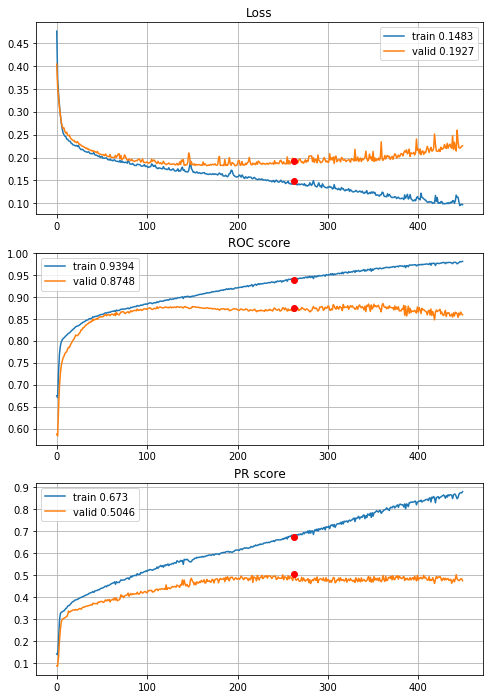


Fold 2------------------------------------------------------------


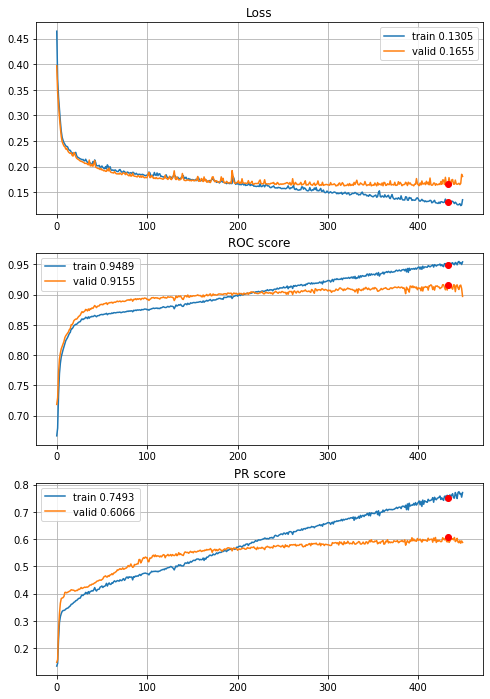


Fold 3------------------------------------------------------------


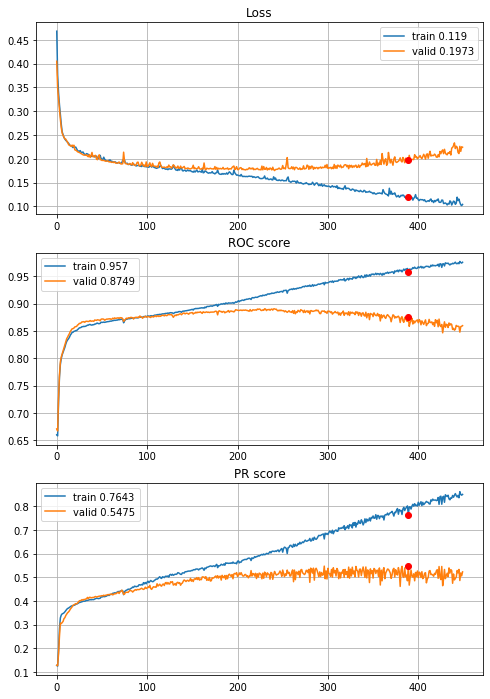


Fold 4------------------------------------------------------------


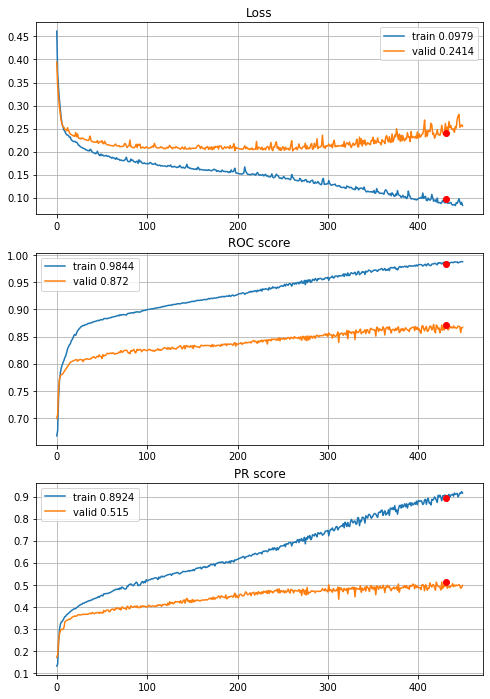


Fold 5------------------------------------------------------------


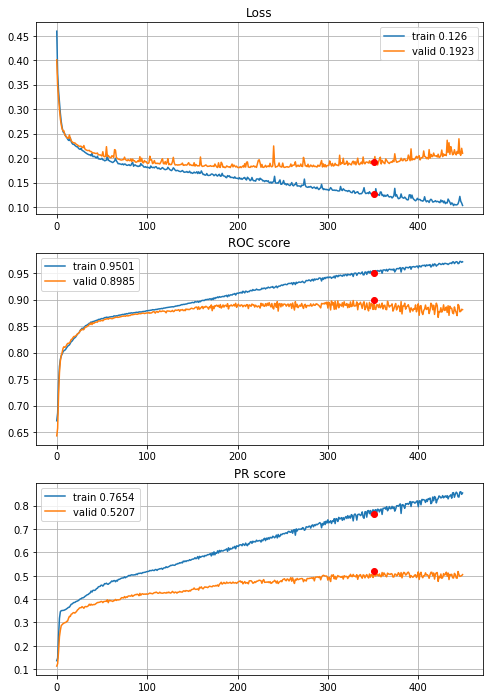


Fold 6------------------------------------------------------------


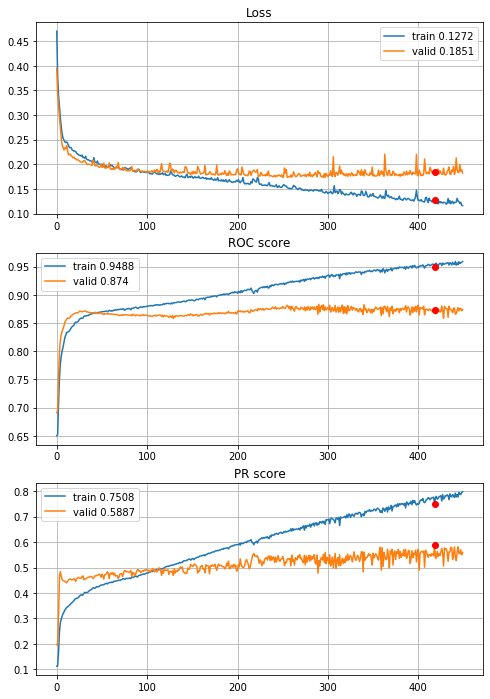

In [62]:
# model with one dense layer, 450 epochs, THE BEST ONE
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L1_000025,
                                        features=features, target=target, n_epochs=450, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\5year\define_deep_CNN_2inc_std_L1_000025_450ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

The model above is better than the one with no regularization added in terms of results (slightly) and overfitting (0.08 on PR-AUC and 0.03 on ROC-AUC). Learning curves are also pretty monotonicly increasing and smooth. Good model, the last tries will be about 2 dense layer version with regularization.


----------
Fold: 1
----------
Train on 4432 samples, validate on 887 samples
Epoch: 1/400,
cumulative time: 3.22s train loss: 0.5841980808908759, validation loss: 0.4455149803382031
Epoch: 2/400,
cumulative time: 4.09s train loss: 0.4207393812681363, validation loss: 0.39442007107557275
Epoch: 3/400,
cumulative time: 4.92s train loss: 0.37986381569816746, validation loss: 0.3678163918997282
Epoch: 4/400,
cumulative time: 5.76s train loss: 0.3501000345452598, validation loss: 0.34273187690146745
Epoch: 5/400,
cumulative time: 6.6s train loss: 0.32391265302304756, validation loss: 0.3214999862695627
Epoch: 6/400,
cumulative time: 7.42s train loss: 0.3023298644941529, validation loss: 0.301088711589138
Epoch: 7/400,
cumulative time: 8.31s train loss: 0.28384718624370625, validation loss: 0.28668927255988524
Epoch: 8/400,
cumulative time: 9.14s train loss: 0.2698946939008008, validation loss: 0.2819376296564315
Epoch: 9/400,
cumulative time: 9.97s train loss: 0.26531284730141774, validati

Epoch: 77/400,
cumulative time: 66.14s train loss: 0.19034754713519816, validation loss: 0.205232003344624
Epoch: 78/400,
cumulative time: 66.96s train loss: 0.19011823881404064, validation loss: 0.19835163385784746
Epoch: 79/400,
cumulative time: 67.78s train loss: 0.19019477057946502, validation loss: 0.1983918140746292
Epoch: 80/400,
cumulative time: 68.59s train loss: 0.19136565133579586, validation loss: 0.20221072363141154
Epoch: 81/400,
cumulative time: 69.39s train loss: 0.18730295454202361, validation loss: 0.1993242084744818
Epoch: 82/400,
cumulative time: 70.21s train loss: 0.19006475394033567, validation loss: 0.21133604010707766
Epoch: 83/400,
cumulative time: 71.03s train loss: 0.1905907333731006, validation loss: 0.19716494470801132
Epoch: 84/400,
cumulative time: 71.85s train loss: 0.18841380243347655, validation loss: 0.20070902198519486
Epoch: 85/400,
cumulative time: 72.66s train loss: 0.18950919895718674, validation loss: 0.19736151094837145
Epoch: 86/400,
cumulativ

Epoch: 152/400,
cumulative time: 127.57s train loss: 0.16014461988576484, validation loss: 0.18686484983096396
Epoch: 153/400,
cumulative time: 128.39s train loss: 0.1606805766142555, validation loss: 0.18693729799992606
Epoch: 154/400,
cumulative time: 129.21s train loss: 0.1584897785471073, validation loss: 0.18656381835327343
Epoch: 155/400,
cumulative time: 130.03s train loss: 0.1594504658771605, validation loss: 0.19275056541369223
Epoch: 156/400,
cumulative time: 130.83s train loss: 0.16744202454759327, validation loss: 0.19485319243678917
Epoch: 157/400,
cumulative time: 131.64s train loss: 0.15919160587033962, validation loss: 0.18554724868819572
Epoch: 158/400,
cumulative time: 132.45s train loss: 0.15874492034437102, validation loss: 0.18952373434551137
Epoch: 159/400,
cumulative time: 133.27s train loss: 0.1605124609403662, validation loss: 0.18820526438272792
Epoch: 160/400,
cumulative time: 134.08s train loss: 0.15746584342664868, validation loss: 0.18756078958108163
Epoch

Epoch: 227/400,
cumulative time: 189.6s train loss: 0.13861176966007005, validation loss: 0.19446702318301734
Epoch: 228/400,
cumulative time: 190.42s train loss: 0.13996121575820533, validation loss: 0.19330964733876935
Epoch: 229/400,
cumulative time: 191.22s train loss: 0.13729132974809471, validation loss: 0.19328502630300426
Epoch: 230/400,
cumulative time: 192.04s train loss: 0.1355094046429445, validation loss: 0.19765695166829741
Epoch: 231/400,
cumulative time: 192.84s train loss: 0.13795367456528793, validation loss: 0.19407781296679508
Epoch: 232/400,
cumulative time: 193.68s train loss: 0.13612252500392363, validation loss: 0.19471675305382644
Epoch: 233/400,
cumulative time: 194.5s train loss: 0.13669704891983353, validation loss: 0.19427859175030515
Epoch: 234/400,
cumulative time: 195.32s train loss: 0.1368965869231506, validation loss: 0.1972446718842228
Epoch: 235/400,
cumulative time: 196.14s train loss: 0.13760348360998967, validation loss: 0.1949977111554334
Epoch: 

Epoch: 302/400,
cumulative time: 250.71s train loss: 0.12213149501367167, validation loss: 0.21254995117528866
Epoch: 303/400,
cumulative time: 251.53s train loss: 0.12279753955518188, validation loss: 0.23120586419522157
Epoch: 304/400,
cumulative time: 252.35s train loss: 0.12094669148917662, validation loss: 0.20864339288756706
Epoch: 305/400,
cumulative time: 253.15s train loss: 0.11871225644232511, validation loss: 0.21300375034870936
Epoch: 306/400,
cumulative time: 253.98s train loss: 0.11280415580685281, validation loss: 0.21396760288058972
Epoch: 307/400,
cumulative time: 254.78s train loss: 0.11507247439804168, validation loss: 0.23046301642964093
Epoch: 308/400,
cumulative time: 255.6s train loss: 0.12652436946434664, validation loss: 0.21424673860546165
Epoch: 309/400,
cumulative time: 256.4s train loss: 0.11530837095561118, validation loss: 0.2196417640739256
Epoch: 310/400,
cumulative time: 257.21s train loss: 0.11277102318925225, validation loss: 0.2163630752848396
Epoch

Epoch: 377/400,
cumulative time: 312.02s train loss: 0.09788621196839353, validation loss: 0.23660027540657405
Epoch: 378/400,
cumulative time: 312.84s train loss: 0.09892527505230925, validation loss: 0.24309048432911395
Epoch: 379/400,
cumulative time: 313.66s train loss: 0.09840706288680058, validation loss: 0.24371214380662096
Epoch: 380/400,
cumulative time: 314.46s train loss: 0.10134108023321263, validation loss: 0.24050806074696168
Epoch: 381/400,
cumulative time: 315.28s train loss: 0.09490213409025854, validation loss: 0.23840380595259897
Epoch: 382/400,
cumulative time: 316.09s train loss: 0.0931220860203681, validation loss: 0.244215257003853
Epoch: 383/400,
cumulative time: 316.89s train loss: 0.09330445827936437, validation loss: 0.24519727376563707
Epoch: 384/400,
cumulative time: 317.71s train loss: 0.09344228194347358, validation loss: 0.24597554814318257
Epoch: 385/400,
cumulative time: 318.52s train loss: 0.09481292205193628, validation loss: 0.25325004758130604
Epoc

Epoch: 50/400,
cumulative time: 44.83s train loss: 0.2037304478700841, validation loss: 0.20303737624992513
Epoch: 51/400,
cumulative time: 45.68s train loss: 0.2049213594114845, validation loss: 0.19861720425098833
Epoch: 52/400,
cumulative time: 46.52s train loss: 0.20320611946715128, validation loss: 0.1988342903478842
Epoch: 53/400,
cumulative time: 47.37s train loss: 0.2012658976152916, validation loss: 0.1964575304925912
Epoch: 54/400,
cumulative time: 48.21s train loss: 0.19969990002226742, validation loss: 0.19650491178371726
Epoch: 55/400,
cumulative time: 49.05s train loss: 0.20322308560920752, validation loss: 0.19542149078886298
Epoch: 56/400,
cumulative time: 49.89s train loss: 0.19964981583427865, validation loss: 0.19637299291243548
Epoch: 57/400,
cumulative time: 50.79s train loss: 0.2075389975661728, validation loss: 0.20474513054834814
Epoch: 58/400,
cumulative time: 51.64s train loss: 0.2047974816271329, validation loss: 0.1973682231067133
Epoch: 59/400,
cumulative t

Epoch: 126/400,
cumulative time: 109.05s train loss: 0.1736333691330109, validation loss: 0.1782393661971291
Epoch: 127/400,
cumulative time: 109.89s train loss: 0.17533214675390332, validation loss: 0.174007363726617
Epoch: 128/400,
cumulative time: 110.73s train loss: 0.17222896678245456, validation loss: 0.17202347879882865
Epoch: 129/400,
cumulative time: 111.57s train loss: 0.17129053599755903, validation loss: 0.17961592216300856
Epoch: 130/400,
cumulative time: 112.41s train loss: 0.17676857684735572, validation loss: 0.18164898586179115
Epoch: 131/400,
cumulative time: 113.3s train loss: 0.1811918841964071, validation loss: 0.19173331913173938
Epoch: 132/400,
cumulative time: 114.17s train loss: 0.17810373370693694, validation loss: 0.17610601213967517
Epoch: 133/400,
cumulative time: 115.03s train loss: 0.1736688673200375, validation loss: 0.1720875303566523
Epoch: 134/400,
cumulative time: 115.89s train loss: 0.17019520110252317, validation loss: 0.17570415246715138
Epoch: 13

Epoch: 201/400,
cumulative time: 172.67s train loss: 0.15467390776124348, validation loss: 0.16752383736169055
Epoch: 202/400,
cumulative time: 173.51s train loss: 0.15551198823276624, validation loss: 0.1671183393531077
Epoch: 203/400,
cumulative time: 174.35s train loss: 0.1531848255813875, validation loss: 0.16632245074466223
Epoch: 204/400,
cumulative time: 175.17s train loss: 0.15500552907572648, validation loss: 0.1658867372466585
Epoch: 205/400,
cumulative time: 176.01s train loss: 0.15220238183648577, validation loss: 0.1647574258327753
Epoch: 206/400,
cumulative time: 176.85s train loss: 0.1528484694565569, validation loss: 0.16972680063970733
Epoch: 207/400,
cumulative time: 177.67s train loss: 0.152613334233338, validation loss: 0.1655228136122025
Epoch: 208/400,
cumulative time: 178.52s train loss: 0.1531599846967775, validation loss: 0.1643786297642795
Epoch: 209/400,
cumulative time: 179.35s train loss: 0.15288882612146518, validation loss: 0.1675061869950547
Epoch: 210/4

Epoch: 276/400,
cumulative time: 235.35s train loss: 0.1391698383769888, validation loss: 0.16736722803908782
Epoch: 277/400,
cumulative time: 236.18s train loss: 0.13600217344891616, validation loss: 0.16748111868926072
Epoch: 278/400,
cumulative time: 237.0s train loss: 0.13534560033695148, validation loss: 0.167661804407667
Epoch: 279/400,
cumulative time: 237.83s train loss: 0.13356832317866735, validation loss: 0.16552514543393554
Epoch: 280/400,
cumulative time: 238.66s train loss: 0.13682361339161758, validation loss: 0.17346362436973525
Epoch: 281/400,
cumulative time: 239.49s train loss: 0.13742673180876333, validation loss: 0.1653750244666651
Epoch: 282/400,
cumulative time: 240.33s train loss: 0.13613924907271613, validation loss: 0.17216953778011554
Epoch: 283/400,
cumulative time: 241.16s train loss: 0.13150136566482187, validation loss: 0.16700873983417047
Epoch: 284/400,
cumulative time: 241.99s train loss: 0.13264886057172443, validation loss: 0.1680443461778602
Epoch: 

Epoch: 351/400,
cumulative time: 298.46s train loss: 0.12173478458991227, validation loss: 0.1756678327766857
Epoch: 352/400,
cumulative time: 299.29s train loss: 0.11905361923123525, validation loss: 0.18284520001193716
Epoch: 353/400,
cumulative time: 300.12s train loss: 0.12068865563222862, validation loss: 0.1741430865266815
Epoch: 354/400,
cumulative time: 300.94s train loss: 0.11689380490110131, validation loss: 0.17237906794671679
Epoch: 355/400,
cumulative time: 301.79s train loss: 0.11969982228151083, validation loss: 0.17820013323725278
Epoch: 356/400,
cumulative time: 302.61s train loss: 0.11844355274758399, validation loss: 0.17295470272674904
Epoch: 357/400,
cumulative time: 303.46s train loss: 0.11829035151211902, validation loss: 0.19409568649805922
Epoch: 358/400,
cumulative time: 304.29s train loss: 0.1290772249014369, validation loss: 0.179234264886769
Epoch: 359/400,
cumulative time: 305.12s train loss: 0.11895099933181859, validation loss: 0.1725666572706272
Epoch: 

Epoch: 24/400,
cumulative time: 22.32s train loss: 0.22968318198373816, validation loss: 0.2241216139970799
Epoch: 25/400,
cumulative time: 23.15s train loss: 0.22615490836303156, validation loss: 0.22368712279748218
Epoch: 26/400,
cumulative time: 23.97s train loss: 0.22493139761987577, validation loss: 0.22444699590410427
Epoch: 27/400,
cumulative time: 24.83s train loss: 0.22524117533830315, validation loss: 0.22067338129108627
Epoch: 28/400,
cumulative time: 25.66s train loss: 0.22367113628273405, validation loss: 0.2190653250511765
Epoch: 29/400,
cumulative time: 26.49s train loss: 0.22055598127147996, validation loss: 0.21859663615702507
Epoch: 30/400,
cumulative time: 27.32s train loss: 0.22461019671565788, validation loss: 0.21700370520050927
Epoch: 31/400,
cumulative time: 28.15s train loss: 0.22499358898116148, validation loss: 0.21938429567899886
Epoch: 32/400,
cumulative time: 28.97s train loss: 0.21856507367794048, validation loss: 0.21961942214304592
Epoch: 33/400,
cumula

Epoch: 100/400,
cumulative time: 85.9s train loss: 0.1815947705967224, validation loss: 0.1965160843283106
Epoch: 101/400,
cumulative time: 86.75s train loss: 0.18225171113729693, validation loss: 0.18930965124418395
Epoch: 102/400,
cumulative time: 87.57s train loss: 0.182491428373442, validation loss: 0.19009854391704417
Epoch: 103/400,
cumulative time: 88.41s train loss: 0.18122175843572574, validation loss: 0.19541087990213005
Epoch: 104/400,
cumulative time: 89.23s train loss: 0.18426822431869672, validation loss: 0.20051621082065607
Epoch: 105/400,
cumulative time: 90.04s train loss: 0.18271302367940492, validation loss: 0.18902669865491023
Epoch: 106/400,
cumulative time: 90.87s train loss: 0.18041038087532194, validation loss: 0.1896530892426965
Epoch: 107/400,
cumulative time: 91.72s train loss: 0.18509978298030605, validation loss: 0.19322463881808177
Epoch: 108/400,
cumulative time: 92.54s train loss: 0.18113387972519931, validation loss: 0.18873168558319095
Epoch: 109/400,


Epoch: 175/400,
cumulative time: 148.03s train loss: 0.15909474893785772, validation loss: 0.18426102636699074
Epoch: 176/400,
cumulative time: 148.85s train loss: 0.15845368694957843, validation loss: 0.1925620808441448
Epoch: 177/400,
cumulative time: 149.68s train loss: 0.1634050496124296, validation loss: 0.18329461852955845
Epoch: 178/400,
cumulative time: 150.51s train loss: 0.16207753782184114, validation loss: 0.18338050993144714
Epoch: 179/400,
cumulative time: 151.33s train loss: 0.16537960664459944, validation loss: 0.18398549301043707
Epoch: 180/400,
cumulative time: 152.15s train loss: 0.1596728930323778, validation loss: 0.18409379743871185
Epoch: 181/400,
cumulative time: 152.99s train loss: 0.15623405992662004, validation loss: 0.1830880816820106
Epoch: 182/400,
cumulative time: 153.81s train loss: 0.1553652480022733, validation loss: 0.18443733771261261
Epoch: 183/400,
cumulative time: 154.64s train loss: 0.15520567318512, validation loss: 0.18417965962626082
Epoch: 18

Epoch: 250/400,
cumulative time: 210.36s train loss: 0.1343894848795036, validation loss: 0.19859677482618956
Epoch: 251/400,
cumulative time: 211.2s train loss: 0.13574733226711355, validation loss: 0.1932548885784934
Epoch: 252/400,
cumulative time: 212.02s train loss: 0.1326402894486858, validation loss: 0.1956913500453063
Epoch: 253/400,
cumulative time: 212.84s train loss: 0.12986046938891338, validation loss: 0.1920644221270904
Epoch: 254/400,
cumulative time: 213.66s train loss: 0.1298139798101912, validation loss: 0.19783297330645053
Epoch: 255/400,
cumulative time: 214.49s train loss: 0.13087097117979926, validation loss: 0.2008414295708851
Epoch: 256/400,
cumulative time: 215.31s train loss: 0.13373133861241251, validation loss: 0.2015417710097828
Epoch: 257/400,
cumulative time: 216.13s train loss: 0.1309516193842791, validation loss: 0.20757236004950902
Epoch: 258/400,
cumulative time: 216.95s train loss: 0.1374399745298906, validation loss: 0.2103640577402029
Epoch: 259/40

Epoch: 325/400,
cumulative time: 272.37s train loss: 0.10799671704494243, validation loss: 0.20480648163609466
Epoch: 326/400,
cumulative time: 273.2s train loss: 0.10519509734619503, validation loss: 0.21196869272726096
Epoch: 327/400,
cumulative time: 274.04s train loss: 0.1080432702797307, validation loss: 0.20576779299080708
Epoch: 328/400,
cumulative time: 274.86s train loss: 0.10728077088156547, validation loss: 0.2087644272249742
Epoch: 329/400,
cumulative time: 275.69s train loss: 0.10735689568928433, validation loss: 0.2131646304919459
Epoch: 330/400,
cumulative time: 276.52s train loss: 0.10751972064402775, validation loss: 0.20676923387819374
Epoch: 331/400,
cumulative time: 277.35s train loss: 0.10423309235608319, validation loss: 0.21824259568833176
Epoch: 332/400,
cumulative time: 278.18s train loss: 0.10736728994518734, validation loss: 0.20142229780000387
Epoch: 333/400,
cumulative time: 279.02s train loss: 0.10725758110075544, validation loss: 0.2126895518219592
Epoch:

Epoch: 400/400,
cumulative time: 334.93s train loss: 0.08862192046220015, validation loss: 0.23019295578072815

Early stopping results:
best results in epoch: 287, 
best valid PR: 0.558033842105129, 
valid ROC: 0.8689540566959922        
overfitting PR: 0.20791406738989937, 
overfitting ROC: 0.0873456175711087

----------
Fold: 4
----------
Train on 4433 samples, validate on 886 samples
Epoch: 1/400,
cumulative time: 3.48s train loss: 0.5817809811220356, validation loss: 0.4351131835317504
Epoch: 2/400,
cumulative time: 4.34s train loss: 0.4246052127981089, validation loss: 0.3840733414040731
Epoch: 3/400,
cumulative time: 5.2s train loss: 0.3809643099048781, validation loss: 0.35685844426768626
Epoch: 4/400,
cumulative time: 6.06s train loss: 0.3491008994529835, validation loss: 0.33037470762132254
Epoch: 5/400,
cumulative time: 6.9s train loss: 0.3236772679338707, validation loss: 0.30910908200401754
Epoch: 6/400,
cumulative time: 7.75s train loss: 0.2984008878677875, validation loss

Epoch: 74/400,
cumulative time: 65.55s train loss: 0.18829477974208408, validation loss: 0.2187780177485593
Epoch: 75/400,
cumulative time: 66.41s train loss: 0.18807257472890618, validation loss: 0.2186456391625695
Epoch: 76/400,
cumulative time: 67.29s train loss: 0.1880608041561298, validation loss: 0.222640471520327
Epoch: 77/400,
cumulative time: 68.17s train loss: 0.18846100336497454, validation loss: 0.2217629022105822
Epoch: 78/400,
cumulative time: 69.01s train loss: 0.1924863104495673, validation loss: 0.21854627468785098
Epoch: 79/400,
cumulative time: 69.94s train loss: 0.1880488594821256, validation loss: 0.21648513063216587
Epoch: 80/400,
cumulative time: 70.8s train loss: 0.1873985565316454, validation loss: 0.2251295108962005
Epoch: 81/400,
cumulative time: 71.68s train loss: 0.18674515688591448, validation loss: 0.22183830370079582
Epoch: 82/400,
cumulative time: 72.53s train loss: 0.18545277285274683, validation loss: 0.23106481481351918
Epoch: 83/400,
cumulative time

Epoch: 149/400,
cumulative time: 129.28s train loss: 0.16168665610625246, validation loss: 0.20372538322385225
Epoch: 150/400,
cumulative time: 130.13s train loss: 0.16097592820761947, validation loss: 0.205408436046497
Epoch: 151/400,
cumulative time: 130.99s train loss: 0.163100395713841, validation loss: 0.20661566902633177
Epoch: 152/400,
cumulative time: 131.82s train loss: 0.1620549802052203, validation loss: 0.20357281275715838
Epoch: 153/400,
cumulative time: 132.67s train loss: 0.1604880045821267, validation loss: 0.2036146532668486
Epoch: 154/400,
cumulative time: 133.5s train loss: 0.16105150708879543, validation loss: 0.2052807187657324
Epoch: 155/400,
cumulative time: 134.33s train loss: 0.16276760083704533, validation loss: 0.20644365395703113
Epoch: 156/400,
cumulative time: 135.17s train loss: 0.1624928522756722, validation loss: 0.2148437263532363
Epoch: 157/400,
cumulative time: 136.01s train loss: 0.16560245905816892, validation loss: 0.21357145326939447
Epoch: 158/4

Epoch: 224/400,
cumulative time: 192.92s train loss: 0.14146737223577208, validation loss: 0.20574597852897428
Epoch: 225/400,
cumulative time: 193.76s train loss: 0.13641895597496825, validation loss: 0.21481558445075835
Epoch: 226/400,
cumulative time: 194.59s train loss: 0.13653094422499912, validation loss: 0.20726742492841543
Epoch: 227/400,
cumulative time: 195.44s train loss: 0.13418185500818425, validation loss: 0.20594307181528407
Epoch: 228/400,
cumulative time: 196.28s train loss: 0.1341782211417031, validation loss: 0.21316374498619184
Epoch: 229/400,
cumulative time: 197.11s train loss: 0.1428168674213688, validation loss: 0.20479233509127226
Epoch: 230/400,
cumulative time: 197.95s train loss: 0.13592437493553716, validation loss: 0.20481276411235197
Epoch: 231/400,
cumulative time: 198.8s train loss: 0.13165028952944502, validation loss: 0.2089893621125555
Epoch: 232/400,
cumulative time: 199.65s train loss: 0.13146918228187277, validation loss: 0.21213071377901677
Epoch

Epoch: 299/400,
cumulative time: 256.37s train loss: 0.1033003796408818, validation loss: 0.23819615343758
Epoch: 300/400,
cumulative time: 257.21s train loss: 0.10166049654875602, validation loss: 0.2296449528254451
Epoch: 301/400,
cumulative time: 258.05s train loss: 0.09758605046490636, validation loss: 0.2672394317644175
Epoch: 302/400,
cumulative time: 258.89s train loss: 0.10724405165843223, validation loss: 0.2354147954261599
Epoch: 303/400,
cumulative time: 259.74s train loss: 0.09808309866502433, validation loss: 0.23715177060653608
Epoch: 304/400,
cumulative time: 260.58s train loss: 0.09889842714032819, validation loss: 0.2621805414254725
Epoch: 305/400,
cumulative time: 261.42s train loss: 0.11235176618094372, validation loss: 0.2256294135046328
Epoch: 306/400,
cumulative time: 262.27s train loss: 0.09652273403470145, validation loss: 0.23153268561002632
Epoch: 307/400,
cumulative time: 263.11s train loss: 0.09614823070688171, validation loss: 0.2374680667913794
Epoch: 308/

Epoch: 374/400,
cumulative time: 320.09s train loss: 0.07997387479557938, validation loss: 0.28481824901249286
Epoch: 375/400,
cumulative time: 320.94s train loss: 0.07090845890805383, validation loss: 0.29356399491328417
Epoch: 376/400,
cumulative time: 321.79s train loss: 0.07409599198025504, validation loss: 0.29430604875760474
Epoch: 377/400,
cumulative time: 322.62s train loss: 0.08505437975069106, validation loss: 0.27884555051342896
Epoch: 378/400,
cumulative time: 323.47s train loss: 0.07353696343126588, validation loss: 0.30368393393859905
Epoch: 379/400,
cumulative time: 324.31s train loss: 0.07292494823714558, validation loss: 0.28850327142877985
Epoch: 380/400,
cumulative time: 325.16s train loss: 0.07262528687211318, validation loss: 0.2995966033122879
Epoch: 381/400,
cumulative time: 325.99s train loss: 0.07308956335397249, validation loss: 0.2859067214530962
Epoch: 382/400,
cumulative time: 326.87s train loss: 0.07372606607704864, validation loss: 0.32187437143336567
Epo

Epoch: 47/400,
cumulative time: 42.66s train loss: 0.20476923131684593, validation loss: 0.21344518251128444
Epoch: 48/400,
cumulative time: 43.52s train loss: 0.2044805591682696, validation loss: 0.21281946512700203
Epoch: 49/400,
cumulative time: 44.36s train loss: 0.2034383774771799, validation loss: 0.21316767196353886
Epoch: 50/400,
cumulative time: 45.23s train loss: 0.20340568107903045, validation loss: 0.21222700306443543
Epoch: 51/400,
cumulative time: 46.07s train loss: 0.20585660570877387, validation loss: 0.20994324935074585
Epoch: 52/400,
cumulative time: 46.93s train loss: 0.20125374485697187, validation loss: 0.21746064221347697
Epoch: 53/400,
cumulative time: 47.8s train loss: 0.2006268378455564, validation loss: 0.20867376584500816
Epoch: 54/400,
cumulative time: 48.65s train loss: 0.19885045772356613, validation loss: 0.20799982171026363
Epoch: 55/400,
cumulative time: 49.53s train loss: 0.19997866227869898, validation loss: 0.21094281759541944
Epoch: 56/400,
cumulati

Epoch: 123/400,
cumulative time: 108.32s train loss: 0.16882501066759642, validation loss: 0.20001564270755776
Epoch: 124/400,
cumulative time: 109.2s train loss: 0.17390865661303023, validation loss: 0.19325805854043895
Epoch: 125/400,
cumulative time: 110.06s train loss: 0.17487340721499428, validation loss: 0.19823169240698588
Epoch: 126/400,
cumulative time: 110.92s train loss: 0.17858646044660148, validation loss: 0.1970839992871941
Epoch: 127/400,
cumulative time: 111.78s train loss: 0.1714012592446043, validation loss: 0.19032317810349217
Epoch: 128/400,
cumulative time: 112.64s train loss: 0.16744021139912915, validation loss: 0.19546258489918764
Epoch: 129/400,
cumulative time: 113.51s train loss: 0.1686961952333872, validation loss: 0.19887945419240483
Epoch: 130/400,
cumulative time: 114.37s train loss: 0.1718380625760773, validation loss: 0.1945072917717574
Epoch: 131/400,
cumulative time: 115.23s train loss: 0.17169076913222756, validation loss: 0.19300286663574237
Epoch: 

Epoch: 198/400,
cumulative time: 172.84s train loss: 0.15147495095653996, validation loss: 0.19436556961950816
Epoch: 199/400,
cumulative time: 173.69s train loss: 0.14722783285716895, validation loss: 0.1973782966153078
Epoch: 200/400,
cumulative time: 174.53s train loss: 0.1451656195317653, validation loss: 0.19850284776084848
Epoch: 201/400,
cumulative time: 175.39s train loss: 0.14474955531240127, validation loss: 0.19353165274010825
Epoch: 202/400,
cumulative time: 176.23s train loss: 0.14550790791045778, validation loss: 0.19948800022526736
Epoch: 203/400,
cumulative time: 177.08s train loss: 0.1490232896285807, validation loss: 0.1967251118163223
Epoch: 204/400,
cumulative time: 177.93s train loss: 0.14495752569974585, validation loss: 0.1995263960103149
Epoch: 205/400,
cumulative time: 178.8s train loss: 0.14780485153722622, validation loss: 0.19641887233434896
Epoch: 206/400,
cumulative time: 179.65s train loss: 0.14470119605598453, validation loss: 0.20122853604315635
Epoch: 

Epoch: 273/400,
cumulative time: 238.34s train loss: 0.13462231775290698, validation loss: 0.20481719140543625
Epoch: 274/400,
cumulative time: 239.21s train loss: 0.13329954360318244, validation loss: 0.24305556307527873
Epoch: 275/400,
cumulative time: 240.07s train loss: 0.146050141317135, validation loss: 0.20538979032104226
Epoch: 276/400,
cumulative time: 240.94s train loss: 0.1349004701522788, validation loss: 0.20618340544587602
Epoch: 277/400,
cumulative time: 241.79s train loss: 0.13105594476371055, validation loss: 0.20327508190550062
Epoch: 278/400,
cumulative time: 242.65s train loss: 0.12850814883633122, validation loss: 0.2060811078978984
Epoch: 279/400,
cumulative time: 243.5s train loss: 0.1272007948068741, validation loss: 0.20981409405747062
Epoch: 280/400,
cumulative time: 244.36s train loss: 0.12958803384178463, validation loss: 0.2063420442170537
Epoch: 281/400,
cumulative time: 245.22s train loss: 0.1309809602062562, validation loss: 0.2054146277985239
Epoch: 282

Epoch: 348/400,
cumulative time: 302.99s train loss: 0.1149939208863122, validation loss: 0.2136130318146527
Epoch: 349/400,
cumulative time: 303.85s train loss: 0.11348099027063463, validation loss: 0.21972098435289972
Epoch: 350/400,
cumulative time: 304.72s train loss: 0.1134437016391496, validation loss: 0.22424440217071948
Epoch: 351/400,
cumulative time: 305.58s train loss: 0.1110906688500252, validation loss: 0.21470401629502833
Epoch: 352/400,
cumulative time: 306.44s train loss: 0.11218332541619525, validation loss: 0.22019457685893598
Epoch: 353/400,
cumulative time: 307.3s train loss: 0.11427688157614913, validation loss: 0.22078371572709785
Epoch: 354/400,
cumulative time: 308.16s train loss: 0.12562964831750117, validation loss: 0.2162930060590094
Epoch: 355/400,
cumulative time: 309.03s train loss: 0.11726919309182117, validation loss: 0.2122284663046456
Epoch: 356/400,
cumulative time: 309.89s train loss: 0.11314071874209244, validation loss: 0.2182356024636103
Epoch: 35

Epoch: 21/400,
cumulative time: 20.49s train loss: 0.2328133425586465, validation loss: 0.22368262156541407
Epoch: 22/400,
cumulative time: 21.37s train loss: 0.2305067451172856, validation loss: 0.22128666520253262
Epoch: 23/400,
cumulative time: 22.24s train loss: 0.22873249552520436, validation loss: 0.22128341621120143
Epoch: 24/400,
cumulative time: 23.12s train loss: 0.23029768647457552, validation loss: 0.21961827902438677
Epoch: 25/400,
cumulative time: 23.99s train loss: 0.22575777402022018, validation loss: 0.21785052557965703
Epoch: 26/400,
cumulative time: 24.86s train loss: 0.22343746925849772, validation loss: 0.21829700732338778
Epoch: 27/400,
cumulative time: 25.73s train loss: 0.2228389844019365, validation loss: 0.21929490293794507
Epoch: 28/400,
cumulative time: 26.6s train loss: 0.22138522288047943, validation loss: 0.2165286244307361
Epoch: 29/400,
cumulative time: 27.45s train loss: 0.22243518398277598, validation loss: 0.21649819901780673
Epoch: 30/400,
cumulativ

Epoch: 97/400,
cumulative time: 86.87s train loss: 0.1764406401814442, validation loss: 0.18405532658638318
Epoch: 98/400,
cumulative time: 87.78s train loss: 0.17572217038165575, validation loss: 0.18675191687003753
Epoch: 99/400,
cumulative time: 88.67s train loss: 0.17503529641514246, validation loss: 0.18357004914811179
Epoch: 100/400,
cumulative time: 89.55s train loss: 0.17553530985557977, validation loss: 0.18574288457161148
Epoch: 101/400,
cumulative time: 90.45s train loss: 0.17774541559403298, validation loss: 0.18435366801564365
Epoch: 102/400,
cumulative time: 91.32s train loss: 0.1781461918640427, validation loss: 0.18467957568491555
Epoch: 103/400,
cumulative time: 92.2s train loss: 0.1723163971413131, validation loss: 0.1856389382757398
Epoch: 104/400,
cumulative time: 93.07s train loss: 0.1731224519900428, validation loss: 0.18338196823882197
Epoch: 105/400,
cumulative time: 93.95s train loss: 0.17280174541051194, validation loss: 0.1841229285464599
Epoch: 106/400,
cumu

Epoch: 172/400,
cumulative time: 152.1s train loss: 0.1503351466440735, validation loss: 0.1841976126954464
Epoch: 173/400,
cumulative time: 152.98s train loss: 0.15216013629173494, validation loss: 0.18214502641363553
Epoch: 174/400,
cumulative time: 153.83s train loss: 0.15011967109848623, validation loss: 0.18287756436969033
Epoch: 175/400,
cumulative time: 154.7s train loss: 0.14890595909881182, validation loss: 0.18640069300245754
Epoch: 176/400,
cumulative time: 155.56s train loss: 0.15072413848386562, validation loss: 0.18141458006933095
Epoch: 177/400,
cumulative time: 156.44s train loss: 0.14870556145940061, validation loss: 0.1812729820037265
Epoch: 178/400,
cumulative time: 157.3s train loss: 0.14924274832043882, validation loss: 0.18503414131448714
Epoch: 179/400,
cumulative time: 158.17s train loss: 0.1557416047673179, validation loss: 0.19094568726440583
Epoch: 180/400,
cumulative time: 159.02s train loss: 0.1518721147689329, validation loss: 0.18198090011325432
Epoch: 18

Epoch: 247/400,
cumulative time: 217.51s train loss: 0.13189237182272925, validation loss: 0.19613508382311792
Epoch: 248/400,
cumulative time: 218.38s train loss: 0.1297184859398066, validation loss: 0.191479808051753
Epoch: 249/400,
cumulative time: 219.26s train loss: 0.13006100062757375, validation loss: 0.1857422050046598
Epoch: 250/400,
cumulative time: 220.13s train loss: 0.13026296862180686, validation loss: 0.19352833391850474
Epoch: 251/400,
cumulative time: 221.0s train loss: 0.1316000028197609, validation loss: 0.1863432160618612
Epoch: 252/400,
cumulative time: 221.87s train loss: 0.13755099003440824, validation loss: 0.19649130869530662
Epoch: 253/400,
cumulative time: 222.74s train loss: 0.13242412511634954, validation loss: 0.19040443965193918
Epoch: 254/400,
cumulative time: 223.61s train loss: 0.12739697138396713, validation loss: 0.188856617658994
Epoch: 255/400,
cumulative time: 224.48s train loss: 0.13121162289734647, validation loss: 0.1923770654282236
Epoch: 256/

Epoch: 322/400,
cumulative time: 282.91s train loss: 0.11234051845051783, validation loss: 0.20492556364891493
Epoch: 323/400,
cumulative time: 283.77s train loss: 0.11007671417513416, validation loss: 0.21112374638461637
Epoch: 324/400,
cumulative time: 284.64s train loss: 0.10969859376943007, validation loss: 0.20403365276198893
Epoch: 325/400,
cumulative time: 285.52s train loss: 0.11127015354669366, validation loss: 0.21777507703137453
Epoch: 326/400,
cumulative time: 286.43s train loss: 0.11624545517434069, validation loss: 0.2147834573454028
Epoch: 327/400,
cumulative time: 287.29s train loss: 0.11383682326870634, validation loss: 0.2041124920476371
Epoch: 328/400,
cumulative time: 288.16s train loss: 0.11811789834294985, validation loss: 0.21023783538465307
Epoch: 329/400,
cumulative time: 289.01s train loss: 0.10871150736887568, validation loss: 0.21325803206682745
Epoch: 330/400,
cumulative time: 289.88s train loss: 0.11506404981988562, validation loss: 0.21258209501109326
Epo

Epoch: 397/400,
cumulative time: 348.38s train loss: 0.09507243867695479, validation loss: 0.2418368084705172
Epoch: 398/400,
cumulative time: 349.25s train loss: 0.0968644260896293, validation loss: 0.27220684518663396
Epoch: 399/400,
cumulative time: 350.14s train loss: 0.10280666373268411, validation loss: 0.24999649456069378
Epoch: 400/400,
cumulative time: 351.01s train loss: 0.09569305109232833, validation loss: 0.22254130644534564

Early stopping results:
best results in epoch: 237, 
best valid PR: 0.5783185544756487, 
valid ROC: 0.859572776949826        
overfitting PR: 0.14482424850883346, 
overfitting ROC: 0.08015528286914297

Cross validation time: 2074s
ROC: 		0.8728313809699321
PR: 		0.541374869501404
overfittingROC: 0.07204829228018828
overfittingPR:  0.19824054989046358
early stopping: [160, 215, 287, 304, 336, 237]

Fold 1------------------------------------------------------------


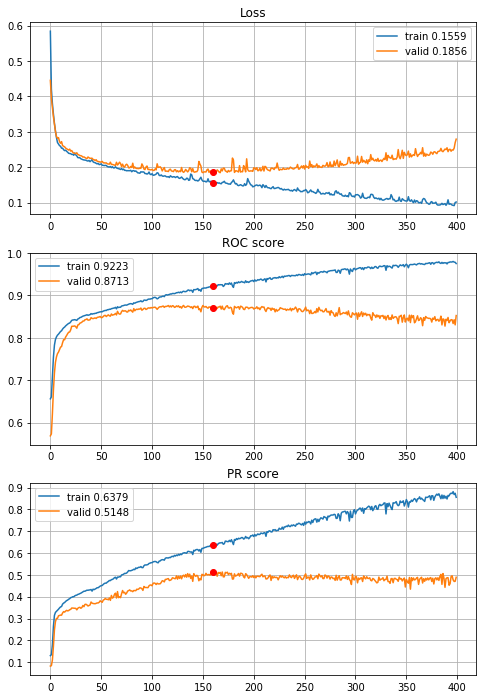


Fold 2------------------------------------------------------------


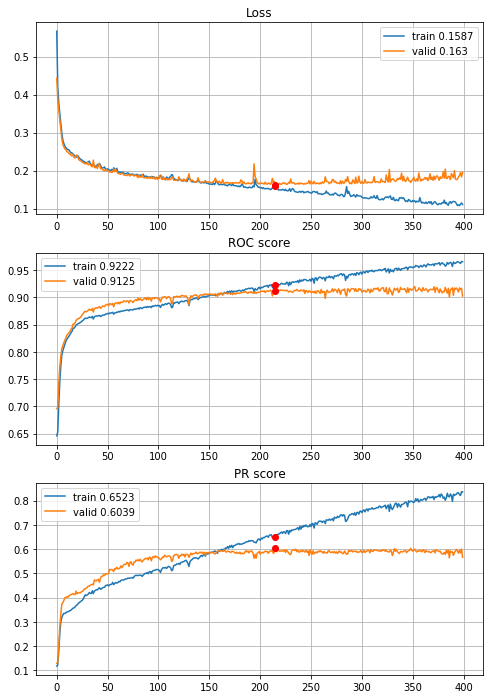


Fold 3------------------------------------------------------------


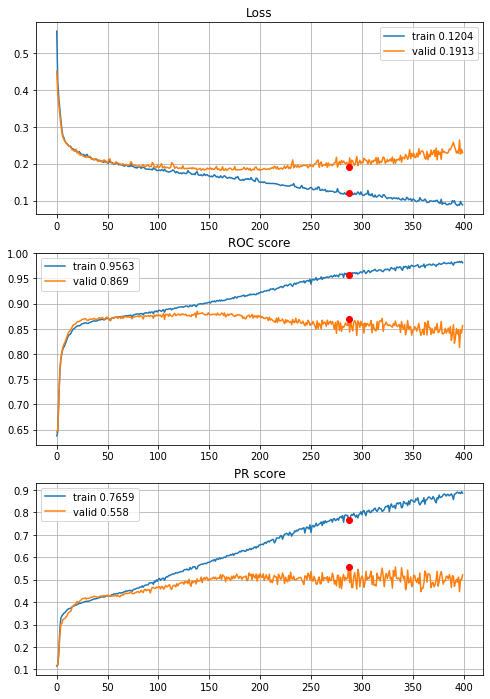


Fold 4------------------------------------------------------------


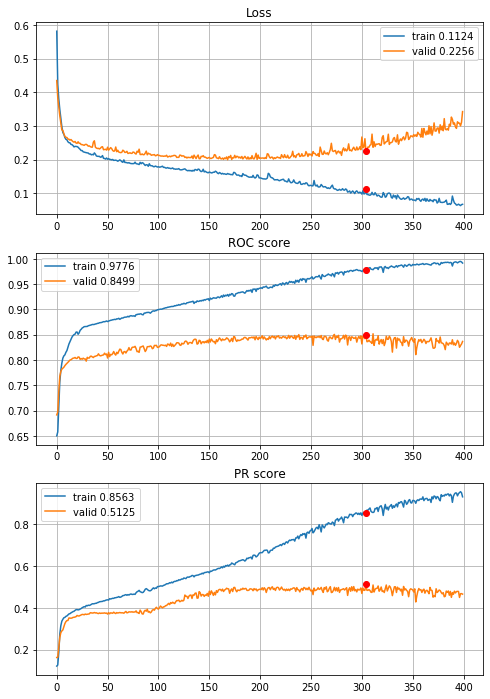


Fold 5------------------------------------------------------------


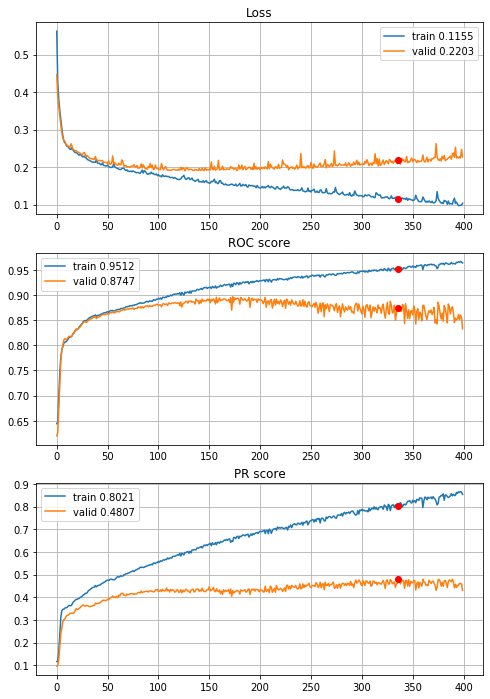


Fold 6------------------------------------------------------------


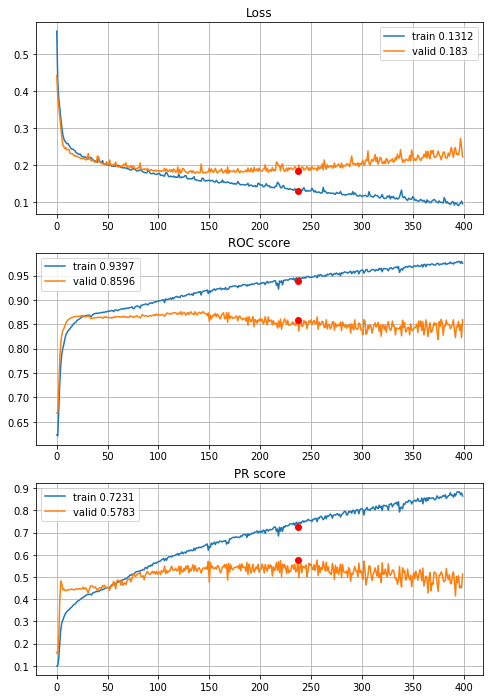

In [67]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_2dense_std_L1_000025,
                                        features=features, target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Worse results than model with one dense layer. To sum up best 8x8 input convolutional neural network specification is:

To sum up, the best 8x8 input Convolutional Neural Network specification:
 - definition: define_deep_CNN_2inc_std_L1_000025($\cdot$)
 - 8x8x1 input,
 - 2 inceptions $i^{[1]},i^{[2]}$,
     - $i^{[1]}:f_1=f_{2\_out}=f_{3\_out}=f_{4}=4, f_{2\_in}=f_{3\_in}=1$,
     - $i^{[2]}:f_1=f_{2\_out}=f_{3\_out}=f_{4}=8, f_{2\_in}=f_{3\_in}=4$,
     - relu activations,
 - 1 average pooling $f=(2,2),s=(2,2),p=\text{valid}$,
 - flatten ($512 \text{ units}$),
 - 1 dense layer $l^{[1]}$,
     - units: $u^{[1]}=256$,
     - activation: $a^{[1]}=relu$,
     - regularization: $L_1^{[1]}=0.000025$,
 - optimizer: Adam with default setings,
 - because of learng curves shape, first fold is deleted from data to compute median for production model (early stopping applied much earlier after what stabilization occures, while other folds are still increasing after this early stopping epoch). 418 epochs,
 - 394 batch size.
 
Because of small image size (8x8) CNN may be a bit under-trained, to fix it image dimensions has to increase. To do so feature generation method will be applied.

##### Feature generation for CNN
 - first, lets train the best XGBoost configuration and save the models (XGBoost achived much better results than Random Forest), note: best configuration excludes power transform from preprocessing pipeline, to get more reliable results best configuration with power transform will be used (CNN uses it too),

In [60]:
XGB_fi_hist, XGB_fi_models = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target,
                                                      random_state=random_state, info=0, normalize="power", q=0.005,
                                                      n_estimators=156, early_stopping_rounds=156, max_depth=6,
                                                      learning_rate=0.08, subsample=0.9, colsample_bytree=0.9, gamma=3, 
                                                      reg_alpha=0.9, reg_lambda=1, saveModels=True)


Cross validation time: 19s


 - second, lets create importance score table for each fold and on average,

In [61]:
XGBimportance=pd.DataFrame((features,
                           XGB_fi_models[0].feature_importances_,
                           XGB_fi_models[1].feature_importances_,
                           XGB_fi_models[2].feature_importances_,
                           XGB_fi_models[3].feature_importances_,
                           XGB_fi_models[4].feature_importances_,
                           XGB_fi_models[5].feature_importances_)).T

XGBimportance.columns = ("feature", "fold_1", "fold_2", "fold_3", "fold_4", "fold_5", "fold_6")
XGBimportance["folds_mean_naive"] = XGBimportance.loc[:, ["fold_1", "fold_2", "fold_3", "fold_4", "fold_5", "fold_6"]].mean(axis=1)
# normalize folds mean to sum up to 1
for i in range(len(features)):
    XGBimportance.loc[i,"folds_mean"]=XGBimportance.loc[i,"folds_mean_naive"]/XGBimportance["folds_mean_naive"].sum()

XGBimportance.drop(labels="folds_mean_naive",axis=1, inplace=True)
XGBimportance.sort_values(by="folds_mean", ascending=False, ignore_index=True, inplace=True)

XGBimportance

,feature,fold_1,fold_2,fold_3,fold_4,fold_5,fold_6,folds_mean
0,Attr39,0.0713496,0.0666412,0.0531787,0.0721505,0.0773127,0.0654279,0.067677
1,Attr35,0.0672458,0.0544533,0.0420265,0.0594087,0.0503042,0.0615655,0.055834
2,Attr41,0.0323883,0.0270672,0.032294,0.0350468,0.023875,0.0212458,0.028653
3,Attr26,0.0287995,0.0433748,0.0183152,0.0238107,0.014113,0.0188967,0.024552
4,Attr56,0.0280634,0.019309,0.0231889,0.0225621,0.0239316,0.0233451,0.023400
5,Attr46,0.0249453,0.0213275,0.0231546,0.020231,0.0215582,0.023138,0.022392
6,Attr13,0.0161233,0.0212267,0.0330135,0.0184974,0.0272069,0.0182122,0.022380
7,Attr5,0.0205432,0.0240519,0.0211557,0.0217522,0.0209899,0.0230319,0.021921
8,Attr42,0.0129281,0.013682,0.0239001,0.0126978,0.040708,0.0144007,0.019719
9,Attr22,0.0302758,0.0247504,0.016864,0.0148296,0.0146209,0.0151368,0.019413


 - third, define the discrete probability distribution, where Attributes are events and its fold's average XGBoost importance score is the probability of that event (score average sums up to 1), then sample needed number of attributes pair and one of basic arithmetic operation to perform on them with uniform probability (addition, subtraction, multiplication, division) dealing with duplicates and commutative property of these basic operations to create instruction how to generate new features - feature_generation_instruction(),
 - fourth, define the function which will generate features by instruction and prevent dividing by 0 - generate_features(),

In [62]:
def feature_generation_instruction(image_shape, importance, random_state=random_state):
    '''
    function generates instruction how to create new features. The idea is to sample two features from discrete probability
    distribution with P(x=feature)=Importance(feature) and sample one of arithmetic operations in ["add", "subtract",
    "multiply", "divide"] uniformly distributed. Duplicates are not allowed. Different features sampling order for the same
    operation is forbidden too, arguments:
    image_shape - shape of image to create from all features (original and generated), tuple,
    importance - dataframe with importance score, needs to contain columns ["feature", "folds_mean"], where "folds_mean" is Importance(feature),
    random_state - random seed
    
    return feature generation instruction (pandas.DataFrame, colnames=["feature1", "feature2", "operation"])
    '''
    # random seeds
    np.random.seed(random_state)
    random.seed(random_state)

    # computing number of features to generate
    n_features = image_shape[0]*image_shape[1]-importance.shape[0]
    
    # check if it is possible to generate n_features
        # division by 2 because of we don't want (Attr1, Attr2, add) and (Attr2, Attr1, add) in our instruction
    if n_features > (importance.shape[0]*(importance.shape[0]-1)*4)/2:
        raise "Too may features to generate, maximum number of features with given importance is {}\
        ".format((importance.shape[0]*(importance.shape[0]-1)*4)/2)
    elif n_features <= 0:
        raise "image.shape[0]*image.shape[1]-importance.shape[0]<=0, there is no features to generate."

    # generate first row
    bse=np.random.choice(a=importance.feature.values, p=importance.folds_mean.values,size=(2,),replace=False)
    bse=np.append(bse, np.random.choice(a=["add", "subtract", "multiply", "divide"]))
    bse=bse.reshape(1,-1) # needed for condition below (np.any(np.all()))
    # iterator (iterate through number of valid generated features) 
    i=1
    while True:
        # generate next row
        bse_tmp=np.random.choice(a=importance.feature.values, p=importance.folds_mean.values,size=(2,),replace=False)
        bse_tmp=np.append(bse_tmp, np.random.choice(a=["add", "subtract", "multiply", "divide"]))
        # validate generated row
        if not np.any(np.all(bse==bse_tmp, axis=1)) and not np.any(np.all(np.array((bse_tmp[1], bse_tmp[0], bse_tmp[2]), dtype="object")==bse, axis=1)):
            # append
            bse=np.vstack((bse, bse_tmp))
            i+=1
        else:
            continue
        # stop generating rows when number of generated features is enough
        if i == n_features:
            break
    
    # convert to dataframe
    bse=pd.DataFrame(data=bse, columns=["feature1", "feature2", "operation"])
    
    return bse

def generate_features(data, instruction):
    '''
    function that generates new features for given dataframe with given istruction, arguments:
    data - dataframe with features,
    instruction - dataframe with 2 columns of features from data and column with arithmetic operation [+,-,*,/] to perform,
    
    return dataframe with old and generated features
    '''
    
    data_wgf=data.copy()
    
    for i in range(instruction.shape[0]):
        feature1=data[instruction.iloc[i,0]]
        feature2=data[instruction.iloc[i,1]]
        operation=instruction.iloc[i,2]
        if operation == "add":
            data_wgf["v"+str(i)]=feature1+feature2
        elif operation == "subtract":
            data_wgf["v"+str(i)]=feature1-feature2
        elif operation == "multiply":
            data_wgf["v"+str(i)]=feature1*feature2
        else:
            # prevent dividing by 0, when feature2==0 assign it to 1, then it won't cause an error 
            feature2.loc[feature2==0]=1
            data_wgf["v"+str(i)]=feature1/feature2
        
    return data_wgf

 - fifth generate instruction,

In [63]:
instruction=feature_generation_instruction(image_shape=(20,20), importance=XGBimportance, random_state=random_state)
instruction

,feature1,feature2,operation
0,Attr6,Attr53,subtract
1,Attr48,Attr30,multiply
2,Attr41,Attr56,add
3,Attr4,Attr64,multiply
4,Attr35,Attr39,multiply
...,...,...,...
336,Attr52,Attr48,add
337,Attr18,Attr11,multiply
338,Attr32,Attr34,add
339,Attr44,Attr35,multiply


 - sixth perform Monte Carlo quasi optimization for image conversion with generated features for each of 6 folds (it will take a loooot of time) and save the results, 

In [120]:
# FOLD 1
# CV sets
fold=sets["training_sets"][0].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\5year_data\draft_20x20_fold_1.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2876443.624
iteration: 100
current energy: 2798813.1686
iteration: 200
current energy: 2713476.6712
iteration: 300
current energy: 2668675.3957
iteration: 400
current energy: 2601509.8796
iteration: 500
current energy: 2552389.5294
iteration: 600
current energy: 2518156.0115
iteration: 700
current energy: 2491117.8403
iteration: 800
current energy: 2463124.4509
iteration: 900
current energy: 2432181.5957
iteration: 1000
current energy: 2416641.3695
iteration: 1100
current energy: 2396887.5329
iteration: 1200
current energy: 2379485.9447
iteration: 1300
current energy: 2359590.1563
iteration: 1400
current energy: 2337130.592
iteration: 1500
current energy: 2322928.2475
iteration: 1600
current energy: 2306051.1817
iteration: 1700
current energy: 2290847.926
iteration: 1800
current energy: 2284890.2947
iteration: 1900
current energy: 2268418.2131
iteration: 2000
current energy: 2262776.7982
iteration: 2100
current energy: 2239824.2355
iteration: 2200
current energy: 

In [121]:
# FOLD 2
# CV sets
fold=sets["training_sets"][1].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\5year_data\draft_20x20_fold_2.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2883336.2369
iteration: 100
current energy: 2805358.3743
iteration: 200
current energy: 2719267.7011
iteration: 300
current energy: 2672985.2858
iteration: 400
current energy: 2606801.9851
iteration: 500
current energy: 2557599.8109
iteration: 600
current energy: 2522434.4329
iteration: 700
current energy: 2500073.3516
iteration: 800
current energy: 2469892.2692
iteration: 900
current energy: 2437728.6508
iteration: 1000
current energy: 2416228.1894
iteration: 1100
current energy: 2403904.4701
iteration: 1200
current energy: 2382798.6274
iteration: 1300
current energy: 2364802.5446
iteration: 1400
current energy: 2347392.4463
iteration: 1500
current energy: 2334517.2154
iteration: 1600
current energy: 2311222.9535
iteration: 1700
current energy: 2289371.3145
iteration: 1800
current energy: 2280428.5194
iteration: 1900
current energy: 2261028.0229
iteration: 2000
current energy: 2253246.3768
iteration: 2100
current energy: 2234888.3017
iteration: 2200
current energ

In [122]:
# FOLD 3
# CV sets
fold=sets["training_sets"][2].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\5year_data\draft_20x20_fold_3.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2897330.893
iteration: 100
current energy: 2818950.0512
iteration: 200
current energy: 2733168.4317
iteration: 300
current energy: 2686081.2994
iteration: 400
current energy: 2617978.1691
iteration: 500
current energy: 2568668.3165
iteration: 600
current energy: 2527375.5931
iteration: 700
current energy: 2501748.437
iteration: 800
current energy: 2474644.0439
iteration: 900
current energy: 2439410.0554
iteration: 1000
current energy: 2416458.1062
iteration: 1100
current energy: 2403204.0391
iteration: 1200
current energy: 2383737.8066
iteration: 1300
current energy: 2365293.9343
iteration: 1400
current energy: 2349383.3682
iteration: 1500
current energy: 2335853.276
iteration: 1600
current energy: 2318321.991
iteration: 1700
current energy: 2301644.3714
iteration: 1800
current energy: 2293813.7871
iteration: 1900
current energy: 2273028.3059
iteration: 2000
current energy: 2264455.7812
iteration: 2100
current energy: 2247071.4554
iteration: 2200
current energy: 2

In [123]:
# FOLD 4
# CV sets
fold=sets["training_sets"][3].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\5year_data\draft_20x20_fold_4.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2879562.0779
iteration: 100
current energy: 2801704.9018
iteration: 200
current energy: 2718906.8844
iteration: 300
current energy: 2671821.0208
iteration: 400
current energy: 2605442.6458
iteration: 500
current energy: 2556471.5682
iteration: 600
current energy: 2523375.0645
iteration: 700
current energy: 2499212.8367
iteration: 800
current energy: 2472182.8785
iteration: 900
current energy: 2439456.6455
iteration: 1000
current energy: 2426650.9096
iteration: 1100
current energy: 2411996.5869
iteration: 1200
current energy: 2392083.4348
iteration: 1300
current energy: 2372236.6452
iteration: 1400
current energy: 2352830.6088
iteration: 1500
current energy: 2342313.2341
iteration: 1600
current energy: 2315865.7851
iteration: 1700
current energy: 2299024.2958
iteration: 1800
current energy: 2290400.3569
iteration: 1900
current energy: 2270242.2251
iteration: 2000
current energy: 2265709.2802
iteration: 2100
current energy: 2252621.4822
iteration: 2200
current energ

In [124]:
# FOLD 5
# CV sets
fold=sets["training_sets"][4].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\5year_data\draft_20x20_fold_5.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2870764.5728
iteration: 100
current energy: 2793118.1274
iteration: 200
current energy: 2708348.6714
iteration: 300
current energy: 2662106.0751
iteration: 400
current energy: 2596049.3346
iteration: 500
current energy: 2547209.6037
iteration: 600
current energy: 2509028.4971
iteration: 700
current energy: 2488093.4378
iteration: 800
current energy: 2465188.38
iteration: 900
current energy: 2433297.1663
iteration: 1000
current energy: 2420913.9869
iteration: 1100
current energy: 2403985.9728
iteration: 1200
current energy: 2384158.8748
iteration: 1300
current energy: 2365667.1597
iteration: 1400
current energy: 2346963.3024
iteration: 1500
current energy: 2334221.1628
iteration: 1600
current energy: 2313453.632
iteration: 1700
current energy: 2297958.5809
iteration: 1800
current energy: 2290744.2923
iteration: 1900
current energy: 2264058.8456
iteration: 2000
current energy: 2254949.8466
iteration: 2100
current energy: 2235734.003
iteration: 2200
current energy: 2

In [125]:
# FOLD 6
# CV sets
fold=sets["training_sets"][5].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\5year_data\draft_20x20_fold_6.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 2870527.3084
iteration: 100
current energy: 2791732.0502
iteration: 200
current energy: 2705922.342
iteration: 300
current energy: 2660824.5284
iteration: 400
current energy: 2594474.9732
iteration: 500
current energy: 2546063.7453
iteration: 600
current energy: 2511994.9334
iteration: 700
current energy: 2486263.8234
iteration: 800
current energy: 2455827.2609
iteration: 900
current energy: 2429348.8309
iteration: 1000
current energy: 2412393.0178
iteration: 1100
current energy: 2390907.7904
iteration: 1200
current energy: 2371265.5948
iteration: 1300
current energy: 2347953.9098
iteration: 1400
current energy: 2330752.1354
iteration: 1500
current energy: 2316041.2502
iteration: 1600
current energy: 2298070.2511
iteration: 1700
current energy: 2278389.5076
iteration: 1800
current energy: 2262337.0016
iteration: 1900
current energy: 2248928.7122
iteration: 2000
current energy: 2243255.2379
iteration: 2100
current energy: 2230115.028
iteration: 2200
current energy:

In [134]:
# with open(r"data\5year_data\draft_20x20_fold_1.p", "rb") as fp:
#     draft_1 = pickle.load(fp)
# with open(r"data\5year_data\draft_20x20_fold_2.p", "rb") as fp:
#     draft_2 = pickle.load(fp)
# with open(r"data\5year_data\draft_20x20_fold_3.p", "rb") as fp:
#     draft_3 = pickle.load(fp)
# with open(r"data\5year_data\draft_20x20_fold_4.p", "rb") as fp:
#     draft_4 = pickle.load(fp)
# with open(r"data\5year_data\draft_20x20_fold_5.p", "rb") as fp:
#     draft_5 = pickle.load(fp)
# with open(r"data\5year_data\draft_20x20_fold_6.p", "rb") as fp:
#     draft_6 = pickle.load(fp)
# optimized_drafts=[draft_1,draft_2,draft_3,draft_4,draft_5,draft_6]

In [137]:
# # initial draft re-creation and saving (I forgot about saving when MC optimization was performed)
# train_folds=sets["training_sets"]
# initial_drafts=[]
# for fold in range(len(train_folds)):
#     X_train_fold=generate_features(train_folds[fold][features], instruction)
#     Y_train_fold=train_folds[fold][target].copy()
#     features_imp=X_train_fold.columns.tolist()
#     corr_matrix=X_train_fold[Y_train_fold==0].corr(method="spearman")
#     draft=image_dict_to_matrix(image_draft_inicialization(features_imp, random_state))
#     initial_drafts.append(draft)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [140]:
# drafts=dict(zip(["initial_drafts", "optimized_drafts"], [initial_drafts, optimized_drafts]))

# # saving drafts
# with open(r"data\5year_data\drafts_20x20.p", "wb") as fp:
#     pickle.dump(drafts, fp)

In [64]:
# LOADING 20x20 drafts
with open(r"data\5year_data\drafts_20x20.p", "rb") as fp:
    drafts_20x20 = pickle.load(fp)

			 Normalization only

			-----FOLD 1 -----


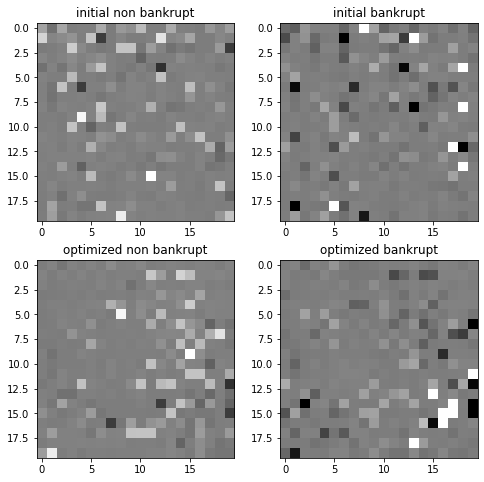


			-----FOLD 2 -----


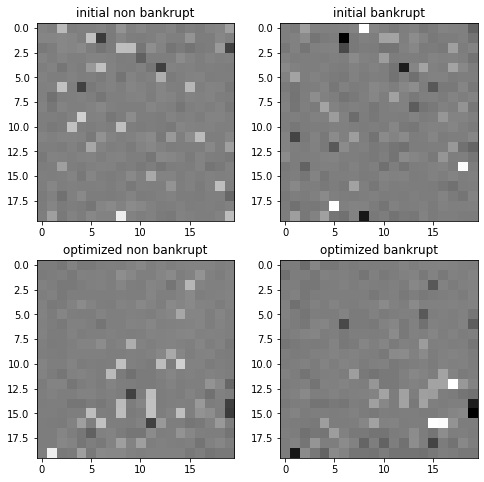


			-----FOLD 3 -----


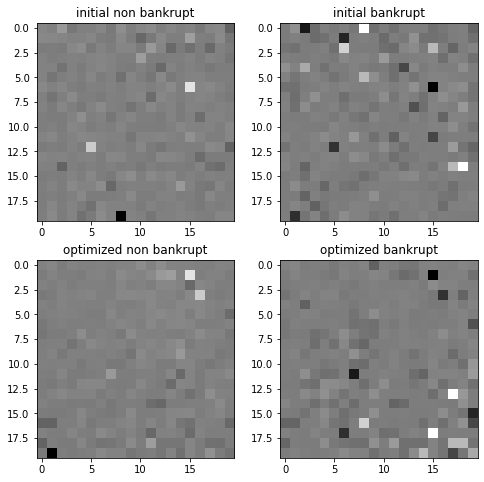


			-----FOLD 4 -----


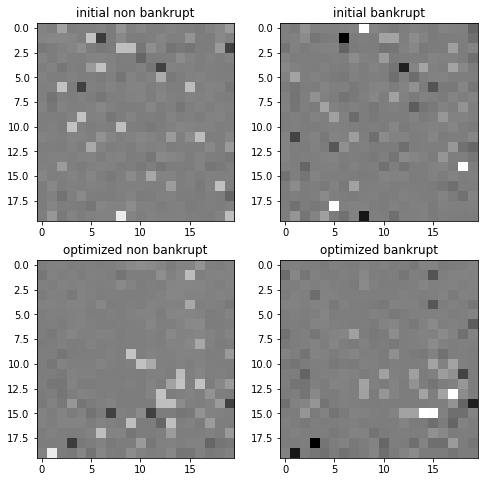


			-----FOLD 5 -----


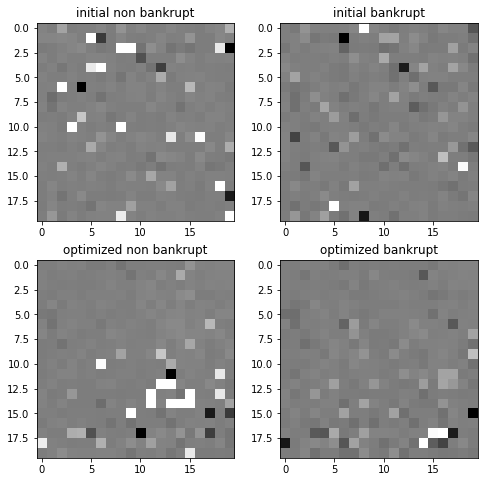


			-----FOLD 6 -----


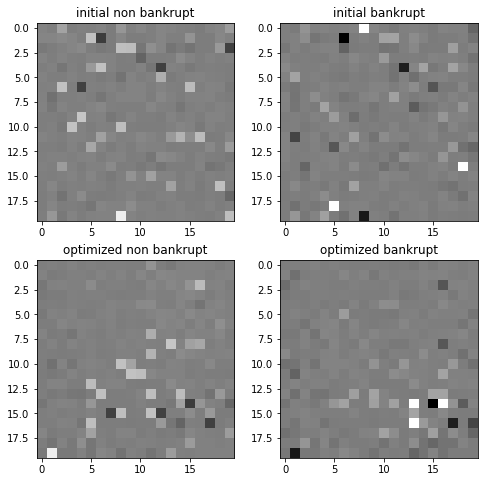

In [65]:
# printing images for normalization only
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t\t Normalization only")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=None, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

		 Normalization andquantile clipping

			-----FOLD 1 -----


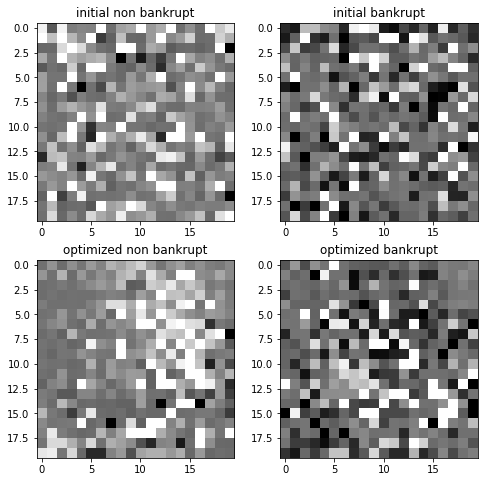


			-----FOLD 2 -----


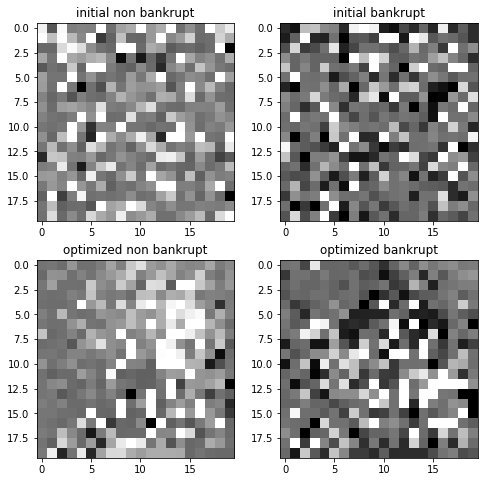


			-----FOLD 3 -----


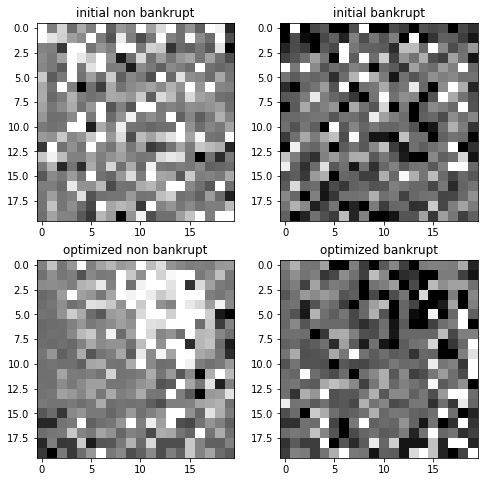


			-----FOLD 4 -----


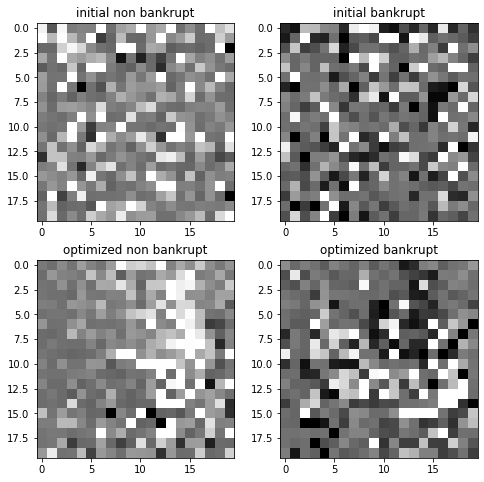


			-----FOLD 5 -----


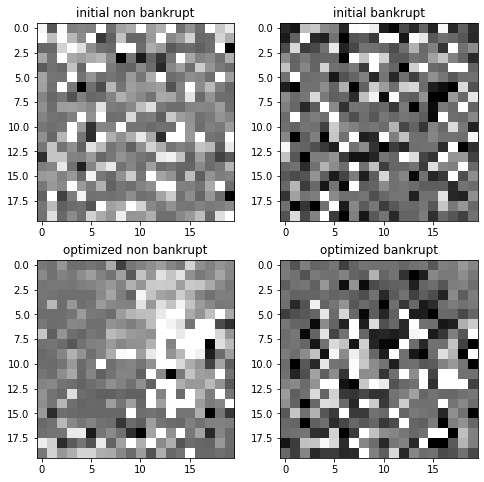


			-----FOLD 6 -----


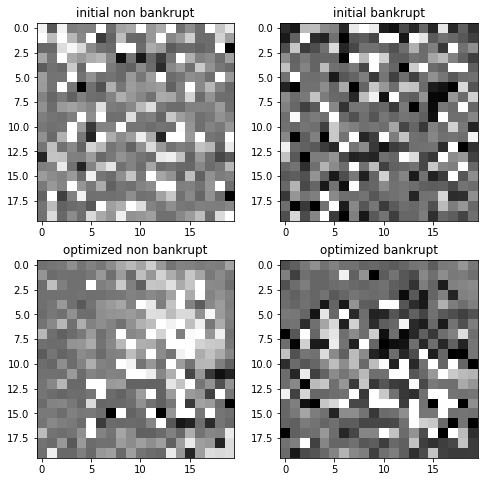

In [66]:
# printing images for normalization and quantile clipping
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t Normalization andquantile clipping")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

	 Normalization, quantile clipping and power transform

			-----FOLD 1 -----


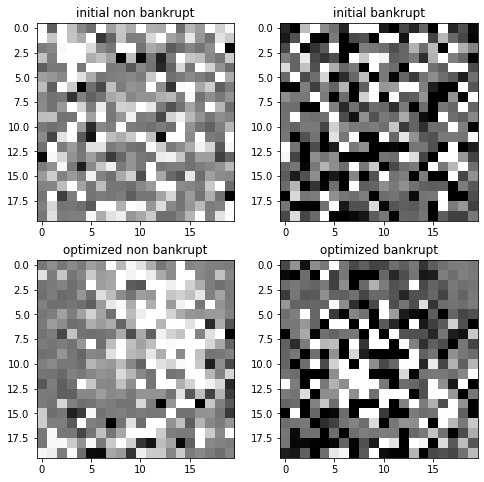


			-----FOLD 2 -----


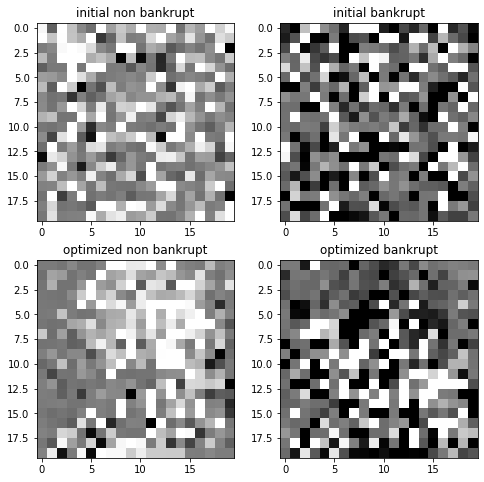


			-----FOLD 3 -----


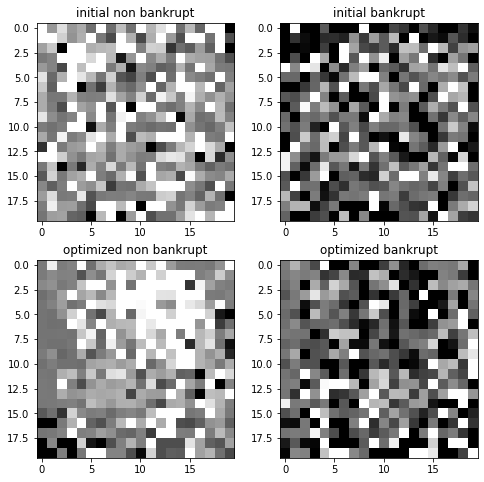


			-----FOLD 4 -----


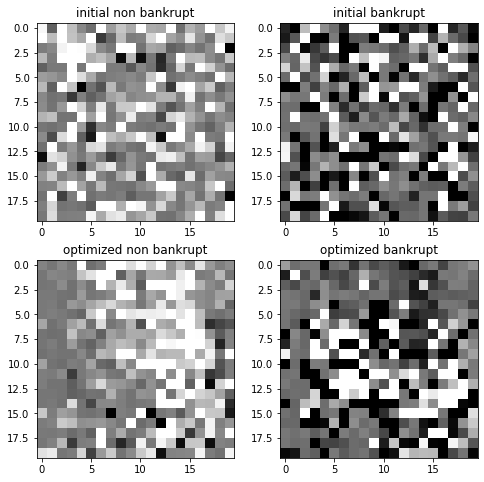


			-----FOLD 5 -----


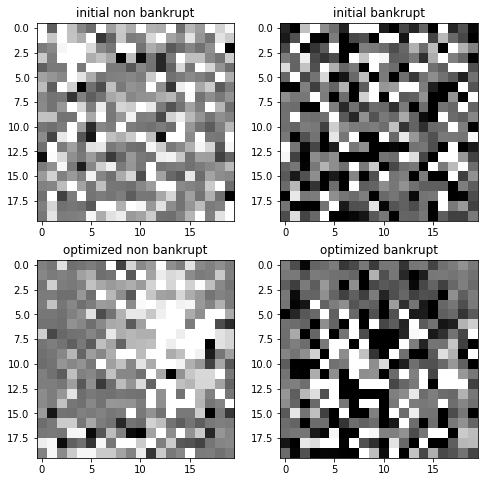


			-----FOLD 6 -----


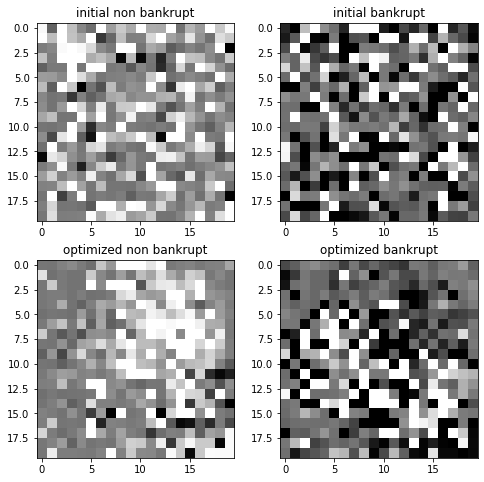

In [67]:
# printing images for normalization with quantile clipping and power transform
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t Normalization, quantile clipping and power transform")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=True)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

lets begin with the best 8x8 input model on 20x20 data
 - 150 epochs


----------
Fold: 1
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/150,
cumulative time: 6.3s train loss: 0.7137480429793953, validation loss: 0.5647581815719604
Epoch: 2/150,
cumulative time: 10.23s train loss: 0.5183422442539074, validation loss: 0.467246473574719
Epoch: 3/150,
cumulative time: 14.19s train loss: 0.4326857499078938, validation loss: 0.40627789846805196
Epoch: 4/150,
cumulative time: 18.13s train loss: 0.38679490239772985, validation loss: 0.3752546428693322
Epoch: 5/150,
cumulative time: 22.08s train loss: 0.3568791109490265, validation loss: 0.3453768701402821
Epoch: 6/150,
cumulative time: 26.06s train loss: 0.3319207733423056, validation loss: 0.34351966910593407
Epoch: 7/150,
cumulative time: 30.05s train loss: 0.32842556617158847, validation loss: 0.337275838502499
Epoch: 8/150,
cumulative time: 33.98s train loss: 0.3145276220239672, validation loss: 0.30534833226155533
Epoch: 9/150,
cumulative time: 37.92s train loss: 0.29675470189685643, validation loss: 0.29879309709069

Epoch: 77/150,
cumulative time: 306.97s train loss: 0.1744295066484798, validation loss: 0.18209734755613355
Epoch: 78/150,
cumulative time: 311.27s train loss: 0.17322774308763902, validation loss: 0.18704431331816224
Epoch: 79/150,
cumulative time: 315.26s train loss: 0.1743303921934392, validation loss: 0.18205164320842523
Epoch: 80/150,
cumulative time: 319.19s train loss: 0.17807680130381445, validation loss: 0.19228054967781333
Epoch: 81/150,
cumulative time: 323.23s train loss: 0.17201666003395719, validation loss: 0.18908784408311297
Epoch: 82/150,
cumulative time: 327.17s train loss: 0.1720650648355269, validation loss: 0.18416851019778677
Epoch: 83/150,
cumulative time: 331.11s train loss: 0.17515305383971452, validation loss: 0.18787071285212859
Epoch: 84/150,
cumulative time: 335.03s train loss: 0.172266855345037, validation loss: 0.20712248285499474
Epoch: 85/150,
cumulative time: 338.94s train loss: 0.1875167675988769, validation loss: 0.18400212806537158
Epoch: 86/150,
c

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/150,
cumulative time: 6.08s train loss: 0.7132895343570502, validation loss: 0.5580465645773972
Epoch: 2/150,
cumulative time: 10.01s train loss: 0.5181242356392881, validation loss: 0.46157953721022793
Epoch: 3/150,
cumulative time: 13.89s train loss: 0.4335606885193057, validation loss: 0.4011705607478218
Epoch: 4/150,
cumulative time: 17.8s train loss: 0.387371489757988, validation loss: 0.3713210057110233
Epoch: 5/150,
cumulative time: 21.73s train loss: 0.3588017707266962, validation loss: 0.34323034916816464
Epoch: 6/150,
cumulative time: 25.65s train loss: 0.331920002153419, validation loss: 0.3207357485506688
Epoch: 7/150,
cumulative time: 29.6s train loss: 0.31727957656936523, validation loss: 0.31066201914526026
Epoch: 8/150,
cumulative time: 33.56s train loss: 0.3075334384284295, validation loss: 0.2998724110432918
Epoch: 9/150,
cumulative time: 37.49s train loss: 0.29656875393074345, validation loss: 0.2924967210954045

Epoch: 77/150,
cumulative time: 317.86s train loss: 0.18301161962295698, validation loss: 0.1820693180687398
Epoch: 78/150,
cumulative time: 321.78s train loss: 0.18097006787112258, validation loss: 0.184069034413528
Epoch: 79/150,
cumulative time: 325.68s train loss: 0.18193432688713074, validation loss: 0.18215893744884779
Epoch: 80/150,
cumulative time: 329.65s train loss: 0.18560007201097503, validation loss: 0.18059771345863213
Epoch: 81/150,
cumulative time: 333.58s train loss: 0.1799048962548967, validation loss: 0.1805360235920619
Epoch: 82/150,
cumulative time: 337.5s train loss: 0.18448894508586464, validation loss: 0.18039460634768614
Epoch: 83/150,
cumulative time: 341.46s train loss: 0.18007581432884565, validation loss: 0.1799089262658875
Epoch: 84/150,
cumulative time: 345.37s train loss: 0.180674963230637, validation loss: 0.1789692660799962
Epoch: 85/150,
cumulative time: 349.28s train loss: 0.18300218523785955, validation loss: 0.1849219440540305
Epoch: 86/150,
cumula

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/150,
cumulative time: 6.38s train loss: 0.7104650355525826, validation loss: 0.5639996923749853
Epoch: 2/150,
cumulative time: 10.31s train loss: 0.5213401093541069, validation loss: 0.4628870737861754
Epoch: 3/150,
cumulative time: 14.58s train loss: 0.43566579122889776, validation loss: 0.40273007095330465
Epoch: 4/150,
cumulative time: 18.72s train loss: 0.38856622701786486, validation loss: 0.37323256006638655
Epoch: 5/150,
cumulative time: 22.67s train loss: 0.35743016022045687, validation loss: 0.345579775304375
Epoch: 6/150,
cumulative time: 26.67s train loss: 0.33495561824270964, validation loss: 0.3223326173616235
Epoch: 7/150,
cumulative time: 30.64s train loss: 0.3173516722873445, validation loss: 0.3144587290461733
Epoch: 8/150,
cumulative time: 34.56s train loss: 0.3071024992809184, validation loss: 0.30276396739576955
Epoch: 9/150,
cumulative time: 38.48s train loss: 0.2994344616947622, validation loss: 0.30542576528

Epoch: 76/150,
cumulative time: 304.8s train loss: 0.18075509380132282, validation loss: 0.19531298799202973
Epoch: 77/150,
cumulative time: 308.72s train loss: 0.17881652238082799, validation loss: 0.19556440384439042
Epoch: 78/150,
cumulative time: 312.66s train loss: 0.17831003162270204, validation loss: 0.1985017183365924
Epoch: 79/150,
cumulative time: 316.59s train loss: 0.1806153823564414, validation loss: 0.19448756897798924
Epoch: 80/150,
cumulative time: 320.55s train loss: 0.1778255258064838, validation loss: 0.19494392070184297
Epoch: 81/150,
cumulative time: 324.47s train loss: 0.17816724543483248, validation loss: 0.20441594111744688
Epoch: 82/150,
cumulative time: 328.43s train loss: 0.18541357208998194, validation loss: 0.1945222835933208
Epoch: 83/150,
cumulative time: 332.33s train loss: 0.17877163668079066, validation loss: 0.19633981531744207
Epoch: 84/150,
cumulative time: 336.29s train loss: 0.17918728585506283, validation loss: 0.19874222569898392
Epoch: 85/150,


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/150,
cumulative time: 6.02s train loss: 0.7181350065493137, validation loss: 0.5613428833253228
Epoch: 2/150,
cumulative time: 9.98s train loss: 0.5214727820915533, validation loss: 0.45995187187571557
Epoch: 3/150,
cumulative time: 14.02s train loss: 0.4349645465484678, validation loss: 0.39625669669351515
Epoch: 4/150,
cumulative time: 17.98s train loss: 0.3850691164962438, validation loss: 0.36395186838393284
Epoch: 5/150,
cumulative time: 21.93s train loss: 0.3568653366365633, validation loss: 0.33874928217978295
Epoch: 6/150,
cumulative time: 25.89s train loss: 0.33393279128087555, validation loss: 0.3313653193935584
Epoch: 7/150,
cumulative time: 29.9s train loss: 0.31591709373283944, validation loss: 0.3364841236352382
Epoch: 8/150,
cumulative time: 33.87s train loss: 0.3118353506431283, validation loss: 0.31025169254963875
Epoch: 9/150,
cumulative time: 37.85s train loss: 0.29709562463293004, validation loss: 0.29981689730

Epoch: 76/150,
cumulative time: 304.72s train loss: 0.17364596990129358, validation loss: 0.21533653523529087
Epoch: 77/150,
cumulative time: 308.7s train loss: 0.1743139072180386, validation loss: 0.2105951848404133
Epoch: 78/150,
cumulative time: 312.69s train loss: 0.17658270161347656, validation loss: 0.2149849769493258
Epoch: 79/150,
cumulative time: 316.64s train loss: 0.17502849944861942, validation loss: 0.20766788562991012
Epoch: 80/150,
cumulative time: 320.6s train loss: 0.17247674191156737, validation loss: 0.20833130056379073
Epoch: 81/150,
cumulative time: 324.54s train loss: 0.17300305903603308, validation loss: 0.20884960001801262
Epoch: 82/150,
cumulative time: 328.54s train loss: 0.17028858456000123, validation loss: 0.21453912091981744
Epoch: 83/150,
cumulative time: 332.52s train loss: 0.17765509462063453, validation loss: 0.21145776970391886
Epoch: 84/150,
cumulative time: 336.49s train loss: 0.17198696879751119, validation loss: 0.2149862524954514
Epoch: 85/150,
c

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/150,
cumulative time: 6.39s train loss: 0.7179068034372345, validation loss: 0.5655305618357174
Epoch: 2/150,
cumulative time: 10.32s train loss: 0.5225077612376391, validation loss: 0.46400261046385927
Epoch: 3/150,
cumulative time: 14.27s train loss: 0.4356776307969983, validation loss: 0.40084831339241955
Epoch: 4/150,
cumulative time: 18.2s train loss: 0.38844038021368177, validation loss: 0.3721736967563629
Epoch: 5/150,
cumulative time: 22.13s train loss: 0.36038707168812734, validation loss: 0.3435137530212747
Epoch: 6/150,
cumulative time: 26.14s train loss: 0.3370192511918554, validation loss: 0.3257612296743802
Epoch: 7/150,
cumulative time: 30.11s train loss: 0.322700680458543, validation loss: 0.3149445426248804
Epoch: 8/150,
cumulative time: 34.06s train loss: 0.3089296490579218, validation loss: 0.30894606639515465
Epoch: 9/150,
cumulative time: 38.04s train loss: 0.30495142462746755, validation loss: 0.2998874377181

Epoch: 76/150,
cumulative time: 304.83s train loss: 0.1756113630074721, validation loss: 0.1922849435233101
Epoch: 77/150,
cumulative time: 308.82s train loss: 0.17394675639139295, validation loss: 0.19179499041684325
Epoch: 78/150,
cumulative time: 312.79s train loss: 0.1738394529010597, validation loss: 0.1925414067695157
Epoch: 79/150,
cumulative time: 316.75s train loss: 0.17294053104427742, validation loss: 0.19138137710282818
Epoch: 80/150,
cumulative time: 320.8s train loss: 0.17238689305253635, validation loss: 0.20413451330656393
Epoch: 81/150,
cumulative time: 325.18s train loss: 0.17496656384608988, validation loss: 0.19117930464227906
Epoch: 82/150,
cumulative time: 329.27s train loss: 0.17332233409230283, validation loss: 0.1918884946651437
Epoch: 83/150,
cumulative time: 333.26s train loss: 0.17665640670304478, validation loss: 0.1898593520472335
Epoch: 84/150,
cumulative time: 337.21s train loss: 0.17746094075264146, validation loss: 0.20543579891761324
Epoch: 85/150,
cu

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/150,
cumulative time: 6.05s train loss: 0.7158782150577052, validation loss: 0.566164465574863
Epoch: 2/150,
cumulative time: 9.98s train loss: 0.5242113514527924, validation loss: 0.4630220918569285
Epoch: 3/150,
cumulative time: 13.96s train loss: 0.4380309194117993, validation loss: 0.40188475514911365
Epoch: 4/150,
cumulative time: 17.96s train loss: 0.3906506836454674, validation loss: 0.3714237758725814
Epoch: 5/150,
cumulative time: 21.98s train loss: 0.36311365881488955, validation loss: 0.34063121817720127
Epoch: 6/150,
cumulative time: 26.02s train loss: 0.3370769926771848, validation loss: 0.3153216552922742
Epoch: 7/150,
cumulative time: 30.05s train loss: 0.31828513945867376, validation loss: 0.29812256544492044
Epoch: 8/150,
cumulative time: 34.01s train loss: 0.3062195250083382, validation loss: 0.28897490942720366
Epoch: 9/150,
cumulative time: 37.97s train loss: 0.29688269037063414, validation loss: 0.283076855452

Epoch: 76/150,
cumulative time: 307.45s train loss: 0.18037452038647278, validation loss: 0.18382657801997312
Epoch: 77/150,
cumulative time: 311.52s train loss: 0.17752974229460775, validation loss: 0.18169265864395934
Epoch: 78/150,
cumulative time: 315.48s train loss: 0.17832853974169005, validation loss: 0.18385308244292947
Epoch: 79/150,
cumulative time: 319.47s train loss: 0.17850724311061028, validation loss: 0.18259455835442512
Epoch: 80/150,
cumulative time: 323.47s train loss: 0.1774332067873955, validation loss: 0.18009228916927061
Epoch: 81/150,
cumulative time: 327.45s train loss: 0.17709342986446133, validation loss: 0.18551820435857666
Epoch: 82/150,
cumulative time: 331.42s train loss: 0.18136557261527808, validation loss: 0.18121345495935487
Epoch: 83/150,
cumulative time: 335.43s train loss: 0.17774780860186268, validation loss: 0.18975156296725737
Epoch: 84/150,
cumulative time: 339.43s train loss: 0.179979114494285, validation loss: 0.21421057608138358
Epoch: 85/150

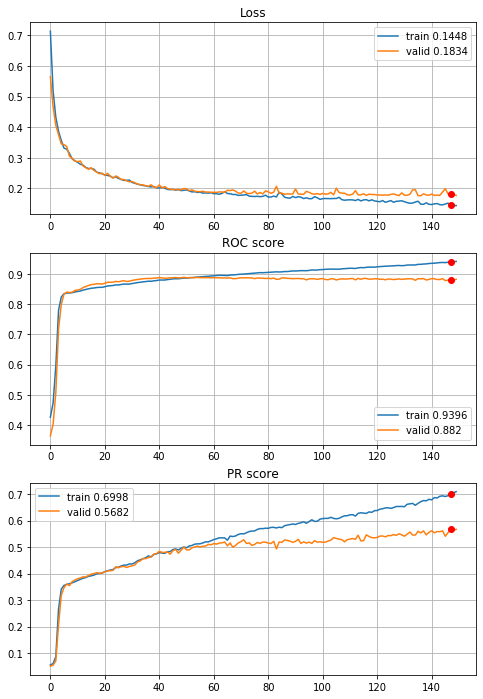


Fold 2------------------------------------------------------------


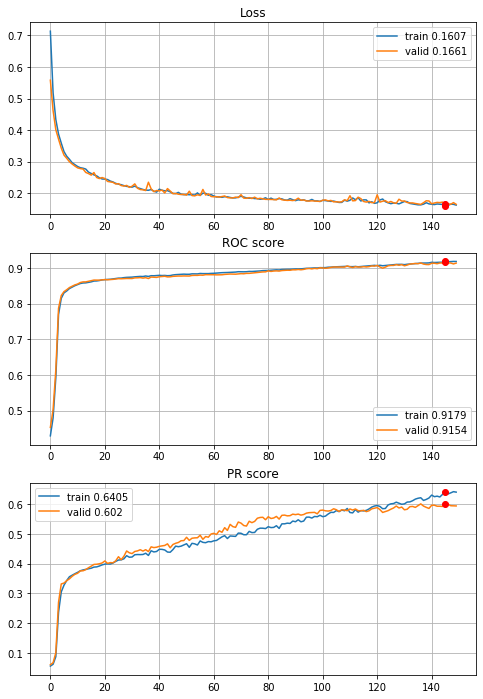


Fold 3------------------------------------------------------------


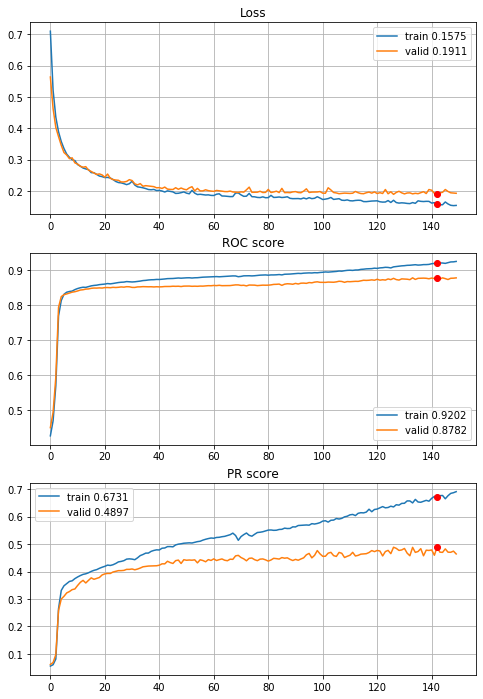


Fold 4------------------------------------------------------------


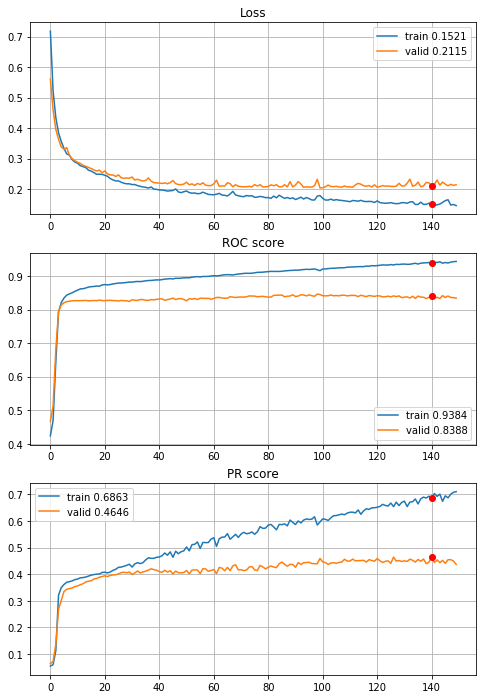


Fold 5------------------------------------------------------------


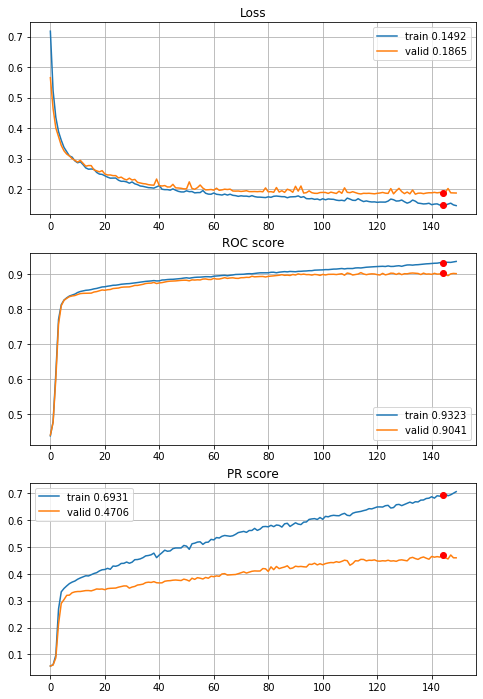


Fold 6------------------------------------------------------------


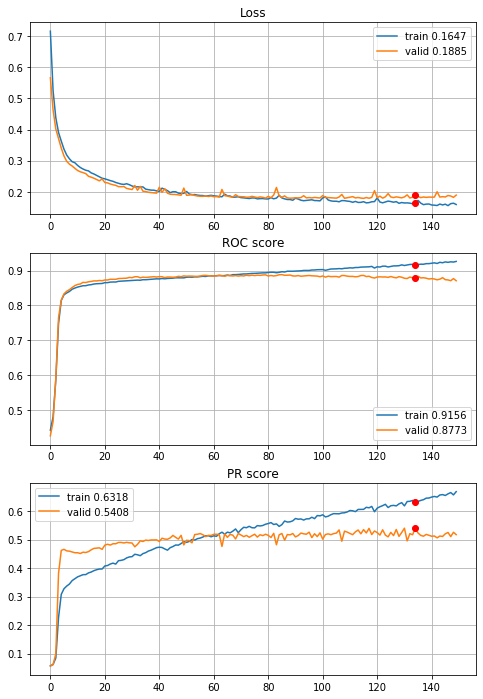

In [132]:
# model with one dense layer, 150 epochs
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L1_000025,
                                        features=features, target=target, n_epochs=150, batch_size=394, alpha=3,
                                        drafts=drafts_20x20["optimized_drafts"], instruction=instruction,
                                        random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\5year\define_deep_CNN_3inc_2dense_std_L1_0005_150ep_20x20.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Learning curves are increasing during whole training, early stopping wasn't applied, lets try more epochs, 300.


----------
Fold: 1
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/300,
cumulative time: 6.09s train loss: 0.7324517198471816, validation loss: 0.5746653159952217
Epoch: 2/300,
cumulative time: 10.05s train loss: 0.5242326829972465, validation loss: 0.47020016252792945
Epoch: 3/300,
cumulative time: 14.01s train loss: 0.43524941086553925, validation loss: 0.40826066095369373
Epoch: 4/300,
cumulative time: 18.0s train loss: 0.3889999583444225, validation loss: 0.3779342501448402
Epoch: 5/300,
cumulative time: 21.97s train loss: 0.35934083033285846, validation loss: 0.34788607858885773
Epoch: 6/300,
cumulative time: 26.0s train loss: 0.332877173185994, validation loss: 0.3434450544391705
Epoch: 7/300,
cumulative time: 30.04s train loss: 0.327454294632811, validation loss: 0.3368374903884789
Epoch: 8/300,
cumulative time: 34.23s train loss: 0.3177416138619938, validation loss: 0.3065003841409823
Epoch: 9/300,
cumulative time: 38.64s train loss: 0.30027938838577445, validation loss: 0.304666211801290

Epoch: 76/300,
cumulative time: 308.22s train loss: 0.17514451749165566, validation loss: 0.19029533668193366
Epoch: 77/300,
cumulative time: 312.19s train loss: 0.17575926714264098, validation loss: 0.18265610110128075
Epoch: 78/300,
cumulative time: 316.14s train loss: 0.1741681864438074, validation loss: 0.18773034522404397
Epoch: 79/300,
cumulative time: 320.14s train loss: 0.17550083150286966, validation loss: 0.18310852908228
Epoch: 80/300,
cumulative time: 324.13s train loss: 0.17939179872468597, validation loss: 0.19203421960688766
Epoch: 81/300,
cumulative time: 328.09s train loss: 0.17309892563559517, validation loss: 0.1900351526133775
Epoch: 82/300,
cumulative time: 332.05s train loss: 0.17308656971511643, validation loss: 0.18506483506860702
Epoch: 83/300,
cumulative time: 336.04s train loss: 0.1762393365550235, validation loss: 0.18935922446756245
Epoch: 84/300,
cumulative time: 340.02s train loss: 0.17395861397097256, validation loss: 0.20763115873801802
Epoch: 85/300,
c

Epoch: 151/300,
cumulative time: 609.03s train loss: 0.14358181052501667, validation loss: 0.17990212607813796
Epoch: 152/300,
cumulative time: 613.02s train loss: 0.1443359297448063, validation loss: 0.1749510899303731
Epoch: 153/300,
cumulative time: 616.98s train loss: 0.14433855906007845, validation loss: 0.18197010412157053
Epoch: 154/300,
cumulative time: 621.04s train loss: 0.14363691936976644, validation loss: 0.18494254735370902
Epoch: 155/300,
cumulative time: 625.06s train loss: 0.14841250065270314, validation loss: 0.21033654836549295
Epoch: 156/300,
cumulative time: 629.22s train loss: 0.1592297214705376, validation loss: 0.17826304473024882
Epoch: 157/300,
cumulative time: 633.74s train loss: 0.1521936256425045, validation loss: 0.17668953018836264
Epoch: 158/300,
cumulative time: 638.17s train loss: 0.14349208909359218, validation loss: 0.1964422081845992
Epoch: 159/300,
cumulative time: 642.25s train loss: 0.14902423606304593, validation loss: 0.17596110587324337
Epoch:

Epoch: 226/300,
cumulative time: 911.62s train loss: 0.10264472461335818, validation loss: 0.2021349444061417
Epoch: 227/300,
cumulative time: 915.61s train loss: 0.1069703262353094, validation loss: 0.20196071717354733
Epoch: 228/300,
cumulative time: 919.63s train loss: 0.09746986224958236, validation loss: 0.20134108344758644
Epoch: 229/300,
cumulative time: 923.6s train loss: 0.10148303770537519, validation loss: 0.20687857552472472
Epoch: 230/300,
cumulative time: 927.57s train loss: 0.09827736836088155, validation loss: 0.20603891081578837
Epoch: 231/300,
cumulative time: 931.57s train loss: 0.09741650403406646, validation loss: 0.20621887692738547
Epoch: 232/300,
cumulative time: 935.54s train loss: 0.09964211252837404, validation loss: 0.20095071693821448
Epoch: 233/300,
cumulative time: 939.51s train loss: 0.09493146618888697, validation loss: 0.21644935263856288
Epoch: 234/300,
cumulative time: 943.52s train loss: 0.10293957289469693, validation loss: 0.2116502824469376
Epoch

Epoch: 300/300,
cumulative time: 1209.43s train loss: 0.059256266931993117, validation loss: 0.2954344185659286

Early stopping results:
best results in epoch: 225, 
best valid PR: 0.619026832335316, 
valid ROC: 0.8742424242424243        
overfitting PR: 0.25994211883759655, 
overfitting ROC: 0.10527470141150919

----------
Fold: 2
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/300,
cumulative time: 6.26s train loss: 0.7263020513989434, validation loss: 0.566355259603954
Epoch: 2/300,
cumulative time: 10.29s train loss: 0.5242855178212431, validation loss: 0.4644700200071195
Epoch: 3/300,
cumulative time: 14.35s train loss: 0.4359234234835912, validation loss: 0.4022041871690159
Epoch: 4/300,
cumulative time: 18.45s train loss: 0.3878842921598078, validation loss: 0.3713031737753342
Epoch: 5/300,
cumulative time: 22.5s train loss: 0.3585897448476041, validation loss: 0.3422424427350183
Epoch: 6/300,
cumulative time: 26.57s train loss: 0.33154954343012094, validation loss: 0.3200974727160767
Epoch: 7/300,
cumulative time: 30.65s train loss: 0.317894743721838, validation loss: 0.309368717999711
Epoch: 8/300,
cumulative time: 34.7s train loss: 0.31122250010390573, validation loss: 0.30181582555964404
Epoch: 9/300,
cumulative time: 38.74s train loss: 0.2990490534621886, validation loss: 0.29366368337575316
E

Epoch: 77/300,
cumulative time: 319.44s train loss: 0.18340597836307454, validation loss: 0.18229609842096134
Epoch: 78/300,
cumulative time: 323.47s train loss: 0.18122683952996232, validation loss: 0.18534369896068378
Epoch: 79/300,
cumulative time: 327.52s train loss: 0.18212278789776756, validation loss: 0.18204545964651742
Epoch: 80/300,
cumulative time: 331.56s train loss: 0.18601079856042183, validation loss: 0.1810239353537425
Epoch: 81/300,
cumulative time: 335.64s train loss: 0.1804179705222161, validation loss: 0.18117313350738776
Epoch: 82/300,
cumulative time: 339.69s train loss: 0.18471402540426393, validation loss: 0.18091269537991306
Epoch: 83/300,
cumulative time: 343.78s train loss: 0.1805184411779315, validation loss: 0.18017242321368673
Epoch: 84/300,
cumulative time: 347.87s train loss: 0.18078279195669433, validation loss: 0.17933596442154323
Epoch: 85/300,
cumulative time: 351.96s train loss: 0.18300831508200738, validation loss: 0.18509317240693524
Epoch: 86/300

Epoch: 152/300,
cumulative time: 626.17s train loss: 0.15889435481374228, validation loss: 0.16333923284741372
Epoch: 153/300,
cumulative time: 630.22s train loss: 0.15861671225635154, validation loss: 0.1624017938921121
Epoch: 154/300,
cumulative time: 634.26s train loss: 0.1577960255855042, validation loss: 0.16432093191375324
Epoch: 155/300,
cumulative time: 638.28s train loss: 0.15918081551991967, validation loss: 0.16708190381325352
Epoch: 156/300,
cumulative time: 642.36s train loss: 0.16249910844927015, validation loss: 0.17566542134209712
Epoch: 157/300,
cumulative time: 646.43s train loss: 0.1609337782615036, validation loss: 0.16476197745714005
Epoch: 158/300,
cumulative time: 650.53s train loss: 0.16148655815218116, validation loss: 0.17834562362248357
Epoch: 159/300,
cumulative time: 654.58s train loss: 0.16766882626615492, validation loss: 0.17062211873297492
Epoch: 160/300,
cumulative time: 658.63s train loss: 0.16342540170042524, validation loss: 0.16521478838286244
Epoc

Epoch: 227/300,
cumulative time: 932.04s train loss: 0.12664282125915108, validation loss: 0.18992309225250661
Epoch: 228/300,
cumulative time: 936.1s train loss: 0.12254522804722244, validation loss: 0.19215423218158348
Epoch: 229/300,
cumulative time: 940.16s train loss: 0.11760199881269721, validation loss: 0.20135495046483354
Epoch: 230/300,
cumulative time: 944.28s train loss: 0.11909046593300379, validation loss: 0.17988945308572948
Epoch: 231/300,
cumulative time: 948.37s train loss: 0.11230985163660578, validation loss: 0.18780178980735943
Epoch: 232/300,
cumulative time: 952.45s train loss: 0.11869344105843173, validation loss: 0.18242309777551197
Epoch: 233/300,
cumulative time: 956.47s train loss: 0.11746445765873478, validation loss: 0.18808811491411997
Epoch: 234/300,
cumulative time: 960.9s train loss: 0.11361298066923657, validation loss: 0.1943345615869176
Epoch: 235/300,
cumulative time: 965.15s train loss: 0.11172455282619606, validation loss: 0.19639447536382493
Epoc

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/300,
cumulative time: 6.63s train loss: 0.6937225272724344, validation loss: 0.5583742641945703
Epoch: 2/300,
cumulative time: 10.66s train loss: 0.5171466220291298, validation loss: 0.4612360011362035
Epoch: 3/300,
cumulative time: 14.7s train loss: 0.43265680598922157, validation loss: 0.39953869171314604
Epoch: 4/300,
cumulative time: 18.73s train loss: 0.3836788373464712, validation loss: 0.36764026541586253
Epoch: 5/300,
cumulative time: 22.76s train loss: 0.3519736113504167, validation loss: 0.34204544888005045
Epoch: 6/300,
cumulative time: 26.81s train loss: 0.3309803630094236, validation loss: 0.32080992938700764
Epoch: 7/300,
cumulative time: 30.86s train loss: 0.3154576669047025, validation loss: 0.3124205467397223
Epoch: 8/300,
cumulative time: 34.95s train loss: 0.3048804407192912, validation loss: 0.3001076419498633
Epoch: 9/300,
cumulative time: 38.99s train loss: 0.2974225980118724, validation loss: 0.3029813286685

Epoch: 76/300,
cumulative time: 312.06s train loss: 0.1796292107727123, validation loss: 0.19512905551723322
Epoch: 77/300,
cumulative time: 316.1s train loss: 0.17773928879911505, validation loss: 0.19540561283723343
Epoch: 78/300,
cumulative time: 320.24s train loss: 0.1773520962331807, validation loss: 0.19807053492598764
Epoch: 79/300,
cumulative time: 324.26s train loss: 0.17950918756775047, validation loss: 0.19432583800700767
Epoch: 80/300,
cumulative time: 328.29s train loss: 0.17697512309339286, validation loss: 0.1948087380562721
Epoch: 81/300,
cumulative time: 332.31s train loss: 0.17709223995328166, validation loss: 0.20542240388095043
Epoch: 82/300,
cumulative time: 336.31s train loss: 0.18446363678154962, validation loss: 0.19375475130664455
Epoch: 83/300,
cumulative time: 340.35s train loss: 0.17765260156284385, validation loss: 0.19695687545998927
Epoch: 84/300,
cumulative time: 344.4s train loss: 0.17813253721780403, validation loss: 0.1988472507294297
Epoch: 85/300,
c

Epoch: 151/300,
cumulative time: 618.97s train loss: 0.14945036004085618, validation loss: 0.19573878769877262
Epoch: 152/300,
cumulative time: 623.02s train loss: 0.14737157564650588, validation loss: 0.20051204366976944
Epoch: 153/300,
cumulative time: 627.02s train loss: 0.1489384756003261, validation loss: 0.20668903868456434
Epoch: 154/300,
cumulative time: 631.02s train loss: 0.15033760831257603, validation loss: 0.18999836571187015
Epoch: 155/300,
cumulative time: 635.06s train loss: 0.14865922565077724, validation loss: 0.2025508108677966
Epoch: 156/300,
cumulative time: 639.07s train loss: 0.15266675661765172, validation loss: 0.19074831968498876
Epoch: 157/300,
cumulative time: 643.1s train loss: 0.14621875049472394, validation loss: 0.19612111887036746
Epoch: 158/300,
cumulative time: 647.09s train loss: 0.14361217029944115, validation loss: 0.19458596525963695
Epoch: 159/300,
cumulative time: 651.15s train loss: 0.14352979228599838, validation loss: 0.19249103496348843
Epoc

Epoch: 226/300,
cumulative time: 923.44s train loss: 0.10590955251256266, validation loss: 0.2170753700421386
Epoch: 227/300,
cumulative time: 927.49s train loss: 0.10308856474040648, validation loss: 0.21304361893466792
Epoch: 228/300,
cumulative time: 931.47s train loss: 0.10925180951489762, validation loss: 0.23549495251028219
Epoch: 229/300,
cumulative time: 935.52s train loss: 0.11641009935322436, validation loss: 0.21285950630197664
Epoch: 230/300,
cumulative time: 939.55s train loss: 0.11381735484912615, validation loss: 0.2403447846078819
Epoch: 231/300,
cumulative time: 943.58s train loss: 0.11019668790649637, validation loss: 0.22614230514580663
Epoch: 232/300,
cumulative time: 947.62s train loss: 0.10216440936879992, validation loss: 0.2194322750493128
Epoch: 233/300,
cumulative time: 951.63s train loss: 0.10499180135542413, validation loss: 0.2174159189961271
Epoch: 234/300,
cumulative time: 955.64s train loss: 0.1062437626987104, validation loss: 0.22240049073634313
Epoch:

Epoch: 300/300,
cumulative time: 1223.65s train loss: 0.058294709092712144, validation loss: 0.3031395651240494

Early stopping results:
best results in epoch: 241, 
best valid PR: 0.5151528535787285, 
valid ROC: 0.8837341153470186        
overfitting PR: 0.36098663149141863, 
overfitting ROC: 0.09661925549495154

----------
Fold: 4
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/300,
cumulative time: 6.12s train loss: 0.6978892600081883, validation loss: 0.5533131974545343
Epoch: 2/300,
cumulative time: 10.16s train loss: 0.5164226544863372, validation loss: 0.45630212817719507
Epoch: 3/300,
cumulative time: 14.53s train loss: 0.4317606596653063, validation loss: 0.39278440429717637
Epoch: 4/300,
cumulative time: 18.77s train loss: 0.38118909257355915, validation loss: 0.3596702574607212
Epoch: 5/300,
cumulative time: 22.9s train loss: 0.35139101839834647, validation loss: 0.33540576777124514
Epoch: 6/300,
cumulative time: 26.97s train loss: 0.33051553790762384, validation loss: 0.3309842903108145
Epoch: 7/300,
cumulative time: 31.02s train loss: 0.31344199738598233, validation loss: 0.3332819181155943
Epoch: 8/300,
cumulative time: 35.07s train loss: 0.3096850282743072, validation loss: 0.30995918093900915
Epoch: 9/300,
cumulative time: 39.12s train loss: 0.2950399124323851, validation loss: 0.2977636910

Epoch: 76/300,
cumulative time: 318.73s train loss: 0.17262155773568147, validation loss: 0.21618689142554393
Epoch: 77/300,
cumulative time: 323.29s train loss: 0.1730530073350691, validation loss: 0.2104342515258703
Epoch: 78/300,
cumulative time: 327.65s train loss: 0.1750139537253311, validation loss: 0.21650912708541878
Epoch: 79/300,
cumulative time: 331.79s train loss: 0.1734906118602643, validation loss: 0.20816784484930018
Epoch: 80/300,
cumulative time: 336.01s train loss: 0.17259580954764783, validation loss: 0.2088237887849657
Epoch: 81/300,
cumulative time: 340.27s train loss: 0.17276536784066107, validation loss: 0.20858221210152517
Epoch: 82/300,
cumulative time: 344.52s train loss: 0.1691709454794272, validation loss: 0.2155066148691199
Epoch: 83/300,
cumulative time: 348.84s train loss: 0.1765616744228956, validation loss: 0.2120647887882207
Epoch: 84/300,
cumulative time: 353.06s train loss: 0.17076956921927472, validation loss: 0.2136931062148333
Epoch: 85/300,
cumul

Epoch: 151/300,
cumulative time: 629.34s train loss: 0.14557303135641914, validation loss: 0.22010762478239648
Epoch: 152/300,
cumulative time: 633.44s train loss: 0.15662240694318377, validation loss: 0.2132003610411293
Epoch: 153/300,
cumulative time: 637.5s train loss: 0.1434100658498148, validation loss: 0.22231202463264121
Epoch: 154/300,
cumulative time: 641.58s train loss: 0.1455148826455145, validation loss: 0.21702675097548396
Epoch: 155/300,
cumulative time: 645.64s train loss: 0.1436164289269199, validation loss: 0.24080188000578912
Epoch: 156/300,
cumulative time: 649.7s train loss: 0.1516866586781398, validation loss: 0.21195169452485327
Epoch: 157/300,
cumulative time: 653.73s train loss: 0.1400973027785906, validation loss: 0.21870776095993094
Epoch: 158/300,
cumulative time: 657.85s train loss: 0.1380120119268607, validation loss: 0.22189630887578357
Epoch: 159/300,
cumulative time: 661.94s train loss: 0.14111145149967672, validation loss: 0.24098758836766668
Epoch: 160

Epoch: 226/300,
cumulative time: 942.54s train loss: 0.098112325211989, validation loss: 0.26686859208224323
Epoch: 227/300,
cumulative time: 947.05s train loss: 0.10417092322106558, validation loss: 0.26622124113832046
Epoch: 228/300,
cumulative time: 951.48s train loss: 0.09909477709762511, validation loss: 0.2663452061519666
Epoch: 229/300,
cumulative time: 955.57s train loss: 0.10555999894127899, validation loss: 0.2625415991512432
Epoch: 230/300,
cumulative time: 959.66s train loss: 0.10956222237420356, validation loss: 0.2849104573979604
Epoch: 231/300,
cumulative time: 963.76s train loss: 0.10834751465560996, validation loss: 0.267985223681071
Epoch: 232/300,
cumulative time: 967.84s train loss: 0.10425726434070101, validation loss: 0.26044021684752094
Epoch: 233/300,
cumulative time: 972.04s train loss: 0.09941284427914694, validation loss: 0.2731305472468684
Epoch: 234/300,
cumulative time: 976.5s train loss: 0.10049464963183241, validation loss: 0.26724163447895655
Epoch: 235

Epoch: 300/300,
cumulative time: 1249.49s train loss: 0.06065582005593219, validation loss: 0.3808413902066362

Early stopping results:
best results in epoch: 169, 
best valid PR: 0.4685172545335305, 
valid ROC: 0.833224043715847        
overfitting PR: 0.2787578147151469, 
overfitting ROC: 0.11947095825188225

----------
Fold: 5
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/300,
cumulative time: 6.54s train loss: 0.702330407092191, validation loss: 0.5575863058357152
Epoch: 2/300,
cumulative time: 10.57s train loss: 0.5164801598254053, validation loss: 0.46010435710642195
Epoch: 3/300,
cumulative time: 14.57s train loss: 0.432535640063416, validation loss: 0.39907285981468904
Epoch: 4/300,
cumulative time: 18.67s train loss: 0.38708809435623054, validation loss: 0.3717879644231387
Epoch: 5/300,
cumulative time: 22.71s train loss: 0.36102043744701845, validation loss: 0.3445724655220256
Epoch: 6/300,
cumulative time: 26.76s train loss: 0.33830372703121125, validation loss: 0.3251376890032878
Epoch: 7/300,
cumulative time: 30.8s train loss: 0.32389597784658064, validation loss: 0.31340107072825896
Epoch: 8/300,
cumulative time: 34.86s train loss: 0.3084002909503294, validation loss: 0.31311643675272405
Epoch: 9/300,
cumulative time: 38.89s train loss: 0.3041341315535587, validation loss: 0.300042885757

Epoch: 76/300,
cumulative time: 313.17s train loss: 0.17498774128360348, validation loss: 0.19057848538286798
Epoch: 77/300,
cumulative time: 317.22s train loss: 0.17327542603352042, validation loss: 0.18992531017040828
Epoch: 78/300,
cumulative time: 321.36s train loss: 0.17354965517194443, validation loss: 0.19183927777793014
Epoch: 79/300,
cumulative time: 325.39s train loss: 0.1725528283868663, validation loss: 0.18969687365382304
Epoch: 80/300,
cumulative time: 329.41s train loss: 0.17158511292106166, validation loss: 0.20094641071006353
Epoch: 81/300,
cumulative time: 333.45s train loss: 0.17385219762590434, validation loss: 0.1891511774560937
Epoch: 82/300,
cumulative time: 337.47s train loss: 0.17208622869615922, validation loss: 0.18908051470332438
Epoch: 83/300,
cumulative time: 341.54s train loss: 0.1767037381457336, validation loss: 0.1869746462755225
Epoch: 84/300,
cumulative time: 345.57s train loss: 0.1763328530302764, validation loss: 0.20024803583562778
Epoch: 85/300,


Epoch: 151/300,
cumulative time: 617.42s train loss: 0.14408915945888237, validation loss: 0.19172090278522155
Epoch: 152/300,
cumulative time: 621.44s train loss: 0.14482156163261783, validation loss: 0.1889632812472014
Epoch: 153/300,
cumulative time: 625.47s train loss: 0.14924147336021276, validation loss: 0.2056315239880478
Epoch: 154/300,
cumulative time: 629.5s train loss: 0.1506453873495095, validation loss: 0.1895030454372983
Epoch: 155/300,
cumulative time: 633.52s train loss: 0.15119257407124684, validation loss: 0.18287742787101738
Epoch: 156/300,
cumulative time: 637.59s train loss: 0.1569133018152509, validation loss: 0.19762741422814656
Epoch: 157/300,
cumulative time: 641.69s train loss: 0.14918879086616854, validation loss: 0.1817276418612719
Epoch: 158/300,
cumulative time: 645.7s train loss: 0.14756190638502645, validation loss: 0.18459173925977798
Epoch: 159/300,
cumulative time: 649.71s train loss: 0.14527328193066702, validation loss: 0.19195193048928177
Epoch: 16

Epoch: 226/300,
cumulative time: 922.28s train loss: 0.10343098344469134, validation loss: 0.21728311469000564
Epoch: 227/300,
cumulative time: 926.32s train loss: 0.09898803261596732, validation loss: 0.21952330645669932
Epoch: 228/300,
cumulative time: 930.35s train loss: 0.09896927797516017, validation loss: 0.22677971059393398
Epoch: 229/300,
cumulative time: 934.38s train loss: 0.1025947329961982, validation loss: 0.2182076203029258
Epoch: 230/300,
cumulative time: 938.39s train loss: 0.09511573321591267, validation loss: 0.2684967581426586
Epoch: 231/300,
cumulative time: 942.44s train loss: 0.10473786667913716, validation loss: 0.23151421506571715
Epoch: 232/300,
cumulative time: 946.48s train loss: 0.09851410116066708, validation loss: 0.23440832067827608
Epoch: 233/300,
cumulative time: 950.51s train loss: 0.0969876540001644, validation loss: 0.2248042989059711
Epoch: 234/300,
cumulative time: 954.55s train loss: 0.09449529050335291, validation loss: 0.22385082119743657
Epoch:

Epoch: 300/300,
cumulative time: 1223.93s train loss: 0.05436721960779724, validation loss: 0.31083526511090065

Early stopping results:
best results in epoch: 185, 
best valid PR: 0.48572921230734806, 
valid ROC: 0.8972677595628415        
overfitting PR: 0.2991881254826391, 
overfitting ROC: 0.05749178392397458

----------
Fold: 6
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/300,
cumulative time: 6.36s train loss: 0.7158782150577052, validation loss: 0.566164465574863
Epoch: 2/300,
cumulative time: 10.88s train loss: 0.5242113514527924, validation loss: 0.4630220918569285
Epoch: 3/300,
cumulative time: 15.09s train loss: 0.4380309194117993, validation loss: 0.40188475514911365
Epoch: 4/300,
cumulative time: 19.19s train loss: 0.3906506836454674, validation loss: 0.3714237758725814
Epoch: 5/300,
cumulative time: 23.26s train loss: 0.36311365881488955, validation loss: 0.34063121817720127
Epoch: 6/300,
cumulative time: 27.38s train loss: 0.3370769926771848, validation loss: 0.3153216552922742
Epoch: 7/300,
cumulative time: 31.49s train loss: 0.31828513945867376, validation loss: 0.29812256544492044
Epoch: 8/300,
cumulative time: 35.55s train loss: 0.3062195250083382, validation loss: 0.28897490942720366
Epoch: 9/300,
cumulative time: 39.66s train loss: 0.29688308114207357, validation loss: 0.28307519029

Epoch: 76/300,
cumulative time: 316.3s train loss: 0.18040617978414186, validation loss: 0.18378575566659933
Epoch: 77/300,
cumulative time: 320.38s train loss: 0.17755372531690206, validation loss: 0.18163784359567053
Epoch: 78/300,
cumulative time: 324.49s train loss: 0.1784738618372096, validation loss: 0.18400365390034884
Epoch: 79/300,
cumulative time: 328.61s train loss: 0.17857191018708102, validation loss: 0.18226316093591213
Epoch: 80/300,
cumulative time: 332.71s train loss: 0.17745822214284276, validation loss: 0.18012453225477015
Epoch: 81/300,
cumulative time: 336.82s train loss: 0.17704191552498205, validation loss: 0.1862974041404358
Epoch: 82/300,
cumulative time: 340.9s train loss: 0.18173542913547788, validation loss: 0.18221396285174393
Epoch: 83/300,
cumulative time: 345.03s train loss: 0.17673562305918294, validation loss: 0.18937582564676858
Epoch: 84/300,
cumulative time: 349.19s train loss: 0.17996510401781596, validation loss: 0.2138838059611568
Epoch: 85/300,


Epoch: 151/300,
cumulative time: 625.72s train loss: 0.15380991262545737, validation loss: 0.18590010547880126
Epoch: 152/300,
cumulative time: 629.91s train loss: 0.15196358202247567, validation loss: 0.19504427543208508
Epoch: 153/300,
cumulative time: 634.03s train loss: 0.15557017778532783, validation loss: 0.18391928443386646
Epoch: 154/300,
cumulative time: 638.22s train loss: 0.15194730005171775, validation loss: 0.1876449587315523
Epoch: 155/300,
cumulative time: 642.34s train loss: 0.15280164192505677, validation loss: 0.18855478828163233
Epoch: 156/300,
cumulative time: 646.45s train loss: 0.1556664798219667, validation loss: 0.18613402754001102
Epoch: 157/300,
cumulative time: 650.57s train loss: 0.15083714521296965, validation loss: 0.1934959351949175
Epoch: 158/300,
cumulative time: 654.66s train loss: 0.15252388362996927, validation loss: 0.1918752782769989
Epoch: 159/300,
cumulative time: 658.74s train loss: 0.15065414380696457, validation loss: 0.19252762951915475
Epoch

Epoch: 226/300,
cumulative time: 936.23s train loss: 0.11630006666286197, validation loss: 0.21361856202912385
Epoch: 227/300,
cumulative time: 940.35s train loss: 0.10898967958548095, validation loss: 0.22155091691232429
Epoch: 228/300,
cumulative time: 944.42s train loss: 0.10730078221947298, validation loss: 0.21606024588472955
Epoch: 229/300,
cumulative time: 948.5s train loss: 0.10833976848209359, validation loss: 0.21435200327136986
Epoch: 230/300,
cumulative time: 952.63s train loss: 0.1109521893035228, validation loss: 0.242656843690517
Epoch: 231/300,
cumulative time: 956.73s train loss: 0.11431386108501163, validation loss: 0.2312160528540342
Epoch: 232/300,
cumulative time: 960.82s train loss: 0.11386833342114502, validation loss: 0.22823932602093397
Epoch: 233/300,
cumulative time: 965.02s train loss: 0.11229103906998214, validation loss: 0.21355283452075977
Epoch: 234/300,
cumulative time: 969.49s train loss: 0.10543753770103365, validation loss: 0.22318430571200884
Epoch:

Epoch: 300/300,
cumulative time: 1241.22s train loss: 0.07504617719968393, validation loss: 0.31079345443716977

Early stopping results:
best results in epoch: 134, 
best valid PR: 0.5424792842129903, 
valid ROC: 0.8800993541977148        
overfitting PR: 0.0932500824131477, 
overfitting ROC: 0.03734102360629932

Cross validation time: 7535s
ROC: 		0.8805384089440146
PR: 		0.5416792868475164
overfittingROC: 0.07397049882311046
overfittingPR:  0.23327369779588103
early stopping: [225, 192, 241, 169, 185, 134]

Fold 1------------------------------------------------------------


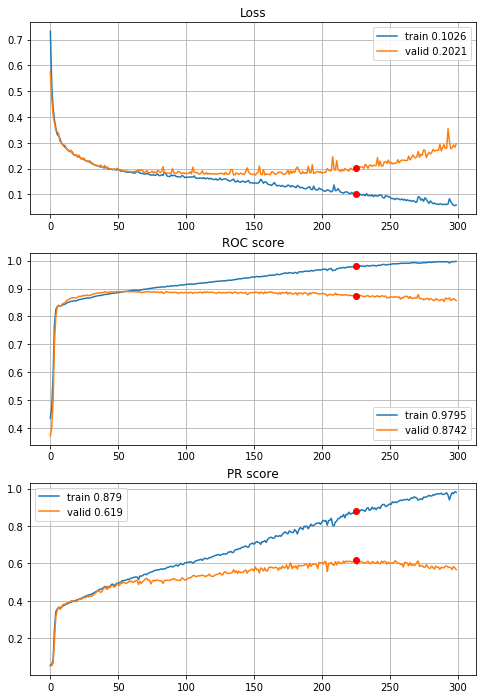


Fold 2------------------------------------------------------------


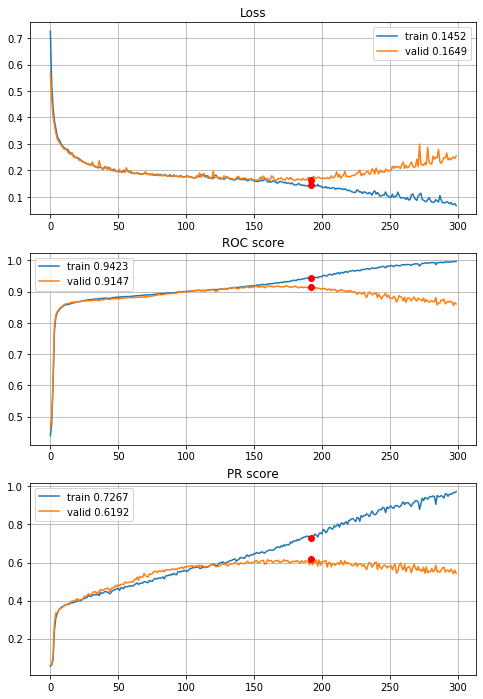


Fold 3------------------------------------------------------------


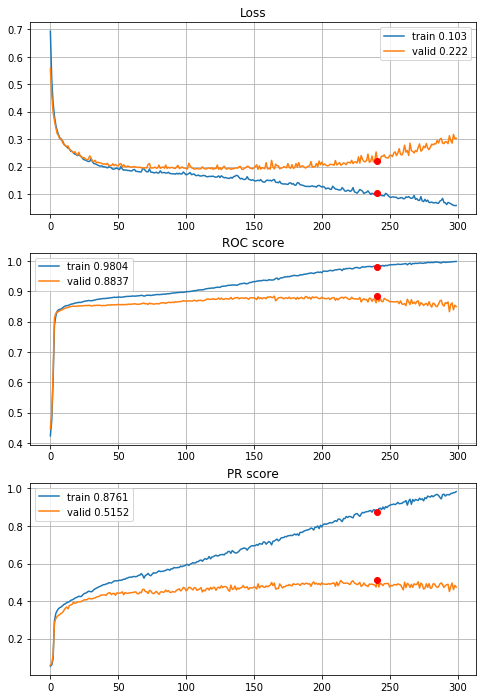


Fold 4------------------------------------------------------------


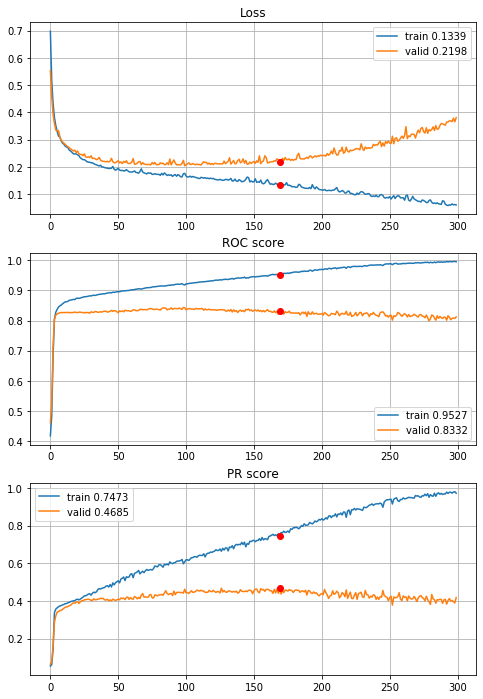


Fold 5------------------------------------------------------------


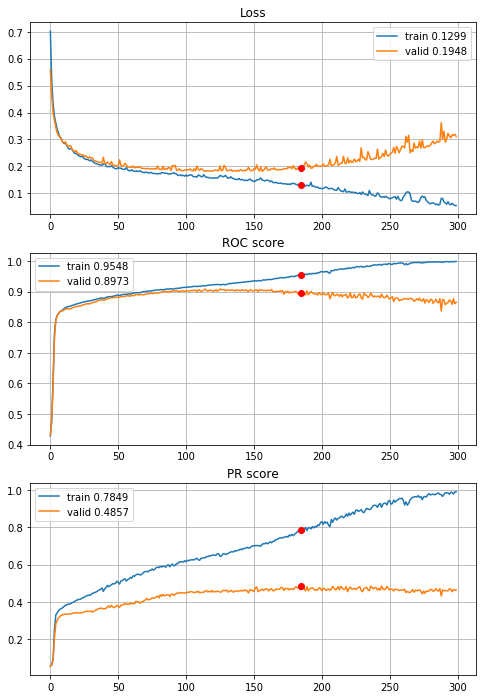


Fold 6------------------------------------------------------------


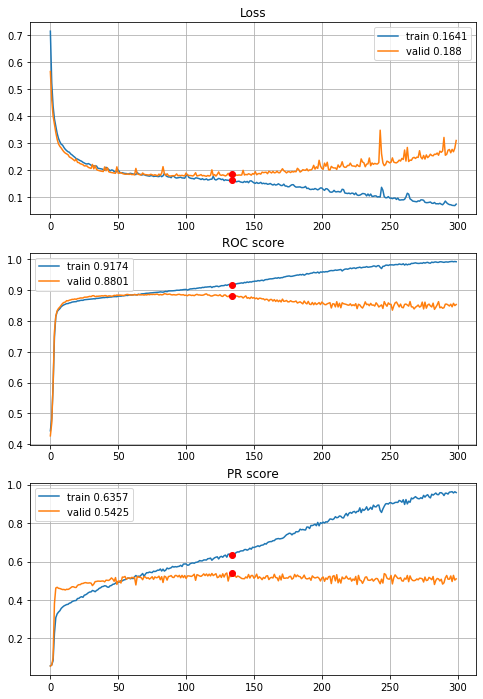

In [134]:
# model with one dense layer, 300 epochs
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L1_000025,
                                        features=features, target=target, n_epochs=300, batch_size=394, alpha=3,
                                        drafts=drafts_20x20["optimized_drafts"], instruction=instruction,
                                        random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\5year\define_deep_CNN_3inc_2dense_std_L1_0005_300ep_20x20.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Lets add max pooling after second inception and one more more inception, and enlarge dense layer.

In [68]:
def define_deep_CNN_2inc_max_inc_L1_000025(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (20,20,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (20,20,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (20,20,32)
    pool = layers.MaxPooling2D(pool_size=(2,2), strides=(1,1), padding="valid")(inception)              # (19,19,32)
    inception = inception_module(prev_layer=pool, f1=12, f2_in=6, f2_out=12, f3_in=6, f3_out=12,
                                 f4_out=12, random_state=random_state)                                  # (19,19,48)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (9,9,48)
    flat = layers.Flatten()(pool)                                                                       # (3888,)
    dense = layers.Dense(units=216, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.000025))(flat)                          # (216,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/220,
cumulative time: 12.13s train loss: 0.656336391795198, validation loss: 0.5500959458990861
Epoch: 2/220,
cumulative time: 20.27s train loss: 0.4941059265837127, validation loss: 0.44342241406843924
Epoch: 3/220,
cumulative time: 28.28s train loss: 0.410748890322038, validation loss: 0.388222968564899
Epoch: 4/220,
cumulative time: 37.12s train loss: 0.36951544789415836, validation loss: 0.35784701107588535
Epoch: 5/220,
cumulative time: 45.2s train loss: 0.3381005596463646, validation loss: 0.32775135692775986
Epoch: 6/220,
cumulative time: 53.25s train loss: 0.31137784965847376, validation loss: 0.33407319411887393
Epoch: 7/220,
cumulative time: 61.28s train loss: 0.3026867435323848, validation loss: 0.29375966466131714
Epoch: 8/220,
cumulative time: 69.26s train loss: 0.2946348609503641, validation loss: 0.3033708288274462
Epoch: 9/220,
cumulative time: 77.29s train loss: 0.28313727686954965, validation loss: 0.292896702196

Epoch: 76/220,
cumulative time: 619.72s train loss: 0.1708756703278218, validation loss: 0.19594522810036058
Epoch: 77/220,
cumulative time: 627.76s train loss: 0.1720636426689715, validation loss: 0.18863594179223328
Epoch: 78/220,
cumulative time: 635.8s train loss: 0.17151775473345487, validation loss: 0.19376050800992242
Epoch: 79/220,
cumulative time: 643.86s train loss: 0.17268534843214797, validation loss: 0.19120350100410832
Epoch: 80/220,
cumulative time: 651.89s train loss: 0.1767477037936503, validation loss: 0.19949441795419007
Epoch: 81/220,
cumulative time: 659.9s train loss: 0.16902850344373646, validation loss: 0.19385620976851783
Epoch: 82/220,
cumulative time: 667.97s train loss: 0.1709939164146512, validation loss: 0.19521620923394953
Epoch: 83/220,
cumulative time: 675.99s train loss: 0.1744386800211797, validation loss: 0.20210964638391235
Epoch: 84/220,
cumulative time: 684.0s train loss: 0.17188069857119007, validation loss: 0.2089801880592961
Epoch: 85/220,
cumu

Epoch: 151/220,
cumulative time: 1230.1s train loss: 0.12963804214964167, validation loss: 0.2121247922184771
Epoch: 152/220,
cumulative time: 1238.13s train loss: 0.12895758350174671, validation loss: 0.2151099649901589
Epoch: 153/220,
cumulative time: 1246.21s train loss: 0.12448267703909521, validation loss: 0.2237357465800196
Epoch: 154/220,
cumulative time: 1254.26s train loss: 0.12494402097047236, validation loss: 0.22217098570595734
Epoch: 155/220,
cumulative time: 1262.33s train loss: 0.12288586491725613, validation loss: 0.26262808474370836
Epoch: 156/220,
cumulative time: 1270.34s train loss: 0.1407072778710497, validation loss: 0.23986111347812408
Epoch: 157/220,
cumulative time: 1278.39s train loss: 0.1371759419743012, validation loss: 0.24438457303547134
Epoch: 158/220,
cumulative time: 1286.43s train loss: 0.13034740875774342, validation loss: 0.21919538829950228
Epoch: 159/220,
cumulative time: 1294.54s train loss: 0.12650236154869468, validation loss: 0.2183495242539226

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/220,
cumulative time: 10.99s train loss: 0.6619464356976726, validation loss: 0.5449660926418886
Epoch: 2/220,
cumulative time: 19.15s train loss: 0.4947007333436167, validation loss: 0.440325718956843
Epoch: 3/220,
cumulative time: 27.24s train loss: 0.41070381944683054, validation loss: 0.3798944170606714
Epoch: 4/220,
cumulative time: 35.42s train loss: 0.3636974222716011, validation loss: 0.34760528322405854
Epoch: 5/220,
cumulative time: 43.57s train loss: 0.33285263726750003, validation loss: 0.3207601116972281
Epoch: 6/220,
cumulative time: 51.81s train loss: 0.30966534279959296, validation loss: 0.30157254789163185
Epoch: 7/220,
cumulative time: 59.91s train loss: 0.29590331643335654, validation loss: 0.2973760270346649
Epoch: 8/220,
cumulative time: 68.08s train loss: 0.29435682856891343, validation loss: 0.29435498654640785
Epoch: 9/220,
cumulative time: 76.3s train loss: 0.2803079249868539, validation loss: 0.2794037212

Epoch: 76/220,
cumulative time: 628.43s train loss: 0.17039275773219253, validation loss: 0.1802297014461698
Epoch: 77/220,
cumulative time: 636.55s train loss: 0.16927781038066972, validation loss: 0.17723551866301285
Epoch: 78/220,
cumulative time: 644.63s train loss: 0.1686259477100056, validation loss: 0.17758057998092225
Epoch: 79/220,
cumulative time: 652.72s train loss: 0.1719364174893832, validation loss: 0.17698662157728007
Epoch: 80/220,
cumulative time: 660.95s train loss: 0.17828248714227968, validation loss: 0.17739179122273252
Epoch: 81/220,
cumulative time: 669.71s train loss: 0.16705803281967174, validation loss: 0.1791253092088721
Epoch: 82/220,
cumulative time: 678.51s train loss: 0.16942746036211936, validation loss: 0.17601303655439998
Epoch: 83/220,
cumulative time: 687.89s train loss: 0.16448209462317534, validation loss: 0.17518858793018366
Epoch: 84/220,
cumulative time: 698.62s train loss: 0.16586639888127358, validation loss: 0.1756779060624498
Epoch: 85/220,


Epoch: 151/220,
cumulative time: 1268.88s train loss: 0.11159086660465178, validation loss: 0.20279660019624596
Epoch: 152/220,
cumulative time: 1277.21s train loss: 0.10953689777436884, validation loss: 0.19582488430661843
Epoch: 153/220,
cumulative time: 1285.61s train loss: 0.10928648509865203, validation loss: 0.19524775272426367
Epoch: 154/220,
cumulative time: 1293.88s train loss: 0.1075036678335458, validation loss: 0.2300489408288491
Epoch: 155/220,
cumulative time: 1302.22s train loss: 0.11730990825483192, validation loss: 0.208616770375541
Epoch: 156/220,
cumulative time: 1310.54s train loss: 0.1243376752280963, validation loss: 0.19025359416155832
Epoch: 157/220,
cumulative time: 1318.87s train loss: 0.11431567338950906, validation loss: 0.20222983600859443
Epoch: 158/220,
cumulative time: 1327.19s train loss: 0.10520046941317376, validation loss: 0.20415283428775954
Epoch: 159/220,
cumulative time: 1335.48s train loss: 0.10519929992082101, validation loss: 0.210844715055510

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/220,
cumulative time: 13.71s train loss: 0.6432776672476466, validation loss: 0.5396702525446353
Epoch: 2/220,
cumulative time: 22.52s train loss: 0.49266628949274227, validation loss: 0.43781730381450634
Epoch: 3/220,
cumulative time: 30.93s train loss: 0.40713821671607264, validation loss: 0.3775224275761016
Epoch: 4/220,
cumulative time: 39.35s train loss: 0.36109678191721223, validation loss: 0.34414380923199145
Epoch: 5/220,
cumulative time: 47.82s train loss: 0.3269090182299218, validation loss: 0.3143652274347884
Epoch: 6/220,
cumulative time: 56.28s train loss: 0.3030424388360891, validation loss: 0.30042277409232054
Epoch: 7/220,
cumulative time: 64.73s train loss: 0.2891260267433707, validation loss: 0.2991531347139847
Epoch: 8/220,
cumulative time: 73.2s train loss: 0.2958849471143114, validation loss: 0.2948485449242081
Epoch: 9/220,
cumulative time: 81.78s train loss: 0.2788246664410249, validation loss: 0.28533517605

Epoch: 76/220,
cumulative time: 655.6s train loss: 0.16769376008465403, validation loss: 0.1900495762318339
Epoch: 77/220,
cumulative time: 664.1s train loss: 0.16319649613425405, validation loss: 0.1901300679535312
Epoch: 78/220,
cumulative time: 672.65s train loss: 0.16291321647296314, validation loss: 0.1917826847804305
Epoch: 79/220,
cumulative time: 681.2s train loss: 0.16241452861779002, validation loss: 0.1913360791887748
Epoch: 80/220,
cumulative time: 689.86s train loss: 0.16075521103688095, validation loss: 0.19035445924810518
Epoch: 81/220,
cumulative time: 698.39s train loss: 0.1607559136777363, validation loss: 0.20805219311388934
Epoch: 82/220,
cumulative time: 706.92s train loss: 0.16585398786146502, validation loss: 0.1936320383122701
Epoch: 83/220,
cumulative time: 715.46s train loss: 0.15857142950357728, validation loss: 0.19551068309194744
Epoch: 84/220,
cumulative time: 723.94s train loss: 0.1611645239865952, validation loss: 0.19221245446226642
Epoch: 85/220,
cumul

Epoch: 151/220,
cumulative time: 1323.23s train loss: 0.10565943915114506, validation loss: 0.22978925078334508
Epoch: 152/220,
cumulative time: 1332.77s train loss: 0.09877441070355233, validation loss: 0.23518639547580258
Epoch: 153/220,
cumulative time: 1342.15s train loss: 0.0988504383713007, validation loss: 0.2474046366996937
Epoch: 154/220,
cumulative time: 1351.74s train loss: 0.10261532378850323, validation loss: 0.2556593314636385
Epoch: 155/220,
cumulative time: 1361.07s train loss: 0.10563689044639737, validation loss: 0.253579186798486
Epoch: 156/220,
cumulative time: 1370.46s train loss: 0.10420428178128568, validation loss: 0.2275924156792672
Epoch: 157/220,
cumulative time: 1380.02s train loss: 0.1022023066881681, validation loss: 0.257114189318901
Epoch: 158/220,
cumulative time: 1389.47s train loss: 0.09496279564158258, validation loss: 0.24326633192439223
Epoch: 159/220,
cumulative time: 1398.91s train loss: 0.09372119682703153, validation loss: 0.25604159041416014
E

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/220,
cumulative time: 12.53s train loss: 0.6444472073433014, validation loss: 0.5337957665828765
Epoch: 2/220,
cumulative time: 21.8s train loss: 0.49191213923384797, validation loss: 0.4317620119445749
Epoch: 3/220,
cumulative time: 32.27s train loss: 0.40787341609217365, validation loss: 0.3726085819320808
Epoch: 4/220,
cumulative time: 40.88s train loss: 0.3642365646609705, validation loss: 0.34591121228231
Epoch: 5/220,
cumulative time: 49.4s train loss: 0.32983739605182294, validation loss: 0.32438128554255913
Epoch: 6/220,
cumulative time: 58.05s train loss: 0.30589803883218886, validation loss: 0.3008901134436071
Epoch: 7/220,
cumulative time: 66.64s train loss: 0.2957480049431795, validation loss: 0.3229826024100689
Epoch: 8/220,
cumulative time: 75.16s train loss: 0.292352626407332, validation loss: 0.28201847965776516
Epoch: 9/220,
cumulative time: 83.7s train loss: 0.2731413971569692, validation loss: 0.2775241753452249

Epoch: 76/220,
cumulative time: 663.18s train loss: 0.15476151111901493, validation loss: 0.2233402131978868
Epoch: 77/220,
cumulative time: 671.71s train loss: 0.15745415026269485, validation loss: 0.21252605981670708
Epoch: 78/220,
cumulative time: 680.24s train loss: 0.15390677843558018, validation loss: 0.21382407167964274
Epoch: 79/220,
cumulative time: 688.87s train loss: 0.15176892524953622, validation loss: 0.21106646191454903
Epoch: 80/220,
cumulative time: 697.48s train loss: 0.15516265413641742, validation loss: 0.21265113723735507
Epoch: 81/220,
cumulative time: 705.98s train loss: 0.1544667564293829, validation loss: 0.2120819943147642
Epoch: 82/220,
cumulative time: 714.52s train loss: 0.14825393049436741, validation loss: 0.2233630155736652
Epoch: 83/220,
cumulative time: 723.06s train loss: 0.15474483212122067, validation loss: 0.2264897268997089
Epoch: 84/220,
cumulative time: 731.58s train loss: 0.14871548559578013, validation loss: 0.2177556710776034
Epoch: 85/220,
c

Epoch: 151/220,
cumulative time: 1311.86s train loss: 0.09230154104313999, validation loss: 0.2681150302526375
Epoch: 152/220,
cumulative time: 1320.36s train loss: 0.11129864317863111, validation loss: 0.28255388665414555
Epoch: 153/220,
cumulative time: 1328.93s train loss: 0.1021776785655966, validation loss: 0.2815321974843135
Epoch: 154/220,
cumulative time: 1337.47s train loss: 0.09208184184526284, validation loss: 0.27531022351428563
Epoch: 155/220,
cumulative time: 1345.99s train loss: 0.08814071345054993, validation loss: 0.2949707284737925
Epoch: 156/220,
cumulative time: 1354.53s train loss: 0.09330735589570233, validation loss: 0.27974453269089855
Epoch: 157/220,
cumulative time: 1363.08s train loss: 0.08998859046666154, validation loss: 0.2943869979871315
Epoch: 158/220,
cumulative time: 1371.67s train loss: 0.08892314947390298, validation loss: 0.30024920306410263
Epoch: 159/220,
cumulative time: 1380.23s train loss: 0.0909172231783158, validation loss: 0.3039404061658657

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/220,
cumulative time: 11.1s train loss: 0.6583448941837228, validation loss: 0.5436547418749359
Epoch: 2/220,
cumulative time: 20.07s train loss: 0.4962380086692601, validation loss: 0.4397075872523521
Epoch: 3/220,
cumulative time: 29.05s train loss: 0.41246171792796416, validation loss: 0.3775995529801259
Epoch: 4/220,
cumulative time: 37.59s train loss: 0.36689430804653844, validation loss: 0.343957334353208
Epoch: 5/220,
cumulative time: 45.82s train loss: 0.3325871486790746, validation loss: 0.32023173415903045
Epoch: 6/220,
cumulative time: 54.03s train loss: 0.3064249865819981, validation loss: 0.3122389829858431
Epoch: 7/220,
cumulative time: 62.64s train loss: 0.29745820026862385, validation loss: 0.29748189778952244
Epoch: 8/220,
cumulative time: 71.33s train loss: 0.28729321961743876, validation loss: 0.2805158371109995
Epoch: 9/220,
cumulative time: 79.67s train loss: 0.2809653404521103, validation loss: 0.273448845771

Epoch: 76/220,
cumulative time: 653.05s train loss: 0.1668985764658427, validation loss: 0.18559267760399503
Epoch: 77/220,
cumulative time: 661.58s train loss: 0.16305548226943598, validation loss: 0.18784164558280403
Epoch: 78/220,
cumulative time: 670.25s train loss: 0.16228141883560854, validation loss: 0.18589836961125145
Epoch: 79/220,
cumulative time: 678.74s train loss: 0.1609646221692154, validation loss: 0.18510746754049986
Epoch: 80/220,
cumulative time: 687.34s train loss: 0.16179824661326522, validation loss: 0.20266690786347702
Epoch: 81/220,
cumulative time: 696.07s train loss: 0.1646163772103374, validation loss: 0.18742861859416315
Epoch: 82/220,
cumulative time: 704.75s train loss: 0.15974521850244794, validation loss: 0.1854865517021571
Epoch: 83/220,
cumulative time: 713.02s train loss: 0.16237357000639874, validation loss: 0.1856466661255731
Epoch: 84/220,
cumulative time: 721.4s train loss: 0.1639452658118014, validation loss: 0.20492022082579595
Epoch: 85/220,
cu

Epoch: 151/220,
cumulative time: 1286.51s train loss: 0.12158912525989389, validation loss: 0.2078221548962539
Epoch: 152/220,
cumulative time: 1294.96s train loss: 0.11891473451586843, validation loss: 0.21962489675452962
Epoch: 153/220,
cumulative time: 1303.51s train loss: 0.12296826156440718, validation loss: 0.21543509262544577
Epoch: 154/220,
cumulative time: 1311.94s train loss: 0.12368360620782791, validation loss: 0.205928424713843
Epoch: 155/220,
cumulative time: 1320.35s train loss: 0.12185507097625851, validation loss: 0.22558318367795535
Epoch: 156/220,
cumulative time: 1329.38s train loss: 0.12374188737368547, validation loss: 0.21564656004948757
Epoch: 157/220,
cumulative time: 1337.77s train loss: 0.12700286122051985, validation loss: 0.22080978334084592
Epoch: 158/220,
cumulative time: 1346.2s train loss: 0.125212786980133, validation loss: 0.20141669845473417
Epoch: 159/220,
cumulative time: 1354.77s train loss: 0.12005154869504257, validation loss: 0.2243577662359242

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/220,
cumulative time: 13.61s train loss: 0.6440931567214236, validation loss: 0.5389849380768718
Epoch: 2/220,
cumulative time: 22.02s train loss: 0.49064893126084363, validation loss: 0.434359859061295
Epoch: 3/220,
cumulative time: 30.86s train loss: 0.4057290520365233, validation loss: 0.3654989179047182
Epoch: 4/220,
cumulative time: 39.15s train loss: 0.3565463269776048, validation loss: 0.3227888380700794
Epoch: 5/220,
cumulative time: 47.34s train loss: 0.33001591568737515, validation loss: 0.30277792339131204
Epoch: 6/220,
cumulative time: 55.57s train loss: 0.3092474995120879, validation loss: 0.2923577471592087
Epoch: 7/220,
cumulative time: 63.82s train loss: 0.29583113592310467, validation loss: 0.2724697494345379
Epoch: 8/220,
cumulative time: 72.16s train loss: 0.28149121120393933, validation loss: 0.2604269693452133
Epoch: 9/220,
cumulative time: 80.34s train loss: 0.2710313153890786, validation loss: 0.258027253786

Epoch: 76/220,
cumulative time: 631.44s train loss: 0.1640571490713363, validation loss: 0.20344302317224291
Epoch: 77/220,
cumulative time: 639.64s train loss: 0.1627643258404764, validation loss: 0.19379582573947735
Epoch: 78/220,
cumulative time: 647.79s train loss: 0.1631564606639109, validation loss: 0.1990121932990395
Epoch: 79/220,
cumulative time: 655.97s train loss: 0.16225353422510203, validation loss: 0.19938239734409624
Epoch: 80/220,
cumulative time: 664.23s train loss: 0.16046486649399225, validation loss: 0.19410108288846759
Epoch: 81/220,
cumulative time: 672.44s train loss: 0.1590699611121178, validation loss: 0.20161019400199434
Epoch: 82/220,
cumulative time: 680.63s train loss: 0.16103491399873332, validation loss: 0.19698285030592108
Epoch: 83/220,
cumulative time: 688.86s train loss: 0.15858972915980823, validation loss: 0.20118002684337022
Epoch: 84/220,
cumulative time: 697.08s train loss: 0.15744628339582337, validation loss: 0.20874249851057813
Epoch: 85/220,


Epoch: 151/220,
cumulative time: 1247.52s train loss: 0.10273534673823478, validation loss: 0.25133609680908797
Epoch: 152/220,
cumulative time: 1255.75s train loss: 0.09953817486016765, validation loss: 0.2544148397835867
Epoch: 153/220,
cumulative time: 1263.98s train loss: 0.09797802865975817, validation loss: 0.24779773014124576
Epoch: 154/220,
cumulative time: 1272.15s train loss: 0.09963778242344462, validation loss: 0.26703865755492356
Epoch: 155/220,
cumulative time: 1280.9s train loss: 0.10917603811251238, validation loss: 0.28100753489789254
Epoch: 156/220,
cumulative time: 1289.31s train loss: 0.10959254289598463, validation loss: 0.2558870559755889
Epoch: 157/220,
cumulative time: 1297.72s train loss: 0.09767801287028743, validation loss: 0.259853389206643
Epoch: 158/220,
cumulative time: 1306.62s train loss: 0.10395379912065325, validation loss: 0.27004987647248174
Epoch: 159/220,
cumulative time: 1314.83s train loss: 0.09862809649929354, validation loss: 0.251417607001741

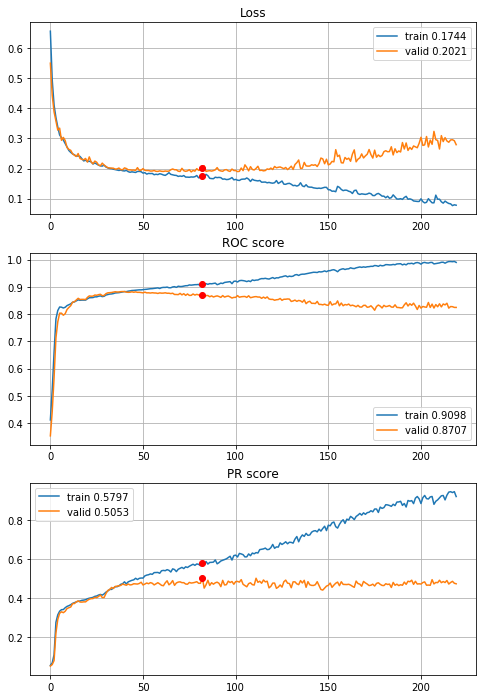


Fold 2------------------------------------------------------------


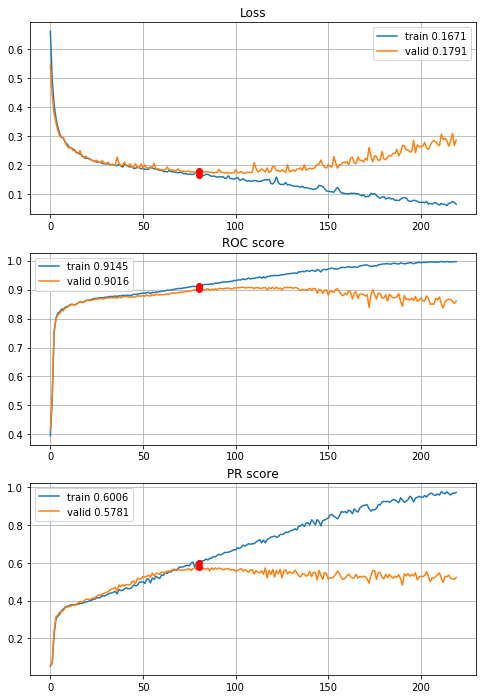


Fold 3------------------------------------------------------------


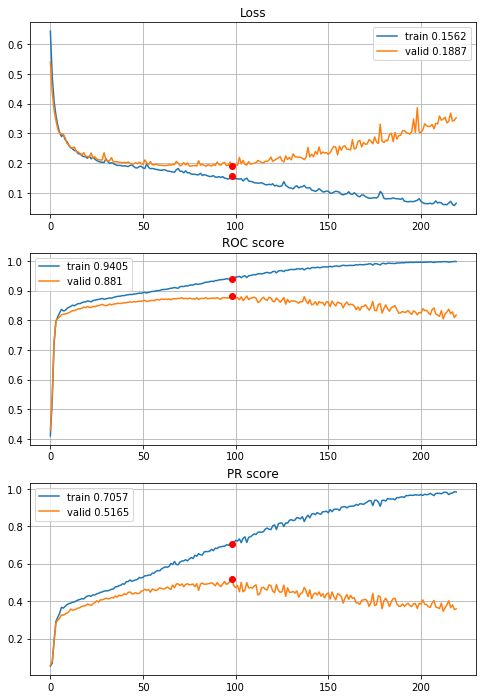


Fold 4------------------------------------------------------------


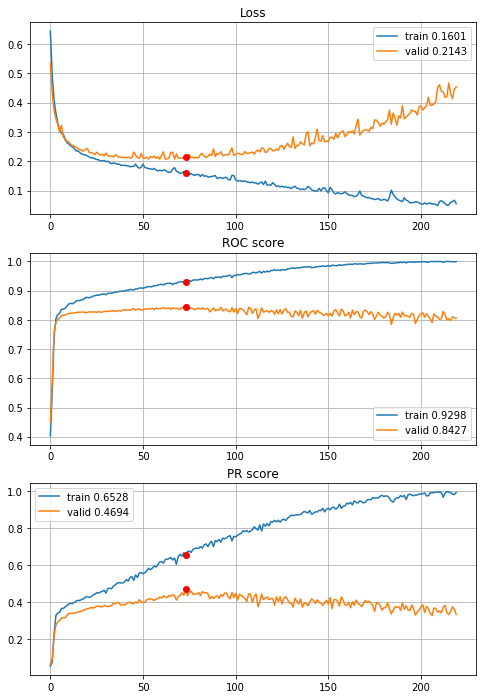


Fold 5------------------------------------------------------------


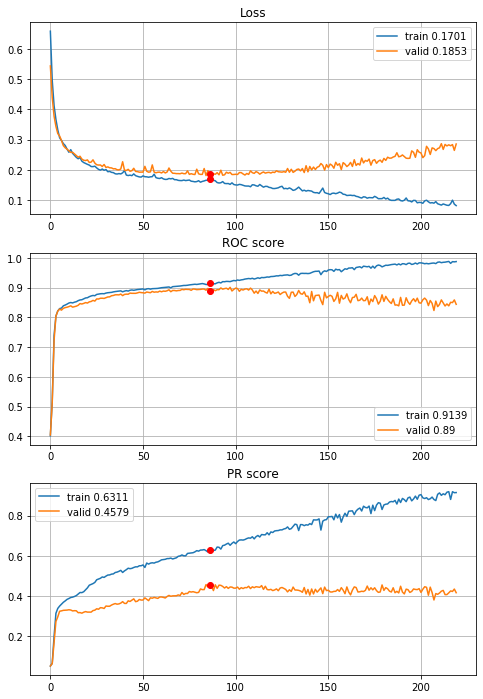


Fold 6------------------------------------------------------------


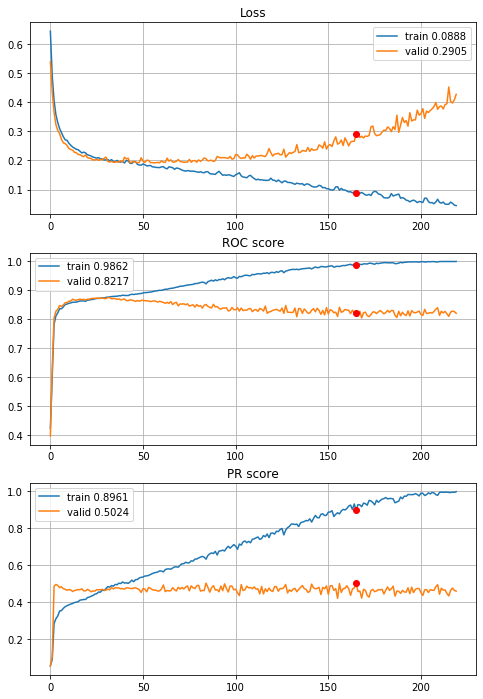

In [139]:
# model with two inc, max pool, one inc and one dense layer, 220 epochs
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_max_inc_L1_000025,
                                        features=features, target=target, n_epochs=220, batch_size=394, alpha=3,
                                        drafts=drafts_20x20["optimized_drafts"], instruction=instruction,
                                        random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\5year\define_deep_CNN_2inc_max_inc_L1_000025_220ep_20x20.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

One more inception and pooling doesn't work well, lets try two-inceptions model with two dense layers with more units and a bit lower regularization.

In [69]:
def define_deep_CNN_2inc_2dense_L1_00002(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (20,20,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (20,20,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (20,20,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (10,10,32)
    flat = layers.Flatten()(pool)                                                                       # (3200,)
    dense = layers.Dense(units=400, use_bias=True, activation=activations.relu, 
                         kernel_regularizer=regularizers.l1(l=0.00002))(flat)                           # (400,)
    dense = layers.Dense(units=200, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.00002))(dense)                          # (200,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/220,
cumulative time: 6.68s train loss: 0.8485559728870753, validation loss: 0.7065057793491454
Epoch: 2/220,
cumulative time: 11.08s train loss: 0.6265270846092313, validation loss: 0.5580677307445006
Epoch: 3/220,
cumulative time: 15.43s train loss: 0.5116281582022402, validation loss: 0.47067210283193406
Epoch: 4/220,
cumulative time: 19.83s train loss: 0.445728759123315, validation loss: 0.42637874795861014
Epoch: 5/220,
cumulative time: 24.23s train loss: 0.4001781036438494, validation loss: 0.38225747996010934
Epoch: 6/220,
cumulative time: 28.65s train loss: 0.3666842935694254, validation loss: 0.39161488017342405
Epoch: 7/220,
cumulative time: 33.05s train loss: 0.3607929444700372, validation loss: 0.3508073180544336
Epoch: 8/220,
cumulative time: 37.43s train loss: 0.34489303275889005, validation loss: 0.34097921713901075
Epoch: 9/220,
cumulative time: 41.83s train loss: 0.33041296807867526, validation loss: 0.32611582583

Epoch: 76/220,
cumulative time: 341.18s train loss: 0.16978731051437046, validation loss: 0.20430138062059947
Epoch: 77/220,
cumulative time: 345.57s train loss: 0.16960388070328786, validation loss: 0.1910086757636796
Epoch: 78/220,
cumulative time: 349.95s train loss: 0.16860753537192671, validation loss: 0.2016109938249244
Epoch: 79/220,
cumulative time: 354.3s train loss: 0.1699670844170053, validation loss: 0.19115656962053348
Epoch: 80/220,
cumulative time: 358.68s train loss: 0.17067294911437733, validation loss: 0.19323848334079127
Epoch: 81/220,
cumulative time: 363.06s train loss: 0.16638928670301656, validation loss: 0.193196094997034
Epoch: 82/220,
cumulative time: 367.42s train loss: 0.16425088793711756, validation loss: 0.1939520966240626
Epoch: 83/220,
cumulative time: 371.79s train loss: 0.17259309813380241, validation loss: 0.19089757515854605
Epoch: 84/220,
cumulative time: 376.15s train loss: 0.16482562836030976, validation loss: 0.20696284768949635
Epoch: 85/220,
cu

Epoch: 151/220,
cumulative time: 673.43s train loss: 0.09849445188639934, validation loss: 0.23598541443686608
Epoch: 152/220,
cumulative time: 677.82s train loss: 0.08870174248269104, validation loss: 0.24834149091461466
Epoch: 153/220,
cumulative time: 682.24s train loss: 0.08464812148288431, validation loss: 0.24984176898755242
Epoch: 154/220,
cumulative time: 686.62s train loss: 0.0822791671481266, validation loss: 0.2441596517165054
Epoch: 155/220,
cumulative time: 691.05s train loss: 0.08462111791932034, validation loss: 0.260184979022154
Epoch: 156/220,
cumulative time: 695.42s train loss: 0.08692855053053436, validation loss: 0.27179673915516833
Epoch: 157/220,
cumulative time: 699.79s train loss: 0.08752322161657608, validation loss: 0.257659915267682
Epoch: 158/220,
cumulative time: 704.12s train loss: 0.08237045072859644, validation loss: 0.293489415521955
Epoch: 159/220,
cumulative time: 708.52s train loss: 0.08685715086522784, validation loss: 0.2503682577892248
Epoch: 160

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/220,
cumulative time: 7.54s train loss: 0.858256152659547, validation loss: 0.7031868201635333
Epoch: 2/220,
cumulative time: 11.93s train loss: 0.6302685846275371, validation loss: 0.5531091747853775
Epoch: 3/220,
cumulative time: 16.33s train loss: 0.5067399057563031, validation loss: 0.45944021586769734
Epoch: 4/220,
cumulative time: 20.71s train loss: 0.4327024574717675, validation loss: 0.4194418798371931
Epoch: 5/220,
cumulative time: 25.08s train loss: 0.3994939219919353, validation loss: 0.38118728941564767
Epoch: 6/220,
cumulative time: 29.51s train loss: 0.3701688441774045, validation loss: 0.3585672549894993
Epoch: 7/220,
cumulative time: 33.89s train loss: 0.3521900988900059, validation loss: 0.3508910519294567
Epoch: 8/220,
cumulative time: 38.32s train loss: 0.3483139451203148, validation loss: 0.34600433646759027
Epoch: 9/220,
cumulative time: 42.74s train loss: 0.33434643067876785, validation loss: 0.33311822630775

Epoch: 77/220,
cumulative time: 343.13s train loss: 0.17931330702284398, validation loss: 0.1842782850363612
Epoch: 78/220,
cumulative time: 347.53s train loss: 0.177928922415479, validation loss: 0.19336033927480425
Epoch: 79/220,
cumulative time: 351.93s train loss: 0.17840102734884739, validation loss: 0.19056371254205973
Epoch: 80/220,
cumulative time: 356.34s train loss: 0.18745154761020028, validation loss: 0.21573437931774164
Epoch: 81/220,
cumulative time: 360.74s train loss: 0.19120523312704013, validation loss: 0.18485060465241768
Epoch: 82/220,
cumulative time: 365.14s train loss: 0.17668763252264325, validation loss: 0.18622022442175276
Epoch: 83/220,
cumulative time: 369.5s train loss: 0.17974522449614125, validation loss: 0.18152428209244062
Epoch: 84/220,
cumulative time: 373.95s train loss: 0.1756668978905312, validation loss: 0.17947671647270744
Epoch: 85/220,
cumulative time: 378.4s train loss: 0.17939173848459006, validation loss: 0.18173790470252849
Epoch: 86/220,
c

Epoch: 152/220,
cumulative time: 674.13s train loss: 0.10277551494955693, validation loss: 0.18633951436572843
Epoch: 153/220,
cumulative time: 678.53s train loss: 0.10539596400724636, validation loss: 0.19015244855687208
Epoch: 154/220,
cumulative time: 682.91s train loss: 0.09746313395671251, validation loss: 0.1849622169200839
Epoch: 155/220,
cumulative time: 687.34s train loss: 0.09838788711301148, validation loss: 0.20150410201665112
Epoch: 156/220,
cumulative time: 691.76s train loss: 0.09824968628007044, validation loss: 0.1963820066702003
Epoch: 157/220,
cumulative time: 696.14s train loss: 0.09307241491596836, validation loss: 0.1964305925698533
Epoch: 158/220,
cumulative time: 700.53s train loss: 0.09929285776408033, validation loss: 0.19324878674617885
Epoch: 159/220,
cumulative time: 704.97s train loss: 0.09158125911445932, validation loss: 0.2025249694151701
Epoch: 160/220,
cumulative time: 709.37s train loss: 0.09876274181671091, validation loss: 0.21264893412926017
Epoch

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/220,
cumulative time: 6.78s train loss: 0.8471499728543234, validation loss: 0.7061416186904692
Epoch: 2/220,
cumulative time: 11.2s train loss: 0.6317295709134009, validation loss: 0.5535400717476175
Epoch: 3/220,
cumulative time: 15.57s train loss: 0.5079161420545207, validation loss: 0.45987887312621384
Epoch: 4/220,
cumulative time: 19.93s train loss: 0.43498509137854247, validation loss: 0.4130247280656821
Epoch: 5/220,
cumulative time: 24.34s train loss: 0.39221940247429404, validation loss: 0.3753642982802235
Epoch: 6/220,
cumulative time: 28.74s train loss: 0.3657258397728097, validation loss: 0.36266417554427427
Epoch: 7/220,
cumulative time: 33.13s train loss: 0.34897888493505624, validation loss: 0.3530462591529833
Epoch: 8/220,
cumulative time: 37.49s train loss: 0.35282719331635465, validation loss: 0.3426898726951982
Epoch: 9/220,
cumulative time: 41.95s train loss: 0.33159231499429215, validation loss: 0.32737820886

Epoch: 76/220,
cumulative time: 338.01s train loss: 0.17773797313282635, validation loss: 0.202169136036074
Epoch: 77/220,
cumulative time: 342.41s train loss: 0.17066708096178645, validation loss: 0.20126590418304907
Epoch: 78/220,
cumulative time: 346.78s train loss: 0.1683881029231131, validation loss: 0.20272430434839836
Epoch: 79/220,
cumulative time: 351.19s train loss: 0.16863419149837555, validation loss: 0.2014509796121881
Epoch: 80/220,
cumulative time: 355.64s train loss: 0.16666783417981884, validation loss: 0.20149943921316033
Epoch: 81/220,
cumulative time: 360.02s train loss: 0.1638961050672867, validation loss: 0.2148342162975464
Epoch: 82/220,
cumulative time: 364.4s train loss: 0.1687146439502816, validation loss: 0.21119533079385489
Epoch: 83/220,
cumulative time: 368.78s train loss: 0.16463169916818718, validation loss: 0.2030274402665178
Epoch: 84/220,
cumulative time: 373.25s train loss: 0.16388173941657325, validation loss: 0.20634899798280895
Epoch: 85/220,
cumu

Epoch: 151/220,
cumulative time: 668.55s train loss: 0.08859371926655676, validation loss: 0.24554881718946284
Epoch: 152/220,
cumulative time: 672.92s train loss: 0.09206862714383685, validation loss: 0.2661246279214657
Epoch: 153/220,
cumulative time: 677.3s train loss: 0.09035907322977962, validation loss: 0.27167747526722535
Epoch: 154/220,
cumulative time: 681.69s train loss: 0.08826326636516822, validation loss: 0.26518599663807546
Epoch: 155/220,
cumulative time: 686.07s train loss: 0.08774215652731782, validation loss: 0.2591044484325837
Epoch: 156/220,
cumulative time: 690.48s train loss: 0.08442023586454912, validation loss: 0.2642865262110849
Epoch: 157/220,
cumulative time: 694.94s train loss: 0.0826996558779575, validation loss: 0.2603682429102389
Epoch: 158/220,
cumulative time: 699.32s train loss: 0.08021192338707644, validation loss: 0.27311398325805064
Epoch: 159/220,
cumulative time: 703.75s train loss: 0.07754975315082537, validation loss: 0.28612454484186417
Epoch: 

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/220,
cumulative time: 6.7s train loss: 0.8575688761215889, validation loss: 0.7079245483094898
Epoch: 2/220,
cumulative time: 11.12s train loss: 0.63580006437648, validation loss: 0.5529649415080757
Epoch: 3/220,
cumulative time: 15.55s train loss: 0.5119390833762384, validation loss: 0.46040217225223307
Epoch: 4/220,
cumulative time: 20.03s train loss: 0.4451242808480309, validation loss: 0.4206883515784218
Epoch: 5/220,
cumulative time: 24.43s train loss: 0.39881973902043816, validation loss: 0.38858609913972375
Epoch: 6/220,
cumulative time: 28.87s train loss: 0.3668932892145165, validation loss: 0.3621795476828418
Epoch: 7/220,
cumulative time: 33.32s train loss: 0.35638372222591463, validation loss: 0.3604863419220625
Epoch: 8/220,
cumulative time: 37.76s train loss: 0.34635712285356973, validation loss: 0.34518891983322847
Epoch: 9/220,
cumulative time: 42.19s train loss: 0.331340624739267, validation loss: 0.330972884632394

Epoch: 77/220,
cumulative time: 344.74s train loss: 0.166447964490818, validation loss: 0.21852440529967537
Epoch: 78/220,
cumulative time: 349.13s train loss: 0.16783086544446044, validation loss: 0.22320784995033832
Epoch: 79/220,
cumulative time: 353.57s train loss: 0.16851646040864382, validation loss: 0.22092484741663018
Epoch: 80/220,
cumulative time: 358.02s train loss: 0.171210162622273, validation loss: 0.2278061400821462
Epoch: 81/220,
cumulative time: 362.44s train loss: 0.17299373144022961, validation loss: 0.22789693147818607
Epoch: 82/220,
cumulative time: 366.85s train loss: 0.16335889938424625, validation loss: 0.22516999173379645
Epoch: 83/220,
cumulative time: 371.26s train loss: 0.1664943626276962, validation loss: 0.2230433194685736
Epoch: 84/220,
cumulative time: 375.68s train loss: 0.16241883575923013, validation loss: 0.25713941602889895
Epoch: 85/220,
cumulative time: 380.12s train loss: 0.1814028217047352, validation loss: 0.2158200677240406
Epoch: 86/220,
cumu

Epoch: 152/220,
cumulative time: 677.94s train loss: 0.10730621012290337, validation loss: 0.2945459531136614
Epoch: 153/220,
cumulative time: 682.4s train loss: 0.103105168447601, validation loss: 0.27600778091034556
Epoch: 154/220,
cumulative time: 686.84s train loss: 0.08637994366132619, validation loss: 0.29602362390431003
Epoch: 155/220,
cumulative time: 691.28s train loss: 0.08612163474637499, validation loss: 0.3157660066408713
Epoch: 156/220,
cumulative time: 695.71s train loss: 0.09708371529884648, validation loss: 0.29541090662269504
Epoch: 157/220,
cumulative time: 700.15s train loss: 0.0900711332944266, validation loss: 0.30780500590666693
Epoch: 158/220,
cumulative time: 704.62s train loss: 0.08270943471386662, validation loss: 0.30956282195872703
Epoch: 159/220,
cumulative time: 709.04s train loss: 0.07695658596561532, validation loss: 0.3111761945634071
Epoch: 160/220,
cumulative time: 713.48s train loss: 0.07698355749931826, validation loss: 0.31069517976543437
Epoch: 1

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/220,
cumulative time: 6.73s train loss: 0.8422158870744351, validation loss: 0.6820317278059018
Epoch: 2/220,
cumulative time: 11.16s train loss: 0.6250293055453043, validation loss: 0.5483739861785424
Epoch: 3/220,
cumulative time: 15.67s train loss: 0.5064006467893326, validation loss: 0.4581648264055058
Epoch: 4/220,
cumulative time: 20.15s train loss: 0.43741410906820943, validation loss: 0.41123180558934436
Epoch: 5/220,
cumulative time: 24.61s train loss: 0.39356437580273, validation loss: 0.3860853093068702
Epoch: 6/220,
cumulative time: 29.08s train loss: 0.3655978285335887, validation loss: 0.3664635002074877
Epoch: 7/220,
cumulative time: 33.57s train loss: 0.3576856037308125, validation loss: 0.36607637846712066
Epoch: 8/220,
cumulative time: 38.05s train loss: 0.34131785829234496, validation loss: 0.33895183322661077
Epoch: 9/220,
cumulative time: 42.52s train loss: 0.33331863806340756, validation loss: 0.3321701422770

Epoch: 77/220,
cumulative time: 352.76s train loss: 0.17567264998427046, validation loss: 0.19717014680193995
Epoch: 78/220,
cumulative time: 357.21s train loss: 0.1750253227550075, validation loss: 0.20196742260025533
Epoch: 79/220,
cumulative time: 361.69s train loss: 0.17470980514435044, validation loss: 0.19599612521398688
Epoch: 80/220,
cumulative time: 366.14s train loss: 0.17200775036767726, validation loss: 0.21561936115841834
Epoch: 81/220,
cumulative time: 370.65s train loss: 0.17645279169015413, validation loss: 0.19919158434222028
Epoch: 82/220,
cumulative time: 375.12s train loss: 0.1709766223398095, validation loss: 0.19678201787089655
Epoch: 83/220,
cumulative time: 379.59s train loss: 0.17486449743659077, validation loss: 0.19926355772443605
Epoch: 84/220,
cumulative time: 384.03s train loss: 0.16775348835649756, validation loss: 0.19557994604110718
Epoch: 85/220,
cumulative time: 388.47s train loss: 0.17252459995719183, validation loss: 0.224525621257571
Epoch: 86/220,

Epoch: 152/220,
cumulative time: 688.5s train loss: 0.10138817387659287, validation loss: 0.205263481687746
Epoch: 153/220,
cumulative time: 692.99s train loss: 0.09719804834054281, validation loss: 0.2229412512235663
Epoch: 154/220,
cumulative time: 697.47s train loss: 0.1017233136895949, validation loss: 0.2228249542196502
Epoch: 155/220,
cumulative time: 701.96s train loss: 0.09988310416463318, validation loss: 0.20823257767992687
Epoch: 156/220,
cumulative time: 706.49s train loss: 0.09364007649190695, validation loss: 0.23323475127160953
Epoch: 157/220,
cumulative time: 711.08s train loss: 0.09539187959057736, validation loss: 0.20659698892393177
Epoch: 158/220,
cumulative time: 715.54s train loss: 0.09417259529108607, validation loss: 0.21532182223909865
Epoch: 159/220,
cumulative time: 719.99s train loss: 0.09411094986791405, validation loss: 0.23115507387146186
Epoch: 160/220,
cumulative time: 724.44s train loss: 0.09574889621749678, validation loss: 0.22317214182348877
Epoch: 

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/220,
cumulative time: 7.54s train loss: 0.8400101879098575, validation loss: 0.6810115916196164
Epoch: 2/220,
cumulative time: 11.96s train loss: 0.6220837922524363, validation loss: 0.5453805299160442
Epoch: 3/220,
cumulative time: 16.4s train loss: 0.5051252859294374, validation loss: 0.45224944678709145
Epoch: 4/220,
cumulative time: 20.87s train loss: 0.43416919450498503, validation loss: 0.3973787245981849
Epoch: 5/220,
cumulative time: 25.32s train loss: 0.39527005632171613, validation loss: 0.3648205075253213
Epoch: 6/220,
cumulative time: 29.8s train loss: 0.3672493971848956, validation loss: 0.3412740782205999
Epoch: 7/220,
cumulative time: 34.31s train loss: 0.35076762764415703, validation loss: 0.329012770415967
Epoch: 8/220,
cumulative time: 38.76s train loss: 0.33623556372222796, validation loss: 0.3204744906242491
Epoch: 9/220,
cumulative time: 43.22s train loss: 0.32476708914150965, validation loss: 0.31372723555188

Epoch: 76/220,
cumulative time: 344.04s train loss: 0.1752941106703866, validation loss: 0.20008068930349285
Epoch: 77/220,
cumulative time: 348.75s train loss: 0.1719054130229325, validation loss: 0.19454714114321542
Epoch: 78/220,
cumulative time: 353.22s train loss: 0.16968270963507046, validation loss: 0.19878790340897193
Epoch: 79/220,
cumulative time: 357.7s train loss: 0.16765557180778345, validation loss: 0.19635906526251248
Epoch: 80/220,
cumulative time: 362.21s train loss: 0.1686090001760367, validation loss: 0.19614658297857365
Epoch: 81/220,
cumulative time: 366.66s train loss: 0.1638580103296204, validation loss: 0.19812769363749916
Epoch: 82/220,
cumulative time: 371.17s train loss: 0.1719767282190238, validation loss: 0.20967186657758113
Epoch: 83/220,
cumulative time: 375.62s train loss: 0.17547438084447248, validation loss: 0.19610809119372014
Epoch: 84/220,
cumulative time: 380.13s train loss: 0.1639994052531836, validation loss: 0.21841650343506386
Epoch: 85/220,
cu

Epoch: 151/220,
cumulative time: 680.46s train loss: 0.10102409490768834, validation loss: 0.23027802324321953
Epoch: 152/220,
cumulative time: 684.92s train loss: 0.09618532532746653, validation loss: 0.22406557320068438
Epoch: 153/220,
cumulative time: 689.36s train loss: 0.09389812317936301, validation loss: 0.24203044273648788
Epoch: 154/220,
cumulative time: 693.86s train loss: 0.09539812898816709, validation loss: 0.2433371090122055
Epoch: 155/220,
cumulative time: 698.32s train loss: 0.10186361888044983, validation loss: 0.2419842284837103
Epoch: 156/220,
cumulative time: 702.82s train loss: 0.10711194413821046, validation loss: 0.2399280944136949
Epoch: 157/220,
cumulative time: 707.29s train loss: 0.09773875972621199, validation loss: 0.268377901233615
Epoch: 158/220,
cumulative time: 711.75s train loss: 0.10028625112434501, validation loss: 0.2251268912855174
Epoch: 159/220,
cumulative time: 716.22s train loss: 0.0957056293564458, validation loss: 0.24941853408619727
Epoch: 1

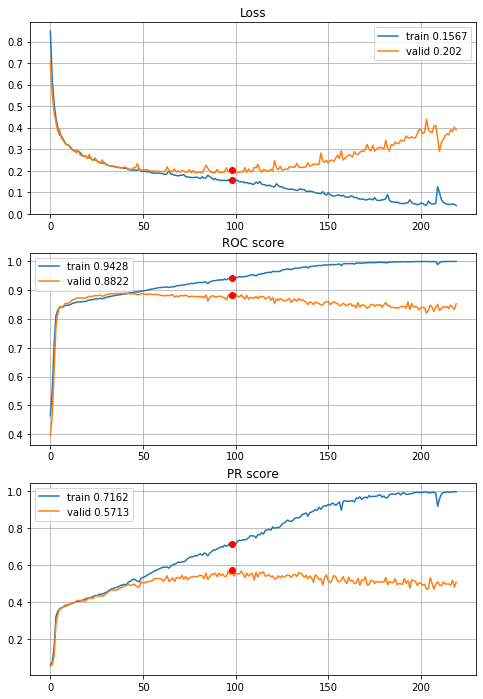


Fold 2------------------------------------------------------------


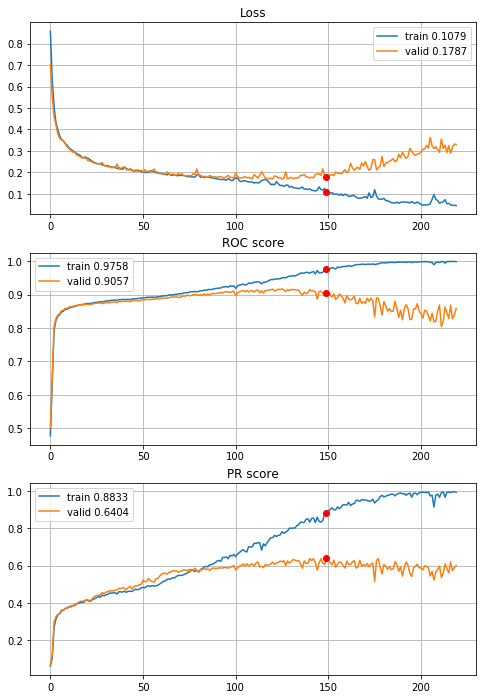


Fold 3------------------------------------------------------------


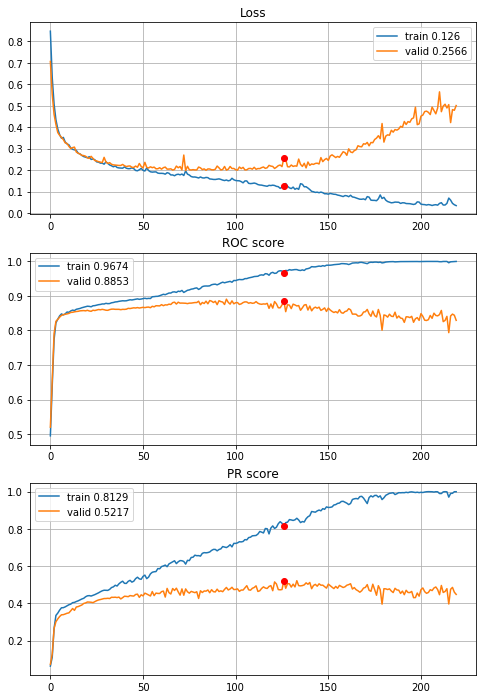


Fold 4------------------------------------------------------------


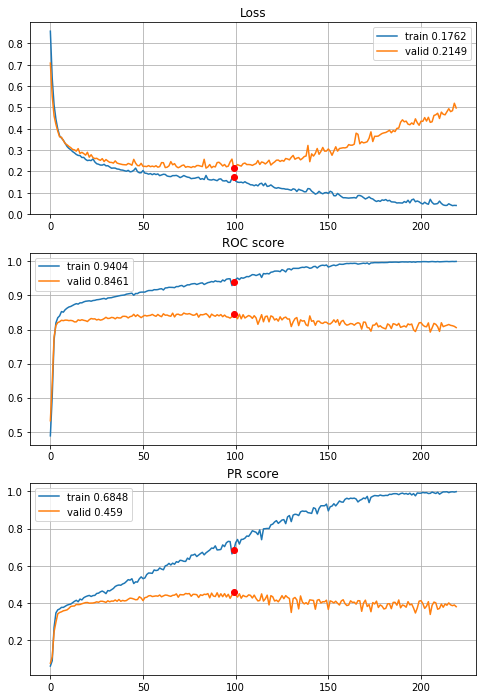


Fold 5------------------------------------------------------------


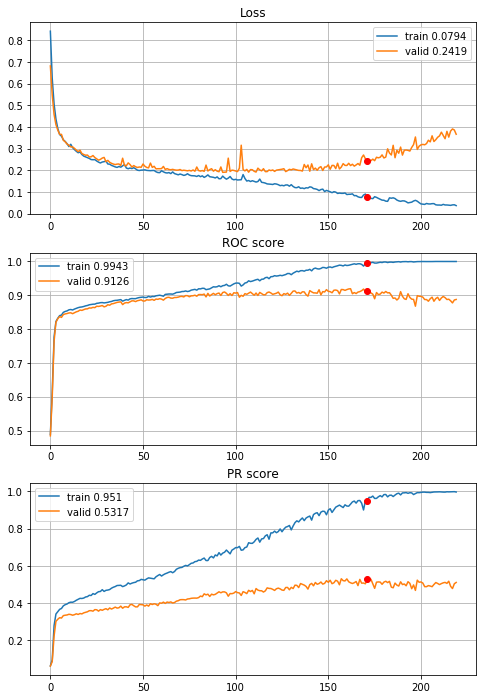


Fold 6------------------------------------------------------------


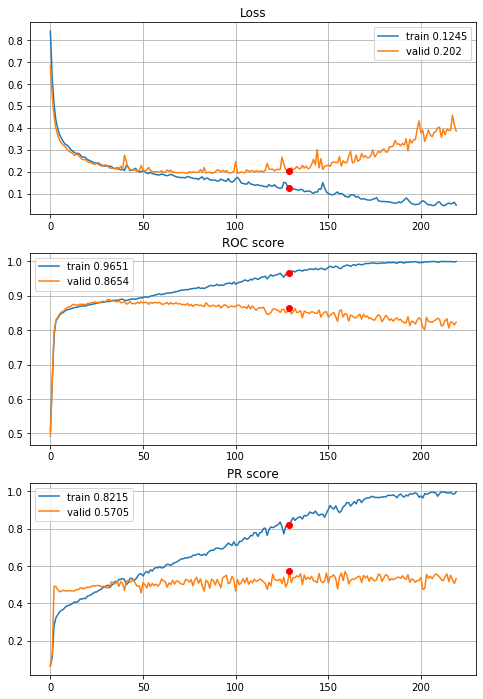

In [149]:
# model with two dense layers, 220 epochs, THE BEST ONE
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_2dense_L1_00002,
                                        features=features, target=target, n_epochs=220, batch_size=394, alpha=3,
                                        drafts=drafts_20x20["optimized_drafts"], instruction=instruction,
                                        random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\5year\define_deep_CNN_2inc_2dense_L1_00002_220ep_20x20.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

 - 3x3 filter in pooling
 - first model but with more nodes in dense layer

model with one dense layers with 400 nodes, 300 epochs

In [70]:
def define_deep_CNN_2inc_1dense400nodes_L1_000025(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (20,20,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (20,20,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (20,20,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (10,10,32)
    flat = layers.Flatten()(pool)                                                                       # (3200,)
    dense = layers.Dense(units=400, use_bias=True, activation=activations.relu, 
                         kernel_regularizer=regularizers.l1(l=0.000025))(flat)                          # (400,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/220,
cumulative time: 6.47s train loss: 0.8842505326877863, validation loss: 0.719704416316956
Epoch: 2/220,
cumulative time: 10.85s train loss: 0.6376086224126041, validation loss: 0.5547272337867281
Epoch: 3/220,
cumulative time: 15.19s train loss: 0.5010739766895126, validation loss: 0.4564428076131234
Epoch: 4/220,
cumulative time: 19.59s train loss: 0.43071629702775915, validation loss: 0.4095940279449927
Epoch: 5/220,
cumulative time: 23.96s train loss: 0.3885261626369471, validation loss: 0.37359078522465006
Epoch: 6/220,
cumulative time: 28.35s train loss: 0.3578846416560536, validation loss: 0.3755320157717153
Epoch: 7/220,
cumulative time: 32.74s train loss: 0.353116415992433, validation loss: 0.344446736097067
Epoch: 8/220,
cumulative time: 37.11s train loss: 0.34189398222290224, validation loss: 0.3324593611338765
Epoch: 9/220,
cumulative time: 41.65s train loss: 0.32360020907938697, validation loss: 0.3306636232399752

Epoch: 76/220,
cumulative time: 343.95s train loss: 0.1822198478014138, validation loss: 0.1921533383471049
Epoch: 77/220,
cumulative time: 348.36s train loss: 0.18276382065529428, validation loss: 0.18649794063882602
Epoch: 78/220,
cumulative time: 352.72s train loss: 0.18128079828211116, validation loss: 0.18896549053095374
Epoch: 79/220,
cumulative time: 357.11s train loss: 0.1826259740073543, validation loss: 0.18672895219844787
Epoch: 80/220,
cumulative time: 361.48s train loss: 0.1875440497018585, validation loss: 0.19772477807496017
Epoch: 81/220,
cumulative time: 365.81s train loss: 0.18056242211657955, validation loss: 0.19178818979352008
Epoch: 82/220,
cumulative time: 370.17s train loss: 0.1816382275067189, validation loss: 0.1937416202253258
Epoch: 83/220,
cumulative time: 374.51s train loss: 0.18439940842614921, validation loss: 0.19661268687637978
Epoch: 84/220,
cumulative time: 378.89s train loss: 0.18371051722727313, validation loss: 0.1984918027813835
Epoch: 85/220,
cu

Epoch: 151/220,
cumulative time: 675.15s train loss: 0.15792526219658795, validation loss: 0.18488755343395802
Epoch: 152/220,
cumulative time: 679.52s train loss: 0.15326523574721404, validation loss: 0.1858619178362871
Epoch: 153/220,
cumulative time: 683.94s train loss: 0.15331383027970144, validation loss: 0.1893872762143007
Epoch: 154/220,
cumulative time: 688.32s train loss: 0.15174277754843452, validation loss: 0.18480515258288033
Epoch: 155/220,
cumulative time: 692.71s train loss: 0.15080817307039612, validation loss: 0.20392494770491407
Epoch: 156/220,
cumulative time: 697.11s train loss: 0.16305511963926927, validation loss: 0.19164436027458046
Epoch: 157/220,
cumulative time: 701.49s train loss: 0.15369253295611604, validation loss: 0.1860774941952414
Epoch: 158/220,
cumulative time: 705.88s train loss: 0.15312757351123038, validation loss: 0.19176718006341004
Epoch: 159/220,
cumulative time: 710.23s train loss: 0.15432782048890736, validation loss: 0.1899202655341472
Epoch

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/220,
cumulative time: 6.53s train loss: 0.8866224653938187, validation loss: 0.7182940373694884
Epoch: 2/220,
cumulative time: 10.94s train loss: 0.6375802084265633, validation loss: 0.5532335115527354
Epoch: 3/220,
cumulative time: 15.33s train loss: 0.5028026435618366, validation loss: 0.45479492626437473
Epoch: 4/220,
cumulative time: 19.74s train loss: 0.4322468192057704, validation loss: 0.4097561885297231
Epoch: 5/220,
cumulative time: 24.16s train loss: 0.39193839960418886, validation loss: 0.3739122018604429
Epoch: 6/220,
cumulative time: 28.6s train loss: 0.3611556300859804, validation loss: 0.3507081198987993
Epoch: 7/220,
cumulative time: 33.0s train loss: 0.3444441364345137, validation loss: 0.3387212114914697
Epoch: 8/220,
cumulative time: 37.41s train loss: 0.33848477460255694, validation loss: 0.32900654335570306
Epoch: 9/220,
cumulative time: 41.83s train loss: 0.3233367433294062, validation loss: 0.313781611512183

Epoch: 76/220,
cumulative time: 338.46s train loss: 0.18430657690854924, validation loss: 0.18925483118251318
Epoch: 77/220,
cumulative time: 342.89s train loss: 0.1840655673631477, validation loss: 0.18525249374087527
Epoch: 78/220,
cumulative time: 347.32s train loss: 0.18225888588502734, validation loss: 0.18771123676114582
Epoch: 79/220,
cumulative time: 351.7s train loss: 0.183581947063227, validation loss: 0.18379683483480197
Epoch: 80/220,
cumulative time: 356.12s train loss: 0.18836240965321607, validation loss: 0.18449296835041368
Epoch: 81/220,
cumulative time: 360.54s train loss: 0.18195143077751144, validation loss: 0.18567183697774686
Epoch: 82/220,
cumulative time: 364.92s train loss: 0.18577671469616222, validation loss: 0.1831401650874698
Epoch: 83/220,
cumulative time: 369.33s train loss: 0.18131031246607054, validation loss: 0.1828640291158618
Epoch: 84/220,
cumulative time: 373.74s train loss: 0.18166452842270317, validation loss: 0.18291958281192866
Epoch: 85/220,
c

Epoch: 151/220,
cumulative time: 669.85s train loss: 0.16336252374258498, validation loss: 0.17376436568637038
Epoch: 152/220,
cumulative time: 674.28s train loss: 0.16192993025433286, validation loss: 0.1733008429424873
Epoch: 153/220,
cumulative time: 678.67s train loss: 0.1616660937707239, validation loss: 0.1731438140858389
Epoch: 154/220,
cumulative time: 683.07s train loss: 0.1609752658041806, validation loss: 0.17376892199779712
Epoch: 155/220,
cumulative time: 687.45s train loss: 0.1643199315597219, validation loss: 0.17632392628418686
Epoch: 156/220,
cumulative time: 691.87s train loss: 0.1652210929636114, validation loss: 0.18542545249322356
Epoch: 157/220,
cumulative time: 696.28s train loss: 0.16768741142340945, validation loss: 0.1763986952208075
Epoch: 158/220,
cumulative time: 700.72s train loss: 0.16923689294525754, validation loss: 0.18754895622794765
Epoch: 159/220,
cumulative time: 705.12s train loss: 0.17361599325945445, validation loss: 0.17683829091648912
Epoch: 1

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/220,
cumulative time: 7.86s train loss: 0.8712018910889591, validation loss: 0.718858511498977
Epoch: 2/220,
cumulative time: 12.29s train loss: 0.6397421416769389, validation loss: 0.5448380202021379
Epoch: 3/220,
cumulative time: 16.71s train loss: 0.49336760396991824, validation loss: 0.44055098627842
Epoch: 4/220,
cumulative time: 21.13s train loss: 0.416017539637829, validation loss: 0.395570393681123
Epoch: 5/220,
cumulative time: 25.53s train loss: 0.37731632973581875, validation loss: 0.36361699933532665
Epoch: 6/220,
cumulative time: 29.99s train loss: 0.3523783810732597, validation loss: 0.351852278900254
Epoch: 7/220,
cumulative time: 34.46s train loss: 0.33804982591299376, validation loss: 0.3342062675025579
Epoch: 8/220,
cumulative time: 38.91s train loss: 0.34079186974718684, validation loss: 0.3262102333104328
Epoch: 9/220,
cumulative time: 43.35s train loss: 0.32158699665312734, validation loss: 0.32476859888336973

Epoch: 76/220,
cumulative time: 346.86s train loss: 0.18423859227704228, validation loss: 0.1970785197874336
Epoch: 77/220,
cumulative time: 351.29s train loss: 0.1820818668614656, validation loss: 0.1963848803599765
Epoch: 78/220,
cumulative time: 355.78s train loss: 0.18152147260181847, validation loss: 0.19913789354424333
Epoch: 79/220,
cumulative time: 360.29s train loss: 0.18365961354938656, validation loss: 0.19550136311280014
Epoch: 80/220,
cumulative time: 364.75s train loss: 0.1809032003425519, validation loss: 0.19648082062114858
Epoch: 81/220,
cumulative time: 369.18s train loss: 0.18130041948697842, validation loss: 0.20988733967369277
Epoch: 82/220,
cumulative time: 373.63s train loss: 0.1883303544716069, validation loss: 0.1967522798624759
Epoch: 83/220,
cumulative time: 378.59s train loss: 0.18101014348170602, validation loss: 0.20405283635807683
Epoch: 84/220,
cumulative time: 383.22s train loss: 0.18280717323026502, validation loss: 0.19571243036693758
Epoch: 85/220,
c

Epoch: 151/220,
cumulative time: 682.19s train loss: 0.1535011598611728, validation loss: 0.19543313141807225
Epoch: 152/220,
cumulative time: 686.65s train loss: 0.1508287557901727, validation loss: 0.19908909020859333
Epoch: 153/220,
cumulative time: 691.09s train loss: 0.15218459481595334, validation loss: 0.20243044402513322
Epoch: 154/220,
cumulative time: 695.59s train loss: 0.15303749793178875, validation loss: 0.19485696219537815
Epoch: 155/220,
cumulative time: 700.06s train loss: 0.1580131770067912, validation loss: 0.19853390324881812
Epoch: 156/220,
cumulative time: 704.65s train loss: 0.15315385666148004, validation loss: 0.1933761646103832
Epoch: 157/220,
cumulative time: 709.5s train loss: 0.15056814861883971, validation loss: 0.19601963524283525
Epoch: 158/220,
cumulative time: 714.1s train loss: 0.14640809535065713, validation loss: 0.19520563559171983
Epoch: 159/220,
cumulative time: 718.58s train loss: 0.14635503289394, validation loss: 0.1970754852255947
Epoch: 160/

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/220,
cumulative time: 6.68s train loss: 0.8741741035072255, validation loss: 0.7155705160265852
Epoch: 2/220,
cumulative time: 11.11s train loss: 0.639191494491174, validation loss: 0.5415441027882406
Epoch: 3/220,
cumulative time: 15.51s train loss: 0.4962741849305746, validation loss: 0.4386411557482812
Epoch: 4/220,
cumulative time: 20.25s train loss: 0.4212265123020519, validation loss: 0.40049632058455764
Epoch: 5/220,
cumulative time: 24.97s train loss: 0.3816708682112088, validation loss: 0.37371253852919584
Epoch: 6/220,
cumulative time: 29.43s train loss: 0.35876895605294234, validation loss: 0.3509388440887761
Epoch: 7/220,
cumulative time: 33.84s train loss: 0.3397312872086587, validation loss: 0.3519332564980397
Epoch: 8/220,
cumulative time: 38.28s train loss: 0.3311922281691433, validation loss: 0.32681798289107417
Epoch: 9/220,
cumulative time: 42.71s train loss: 0.31579393805243106, validation loss: 0.3169828533588

Epoch: 76/220,
cumulative time: 340.14s train loss: 0.17783056273501802, validation loss: 0.21591708605633902
Epoch: 77/220,
cumulative time: 344.59s train loss: 0.17710727074736266, validation loss: 0.21074631544456526
Epoch: 78/220,
cumulative time: 349.2s train loss: 0.17930496634632692, validation loss: 0.21481185502311714
Epoch: 79/220,
cumulative time: 354.0s train loss: 0.1779827433328394, validation loss: 0.20928000993438015
Epoch: 80/220,
cumulative time: 358.52s train loss: 0.17729979193818346, validation loss: 0.2092966146716684
Epoch: 81/220,
cumulative time: 362.99s train loss: 0.177730961202123, validation loss: 0.20888131093359963
Epoch: 82/220,
cumulative time: 367.42s train loss: 0.17375336644236994, validation loss: 0.21530807139372987
Epoch: 83/220,
cumulative time: 371.86s train loss: 0.18152779522596674, validation loss: 0.21106894889480643
Epoch: 84/220,
cumulative time: 376.3s train loss: 0.17626600699932451, validation loss: 0.22572430810191024
Epoch: 85/220,
cu

Epoch: 151/220,
cumulative time: 676.42s train loss: 0.15617849082326124, validation loss: 0.21972657090923317
Epoch: 152/220,
cumulative time: 681.24s train loss: 0.16485114170739648, validation loss: 0.21850245165098334
Epoch: 153/220,
cumulative time: 685.9s train loss: 0.15316853456294968, validation loss: 0.22693992572632654
Epoch: 154/220,
cumulative time: 690.29s train loss: 0.15592598035753433, validation loss: 0.21919266930013961
Epoch: 155/220,
cumulative time: 694.69s train loss: 0.1520424572267302, validation loss: 0.23886232979545205
Epoch: 156/220,
cumulative time: 699.14s train loss: 0.15804497146012148, validation loss: 0.21610225215722423
Epoch: 157/220,
cumulative time: 703.55s train loss: 0.15121625191554133, validation loss: 0.22061652543851537
Epoch: 158/220,
cumulative time: 707.95s train loss: 0.14870405061510383, validation loss: 0.22794040886193312
Epoch: 159/220,
cumulative time: 712.42s train loss: 0.1538657013964712, validation loss: 0.24816014202265385
Epoc

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/220,
cumulative time: 6.7s train loss: 0.8762221835199017, validation loss: 0.7109750589990723
Epoch: 2/220,
cumulative time: 11.13s train loss: 0.6337916945835659, validation loss: 0.5453511062109713
Epoch: 3/220,
cumulative time: 15.59s train loss: 0.4992143555739489, validation loss: 0.4477388675810252
Epoch: 4/220,
cumulative time: 20.04s train loss: 0.42748740102323485, validation loss: 0.4020695582065841
Epoch: 5/220,
cumulative time: 24.47s train loss: 0.38608266165475397, validation loss: 0.380662102327928
Epoch: 6/220,
cumulative time: 28.9s train loss: 0.3597207831631873, validation loss: 0.3516890256587862
Epoch: 7/220,
cumulative time: 33.34s train loss: 0.3513765168423957, validation loss: 0.3395251970797037
Epoch: 8/220,
cumulative time: 37.76s train loss: 0.32971685554705327, validation loss: 0.3280243267458664
Epoch: 9/220,
cumulative time: 42.18s train loss: 0.32043888435497153, validation loss: 0.3195064083313565

Epoch: 76/220,
cumulative time: 340.01s train loss: 0.18326143942270812, validation loss: 0.19815218569731874
Epoch: 77/220,
cumulative time: 344.45s train loss: 0.1818258244768642, validation loss: 0.19711662048545434
Epoch: 78/220,
cumulative time: 348.92s train loss: 0.18311596335916736, validation loss: 0.20080300132926915
Epoch: 79/220,
cumulative time: 353.34s train loss: 0.18239292791148973, validation loss: 0.19566585937552744
Epoch: 80/220,
cumulative time: 357.81s train loss: 0.18073343251471108, validation loss: 0.20849030850030498
Epoch: 81/220,
cumulative time: 362.25s train loss: 0.1833464359654924, validation loss: 0.19511931229794804
Epoch: 82/220,
cumulative time: 366.65s train loss: 0.1809044710715307, validation loss: 0.19415406765033644
Epoch: 83/220,
cumulative time: 371.09s train loss: 0.18839518244180994, validation loss: 0.1945416740989039
Epoch: 84/220,
cumulative time: 375.54s train loss: 0.18552662551524057, validation loss: 0.19868871690726442
Epoch: 85/220,

Epoch: 151/220,
cumulative time: 673.58s train loss: 0.16094829679920364, validation loss: 0.19183115563597153
Epoch: 152/220,
cumulative time: 678.04s train loss: 0.16101874626236792, validation loss: 0.20196707509710343
Epoch: 153/220,
cumulative time: 682.46s train loss: 0.16563471740318855, validation loss: 0.18720737432653156
Epoch: 154/220,
cumulative time: 686.87s train loss: 0.16140827621626794, validation loss: 0.18979721491143073
Epoch: 155/220,
cumulative time: 691.34s train loss: 0.16187519917275925, validation loss: 0.19525552556154152
Epoch: 156/220,
cumulative time: 695.77s train loss: 0.16996899690036174, validation loss: 0.18870314740434996
Epoch: 157/220,
cumulative time: 700.17s train loss: 0.17491127539509282, validation loss: 0.19381406408803994
Epoch: 158/220,
cumulative time: 704.6s train loss: 0.17373894326457745, validation loss: 0.18869188246285673
Epoch: 159/220,
cumulative time: 709.02s train loss: 0.16390622026517487, validation loss: 0.1955434799732527
Epo

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/220,
cumulative time: 6.65s train loss: 0.8738408151340893, validation loss: 0.7149849073881489
Epoch: 2/220,
cumulative time: 11.1s train loss: 0.6349067563683084, validation loss: 0.5416396125713805
Epoch: 3/220,
cumulative time: 15.54s train loss: 0.49304644532540354, validation loss: 0.4328076476840887
Epoch: 4/220,
cumulative time: 20.03s train loss: 0.4161322932600464, validation loss: 0.3819980595773822
Epoch: 5/220,
cumulative time: 24.51s train loss: 0.3829561813459046, validation loss: 0.3543853539107346
Epoch: 6/220,
cumulative time: 28.98s train loss: 0.3598246335068971, validation loss: 0.3417772057363196
Epoch: 7/220,
cumulative time: 33.47s train loss: 0.34411502008160594, validation loss: 0.3235435477094241
Epoch: 8/220,
cumulative time: 37.97s train loss: 0.3287112391710335, validation loss: 0.3095796755420435
Epoch: 9/220,
cumulative time: 42.49s train loss: 0.31562239086281063, validation loss: 0.300693415761263

Epoch: 76/220,
cumulative time: 347.16s train loss: 0.18507213164486466, validation loss: 0.18951252200398971
Epoch: 77/220,
cumulative time: 351.65s train loss: 0.18244810109445855, validation loss: 0.18764628628037583
Epoch: 78/220,
cumulative time: 356.15s train loss: 0.18323231798556974, validation loss: 0.18969208812740532
Epoch: 79/220,
cumulative time: 360.67s train loss: 0.1845729490542503, validation loss: 0.1906364266813205
Epoch: 80/220,
cumulative time: 365.2s train loss: 0.18345718913010542, validation loss: 0.18648714933788266
Epoch: 81/220,
cumulative time: 369.65s train loss: 0.18270432268043094, validation loss: 0.18991467901600134
Epoch: 82/220,
cumulative time: 374.14s train loss: 0.1862696686811273, validation loss: 0.1880066161365595
Epoch: 83/220,
cumulative time: 378.58s train loss: 0.1855419983840704, validation loss: 0.1927405964776571
Epoch: 84/220,
cumulative time: 383.08s train loss: 0.1842220916809628, validation loss: 0.22090006170638796
Epoch: 85/220,
cum

Epoch: 151/220,
cumulative time: 684.76s train loss: 0.16434432859281478, validation loss: 0.19820343556710882
Epoch: 152/220,
cumulative time: 689.25s train loss: 0.1611596082769773, validation loss: 0.2111218391032574
Epoch: 153/220,
cumulative time: 693.71s train loss: 0.1638040267369722, validation loss: 0.1910261458992689
Epoch: 154/220,
cumulative time: 698.19s train loss: 0.15839616447929172, validation loss: 0.19617222962610878
Epoch: 155/220,
cumulative time: 702.65s train loss: 0.1588660014044101, validation loss: 0.19776317564682283
Epoch: 156/220,
cumulative time: 707.09s train loss: 0.16081882981314982, validation loss: 0.19558437252690508
Epoch: 157/220,
cumulative time: 711.56s train loss: 0.15588564831934099, validation loss: 0.19629981370461982
Epoch: 158/220,
cumulative time: 716.03s train loss: 0.15848267166468782, validation loss: 0.20245595050988294
Epoch: 159/220,
cumulative time: 720.52s train loss: 0.15856620694575557, validation loss: 0.20349847866773066
Epoch:

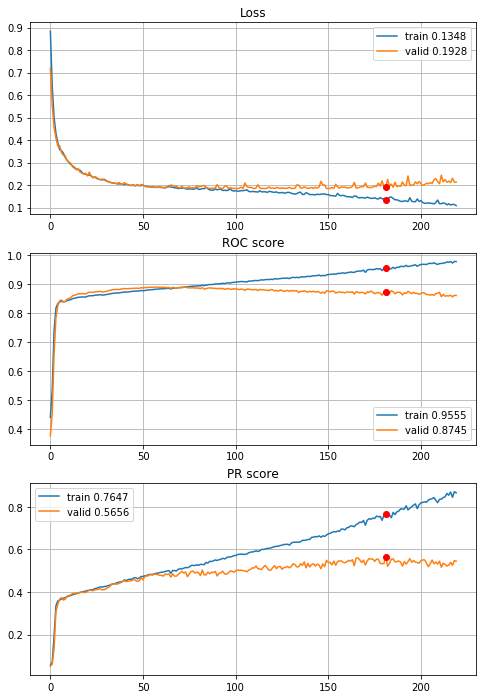


Fold 2------------------------------------------------------------


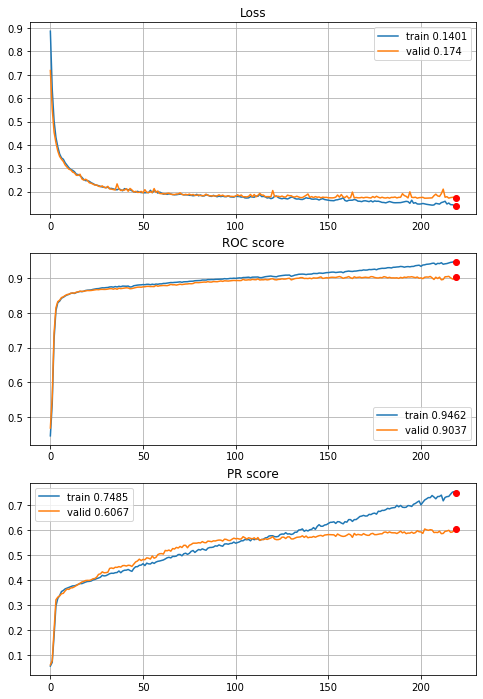


Fold 3------------------------------------------------------------


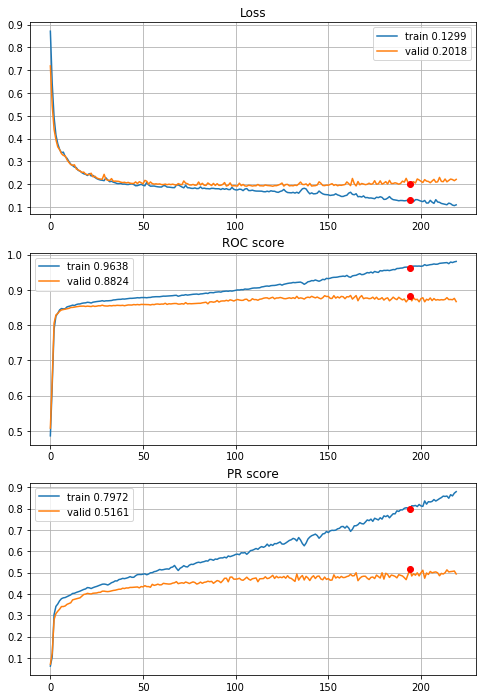


Fold 4------------------------------------------------------------


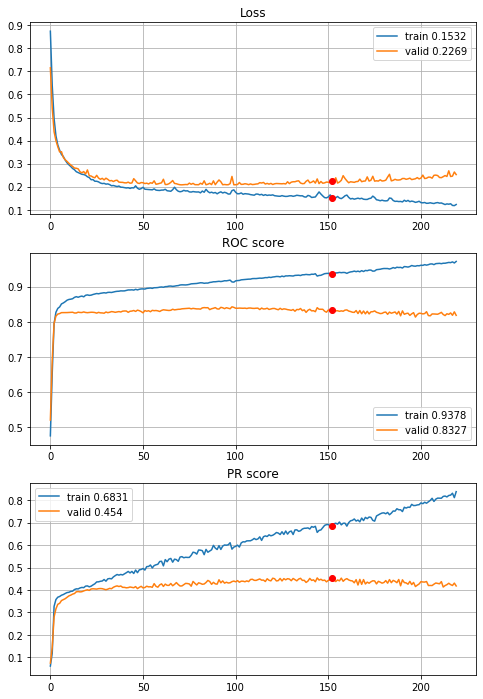


Fold 5------------------------------------------------------------


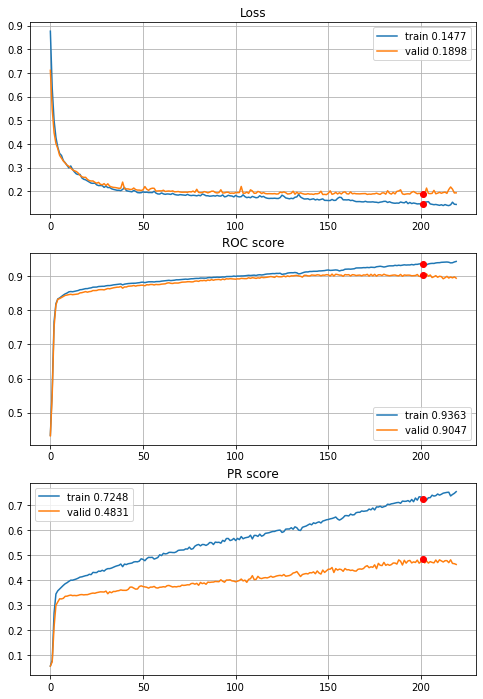


Fold 6------------------------------------------------------------


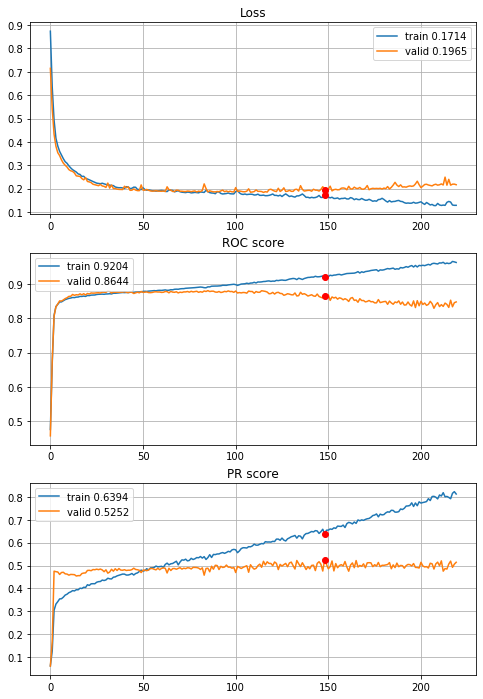

In [151]:
# model with one dense layer 400 nodes, 220 epochs
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_1dense400nodes_L1_000025,
                                        features=features, target=target, n_epochs=220, batch_size=394, alpha=3,
                                        drafts=drafts_20x20["optimized_drafts"], instruction=instruction,
                                        random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\5year\define_deep_CNN_2inc_1dense400nodes_L1_000025_220ep_20x20.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

worse results with one dense layer, lets try smaller 2 dense layers, achived by appling 3x3 s=3 pooling instead 2x2 s=2.

In [71]:
def define_deep_CNN_2inc_2dense_L1_00002_pool3x3(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (20,20,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (20,20,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (20,20,32)
    pool = layers.AveragePooling2D(pool_size=(3,3), strides=(3,3), padding="valid")(inception)          # (6,6,32)
    flat = layers.Flatten()(pool)                                                                       # (1152,)
    dense = layers.Dense(units=400, use_bias=True, activation=activations.relu, 
                         kernel_regularizer=regularizers.l1(l=0.00002))(flat)                           # (400,)
    dense = layers.Dense(units=200, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.00002))(dense)                          # (200,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/250,
cumulative time: 6.05s train loss: 0.6830130119132221, validation loss: 0.5603462846061422
Epoch: 2/250,
cumulative time: 9.65s train loss: 0.5312033873118649, validation loss: 0.49637620619749134
Epoch: 3/250,
cumulative time: 13.31s train loss: 0.4631045754286141, validation loss: 0.43646828277538435
Epoch: 4/250,
cumulative time: 16.94s train loss: 0.4108450532443687, validation loss: 0.39157162242166893
Epoch: 5/250,
cumulative time: 20.54s train loss: 0.3701299569478749, validation loss: 0.355849215048948
Epoch: 6/250,
cumulative time: 24.19s train loss: 0.34155573872076045, validation loss: 0.3436203566721085
Epoch: 7/250,
cumulative time: 27.83s train loss: 0.33380403056310404, validation loss: 0.33820009903547593
Epoch: 8/250,
cumulative time: 31.45s train loss: 0.31369270832153434, validation loss: 0.30671594514518874
Epoch: 9/250,
cumulative time: 35.09s train loss: 0.2959536729239277, validation loss: 0.30023175141

Epoch: 77/250,
cumulative time: 287.11s train loss: 0.18466918540291408, validation loss: 0.1911805768023752
Epoch: 78/250,
cumulative time: 291.17s train loss: 0.18298712630994915, validation loss: 0.19377137954097992
Epoch: 79/250,
cumulative time: 295.13s train loss: 0.1842165631023555, validation loss: 0.19115543415877032
Epoch: 80/250,
cumulative time: 299.31s train loss: 0.18882838198209068, validation loss: 0.19948322301585616
Epoch: 81/250,
cumulative time: 303.18s train loss: 0.18278136754590035, validation loss: 0.19880192830167467
Epoch: 82/250,
cumulative time: 306.93s train loss: 0.18239866010844707, validation loss: 0.19294965932441807
Epoch: 83/250,
cumulative time: 310.75s train loss: 0.18531740534149568, validation loss: 0.19913324453314638
Epoch: 84/250,
cumulative time: 314.6s train loss: 0.18385456901864025, validation loss: 0.20823461420439277
Epoch: 85/250,
cumulative time: 318.3s train loss: 0.19263056691211483, validation loss: 0.19153718151395727
Epoch: 86/250,

Epoch: 152/250,
cumulative time: 569.55s train loss: 0.153513119579545, validation loss: 0.18409606384317126
Epoch: 153/250,
cumulative time: 573.31s train loss: 0.15442450488127418, validation loss: 0.19171845887734093
Epoch: 154/250,
cumulative time: 577.04s train loss: 0.15255766857536476, validation loss: 0.1894770460003796
Epoch: 155/250,
cumulative time: 580.77s train loss: 0.15033016478582303, validation loss: 0.20374905397819423
Epoch: 156/250,
cumulative time: 584.52s train loss: 0.16345019762266413, validation loss: 0.1947732264724095
Epoch: 157/250,
cumulative time: 588.25s train loss: 0.15456635522444326, validation loss: 0.19002413124753229
Epoch: 158/250,
cumulative time: 591.99s train loss: 0.15255596969505295, validation loss: 0.1884694154696642
Epoch: 159/250,
cumulative time: 595.73s train loss: 0.15519648855249482, validation loss: 0.18637294951393746
Epoch: 160/250,
cumulative time: 599.43s train loss: 0.15326405660205586, validation loss: 0.1888413232034062
Epoch: 

Epoch: 227/250,
cumulative time: 850.99s train loss: 0.12128067562618841, validation loss: 0.20164348894001533
Epoch: 228/250,
cumulative time: 854.71s train loss: 0.11476803337650825, validation loss: 0.22129679537612396
Epoch: 229/250,
cumulative time: 858.44s train loss: 0.12425519004027066, validation loss: 0.20856999173306828
Epoch: 230/250,
cumulative time: 862.17s train loss: 0.11219514134787158, validation loss: 0.21281610553603295
Epoch: 231/250,
cumulative time: 865.93s train loss: 0.11723408953283346, validation loss: 0.21247415303377584
Epoch: 232/250,
cumulative time: 869.65s train loss: 0.1167503409760093, validation loss: 0.22150291111047266
Epoch: 233/250,
cumulative time: 873.34s train loss: 0.12164915670449122, validation loss: 0.2232990918561329
Epoch: 234/250,
cumulative time: 877.09s train loss: 0.12240646158207194, validation loss: 0.20841959327156945
Epoch: 235/250,
cumulative time: 880.8s train loss: 0.11788267655035864, validation loss: 0.2051595777037985
Epoch

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/250,
cumulative time: 6.22s train loss: 0.660888972507272, validation loss: 0.5492226118568369
Epoch: 2/250,
cumulative time: 9.98s train loss: 0.5273726836976592, validation loss: 0.4923804009578946
Epoch: 3/250,
cumulative time: 13.96s train loss: 0.4633514387028742, validation loss: 0.42862096932856314
Epoch: 4/250,
cumulative time: 17.89s train loss: 0.4099048065956319, validation loss: 0.38556039528217767
Epoch: 5/250,
cumulative time: 21.75s train loss: 0.36964975747982515, validation loss: 0.3519242500640628
Epoch: 6/250,
cumulative time: 25.68s train loss: 0.33752341587298185, validation loss: 0.32279397515325964
Epoch: 7/250,
cumulative time: 29.52s train loss: 0.31647743048005156, validation loss: 0.3125521754667482
Epoch: 8/250,
cumulative time: 33.44s train loss: 0.31261114811101115, validation loss: 0.3000584893860973
Epoch: 9/250,
cumulative time: 37.29s train loss: 0.29911285068584265, validation loss: 0.29401718878

Epoch: 76/250,
cumulative time: 290.36s train loss: 0.18997006338856282, validation loss: 0.19685050352920674
Epoch: 77/250,
cumulative time: 294.46s train loss: 0.1884720752264511, validation loss: 0.19324541698381087
Epoch: 78/250,
cumulative time: 298.41s train loss: 0.18620688564376064, validation loss: 0.19965936581204144
Epoch: 79/250,
cumulative time: 302.24s train loss: 0.18876673459051857, validation loss: 0.19477188225999356
Epoch: 80/250,
cumulative time: 306.01s train loss: 0.19054042962833648, validation loss: 0.1906573420480784
Epoch: 81/250,
cumulative time: 309.8s train loss: 0.18566499805138428, validation loss: 0.19011897275386022
Epoch: 82/250,
cumulative time: 313.51s train loss: 0.18724505594571791, validation loss: 0.1946165737902836
Epoch: 83/250,
cumulative time: 317.3s train loss: 0.18701975329338644, validation loss: 0.18964854040704962
Epoch: 84/250,
cumulative time: 321.0s train loss: 0.18420633580871867, validation loss: 0.1886051728599101
Epoch: 85/250,
cu

Epoch: 151/250,
cumulative time: 573.13s train loss: 0.1554301493676776, validation loss: 0.16956132484060263
Epoch: 152/250,
cumulative time: 576.85s train loss: 0.15439637428963227, validation loss: 0.16848317732805598
Epoch: 153/250,
cumulative time: 580.6s train loss: 0.15300632391918437, validation loss: 0.1681025536413795
Epoch: 154/250,
cumulative time: 584.36s train loss: 0.15287700943675714, validation loss: 0.16904465425780554
Epoch: 155/250,
cumulative time: 588.12s train loss: 0.1541853581827524, validation loss: 0.17298793493693415
Epoch: 156/250,
cumulative time: 591.89s train loss: 0.1569509827952146, validation loss: 0.1792377265256314
Epoch: 157/250,
cumulative time: 595.67s train loss: 0.1563059174411994, validation loss: 0.17132007487731427
Epoch: 158/250,
cumulative time: 599.43s train loss: 0.16132463323497062, validation loss: 0.19949314317412953
Epoch: 159/250,
cumulative time: 603.19s train loss: 0.170333382912276, validation loss: 0.18602804239868714
Epoch: 160

Epoch: 226/250,
cumulative time: 857.19s train loss: 0.1108579770174375, validation loss: 0.1990640401638616
Epoch: 227/250,
cumulative time: 860.9s train loss: 0.12068048474926918, validation loss: 0.18072695316160947
Epoch: 228/250,
cumulative time: 864.65s train loss: 0.11981775130511729, validation loss: 0.18170312673626246
Epoch: 229/250,
cumulative time: 868.43s train loss: 0.11019206227270704, validation loss: 0.1872704346761897
Epoch: 230/250,
cumulative time: 872.18s train loss: 0.1116808921481997, validation loss: 0.18350903048120196
Epoch: 231/250,
cumulative time: 875.94s train loss: 0.10555664738741054, validation loss: 0.19309000904423004
Epoch: 232/250,
cumulative time: 879.69s train loss: 0.11100640269971389, validation loss: 0.1812938360377659
Epoch: 233/250,
cumulative time: 883.44s train loss: 0.1023864344784499, validation loss: 0.185853947663791
Epoch: 234/250,
cumulative time: 887.18s train loss: 0.10210739527005258, validation loss: 0.19614618976328527
Epoch: 235

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4432 samples, validate on 887 samples
Epoch: 1/250,
cumulative time: 6.18s train loss: 0.6527528518857939, validation loss: 0.5488077617820516
Epoch: 2/250,
cumulative time: 9.99s train loss: 0.5269389627400504, validation loss: 0.4888278031228226
Epoch: 3/250,
cumulative time: 13.74s train loss: 0.46086652531197786, validation loss: 0.42710766599439043
Epoch: 4/250,
cumulative time: 17.53s train loss: 0.4056034193169124, validation loss: 0.3825160715531604
Epoch: 5/250,
cumulative time: 21.3s train loss: 0.3659561141276403, validation loss: 0.34806496345069526
Epoch: 6/250,
cumulative time: 25.12s train loss: 0.3376636625492831, validation loss: 0.3229231631473597
Epoch: 7/250,
cumulative time: 28.88s train loss: 0.3150553336293043, validation loss: 0.3063943133077331
Epoch: 8/250,
cumulative time: 32.68s train loss: 0.3032702866282704, validation loss: 0.30014191179829225
Epoch: 9/250,
cumulative time: 36.62s train loss: 0.2954214995841257, validation loss: 0.299589821995312

Epoch: 77/250,
cumulative time: 294.82s train loss: 0.18592208617834194, validation loss: 0.20308065093558159
Epoch: 78/250,
cumulative time: 298.57s train loss: 0.18630977529723075, validation loss: 0.208928614434825
Epoch: 79/250,
cumulative time: 302.32s train loss: 0.18891134101641952, validation loss: 0.2014718106963589
Epoch: 80/250,
cumulative time: 306.06s train loss: 0.1841880561387173, validation loss: 0.20213380803720524
Epoch: 81/250,
cumulative time: 309.82s train loss: 0.1845405138760052, validation loss: 0.2086317920563858
Epoch: 82/250,
cumulative time: 313.55s train loss: 0.19061830553767484, validation loss: 0.20155657051717013
Epoch: 83/250,
cumulative time: 317.37s train loss: 0.18412440879747863, validation loss: 0.20860982764398903
Epoch: 84/250,
cumulative time: 321.1s train loss: 0.18647819616250183, validation loss: 0.21095607514580314
Epoch: 85/250,
cumulative time: 324.92s train loss: 0.18460271132955267, validation loss: 0.2018401921467421
Epoch: 86/250,
cum

Epoch: 152/250,
cumulative time: 578.15s train loss: 0.14486154896755188, validation loss: 0.21526351179654596
Epoch: 153/250,
cumulative time: 581.93s train loss: 0.14813914705094772, validation loss: 0.22035905713763554
Epoch: 154/250,
cumulative time: 585.63s train loss: 0.14768576464323252, validation loss: 0.20988142137597351
Epoch: 155/250,
cumulative time: 589.36s train loss: 0.14414127573155755, validation loss: 0.20414383413759402
Epoch: 156/250,
cumulative time: 593.17s train loss: 0.14504238816872508, validation loss: 0.20537304792557387
Epoch: 157/250,
cumulative time: 596.91s train loss: 0.14221905056212353, validation loss: 0.20350425993643592
Epoch: 158/250,
cumulative time: 600.64s train loss: 0.14031551307948165, validation loss: 0.20638055113283865
Epoch: 159/250,
cumulative time: 604.43s train loss: 0.13916525695580545, validation loss: 0.2062909239913592
Epoch: 160/250,
cumulative time: 608.18s train loss: 0.14326663642435836, validation loss: 0.23090301346550396
Ep

Epoch: 227/250,
cumulative time: 866.04s train loss: 0.10150837355094965, validation loss: 0.26287561942316096
Epoch: 228/250,
cumulative time: 869.8s train loss: 0.10213047510436618, validation loss: 0.27204903377285133
Epoch: 229/250,
cumulative time: 873.56s train loss: 0.10754805869197587, validation loss: 0.2608991010616436
Epoch: 230/250,
cumulative time: 877.48s train loss: 0.10337257490489996, validation loss: 0.26573829260458404
Epoch: 231/250,
cumulative time: 881.57s train loss: 0.10341972456269961, validation loss: 0.26677981899314157
Epoch: 232/250,
cumulative time: 885.51s train loss: 0.1013712876506607, validation loss: 0.2737659254062001
Epoch: 233/250,
cumulative time: 889.25s train loss: 0.10150517141009388, validation loss: 0.2595763659564591
Epoch: 234/250,
cumulative time: 893.03s train loss: 0.09814573674788866, validation loss: 0.27158179840549673
Epoch: 235/250,
cumulative time: 896.78s train loss: 0.1015436488408797, validation loss: 0.2667872931602439
Epoch: 2

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/250,
cumulative time: 6.14s train loss: 0.6599713215138449, validation loss: 0.5444333249236337
Epoch: 2/250,
cumulative time: 9.98s train loss: 0.5260954950145155, validation loss: 0.48237927126830643
Epoch: 3/250,
cumulative time: 13.79s train loss: 0.46145314998721365, validation loss: 0.42258780111577654
Epoch: 4/250,
cumulative time: 17.8s train loss: 0.40610077839362385, validation loss: 0.37737796847491983
Epoch: 5/250,
cumulative time: 21.9s train loss: 0.3692762330695466, validation loss: 0.34539620366376356
Epoch: 6/250,
cumulative time: 25.76s train loss: 0.3395246319824058, validation loss: 0.3279218574813472
Epoch: 7/250,
cumulative time: 29.53s train loss: 0.3156615713568807, validation loss: 0.3323529246294741
Epoch: 8/250,
cumulative time: 33.42s train loss: 0.3096470739847915, validation loss: 0.299426140150152
Epoch: 9/250,
cumulative time: 37.39s train loss: 0.29343506345933373, validation loss: 0.29715534748665

Epoch: 76/250,
cumulative time: 293.09s train loss: 0.18642520672267107, validation loss: 0.21588601303154406
Epoch: 77/250,
cumulative time: 296.88s train loss: 0.18343976829112746, validation loss: 0.21638243929661694
Epoch: 78/250,
cumulative time: 300.65s train loss: 0.18746474428791884, validation loss: 0.21307658832982754
Epoch: 79/250,
cumulative time: 304.4s train loss: 0.1852853010315511, validation loss: 0.2109384897667452
Epoch: 80/250,
cumulative time: 308.19s train loss: 0.18109011450417284, validation loss: 0.21313393455730334
Epoch: 81/250,
cumulative time: 312.01s train loss: 0.1830906556444837, validation loss: 0.212161885158203
Epoch: 82/250,
cumulative time: 315.78s train loss: 0.17968409040725555, validation loss: 0.2293230157942589
Epoch: 83/250,
cumulative time: 319.54s train loss: 0.18966707821869028, validation loss: 0.2169240867513028
Epoch: 84/250,
cumulative time: 323.39s train loss: 0.18098367900395806, validation loss: 0.21738157608035455
Epoch: 85/250,
cum

Epoch: 151/250,
cumulative time: 578.23s train loss: 0.160374952100777, validation loss: 0.21874521316174192
Epoch: 152/250,
cumulative time: 582.04s train loss: 0.16195412656805355, validation loss: 0.21543724269818507
Epoch: 153/250,
cumulative time: 585.86s train loss: 0.1567403706075939, validation loss: 0.2202043992469327
Epoch: 154/250,
cumulative time: 589.65s train loss: 0.15688922939439295, validation loss: 0.21793118499337147
Epoch: 155/250,
cumulative time: 593.47s train loss: 0.1521088573388367, validation loss: 0.22928130519040282
Epoch: 156/250,
cumulative time: 597.26s train loss: 0.1537415470928794, validation loss: 0.21684210584341268
Epoch: 157/250,
cumulative time: 601.05s train loss: 0.14971517888459776, validation loss: 0.21636318760181927
Epoch: 158/250,
cumulative time: 604.82s train loss: 0.1483001936207755, validation loss: 0.2202587575056752
Epoch: 159/250,
cumulative time: 608.63s train loss: 0.149760252344213, validation loss: 0.23918821126155337
Epoch: 160/

Epoch: 226/250,
cumulative time: 863.85s train loss: 0.11124207548664354, validation loss: 0.26608491186094607
Epoch: 227/250,
cumulative time: 867.63s train loss: 0.11536951216360852, validation loss: 0.25498486910662854
Epoch: 228/250,
cumulative time: 871.38s train loss: 0.11419199900220539, validation loss: 0.26402485020811883
Epoch: 229/250,
cumulative time: 875.23s train loss: 0.11332525869887326, validation loss: 0.2779494768542576
Epoch: 230/250,
cumulative time: 879.0s train loss: 0.11880881777808437, validation loss: 0.2586844107031015
Epoch: 231/250,
cumulative time: 882.79s train loss: 0.1125050324643274, validation loss: 0.2591790324476449
Epoch: 232/250,
cumulative time: 886.61s train loss: 0.10696395172973049, validation loss: 0.26643057964725364
Epoch: 233/250,
cumulative time: 890.36s train loss: 0.10567353791377626, validation loss: 0.28098070318758084
Epoch: 234/250,
cumulative time: 894.11s train loss: 0.10757826145645084, validation loss: 0.2688906325309056
Epoch: 

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/250,
cumulative time: 6.22s train loss: 0.6586869785916367, validation loss: 0.54747637373061
Epoch: 2/250,
cumulative time: 10.01s train loss: 0.5234170731937754, validation loss: 0.4883660174250334
Epoch: 3/250,
cumulative time: 13.78s train loss: 0.46103243624252416, validation loss: 0.4264918022850028
Epoch: 4/250,
cumulative time: 17.55s train loss: 0.41001151541460995, validation loss: 0.38310514757111164
Epoch: 5/250,
cumulative time: 21.35s train loss: 0.3709057031004794, validation loss: 0.35011067246475824
Epoch: 6/250,
cumulative time: 25.14s train loss: 0.34244296332527546, validation loss: 0.3265432225662214
Epoch: 7/250,
cumulative time: 28.96s train loss: 0.324761353105394, validation loss: 0.3085464903113535
Epoch: 8/250,
cumulative time: 32.77s train loss: 0.3046882098707474, validation loss: 0.3003545044910827
Epoch: 9/250,
cumulative time: 36.57s train loss: 0.29888245285888465, validation loss: 0.29558091521532

Epoch: 76/250,
cumulative time: 293.2s train loss: 0.1852910131142098, validation loss: 0.19815310146281198
Epoch: 77/250,
cumulative time: 296.98s train loss: 0.1837519006356143, validation loss: 0.20103611916505457
Epoch: 78/250,
cumulative time: 300.75s train loss: 0.18354849976514978, validation loss: 0.20056242709369745
Epoch: 79/250,
cumulative time: 304.54s train loss: 0.1818480672314343, validation loss: 0.1976846212996317
Epoch: 80/250,
cumulative time: 308.32s train loss: 0.1814316267585905, validation loss: 0.21741989665322056
Epoch: 81/250,
cumulative time: 312.08s train loss: 0.18538861193843548, validation loss: 0.2002091773745707
Epoch: 82/250,
cumulative time: 315.85s train loss: 0.18293377361601748, validation loss: 0.19692973008812414
Epoch: 83/250,
cumulative time: 319.64s train loss: 0.18083619270721624, validation loss: 0.19660153023007224
Epoch: 84/250,
cumulative time: 323.45s train loss: 0.18202980160511512, validation loss: 0.20630128257834346
Epoch: 85/250,
cu

Epoch: 151/250,
cumulative time: 579.43s train loss: 0.14783714192663336, validation loss: 0.19639458717530253
Epoch: 152/250,
cumulative time: 583.22s train loss: 0.14757800721743025, validation loss: 0.19573905586389065
Epoch: 153/250,
cumulative time: 587.02s train loss: 0.14976463957481503, validation loss: 0.20494425209327422
Epoch: 154/250,
cumulative time: 590.79s train loss: 0.15060261545037676, validation loss: 0.19483683125429174
Epoch: 155/250,
cumulative time: 594.69s train loss: 0.14893718132908448, validation loss: 0.19915155497953532
Epoch: 156/250,
cumulative time: 598.88s train loss: 0.1583111785048022, validation loss: 0.19893403189849637
Epoch: 157/250,
cumulative time: 602.87s train loss: 0.16261395561609046, validation loss: 0.2041835781212047
Epoch: 158/250,
cumulative time: 606.66s train loss: 0.1596397784270284, validation loss: 0.19906708907596682
Epoch: 159/250,
cumulative time: 610.45s train loss: 0.14963258690955594, validation loss: 0.1995127752726019
Epoch

Epoch: 226/250,
cumulative time: 866.6s train loss: 0.1149163983700078, validation loss: 0.21973176186160093
Epoch: 227/250,
cumulative time: 870.4s train loss: 0.11330715187033438, validation loss: 0.21840450823576132
Epoch: 228/250,
cumulative time: 874.18s train loss: 0.1102570169112657, validation loss: 0.22516709875576113
Epoch: 229/250,
cumulative time: 877.96s train loss: 0.11481624792781447, validation loss: 0.22619276468560065
Epoch: 230/250,
cumulative time: 881.75s train loss: 0.11449596486832739, validation loss: 0.2137624855504348
Epoch: 231/250,
cumulative time: 885.58s train loss: 0.10712009059597616, validation loss: 0.2422369455510822
Epoch: 232/250,
cumulative time: 889.43s train loss: 0.12097515824475462, validation loss: 0.21835749836861415
Epoch: 233/250,
cumulative time: 893.23s train loss: 0.1217676264110145, validation loss: 0.21986975287072547
Epoch: 234/250,
cumulative time: 897.02s train loss: 0.11194405079849305, validation loss: 0.22318978661473665
Epoch: 2

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 4433 samples, validate on 886 samples
Epoch: 1/250,
cumulative time: 5.96s train loss: 0.6557662362523147, validation loss: 0.5467099363055778
Epoch: 2/250,
cumulative time: 9.77s train loss: 0.5223133309267187, validation loss: 0.4896354973988931
Epoch: 3/250,
cumulative time: 13.56s train loss: 0.4597378043525514, validation loss: 0.42325985821859563
Epoch: 4/250,
cumulative time: 17.38s train loss: 0.4054055449630777, validation loss: 0.37548061330754384
Epoch: 5/250,
cumulative time: 21.2s train loss: 0.36334302768652416, validation loss: 0.33439098786285176
Epoch: 6/250,
cumulative time: 25.09s train loss: 0.3312995159582981, validation loss: 0.31152867860503447
Epoch: 7/250,
cumulative time: 28.94s train loss: 0.31405200758987156, validation loss: 0.29033713913932613
Epoch: 8/250,
cumulative time: 32.74s train loss: 0.30062634939066907, validation loss: 0.28166403296838766
Epoch: 9/250,
cumulative time: 36.58s train loss: 0.2925468528684848, validation loss: 0.2815933088

Epoch: 76/250,
cumulative time: 295.11s train loss: 0.18155453161679136, validation loss: 0.20074361411362684
Epoch: 77/250,
cumulative time: 298.97s train loss: 0.18019935796102443, validation loss: 0.1975069231360007
Epoch: 78/250,
cumulative time: 302.83s train loss: 0.18025046105971596, validation loss: 0.20178341243256295
Epoch: 79/250,
cumulative time: 306.7s train loss: 0.18004225437484636, validation loss: 0.1984021745403518
Epoch: 80/250,
cumulative time: 310.56s train loss: 0.178281269350736, validation loss: 0.19732198357985736
Epoch: 81/250,
cumulative time: 314.41s train loss: 0.17645792190650234, validation loss: 0.19809703458243513
Epoch: 82/250,
cumulative time: 318.22s train loss: 0.17961494652346405, validation loss: 0.1970165802111206
Epoch: 83/250,
cumulative time: 322.02s train loss: 0.1799903582187423, validation loss: 0.20182212501024285
Epoch: 84/250,
cumulative time: 325.88s train loss: 0.17750297429974127, validation loss: 0.2399319592636272
Epoch: 85/250,
cum

Epoch: 151/250,
cumulative time: 585.2s train loss: 0.1419829374682196, validation loss: 0.20319701660567427
Epoch: 152/250,
cumulative time: 589.06s train loss: 0.13825211851289734, validation loss: 0.20631710229689595
Epoch: 153/250,
cumulative time: 592.92s train loss: 0.14976349671995454, validation loss: 0.1973556828754481
Epoch: 154/250,
cumulative time: 596.76s train loss: 0.14050601436736593, validation loss: 0.20240112345320915
Epoch: 155/250,
cumulative time: 600.56s train loss: 0.1429897475539764, validation loss: 0.20328896844225597
Epoch: 156/250,
cumulative time: 604.39s train loss: 0.14802139654953916, validation loss: 0.2050359521237776
Epoch: 157/250,
cumulative time: 608.27s train loss: 0.13997634733043243, validation loss: 0.21934463285565645
Epoch: 158/250,
cumulative time: 612.13s train loss: 0.1493992031951696, validation loss: 0.19437738223753986
Epoch: 159/250,
cumulative time: 615.93s train loss: 0.1406319833772596, validation loss: 0.1992167928014329
Epoch: 16

Epoch: 226/250,
cumulative time: 873.19s train loss: 0.10268561216648991, validation loss: 0.2319358917916063
Epoch: 227/250,
cumulative time: 876.99s train loss: 0.09823889205828494, validation loss: 0.2348698755015638
Epoch: 228/250,
cumulative time: 880.74s train loss: 0.09560313195615382, validation loss: 0.23488768598834225
Epoch: 229/250,
cumulative time: 884.54s train loss: 0.09316675404972022, validation loss: 0.23793624122847823
Epoch: 230/250,
cumulative time: 888.31s train loss: 0.09438631268284968, validation loss: 0.24162702174945555
Epoch: 231/250,
cumulative time: 892.07s train loss: 0.09466916954822581, validation loss: 0.241402195417585
Epoch: 232/250,
cumulative time: 895.86s train loss: 0.09620246930165939, validation loss: 0.24679041346093603
Epoch: 233/250,
cumulative time: 899.66s train loss: 0.10667222476747755, validation loss: 0.23446499800170786
Epoch: 234/250,
cumulative time: 903.49s train loss: 0.10451863329297072, validation loss: 0.24481108364213938
Epoch

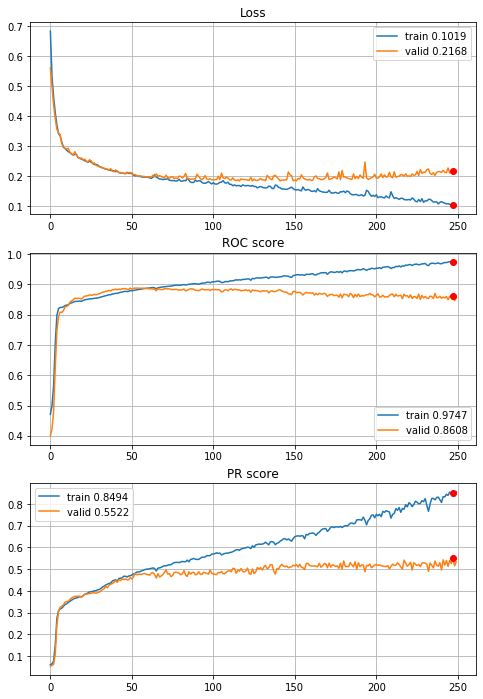


Fold 2------------------------------------------------------------


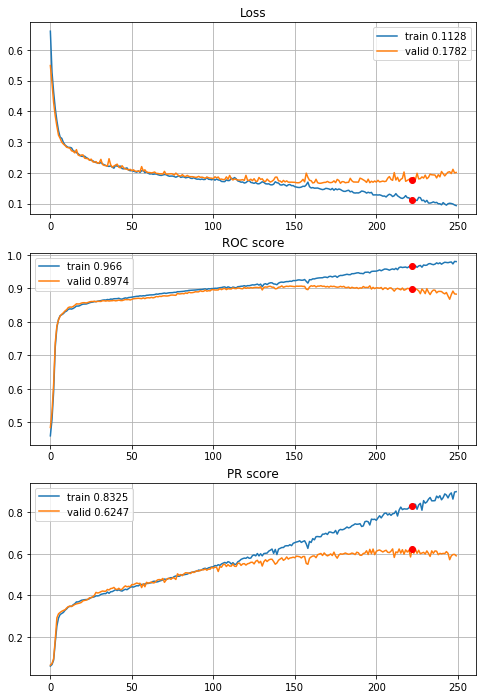


Fold 3------------------------------------------------------------


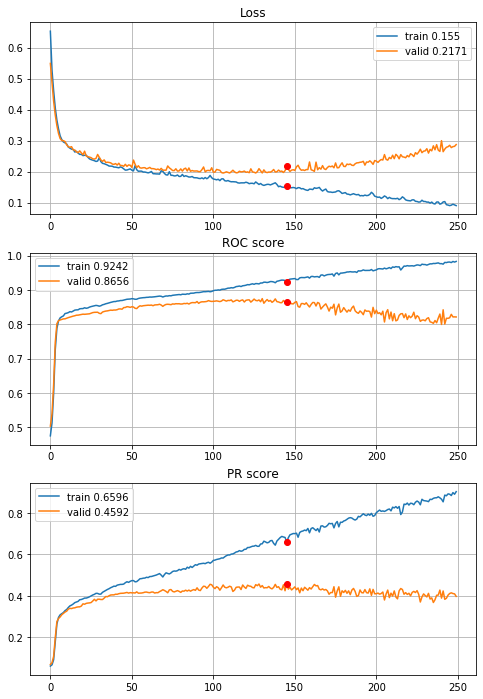


Fold 4------------------------------------------------------------


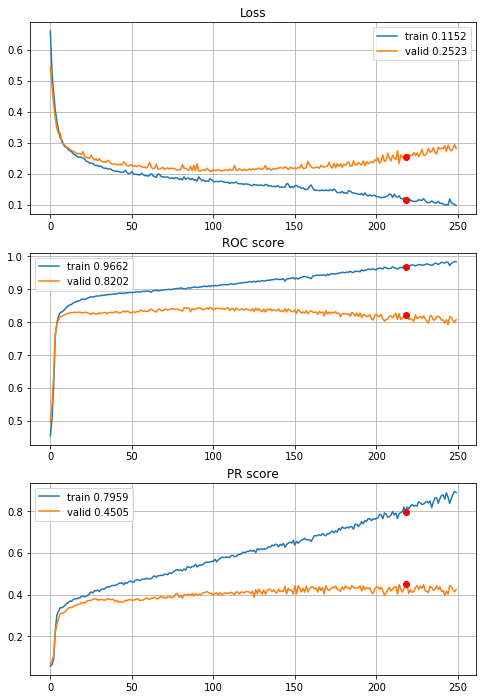


Fold 5------------------------------------------------------------


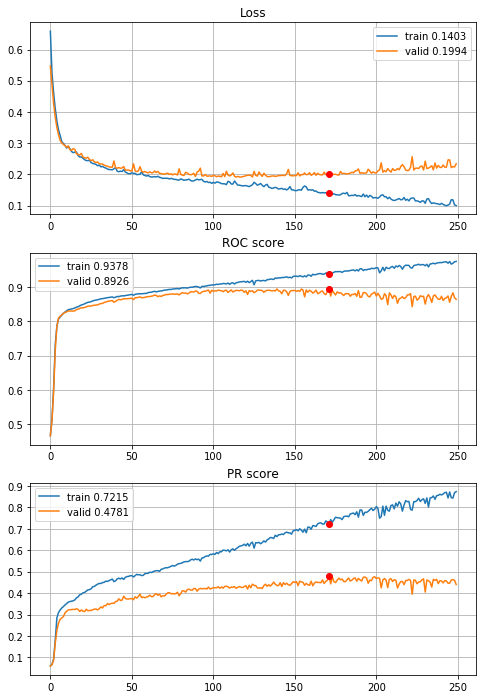


Fold 6------------------------------------------------------------


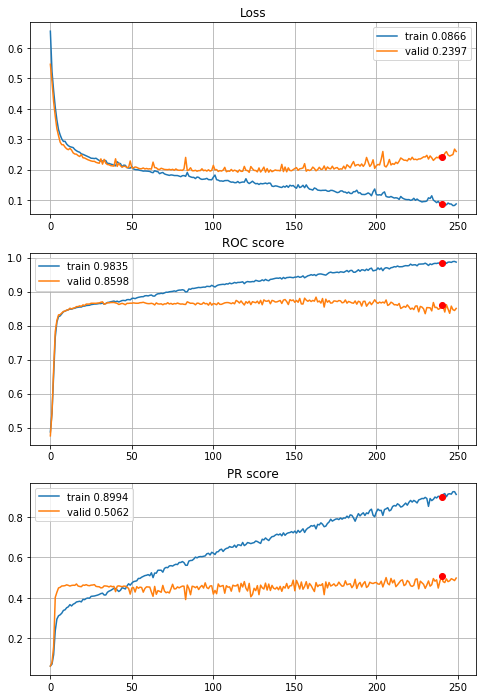

In [73]:
# model with one dense layer, 250 epochs
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_2dense_L1_00002_pool3x3,
                                        features=features, target=target, n_epochs=250, batch_size=394, alpha=3,
                                        drafts=drafts_20x20["optimized_drafts"], instruction=instruction,
                                        random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\5year\define_deep_CNN_2inc_2dense_L1_00002_pool3x3_250ep_20x20.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

To sum up, the best 20x20 input Convolutional Neural Network specification:
 - definition: define_deep_CNN_2inc_2dense_L1_00002($\cdot$)
 - 20x20x1 input,
 - 2 inceptions $i^{[1]},i^{[2]}$,
     - $i^{[1]}:f_1=f_{2\_out}=f_{3\_out}=f_{4}=4, f_{2\_in}=f_{3\_in}=1$,
     - $i^{[2]}:f_1=f_{2\_out}=f_{3\_out}=f_{4}=8, f_{2\_in}=f_{3\_in}=4$,
     - relu activations,
 - 1 average pooling $f=(2,2),s=(2,2),p=\text{valid}$,
 - flatten ($3200 \text{ units}$),
 - 2 dense layers $l^{[1]}, l^{[2]}$,
     - units: $u^{[1]}=400, u^{[2]}=202$,
     - activation: $a^{[1]}=relu, a^{[2]}=relu$,
     - regularization: $L_1^{[1]}=0.00002, L_1^{[2]}=0.00002$,
 - optimizer: Adam with default setings,
 - 128 epochs,
 - 394 batch size.
 
##### models cross validation results comparison

 - CV results

In [72]:
# LOADING 8x8 CNN
with open(r"results\5year\define_deep_CNN_2inc_std_L1_000025_450ep.p", "rb") as fp:
    CNN_8x8_CV = pickle.load(fp)

# LOADING 8x8 CNN
with open(r"results\5year\define_deep_CNN_2inc_2dense_L1_00002_220ep_20x20.p", "rb") as fp:
    CNN_20x20_CV = pickle.load(fp)
    
# TRAINING MLP
with open(r"results\5year\MLP_L1_5000ep.p", "rb") as fp:
    MLP_CV = pickle.load(fp)
    
# TRAINING XGB
XGB_CV = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                  normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                  max_depth=6, learning_rate=0.08, subsample=0.8, colsample_bytree=0.9, gamma=3, 
                                  reg_alpha=0.4, reg_lambda=0.4, saveModels=False)
# TRAINING RF
RF_CV = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                normalize=True, q=0.005, saveModels=False, max_depth=12, n_estimators=200,
                                max_features=52, min_samples_split=4, min_samples_leaf=4)
# TRAINING LOGIT
logit_CV = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                      normalize="power", q=0.005, alpha=1, info=0)


Cross validation time: 18s

Cross validation time: 155s

Cross validation time: 15s


 - CV results extraction

In [75]:
# 8x8 CNN
CNN_8x8_roc_valid, CNN_8x8_pr_valid, CNN_8x8_roc_train, CNN_8x8_pr_train, CNN_8x8_es=network_CV_results(network_history=CNN_8x8_CV,mean=False)
# 20x20 CNN
CNN_20x20_roc_valid, CNN_20x20_pr_valid, CNN_20x20_roc_train, CNN_20x20_pr_train, CNN_20x20_es = network_CV_results(network_history=CNN_20x20_CV,mean=False)
# MLP
MLP_roc_valid, MLP_pr_valid, MLP_roc_train, MLP_pr_train, MLP_es = network_CV_results(network_history=MLP_CV,mean=False)
# XGB
XGB_roc_valid, XGB_pr_valid, XGB_roc_train, XGB_pr_train, XGB_es = XGB_CV_results(XGB_history=XGB_CV,mean=False)

# RF
RF_roc_valid = RF_CV["valid_roc"]
RF_pr_valid = RF_CV["valid_pr"]
RF_roc_train = RF_CV["train_roc"]
RF_pr_train = RF_CV["train_pr"]

# logit
logit_roc_valid = logit_CV["valid_roc"]
logit_pr_valid = logit_CV["valid_pr"]
logit_roc_train = logit_CV["train_roc"]
logit_pr_train = logit_CV["train_pr"]

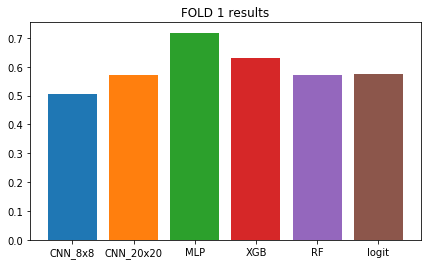

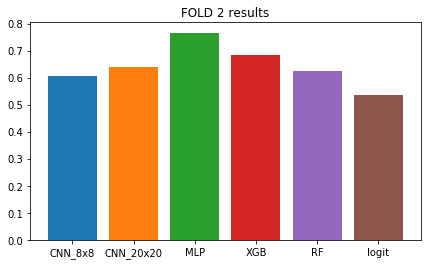

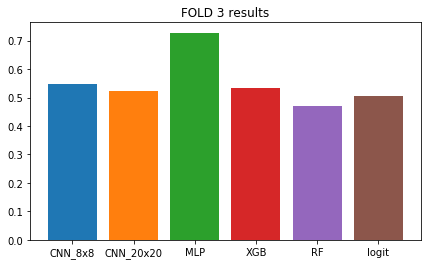

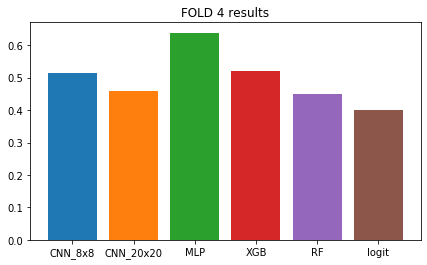

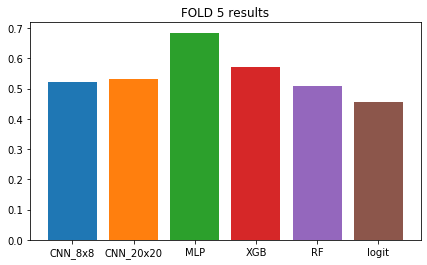

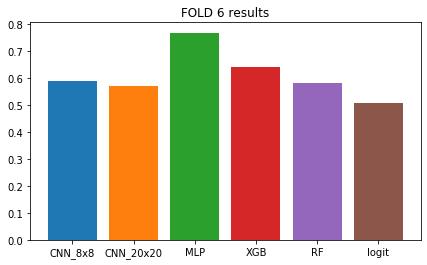

CNN_8x8 mean: 0.5471974373718073
CNN_20x20 mean: 0.5491135577120564
MLP mean: 0.7168543575956633
XGB mean: 0.5963968333333334
RF mean: 0.5346221787202724
Logit mean: 0.4964615519672764


In [76]:
for i in range(len(sets["training_sets"])):
    fig, ax = plt.subplots(figsize=(7,4))
    plt.bar(x="CNN_8x8", height=CNN_8x8_pr_valid[i])
    plt.bar(x="CNN_20x20", height=CNN_20x20_pr_valid[i])
    plt.bar(x="MLP", height=MLP_pr_valid[i])
    plt.bar(x="XGB", height=XGB_pr_valid[i])
    plt.bar(x="RF", height=RF_pr_valid[i])
    plt.bar(x="logit", height=logit_pr_valid[i])
    plt.title("FOLD {} results".format(i+1))
    plt.show()

print("CNN_8x8 mean: {}\nCNN_20x20 mean: {}\nMLP mean: {}\nXGB mean: {}\nRF mean: {}\nLogit mean: {}".format(
np.mean(CNN_8x8_pr_valid), np.mean(CNN_20x20_pr_valid), np.mean(MLP_pr_valid), np.mean(XGB_pr_valid), np.mean(RF_pr_valid),
np.mean(logit_pr_valid)))

 - wilcoxon median equality test

In [77]:
CNN_20x20_pr_valid_greater_CNN_8x8_pr_valid = wilcoxon(
    x=np.array(CNN_20x20_pr_valid), y=np.array(CNN_8x8_pr_valid), alternative="greater")[1]
MLP_pr_valid_greater_XGB_pr_valid = wilcoxon(
    x=np.array(MLP_pr_valid), y=np.array(XGB_pr_valid), alternative="greater")[1]
print("Wilcoxon tests p values, H0: median(A)==median(B)")
print("HA median(CNN_20x20_pr_valid) > median(CNN_8x8_pr_valid):", CNN_20x20_pr_valid_greater_CNN_8x8_pr_valid)
print("HA median(MLP_imp_pr_valid) > median(XGB_pr_valid):", MLP_pr_valid_greater_XGB_pr_valid)

Wilcoxon tests p values, H0: median(A)==median(B)
HA median(CNN_20x20_pr_valid) > median(CNN_8x8_pr_valid): 0.458255953931947
HA median(MLP_imp_pr_valid) > median(XGB_pr_valid): 0.013853924679039932


C:\Users\maciej\anaconda3\lib\site-packages\scipy\stats\morestats.py:2879: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


Conclusions: 
 - no statistical difference in cross validation results for CNN before and after feature generation,
 - MLP CV results median is statistically greater than XGB CV results median.
 
##### "Production" models training
 - data normalization (CNNs excluded)

In [78]:
# loading imputed data
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# ----- Scaling: clipping, power transform and normalization -----
# scaler fitting
Scaler_norm_clip_pt=scaler(images=False)
Scaler_norm_clip_pt.fit(X=train_set_imp[features], q=0.005, power_transform=True)

# sets computing
X_train_norm_clip_pt=pd.DataFrame(Scaler_norm_clip_pt.transform(X=train_set_imp[features]), columns=features)
X_test_norm_clip_pt=pd.DataFrame(Scaler_norm_clip_pt.transform(X=test_set_imp[features]), columns=features)
Y_train_norm_clip_pt=train_set_imp[target].copy()
Y_test_norm_clip_pt=test_set_imp[target].copy()

# ----- Scaling: clipping and normalization -----
# scaler fitting
Scaler_norm_clip=scaler(images=False)
Scaler_norm_clip.fit(X=train_set_imp[features], q=0.005, power_transform=False)

# sets computing
X_train_norm_clip=pd.DataFrame(Scaler_norm_clip.transform(X=train_set_imp[features]), columns=features)
X_test_norm_clip=pd.DataFrame(Scaler_norm_clip.transform(X=test_set_imp[features]), columns=features)
Y_train_norm_clip=train_set_imp[target].copy()
Y_test_norm_clip=test_set_imp[target].copy()

 - models fitting (Neural networks excluded)

In [79]:
# Logistic Regression
Logit_formula = "{}~{}".format(target, "+".join(features))
Logit = smf.logit(formula=Logit_formula, data=pd.concat((X_train_norm_clip_pt,Y_train_norm_clip_pt), axis=1))
Logit = Logit.fit_regularized(method="l1", alpha=1, disp=True, random_state=random_state)

# Random Forest
Random_Forest = RandomForestClassifier(n_estimators=200, criterion="gini", max_depth=12, min_samples_split=4,
                                      min_samples_leaf=4, max_features=52, random_state=random_state) 
Random_Forest.fit(X=X_train_norm_clip, y=Y_train_norm_clip)

# Extreme Gradient Boosted Decision Trees
XGBoost, XGBoost_history = XGB_training(X_train=X_train_norm_clip,
                                        Y_train=Y_train_norm_clip,
                                        X_valid=None, Y_valid=None, booster="gbtree", tree_method="auto",
                                        n_estimators=122, max_depth=6, learning_rate=0.08,
                                        subsample=0.8, colsample_bytree=0.9, colsample_bylevel=1,
                                        gamma=3, min_child_weight=0, reg_alpha=0.4, reg_lambda=0.4,
                                        random_state=random_state, info=0)

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.16691526180300867
            Iterations: 398
            Function evaluations: 398
            Gradient evaluations: 398


 - XGBoost training plots

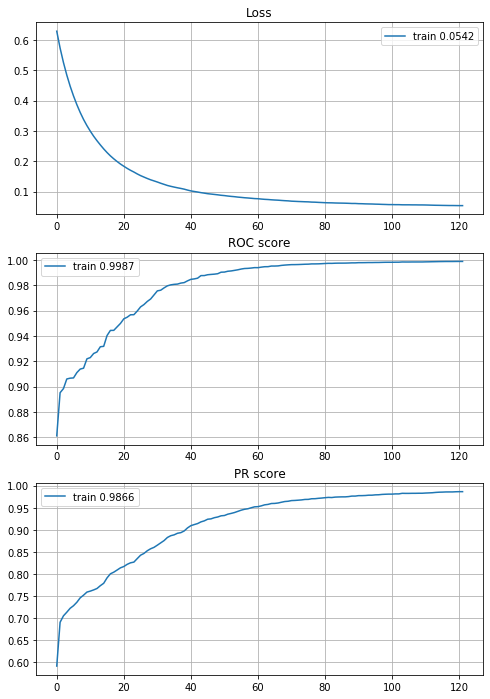

In [80]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(XGBoost_history["train_logloss"], "-", label="train {}".format(round(XGBoost_history["train_logloss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(XGBoost_history["train_auc"], label="train {}".format(round(XGBoost_history["train_auc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(XGBoost_history["train_aucpr"], label="train {}".format(round(XGBoost_history["train_aucpr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - Multilayer Percepton (Feedforward neural network)

In [82]:
# # Multilayer Percepton
# Multilayer_Percepton = define_MLP(input_shape=X_train.iloc[0].shape, n_layers=2, n_units=[60,60],
#                                   acti=[activations.tanh, activations.sigmoid], drop=[0.4,0.4],
#                                   regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)], opti=optimizers.Adam(),
#                                   random_state=random_state)

# Multilayer_Percepton, MLP_history = network_training(network=Multilayer_Percepton,
#                                                      X_train=X_train_norm_clip_pt.values,
#                                                      Y_train=Y_train_norm_clip_pt.values, 
#                                                      n_epochs=4873, batch_size=394, random_state=random_state, info=None)
# # SAVING MLP
# with open(r"results\5year\MLP_production_long.p", "wb") as fp:
#     pickle.dump(dict(zip(["model", "history", "model_weights"], [Multilayer_Percepton, MLP_history,
#                                                                  Multilayer_Percepton.get_weights()])), fp)

In [83]:
# LOADING MLP
with open(r"results\5year\MLP_production_long.p", "rb") as fp:
    MLP_dict = pickle.load(fp)

Multilayer_Percepton = MLP_dict["model"]
MLP_history = MLP_dict["history"]   

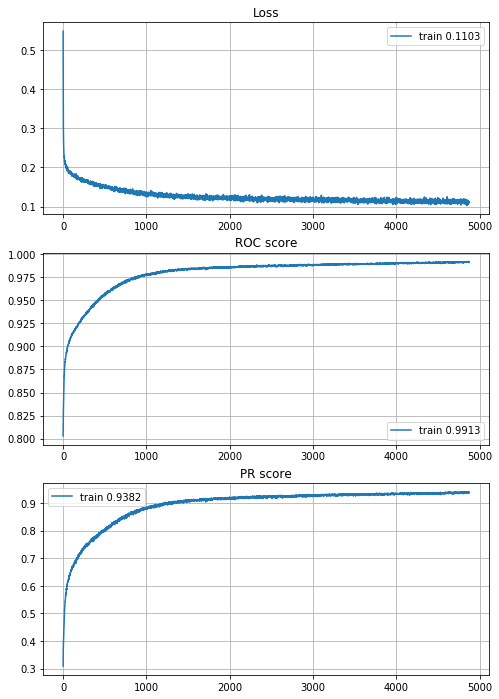

In [84]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(MLP_history["train_loss"], "-", label="train {}".format(round(MLP_history["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(MLP_history["train_roc"], label="train {}".format(round(MLP_history["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(MLP_history["train_pr"], label="train {}".format(round(MLP_history["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - 8x8 input Convolutional Neural Network

In [95]:
# ----- IMAGE DRAFT -----
# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix_8x8=X_train_CNN_8x8[Y_train_CNN_8x8==0].corr(method="spearman")
# draft inicialization
draft_8x8_ini=image_draft_inicialization(features, random_state)
# quasi optimization
draft_8x8_opt=MC_Energy_optimization(corr_matrix=corr_matrix_8x8, draft=draft_8x8_ini, alpha=3, n_eval=100,
                                     random_state=random_state)
# transform draft dictionary to matrix
draft_8x8_ini=image_dict_to_matrix(draft_8x8_ini)
draft_8x8_opt=image_dict_to_matrix(draft_8x8_opt)

# SAVING
with open(r"data\5year_data\drafts_8x8_production.p", "wb") as fp:
    pickle.dump(dict(zip(["initial", "optimized"], [draft_8x8_ini, draft_8x8_opt])), fp)

initial image energy: 12619.7076
iteration: 100
current energy: 11503.2339
iteration: 200
current energy: 10010.3061
iteration: 300
current energy: 9833.0381
iteration: 400
current energy: 9620.419
iteration: 500
current energy: 9289.8055
iteration: 600
current energy: 9251.8037
iteration: 700
current energy: 9054.2247
iteration: 800
current energy: 8998.2089
iteration: 900
current energy: 8992.4149
iteration: 1000
current energy: 8952.875
iteration: 1100
current energy: 8817.7295
iteration: 1200
current energy: 8817.4853
iteration: 1300
current energy: 8780.1604
iteration: 1400
current energy: 8754.2818
iteration: 1500
current energy: 8693.4421
iteration: 1600
current energy: 8685.5611
iteration: 1700
current energy: 8668.0315
iteration: 1800
current energy: 8632.7092
iteration: 1900
current energy: 8595.1655
iteration: 2000
current energy: 8583.8102
iteration: 2100
current energy: 8582.732
iteration: 2200
current energy: 8576.5471
iteration: 2300
current energy: 8576.5471
iteration: 

In [85]:
# loading 8x8 drafts
with open(r"data\5year_data\drafts_8x8_production.p", "rb") as fp:
    drafts_8x8 = pickle.load(fp)

draft_8x8_opt=drafts_8x8["optimized"]
draft_8x8_ini=drafts_8x8["initial"]

			 standarization only


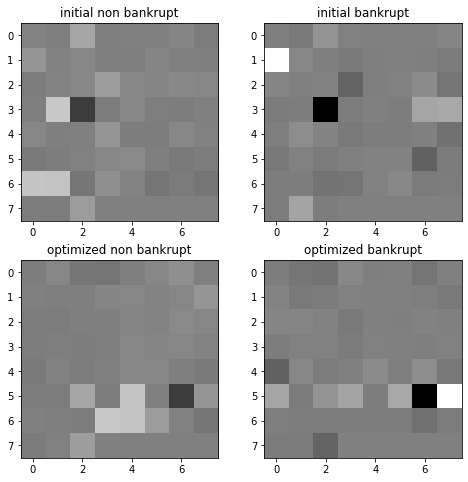

In [86]:
with open(r"data\5year_data\train_test_imp_sets_5year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm=scaler(images=True)
sclr_norm.fit(X=X_train_CNN_8x8, q=None, power_transform=False)
X_train_CNN_8x8_norm=pd.DataFrame(sclr_norm.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm=pd.DataFrame(sclr_norm.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t\t\t standarization only")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


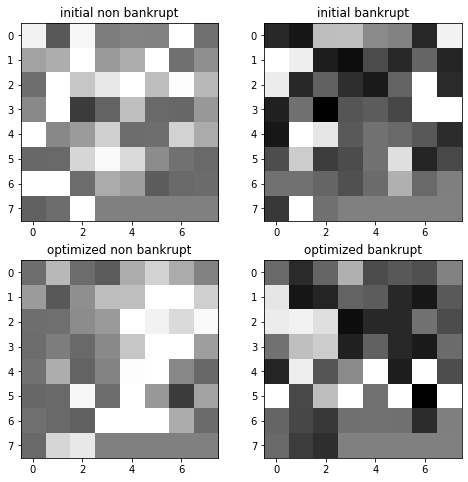

In [87]:
with open(r"data\5year_data\train_test_imp_sets_5year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm_clip=scaler(images=True)
sclr_norm_clip.fit(X=X_train_CNN_8x8, q=0.005, power_transform=False)
X_train_CNN_8x8_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

	 normalization, quantile clipping and power transform


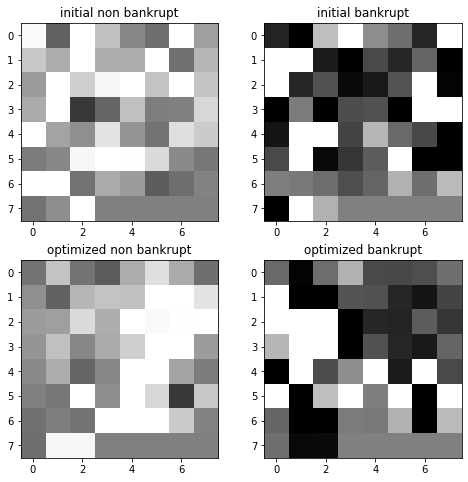

In [88]:
with open(r"data\5year_data\train_test_imp_sets_5year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_8x8, q=0.005, power_transform=True)
X_train_CNN_8x8_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t normalization, quantile clipping and power transform")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

In [117]:
# ----- vector to image conversion -----
# training set
X_train_CNN_8x8_norm_clip_pt = np.array([map_image(draft_8x8_opt, X_train_CNN_8x8_norm_clip_pt.iloc[i,:])/255 for i in range(X_train_CNN_8x8_norm_clip_pt.shape[0])])
X_train_CNN_8x8_norm_clip_pt = X_train_CNN_8x8_norm_clip_pt.reshape(X_train_CNN_8x8_norm_clip_pt.shape+(1,))
Y_train_CNN_8x8_norm_clip_pt = Y_train_CNN_8x8.values
# validation set
X_test_CNN_8x8_norm_clip_pt = np.array([map_image(draft_8x8_opt, X_test_CNN_8x8_norm_clip_pt.iloc[i,:])/255 for i in range(X_test_CNN_8x8_norm_clip_pt.shape[0])])
X_test_CNN_8x8_norm_clip_pt = X_test_CNN_8x8_norm_clip_pt.reshape(X_test_CNN_8x8_norm_clip_pt.shape+(1,))
Y_test_CNN_8x8_norm_clip_pt = Y_test_CNN_8x8.values

# ----- CNN training -----
modelCNN = define_deep_CNN_2inc_std_L1_000025(input_shape=X_train_CNN_8x8_norm_clip_pt.shape[1:], random_state=random_state)
modelCNN, historyCNN = network_training(network=modelCNN, X_train=X_train_CNN_8x8_norm_clip_pt,
                                        Y_train=Y_train_CNN_8x8_norm_clip_pt,
                                        X_val=None, Y_val=None, n_epochs=418,
                                        batch_size=394, random_state=random_state, info=2)

# SAVING CNN
with open(r"results\5year\CNN_8x8_production.p", "wb") as fp:
    pickle.dump(dict(zip(["model", "history", "model_weights"], [modelCNN, historyCNN,
                                                                 modelCNN.get_weights()])), fp)

Train on 5319 samples
Epoch: 1/418,
cumulative time: 2.77s train loss: 0.4530642209229646
Epoch: 2/418,
cumulative time: 3.59s train loss: 0.35860709680451286
Epoch: 3/418,
cumulative time: 4.4s train loss: 0.3284666030495255
Epoch: 4/418,
cumulative time: 5.3s train loss: 0.3010552680050885
Epoch: 5/418,
cumulative time: 6.22s train loss: 0.27850156194633907
Epoch: 6/418,
cumulative time: 7.03s train loss: 0.2618576382045393
Epoch: 7/418,
cumulative time: 7.87s train loss: 0.2527305075415858
Epoch: 8/418,
cumulative time: 8.7s train loss: 0.24778155265031038
Epoch: 9/418,
cumulative time: 9.51s train loss: 0.24413845715699373
Epoch: 10/418,
cumulative time: 10.3s train loss: 0.2433948461656217
Epoch: 11/418,
cumulative time: 11.09s train loss: 0.23754671878284878
Epoch: 12/418,
cumulative time: 11.89s train loss: 0.23649017788745738
Epoch: 13/418,
cumulative time: 12.69s train loss: 0.23206320294627436
Epoch: 14/418,
cumulative time: 13.48s train loss: 0.2308147301276525
Epoch: 15/418

Epoch: 117/418,
cumulative time: 97.73s train loss: 0.17390962000246402
Epoch: 118/418,
cumulative time: 98.58s train loss: 0.17356286280685002
Epoch: 119/418,
cumulative time: 99.39s train loss: 0.171665546518785
Epoch: 120/418,
cumulative time: 100.21s train loss: 0.1740823962070324
Epoch: 121/418,
cumulative time: 101.03s train loss: 0.177553238692107
Epoch: 122/418,
cumulative time: 101.84s train loss: 0.17127131091223824
Epoch: 123/418,
cumulative time: 102.64s train loss: 0.17395388417773777
Epoch: 124/418,
cumulative time: 103.45s train loss: 0.171396193129045
Epoch: 125/418,
cumulative time: 104.25s train loss: 0.1695226745473014
Epoch: 126/418,
cumulative time: 105.07s train loss: 0.16971519037529273
Epoch: 127/418,
cumulative time: 105.88s train loss: 0.1719057195716434
Epoch: 128/418,
cumulative time: 106.7s train loss: 0.17049709183198433
Epoch: 129/418,
cumulative time: 107.51s train loss: 0.17016081070458447
Epoch: 130/418,
cumulative time: 108.33s train loss: 0.169485200

Epoch: 231/418,
cumulative time: 191.36s train loss: 0.14413539347825227
Epoch: 232/418,
cumulative time: 192.19s train loss: 0.144947682817777
Epoch: 233/418,
cumulative time: 192.99s train loss: 0.14396852613599212
Epoch: 234/418,
cumulative time: 193.8s train loss: 0.14484501436904626
Epoch: 235/418,
cumulative time: 194.61s train loss: 0.14232927008911414
Epoch: 236/418,
cumulative time: 195.43s train loss: 0.14180946515666115
Epoch: 237/418,
cumulative time: 196.23s train loss: 0.14058310566125093
Epoch: 238/418,
cumulative time: 197.04s train loss: 0.14290527005990347
Epoch: 239/418,
cumulative time: 197.85s train loss: 0.14025154213110605
Epoch: 240/418,
cumulative time: 198.66s train loss: 0.14238941614274625
Epoch: 241/418,
cumulative time: 199.47s train loss: 0.13972886237833235
Epoch: 242/418,
cumulative time: 200.3s train loss: 0.14079787775322242
Epoch: 243/418,
cumulative time: 201.12s train loss: 0.13901622979729264
Epoch: 244/418,
cumulative time: 201.94s train loss: 0.

Epoch: 344/418,
cumulative time: 284.06s train loss: 0.10869495515470151
Epoch: 345/418,
cumulative time: 284.87s train loss: 0.11016900285526558
Epoch: 346/418,
cumulative time: 285.69s train loss: 0.10865712552158921
Epoch: 347/418,
cumulative time: 286.5s train loss: 0.10587758432935786
Epoch: 348/418,
cumulative time: 287.33s train loss: 0.10894331253237194
Epoch: 349/418,
cumulative time: 288.14s train loss: 0.1130694509656341
Epoch: 350/418,
cumulative time: 288.96s train loss: 0.1156549886972816
Epoch: 351/418,
cumulative time: 289.86s train loss: 0.10916605039879128
Epoch: 352/418,
cumulative time: 290.72s train loss: 0.10838462909062703
Epoch: 353/418,
cumulative time: 291.56s train loss: 0.10746093370296338
Epoch: 354/418,
cumulative time: 292.43s train loss: 0.10482401538778234
Epoch: 355/418,
cumulative time: 293.24s train loss: 0.10325392997927135
Epoch: 356/418,
cumulative time: 294.05s train loss: 0.10431159260096373
Epoch: 357/418,
cumulative time: 294.88s train loss: 0

In [90]:
# LOADING CNN
with open(r"results\5year\CNN_8x8_production.p", "rb") as fp:
    CNN_8x8_dict = pickle.load(fp)

CNN_8x8 = CNN_8x8_dict["model"]
historyCNN_8x8 = CNN_8x8_dict["history"]

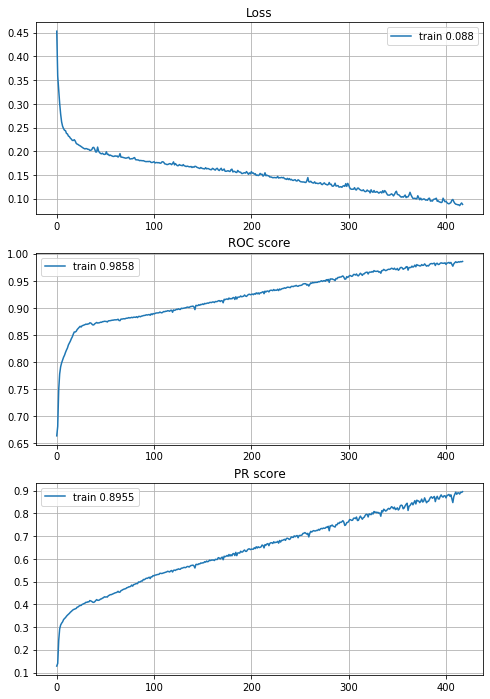

In [91]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(historyCNN_8x8["train_loss"], "-", label="train {}".format(round(historyCNN_8x8["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(historyCNN_8x8["train_roc"], label="train {}".format(round(historyCNN_8x8["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(historyCNN_8x8["train_pr"], label="train {}".format(round(historyCNN_8x8["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - 20x20 input Convolutional Neural Network

In [296]:
# training draft for CNN 20x20 input
# loading data
with open(r"data\5year_data\train_test_imp_sets_5year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN=train_set_imp[target].copy()
X_test_CNN=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN=test_set_imp[target].copy()

features_20x20=X_train_CNN.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix_20x20=X_train_CNN[Y_train_CNN==0].corr(method="spearman")
# draft inicialization
draft_20x20_ini=image_draft_inicialization(features_20x20, random_state)
# quasi optimization
draft_20x20_opt=MC_Energy_optimization(corr_matrix=corr_matrix_20x20, draft=draft_20x20_ini, alpha=3, n_eval=100,
                                       random_state=random_state)
# transform draft dictionary to matrix
draft_20x20_ini=image_dict_to_matrix(draft_20x20_ini)
draft_20x20_opt=image_dict_to_matrix(draft_20x20_opt)

# SAVING
with open(r"data\5year_data\drafts_20x20_production.p", "wb") as fp:
    pickle.dump(dict(zip(["initial", "optimized"], [draft_20x20_ini, draft_20x20_opt])), fp)

KeyboardInterrupt: 

In [92]:
# loading 20x20 drafts
with open(r"data\5year_data\drafts_20x20_production.p", "rb") as fp:
    drafts_20x20 = pickle.load(fp)

draft_20x20_opt=drafts_20x20["optimized"]
draft_20x20_ini=drafts_20x20["initial"]

			 standarization only


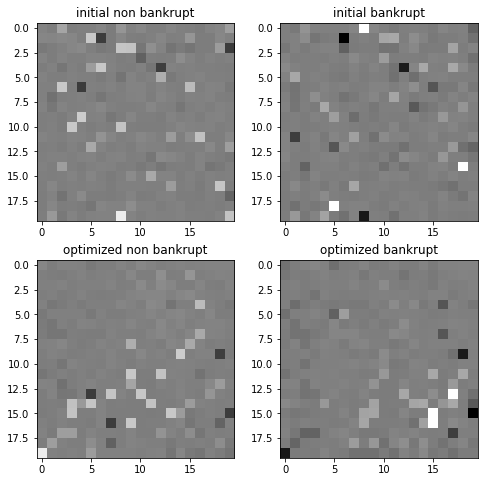

In [93]:
# loading data
with open(r"data\5year_data\train_test_imp_sets_5year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()

# standarization
sclr_norm=scaler(images=True)
sclr_norm.fit(X=X_train_CNN_20x20, q=None, power_transform=False)
X_train_CNN_20x20_norm=pd.DataFrame(sclr_norm.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm=pd.DataFrame(sclr_norm.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t\t standarization only")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


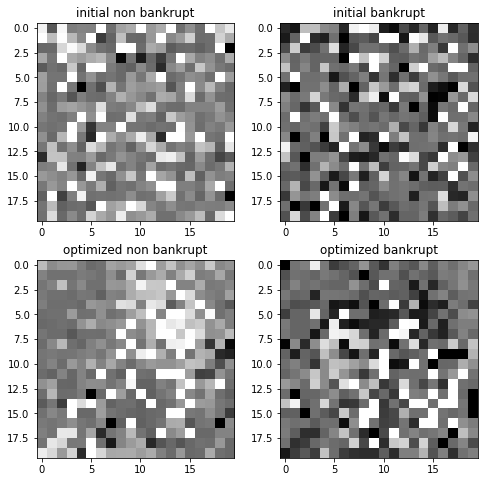

In [94]:
# loading data
with open(r"data\5year_data\train_test_imp_sets_5year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()
# standarization
sclr_norm_clip=scaler(images=True)
sclr_norm_clip.fit(X=X_train_CNN_20x20, q=0.005, power_transform=False)
X_train_CNN_20x20_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


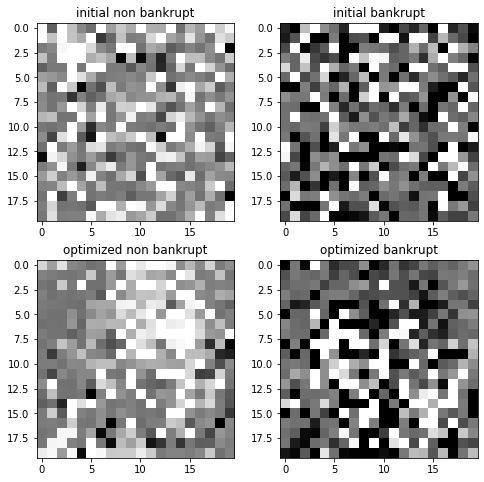

In [95]:
# loading data
with open(r"data\5year_data\train_test_imp_sets_5year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()
# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_20x20, q=0.005, power_transform=True)
X_train_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

In [94]:
# loading data
with open(r"data\5year_data\train_test_imp_sets_5year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()

# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_20x20, q=0.005, power_transform=True)
X_train_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_20x20), columns=features_20x20)


# ----- vector to image conversion -----
# training set
X_train_CNN_20x20_norm_clip_pt = np.array([map_image(draft_20x20_opt, X_train_CNN_20x20_norm_clip_pt.iloc[i,:])/255 for i in range(X_train_CNN_20x20_norm_clip_pt.shape[0])])
X_train_CNN_20x20_norm_clip_pt = X_train_CNN_20x20_norm_clip_pt.reshape(X_train_CNN_20x20_norm_clip_pt.shape+(1,))
Y_train_CNN_20x20_norm_clip_pt = Y_train_CNN_20x20.values

# validation set
X_test_CNN_20x20_norm_clip_pt = np.array([map_image(draft_20x20_opt, X_test_CNN_20x20_norm_clip_pt.iloc[i,:])/255 for i in range(X_test_CNN_20x20_norm_clip_pt.shape[0])])
X_test_CNN_20x20_norm_clip_pt = X_test_CNN_20x20_norm_clip_pt.reshape(X_test_CNN_20x20_norm_clip_pt.shape+(1,))
Y_test_CNN_20x20_norm_clip_pt = Y_test_CNN_20x20.values

# ----- CNN training -----
modelCNN_20x20 = define_deep_CNN_2inc_2dense_L1_00002(input_shape=X_train_CNN_20x20_norm_clip_pt.shape[1:], random_state=random_state)
modelCNN_20x20, historyCNN_20x20 = network_training(network=modelCNN_20x20, X_train=X_train_CNN_20x20_norm_clip_pt,
                                                    Y_train=Y_train_CNN_20x20_norm_clip_pt,
                                                    X_val=None, Y_val=None, n_epochs=128,
                                                    batch_size=394, random_state=random_state, info=2)

# SAVING CNN
with open(r"results\5year\CNN_20x20_production.p", "wb") as fp:
    pickle.dump(dict(zip(["model", "history", "model_weights"], [modelCNN_20x20, historyCNN_20x20,
                                                                 modelCNN_20x20.get_weights()])), fp)

Train on 5319 samples
Epoch: 1/128,
cumulative time: 6.75s train loss: 0.8237353828218248
Epoch: 2/128,
cumulative time: 11.2s train loss: 0.5907054631798355
Epoch: 3/128,
cumulative time: 15.73s train loss: 0.47417812546094257
Epoch: 4/128,
cumulative time: 20.73s train loss: 0.4160245381019734
Epoch: 5/128,
cumulative time: 25.5s train loss: 0.3736231404322165
Epoch: 6/128,
cumulative time: 30.03s train loss: 0.35481050941679215
Epoch: 7/128,
cumulative time: 34.55s train loss: 0.34089328072689196
Epoch: 8/128,
cumulative time: 39.07s train loss: 0.32770922780036926
Epoch: 9/128,
cumulative time: 43.54s train loss: 0.3149080552436687
Epoch: 10/128,
cumulative time: 48.05s train loss: 0.316504653957155
Epoch: 11/128,
cumulative time: 52.56s train loss: 0.30027504320497866
Epoch: 12/128,
cumulative time: 57.05s train loss: 0.29352521234088474
Epoch: 13/128,
cumulative time: 61.53s train loss: 0.2845733552067368
Epoch: 14/128,
cumulative time: 66.0s train loss: 0.27887832897680775
Epoch

Epoch: 116/128,
cumulative time: 527.98s train loss: 0.1081498756452843
Epoch: 117/128,
cumulative time: 532.5s train loss: 0.11057854112651613
Epoch: 118/128,
cumulative time: 537.03s train loss: 0.10313611643181907
Epoch: 119/128,
cumulative time: 541.56s train loss: 0.10618527675116504
Epoch: 120/128,
cumulative time: 546.03s train loss: 0.10718532016983738
Epoch: 121/128,
cumulative time: 550.52s train loss: 0.10658461296999897
Epoch: 122/128,
cumulative time: 554.97s train loss: 0.1037859273729501
Epoch: 123/128,
cumulative time: 559.42s train loss: 0.10621828282320941
Epoch: 124/128,
cumulative time: 563.9s train loss: 0.09894026374375378
Epoch: 125/128,
cumulative time: 568.41s train loss: 0.11069343321853214
Epoch: 126/128,
cumulative time: 572.88s train loss: 0.10059521926773919
Epoch: 127/128,
cumulative time: 577.39s train loss: 0.1042500971644013
Epoch: 128/128,
cumulative time: 581.93s train loss: 0.09332941168988193


In [97]:
# LOADING CNN
with open(r"results\5year\CNN_20x20_production.p", "rb") as fp:
    CNN_20x20_dict = pickle.load(fp)

CNN_20x20 = CNN_20x20_dict["model"]
historyCNN_20x20 = CNN_20x20_dict["history"]

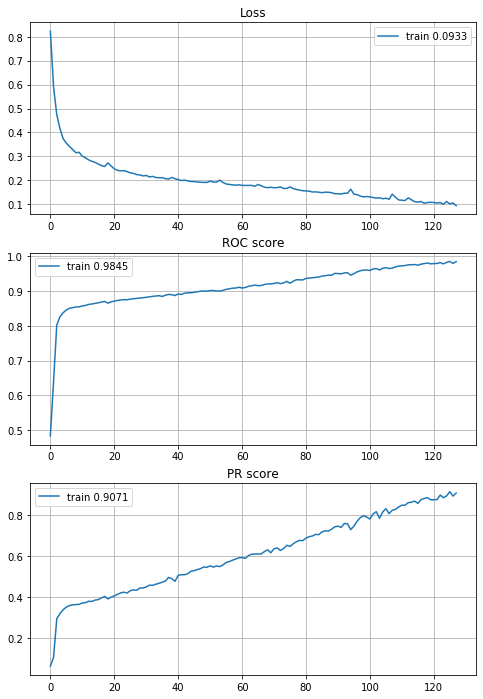

In [98]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(historyCNN_20x20["train_loss"], "-", label="train {}".format(round(historyCNN_20x20["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(historyCNN_20x20["train_roc"], label="train {}".format(round(historyCNN_20x20["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(historyCNN_20x20["train_pr"], label="train {}".format(round(historyCNN_20x20["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

##### "Production" results

In [99]:
# Logistic Regression
Logit_train_probs = Logit.predict(exog=X_train_norm_clip_pt)
Logit_test_probs = Logit.predict(exog=X_test_norm_clip_pt)

Logit_train_roc = roc_auc_score(y_true=Y_train_norm_clip_pt, y_score=Logit_train_probs)
Logit_test_roc = roc_auc_score(y_true=Y_test_norm_clip_pt, y_score=Logit_test_probs)
Logit_train_pr = average_precision_score(y_true=Y_train_norm_clip_pt, y_score=Logit_train_probs)
Logit_test_pr = average_precision_score(y_true=Y_test_norm_clip_pt, y_score=Logit_test_probs)

(Logit_train_roc, Logit_test_roc, Logit_train_pr, Logit_test_pr)

(0.8830976430976432, 0.829490022172949, 0.5215164526674891, 0.5438793829805953)

In [100]:
# Random Forest
Random_Forest_train_probs = Random_Forest.predict_proba(X=X_train_norm_clip)[:,1]
Random_Forest_test_probs = Random_Forest.predict_proba(X=X_test_norm_clip)[:,1]

Random_Forest_train_roc = roc_auc_score(y_true=Y_train_norm_clip, y_score=Random_Forest_train_probs)
Random_Forest_test_roc = roc_auc_score(y_true=Y_test_norm_clip, y_score=Random_Forest_test_probs)
Random_Forest_train_pr = average_precision_score(y_true=Y_train_norm_clip, y_score=Random_Forest_train_probs)
Random_Forest_test_pr = average_precision_score(y_true=Y_test_norm_clip, y_score=Random_Forest_test_probs)

(Random_Forest_train_roc,Random_Forest_test_roc,Random_Forest_train_pr,Random_Forest_test_pr)

(0.9940094714078453,
 0.8527272727272728,
 0.9420110471323656,
 0.4389615134591949)

In [101]:
# Extreme Gradient Boosted Decision Trees
XGBoost_train_probs = XGBoost.predict_proba(data=X_train_norm_clip)[:,1]
XGBoost_test_probs = XGBoost.predict_proba(data=X_test_norm_clip)[:,1]

XGBoost_train_roc = roc_auc_score(y_true=Y_train_norm_clip, y_score=XGBoost_train_probs)
XGBoost_test_roc = roc_auc_score(y_true=Y_test_norm_clip, y_score=XGBoost_test_probs)
XGBoost_train_pr = average_precision_score(y_true=Y_train_norm_clip, y_score=XGBoost_train_probs)
XGBoost_test_pr = average_precision_score(y_true=Y_test_norm_clip, y_score=XGBoost_test_probs)

(XGBoost_train_roc,XGBoost_test_roc,XGBoost_train_pr,XGBoost_test_pr)

(0.9987325832854288,
 0.8723281596452328,
 0.9866446176316473,
 0.5150494418709448)

In [102]:
# Multilayer Percepton
Multilayer_Percepton_train_probs = Multilayer_Percepton.predict(x=X_train_norm_clip_pt.values)
Multilayer_Percepton_test_probs = Multilayer_Percepton.predict(x=X_test_norm_clip_pt.values)

Multilayer_Percepton_train_roc = roc_auc_score(y_true=Y_train_norm_clip_pt, y_score=Multilayer_Percepton_train_probs)
Multilayer_Percepton_test_roc = roc_auc_score(y_true=Y_test_norm_clip_pt, y_score=Multilayer_Percepton_test_probs)
Multilayer_Percepton_train_pr = average_precision_score(y_true=Y_train_norm_clip_pt, y_score=Multilayer_Percepton_train_probs)
Multilayer_Percepton_test_pr = average_precision_score(y_true=Y_test_norm_clip_pt, y_score=Multilayer_Percepton_test_probs)

(Multilayer_Percepton_train_roc,Multilayer_Percepton_test_roc,Multilayer_Percepton_train_pr,Multilayer_Percepton_test_pr)

(0.9913142262735759, 0.8954323725055433, 0.9382310612121415, 0.729886492468554)

In [103]:
# CNN 8x8
CNN_8x8_train_probs = CNN_8x8.predict(x=X_train_CNN_8x8_norm_clip_pt)
CNN_8x8_test_probs = CNN_8x8.predict(x=X_test_CNN_8x8_norm_clip_pt)

CNN_8x8_train_roc = roc_auc_score(y_true=Y_train_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_train_probs)
CNN_8x8_test_roc = roc_auc_score(y_true=Y_test_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_test_probs)
CNN_8x8_train_pr = average_precision_score(y_true=Y_train_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_train_probs)
CNN_8x8_test_pr = average_precision_score(y_true=Y_test_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_test_probs)

(CNN_8x8_train_roc,CNN_8x8_test_roc,CNN_8x8_train_pr,CNN_8x8_test_pr)

(0.9857964468533574, 0.860709534368071, 0.8954614246633539, 0.5851134657207023)

In [104]:
# CNN 20x20
CNN_20x20_train_probs = CNN_20x20.predict(x=X_train_CNN_20x20_norm_clip_pt)
CNN_20x20_test_probs = CNN_20x20.predict(x=X_test_CNN_20x20_norm_clip_pt)

CNN_20x20_train_roc = roc_auc_score(y_true=Y_train_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_train_probs)
CNN_20x20_test_roc = roc_auc_score(y_true=Y_test_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_test_probs)
CNN_20x20_train_pr = average_precision_score(y_true=Y_train_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_train_probs)
CNN_20x20_test_pr = average_precision_score(y_true=Y_test_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_test_probs)

(CNN_20x20_train_roc,CNN_20x20_test_roc,CNN_20x20_train_pr,CNN_20x20_test_pr)

(0.9845424434042319, 0.816940133037694, 0.907137351757455, 0.31660065924572234)

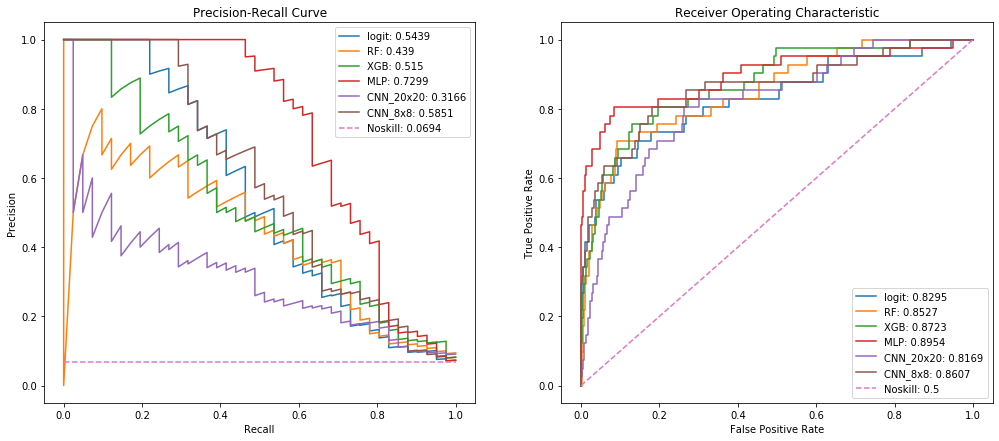

In [105]:
fig, ax = plt.subplots(nrows=1,ncols=2,figsize=(17,7))

logit_precision, logit_recall, _ = precision_recall_curve(Y_test_norm_clip_pt, Logit_test_probs)
logit_fpr, logit_tpr, _ = roc_curve(Y_test_norm_clip_pt, Logit_test_probs)

rf_precision, rf_recall, _ = precision_recall_curve(Y_test_norm_clip, Random_Forest_test_probs)
rf_fpr, rf_tpr, _ = roc_curve(Y_test_norm_clip, Random_Forest_test_probs)

xgb_precision, xgb_recall, _ = precision_recall_curve(Y_test_norm_clip, XGBoost_test_probs)
xgb_fpr, xgb_tpr, _ = roc_curve(Y_test_norm_clip, XGBoost_test_probs)

mlp_precision, mlp_recall, _ = precision_recall_curve(Y_test_norm_clip_pt, Multilayer_Percepton_test_probs)
mlp_fpr, mlp_tpr, _ = roc_curve(Y_test_norm_clip_pt, Multilayer_Percepton_test_probs)

cnn_20x20_precision, cnn_20x20_recall, _ = precision_recall_curve(Y_test_CNN_20x20_norm_clip_pt, CNN_20x20_test_probs)
cnn_20x20_fpr, cnn_20x20_tpr, _ = roc_curve(Y_test_CNN_20x20_norm_clip_pt, CNN_20x20_test_probs)

cnn_8x8_precision, cnn_8x8_recall, _ = precision_recall_curve(Y_test_CNN_8x8_norm_clip_pt, CNN_8x8_test_probs)
cnn_8x8_fpr, cnn_8x8_tpr, _ = roc_curve(Y_test_CNN_8x8_norm_clip_pt, CNN_8x8_test_probs)


noskill_probs = [1 for i in range(Y_test.shape[0])]
noskill_fpr, noskill_tpr, _ = roc_curve(Y_test, noskill_probs)
noskill_precision = Y_test[Y_test==1].shape[0]/Y_test.shape[0]
# precision=(TP)/(TP+FP), when y_hat=1 always => TP+FP = n_obs => precision = TP/(n_obs)
# recall = (TP)/(TP+FN), when y_hat=1 always => FN=0 =? TP+FN=TP => recall=TP/TP=1

# ----- PLOTS -----
ax[0].plot(logit_recall, logit_precision, label= "logit: {}".format(round(Logit_test_pr,4)))
ax[0].plot(rf_recall, rf_precision, label= "RF: {}".format(round(Random_Forest_test_pr,4)))
ax[0].plot(xgb_recall, xgb_precision, label= "XGB: {}".format(round(XGBoost_test_pr,4)))
ax[0].plot(mlp_recall, mlp_precision, label= "MLP: {}".format(round(Multilayer_Percepton_test_pr,4)))
ax[0].plot(cnn_20x20_recall, cnn_20x20_precision, label= "CNN_20x20: {}".format(round(CNN_20x20_test_pr,4)))
ax[0].plot(cnn_8x8_recall, cnn_8x8_precision, label= "CNN_8x8: {}".format(round(CNN_8x8_test_pr,4)))
ax[0].plot([0,1], [noskill_precision, noskill_precision], linestyle='--', label= "Noskill: {}".format(
    round(average_precision_score(Y_test, noskill_probs),4)))
ax[0].plot()
ax[0].legend()
ax[0].set_title("Precision-Recall Curve")
ax[0].set_xlabel('Recall')
ax[0].set_ylabel('Precision')


ax[1].plot(logit_fpr, logit_tpr, label="logit: {}".format(round(Logit_test_roc, 4)))
ax[1].plot(rf_fpr, rf_tpr, label="RF: {}".format(round(Random_Forest_test_roc, 4)))
ax[1].plot(xgb_fpr, xgb_tpr, label="XGB: {}".format(round(XGBoost_test_roc, 4)))
ax[1].plot(mlp_fpr, mlp_tpr, label="MLP: {}".format(round(Multilayer_Percepton_test_roc, 4)))
ax[1].plot(cnn_20x20_fpr, cnn_20x20_tpr, label= "CNN_20x20: {}".format(round(CNN_20x20_test_roc,4)))
ax[1].plot(cnn_8x8_fpr, cnn_8x8_tpr, label= "CNN_8x8: {}".format(round(CNN_8x8_test_roc,4)))
ax[1].plot(noskill_fpr, noskill_tpr, linestyle='--', label= "Noskill: {}".format(
    round(roc_auc_score(Y_test, noskill_probs),4)))
ax[1].legend()
ax[1].set_title("Receiver Operating Characteristic")
ax[1].set_xlabel('False Positive Rate')
ax[1].set_ylabel('True Positive Rate')
plt.show()